In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'P4.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain,ytrain2]
x_val = xval
y_val = [yval,yval,yval2]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

#Output 3 = Slicer output layer

layer7 = Dense(1)(layer2)
layer8 = Lambda(lambda t: t[:,-1],name='out3')(layer7)


model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6,layer8])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 594)      1423224     input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 485)      288575      lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        972         dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Real Gas Turbine/LSTM-P4_2/model checkpoint/P4_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik,'out3':'mean_squared_error'},loss_weights=[0.5,0.5,0],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 930320.56250, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00002: val_loss improved from 930320.56250 to 581329.81250, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00003: val_loss improved from 581329.81250 to 496666.96875, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00004: val_loss improved from 496666.96875 to 468883.87500, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00005: val_loss improved from 468883.87500 to 415103.59375, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ck


Epoch 00086: val_loss did not improve from 21465.83203

Epoch 00087: val_loss did not improve from 21465.83203

Epoch 00088: val_loss did not improve from 21465.83203

Epoch 00089: val_loss did not improve from 21465.83203

Epoch 00090: val_loss did not improve from 21465.83203

Epoch 00091: val_loss did not improve from 21465.83203

Epoch 00092: val_loss improved from 21465.83203 to 19582.06836, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00093: val_loss did not improve from 19582.06836

Epoch 00094: val_loss did not improve from 19582.06836

Epoch 00095: val_loss did not improve from 19582.06836

Epoch 00096: val_loss did not improve from 19582.06836

Epoch 00097: val_loss did not improve from 19582.06836

Epoch 00098: val_loss did not improve from 19582.06836

Epoch 00099: val_loss did not improve from 19582.06836

Epoch 00100: val_loss did not improve from 19582.06836

Epoch 00101: val_loss did not improve 


Epoch 00204: val_loss did not improve from 13995.58984

Epoch 00205: val_loss did not improve from 13995.58984

Epoch 00206: val_loss did not improve from 13995.58984

Epoch 00207: val_loss did not improve from 13995.58984

Epoch 00208: val_loss did not improve from 13995.58984

Epoch 00209: val_loss did not improve from 13995.58984

Epoch 00210: val_loss did not improve from 13995.58984

Epoch 00211: val_loss did not improve from 13995.58984

Epoch 00212: val_loss did not improve from 13995.58984

Epoch 00213: val_loss did not improve from 13995.58984

Epoch 00214: val_loss did not improve from 13995.58984

Epoch 00215: val_loss did not improve from 13995.58984

Epoch 00216: val_loss improved from 13995.58984 to 13696.94141, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00217: val_loss did not improve from 13696.94141

Epoch 00218: val_loss did not improve from 13696.94141

Epoch 00219: val_loss did not improve 


Epoch 00331: val_loss did not improve from 11181.53223

Epoch 00332: val_loss did not improve from 11181.53223

Epoch 00333: val_loss did not improve from 11181.53223

Epoch 00334: val_loss did not improve from 11181.53223

Epoch 00335: val_loss improved from 11181.53223 to 10629.47168, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00336: val_loss did not improve from 10629.47168

Epoch 00337: val_loss did not improve from 10629.47168

Epoch 00338: val_loss did not improve from 10629.47168

Epoch 00339: val_loss did not improve from 10629.47168

Epoch 00340: val_loss did not improve from 10629.47168

Epoch 00341: val_loss did not improve from 10629.47168

Epoch 00342: val_loss improved from 10629.47168 to 10497.83203, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00343: val_loss did not improve from 10497.83203

Epoch 00344: val_loss did not


Epoch 00449: val_loss did not improve from 7299.07715

Epoch 00450: val_loss did not improve from 7299.07715

Epoch 00451: val_loss did not improve from 7299.07715

Epoch 00452: val_loss did not improve from 7299.07715

Epoch 00453: val_loss did not improve from 7299.07715

Epoch 00454: val_loss did not improve from 7299.07715

Epoch 00455: val_loss improved from 7299.07715 to 7008.32031, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00456: val_loss did not improve from 7008.32031

Epoch 00457: val_loss did not improve from 7008.32031

Epoch 00458: val_loss did not improve from 7008.32031

Epoch 00459: val_loss did not improve from 7008.32031

Epoch 00460: val_loss did not improve from 7008.32031

Epoch 00461: val_loss did not improve from 7008.32031

Epoch 00462: val_loss did not improve from 7008.32031

Epoch 00463: val_loss did not improve from 7008.32031

Epoch 00464: val_loss did not improve from 7008.32031



Epoch 00583: val_loss did not improve from 4918.22949

Epoch 00584: val_loss did not improve from 4918.22949

Epoch 00585: val_loss did not improve from 4918.22949

Epoch 00586: val_loss did not improve from 4918.22949

Epoch 00587: val_loss improved from 4918.22949 to 4423.02100, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00588: val_loss did not improve from 4423.02100

Epoch 00589: val_loss did not improve from 4423.02100

Epoch 00590: val_loss did not improve from 4423.02100

Epoch 00591: val_loss did not improve from 4423.02100

Epoch 00592: val_loss did not improve from 4423.02100

Epoch 00593: val_loss did not improve from 4423.02100

Epoch 00594: val_loss did not improve from 4423.02100

Epoch 00595: val_loss did not improve from 4423.02100

Epoch 00596: val_loss did not improve from 4423.02100

Epoch 00597: val_loss did not improve from 4423.02100

Epoch 00598: val_loss did not improve from 4423.02100



Epoch 00720: val_loss did not improve from 1522.94568

Epoch 00721: val_loss did not improve from 1522.94568

Epoch 00722: val_loss improved from 1522.94568 to 1273.36035, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00723: val_loss did not improve from 1273.36035

Epoch 00724: val_loss did not improve from 1273.36035

Epoch 00725: val_loss did not improve from 1273.36035

Epoch 00726: val_loss did not improve from 1273.36035

Epoch 00727: val_loss did not improve from 1273.36035

Epoch 00728: val_loss did not improve from 1273.36035

Epoch 00729: val_loss did not improve from 1273.36035

Epoch 00730: val_loss did not improve from 1273.36035

Epoch 00731: val_loss did not improve from 1273.36035

Epoch 00732: val_loss did not improve from 1273.36035

Epoch 00733: val_loss did not improve from 1273.36035

Epoch 00734: val_loss did not improve from 1273.36035

Epoch 00735: val_loss did not improve from 1273.36035



Epoch 00857: val_loss did not improve from 458.78519

Epoch 00858: val_loss did not improve from 458.78519

Epoch 00859: val_loss did not improve from 458.78519

Epoch 00860: val_loss did not improve from 458.78519

Epoch 00861: val_loss did not improve from 458.78519

Epoch 00862: val_loss improved from 458.78519 to 373.53696, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P4_3/model checkpoint\P4_ckpt

Epoch 00863: val_loss did not improve from 373.53696

Epoch 00864: val_loss did not improve from 373.53696

Epoch 00865: val_loss did not improve from 373.53696

Epoch 00866: val_loss did not improve from 373.53696

Epoch 00867: val_loss did not improve from 373.53696

Epoch 00868: val_loss did not improve from 373.53696

Epoch 00869: val_loss did not improve from 373.53696

Epoch 00870: val_loss did not improve from 373.53696

Epoch 00871: val_loss did not improve from 373.53696

Epoch 00872: val_loss did not improve from 373.53696

Epoch 00873: val


Epoch 01000: val_loss did not improve from 122.42709

Epoch 01001: val_loss did not improve from 122.42709

Epoch 01002: val_loss did not improve from 122.42709

Epoch 01003: val_loss did not improve from 122.42709

Epoch 01004: val_loss did not improve from 122.42709

Epoch 01005: val_loss did not improve from 122.42709

Epoch 01006: val_loss did not improve from 122.42709

Epoch 01007: val_loss did not improve from 122.42709

Epoch 01008: val_loss did not improve from 122.42709

Epoch 01009: val_loss did not improve from 122.42709

Epoch 01010: val_loss did not improve from 122.42709

Epoch 01011: val_loss did not improve from 122.42709

Epoch 01012: val_loss did not improve from 122.42709

Epoch 01013: val_loss did not improve from 122.42709

Epoch 01014: val_loss did not improve from 122.42709

Epoch 01015: val_loss did not improve from 122.42709

Epoch 01016: val_loss did not improve from 122.42709

Epoch 01017: val_loss did not improve from 122.42709

Epoch 01018: val_loss did n


Epoch 01147: val_loss did not improve from 87.06563

Epoch 01148: val_loss did not improve from 87.06563

Epoch 01149: val_loss did not improve from 87.06563

Epoch 01150: val_loss did not improve from 87.06563

Epoch 01151: val_loss did not improve from 87.06563

Epoch 01152: val_loss did not improve from 87.06563

Epoch 01153: val_loss did not improve from 87.06563

Epoch 01154: val_loss did not improve from 87.06563

Epoch 01155: val_loss did not improve from 87.06563

Epoch 01156: val_loss did not improve from 87.06563

Epoch 01157: val_loss did not improve from 87.06563

Epoch 01158: val_loss did not improve from 87.06563

Epoch 01159: val_loss did not improve from 87.06563

Epoch 01160: val_loss did not improve from 87.06563

Epoch 01161: val_loss did not improve from 87.06563

Epoch 01162: val_loss did not improve from 87.06563

Epoch 01163: val_loss did not improve from 87.06563

Epoch 01164: val_loss did not improve from 87.06563

Epoch 01165: val_loss did not improve from 87


Epoch 01303: val_loss did not improve from 87.06563

Epoch 01304: val_loss did not improve from 87.06563

Epoch 01305: val_loss did not improve from 87.06563

Epoch 01306: val_loss did not improve from 87.06563

Epoch 01307: val_loss did not improve from 87.06563

Epoch 01308: val_loss did not improve from 87.06563

Epoch 01309: val_loss did not improve from 87.06563

Epoch 01310: val_loss did not improve from 87.06563

Epoch 01311: val_loss did not improve from 87.06563

Epoch 01312: val_loss did not improve from 87.06563

Epoch 01313: val_loss did not improve from 87.06563

Epoch 01314: val_loss did not improve from 87.06563

Epoch 01315: val_loss did not improve from 87.06563

Epoch 01316: val_loss did not improve from 87.06563

Epoch 01317: val_loss did not improve from 87.06563

Epoch 01318: val_loss did not improve from 87.06563

Epoch 01319: val_loss did not improve from 87.06563

Epoch 01320: val_loss did not improve from 87.06563

Epoch 01321: val_loss did not improve from 87


Epoch 01459: val_loss did not improve from 87.06563

Epoch 01460: val_loss did not improve from 87.06563

Epoch 01461: val_loss did not improve from 87.06563

Epoch 01462: val_loss did not improve from 87.06563

Epoch 01463: val_loss did not improve from 87.06563

Epoch 01464: val_loss did not improve from 87.06563

Epoch 01465: val_loss did not improve from 87.06563

Epoch 01466: val_loss did not improve from 87.06563

Epoch 01467: val_loss did not improve from 87.06563

Epoch 01468: val_loss did not improve from 87.06563

Epoch 01469: val_loss did not improve from 87.06563

Epoch 01470: val_loss did not improve from 87.06563

Epoch 01471: val_loss did not improve from 87.06563

Epoch 01472: val_loss did not improve from 87.06563

Epoch 01473: val_loss did not improve from 87.06563

Epoch 01474: val_loss did not improve from 87.06563

Epoch 01475: val_loss did not improve from 87.06563

Epoch 01476: val_loss did not improve from 87.06563

Epoch 01477: val_loss did not improve from 87


Epoch 01615: val_loss did not improve from 87.06563

Epoch 01616: val_loss did not improve from 87.06563

Epoch 01617: val_loss did not improve from 87.06563

Epoch 01618: val_loss did not improve from 87.06563

Epoch 01619: val_loss did not improve from 87.06563

Epoch 01620: val_loss did not improve from 87.06563

Epoch 01621: val_loss did not improve from 87.06563

Epoch 01622: val_loss did not improve from 87.06563

Epoch 01623: val_loss did not improve from 87.06563

Epoch 01624: val_loss did not improve from 87.06563

Epoch 01625: val_loss did not improve from 87.06563

Epoch 01626: val_loss did not improve from 87.06563

Epoch 01627: val_loss did not improve from 87.06563

Epoch 01628: val_loss did not improve from 87.06563

Epoch 01629: val_loss did not improve from 87.06563

Epoch 01630: val_loss did not improve from 87.06563

Epoch 01631: val_loss did not improve from 87.06563

Epoch 01632: val_loss did not improve from 87.06563

Epoch 01633: val_loss did not improve from 87


Epoch 01770: val_loss did not improve from 87.06563

Epoch 01771: val_loss did not improve from 87.06563

Epoch 01772: val_loss did not improve from 87.06563

Epoch 01773: val_loss did not improve from 87.06563

Epoch 01774: val_loss did not improve from 87.06563

Epoch 01775: val_loss did not improve from 87.06563

Epoch 01776: val_loss did not improve from 87.06563

Epoch 01777: val_loss did not improve from 87.06563

Epoch 01778: val_loss did not improve from 87.06563

Epoch 01779: val_loss did not improve from 87.06563

Epoch 01780: val_loss did not improve from 87.06563

Epoch 01781: val_loss did not improve from 87.06563

Epoch 01782: val_loss did not improve from 87.06563

Epoch 01783: val_loss did not improve from 87.06563

Epoch 01784: val_loss did not improve from 87.06563

Epoch 01785: val_loss did not improve from 87.06563

Epoch 01786: val_loss did not improve from 87.06563

Epoch 01787: val_loss did not improve from 87.06563

Epoch 01788: val_loss did not improve from 87


Epoch 01926: val_loss did not improve from 87.06563

Epoch 01927: val_loss did not improve from 87.06563

Epoch 01928: val_loss did not improve from 87.06563

Epoch 01929: val_loss did not improve from 87.06563

Epoch 01930: val_loss did not improve from 87.06563

Epoch 01931: val_loss did not improve from 87.06563

Epoch 01932: val_loss did not improve from 87.06563

Epoch 01933: val_loss did not improve from 87.06563

Epoch 01934: val_loss did not improve from 87.06563

Epoch 01935: val_loss did not improve from 87.06563

Epoch 01936: val_loss did not improve from 87.06563

Epoch 01937: val_loss did not improve from 87.06563

Epoch 01938: val_loss did not improve from 87.06563

Epoch 01939: val_loss did not improve from 87.06563

Epoch 01940: val_loss did not improve from 87.06563

Epoch 01941: val_loss did not improve from 87.06563

Epoch 01942: val_loss did not improve from 87.06563

Epoch 01943: val_loss did not improve from 87.06563

Epoch 01944: val_loss did not improve from 87


Epoch 02082: val_loss did not improve from 87.06563

Epoch 02083: val_loss did not improve from 87.06563

Epoch 02084: val_loss did not improve from 87.06563

Epoch 02085: val_loss did not improve from 87.06563

Epoch 02086: val_loss did not improve from 87.06563

Epoch 02087: val_loss did not improve from 87.06563

Epoch 02088: val_loss did not improve from 87.06563

Epoch 02089: val_loss did not improve from 87.06563

Epoch 02090: val_loss did not improve from 87.06563

Epoch 02091: val_loss did not improve from 87.06563

Epoch 02092: val_loss did not improve from 87.06563

Epoch 02093: val_loss did not improve from 87.06563

Epoch 02094: val_loss did not improve from 87.06563

Epoch 02095: val_loss did not improve from 87.06563

Epoch 02096: val_loss did not improve from 87.06563

Epoch 02097: val_loss did not improve from 87.06563

Epoch 02098: val_loss did not improve from 87.06563

Epoch 02099: val_loss did not improve from 87.06563

Epoch 02100: val_loss did not improve from 87


Epoch 02238: val_loss did not improve from 87.06563

Epoch 02239: val_loss did not improve from 87.06563

Epoch 02240: val_loss did not improve from 87.06563

Epoch 02241: val_loss did not improve from 87.06563

Epoch 02242: val_loss did not improve from 87.06563

Epoch 02243: val_loss did not improve from 87.06563

Epoch 02244: val_loss did not improve from 87.06563

Epoch 02245: val_loss did not improve from 87.06563

Epoch 02246: val_loss did not improve from 87.06563

Epoch 02247: val_loss did not improve from 87.06563

Epoch 02248: val_loss did not improve from 87.06563

Epoch 02249: val_loss did not improve from 87.06563

Epoch 02250: val_loss did not improve from 87.06563

Epoch 02251: val_loss did not improve from 87.06563

Epoch 02252: val_loss did not improve from 87.06563

Epoch 02253: val_loss did not improve from 87.06563

Epoch 02254: val_loss did not improve from 87.06563

Epoch 02255: val_loss did not improve from 87.06563

Epoch 02256: val_loss did not improve from 87


Epoch 02394: val_loss did not improve from 87.06563

Epoch 02395: val_loss did not improve from 87.06563

Epoch 02396: val_loss did not improve from 87.06563

Epoch 02397: val_loss did not improve from 87.06563

Epoch 02398: val_loss did not improve from 87.06563

Epoch 02399: val_loss did not improve from 87.06563

Epoch 02400: val_loss did not improve from 87.06563

Epoch 02401: val_loss did not improve from 87.06563

Epoch 02402: val_loss did not improve from 87.06563

Epoch 02403: val_loss did not improve from 87.06563

Epoch 02404: val_loss did not improve from 87.06563

Epoch 02405: val_loss did not improve from 87.06563

Epoch 02406: val_loss did not improve from 87.06563

Epoch 02407: val_loss did not improve from 87.06563

Epoch 02408: val_loss did not improve from 87.06563

Epoch 02409: val_loss did not improve from 87.06563

Epoch 02410: val_loss did not improve from 87.06563

Epoch 02411: val_loss did not improve from 87.06563

Epoch 02412: val_loss did not improve from 87


Epoch 02550: val_loss did not improve from 87.06563

Epoch 02551: val_loss did not improve from 87.06563

Epoch 02552: val_loss did not improve from 87.06563

Epoch 02553: val_loss did not improve from 87.06563

Epoch 02554: val_loss did not improve from 87.06563

Epoch 02555: val_loss did not improve from 87.06563

Epoch 02556: val_loss did not improve from 87.06563

Epoch 02557: val_loss did not improve from 87.06563

Epoch 02558: val_loss did not improve from 87.06563

Epoch 02559: val_loss did not improve from 87.06563

Epoch 02560: val_loss did not improve from 87.06563

Epoch 02561: val_loss did not improve from 87.06563

Epoch 02562: val_loss did not improve from 87.06563

Epoch 02563: val_loss did not improve from 87.06563

Epoch 02564: val_loss did not improve from 87.06563

Epoch 02565: val_loss did not improve from 87.06563

Epoch 02566: val_loss did not improve from 87.06563

Epoch 02567: val_loss did not improve from 87.06563

Epoch 02568: val_loss did not improve from 87


Epoch 02706: val_loss did not improve from 87.06563

Epoch 02707: val_loss did not improve from 87.06563

Epoch 02708: val_loss did not improve from 87.06563

Epoch 02709: val_loss did not improve from 87.06563

Epoch 02710: val_loss did not improve from 87.06563

Epoch 02711: val_loss did not improve from 87.06563

Epoch 02712: val_loss did not improve from 87.06563

Epoch 02713: val_loss did not improve from 87.06563

Epoch 02714: val_loss did not improve from 87.06563

Epoch 02715: val_loss did not improve from 87.06563

Epoch 02716: val_loss did not improve from 87.06563

Epoch 02717: val_loss did not improve from 87.06563

Epoch 02718: val_loss did not improve from 87.06563

Epoch 02719: val_loss did not improve from 87.06563

Epoch 02720: val_loss did not improve from 87.06563

Epoch 02721: val_loss did not improve from 87.06563

Epoch 02722: val_loss did not improve from 87.06563

Epoch 02723: val_loss did not improve from 87.06563

Epoch 02724: val_loss did not improve from 87


Epoch 02862: val_loss did not improve from 87.06563

Epoch 02863: val_loss did not improve from 87.06563

Epoch 02864: val_loss did not improve from 87.06563

Epoch 02865: val_loss did not improve from 87.06563

Epoch 02866: val_loss did not improve from 87.06563

Epoch 02867: val_loss did not improve from 87.06563

Epoch 02868: val_loss did not improve from 87.06563

Epoch 02869: val_loss did not improve from 87.06563

Epoch 02870: val_loss did not improve from 87.06563

Epoch 02871: val_loss did not improve from 87.06563

Epoch 02872: val_loss did not improve from 87.06563

Epoch 02873: val_loss did not improve from 87.06563

Epoch 02874: val_loss did not improve from 87.06563

Epoch 02875: val_loss did not improve from 87.06563

Epoch 02876: val_loss did not improve from 87.06563

Epoch 02877: val_loss did not improve from 87.06563

Epoch 02878: val_loss did not improve from 87.06563

Epoch 02879: val_loss did not improve from 87.06563

Epoch 02880: val_loss did not improve from 87


Epoch 03018: val_loss did not improve from 87.06563

Epoch 03019: val_loss did not improve from 87.06563

Epoch 03020: val_loss did not improve from 87.06563

Epoch 03021: val_loss did not improve from 87.06563

Epoch 03022: val_loss did not improve from 87.06563

Epoch 03023: val_loss did not improve from 87.06563

Epoch 03024: val_loss did not improve from 87.06563

Epoch 03025: val_loss did not improve from 87.06563

Epoch 03026: val_loss did not improve from 87.06563

Epoch 03027: val_loss did not improve from 87.06563

Epoch 03028: val_loss did not improve from 87.06563

Epoch 03029: val_loss did not improve from 87.06563

Epoch 03030: val_loss did not improve from 87.06563

Epoch 03031: val_loss did not improve from 87.06563

Epoch 03032: val_loss did not improve from 87.06563

Epoch 03033: val_loss did not improve from 87.06563

Epoch 03034: val_loss did not improve from 87.06563

Epoch 03035: val_loss did not improve from 87.06563

Epoch 03036: val_loss did not improve from 87


Epoch 03174: val_loss did not improve from 87.06563

Epoch 03175: val_loss did not improve from 87.06563

Epoch 03176: val_loss did not improve from 87.06563

Epoch 03177: val_loss did not improve from 87.06563

Epoch 03178: val_loss did not improve from 87.06563

Epoch 03179: val_loss did not improve from 87.06563

Epoch 03180: val_loss did not improve from 87.06563

Epoch 03181: val_loss did not improve from 87.06563

Epoch 03182: val_loss did not improve from 87.06563

Epoch 03183: val_loss did not improve from 87.06563

Epoch 03184: val_loss did not improve from 87.06563

Epoch 03185: val_loss did not improve from 87.06563

Epoch 03186: val_loss did not improve from 87.06563

Epoch 03187: val_loss did not improve from 87.06563

Epoch 03188: val_loss did not improve from 87.06563

Epoch 03189: val_loss did not improve from 87.06563

Epoch 03190: val_loss did not improve from 87.06563

Epoch 03191: val_loss did not improve from 87.06563

Epoch 03192: val_loss did not improve from 87


Epoch 03330: val_loss did not improve from 87.06563

Epoch 03331: val_loss did not improve from 87.06563

Epoch 03332: val_loss did not improve from 87.06563

Epoch 03333: val_loss did not improve from 87.06563

Epoch 03334: val_loss did not improve from 87.06563

Epoch 03335: val_loss did not improve from 87.06563

Epoch 03336: val_loss did not improve from 87.06563

Epoch 03337: val_loss did not improve from 87.06563

Epoch 03338: val_loss did not improve from 87.06563

Epoch 03339: val_loss did not improve from 87.06563

Epoch 03340: val_loss did not improve from 87.06563

Epoch 03341: val_loss did not improve from 87.06563

Epoch 03342: val_loss did not improve from 87.06563

Epoch 03343: val_loss did not improve from 87.06563

Epoch 03344: val_loss did not improve from 87.06563

Epoch 03345: val_loss did not improve from 87.06563

Epoch 03346: val_loss did not improve from 87.06563

Epoch 03347: val_loss did not improve from 87.06563

Epoch 03348: val_loss did not improve from 87


Epoch 03486: val_loss did not improve from 87.06563

Epoch 03487: val_loss did not improve from 87.06563

Epoch 03488: val_loss did not improve from 87.06563

Epoch 03489: val_loss did not improve from 87.06563

Epoch 03490: val_loss did not improve from 87.06563

Epoch 03491: val_loss did not improve from 87.06563

Epoch 03492: val_loss did not improve from 87.06563

Epoch 03493: val_loss did not improve from 87.06563

Epoch 03494: val_loss did not improve from 87.06563

Epoch 03495: val_loss did not improve from 87.06563

Epoch 03496: val_loss did not improve from 87.06563

Epoch 03497: val_loss did not improve from 87.06563

Epoch 03498: val_loss did not improve from 87.06563

Epoch 03499: val_loss did not improve from 87.06563

Epoch 03500: val_loss did not improve from 87.06563

Epoch 03501: val_loss did not improve from 87.06563

Epoch 03502: val_loss did not improve from 87.06563

Epoch 03503: val_loss did not improve from 87.06563

Epoch 03504: val_loss did not improve from 87


Epoch 03642: val_loss did not improve from 87.06563

Epoch 03643: val_loss did not improve from 87.06563

Epoch 03644: val_loss did not improve from 87.06563

Epoch 03645: val_loss did not improve from 87.06563

Epoch 03646: val_loss did not improve from 87.06563

Epoch 03647: val_loss did not improve from 87.06563

Epoch 03648: val_loss did not improve from 87.06563

Epoch 03649: val_loss did not improve from 87.06563

Epoch 03650: val_loss did not improve from 87.06563

Epoch 03651: val_loss did not improve from 87.06563

Epoch 03652: val_loss did not improve from 87.06563

Epoch 03653: val_loss did not improve from 87.06563

Epoch 03654: val_loss did not improve from 87.06563

Epoch 03655: val_loss did not improve from 87.06563

Epoch 03656: val_loss did not improve from 87.06563

Epoch 03657: val_loss did not improve from 87.06563

Epoch 03658: val_loss did not improve from 87.06563

Epoch 03659: val_loss did not improve from 87.06563

Epoch 03660: val_loss did not improve from 87


Epoch 03798: val_loss did not improve from 87.06563

Epoch 03799: val_loss did not improve from 87.06563

Epoch 03800: val_loss did not improve from 87.06563

Epoch 03801: val_loss did not improve from 87.06563

Epoch 03802: val_loss did not improve from 87.06563

Epoch 03803: val_loss did not improve from 87.06563

Epoch 03804: val_loss did not improve from 87.06563

Epoch 03805: val_loss did not improve from 87.06563

Epoch 03806: val_loss did not improve from 87.06563

Epoch 03807: val_loss did not improve from 87.06563

Epoch 03808: val_loss did not improve from 87.06563

Epoch 03809: val_loss did not improve from 87.06563

Epoch 03810: val_loss did not improve from 87.06563

Epoch 03811: val_loss did not improve from 87.06563

Epoch 03812: val_loss did not improve from 87.06563

Epoch 03813: val_loss did not improve from 87.06563

Epoch 03814: val_loss did not improve from 87.06563

Epoch 03815: val_loss did not improve from 87.06563

Epoch 03816: val_loss did not improve from 87


Epoch 03954: val_loss did not improve from 87.06563

Epoch 03955: val_loss did not improve from 87.06563

Epoch 03956: val_loss did not improve from 87.06563

Epoch 03957: val_loss did not improve from 87.06563

Epoch 03958: val_loss did not improve from 87.06563

Epoch 03959: val_loss did not improve from 87.06563

Epoch 03960: val_loss did not improve from 87.06563

Epoch 03961: val_loss did not improve from 87.06563

Epoch 03962: val_loss did not improve from 87.06563

Epoch 03963: val_loss did not improve from 87.06563

Epoch 03964: val_loss did not improve from 87.06563

Epoch 03965: val_loss did not improve from 87.06563

Epoch 03966: val_loss did not improve from 87.06563

Epoch 03967: val_loss did not improve from 87.06563

Epoch 03968: val_loss did not improve from 87.06563

Epoch 03969: val_loss did not improve from 87.06563

Epoch 03970: val_loss did not improve from 87.06563

Epoch 03971: val_loss did not improve from 87.06563

Epoch 03972: val_loss did not improve from 87


Epoch 04110: val_loss did not improve from 87.06563

Epoch 04111: val_loss did not improve from 87.06563

Epoch 04112: val_loss did not improve from 87.06563

Epoch 04113: val_loss did not improve from 87.06563

Epoch 04114: val_loss did not improve from 87.06563

Epoch 04115: val_loss did not improve from 87.06563

Epoch 04116: val_loss did not improve from 87.06563

Epoch 04117: val_loss did not improve from 87.06563

Epoch 04118: val_loss did not improve from 87.06563

Epoch 04119: val_loss did not improve from 87.06563

Epoch 04120: val_loss did not improve from 87.06563

Epoch 04121: val_loss did not improve from 87.06563

Epoch 04122: val_loss did not improve from 87.06563

Epoch 04123: val_loss did not improve from 87.06563

Epoch 04124: val_loss did not improve from 87.06563

Epoch 04125: val_loss did not improve from 87.06563

Epoch 04126: val_loss did not improve from 87.06563

Epoch 04127: val_loss did not improve from 87.06563

Epoch 04128: val_loss did not improve from 87


Epoch 04266: val_loss did not improve from 87.06563

Epoch 04267: val_loss did not improve from 87.06563

Epoch 04268: val_loss did not improve from 87.06563

Epoch 04269: val_loss did not improve from 87.06563

Epoch 04270: val_loss did not improve from 87.06563

Epoch 04271: val_loss did not improve from 87.06563

Epoch 04272: val_loss did not improve from 87.06563

Epoch 04273: val_loss did not improve from 87.06563

Epoch 04274: val_loss did not improve from 87.06563

Epoch 04275: val_loss did not improve from 87.06563

Epoch 04276: val_loss did not improve from 87.06563

Epoch 04277: val_loss did not improve from 87.06563

Epoch 04278: val_loss did not improve from 87.06563

Epoch 04279: val_loss did not improve from 87.06563

Epoch 04280: val_loss did not improve from 87.06563

Epoch 04281: val_loss did not improve from 87.06563

Epoch 04282: val_loss did not improve from 87.06563

Epoch 04283: val_loss did not improve from 87.06563

Epoch 04284: val_loss did not improve from 87


Epoch 04422: val_loss did not improve from 87.06563

Epoch 04423: val_loss did not improve from 87.06563

Epoch 04424: val_loss did not improve from 87.06563

Epoch 04425: val_loss did not improve from 87.06563

Epoch 04426: val_loss did not improve from 87.06563

Epoch 04427: val_loss did not improve from 87.06563

Epoch 04428: val_loss did not improve from 87.06563

Epoch 04429: val_loss did not improve from 87.06563

Epoch 04430: val_loss did not improve from 87.06563

Epoch 04431: val_loss did not improve from 87.06563

Epoch 04432: val_loss did not improve from 87.06563

Epoch 04433: val_loss did not improve from 87.06563

Epoch 04434: val_loss did not improve from 87.06563

Epoch 04435: val_loss did not improve from 87.06563

Epoch 04436: val_loss did not improve from 87.06563

Epoch 04437: val_loss did not improve from 87.06563

Epoch 04438: val_loss did not improve from 87.06563

Epoch 04439: val_loss did not improve from 87.06563

Epoch 04440: val_loss did not improve from 87


Epoch 04578: val_loss did not improve from 87.06563

Epoch 04579: val_loss did not improve from 87.06563

Epoch 04580: val_loss did not improve from 87.06563

Epoch 04581: val_loss did not improve from 87.06563

Epoch 04582: val_loss did not improve from 87.06563

Epoch 04583: val_loss did not improve from 87.06563

Epoch 04584: val_loss did not improve from 87.06563

Epoch 04585: val_loss did not improve from 87.06563

Epoch 04586: val_loss did not improve from 87.06563

Epoch 04587: val_loss did not improve from 87.06563

Epoch 04588: val_loss did not improve from 87.06563

Epoch 04589: val_loss did not improve from 87.06563

Epoch 04590: val_loss did not improve from 87.06563

Epoch 04591: val_loss did not improve from 87.06563

Epoch 04592: val_loss did not improve from 87.06563

Epoch 04593: val_loss did not improve from 87.06563

Epoch 04594: val_loss did not improve from 87.06563

Epoch 04595: val_loss did not improve from 87.06563

Epoch 04596: val_loss did not improve from 87


Epoch 04734: val_loss did not improve from 87.06563

Epoch 04735: val_loss did not improve from 87.06563

Epoch 04736: val_loss did not improve from 87.06563

Epoch 04737: val_loss did not improve from 87.06563

Epoch 04738: val_loss did not improve from 87.06563

Epoch 04739: val_loss did not improve from 87.06563

Epoch 04740: val_loss did not improve from 87.06563

Epoch 04741: val_loss did not improve from 87.06563

Epoch 04742: val_loss did not improve from 87.06563

Epoch 04743: val_loss did not improve from 87.06563

Epoch 04744: val_loss did not improve from 87.06563

Epoch 04745: val_loss did not improve from 87.06563

Epoch 04746: val_loss did not improve from 87.06563

Epoch 04747: val_loss did not improve from 87.06563

Epoch 04748: val_loss did not improve from 87.06563

Epoch 04749: val_loss did not improve from 87.06563

Epoch 04750: val_loss did not improve from 87.06563

Epoch 04751: val_loss did not improve from 87.06563

Epoch 04752: val_loss did not improve from 87


Epoch 04890: val_loss did not improve from 87.06563

Epoch 04891: val_loss did not improve from 87.06563

Epoch 04892: val_loss did not improve from 87.06563

Epoch 04893: val_loss did not improve from 87.06563

Epoch 04894: val_loss did not improve from 87.06563

Epoch 04895: val_loss did not improve from 87.06563

Epoch 04896: val_loss did not improve from 87.06563

Epoch 04897: val_loss did not improve from 87.06563

Epoch 04898: val_loss did not improve from 87.06563

Epoch 04899: val_loss did not improve from 87.06563

Epoch 04900: val_loss did not improve from 87.06563

Epoch 04901: val_loss did not improve from 87.06563

Epoch 04902: val_loss did not improve from 87.06563

Epoch 04903: val_loss did not improve from 87.06563

Epoch 04904: val_loss did not improve from 87.06563

Epoch 04905: val_loss did not improve from 87.06563

Epoch 04906: val_loss did not improve from 87.06563

Epoch 04907: val_loss did not improve from 87.06563

Epoch 04908: val_loss did not improve from 87


Epoch 05046: val_loss did not improve from 87.06563

Epoch 05047: val_loss did not improve from 87.06563

Epoch 05048: val_loss did not improve from 87.06563

Epoch 05049: val_loss did not improve from 87.06563

Epoch 05050: val_loss did not improve from 87.06563

Epoch 05051: val_loss did not improve from 87.06563

Epoch 05052: val_loss did not improve from 87.06563

Epoch 05053: val_loss did not improve from 87.06563

Epoch 05054: val_loss did not improve from 87.06563

Epoch 05055: val_loss did not improve from 87.06563

Epoch 05056: val_loss did not improve from 87.06563

Epoch 05057: val_loss did not improve from 87.06563

Epoch 05058: val_loss did not improve from 87.06563

Epoch 05059: val_loss did not improve from 87.06563

Epoch 05060: val_loss did not improve from 87.06563

Epoch 05061: val_loss did not improve from 87.06563

Epoch 05062: val_loss did not improve from 87.06563

Epoch 05063: val_loss did not improve from 87.06563

Epoch 05064: val_loss did not improve from 87


Epoch 05202: val_loss did not improve from 87.06563

Epoch 05203: val_loss did not improve from 87.06563

Epoch 05204: val_loss did not improve from 87.06563

Epoch 05205: val_loss did not improve from 87.06563

Epoch 05206: val_loss did not improve from 87.06563

Epoch 05207: val_loss did not improve from 87.06563

Epoch 05208: val_loss did not improve from 87.06563

Epoch 05209: val_loss did not improve from 87.06563

Epoch 05210: val_loss did not improve from 87.06563

Epoch 05211: val_loss did not improve from 87.06563

Epoch 05212: val_loss did not improve from 87.06563

Epoch 05213: val_loss did not improve from 87.06563

Epoch 05214: val_loss did not improve from 87.06563

Epoch 05215: val_loss did not improve from 87.06563

Epoch 05216: val_loss did not improve from 87.06563

Epoch 05217: val_loss did not improve from 87.06563

Epoch 05218: val_loss did not improve from 87.06563

Epoch 05219: val_loss did not improve from 87.06563

Epoch 05220: val_loss did not improve from 87


Epoch 05358: val_loss did not improve from 87.06563

Epoch 05359: val_loss did not improve from 87.06563

Epoch 05360: val_loss did not improve from 87.06563

Epoch 05361: val_loss did not improve from 87.06563

Epoch 05362: val_loss did not improve from 87.06563

Epoch 05363: val_loss did not improve from 87.06563

Epoch 05364: val_loss did not improve from 87.06563

Epoch 05365: val_loss did not improve from 87.06563

Epoch 05366: val_loss did not improve from 87.06563

Epoch 05367: val_loss did not improve from 87.06563

Epoch 05368: val_loss did not improve from 87.06563

Epoch 05369: val_loss did not improve from 87.06563

Epoch 05370: val_loss did not improve from 87.06563

Epoch 05371: val_loss did not improve from 87.06563

Epoch 05372: val_loss did not improve from 87.06563

Epoch 05373: val_loss did not improve from 87.06563

Epoch 05374: val_loss did not improve from 87.06563

Epoch 05375: val_loss did not improve from 87.06563

Epoch 05376: val_loss did not improve from 87


Epoch 05514: val_loss did not improve from 87.06563

Epoch 05515: val_loss did not improve from 87.06563

Epoch 05516: val_loss did not improve from 87.06563

Epoch 05517: val_loss did not improve from 87.06563

Epoch 05518: val_loss did not improve from 87.06563

Epoch 05519: val_loss did not improve from 87.06563

Epoch 05520: val_loss did not improve from 87.06563

Epoch 05521: val_loss did not improve from 87.06563

Epoch 05522: val_loss did not improve from 87.06563

Epoch 05523: val_loss did not improve from 87.06563

Epoch 05524: val_loss did not improve from 87.06563

Epoch 05525: val_loss did not improve from 87.06563

Epoch 05526: val_loss did not improve from 87.06563

Epoch 05527: val_loss did not improve from 87.06563

Epoch 05528: val_loss did not improve from 87.06563

Epoch 05529: val_loss did not improve from 87.06563

Epoch 05530: val_loss did not improve from 87.06563

Epoch 05531: val_loss did not improve from 87.06563

Epoch 05532: val_loss did not improve from 87


Epoch 05670: val_loss did not improve from 87.06563

Epoch 05671: val_loss did not improve from 87.06563

Epoch 05672: val_loss did not improve from 87.06563

Epoch 05673: val_loss did not improve from 87.06563

Epoch 05674: val_loss did not improve from 87.06563

Epoch 05675: val_loss did not improve from 87.06563

Epoch 05676: val_loss did not improve from 87.06563

Epoch 05677: val_loss did not improve from 87.06563

Epoch 05678: val_loss did not improve from 87.06563

Epoch 05679: val_loss did not improve from 87.06563

Epoch 05680: val_loss did not improve from 87.06563

Epoch 05681: val_loss did not improve from 87.06563

Epoch 05682: val_loss did not improve from 87.06563

Epoch 05683: val_loss did not improve from 87.06563

Epoch 05684: val_loss did not improve from 87.06563

Epoch 05685: val_loss did not improve from 87.06563

Epoch 05686: val_loss did not improve from 87.06563

Epoch 05687: val_loss did not improve from 87.06563

Epoch 05688: val_loss did not improve from 87


Epoch 05826: val_loss did not improve from 87.06563

Epoch 05827: val_loss did not improve from 87.06563

Epoch 05828: val_loss did not improve from 87.06563

Epoch 05829: val_loss did not improve from 87.06563

Epoch 05830: val_loss did not improve from 87.06563

Epoch 05831: val_loss did not improve from 87.06563

Epoch 05832: val_loss did not improve from 87.06563

Epoch 05833: val_loss did not improve from 87.06563

Epoch 05834: val_loss did not improve from 87.06563

Epoch 05835: val_loss did not improve from 87.06563

Epoch 05836: val_loss did not improve from 87.06563

Epoch 05837: val_loss did not improve from 87.06563

Epoch 05838: val_loss did not improve from 87.06563

Epoch 05839: val_loss did not improve from 87.06563

Epoch 05840: val_loss did not improve from 87.06563

Epoch 05841: val_loss did not improve from 87.06563

Epoch 05842: val_loss did not improve from 87.06563

Epoch 05843: val_loss did not improve from 87.06563

Epoch 05844: val_loss did not improve from 87


Epoch 05982: val_loss did not improve from 87.06563

Epoch 05983: val_loss did not improve from 87.06563

Epoch 05984: val_loss did not improve from 87.06563

Epoch 05985: val_loss did not improve from 87.06563

Epoch 05986: val_loss did not improve from 87.06563

Epoch 05987: val_loss did not improve from 87.06563

Epoch 05988: val_loss did not improve from 87.06563

Epoch 05989: val_loss did not improve from 87.06563

Epoch 05990: val_loss did not improve from 87.06563

Epoch 05991: val_loss did not improve from 87.06563

Epoch 05992: val_loss did not improve from 87.06563

Epoch 05993: val_loss did not improve from 87.06563

Epoch 05994: val_loss did not improve from 87.06563

Epoch 05995: val_loss did not improve from 87.06563

Epoch 05996: val_loss did not improve from 87.06563

Epoch 05997: val_loss did not improve from 87.06563

Epoch 05998: val_loss did not improve from 87.06563

Epoch 05999: val_loss did not improve from 87.06563

Epoch 06000: val_loss did not improve from 87


Epoch 06138: val_loss did not improve from 87.06563

Epoch 06139: val_loss did not improve from 87.06563

Epoch 06140: val_loss did not improve from 87.06563

Epoch 06141: val_loss did not improve from 87.06563

Epoch 06142: val_loss did not improve from 87.06563

Epoch 06143: val_loss did not improve from 87.06563

Epoch 06144: val_loss did not improve from 87.06563

Epoch 06145: val_loss did not improve from 87.06563

Epoch 06146: val_loss did not improve from 87.06563

Epoch 06147: val_loss did not improve from 87.06563

Epoch 06148: val_loss did not improve from 87.06563

Epoch 06149: val_loss did not improve from 87.06563

Epoch 06150: val_loss did not improve from 87.06563

Epoch 06151: val_loss did not improve from 87.06563

Epoch 06152: val_loss did not improve from 87.06563

Epoch 06153: val_loss did not improve from 87.06563

Epoch 06154: val_loss did not improve from 87.06563

Epoch 06155: val_loss did not improve from 87.06563

Epoch 06156: val_loss did not improve from 87


Epoch 06294: val_loss did not improve from 87.06563

Epoch 06295: val_loss did not improve from 87.06563

Epoch 06296: val_loss did not improve from 87.06563

Epoch 06297: val_loss did not improve from 87.06563

Epoch 06298: val_loss did not improve from 87.06563

Epoch 06299: val_loss did not improve from 87.06563

Epoch 06300: val_loss did not improve from 87.06563

Epoch 06301: val_loss did not improve from 87.06563

Epoch 06302: val_loss did not improve from 87.06563

Epoch 06303: val_loss did not improve from 87.06563

Epoch 06304: val_loss did not improve from 87.06563

Epoch 06305: val_loss did not improve from 87.06563

Epoch 06306: val_loss did not improve from 87.06563

Epoch 06307: val_loss did not improve from 87.06563

Epoch 06308: val_loss did not improve from 87.06563

Epoch 06309: val_loss did not improve from 87.06563

Epoch 06310: val_loss did not improve from 87.06563

Epoch 06311: val_loss did not improve from 87.06563

Epoch 06312: val_loss did not improve from 87


Epoch 06450: val_loss did not improve from 87.06563

Epoch 06451: val_loss did not improve from 87.06563

Epoch 06452: val_loss did not improve from 87.06563

Epoch 06453: val_loss did not improve from 87.06563

Epoch 06454: val_loss did not improve from 87.06563

Epoch 06455: val_loss did not improve from 87.06563

Epoch 06456: val_loss did not improve from 87.06563

Epoch 06457: val_loss did not improve from 87.06563

Epoch 06458: val_loss did not improve from 87.06563

Epoch 06459: val_loss did not improve from 87.06563

Epoch 06460: val_loss did not improve from 87.06563

Epoch 06461: val_loss did not improve from 87.06563

Epoch 06462: val_loss did not improve from 87.06563

Epoch 06463: val_loss did not improve from 87.06563

Epoch 06464: val_loss did not improve from 87.06563

Epoch 06465: val_loss did not improve from 87.06563

Epoch 06466: val_loss did not improve from 87.06563

Epoch 06467: val_loss did not improve from 87.06563

Epoch 06468: val_loss did not improve from 87


Epoch 06606: val_loss did not improve from 87.06563

Epoch 06607: val_loss did not improve from 87.06563

Epoch 06608: val_loss did not improve from 87.06563

Epoch 06609: val_loss did not improve from 87.06563

Epoch 06610: val_loss did not improve from 87.06563

Epoch 06611: val_loss did not improve from 87.06563

Epoch 06612: val_loss did not improve from 87.06563

Epoch 06613: val_loss did not improve from 87.06563

Epoch 06614: val_loss did not improve from 87.06563

Epoch 06615: val_loss did not improve from 87.06563

Epoch 06616: val_loss did not improve from 87.06563

Epoch 06617: val_loss did not improve from 87.06563

Epoch 06618: val_loss did not improve from 87.06563

Epoch 06619: val_loss did not improve from 87.06563

Epoch 06620: val_loss did not improve from 87.06563

Epoch 06621: val_loss did not improve from 87.06563

Epoch 06622: val_loss did not improve from 87.06563

Epoch 06623: val_loss did not improve from 87.06563

Epoch 06624: val_loss did not improve from 87


Epoch 06762: val_loss did not improve from 87.06563

Epoch 06763: val_loss did not improve from 87.06563

Epoch 06764: val_loss did not improve from 87.06563

Epoch 06765: val_loss did not improve from 87.06563

Epoch 06766: val_loss did not improve from 87.06563

Epoch 06767: val_loss did not improve from 87.06563

Epoch 06768: val_loss did not improve from 87.06563

Epoch 06769: val_loss did not improve from 87.06563

Epoch 06770: val_loss did not improve from 87.06563

Epoch 06771: val_loss did not improve from 87.06563

Epoch 06772: val_loss did not improve from 87.06563

Epoch 06773: val_loss did not improve from 87.06563

Epoch 06774: val_loss did not improve from 87.06563

Epoch 06775: val_loss did not improve from 87.06563

Epoch 06776: val_loss did not improve from 87.06563

Epoch 06777: val_loss did not improve from 87.06563

Epoch 06778: val_loss did not improve from 87.06563

Epoch 06779: val_loss did not improve from 87.06563

Epoch 06780: val_loss did not improve from 87


Epoch 06918: val_loss did not improve from 87.06563

Epoch 06919: val_loss did not improve from 87.06563

Epoch 06920: val_loss did not improve from 87.06563

Epoch 06921: val_loss did not improve from 87.06563

Epoch 06922: val_loss did not improve from 87.06563

Epoch 06923: val_loss did not improve from 87.06563

Epoch 06924: val_loss did not improve from 87.06563

Epoch 06925: val_loss did not improve from 87.06563

Epoch 06926: val_loss did not improve from 87.06563

Epoch 06927: val_loss did not improve from 87.06563

Epoch 06928: val_loss did not improve from 87.06563

Epoch 06929: val_loss did not improve from 87.06563

Epoch 06930: val_loss did not improve from 87.06563

Epoch 06931: val_loss did not improve from 87.06563

Epoch 06932: val_loss did not improve from 87.06563

Epoch 06933: val_loss did not improve from 87.06563

Epoch 06934: val_loss did not improve from 87.06563

Epoch 06935: val_loss did not improve from 87.06563

Epoch 06936: val_loss did not improve from 87


Epoch 07074: val_loss did not improve from 87.06563

Epoch 07075: val_loss did not improve from 87.06563

Epoch 07076: val_loss did not improve from 87.06563

Epoch 07077: val_loss did not improve from 87.06563

Epoch 07078: val_loss did not improve from 87.06563

Epoch 07079: val_loss did not improve from 87.06563

Epoch 07080: val_loss did not improve from 87.06563

Epoch 07081: val_loss did not improve from 87.06563

Epoch 07082: val_loss did not improve from 87.06563

Epoch 07083: val_loss did not improve from 87.06563

Epoch 07084: val_loss did not improve from 87.06563

Epoch 07085: val_loss did not improve from 87.06563

Epoch 07086: val_loss did not improve from 87.06563

Epoch 07087: val_loss did not improve from 87.06563

Epoch 07088: val_loss did not improve from 87.06563

Epoch 07089: val_loss did not improve from 87.06563

Epoch 07090: val_loss did not improve from 87.06563

Epoch 07091: val_loss did not improve from 87.06563

Epoch 07092: val_loss did not improve from 87


Epoch 07230: val_loss did not improve from 87.06563

Epoch 07231: val_loss did not improve from 87.06563

Epoch 07232: val_loss did not improve from 87.06563

Epoch 07233: val_loss did not improve from 87.06563

Epoch 07234: val_loss did not improve from 87.06563

Epoch 07235: val_loss did not improve from 87.06563

Epoch 07236: val_loss did not improve from 87.06563

Epoch 07237: val_loss did not improve from 87.06563

Epoch 07238: val_loss did not improve from 87.06563

Epoch 07239: val_loss did not improve from 87.06563

Epoch 07240: val_loss did not improve from 87.06563

Epoch 07241: val_loss did not improve from 87.06563

Epoch 07242: val_loss did not improve from 87.06563

Epoch 07243: val_loss did not improve from 87.06563

Epoch 07244: val_loss did not improve from 87.06563

Epoch 07245: val_loss did not improve from 87.06563

Epoch 07246: val_loss did not improve from 87.06563

Epoch 07247: val_loss did not improve from 87.06563

Epoch 07248: val_loss did not improve from 87


Epoch 07386: val_loss did not improve from 87.06563

Epoch 07387: val_loss did not improve from 87.06563

Epoch 07388: val_loss did not improve from 87.06563

Epoch 07389: val_loss did not improve from 87.06563

Epoch 07390: val_loss did not improve from 87.06563

Epoch 07391: val_loss did not improve from 87.06563

Epoch 07392: val_loss did not improve from 87.06563

Epoch 07393: val_loss did not improve from 87.06563

Epoch 07394: val_loss did not improve from 87.06563

Epoch 07395: val_loss did not improve from 87.06563

Epoch 07396: val_loss did not improve from 87.06563

Epoch 07397: val_loss did not improve from 87.06563

Epoch 07398: val_loss did not improve from 87.06563

Epoch 07399: val_loss did not improve from 87.06563

Epoch 07400: val_loss did not improve from 87.06563

Epoch 07401: val_loss did not improve from 87.06563

Epoch 07402: val_loss did not improve from 87.06563

Epoch 07403: val_loss did not improve from 87.06563

Epoch 07404: val_loss did not improve from 87


Epoch 07542: val_loss did not improve from 87.06563

Epoch 07543: val_loss did not improve from 87.06563

Epoch 07544: val_loss did not improve from 87.06563

Epoch 07545: val_loss did not improve from 87.06563

Epoch 07546: val_loss did not improve from 87.06563

Epoch 07547: val_loss did not improve from 87.06563

Epoch 07548: val_loss did not improve from 87.06563

Epoch 07549: val_loss did not improve from 87.06563

Epoch 07550: val_loss did not improve from 87.06563

Epoch 07551: val_loss did not improve from 87.06563

Epoch 07552: val_loss did not improve from 87.06563

Epoch 07553: val_loss did not improve from 87.06563

Epoch 07554: val_loss did not improve from 87.06563

Epoch 07555: val_loss did not improve from 87.06563

Epoch 07556: val_loss did not improve from 87.06563

Epoch 07557: val_loss did not improve from 87.06563

Epoch 07558: val_loss did not improve from 87.06563

Epoch 07559: val_loss did not improve from 87.06563

Epoch 07560: val_loss did not improve from 87


Epoch 07698: val_loss did not improve from 87.06563

Epoch 07699: val_loss did not improve from 87.06563

Epoch 07700: val_loss did not improve from 87.06563

Epoch 07701: val_loss did not improve from 87.06563

Epoch 07702: val_loss did not improve from 87.06563

Epoch 07703: val_loss did not improve from 87.06563

Epoch 07704: val_loss did not improve from 87.06563

Epoch 07705: val_loss did not improve from 87.06563

Epoch 07706: val_loss did not improve from 87.06563

Epoch 07707: val_loss did not improve from 87.06563

Epoch 07708: val_loss did not improve from 87.06563

Epoch 07709: val_loss did not improve from 87.06563

Epoch 07710: val_loss did not improve from 87.06563

Epoch 07711: val_loss did not improve from 87.06563

Epoch 07712: val_loss did not improve from 87.06563

Epoch 07713: val_loss did not improve from 87.06563

Epoch 07714: val_loss did not improve from 87.06563

Epoch 07715: val_loss did not improve from 87.06563

Epoch 07716: val_loss did not improve from 87


Epoch 07854: val_loss did not improve from 87.06563

Epoch 07855: val_loss did not improve from 87.06563

Epoch 07856: val_loss did not improve from 87.06563

Epoch 07857: val_loss did not improve from 87.06563

Epoch 07858: val_loss did not improve from 87.06563

Epoch 07859: val_loss did not improve from 87.06563

Epoch 07860: val_loss did not improve from 87.06563

Epoch 07861: val_loss did not improve from 87.06563

Epoch 07862: val_loss did not improve from 87.06563

Epoch 07863: val_loss did not improve from 87.06563

Epoch 07864: val_loss did not improve from 87.06563

Epoch 07865: val_loss did not improve from 87.06563

Epoch 07866: val_loss did not improve from 87.06563

Epoch 07867: val_loss did not improve from 87.06563

Epoch 07868: val_loss did not improve from 87.06563

Epoch 07869: val_loss did not improve from 87.06563

Epoch 07870: val_loss did not improve from 87.06563

Epoch 07871: val_loss did not improve from 87.06563

Epoch 07872: val_loss did not improve from 87


Epoch 08010: val_loss did not improve from 87.06563

Epoch 08011: val_loss did not improve from 87.06563

Epoch 08012: val_loss did not improve from 87.06563

Epoch 08013: val_loss did not improve from 87.06563

Epoch 08014: val_loss did not improve from 87.06563

Epoch 08015: val_loss did not improve from 87.06563

Epoch 08016: val_loss did not improve from 87.06563

Epoch 08017: val_loss did not improve from 87.06563

Epoch 08018: val_loss did not improve from 87.06563

Epoch 08019: val_loss did not improve from 87.06563

Epoch 08020: val_loss did not improve from 87.06563

Epoch 08021: val_loss did not improve from 87.06563

Epoch 08022: val_loss did not improve from 87.06563

Epoch 08023: val_loss did not improve from 87.06563

Epoch 08024: val_loss did not improve from 87.06563

Epoch 08025: val_loss did not improve from 87.06563

Epoch 08026: val_loss did not improve from 87.06563

Epoch 08027: val_loss did not improve from 87.06563

Epoch 08028: val_loss did not improve from 87


Epoch 08166: val_loss did not improve from 87.06563

Epoch 08167: val_loss did not improve from 87.06563

Epoch 08168: val_loss did not improve from 87.06563

Epoch 08169: val_loss did not improve from 87.06563

Epoch 08170: val_loss did not improve from 87.06563

Epoch 08171: val_loss did not improve from 87.06563

Epoch 08172: val_loss did not improve from 87.06563

Epoch 08173: val_loss did not improve from 87.06563

Epoch 08174: val_loss did not improve from 87.06563

Epoch 08175: val_loss did not improve from 87.06563

Epoch 08176: val_loss did not improve from 87.06563

Epoch 08177: val_loss did not improve from 87.06563

Epoch 08178: val_loss did not improve from 87.06563

Epoch 08179: val_loss did not improve from 87.06563

Epoch 08180: val_loss did not improve from 87.06563

Epoch 08181: val_loss did not improve from 87.06563

Epoch 08182: val_loss did not improve from 87.06563

Epoch 08183: val_loss did not improve from 87.06563

Epoch 08184: val_loss did not improve from 87


Epoch 08322: val_loss did not improve from 87.06563

Epoch 08323: val_loss did not improve from 87.06563

Epoch 08324: val_loss did not improve from 87.06563

Epoch 08325: val_loss did not improve from 87.06563

Epoch 08326: val_loss did not improve from 87.06563

Epoch 08327: val_loss did not improve from 87.06563

Epoch 08328: val_loss did not improve from 87.06563

Epoch 08329: val_loss did not improve from 87.06563

Epoch 08330: val_loss did not improve from 87.06563

Epoch 08331: val_loss did not improve from 87.06563

Epoch 08332: val_loss did not improve from 87.06563

Epoch 08333: val_loss did not improve from 87.06563

Epoch 08334: val_loss did not improve from 87.06563

Epoch 08335: val_loss did not improve from 87.06563

Epoch 08336: val_loss did not improve from 87.06563

Epoch 08337: val_loss did not improve from 87.06563

Epoch 08338: val_loss did not improve from 87.06563

Epoch 08339: val_loss did not improve from 87.06563

Epoch 08340: val_loss did not improve from 87


Epoch 08478: val_loss did not improve from 87.06563

Epoch 08479: val_loss did not improve from 87.06563

Epoch 08480: val_loss did not improve from 87.06563

Epoch 08481: val_loss did not improve from 87.06563

Epoch 08482: val_loss did not improve from 87.06563

Epoch 08483: val_loss did not improve from 87.06563

Epoch 08484: val_loss did not improve from 87.06563

Epoch 08485: val_loss did not improve from 87.06563

Epoch 08486: val_loss did not improve from 87.06563

Epoch 08487: val_loss did not improve from 87.06563

Epoch 08488: val_loss did not improve from 87.06563

Epoch 08489: val_loss did not improve from 87.06563

Epoch 08490: val_loss did not improve from 87.06563

Epoch 08491: val_loss did not improve from 87.06563

Epoch 08492: val_loss did not improve from 87.06563

Epoch 08493: val_loss did not improve from 87.06563

Epoch 08494: val_loss did not improve from 87.06563

Epoch 08495: val_loss did not improve from 87.06563

Epoch 08496: val_loss did not improve from 87


Epoch 08634: val_loss did not improve from 87.06563

Epoch 08635: val_loss did not improve from 87.06563

Epoch 08636: val_loss did not improve from 87.06563

Epoch 08637: val_loss did not improve from 87.06563

Epoch 08638: val_loss did not improve from 87.06563

Epoch 08639: val_loss did not improve from 87.06563

Epoch 08640: val_loss did not improve from 87.06563

Epoch 08641: val_loss did not improve from 87.06563

Epoch 08642: val_loss did not improve from 87.06563

Epoch 08643: val_loss did not improve from 87.06563

Epoch 08644: val_loss did not improve from 87.06563

Epoch 08645: val_loss did not improve from 87.06563

Epoch 08646: val_loss did not improve from 87.06563

Epoch 08647: val_loss did not improve from 87.06563

Epoch 08648: val_loss did not improve from 87.06563

Epoch 08649: val_loss did not improve from 87.06563

Epoch 08650: val_loss did not improve from 87.06563

Epoch 08651: val_loss did not improve from 87.06563

Epoch 08652: val_loss did not improve from 87


Epoch 08789: val_loss did not improve from 87.06563

Epoch 08790: val_loss did not improve from 87.06563

Epoch 08791: val_loss did not improve from 87.06563

Epoch 08792: val_loss did not improve from 87.06563

Epoch 08793: val_loss did not improve from 87.06563

Epoch 08794: val_loss did not improve from 87.06563

Epoch 08795: val_loss did not improve from 87.06563

Epoch 08796: val_loss did not improve from 87.06563

Epoch 08797: val_loss did not improve from 87.06563

Epoch 08798: val_loss did not improve from 87.06563

Epoch 08799: val_loss did not improve from 87.06563

Epoch 08800: val_loss did not improve from 87.06563

Epoch 08801: val_loss did not improve from 87.06563

Epoch 08802: val_loss did not improve from 87.06563

Epoch 08803: val_loss did not improve from 87.06563

Epoch 08804: val_loss did not improve from 87.06563

Epoch 08805: val_loss did not improve from 87.06563

Epoch 08806: val_loss did not improve from 87.06563

Epoch 08807: val_loss did not improve from 87


Epoch 08945: val_loss did not improve from 87.06563

Epoch 08946: val_loss did not improve from 87.06563

Epoch 08947: val_loss did not improve from 87.06563

Epoch 08948: val_loss did not improve from 87.06563

Epoch 08949: val_loss did not improve from 87.06563

Epoch 08950: val_loss did not improve from 87.06563

Epoch 08951: val_loss did not improve from 87.06563

Epoch 08952: val_loss did not improve from 87.06563

Epoch 08953: val_loss did not improve from 87.06563

Epoch 08954: val_loss did not improve from 87.06563

Epoch 08955: val_loss did not improve from 87.06563

Epoch 08956: val_loss did not improve from 87.06563

Epoch 08957: val_loss did not improve from 87.06563

Epoch 08958: val_loss did not improve from 87.06563

Epoch 08959: val_loss did not improve from 87.06563

Epoch 08960: val_loss did not improve from 87.06563

Epoch 08961: val_loss did not improve from 87.06563

Epoch 08962: val_loss did not improve from 87.06563

Epoch 08963: val_loss did not improve from 87


Epoch 09101: val_loss did not improve from 87.06563

Epoch 09102: val_loss did not improve from 87.06563

Epoch 09103: val_loss did not improve from 87.06563

Epoch 09104: val_loss did not improve from 87.06563

Epoch 09105: val_loss did not improve from 87.06563

Epoch 09106: val_loss did not improve from 87.06563

Epoch 09107: val_loss did not improve from 87.06563

Epoch 09108: val_loss did not improve from 87.06563

Epoch 09109: val_loss did not improve from 87.06563

Epoch 09110: val_loss did not improve from 87.06563

Epoch 09111: val_loss did not improve from 87.06563

Epoch 09112: val_loss did not improve from 87.06563

Epoch 09113: val_loss did not improve from 87.06563

Epoch 09114: val_loss did not improve from 87.06563

Epoch 09115: val_loss did not improve from 87.06563

Epoch 09116: val_loss did not improve from 87.06563

Epoch 09117: val_loss did not improve from 87.06563

Epoch 09118: val_loss did not improve from 87.06563

Epoch 09119: val_loss did not improve from 87


Epoch 09256: val_loss did not improve from 87.06563

Epoch 09257: val_loss did not improve from 87.06563

Epoch 09258: val_loss did not improve from 87.06563

Epoch 09259: val_loss did not improve from 87.06563

Epoch 09260: val_loss did not improve from 87.06563

Epoch 09261: val_loss did not improve from 87.06563

Epoch 09262: val_loss did not improve from 87.06563

Epoch 09263: val_loss did not improve from 87.06563

Epoch 09264: val_loss did not improve from 87.06563

Epoch 09265: val_loss did not improve from 87.06563

Epoch 09266: val_loss did not improve from 87.06563

Epoch 09267: val_loss did not improve from 87.06563

Epoch 09268: val_loss did not improve from 87.06563

Epoch 09269: val_loss did not improve from 87.06563

Epoch 09270: val_loss did not improve from 87.06563

Epoch 09271: val_loss did not improve from 87.06563

Epoch 09272: val_loss did not improve from 87.06563

Epoch 09273: val_loss did not improve from 87.06563

Epoch 09274: val_loss did not improve from 87


Epoch 09412: val_loss did not improve from 87.06563

Epoch 09413: val_loss did not improve from 87.06563

Epoch 09414: val_loss did not improve from 87.06563

Epoch 09415: val_loss did not improve from 87.06563

Epoch 09416: val_loss did not improve from 87.06563

Epoch 09417: val_loss did not improve from 87.06563

Epoch 09418: val_loss did not improve from 87.06563

Epoch 09419: val_loss did not improve from 87.06563

Epoch 09420: val_loss did not improve from 87.06563

Epoch 09421: val_loss did not improve from 87.06563

Epoch 09422: val_loss did not improve from 87.06563

Epoch 09423: val_loss did not improve from 87.06563

Epoch 09424: val_loss did not improve from 87.06563

Epoch 09425: val_loss did not improve from 87.06563

Epoch 09426: val_loss did not improve from 87.06563

Epoch 09427: val_loss did not improve from 87.06563

Epoch 09428: val_loss did not improve from 87.06563

Epoch 09429: val_loss did not improve from 87.06563

Epoch 09430: val_loss did not improve from 87


Epoch 09568: val_loss did not improve from 87.06563

Epoch 09569: val_loss did not improve from 87.06563

Epoch 09570: val_loss did not improve from 87.06563

Epoch 09571: val_loss did not improve from 87.06563

Epoch 09572: val_loss did not improve from 87.06563

Epoch 09573: val_loss did not improve from 87.06563

Epoch 09574: val_loss did not improve from 87.06563

Epoch 09575: val_loss did not improve from 87.06563

Epoch 09576: val_loss did not improve from 87.06563

Epoch 09577: val_loss did not improve from 87.06563

Epoch 09578: val_loss did not improve from 87.06563

Epoch 09579: val_loss did not improve from 87.06563

Epoch 09580: val_loss did not improve from 87.06563

Epoch 09581: val_loss did not improve from 87.06563

Epoch 09582: val_loss did not improve from 87.06563

Epoch 09583: val_loss did not improve from 87.06563

Epoch 09584: val_loss did not improve from 87.06563

Epoch 09585: val_loss did not improve from 87.06563

Epoch 09586: val_loss did not improve from 87


Epoch 09724: val_loss did not improve from 87.06563

Epoch 09725: val_loss did not improve from 87.06563

Epoch 09726: val_loss did not improve from 87.06563

Epoch 09727: val_loss did not improve from 87.06563

Epoch 09728: val_loss did not improve from 87.06563

Epoch 09729: val_loss did not improve from 87.06563

Epoch 09730: val_loss did not improve from 87.06563

Epoch 09731: val_loss did not improve from 87.06563

Epoch 09732: val_loss did not improve from 87.06563

Epoch 09733: val_loss did not improve from 87.06563

Epoch 09734: val_loss did not improve from 87.06563

Epoch 09735: val_loss did not improve from 87.06563

Epoch 09736: val_loss did not improve from 87.06563

Epoch 09737: val_loss did not improve from 87.06563

Epoch 09738: val_loss did not improve from 87.06563

Epoch 09739: val_loss did not improve from 87.06563

Epoch 09740: val_loss did not improve from 87.06563

Epoch 09741: val_loss did not improve from 87.06563

Epoch 09742: val_loss did not improve from 87


Epoch 09880: val_loss did not improve from 87.06563

Epoch 09881: val_loss did not improve from 87.06563

Epoch 09882: val_loss did not improve from 87.06563

Epoch 09883: val_loss did not improve from 87.06563

Epoch 09884: val_loss did not improve from 87.06563

Epoch 09885: val_loss did not improve from 87.06563

Epoch 09886: val_loss did not improve from 87.06563

Epoch 09887: val_loss did not improve from 87.06563

Epoch 09888: val_loss did not improve from 87.06563

Epoch 09889: val_loss did not improve from 87.06563

Epoch 09890: val_loss did not improve from 87.06563

Epoch 09891: val_loss did not improve from 87.06563

Epoch 09892: val_loss did not improve from 87.06563

Epoch 09893: val_loss did not improve from 87.06563

Epoch 09894: val_loss did not improve from 87.06563

Epoch 09895: val_loss did not improve from 87.06563

Epoch 09896: val_loss did not improve from 87.06563

Epoch 09897: val_loss did not improve from 87.06563

Epoch 09898: val_loss did not improve from 87

In [25]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [26]:
#SHAP cannot be used with model with probabilistic layers. So, transfer learned weights of probabilistic LSTM to a new LSTM without probabilistic layers
#Define New LSTM without probabilistic layers for explanation

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 594)           1423224   
_________________________________________________________________
dense_3 (Dense)              (None, 24, 485)           288575    
_________________________________________________________________
dense_4 (Dense)              (None, 24, 1)             486       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 1,712,285
Trainable params: 1,712,285
Non-trainable params: 0
_________________________________________________________________


In [27]:
#Transfer weights from old LSTM to new LSTM

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(model.layers[5].get_weights())
model2.layers[4].set_weights(model.layers[8].get_weights())

In [28]:
#Prediction with new LSTM

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [29]:
#Import SHAP & initialized JS

import shap
shap.initjs()

In [30]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [31]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

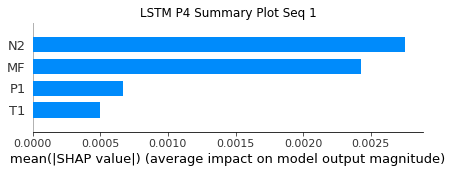

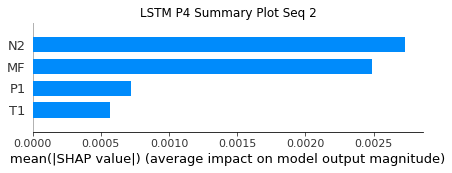

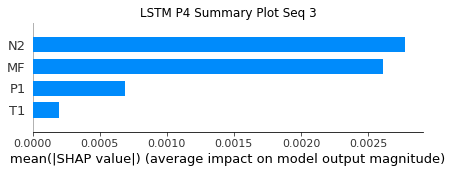

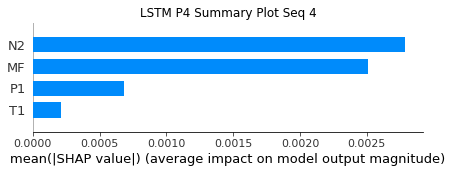

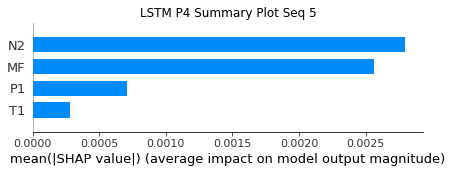

...

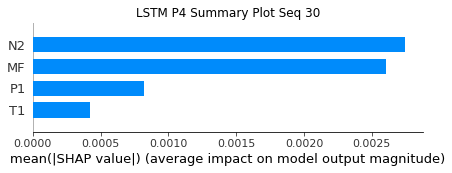

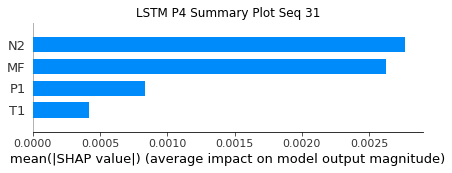

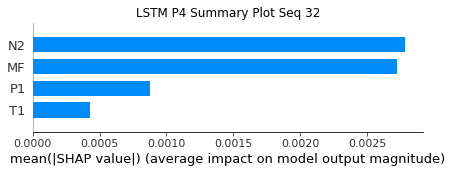

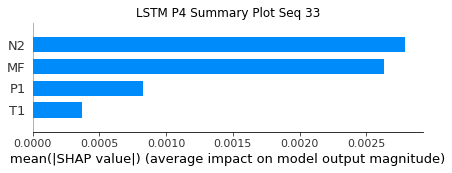

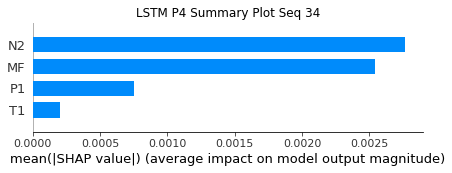

In [32]:
#SHAP Summmary Plot

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="bar")
    plt.title("LSTM P4 Summary Plot Seq %i" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure
    plt.show()

Contribution: [-0.01281367 -0.00904393 -0.05510879 -0.04815559]


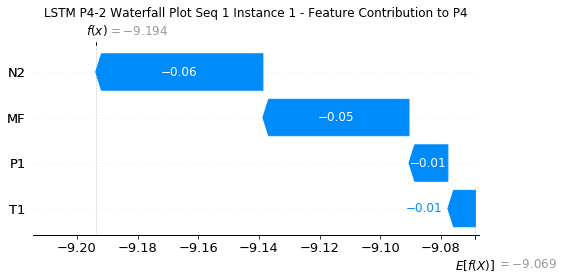

None

Contribution: [ 4.06955726e-05 -1.50948763e-04  9.62178757e-06  2.37784072e-04]


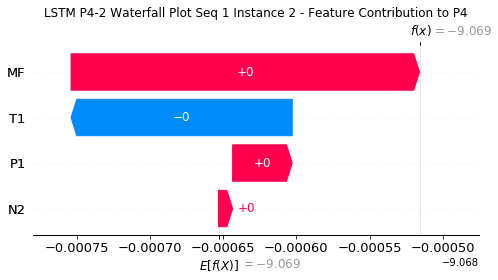

None

Contribution: [-0.00016798 -0.00015684 -0.00057733 -0.00052224]


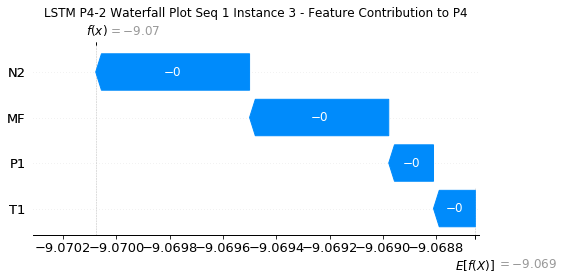

None

Contribution: [-0.00012544 -0.00011696 -0.00042532 -0.00038823]


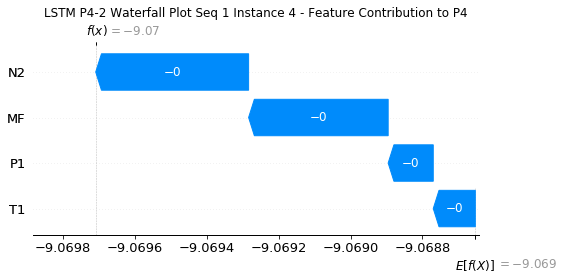

None

Contribution: [-7.44341874e-05 -6.76003024e-05 -2.50052577e-04 -2.27511007e-04]


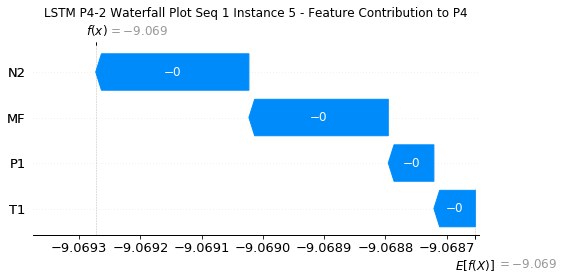

None

Contribution: [-6.06844876e-05 -5.56714180e-05 -2.03308927e-04 -1.84201102e-04]


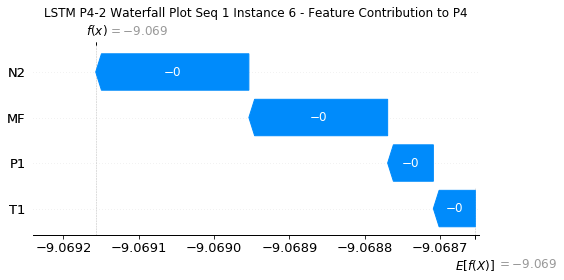

None

Contribution: [-5.86029604e-05 -5.32191179e-05 -1.94130034e-04 -1.76304849e-04]


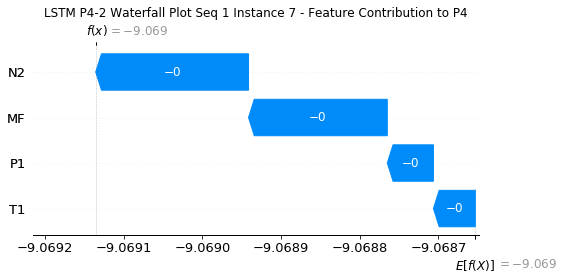

None

Contribution: [-5.64341644e-05 -5.34831055e-05 -1.90080837e-04 -1.70340939e-04]


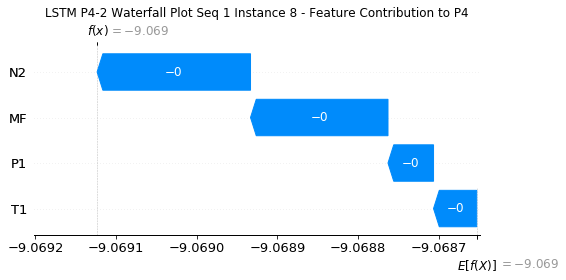

None

Contribution: [-5.71550937e-05 -5.28030517e-05 -1.91273121e-04 -1.73280586e-04]


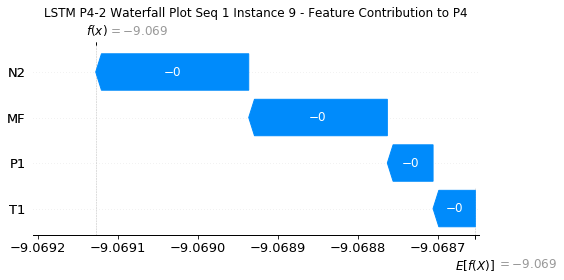

None

Contribution: [-5.75459683e-05 -5.18863861e-05 -1.93448058e-04 -1.74084994e-04]


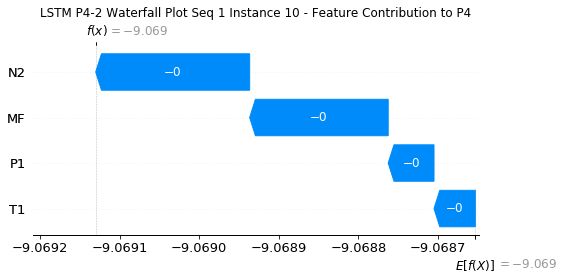

None

Contribution: [-5.91516647e-05 -5.29961884e-05 -1.98364649e-04 -1.78418693e-04]


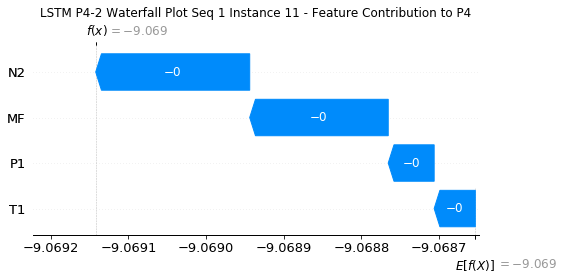

None

Contribution: [-6.12541826e-05 -5.31961074e-05 -2.02674683e-04 -1.82000802e-04]


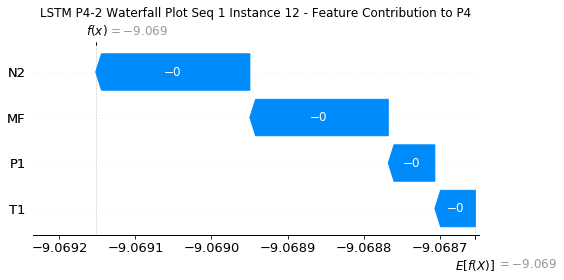

None

Contribution: [-6.15940653e-05 -5.48347334e-05 -2.06213933e-04 -1.85449778e-04]


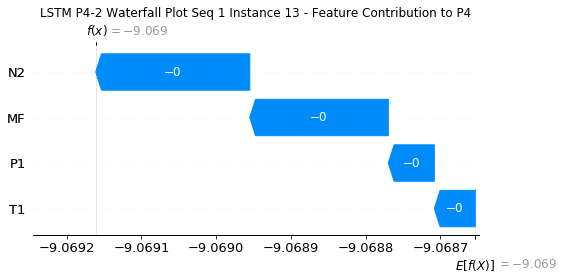

None

Contribution: [-6.11339721e-05 -5.51525205e-05 -2.08800882e-04 -1.86216575e-04]


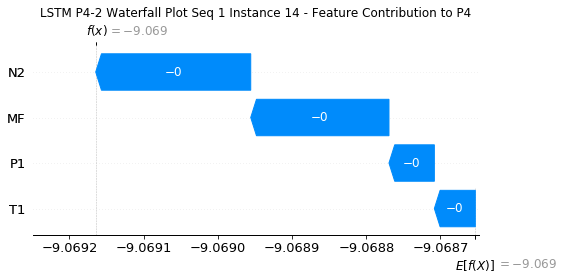

None

Contribution: [-6.38951844e-05 -5.66332976e-05 -2.13510685e-04 -1.91957258e-04]


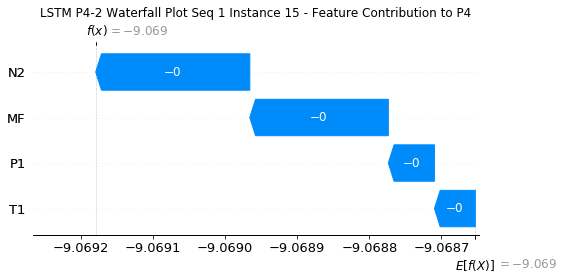

None

Contribution: [-6.57844106e-05 -5.84594526e-05 -2.19869962e-04 -1.97733402e-04]


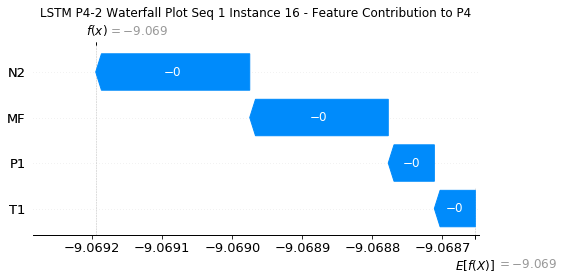

None

Contribution: [-6.83696053e-05 -6.21512851e-05 -2.31190951e-04 -2.08899137e-04]


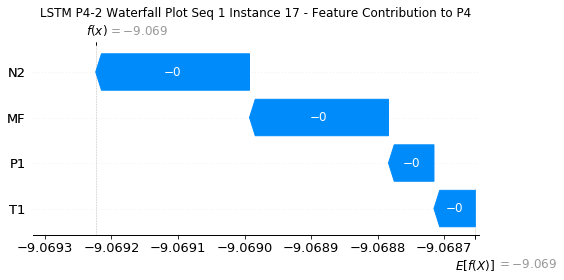

None

Contribution: [-7.45681580e-05 -6.60760942e-05 -2.47659446e-04 -2.22911084e-04]


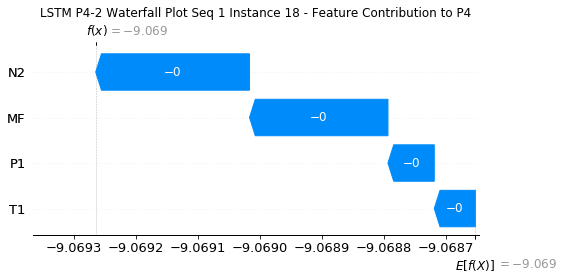

None

Contribution: [-8.34058911e-05 -7.37875281e-05 -2.76413446e-04 -2.48792357e-04]


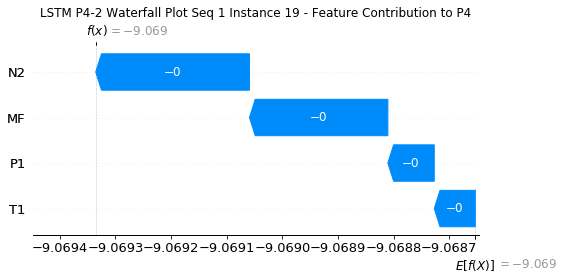

None

Contribution: [-1.01617953e-04 -9.00871651e-05 -3.35863166e-04 -3.02498447e-04]


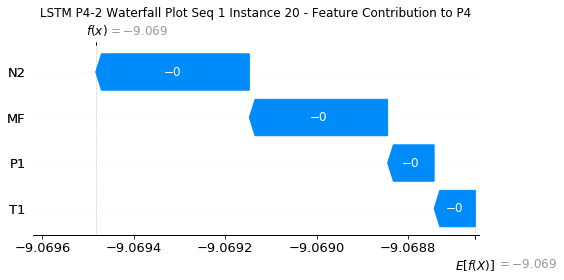

None

Contribution: [-0.00014374 -0.00012903 -0.00047513 -0.00042897]


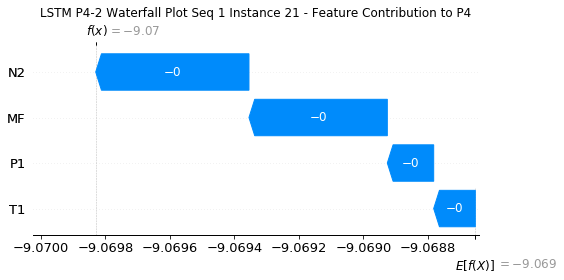

None

Contribution: [-0.00024778 -0.00022591 -0.00081957 -0.00074364]


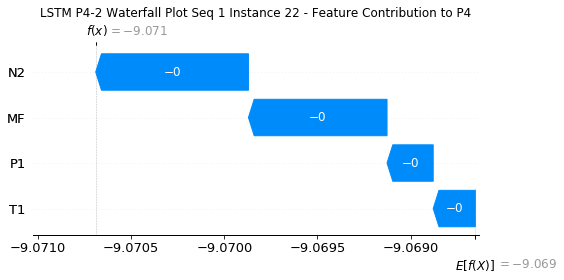

None

Contribution: [-0.00047581 -0.00044619 -0.00161822 -0.00147997]


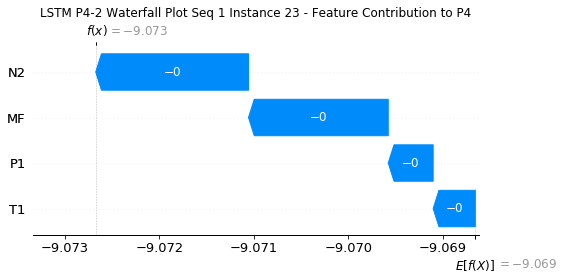

None

Contribution: [-0.00089512 -0.00065502 -0.00342702 -0.00309294]


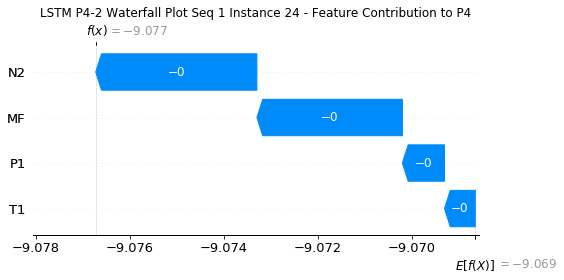

None

Contribution: [-0.01414345 -0.01120775 -0.05461406 -0.04943992]


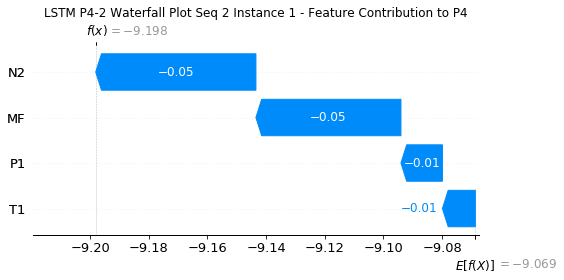

None

Contribution: [ 5.75526684e-05 -1.06380949e-04  3.87625041e-05  2.92721223e-04]


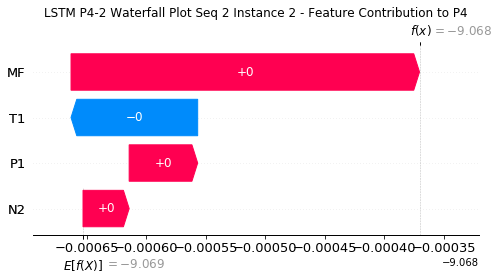

None

Contribution: [-0.00017085 -0.00016946 -0.0005676  -0.00052393]


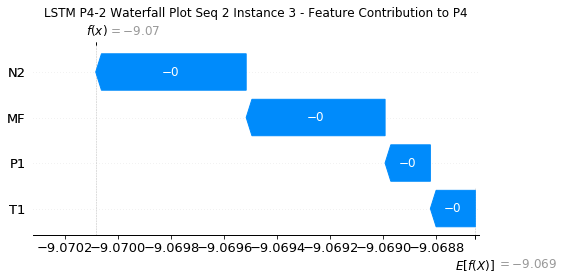

None

Contribution: [-0.00012791 -0.00012583 -0.00042308 -0.00039086]


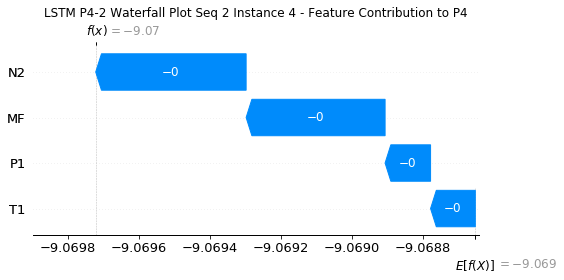

None

Contribution: [-7.55814491e-05 -7.24743247e-05 -2.48654902e-04 -2.29422237e-04]


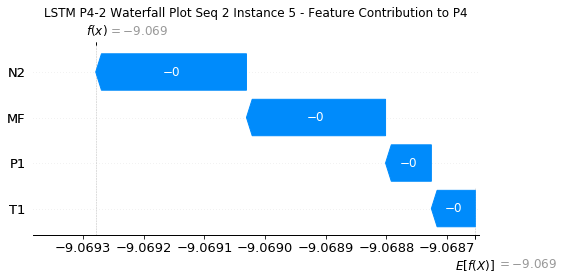

None

Contribution: [-6.18480275e-05 -5.94105158e-05 -2.02994022e-04 -1.85885146e-04]


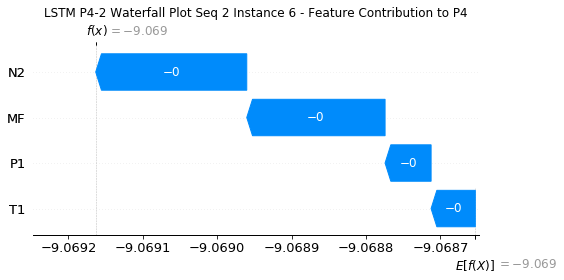

None

Contribution: [-5.87831735e-05 -5.48971204e-05 -1.92592015e-04 -1.76437366e-04]


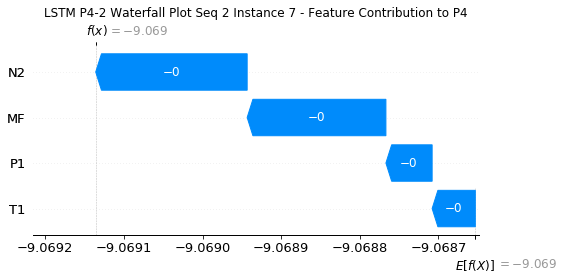

None

Contribution: [-5.71451720e-05 -5.38076040e-05 -1.88525324e-04 -1.70704538e-04]


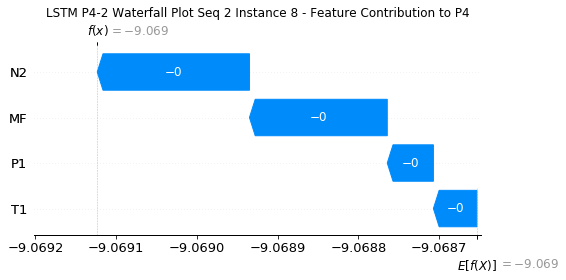

None

Contribution: [-5.81212155e-05 -5.30211324e-05 -1.89446508e-04 -1.72143799e-04]


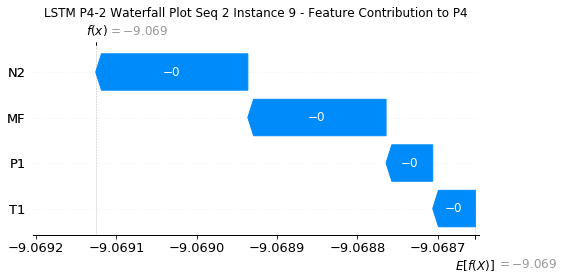

None

Contribution: [-5.82233953e-05 -5.56728411e-05 -1.92576980e-04 -1.74803406e-04]


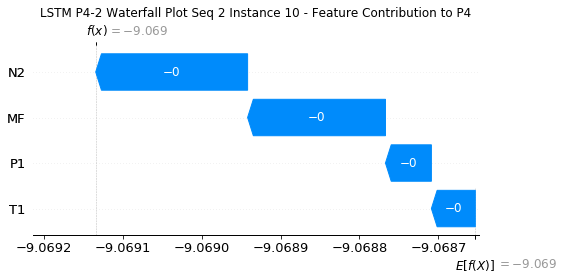

None

Contribution: [-5.96235112e-05 -5.70113647e-05 -1.97453908e-04 -1.79263729e-04]


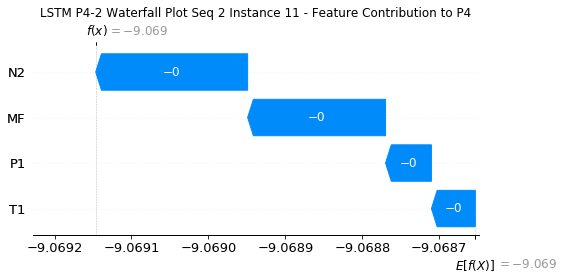

None

Contribution: [-6.12098494e-05 -5.58233535e-05 -2.01485429e-04 -1.83183676e-04]


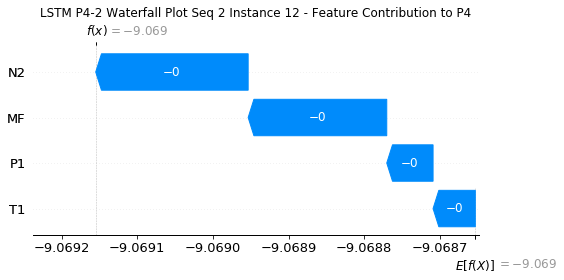

None

Contribution: [-6.19682391e-05 -5.80612386e-05 -2.05044545e-04 -1.85936038e-04]


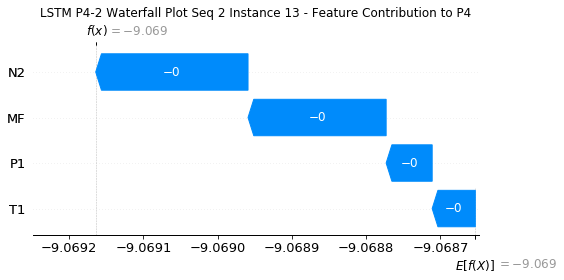

None

Contribution: [-6.16525323e-05 -5.87923547e-05 -2.07977491e-04 -1.88599216e-04]


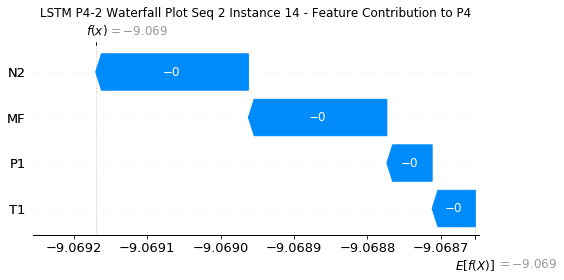

None

Contribution: [-6.39166002e-05 -6.01380518e-05 -2.12103570e-04 -1.91944265e-04]


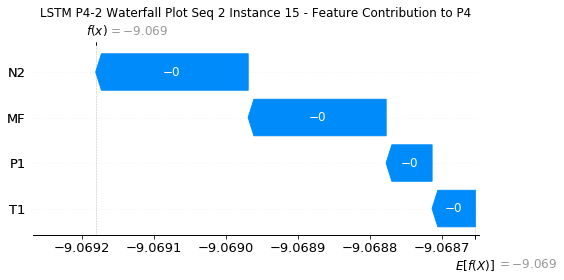

None

Contribution: [-6.58043068e-05 -6.23702952e-05 -2.18270856e-04 -1.97318935e-04]


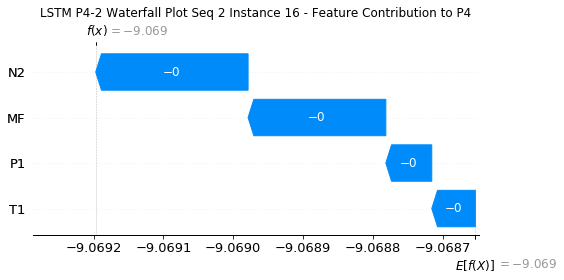

None

Contribution: [-6.77977901e-05 -6.37538630e-05 -2.28657212e-04 -2.03950198e-04]


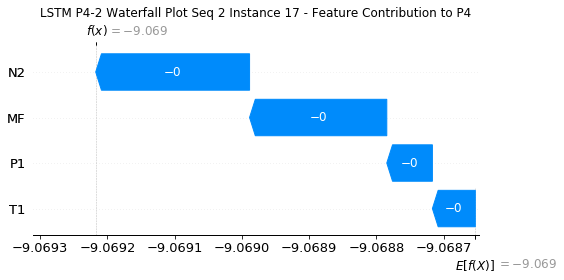

None

Contribution: [-7.43243283e-05 -6.90137105e-05 -2.45922935e-04 -2.22782033e-04]


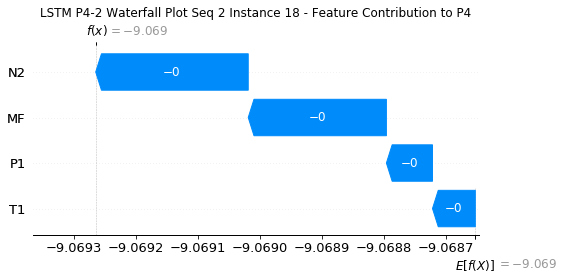

None

Contribution: [-8.32074291e-05 -7.70437262e-05 -2.74433849e-04 -2.48641459e-04]


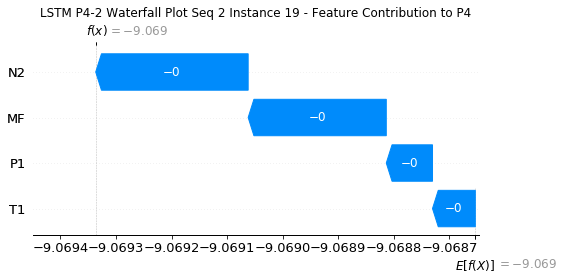

None

Contribution: [-1.01469848e-04 -9.23687199e-05 -3.33488777e-04 -3.02521116e-04]


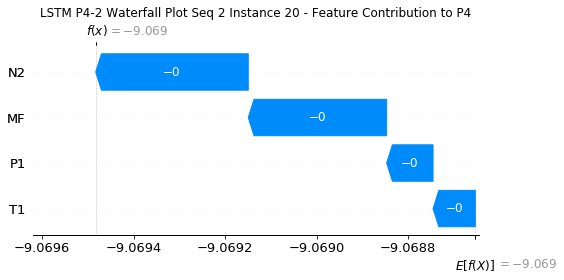

None

Contribution: [-0.00014371 -0.00013339 -0.00047142 -0.00042743]


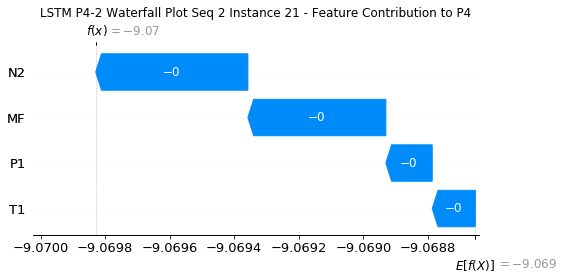

None

Contribution: [-0.00024826 -0.00023848 -0.00081254 -0.0007363 ]


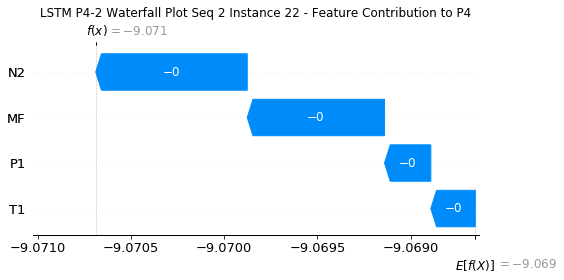

None

Contribution: [-0.00046415 -0.00043609 -0.00159955 -0.00144215]


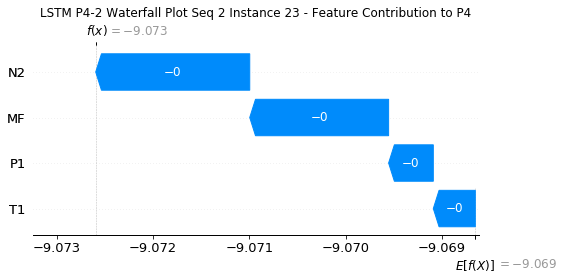

None

Contribution: [-0.00083236 -0.00010172 -0.0034142  -0.00323987]


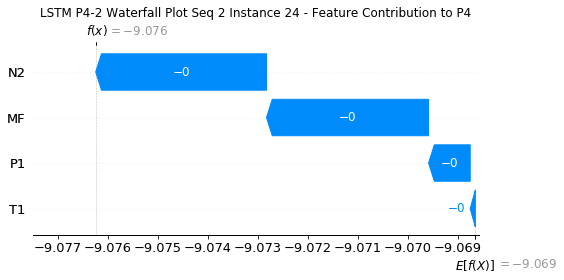

None

Contribution: [-0.01350968 -0.00242123 -0.05566742 -0.05255617]


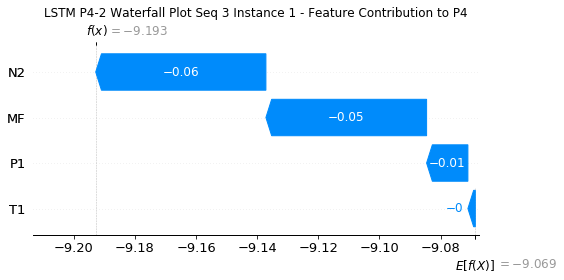

None

Contribution: [ 3.96692678e-05 -2.06847345e-04 -1.07803073e-05  2.59141169e-04]


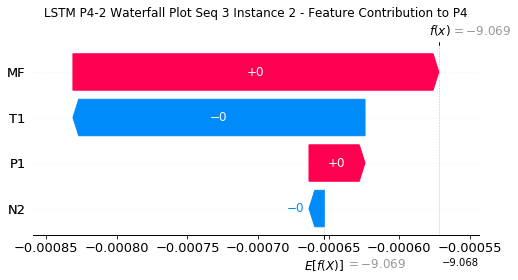

None

Contribution: [-0.00017324 -0.00011135 -0.00058661 -0.00053901]


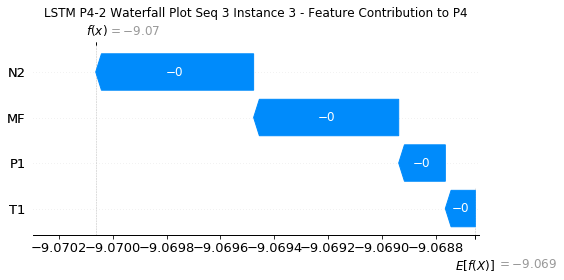

None

Contribution: [-1.27483949e-04 -8.98169591e-05 -4.28214195e-04 -3.94762273e-04]


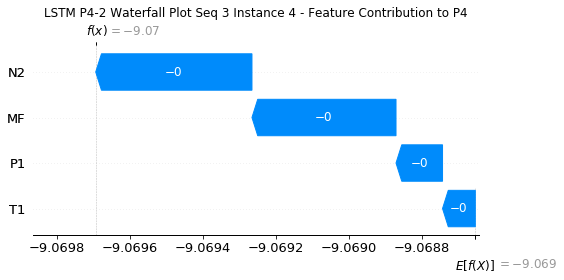

None

Contribution: [-7.47936468e-05 -5.28718038e-05 -2.51034840e-04 -2.30443884e-04]


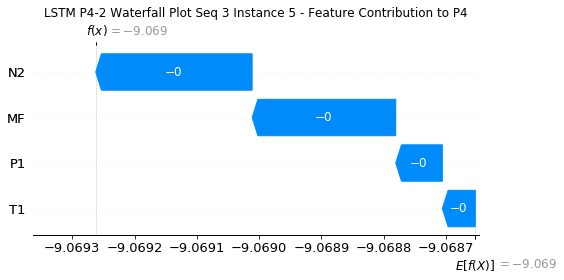

None

Contribution: [-6.10635163e-05 -4.32207212e-05 -2.03592058e-04 -1.85883675e-04]


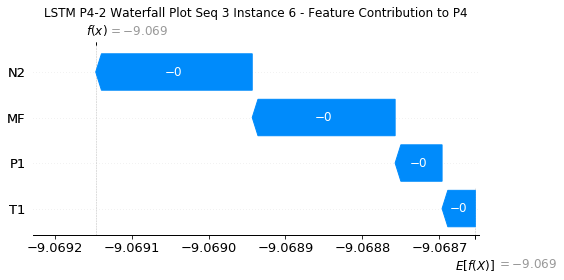

None

Contribution: [-5.72460349e-05 -4.01550419e-05 -1.92916063e-04 -1.75916644e-04]


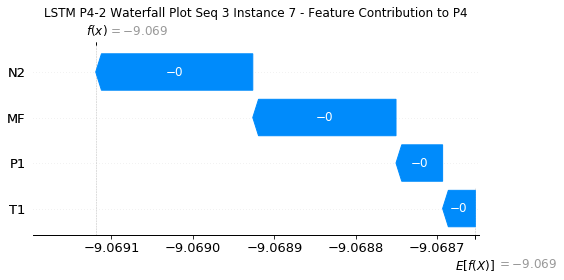

None

Contribution: [-5.72924681e-05 -3.62276118e-05 -1.88877229e-04 -1.70314444e-04]


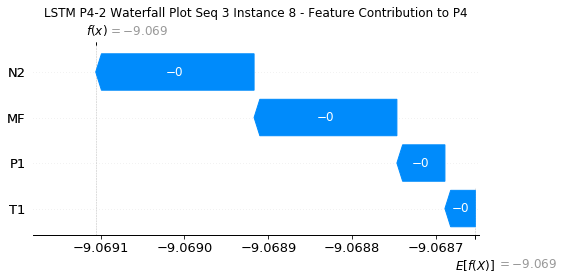

None

Contribution: [-5.65596665e-05 -3.77937483e-05 -1.90017744e-04 -1.71809303e-04]


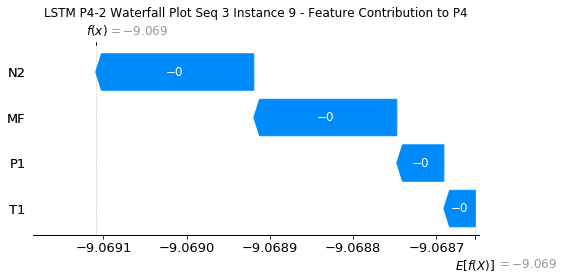

None

Contribution: [-5.76398501e-05 -3.94905772e-05 -1.93594080e-04 -1.75062814e-04]


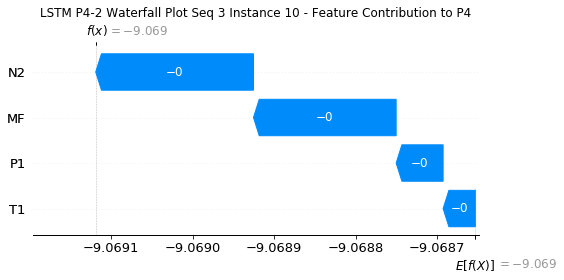

None

Contribution: [-5.90709196e-05 -4.07087429e-05 -1.98559097e-04 -1.79600909e-04]


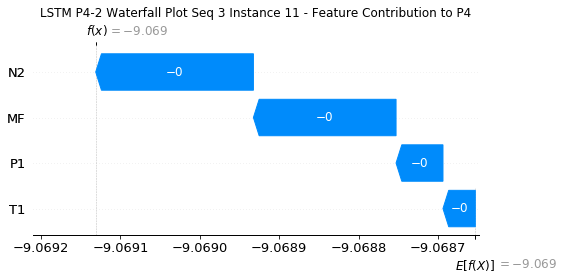

None

Contribution: [-6.05439207e-05 -4.04652191e-05 -2.02369645e-04 -1.82224507e-04]


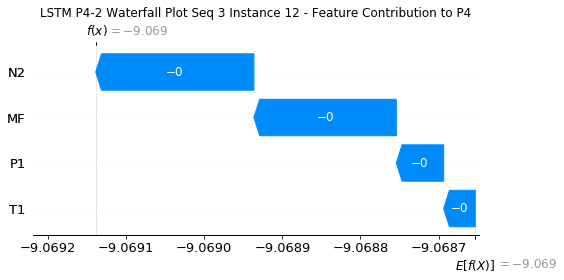

None

Contribution: [-6.13422978e-05 -4.19523171e-05 -2.06427422e-04 -1.86281829e-04]


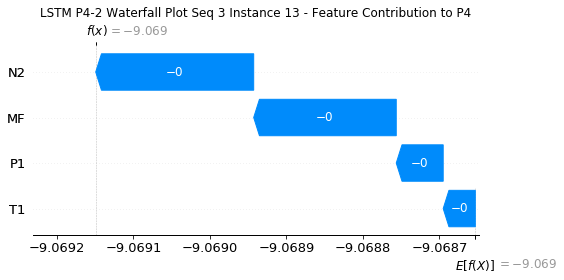

None

Contribution: [-6.24128163e-05 -4.30106286e-05 -2.09301035e-04 -1.88354426e-04]


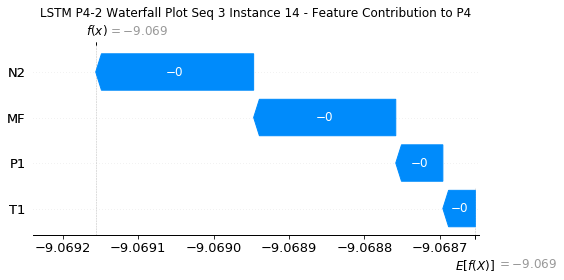

None

Contribution: [-6.33017633e-05 -4.31238308e-05 -2.13734275e-04 -1.92643173e-04]


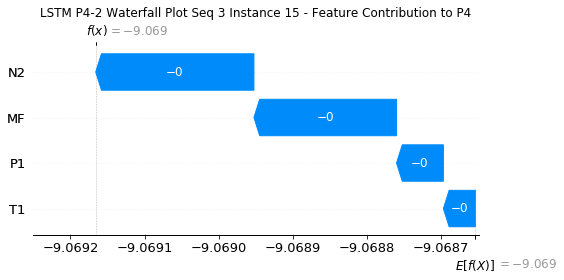

None

Contribution: [-6.52654343e-05 -4.39953720e-05 -2.20124208e-04 -1.98343563e-04]


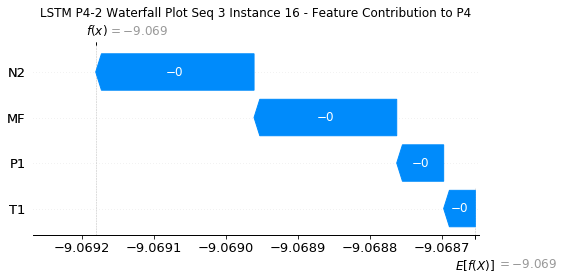

None

Contribution: [-6.88990628e-05 -4.69391251e-05 -2.30934714e-04 -2.07762218e-04]


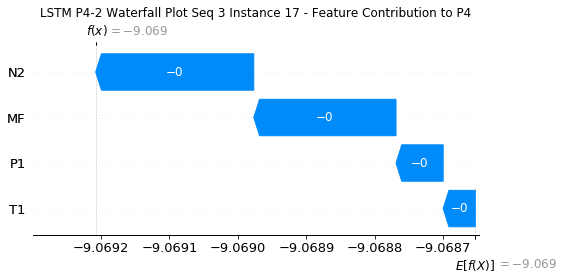

None

Contribution: [-7.35903066e-05 -5.06929853e-05 -2.48153595e-04 -2.23785159e-04]


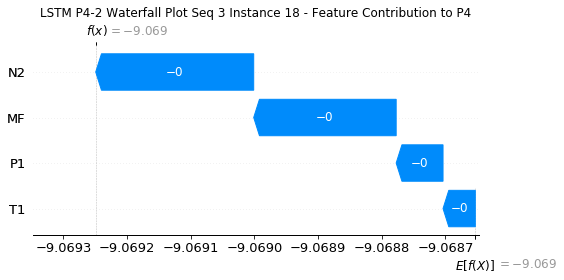

None

Contribution: [-8.24232256e-05 -5.62470141e-05 -2.77138853e-04 -2.49805971e-04]


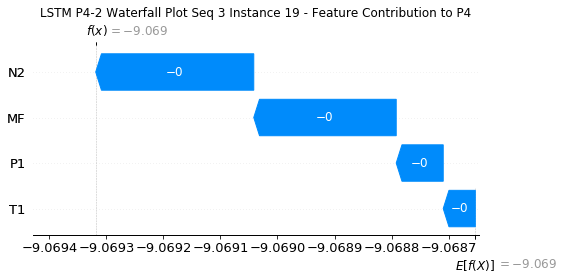

None

Contribution: [-1.00441661e-04 -6.90020541e-05 -3.36965992e-04 -3.03599002e-04]


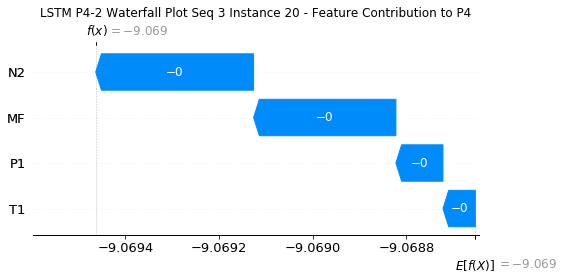

None

Contribution: [-1.42569722e-04 -9.70932222e-05 -4.77085668e-04 -4.30059755e-04]


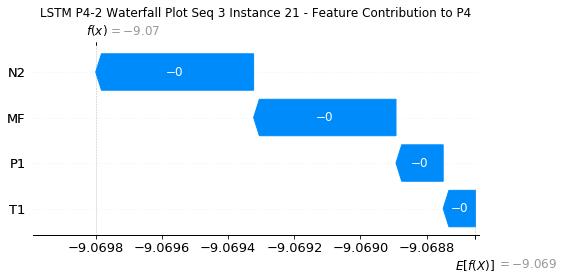

None

Contribution: [-0.00024634 -0.0001684  -0.00082259 -0.00074379]


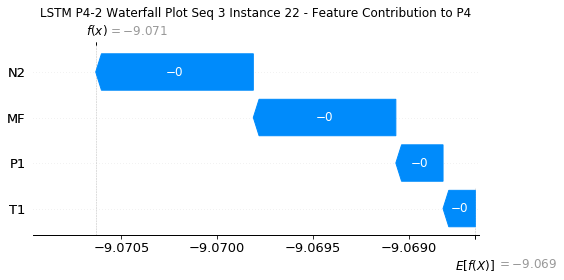

None

Contribution: [-0.00047394 -0.00023166 -0.00161746 -0.00146657]


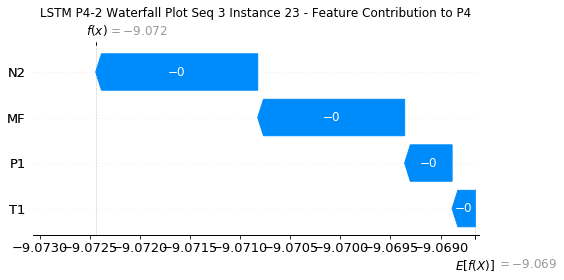

None

Contribution: [-0.00082448  0.00060637 -0.00338313 -0.00305354]


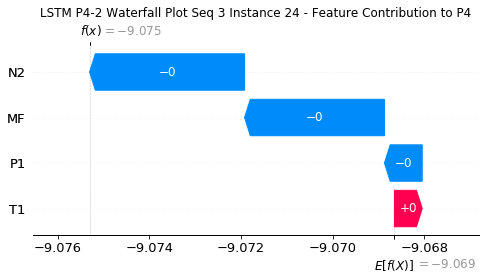

None

Contribution: [-0.01330173  0.00285225 -0.05581133 -0.05006368]


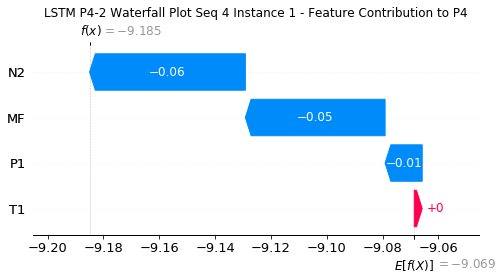

None

Contribution: [ 3.19881846e-05 -2.41964600e-04 -4.31963023e-05  2.15817934e-04]


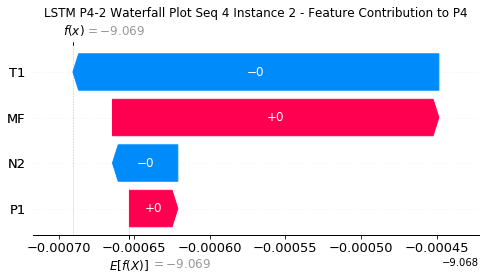

None

Contribution: [-0.00017776 -0.00011322 -0.00059932 -0.00054413]


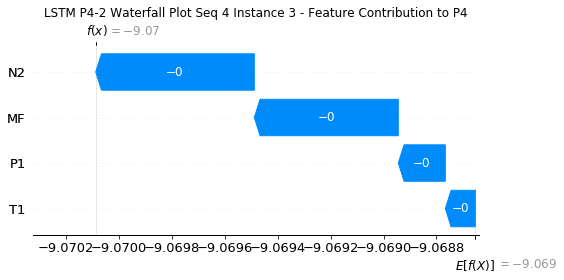

None

Contribution: [-1.28207000e-04 -8.98442371e-05 -4.30500238e-04 -3.94125772e-04]


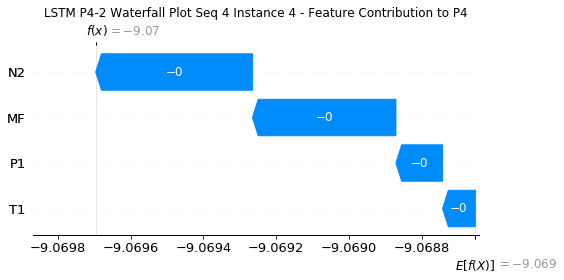

None

Contribution: [-7.52550979e-05 -5.66636573e-05 -2.50585104e-04 -2.28958329e-04]


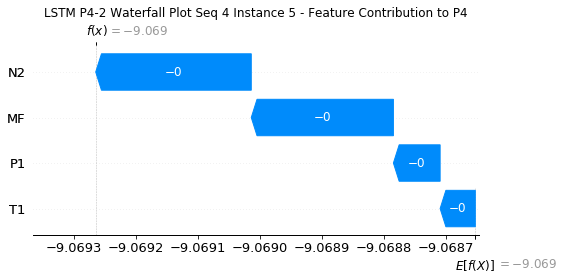

None

Contribution: [-6.11446716e-05 -4.32263063e-05 -2.03359780e-04 -1.84565416e-04]


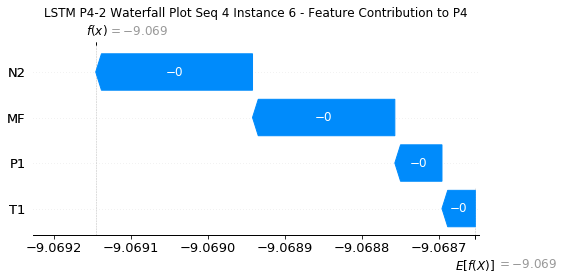

None

Contribution: [-5.88026515e-05 -3.98046294e-05 -1.93488743e-04 -1.75039057e-04]


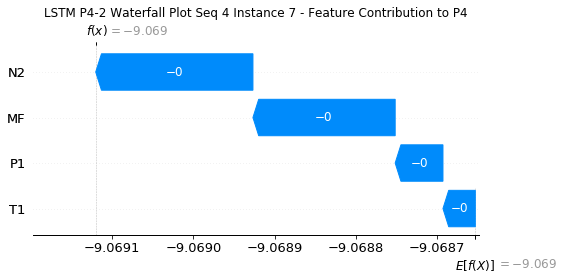

None

Contribution: [-5.71691315e-05 -3.81369899e-05 -1.89785242e-04 -1.70642314e-04]


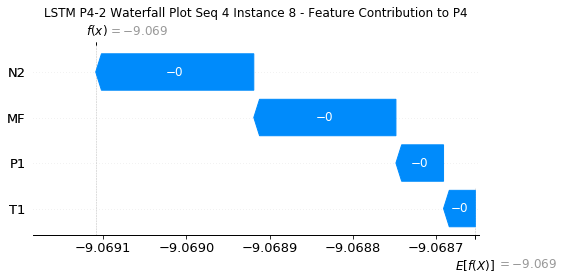

None

Contribution: [-5.67959315e-05 -3.93073508e-05 -1.90812954e-04 -1.72069013e-04]


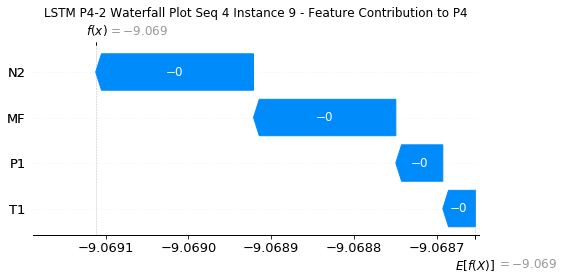

None

Contribution: [-5.80249093e-05 -3.95970843e-05 -1.94132228e-04 -1.75568583e-04]


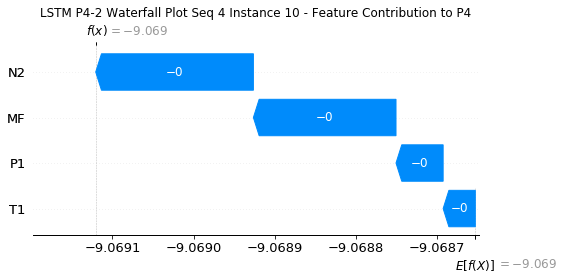

None

Contribution: [-5.97071968e-05 -4.02718179e-05 -1.99125247e-04 -1.79914982e-04]


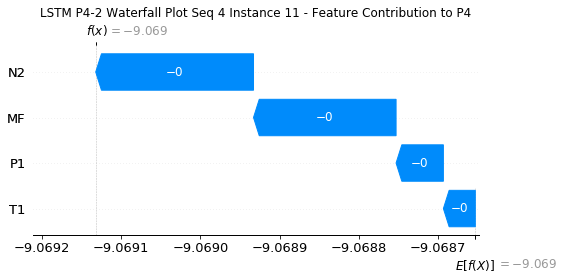

None

Contribution: [-5.89626315e-05 -3.86958743e-05 -2.02826132e-04 -1.82085887e-04]


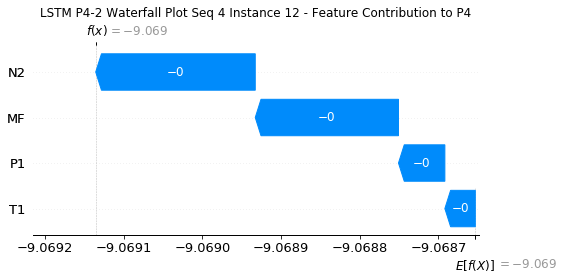

None

Contribution: [-6.19395543e-05 -4.12387217e-05 -2.07258881e-04 -1.87044338e-04]


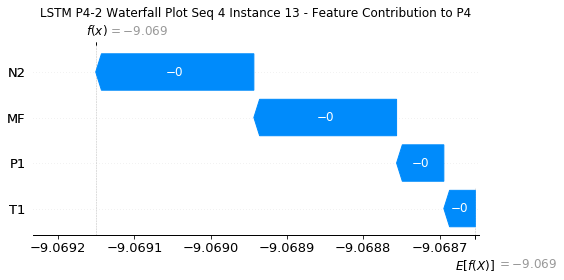

None

Contribution: [-6.33042272e-05 -4.04626152e-05 -2.10580034e-04 -1.89417927e-04]


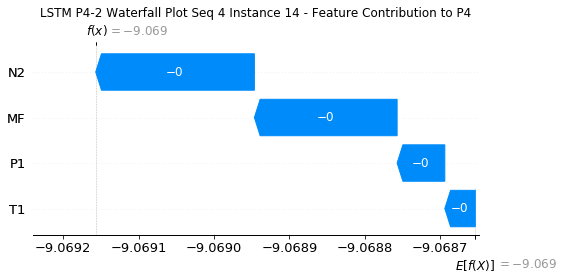

None

Contribution: [-6.42432845e-05 -4.18937325e-05 -2.14868538e-04 -1.93659098e-04]


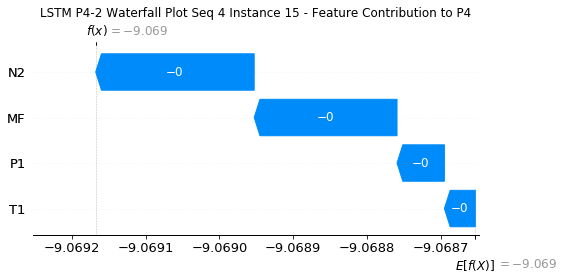

None

Contribution: [-6.60492325e-05 -4.30416284e-05 -2.21465535e-04 -1.99447190e-04]


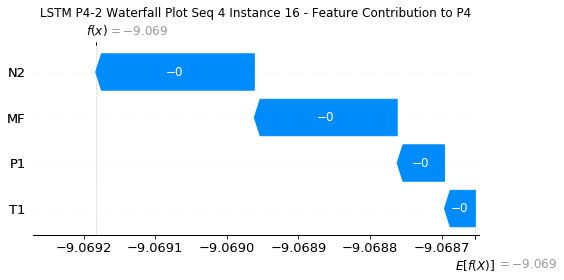

None

Contribution: [-7.02695242e-05 -4.57137869e-05 -2.32670451e-04 -2.09104652e-04]


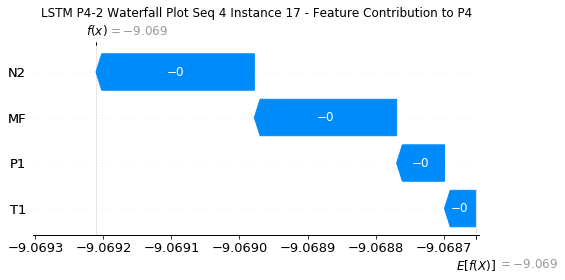

None

Contribution: [-7.48174531e-05 -4.84520845e-05 -2.49686864e-04 -2.24346727e-04]


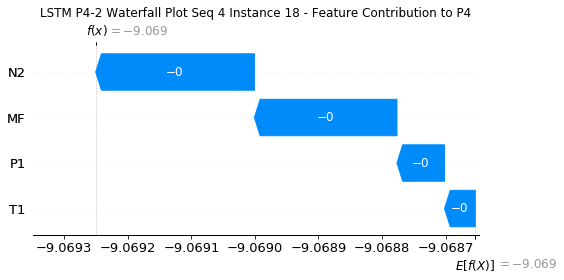

None

Contribution: [-8.35735096e-05 -5.42706430e-05 -2.79036354e-04 -2.50699584e-04]


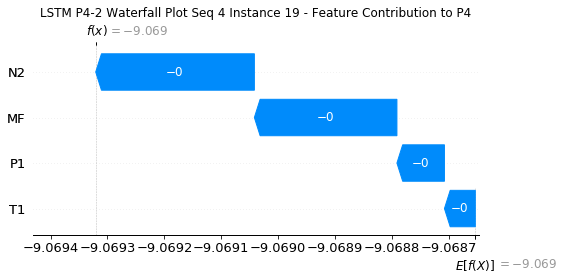

None

Contribution: [-1.01662073e-04 -6.64758690e-05 -3.39410715e-04 -3.04979467e-04]


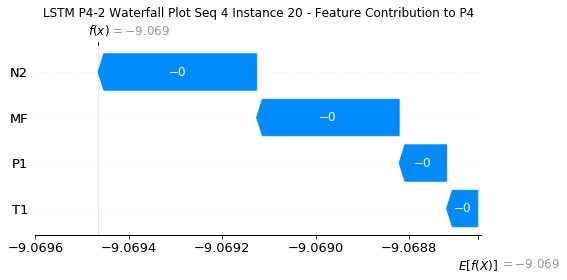

None

Contribution: [-1.43678782e-04 -9.50568413e-05 -4.80963789e-04 -4.33336225e-04]


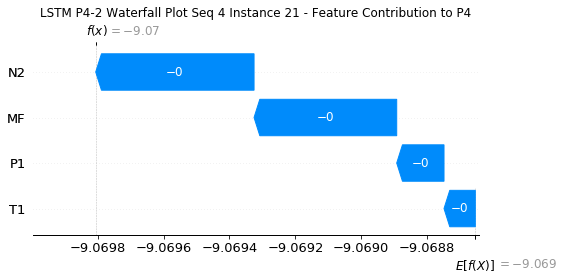

None

Contribution: [-0.00024736 -0.00016531 -0.00082807 -0.00074697]


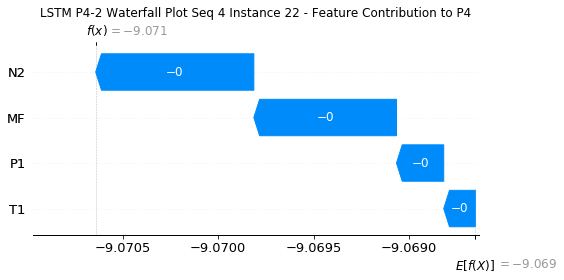

None

Contribution: [-0.00047956 -0.00025477 -0.0016246  -0.0014759 ]


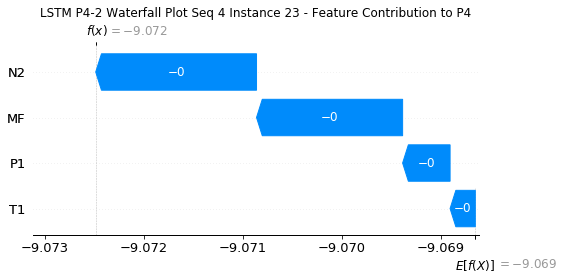

None

Contribution: [-0.00085673  0.00061052 -0.00341964 -0.00314095]


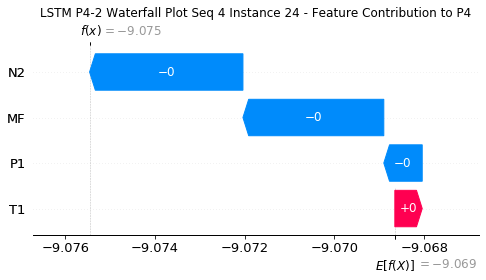

None

Contribution: [-0.01388423  0.00440145 -0.05602018 -0.05118674]


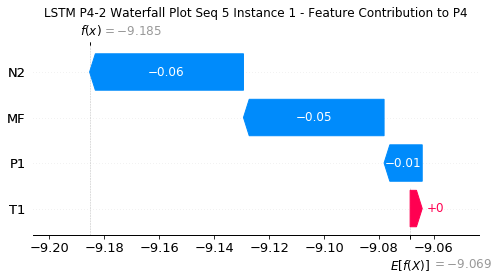

None

Contribution: [ 3.28872513e-05 -2.64744553e-04 -5.44807861e-05  2.13861631e-04]


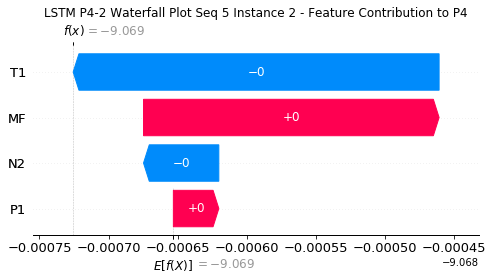

None

Contribution: [-1.77462918e-04 -9.30405283e-05 -6.00982415e-04 -5.53774788e-04]


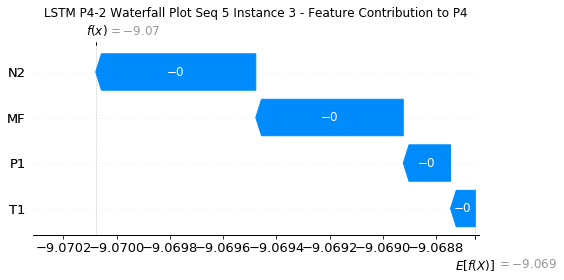

None

Contribution: [-1.28315780e-04 -7.99862026e-05 -4.30971608e-04 -3.98937522e-04]


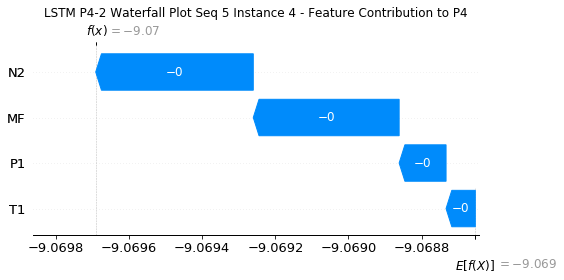

None

Contribution: [-7.55798075e-05 -4.67893879e-05 -2.50054969e-04 -2.30655042e-04]


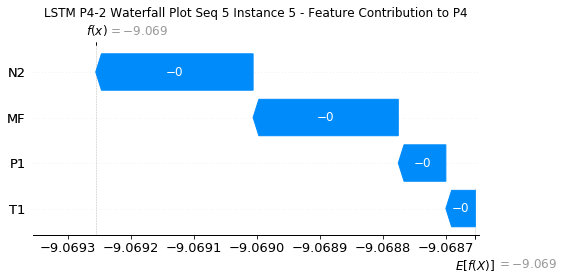

None

Contribution: [-6.10984077e-05 -3.91516292e-05 -2.03493817e-04 -1.86337287e-04]


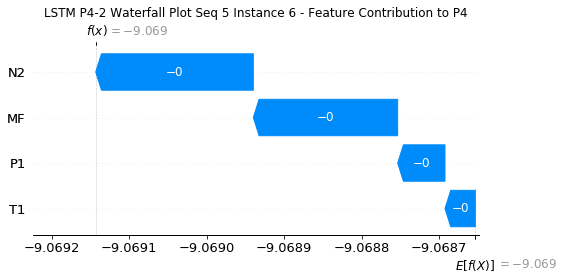

None

Contribution: [-5.83515041e-05 -3.64931750e-05 -1.93489640e-04 -1.75771568e-04]


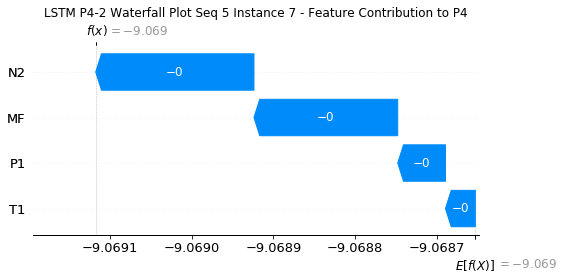

None

Contribution: [-5.60139615e-05 -3.55769109e-05 -1.89349567e-04 -1.70188831e-04]


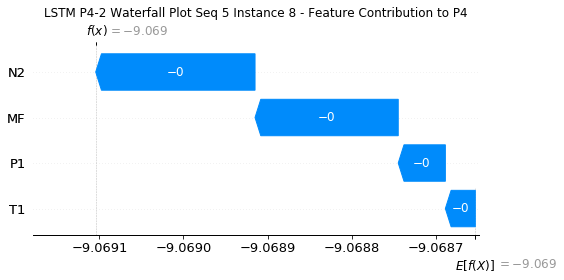

None

Contribution: [-5.71990418e-05 -3.70755951e-05 -1.91183220e-04 -1.74313072e-04]


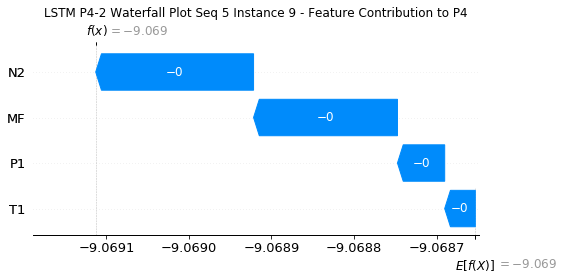

None

Contribution: [-5.83910652e-05 -3.74339776e-05 -1.94365334e-04 -1.77031280e-04]


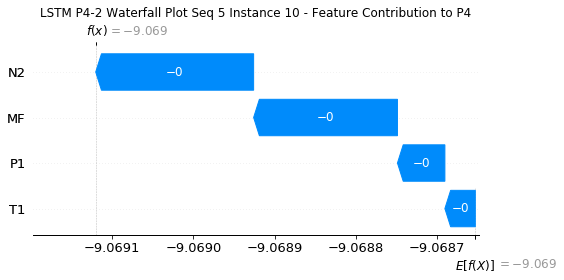

None

Contribution: [-5.98942706e-05 -3.80173183e-05 -1.99385048e-04 -1.81184335e-04]


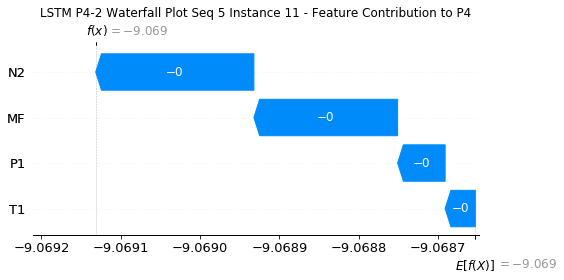

None

Contribution: [-6.01091010e-05 -3.93910721e-05 -2.03647226e-04 -1.84635829e-04]


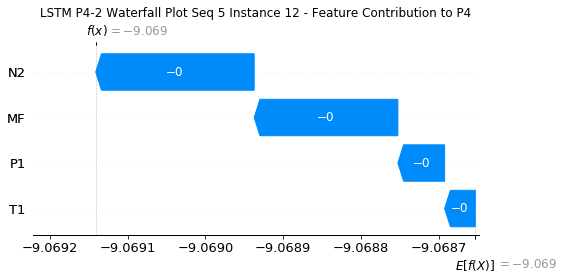

None

Contribution: [-6.22946178e-05 -3.96873487e-05 -2.07591382e-04 -1.88580766e-04]


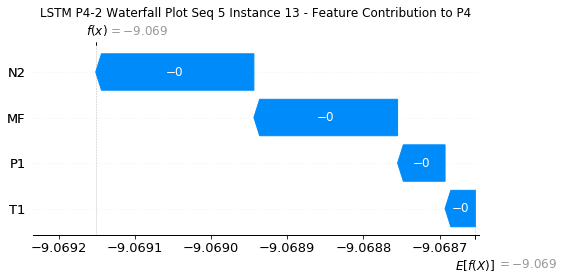

None

Contribution: [-6.35375477e-05 -4.04130656e-05 -2.10352309e-04 -1.88277629e-04]


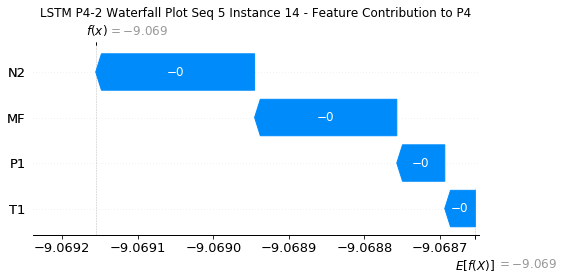

None

Contribution: [-6.44873720e-05 -4.04363094e-05 -2.15131426e-04 -1.94882473e-04]


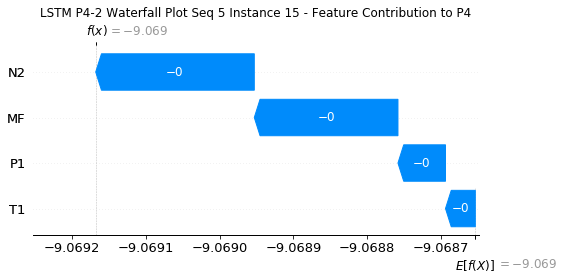

None

Contribution: [-6.61312861e-05 -4.13110747e-05 -2.21599093e-04 -2.00560429e-04]


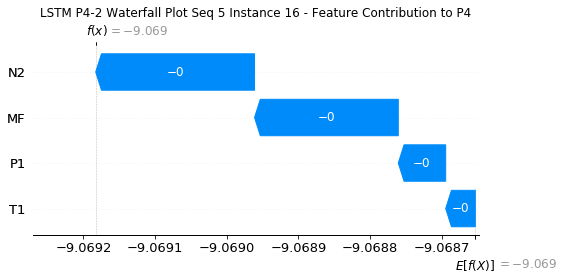

None

Contribution: [-6.85392650e-05 -4.27257357e-05 -2.32353839e-04 -2.10164260e-04]


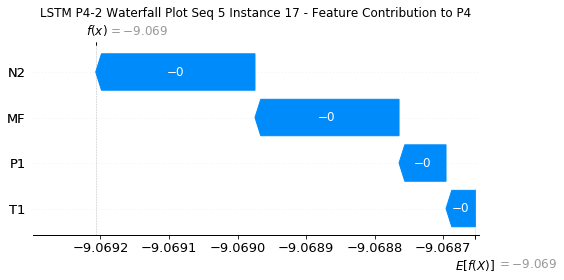

None

Contribution: [-7.43348849e-05 -4.62459140e-05 -2.49785706e-04 -2.25545948e-04]


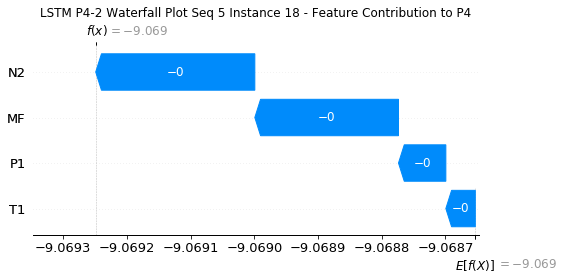

None

Contribution: [-8.30480279e-05 -5.19214818e-05 -2.79118669e-04 -2.52030332e-04]


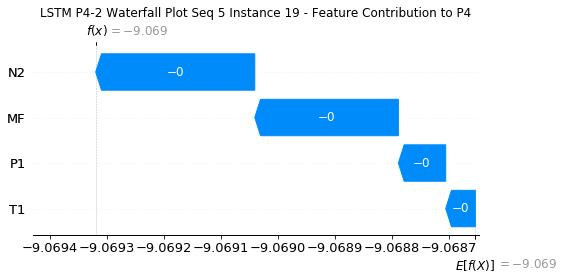

None

Contribution: [-1.01047306e-04 -6.45727147e-05 -3.39603597e-04 -3.07031457e-04]


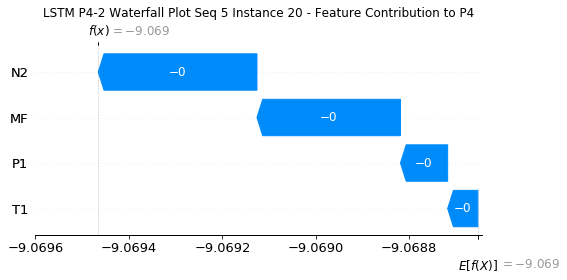

None

Contribution: [-1.43321014e-04 -9.31571296e-05 -4.81078914e-04 -4.36191778e-04]


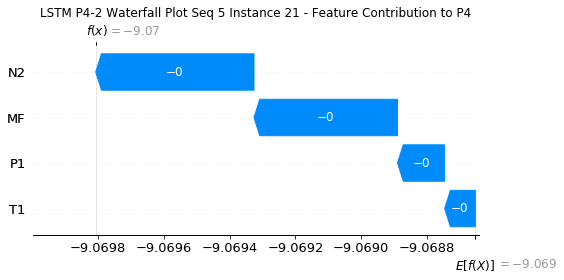

None

Contribution: [-0.00024622 -0.00016223 -0.00082821 -0.00075269]


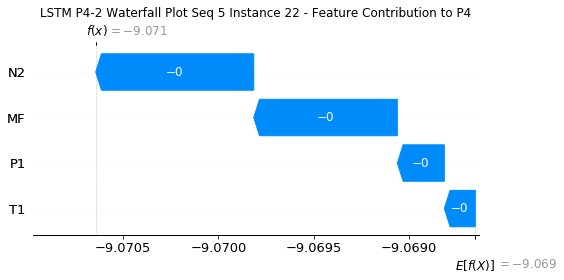

None

Contribution: [-0.0004644  -0.00025487 -0.00162308 -0.00148223]


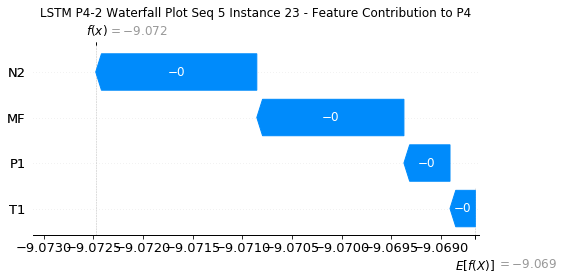

None

Contribution: [-0.00078362  0.00062621 -0.00341558 -0.00319298]


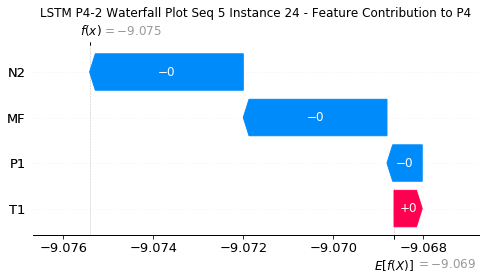

None

Contribution: [-0.01319194  0.00293188 -0.05585341 -0.05248601]


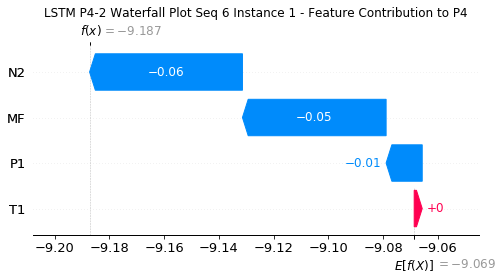

None

Contribution: [ 3.63804005e-05 -2.55367689e-04 -3.48945965e-05  2.57239549e-04]


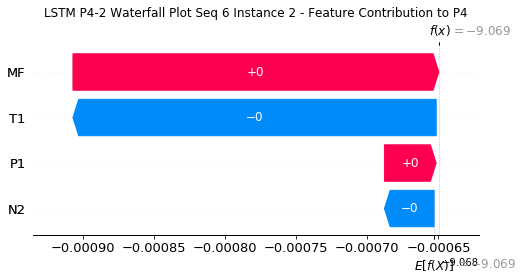

None

Contribution: [-0.00017411 -0.00010558 -0.00059361 -0.00054478]


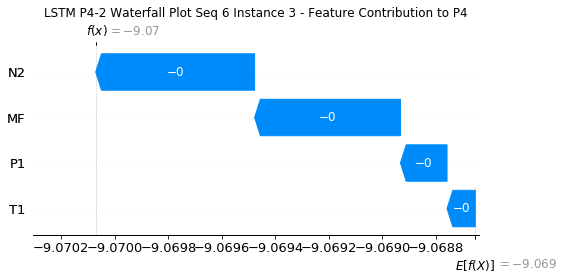

None

Contribution: [-1.27273124e-04 -8.63423150e-05 -4.28508365e-04 -3.95632177e-04]


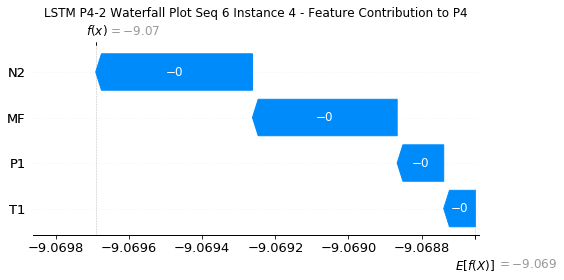

None

Contribution: [-7.29429442e-05 -5.11221536e-05 -2.48864420e-04 -2.28322503e-04]


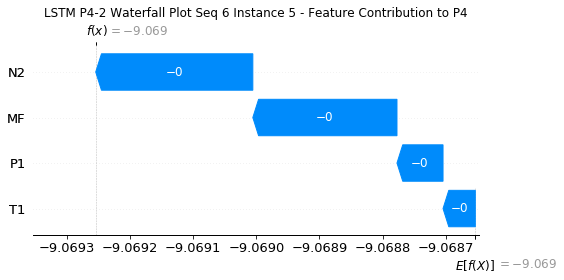

None

Contribution: [-6.08080703e-05 -4.20308579e-05 -2.02906800e-04 -1.85446595e-04]


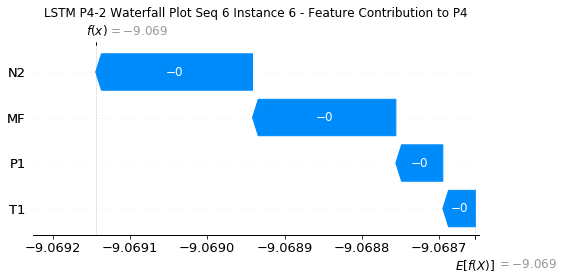

None

Contribution: [-5.75003075e-05 -3.89144504e-05 -1.92675928e-04 -1.74175365e-04]


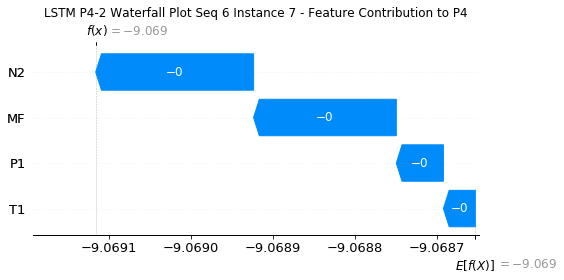

None

Contribution: [-5.55422545e-05 -3.91527761e-05 -1.89678786e-04 -1.72393120e-04]


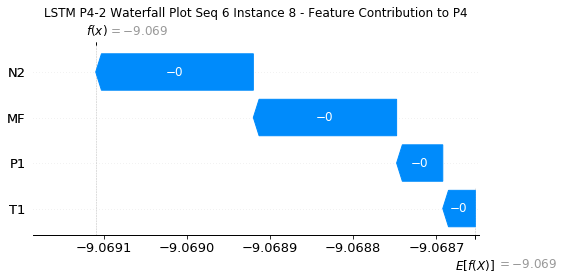

None

Contribution: [-5.69427621e-05 -3.84522209e-05 -1.90814560e-04 -1.73028779e-04]


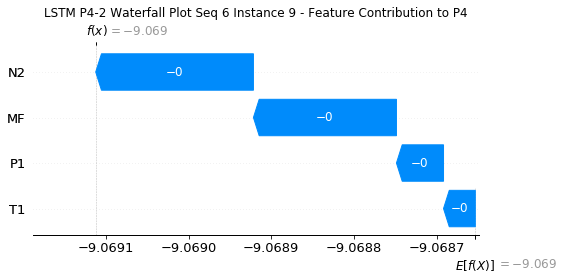

None

Contribution: [-5.78745112e-05 -3.91665952e-05 -1.94012507e-04 -1.77021737e-04]


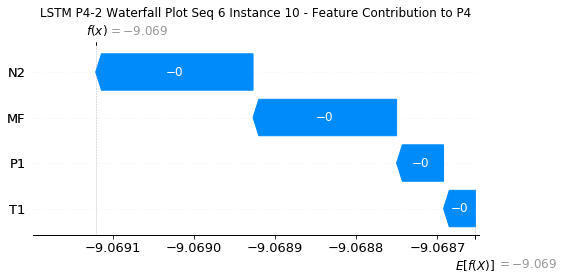

None

Contribution: [-5.94004163e-05 -4.01109249e-05 -1.98979131e-04 -1.81141942e-04]


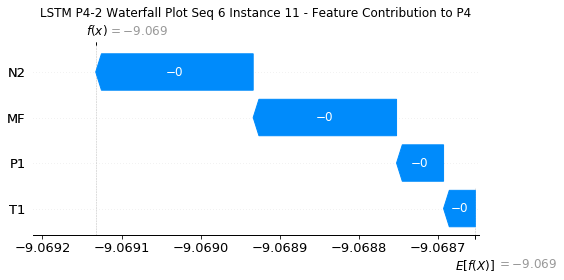

None

Contribution: [-6.18209026e-05 -4.10505190e-05 -2.03361358e-04 -1.85529957e-04]


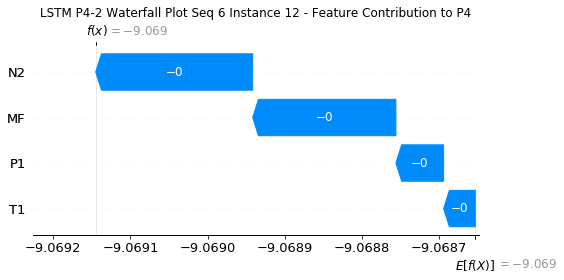

None

Contribution: [-6.18457666e-05 -4.16521976e-05 -2.07166594e-04 -1.88391954e-04]


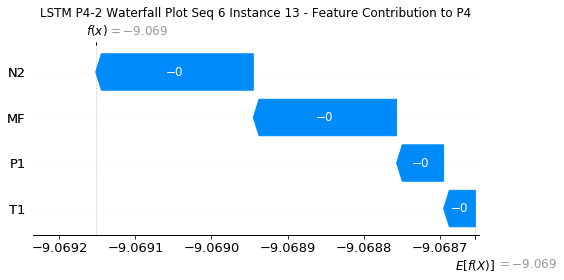

None

Contribution: [-6.28956572e-05 -4.11926521e-05 -2.09381422e-04 -1.89271048e-04]


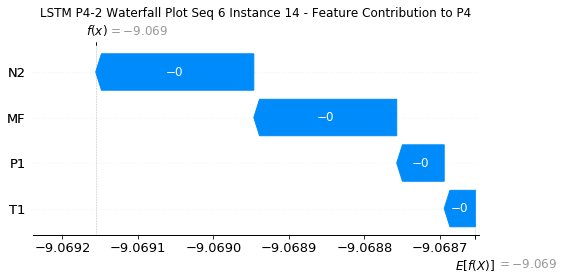

None

Contribution: [-6.40911623e-05 -4.26568446e-05 -2.14605619e-04 -1.94421961e-04]


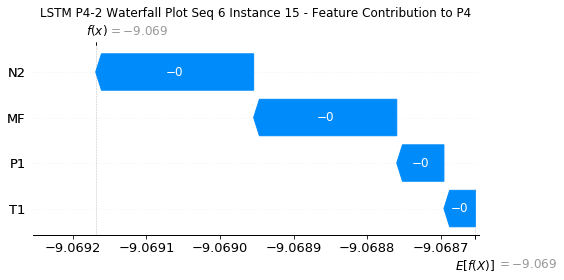

None

Contribution: [-6.62855950e-05 -4.40452041e-05 -2.21204892e-04 -2.00296214e-04]


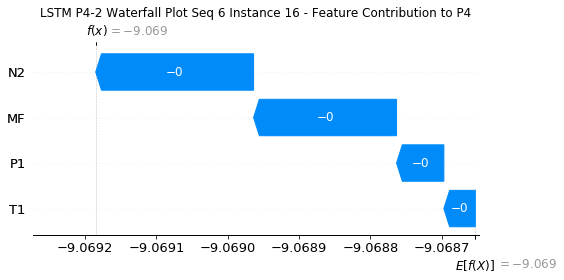

None

Contribution: [-6.88386373e-05 -4.74396116e-05 -2.32114150e-04 -2.09416116e-04]


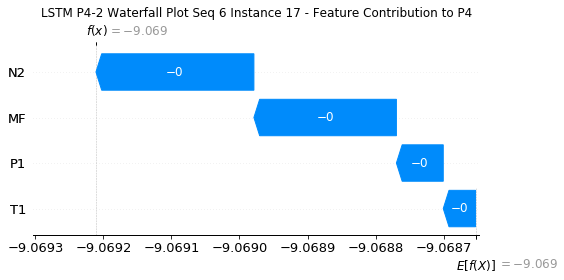

None

Contribution: [-7.46826537e-05 -5.05578554e-05 -2.49175263e-04 -2.24491643e-04]


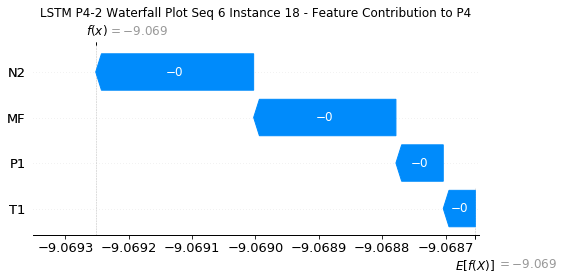

None

Contribution: [-8.38030120e-05 -5.68314723e-05 -2.78529869e-04 -2.51168489e-04]


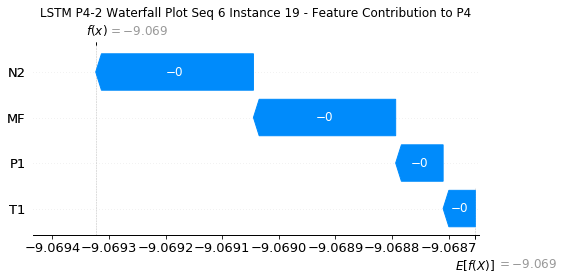

None

Contribution: [-1.02000136e-04 -7.05093952e-05 -3.38948833e-04 -3.06059130e-04]


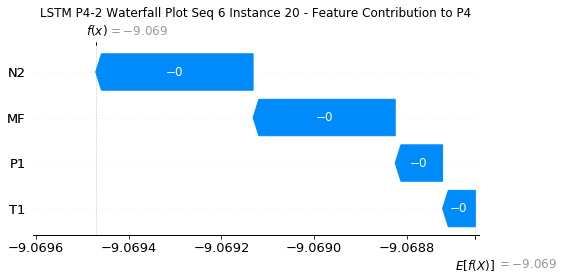

None

Contribution: [-0.00014515 -0.00010057 -0.00048034 -0.00043549]


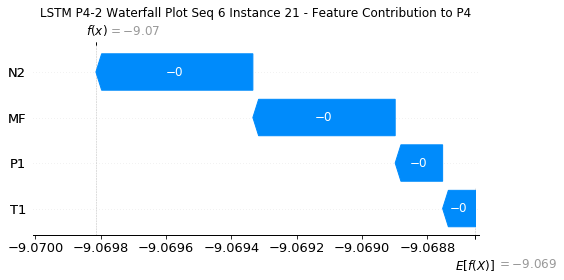

None

Contribution: [-0.00024928 -0.00017578 -0.00082703 -0.00074939]


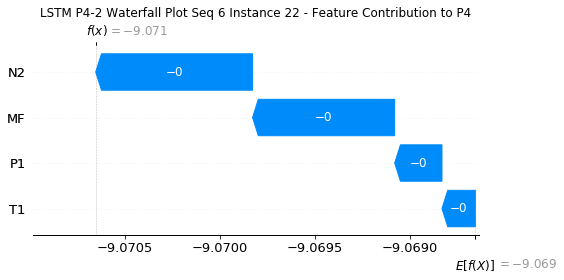

None

Contribution: [-0.00047103 -0.00028232 -0.0016241  -0.00146133]


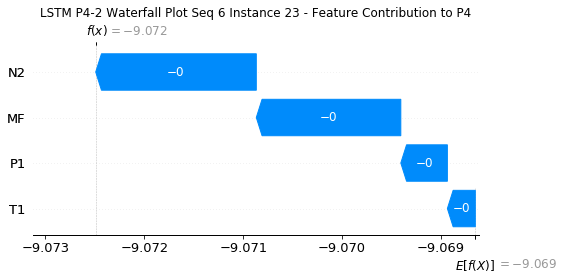

None

Contribution: [-0.00086853  0.00038429 -0.00343835 -0.00316152]


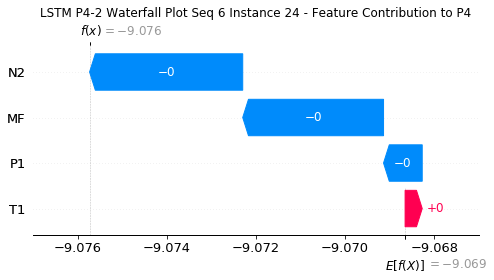

None

Contribution: [-0.01350524  0.00085893 -0.05613285 -0.05104826]


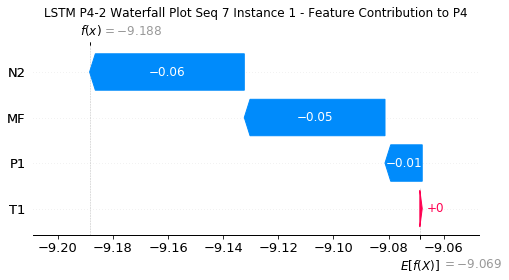

None

Contribution: [ 3.05059181e-05 -2.46956176e-04 -5.20089698e-05  1.97146564e-04]


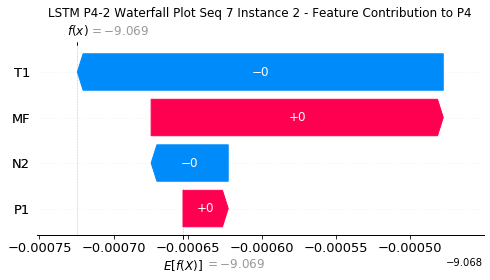

None

Contribution: [-1.76633316e-04 -9.95914614e-05 -5.96120093e-04 -5.43379236e-04]


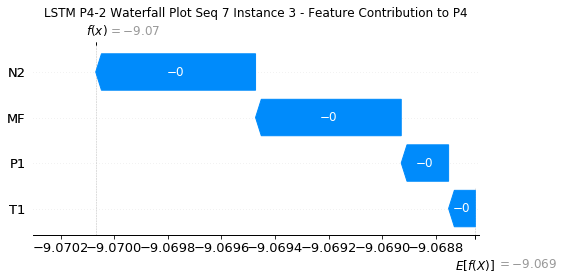

None

Contribution: [-1.28468128e-04 -8.23194307e-05 -4.30427157e-04 -3.94636631e-04]


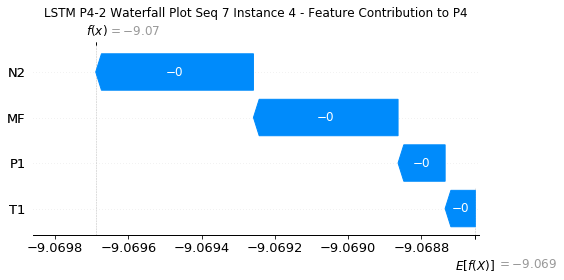

None

Contribution: [-7.43729077e-05 -5.01832825e-05 -2.50618145e-04 -2.30350157e-04]


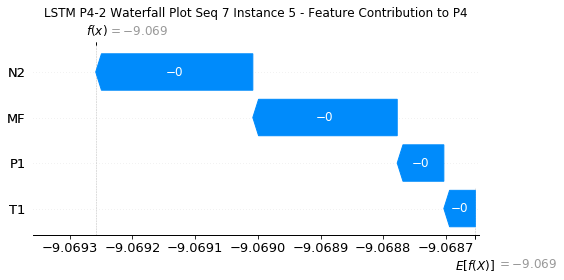

None

Contribution: [-6.12096768e-05 -3.96413668e-05 -2.03529736e-04 -1.84946779e-04]


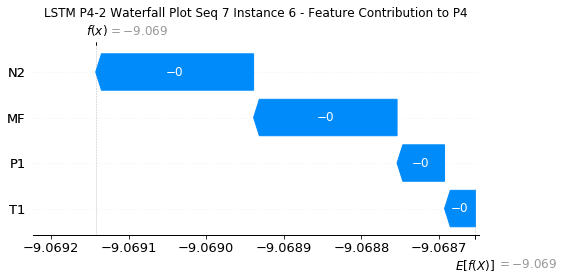

None

Contribution: [-5.77175758e-05 -3.48406490e-05 -1.92270083e-04 -1.74433082e-04]


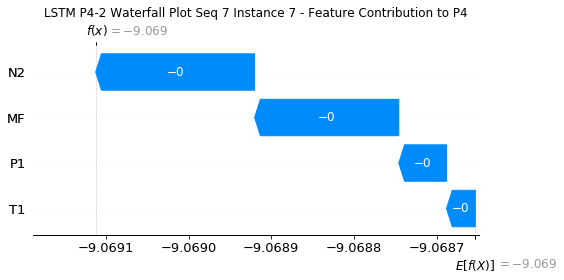

None

Contribution: [-5.72741006e-05 -3.72152299e-05 -1.89313532e-04 -1.70914241e-04]


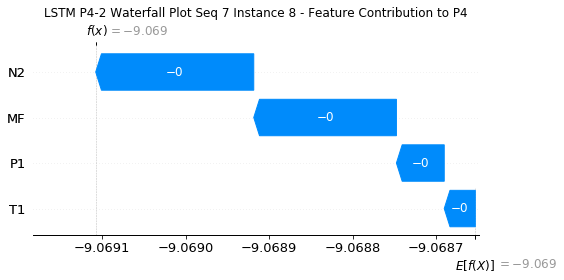

None

Contribution: [-5.69665728e-05 -3.64959718e-05 -1.90076476e-04 -1.71954989e-04]


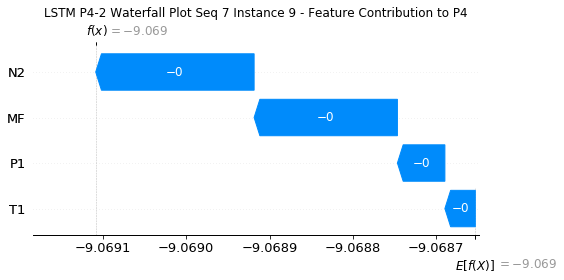

None

Contribution: [-5.81230217e-05 -3.53240328e-05 -1.94181361e-04 -1.75378910e-04]


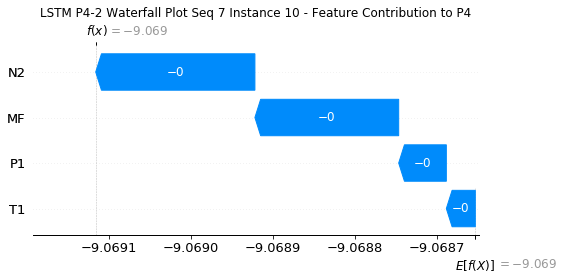

None

Contribution: [-5.95714167e-05 -3.55096700e-05 -1.99125602e-04 -1.79612930e-04]


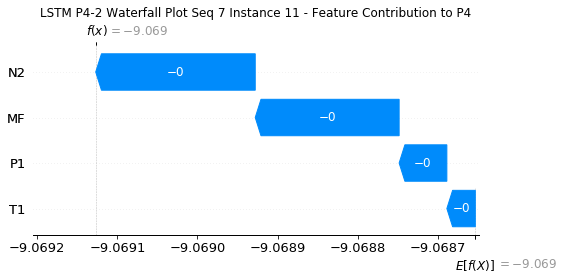

None

Contribution: [-6.11307240e-05 -3.33003430e-05 -2.03293837e-04 -1.82412488e-04]


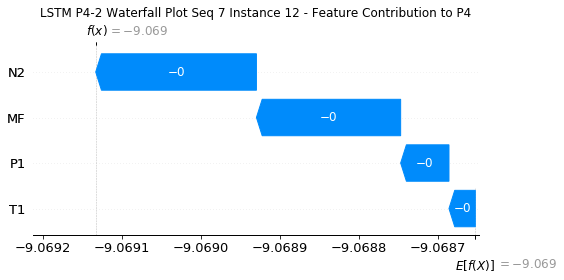

None

Contribution: [-6.18119740e-05 -3.63510430e-05 -2.07185861e-04 -1.86692268e-04]


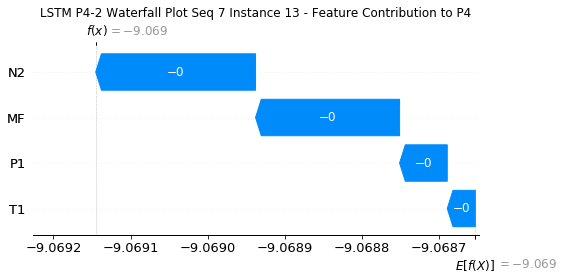

None

Contribution: [-6.29327553e-05 -3.50795609e-05 -2.10599548e-04 -1.88796962e-04]


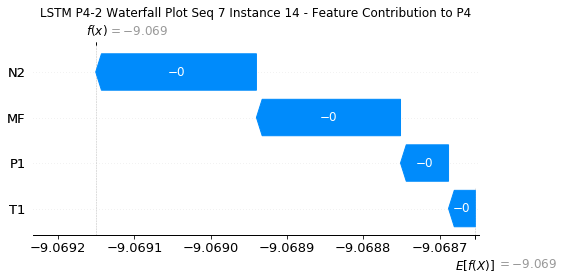

None

Contribution: [-6.37876467e-05 -3.62625981e-05 -2.14725871e-04 -1.92993254e-04]


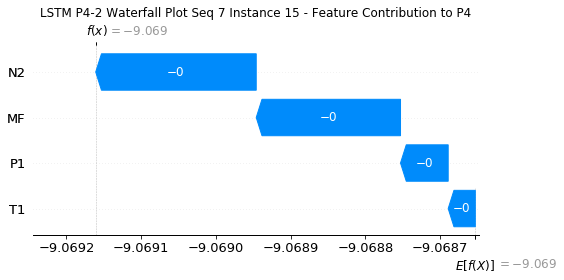

None

Contribution: [-6.57422947e-05 -3.72142160e-05 -2.21392771e-04 -1.98630166e-04]


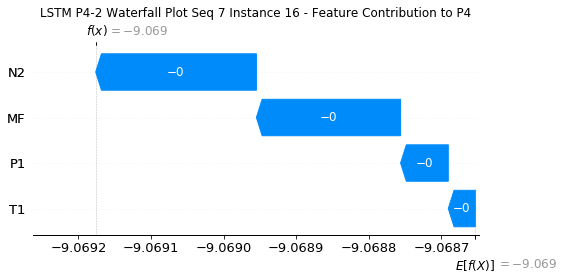

None

Contribution: [-6.92579496e-05 -3.85324796e-05 -2.31995721e-04 -2.06575172e-04]


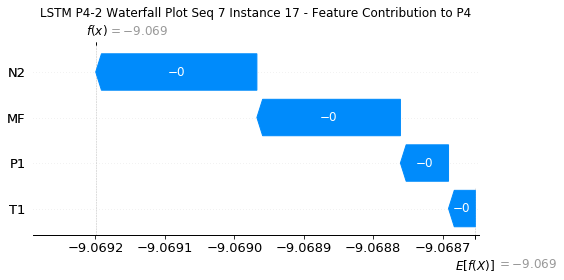

None

Contribution: [-7.38390734e-05 -4.17689189e-05 -2.49494359e-04 -2.23621214e-04]


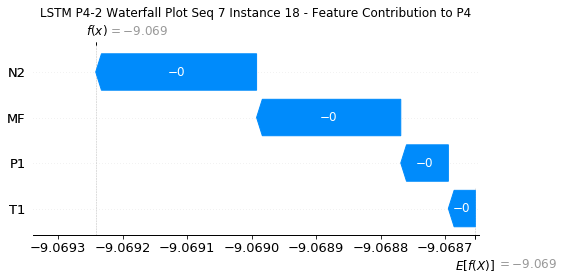

None

Contribution: [-8.27434607e-05 -4.68691920e-05 -2.78933155e-04 -2.49958045e-04]


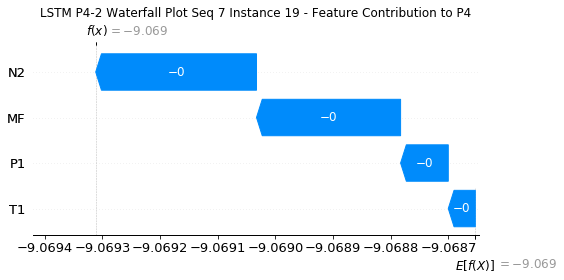

None

Contribution: [-1.00753902e-04 -5.79867772e-05 -3.39237503e-04 -3.04359228e-04]


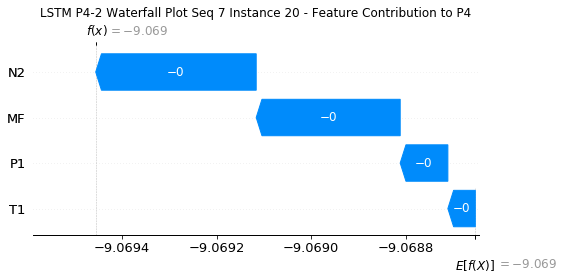

None

Contribution: [-1.43199869e-04 -8.29499211e-05 -4.80924871e-04 -4.31988034e-04]


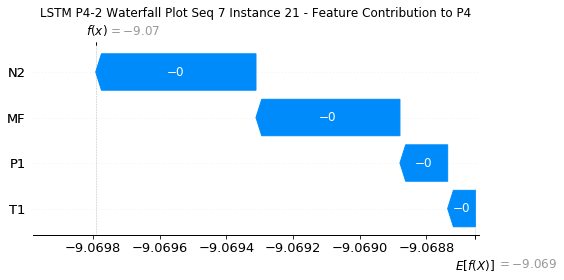

None

Contribution: [-0.00024615 -0.00014548 -0.00082795 -0.00074522]


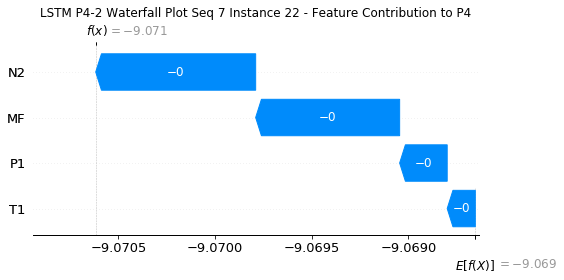

None

Contribution: [-0.00047345 -0.00018888 -0.00162409 -0.00148413]


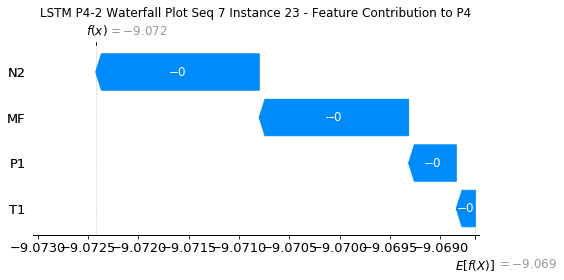

None

Contribution: [-0.00083675  0.00099378 -0.00343791 -0.00320743]


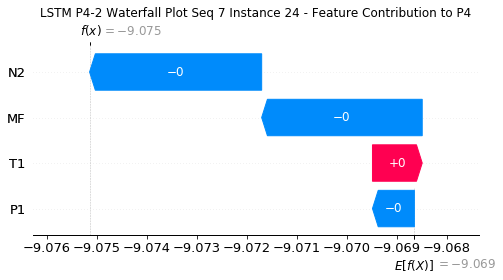

None

Contribution: [-0.0133533   0.00850243 -0.05659299 -0.0530128 ]


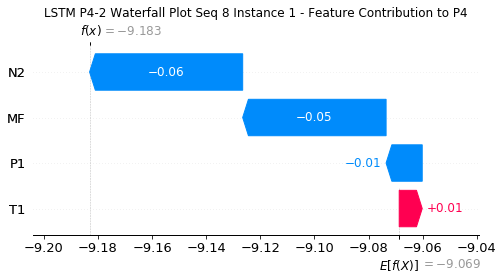

None

Contribution: [ 2.48861960e-05 -2.79084440e-04 -6.38896417e-05  2.20988103e-04]


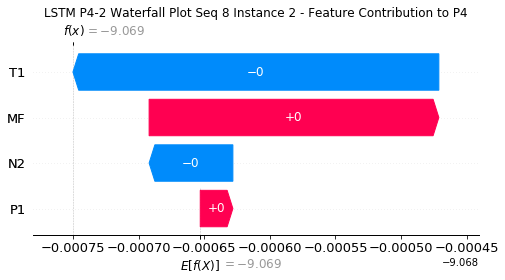

None

Contribution: [-1.81648154e-04 -7.06832397e-05 -6.06530705e-04 -5.55267434e-04]


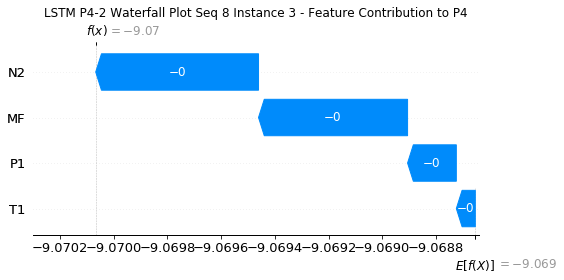

None

Contribution: [-1.27903398e-04 -6.60880166e-05 -4.30917853e-04 -3.95270448e-04]


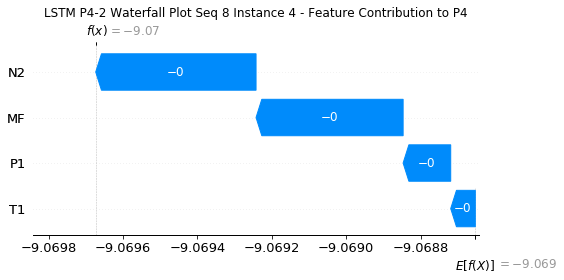

None

Contribution: [-7.50926744e-05 -4.54566978e-05 -2.50613931e-04 -2.30705144e-04]


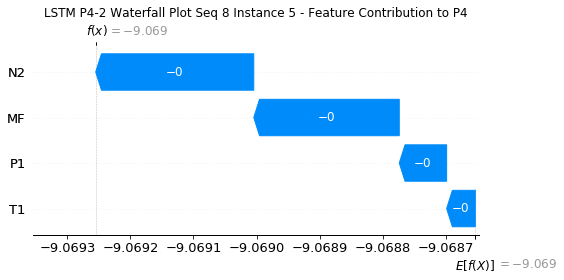

None

Contribution: [-6.05467859e-05 -3.39524750e-05 -2.02918757e-04 -1.84105501e-04]


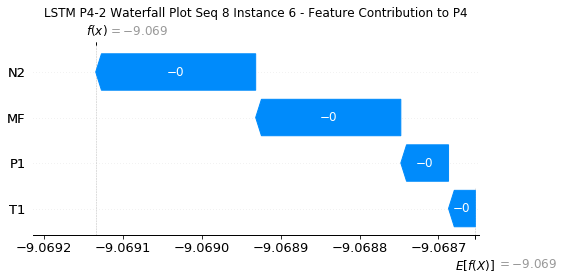

None

Contribution: [-5.79132459e-05 -3.42212626e-05 -1.93913240e-04 -1.76874834e-04]


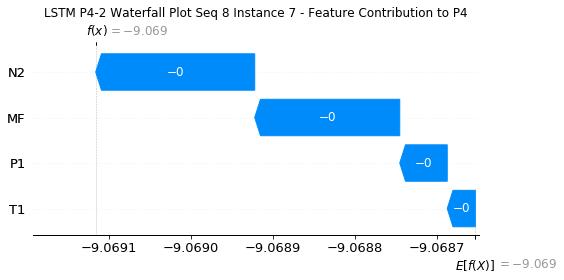

None

Contribution: [-5.62756202e-05 -3.15791766e-05 -1.90052050e-04 -1.72488100e-04]


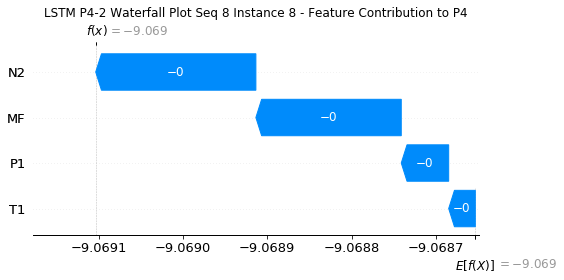

None

Contribution: [-5.63158497e-05 -3.44170415e-05 -1.91358478e-04 -1.73362047e-04]


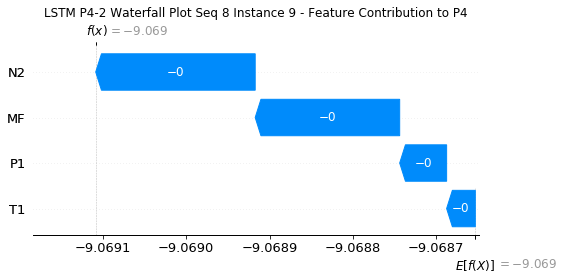

None

Contribution: [-5.79568321e-05 -3.27504523e-05 -1.94613109e-04 -1.76090449e-04]


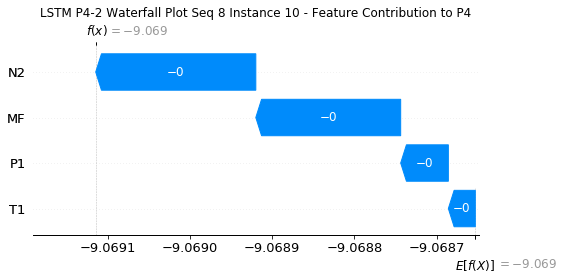

None

Contribution: [-5.95027841e-05 -3.32392034e-05 -1.99666473e-04 -1.80443910e-04]


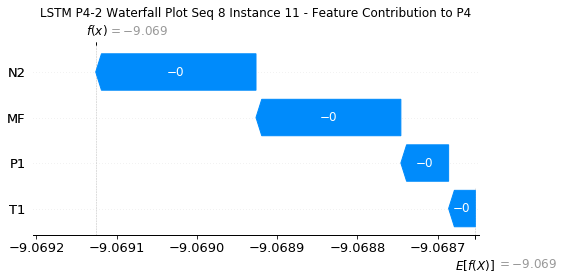

None

Contribution: [-6.00443367e-05 -3.32641730e-05 -2.03973676e-04 -1.82904625e-04]


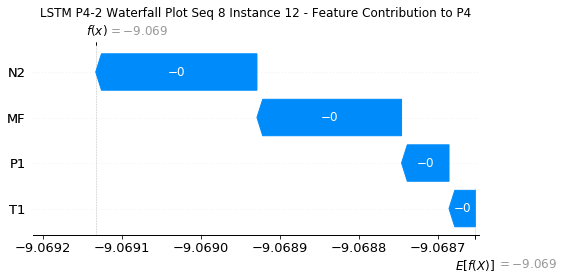

None

Contribution: [-6.25121347e-05 -3.53011716e-05 -2.08596150e-04 -1.89036580e-04]


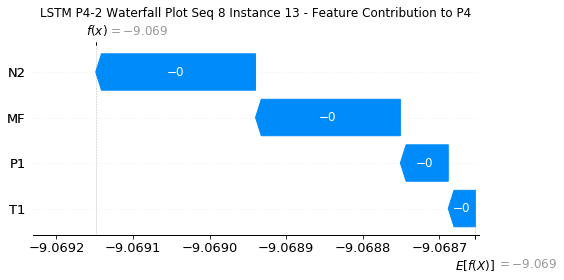

None

Contribution: [-6.37420757e-05 -3.38642578e-05 -2.11933224e-04 -1.90875302e-04]


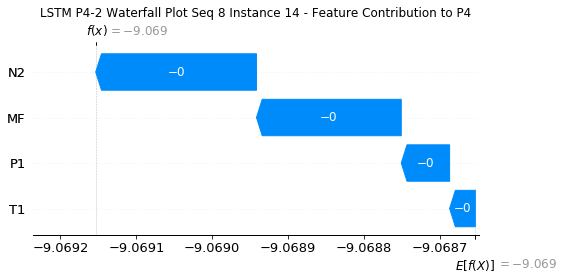

None

Contribution: [-6.39502174e-05 -3.56332802e-05 -2.16120468e-04 -1.94751236e-04]


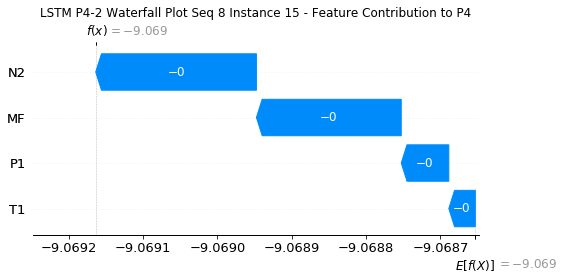

None

Contribution: [-6.46215227e-05 -3.58804690e-05 -2.22125777e-04 -1.98168408e-04]


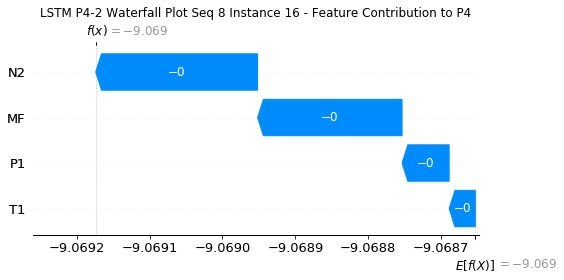

None

Contribution: [-6.81465977e-05 -3.89854059e-05 -2.33797331e-04 -2.09995992e-04]


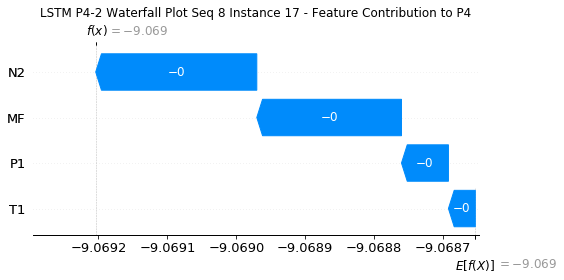

None

Contribution: [-7.41526460e-05 -4.14822594e-05 -2.51101262e-04 -2.24819536e-04]


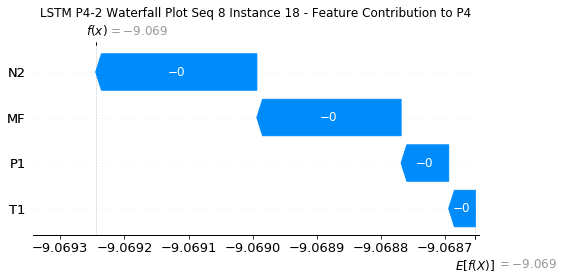

None

Contribution: [-8.25159505e-05 -4.66534316e-05 -2.80455731e-04 -2.49962556e-04]


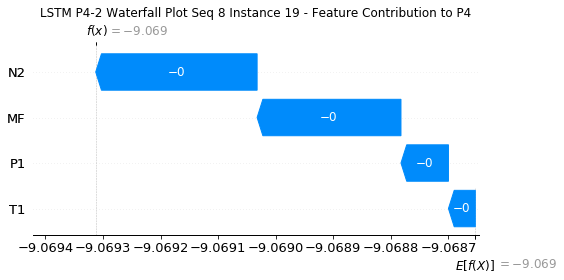

None

Contribution: [-1.02475067e-04 -5.95956427e-05 -3.42062379e-04 -3.07174697e-04]


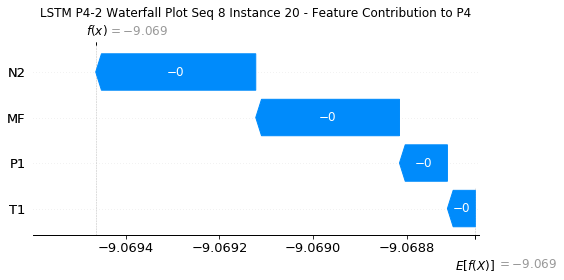

None

Contribution: [-1.43107794e-04 -8.50041914e-05 -4.84512302e-04 -4.33447395e-04]


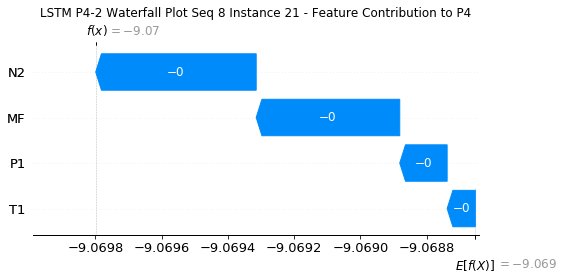

None

Contribution: [-0.00025083 -0.00014696 -0.00083688 -0.00076363]


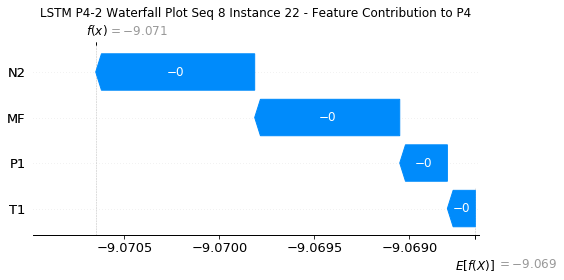

None

Contribution: [-0.00046133 -0.00017394 -0.00163746 -0.00149545]


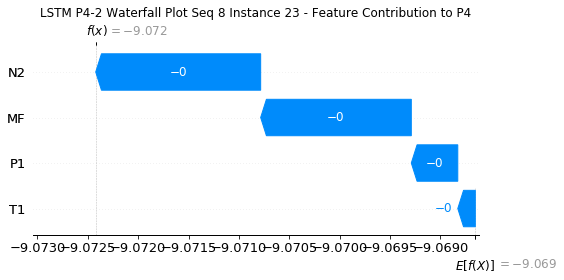

None

Contribution: [-0.00059769  0.00103491 -0.00331193 -0.00239104]


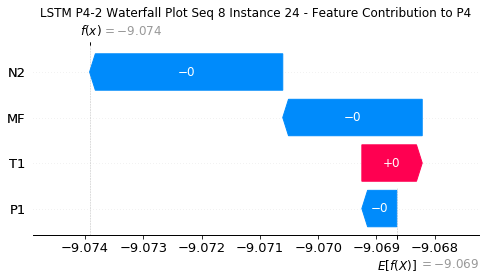

None

Contribution: [-0.0141749   0.00665627 -0.05628939 -0.04869734]


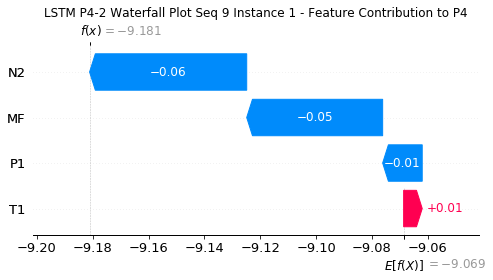

None

Contribution: [ 2.30991629e-05 -2.88895333e-04 -8.00213923e-05  1.76396805e-04]


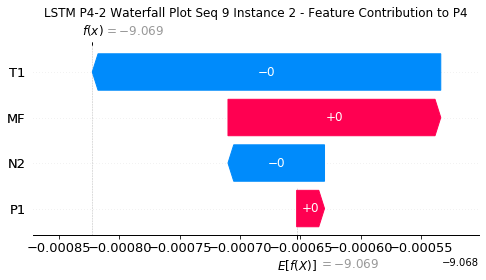

None

Contribution: [-1.68268525e-04 -8.53352969e-05 -6.08651268e-04 -5.58413630e-04]


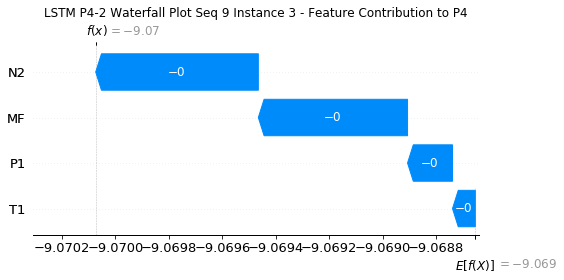

None

Contribution: [-1.24181363e-04 -7.75822848e-05 -4.31504050e-04 -3.99014583e-04]


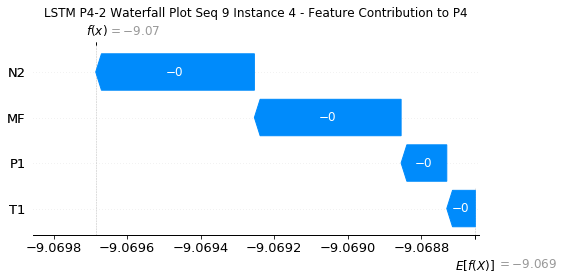

None

Contribution: [-6.80563950e-05 -4.19489902e-05 -2.47337148e-04 -2.22531564e-04]


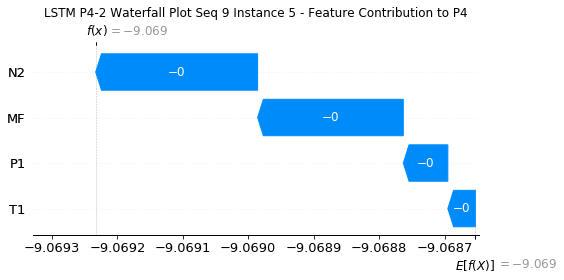

None

Contribution: [-5.96637793e-05 -3.95896197e-05 -2.03306622e-04 -1.86036944e-04]


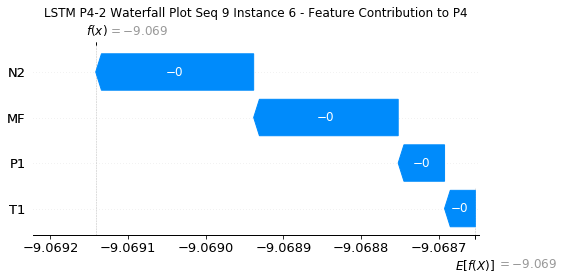

None

Contribution: [-5.80044262e-05 -4.33435450e-05 -1.94123154e-04 -1.76767860e-04]


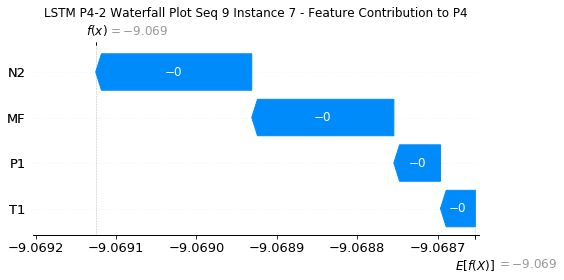

None

Contribution: [-5.75003861e-05 -4.50209864e-05 -1.91327472e-04 -1.74409815e-04]


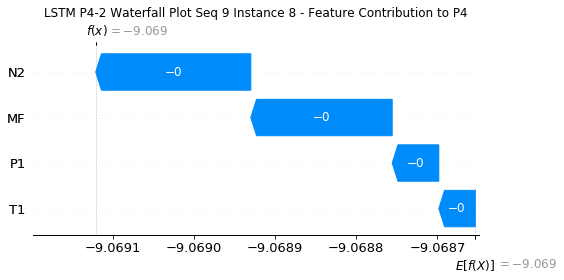

None

Contribution: [-5.80202330e-05 -4.10402933e-05 -1.91904412e-04 -1.75446237e-04]


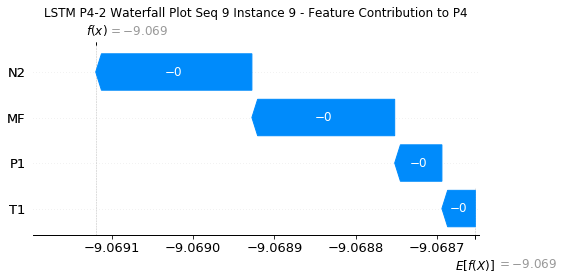

None

Contribution: [-5.87542849e-05 -3.95761185e-05 -1.94825013e-04 -1.77667301e-04]


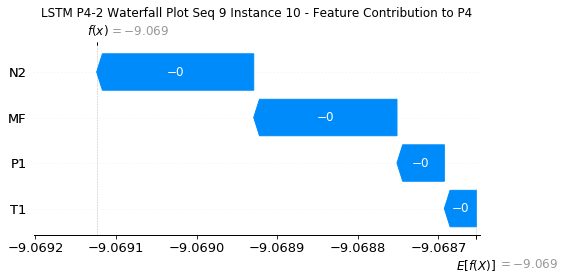

None

Contribution: [-6.02318354e-05 -4.11666743e-05 -1.99908500e-04 -1.81883520e-04]


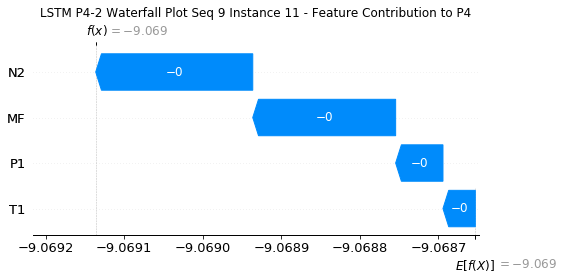

None

Contribution: [-6.09085580e-05 -4.25110626e-05 -2.03765085e-04 -1.83703927e-04]


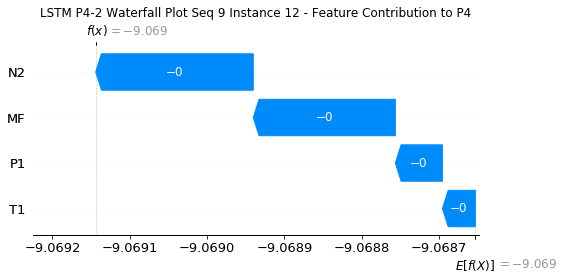

None

Contribution: [-6.28705250e-05 -4.29742688e-05 -2.08073809e-04 -1.88593489e-04]


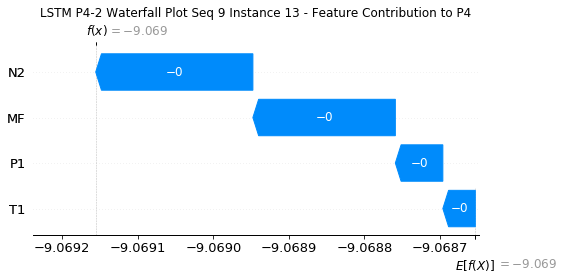

None

Contribution: [-6.40877355e-05 -4.24724027e-05 -2.11314873e-04 -1.90323265e-04]


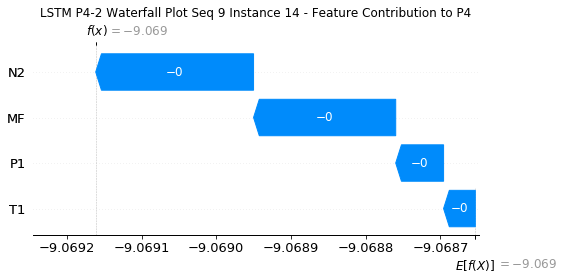

None

Contribution: [-6.56109566e-05 -4.61029331e-05 -2.15979373e-04 -1.95192480e-04]


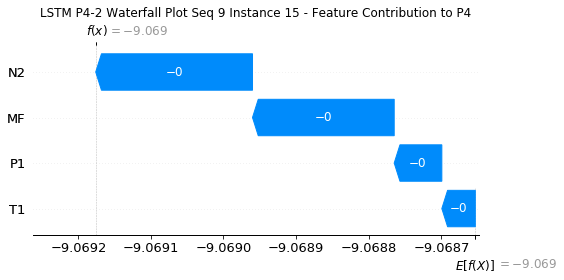

None

Contribution: [-6.79846921e-05 -4.81189891e-05 -2.22838936e-04 -2.01689822e-04]


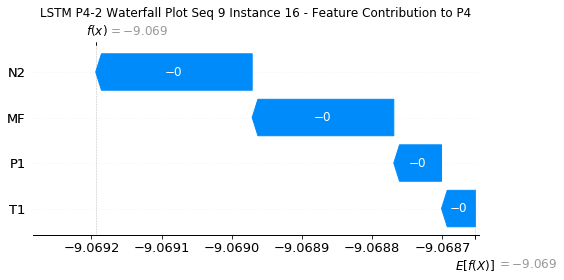

None

Contribution: [-6.91772861e-05 -5.23800572e-05 -2.33647744e-04 -2.09578503e-04]


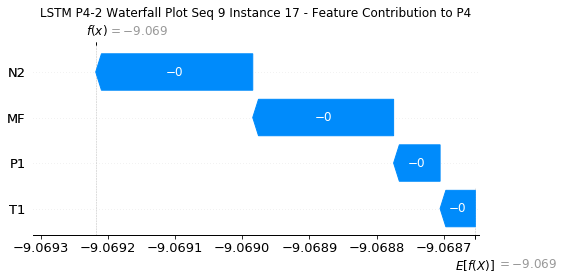

None

Contribution: [-7.54479036e-05 -5.42498436e-05 -2.50810899e-04 -2.25022935e-04]


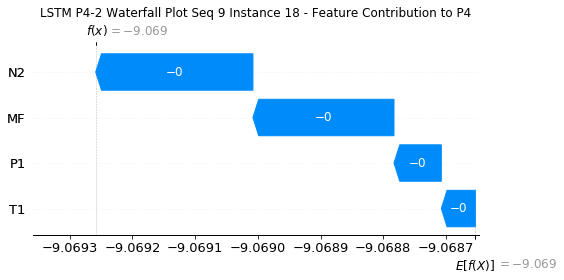

None

Contribution: [-8.48603873e-05 -6.09467964e-05 -2.80316443e-04 -2.51827536e-04]


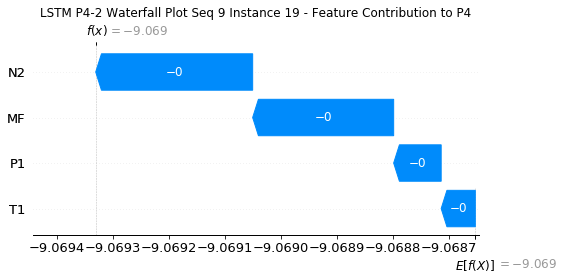

None

Contribution: [-1.03070445e-04 -7.40659823e-05 -3.40670158e-04 -3.05448072e-04]


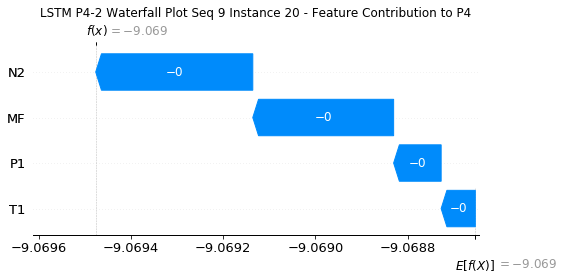

None

Contribution: [-0.00014836 -0.00010824 -0.00048284 -0.00043538]


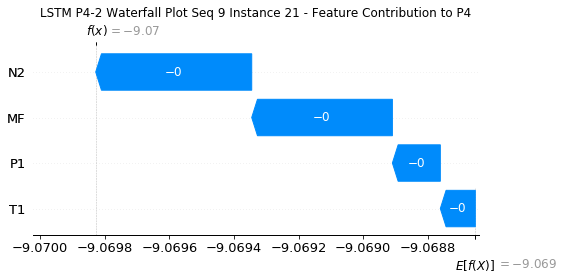

None

Contribution: [-0.0002522  -0.00018564 -0.00083028 -0.00074458]


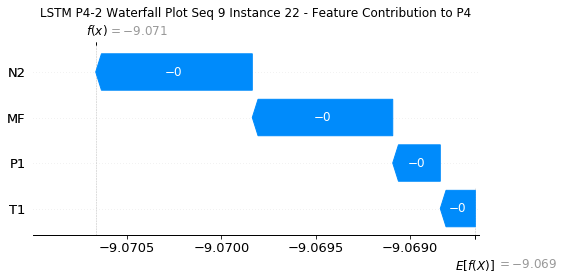

None

Contribution: [-0.00046636 -0.0003436  -0.00162104 -0.00145703]


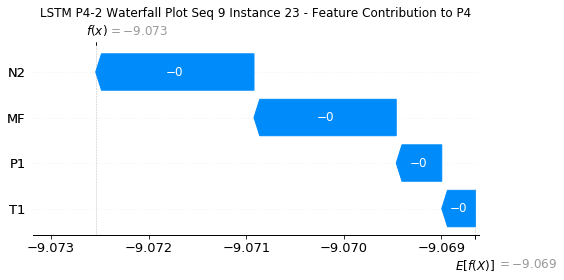

None

Contribution: [-8.80361934e-04  4.80048868e-05 -3.43685256e-03 -3.27415955e-03]


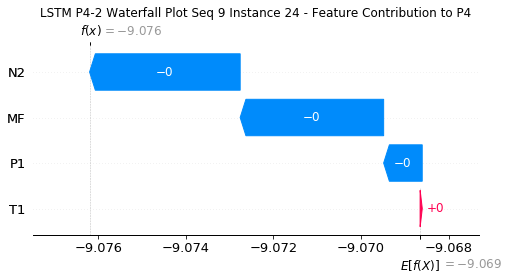

None

Contribution: [-0.01298865 -0.00181659 -0.05529931 -0.05020192]


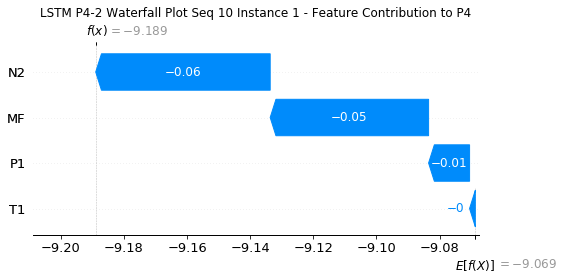

None

Contribution: [ 3.04658976e-05 -2.17632662e-04 -2.88646007e-05  2.29404364e-04]


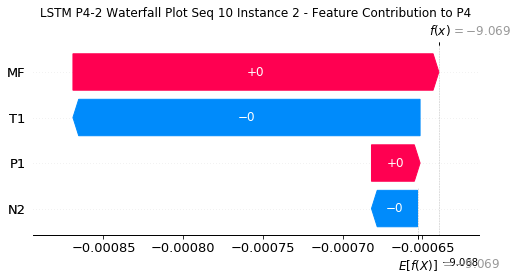

None

Contribution: [-0.00017806 -0.00011764 -0.00058844 -0.0005387 ]


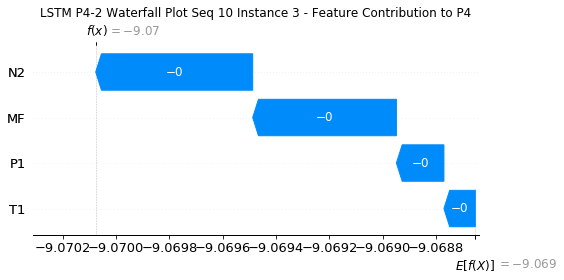

None

Contribution: [-1.29972013e-04 -9.36632224e-05 -4.27860424e-04 -3.94329198e-04]


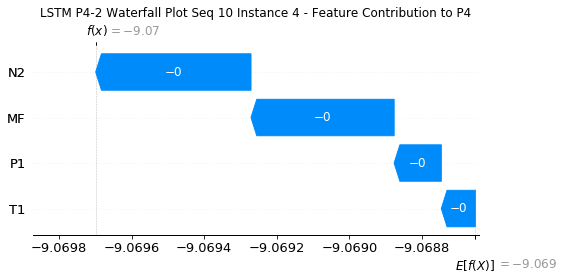

None

Contribution: [-7.55182098e-05 -5.73615439e-05 -2.50324762e-04 -2.33126912e-04]


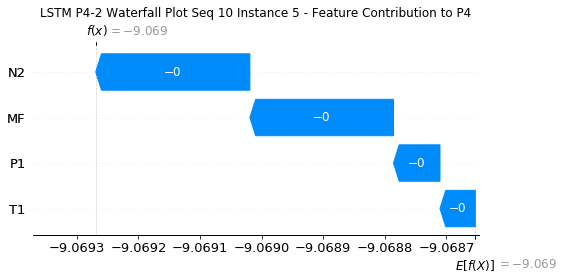

None

Contribution: [-6.19454585e-05 -4.48268315e-05 -2.02949915e-04 -1.85337069e-04]


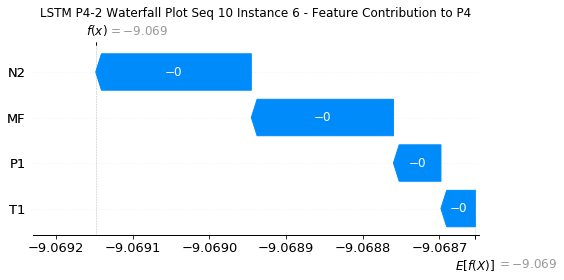

None

Contribution: [-5.73976433e-05 -4.12094407e-05 -1.92345767e-04 -1.72690532e-04]


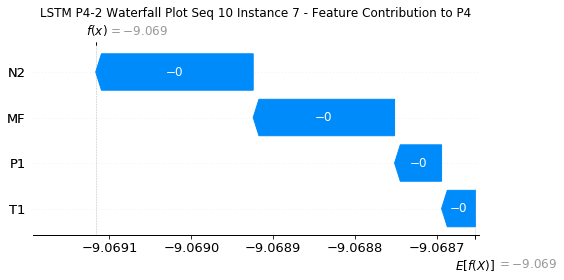

None

Contribution: [-5.93955461e-05 -4.16337119e-05 -1.90716123e-04 -1.75280024e-04]


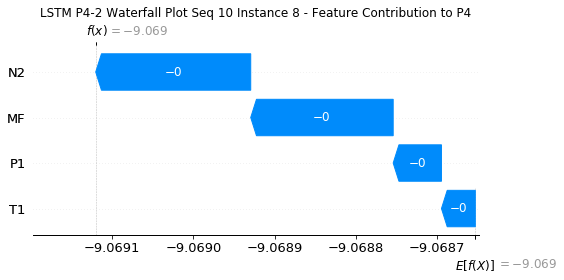

None

Contribution: [-5.76445659e-05 -4.09139608e-05 -1.90861499e-04 -1.73790719e-04]


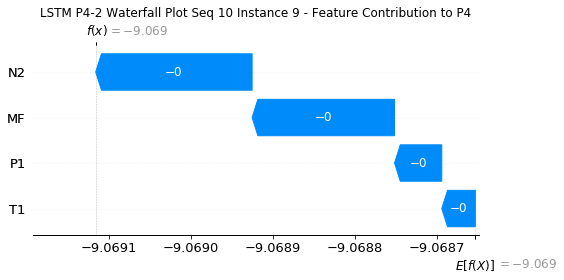

None

Contribution: [-5.93722872e-05 -4.11199080e-05 -1.94199819e-04 -1.77297687e-04]


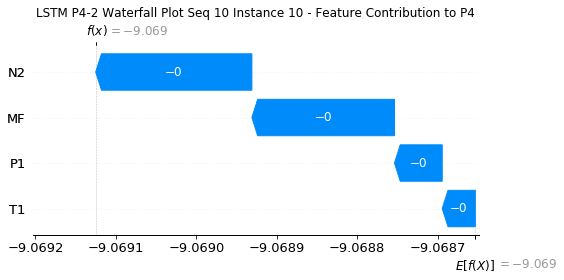

None

Contribution: [-6.06929624e-05 -4.18492239e-05 -1.98909878e-04 -1.80809509e-04]


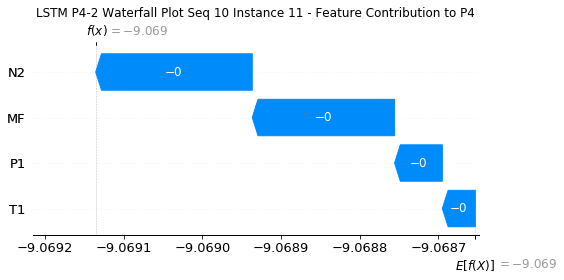

None

Contribution: [-6.14667213e-05 -4.01858778e-05 -2.02555792e-04 -1.82609192e-04]


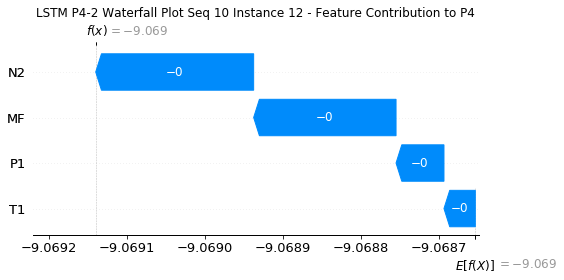

None

Contribution: [-6.33537921e-05 -4.30005088e-05 -2.07220371e-04 -1.88731713e-04]


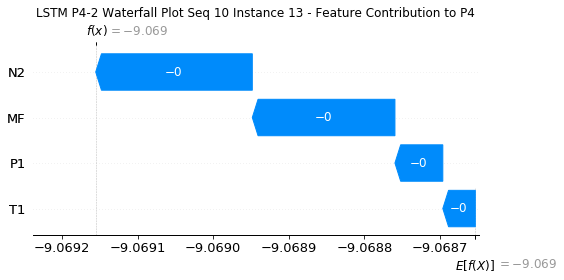

None

Contribution: [-6.38406849e-05 -4.50448682e-05 -2.10610037e-04 -1.92057068e-04]


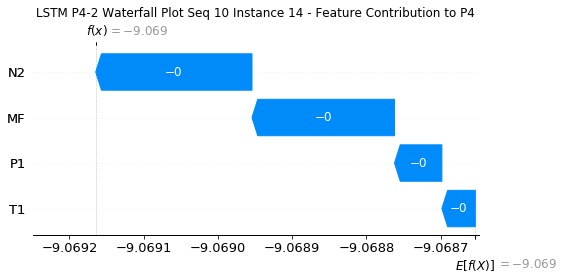

None

Contribution: [-6.55390234e-05 -4.42650111e-05 -2.14702915e-04 -1.94841025e-04]


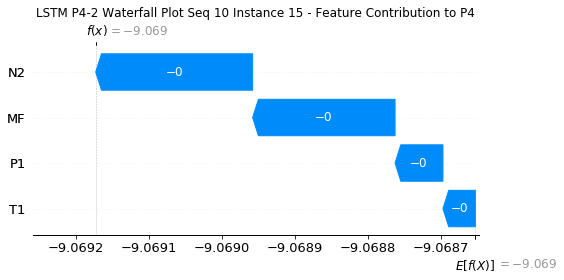

None

Contribution: [-6.75485191e-05 -4.54528179e-05 -2.21218250e-04 -2.00570951e-04]


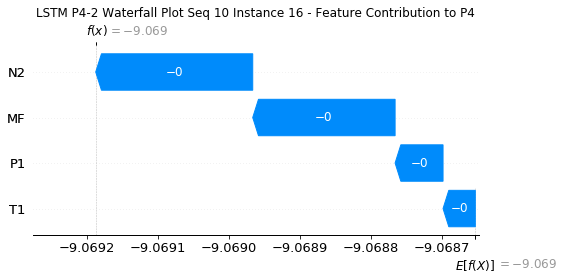

None

Contribution: [-7.03447861e-05 -4.73427404e-05 -2.31944726e-04 -2.09264843e-04]


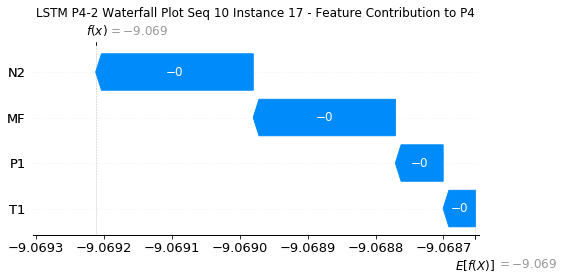

None

Contribution: [-7.59858584e-05 -5.09582471e-05 -2.48979296e-04 -2.24849999e-04]


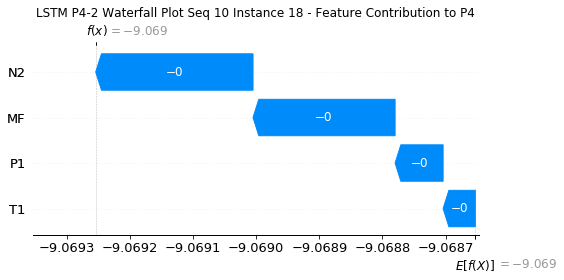

None

Contribution: [-8.51533262e-05 -5.67361223e-05 -2.78232971e-04 -2.51564703e-04]


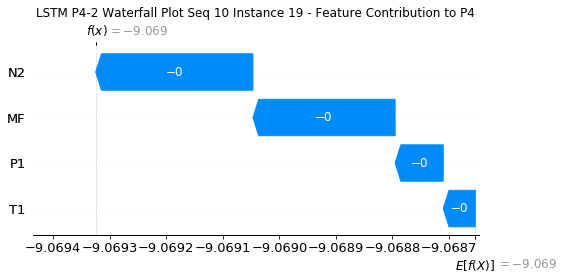

None

Contribution: [-1.04005799e-04 -6.87731301e-05 -3.38459683e-04 -3.06982694e-04]


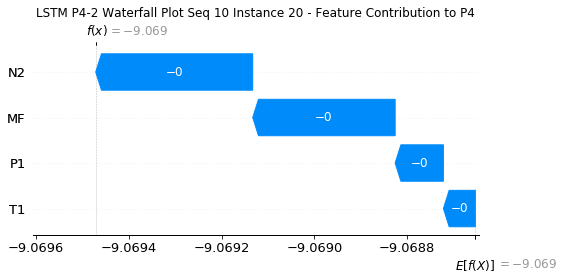

None

Contribution: [-1.48058641e-04 -9.85718636e-05 -4.79828085e-04 -4.37520032e-04]


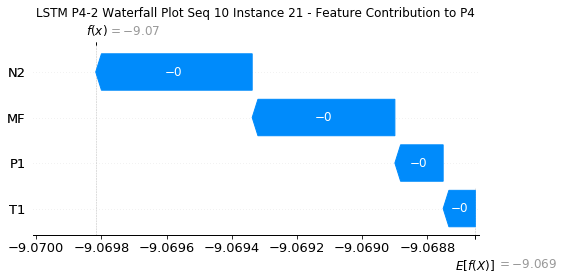

None

Contribution: [-0.00025526 -0.00017052 -0.0008263  -0.00075355]


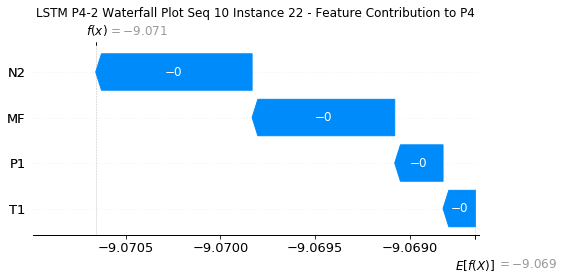

None

Contribution: [-0.00048948 -0.00029104 -0.0016218  -0.00145857]


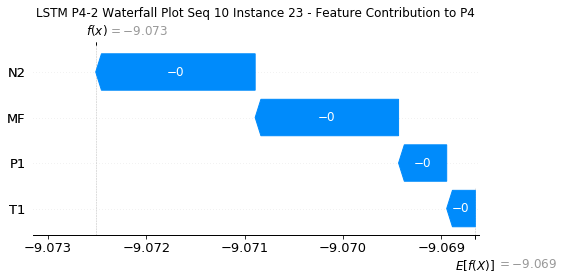

None

Contribution: [-0.00098713  0.00026821 -0.00345197 -0.00326144]


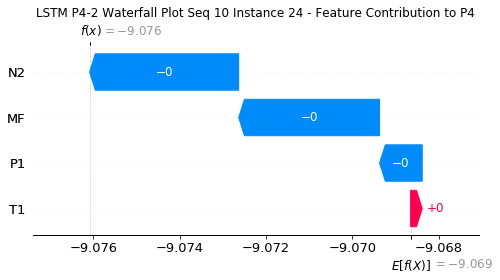

None

Contribution: [-0.01558639 -0.0002146  -0.05550909 -0.05272158]


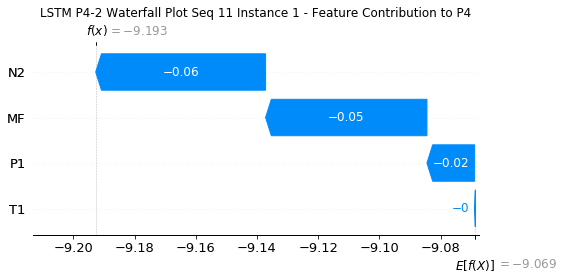

None

Contribution: [ 6.91614605e-05 -2.00810984e-04  1.63004190e-05  3.05206775e-04]


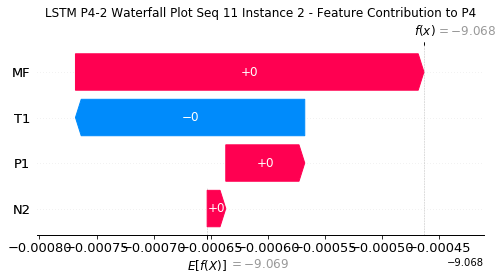

None

Contribution: [-0.00019083 -0.00010533 -0.00058189 -0.00055229]


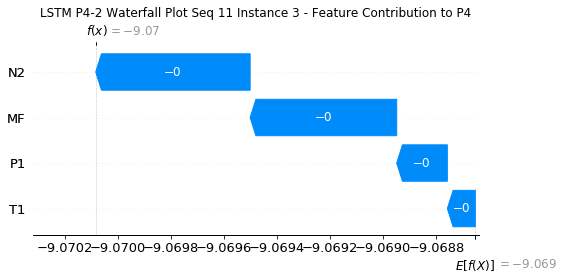

None

Contribution: [-1.36946186e-04 -8.26309307e-05 -4.27145056e-04 -4.03121678e-04]


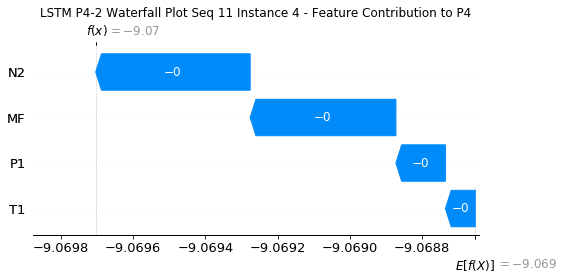

None

Contribution: [-8.12317532e-05 -5.88126884e-05 -2.51393732e-04 -2.35754643e-04]


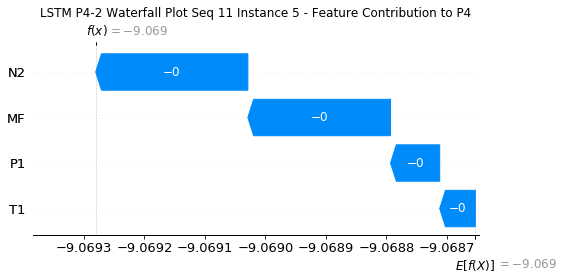

None

Contribution: [-6.53930039e-05 -4.17126259e-05 -2.03700012e-04 -1.89728589e-04]


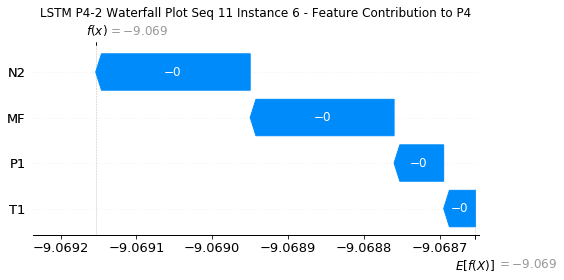

None

Contribution: [-6.24501969e-05 -4.45576774e-05 -1.94853222e-04 -1.80027457e-04]


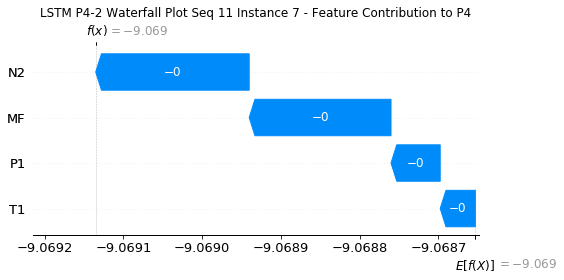

None

Contribution: [-6.13247042e-05 -4.28474349e-05 -1.91464542e-04 -1.76621413e-04]


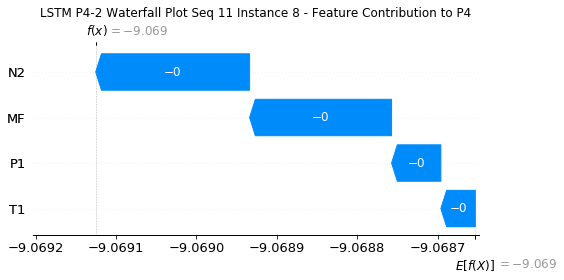

None

Contribution: [-6.12071596e-05 -4.42543744e-05 -1.92130660e-04 -1.77168435e-04]


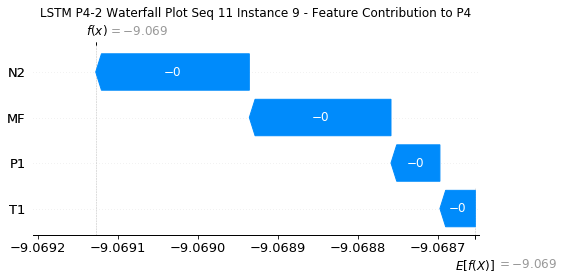

None

Contribution: [-6.09304579e-05 -2.89398855e-05 -1.93284202e-04 -1.78168860e-04]


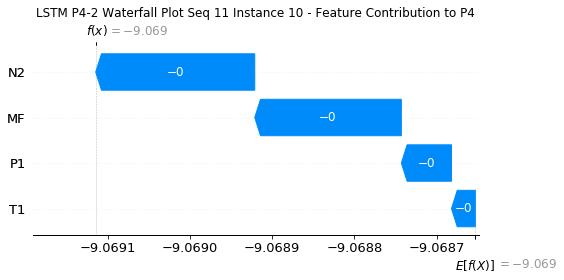

None

Contribution: [-6.24298466e-05 -2.98954611e-05 -1.98035864e-04 -1.82168764e-04]


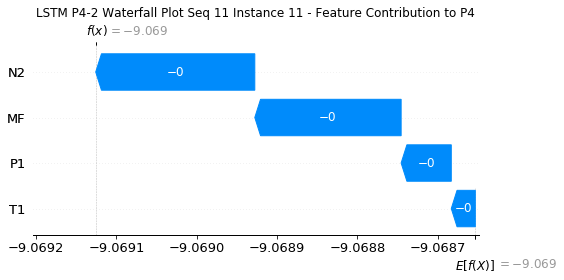

None

Contribution: [-6.21924859e-05 -2.14902768e-05 -2.01505260e-04 -1.85338030e-04]


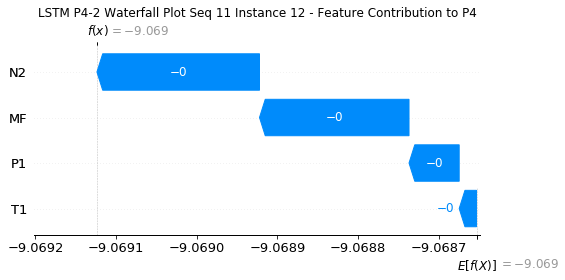

None

Contribution: [-6.45745107e-05 -3.05388114e-05 -2.05877842e-04 -1.88577154e-04]


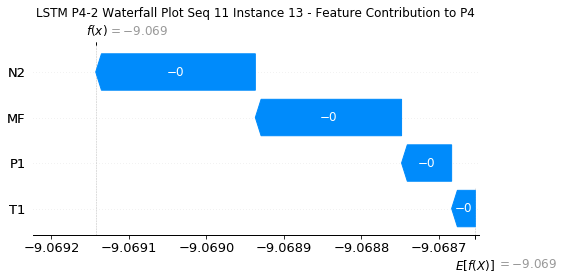

None

Contribution: [-6.47571468e-05 -2.30604657e-05 -2.09281738e-04 -1.92001166e-04]


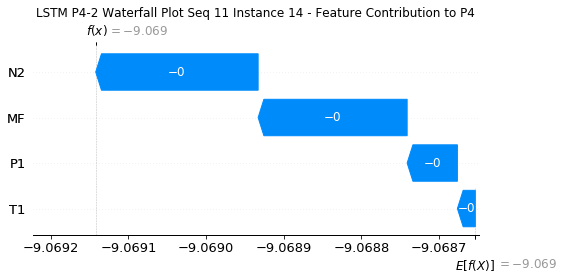

None

Contribution: [-6.65568512e-05 -3.16191092e-05 -2.13175928e-04 -1.94021834e-04]


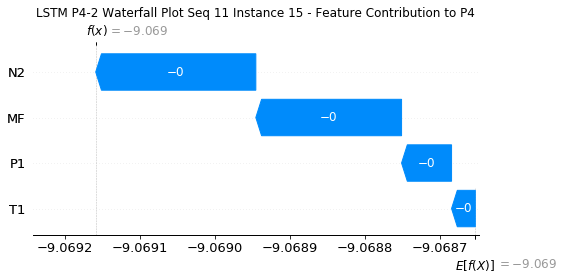

None

Contribution: [-6.87484207e-05 -3.47083320e-05 -2.19809422e-04 -1.99848071e-04]


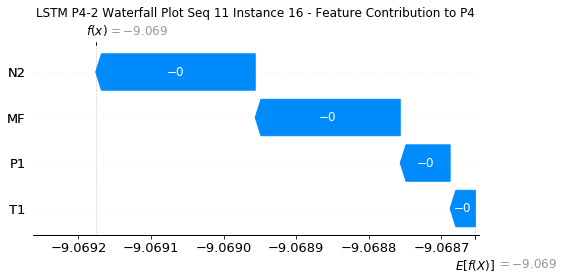

None

Contribution: [-7.30862085e-05 -4.22835174e-05 -2.31724559e-04 -2.13612825e-04]


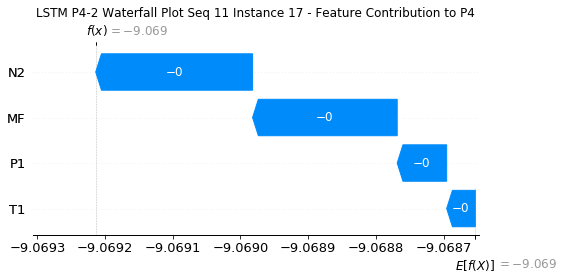

None

Contribution: [-7.79939200e-05 -4.72036712e-05 -2.47886879e-04 -2.24384907e-04]


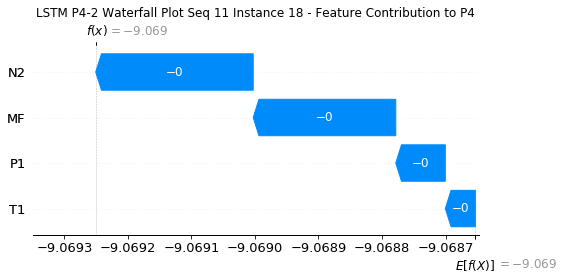

None

Contribution: [-8.73369245e-05 -5.35620772e-05 -2.76860489e-04 -2.50574838e-04]


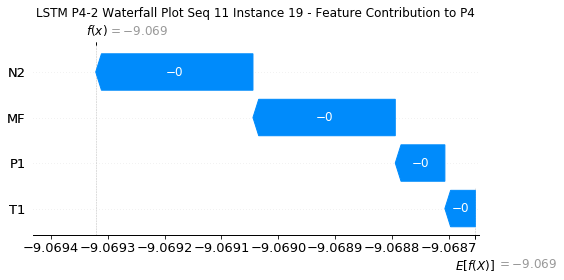

None

Contribution: [-1.06283463e-04 -6.65825674e-05 -3.36455182e-04 -3.04576930e-04]


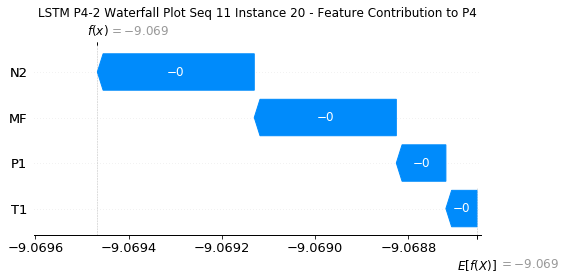

None

Contribution: [-1.50120013e-04 -8.96828401e-05 -4.76321281e-04 -4.31859917e-04]


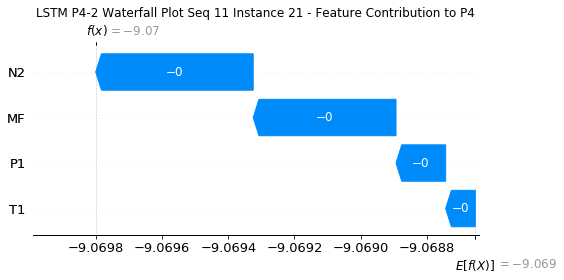

None

Contribution: [-0.00025918 -0.00016635 -0.00081997 -0.00074405]


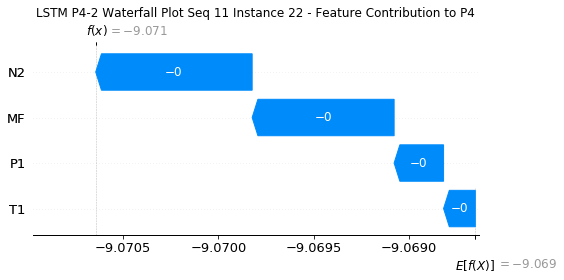

None

Contribution: [-0.00052512 -0.00036356 -0.00161813 -0.0015099 ]


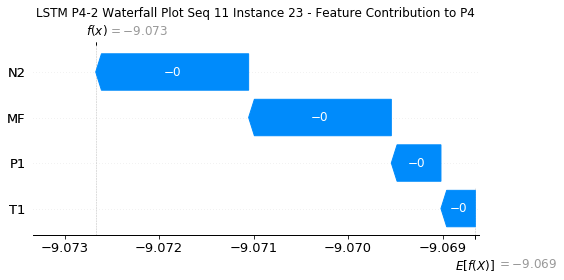

None

Contribution: [-0.00117092 -0.00016072 -0.00347362 -0.00342245]


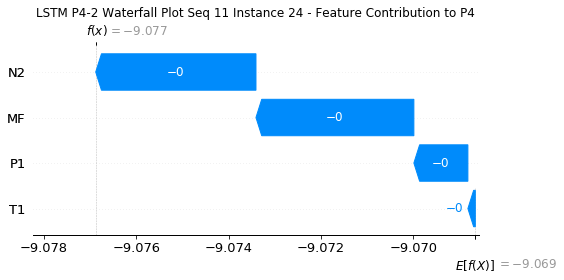

None

Contribution: [-0.01689082 -0.00352925 -0.05507803 -0.05288186]


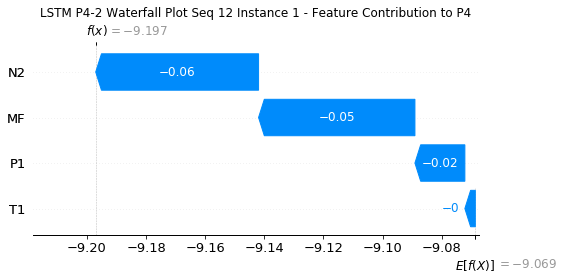

None

Contribution: [ 7.34072304e-05 -1.66356654e-04  2.88459723e-05  2.93133124e-04]


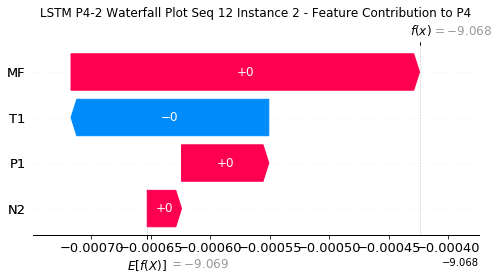

None

Contribution: [-0.00018861 -0.0001345  -0.0005692  -0.00052837]


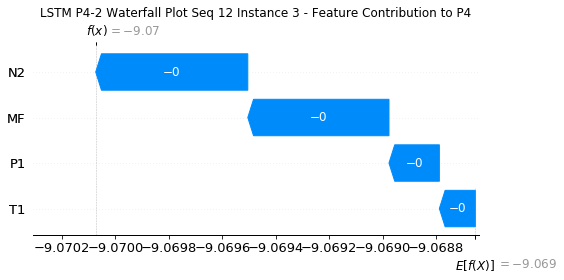

None

Contribution: [-0.00013715 -0.00010583 -0.00042272 -0.00039314]


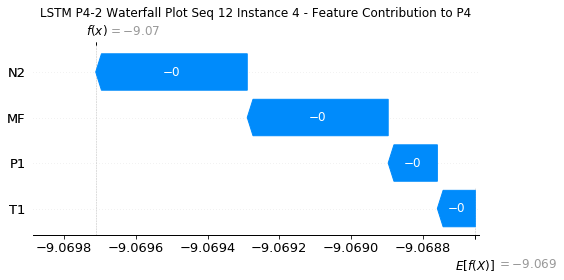

None

Contribution: [-7.79102486e-05 -6.25682758e-05 -2.48727516e-04 -2.29727049e-04]


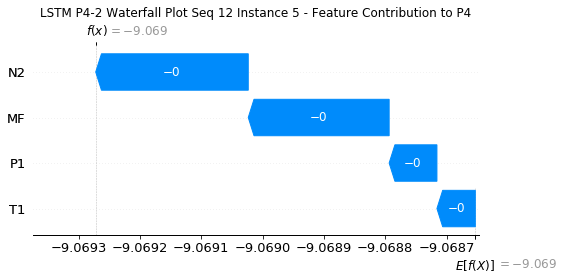

None

Contribution: [-6.59309842e-05 -5.12317627e-05 -2.02990813e-04 -1.87365988e-04]


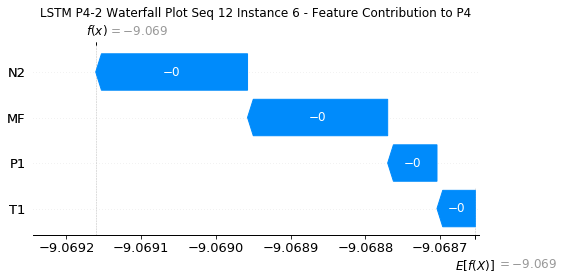

None

Contribution: [-6.42166409e-05 -4.93081544e-05 -1.94263704e-04 -1.81652512e-04]


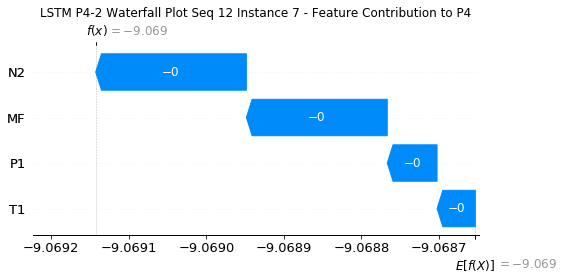

None

Contribution: [-6.17396462e-05 -4.64444890e-05 -1.89392187e-04 -1.73281863e-04]


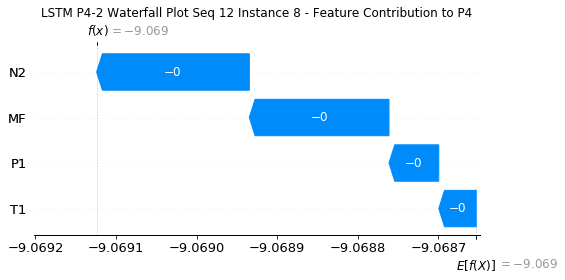

None

Contribution: [-6.17332027e-05 -4.73487131e-05 -1.90576446e-04 -1.75998293e-04]


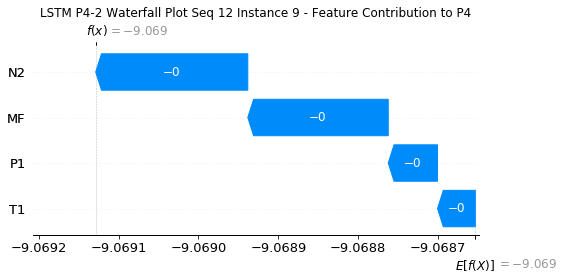

None

Contribution: [-6.26452488e-05 -4.89617936e-05 -1.93161096e-04 -1.78194396e-04]


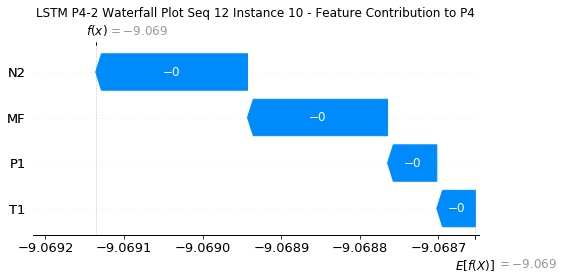

None

Contribution: [-6.44092724e-05 -5.02714298e-05 -1.97983572e-04 -1.82824865e-04]


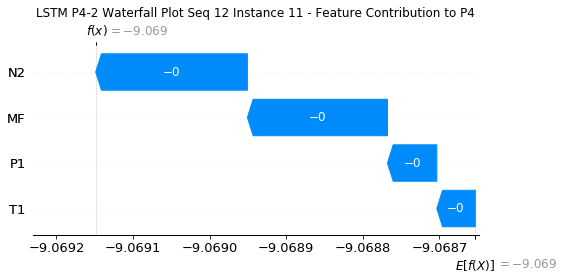

None

Contribution: [-6.33983313e-05 -5.03799404e-05 -2.00469270e-04 -1.82501750e-04]


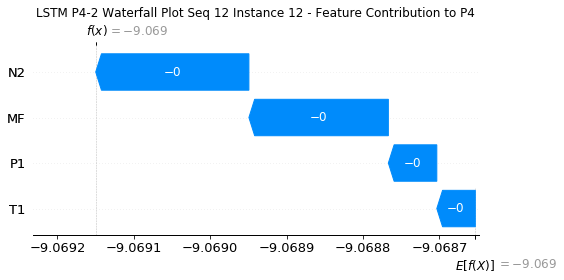

None

Contribution: [-6.66431330e-05 -5.21778449e-05 -2.05731710e-04 -1.90046788e-04]


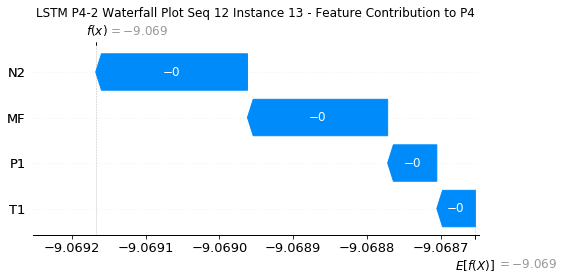

None

Contribution: [-6.87981288e-05 -5.41838423e-05 -2.09601617e-04 -1.97426994e-04]


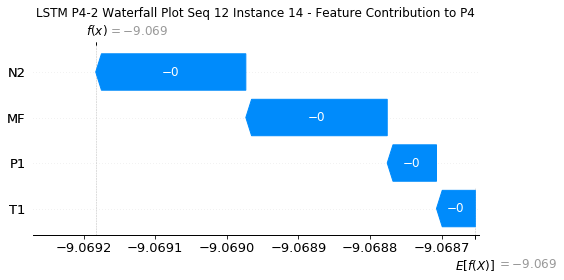

None

Contribution: [-6.89943961e-05 -5.42729556e-05 -2.12990762e-04 -1.96899766e-04]


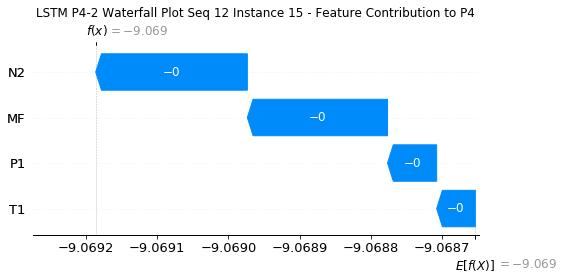

None

Contribution: [-7.07786680e-05 -5.58305523e-05 -2.19040472e-04 -2.01922868e-04]


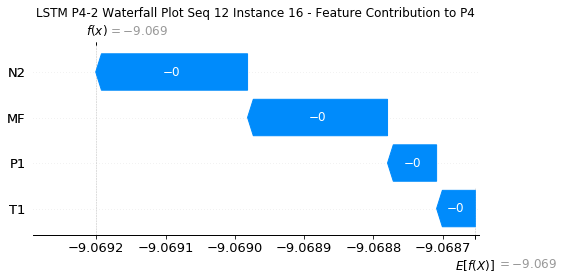

None

Contribution: [-7.28877485e-05 -5.70646692e-05 -2.28953769e-04 -2.08403528e-04]


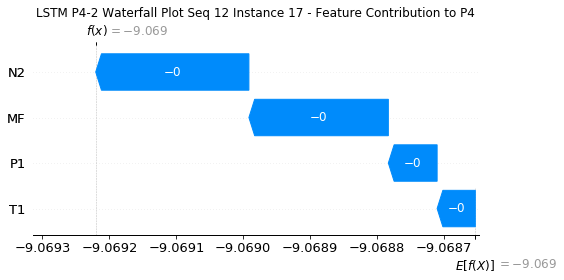

None

Contribution: [-7.97086477e-05 -6.31886072e-05 -2.46550296e-04 -2.27551070e-04]


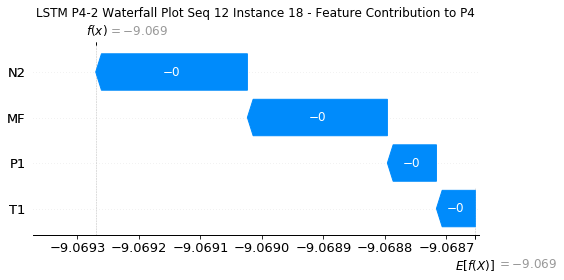

None

Contribution: [-8.88968865e-05 -7.06395728e-05 -2.75027688e-04 -2.53536563e-04]


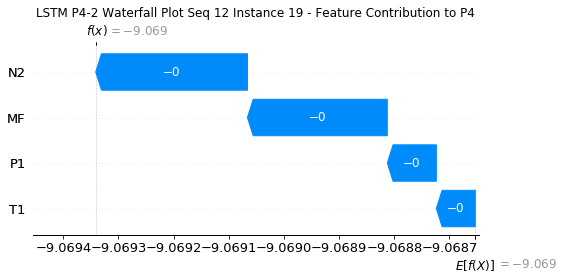

None

Contribution: [-1.07838876e-04 -8.62317550e-05 -3.33847253e-04 -3.08038535e-04]


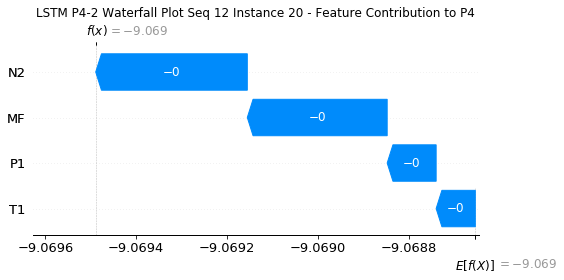

None

Contribution: [-0.00015222 -0.00012338 -0.00047193 -0.00043569]


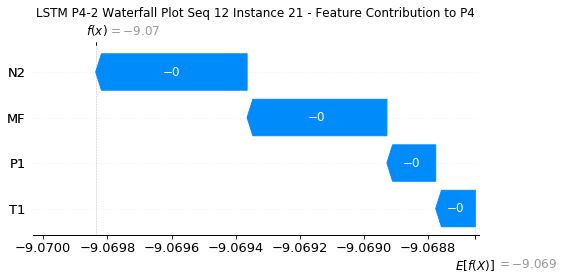

None

Contribution: [-0.00026198 -0.00021398 -0.00081261 -0.0007525 ]


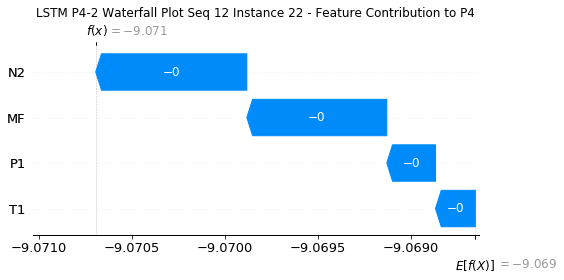

None

Contribution: [-0.00051738 -0.00041    -0.00160121 -0.00148906]


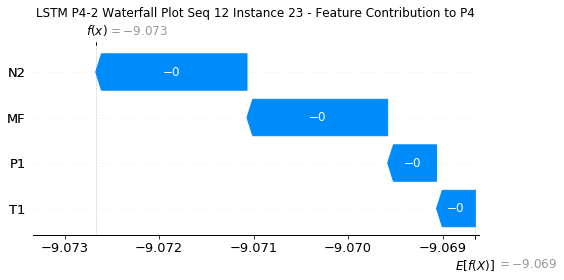

None

Contribution: [-0.00114477 -0.00048771 -0.00344057 -0.00331326]


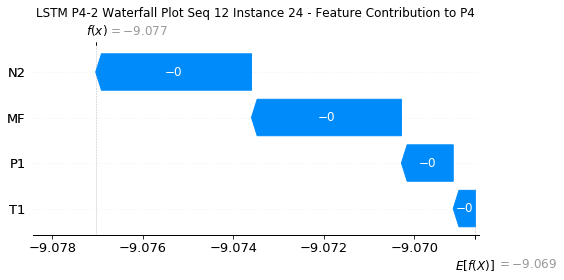

None

Contribution: [-0.01694082 -0.00896253 -0.05415951 -0.05282831]


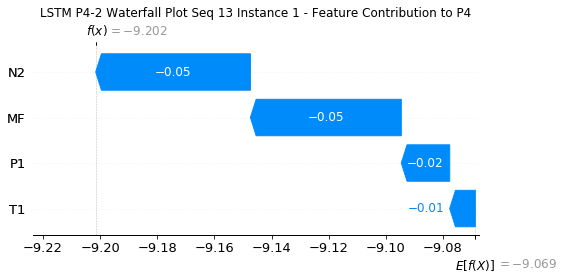

None

Contribution: [ 8.47345429e-05 -1.42473205e-04  4.55969078e-05  3.34158723e-04]


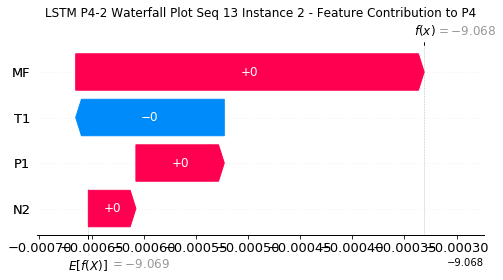

None

Contribution: [-0.000184   -0.00013486 -0.00056155 -0.00053054]


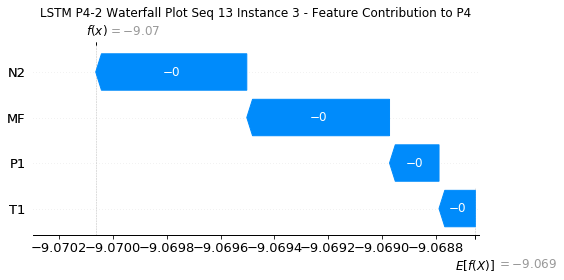

None

Contribution: [-0.00013618 -0.00010493 -0.00042193 -0.00039809]


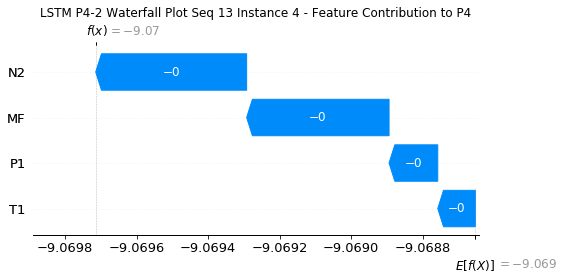

None

Contribution: [-8.18924954e-05 -6.29793063e-05 -2.50388851e-04 -2.36087963e-04]


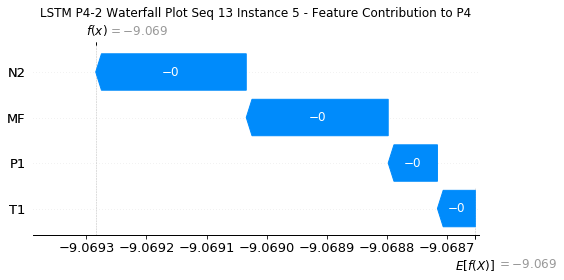

None

Contribution: [-6.53895506e-05 -5.02539869e-05 -2.03006107e-04 -1.89034784e-04]


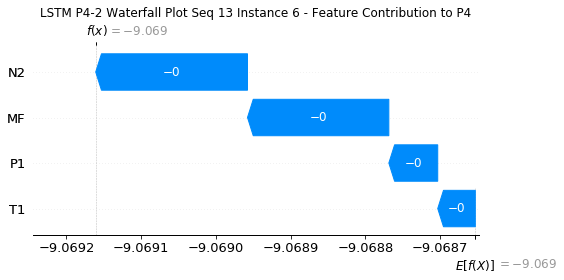

None

Contribution: [-6.00298640e-05 -4.53534316e-05 -1.91450826e-04 -1.74418983e-04]


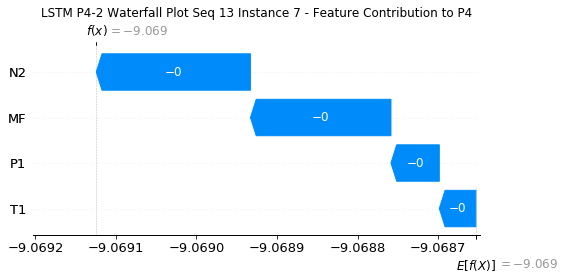

None

Contribution: [-5.95786765e-05 -4.27357040e-05 -1.88185161e-04 -1.72674535e-04]


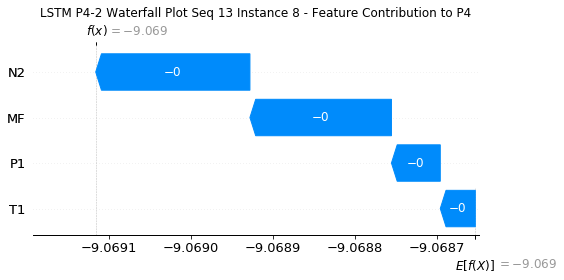

None

Contribution: [-6.01957440e-05 -4.42936394e-05 -1.89274364e-04 -1.74080744e-04]


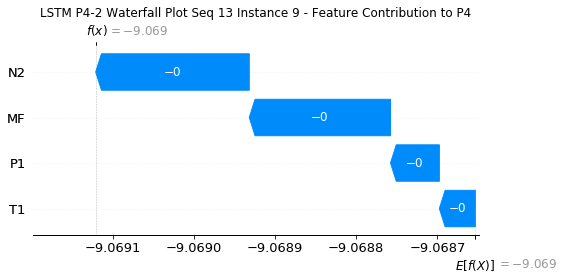

None

Contribution: [-6.27633639e-05 -4.55064144e-05 -1.93382509e-04 -1.80300047e-04]


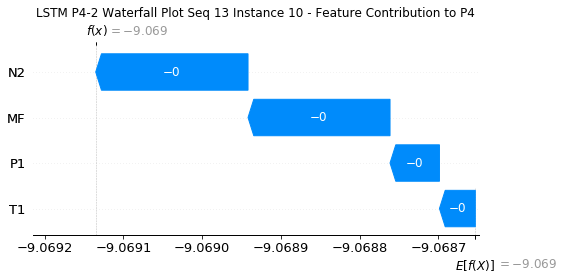

None

Contribution: [-6.39545955e-05 -4.66329451e-05 -1.98084793e-04 -1.83889196e-04]


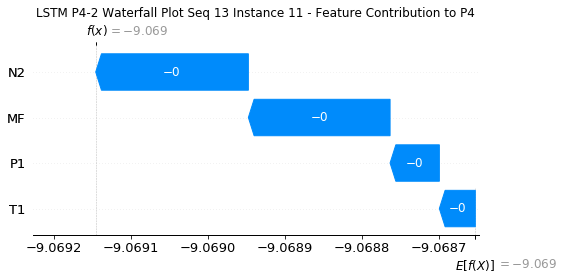

None

Contribution: [-6.54277972e-05 -4.74576606e-05 -2.02205638e-04 -1.88578712e-04]


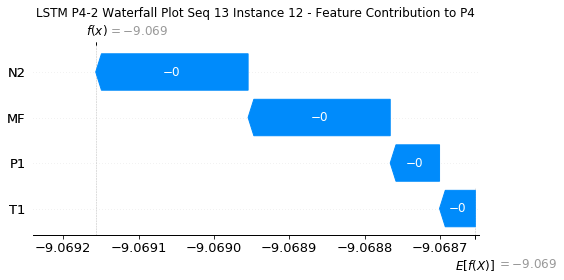

None

Contribution: [-6.63541050e-05 -4.82018169e-05 -2.05716692e-04 -1.90641469e-04]


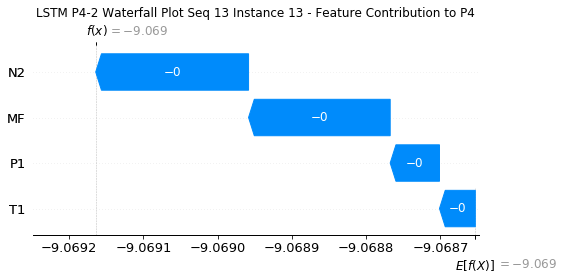

None

Contribution: [-6.58046913e-05 -4.76061164e-05 -2.08077344e-04 -1.89946327e-04]


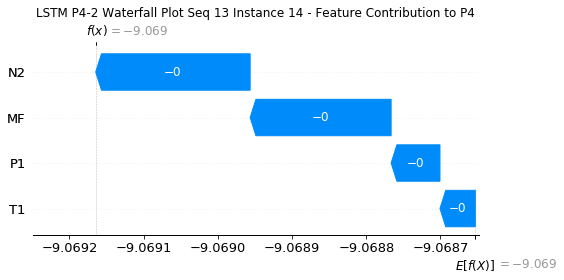

None

Contribution: [-6.80958110e-05 -4.93572393e-05 -2.12687235e-04 -1.95913377e-04]


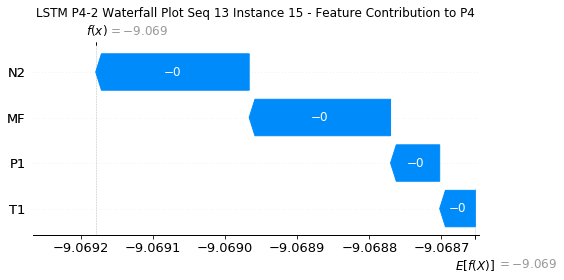

None

Contribution: [-6.99132453e-05 -5.09811894e-05 -2.19011642e-04 -2.01527710e-04]


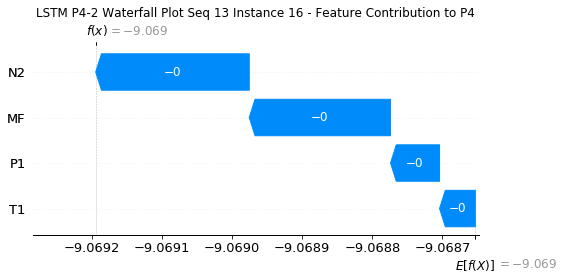

None

Contribution: [-7.29575483e-05 -5.74462331e-05 -2.29936470e-04 -2.10813458e-04]


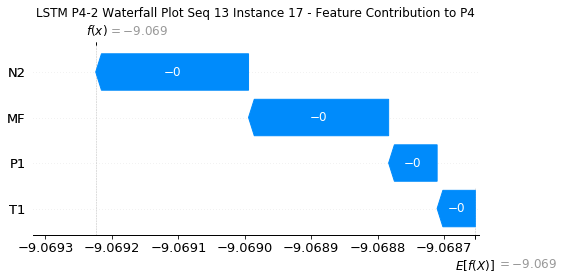

None

Contribution: [-7.76112776e-05 -5.91736976e-05 -2.46070635e-04 -2.24173675e-04]


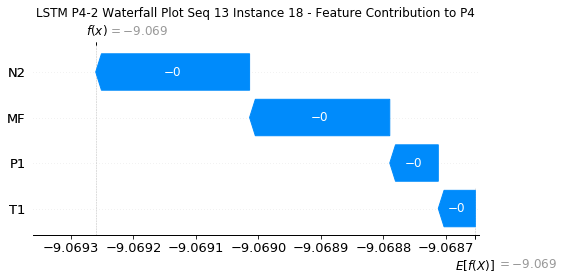

None

Contribution: [-8.68452538e-05 -6.60804143e-05 -2.74670996e-04 -2.50541436e-04]


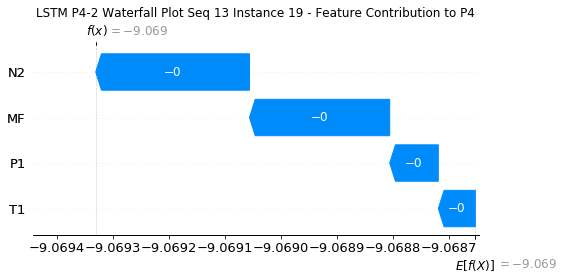

None

Contribution: [-1.05758740e-04 -8.14696960e-05 -3.33653031e-04 -3.04711602e-04]


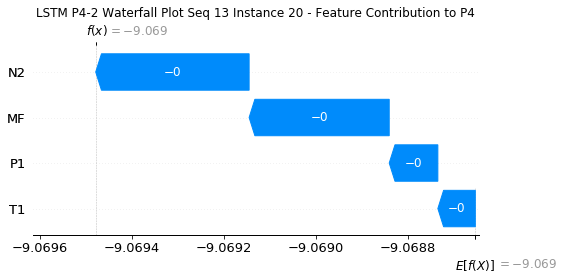

None

Contribution: [-0.00015077 -0.00011488 -0.00047228 -0.00043398]


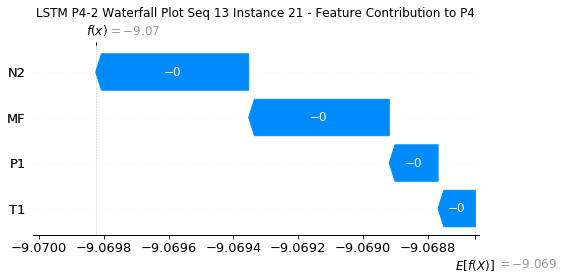

None

Contribution: [-0.00025903 -0.00020578 -0.00081388 -0.00074786]


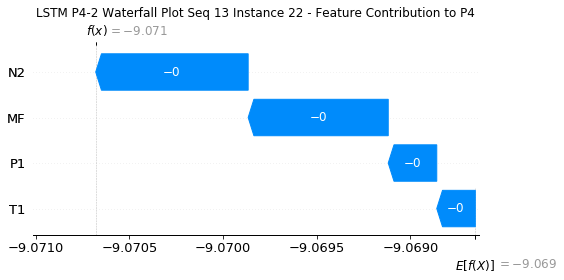

None

Contribution: [-0.00049401 -0.00041381 -0.00160177 -0.00147825]


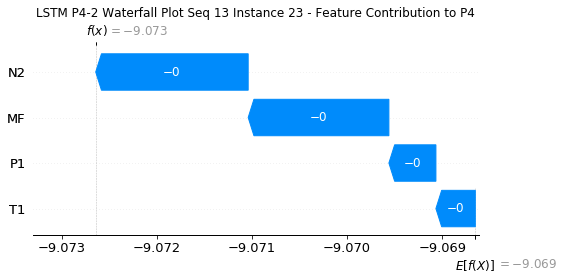

None

Contribution: [-0.00103922 -0.00028133 -0.00343857 -0.00331272]


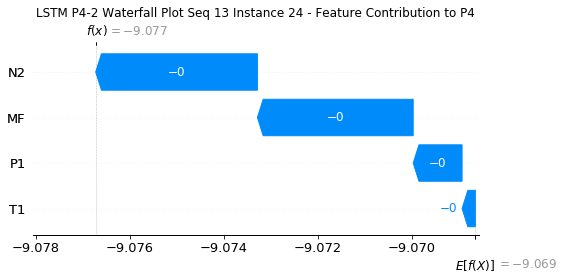

None

Contribution: [-0.01572941 -0.0073334  -0.05454211 -0.05151159]


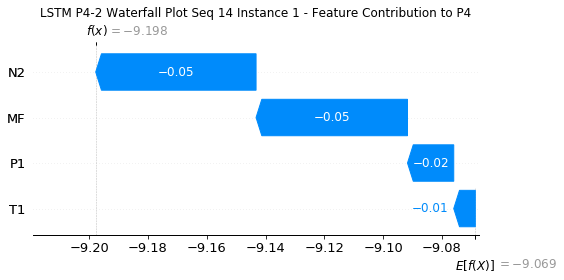

None

Contribution: [ 6.17036925e-05 -1.59971520e-04  1.76487443e-05  2.67930398e-04]


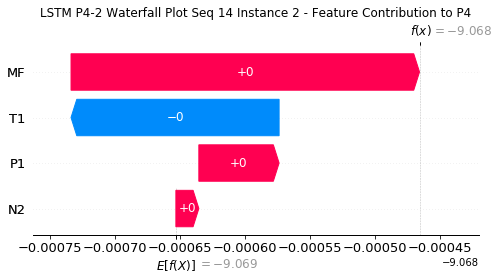

None

Contribution: [-0.00018365 -0.00013265 -0.00056813 -0.00053143]


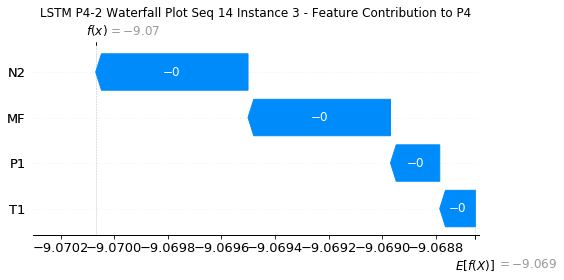

None

Contribution: [-0.00013431 -0.00010574 -0.00042255 -0.00039551]


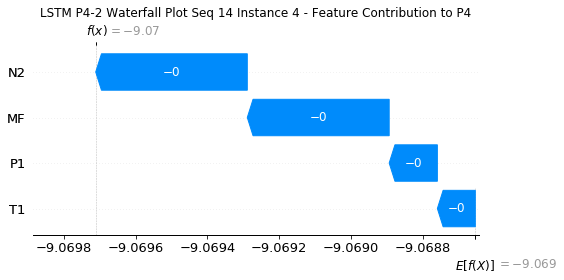

None

Contribution: [-7.77732390e-05 -5.61429049e-05 -2.47778134e-04 -2.29871593e-04]


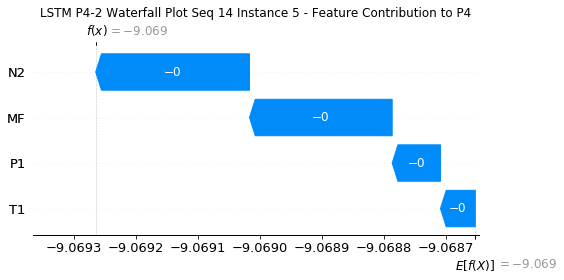

None

Contribution: [-6.44305710e-05 -5.13591683e-05 -2.02851006e-04 -1.87803189e-04]


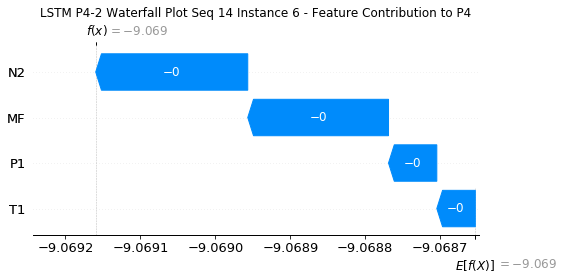

None

Contribution: [-6.05200297e-05 -4.88603466e-05 -1.92603504e-04 -1.76515533e-04]


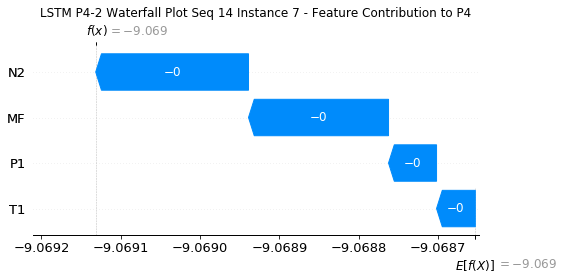

None

Contribution: [-5.93623664e-05 -5.00683305e-05 -1.89400714e-04 -1.73385783e-04]


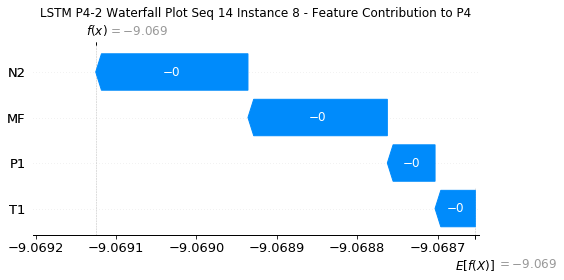

None

Contribution: [-5.99146863e-05 -5.03415667e-05 -1.90341161e-04 -1.75073748e-04]


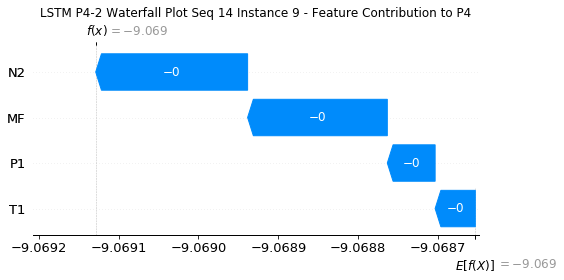

None

Contribution: [-6.06852079e-05 -4.92924882e-05 -1.92928347e-04 -1.77132119e-04]


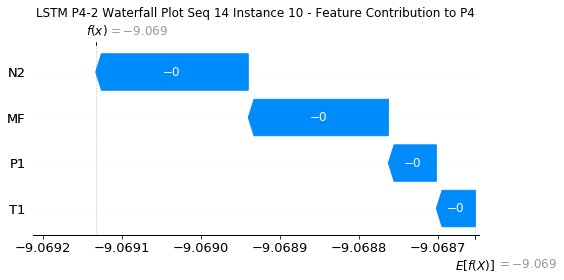

None

Contribution: [-6.21064193e-05 -5.02533327e-05 -1.97755265e-04 -1.81256007e-04]


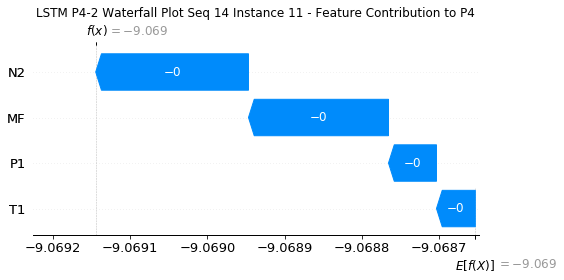

None

Contribution: [-6.27980201e-05 -5.18484136e-05 -2.02331370e-04 -1.86627924e-04]


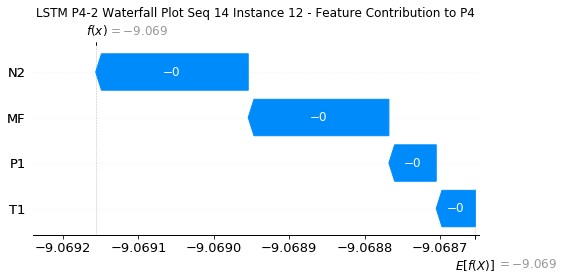

None

Contribution: [-6.43355333e-05 -5.27935783e-05 -2.05544144e-04 -1.88184921e-04]


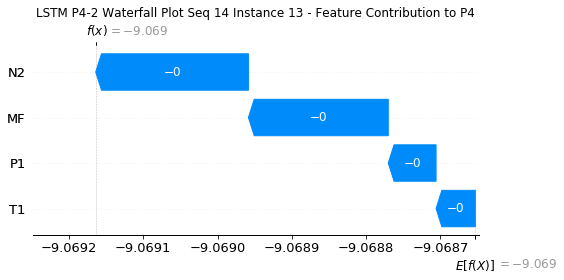

None

Contribution: [-6.40012101e-05 -5.18746385e-05 -2.08490058e-04 -1.90798592e-04]


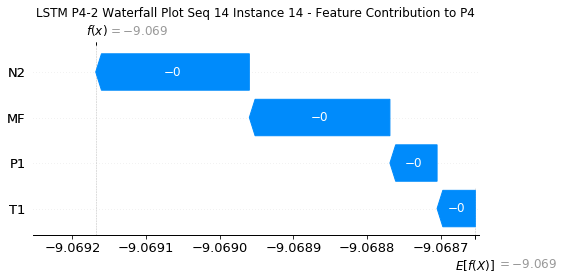

None

Contribution: [-6.61787957e-05 -5.46626069e-05 -2.12697007e-04 -1.94375148e-04]


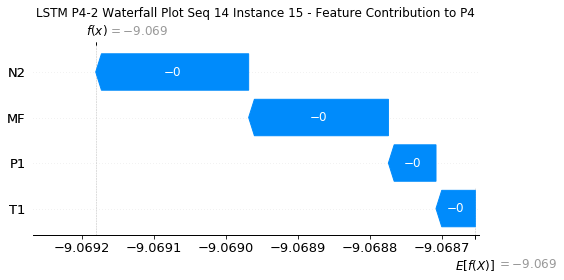

None

Contribution: [-6.81277737e-05 -5.69800146e-05 -2.19102813e-04 -2.00689296e-04]


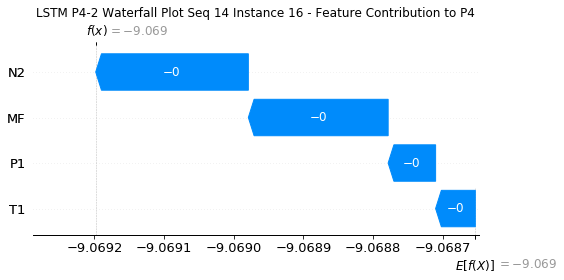

None

Contribution: [-7.10832075e-05 -5.62189562e-05 -2.29722322e-04 -2.10644669e-04]


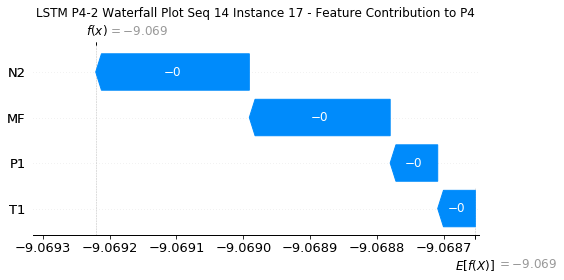

None

Contribution: [-7.66964196e-05 -6.48770392e-05 -2.46671459e-04 -2.25558807e-04]


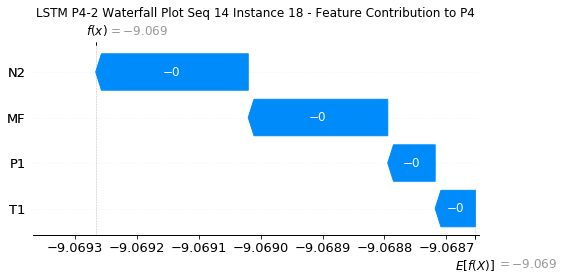

None

Contribution: [-8.57798696e-05 -7.33585667e-05 -2.75323005e-04 -2.52077373e-04]


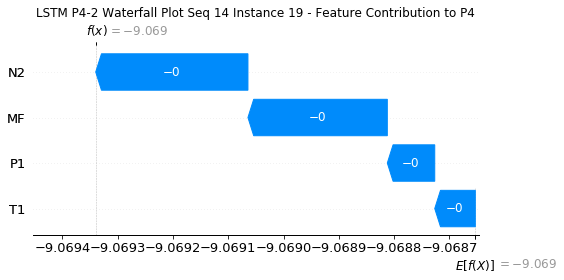

None

Contribution: [-1.04443714e-04 -9.09836305e-05 -3.34373572e-04 -3.06152771e-04]


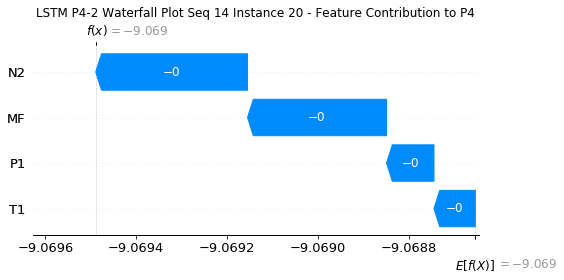

None

Contribution: [-0.00014764 -0.00013113 -0.00047274 -0.00043466]


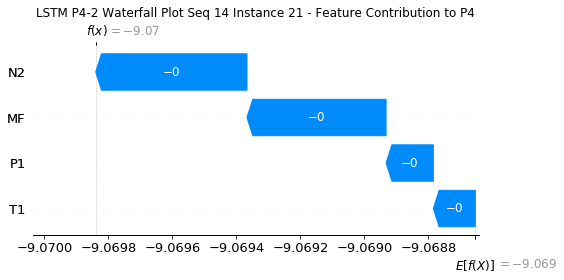

None

Contribution: [-0.00025526 -0.00023193 -0.0008153  -0.00075447]


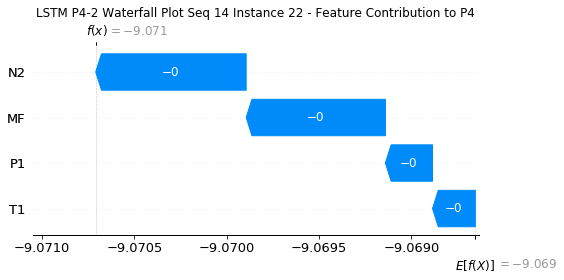

None

Contribution: [-0.00050815 -0.00048033 -0.00160715 -0.00151709]


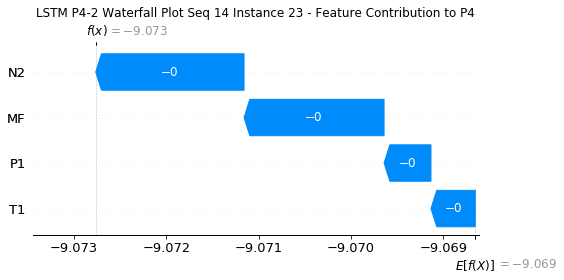

None

Contribution: [-0.00107111 -0.00080025 -0.00343889 -0.00333686]


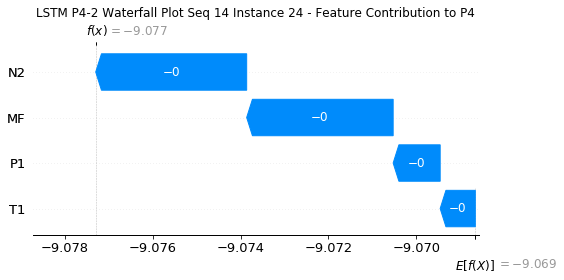

None

Contribution: [-0.01598113 -0.01292394 -0.05402759 -0.05107891]


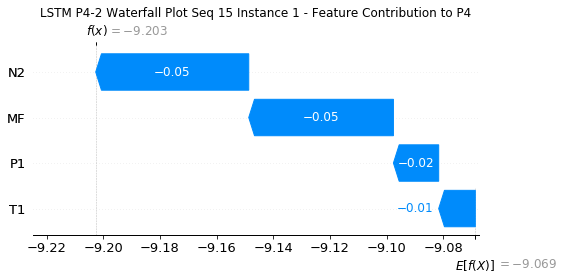

None

Contribution: [ 7.85429961e-05 -1.04757161e-04  5.28784239e-05  3.23939554e-04]


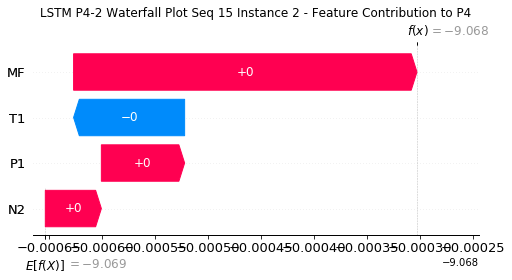

None

Contribution: [-0.0001771  -0.00016062 -0.0005573  -0.00051712]


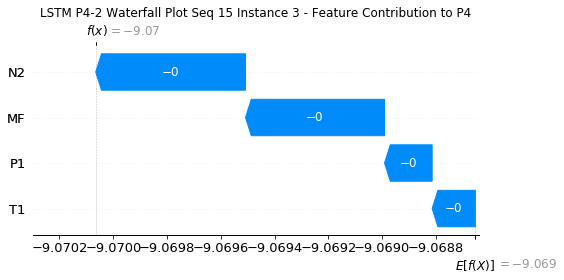

None

Contribution: [-0.00013238 -0.00011957 -0.0004204  -0.00039081]


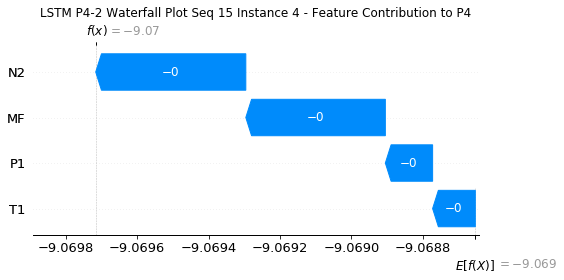

None

Contribution: [-7.90338622e-05 -7.17833798e-05 -2.49736690e-04 -2.32608042e-04]


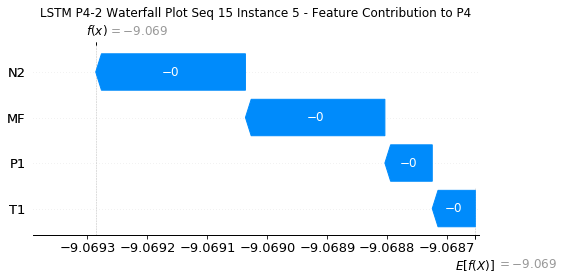

None

Contribution: [-6.39349556e-05 -5.67287548e-05 -2.02742843e-04 -1.86637691e-04]


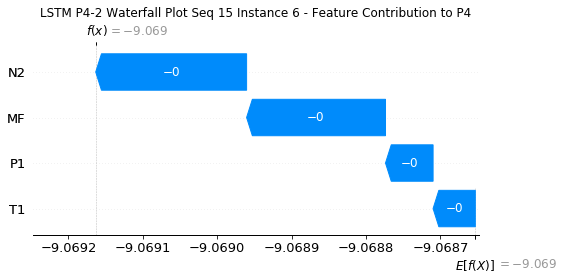

None

Contribution: [-5.94177671e-05 -5.14180082e-05 -1.92002149e-04 -1.75154287e-04]


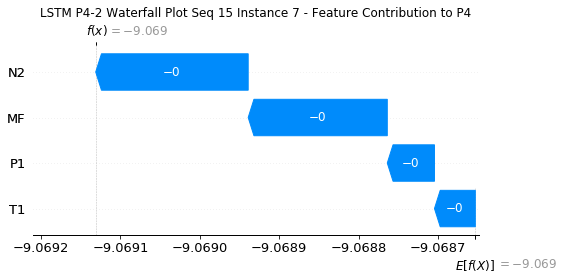

None

Contribution: [-6.01425861e-05 -5.07697442e-05 -1.89274851e-04 -1.74104488e-04]


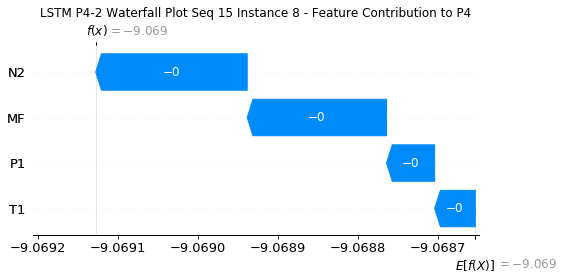

None

Contribution: [-5.93456296e-05 -5.14189806e-05 -1.89517281e-04 -1.72778269e-04]


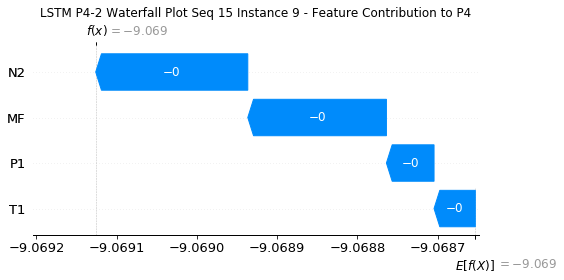

None

Contribution: [-6.07063220e-05 -5.08982084e-05 -1.92861044e-04 -1.77163291e-04]


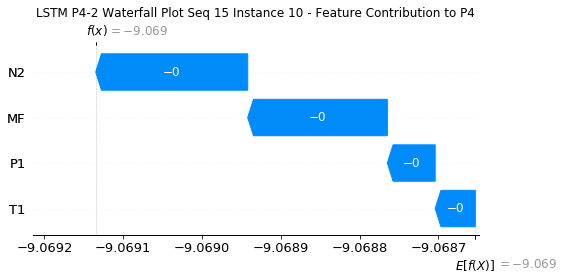

None

Contribution: [-6.19926523e-05 -5.17651315e-05 -1.97589992e-04 -1.81221041e-04]


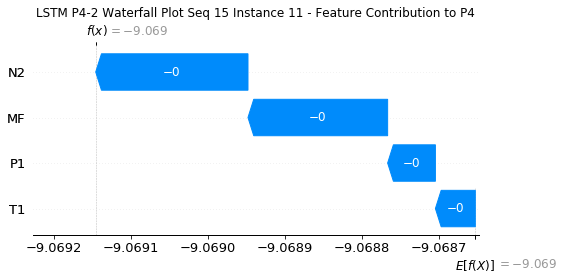

None

Contribution: [-6.32124866e-05 -5.30180218e-05 -2.01988988e-04 -1.85849394e-04]


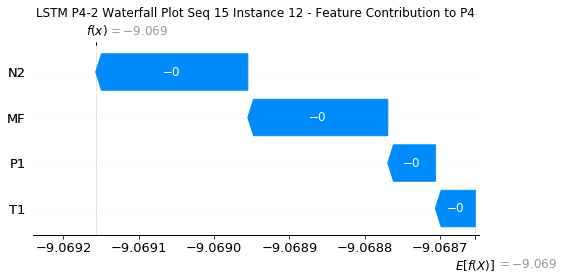

None

Contribution: [-6.43948316e-05 -5.29728175e-05 -2.05231580e-04 -1.88090722e-04]


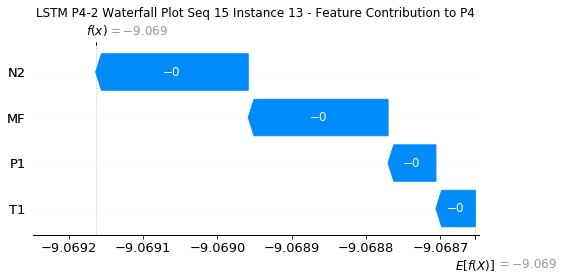

None

Contribution: [-6.53460388e-05 -5.15364153e-05 -2.08582863e-04 -1.91352731e-04]


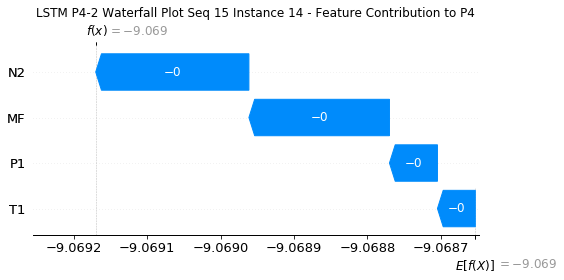

None

Contribution: [-6.63350480e-05 -5.38934389e-05 -2.12279321e-04 -1.94067310e-04]


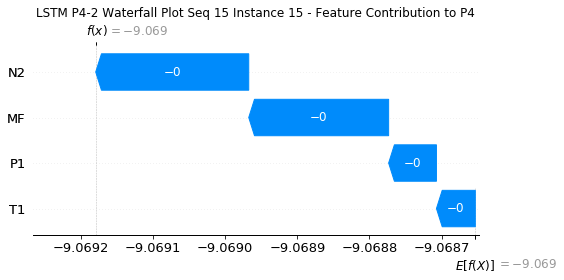

None

Contribution: [-6.82476013e-05 -5.58345855e-05 -2.18519023e-04 -1.99572749e-04]


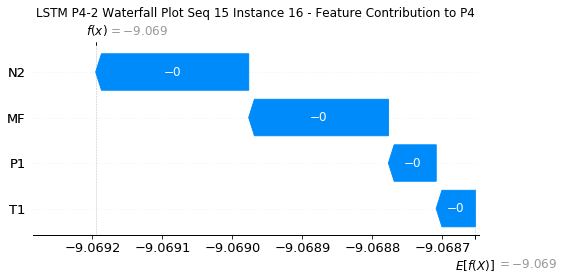

None

Contribution: [-7.14495672e-05 -5.79392291e-05 -2.29050763e-04 -2.08416744e-04]


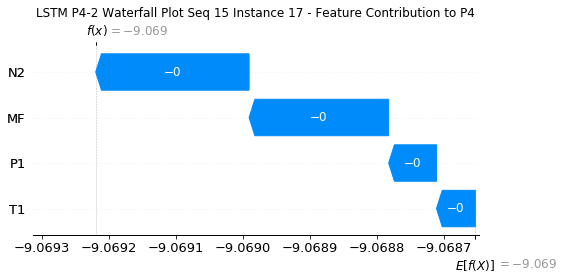

None

Contribution: [-7.64323074e-05 -6.31660930e-05 -2.45624272e-04 -2.23571416e-04]


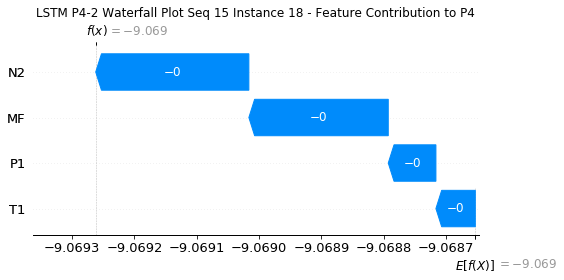

None

Contribution: [-8.55013812e-05 -7.07240617e-05 -2.74122422e-04 -2.49606691e-04]


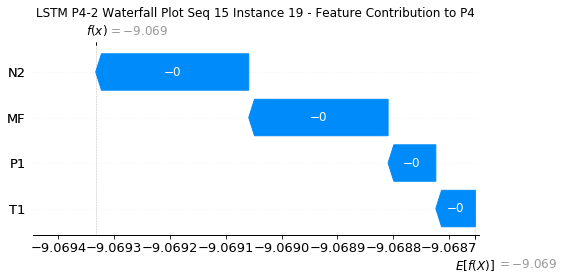

None

Contribution: [-1.04092956e-04 -8.61277797e-05 -3.32898336e-04 -3.03420590e-04]


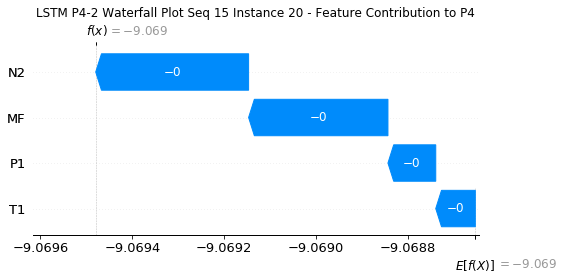

None

Contribution: [-0.00014799 -0.00012245 -0.00047113 -0.00043083]


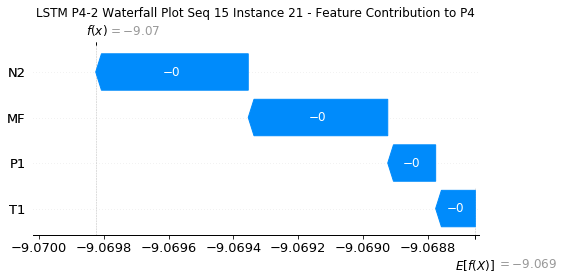

None

Contribution: [-0.00025463 -0.00021377 -0.00081199 -0.00074236]


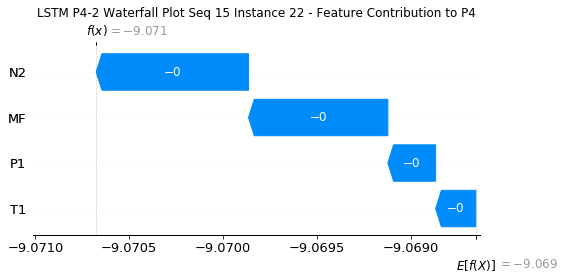

None

Contribution: [-0.00049141 -0.00040504 -0.00160153 -0.00147277]


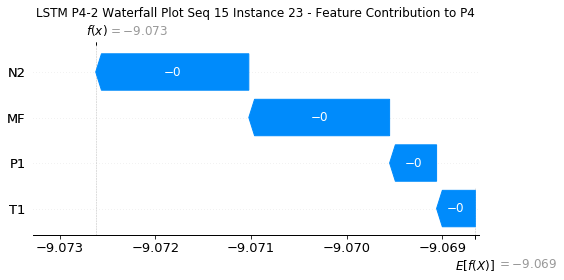

None

Contribution: [-0.00106224 -0.00052734 -0.00345349 -0.00337576]


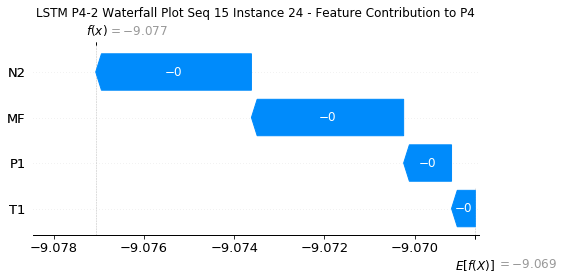

None

Contribution: [-0.01604462 -0.00852502 -0.05458762 -0.05273323]


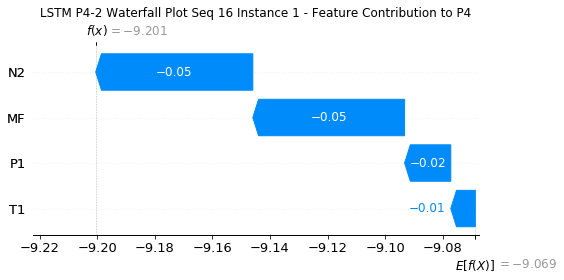

None

Contribution: [ 8.16450150e-05 -1.36566959e-04  4.83506899e-05  3.24042920e-04]


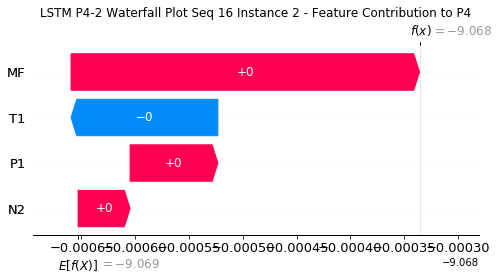

None

Contribution: [-0.00017617 -0.00014378 -0.00056212 -0.00052168]


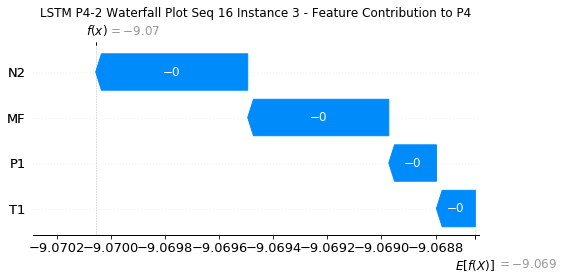

None

Contribution: [-0.00013156 -0.00011141 -0.00042127 -0.00039193]


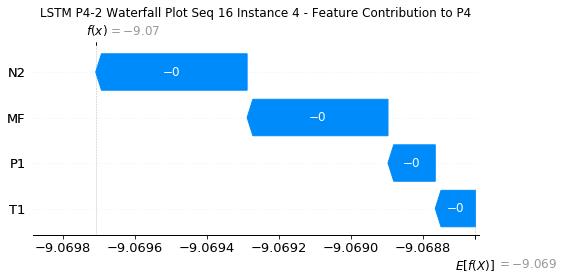

None

Contribution: [-7.88307675e-05 -6.65088319e-05 -2.49654575e-04 -2.33136037e-04]


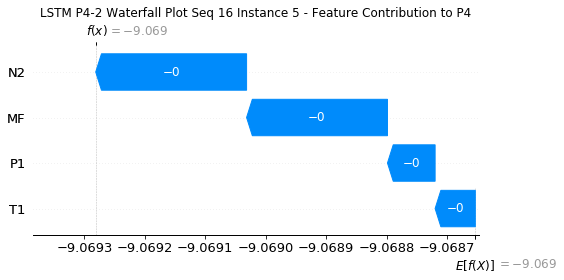

None

Contribution: [-6.35810199e-05 -5.35322475e-05 -2.02780007e-04 -1.86931169e-04]


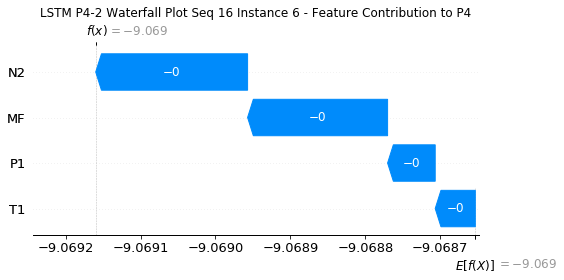

None

Contribution: [-6.02058550e-05 -4.98837534e-05 -1.92765208e-04 -1.77462565e-04]


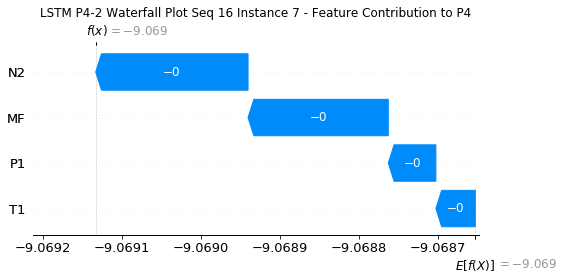

None

Contribution: [-5.89597372e-05 -5.06153018e-05 -1.89054148e-04 -1.72622180e-04]


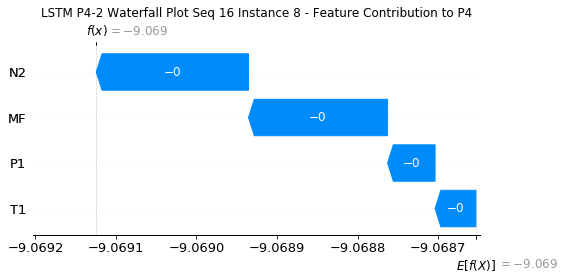

None

Contribution: [-5.99865666e-05 -4.93260019e-05 -1.90292553e-04 -1.75198595e-04]


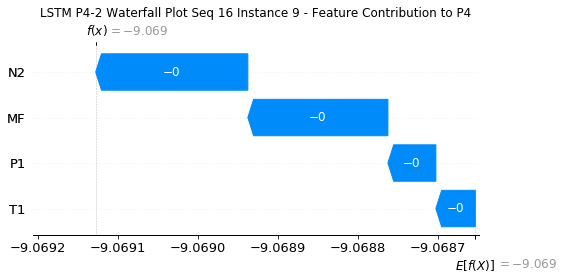

None

Contribution: [-6.08556714e-05 -5.06311585e-05 -1.93221784e-04 -1.77728965e-04]


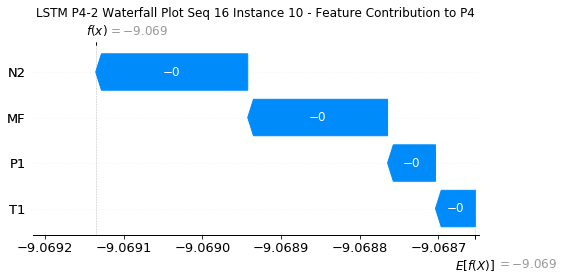

None

Contribution: [-6.21181311e-05 -5.16911850e-05 -1.97953680e-04 -1.81761341e-04]


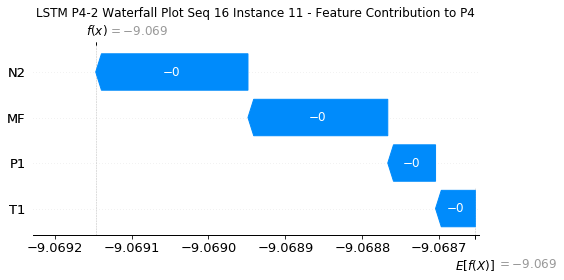

None

Contribution: [-6.32252548e-05 -5.45963355e-05 -2.01951288e-04 -1.84489571e-04]


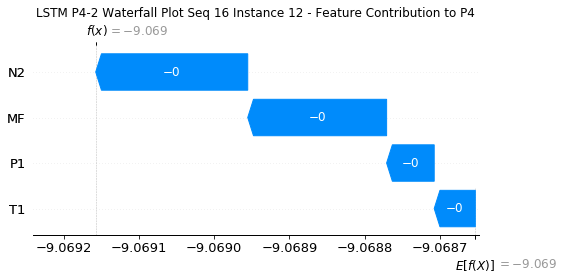

None

Contribution: [-6.45941468e-05 -5.36113638e-05 -2.05743277e-04 -1.88939997e-04]


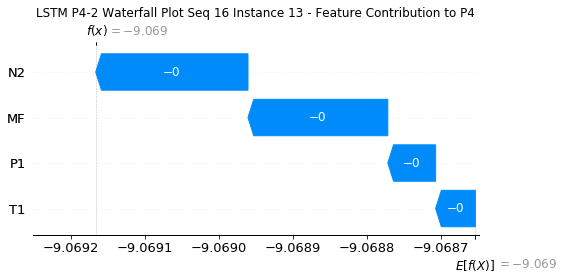

None

Contribution: [-6.55588124e-05 -5.45362079e-05 -2.08698837e-04 -1.90658206e-04]


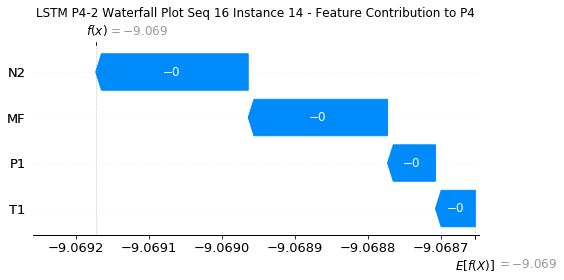

None

Contribution: [-6.65624728e-05 -5.51966815e-05 -2.12923330e-04 -1.95266571e-04]


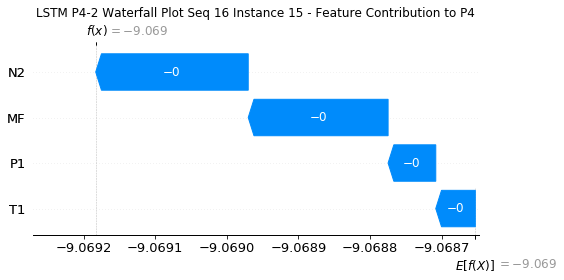

None

Contribution: [-6.83012723e-05 -5.68792566e-05 -2.19083170e-04 -2.00571197e-04]


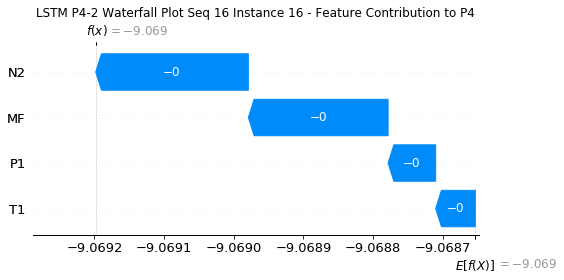

None

Contribution: [-7.16442276e-05 -5.79839366e-05 -2.29531522e-04 -2.08762767e-04]


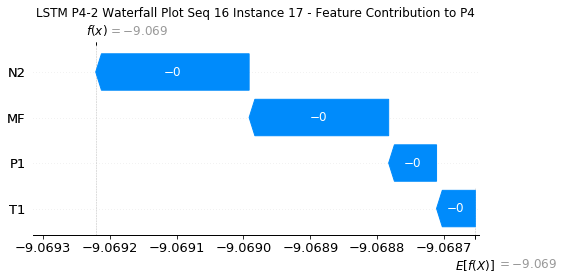

None

Contribution: [-7.62110773e-05 -6.40166645e-05 -2.46258074e-04 -2.24863791e-04]


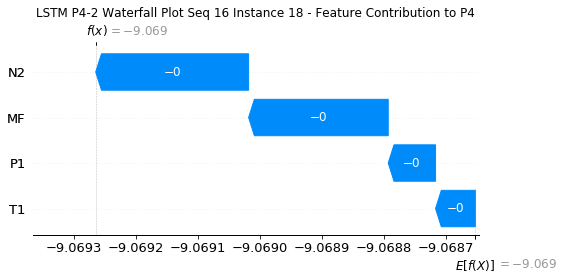

None

Contribution: [-8.51980869e-05 -7.17152077e-05 -2.74762837e-04 -2.50815439e-04]


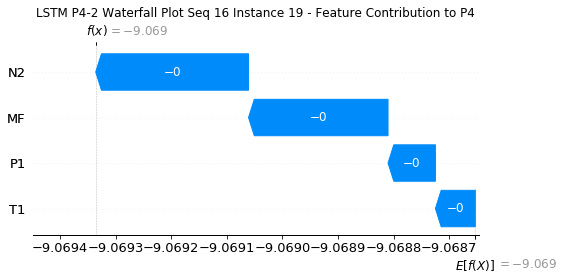

None

Contribution: [-1.03702431e-04 -8.79033971e-05 -3.33656872e-04 -3.04802143e-04]


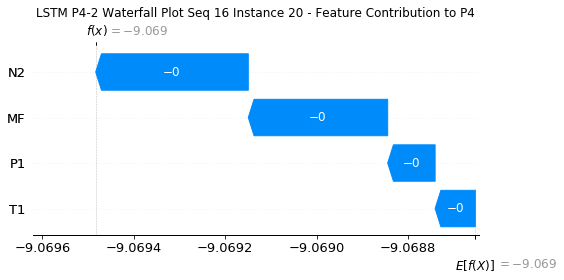

None

Contribution: [-0.0001476  -0.00012607 -0.00047215 -0.00043269]


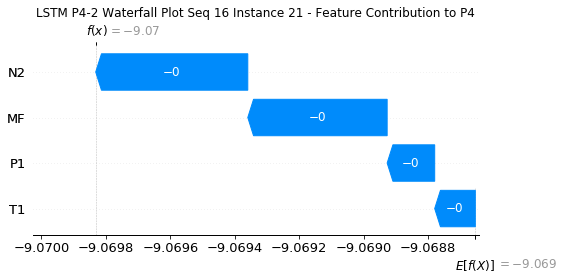

None

Contribution: [-0.00025375 -0.00022442 -0.00081386 -0.00074593]


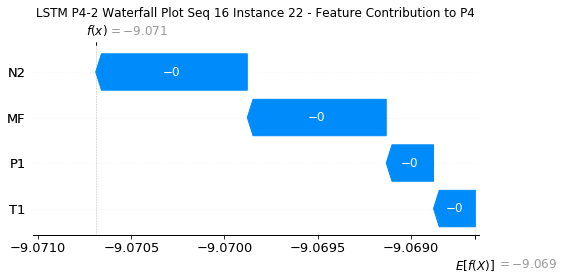

None

Contribution: [-0.00050167 -0.00045151 -0.0016034  -0.00146804]


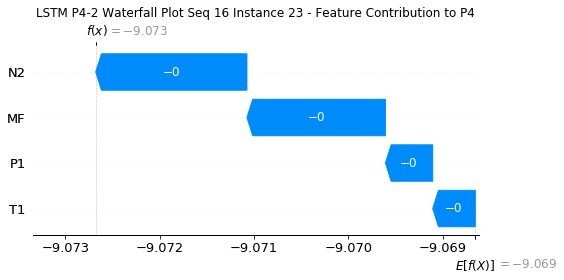

None

Contribution: [-0.00107064 -0.00043667 -0.00343949 -0.00332035]


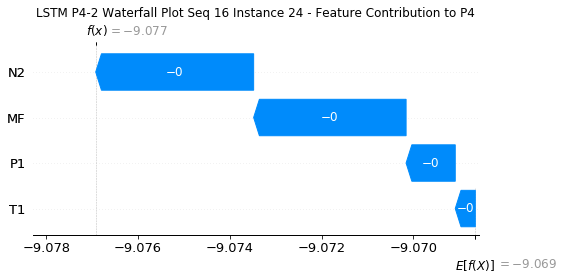

None

Contribution: [-0.01629129 -0.00855829 -0.05452792 -0.05273861]


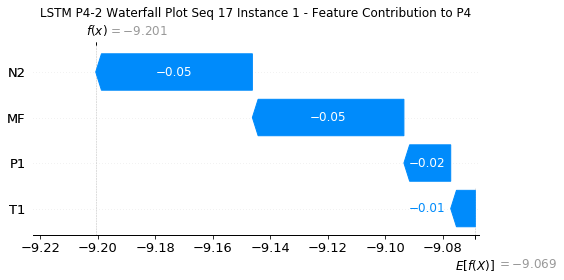

None

Contribution: [ 8.12559695e-05 -1.50999297e-04  5.04320920e-05  3.48328888e-04]


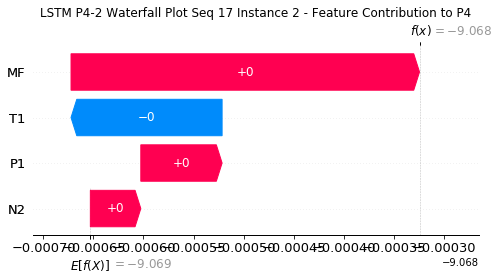

None

Contribution: [-0.00017919 -0.00013308 -0.00056324 -0.00052669]


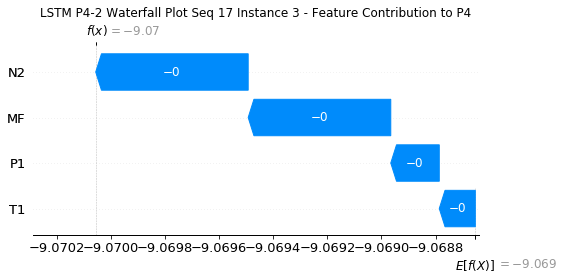

None

Contribution: [-0.0001325  -0.00010486 -0.0004217  -0.00039366]


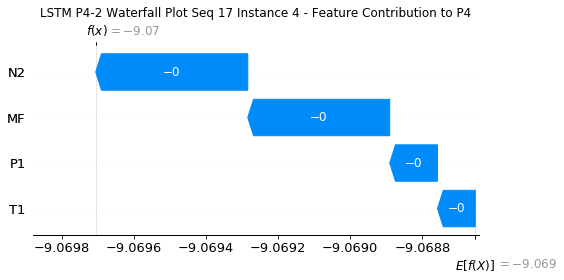

None

Contribution: [-7.85009929e-05 -6.50443915e-05 -2.49733682e-04 -2.32869473e-04]


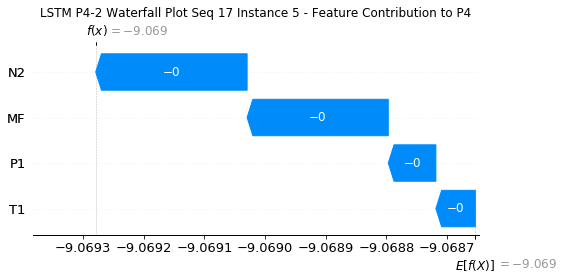

None

Contribution: [-6.38987037e-05 -5.09493020e-05 -2.02942563e-04 -1.87542112e-04]


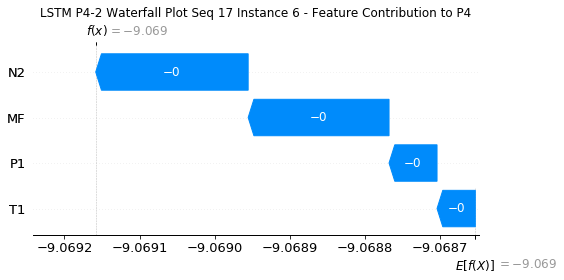

None

Contribution: [-6.04799346e-05 -4.96104403e-05 -1.93071640e-04 -1.77993331e-04]


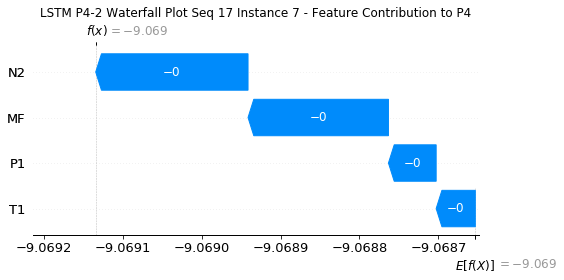

None

Contribution: [-5.94799743e-05 -4.79823416e-05 -1.89996364e-04 -1.75710126e-04]


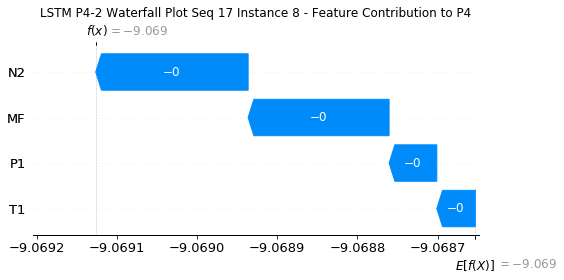

None

Contribution: [-5.92825504e-05 -4.79003521e-05 -1.90140698e-04 -1.74389206e-04]


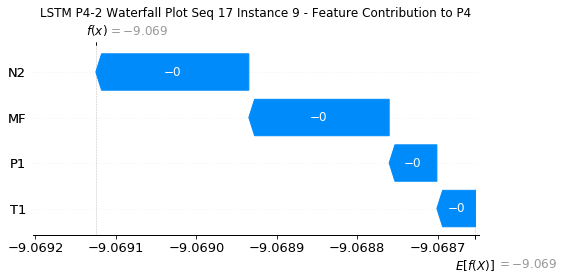

None

Contribution: [-6.02105648e-05 -4.71763023e-05 -1.92801720e-04 -1.76348871e-04]


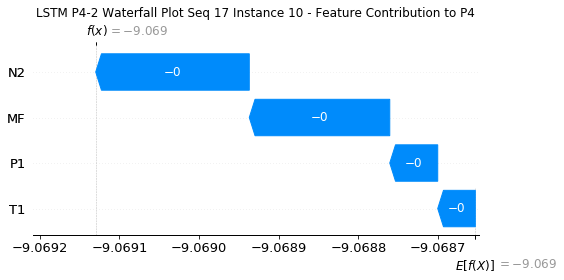

None

Contribution: [-6.17338716e-05 -4.84302046e-05 -1.97651545e-04 -1.80674344e-04]


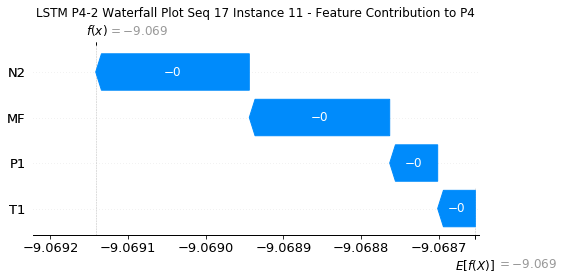

None

Contribution: [-6.28778842e-05 -5.10857370e-05 -2.01981608e-04 -1.84473309e-04]


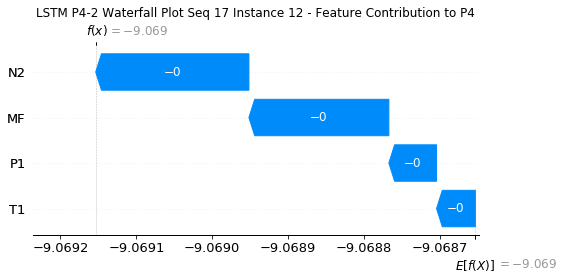

None

Contribution: [-6.40690125e-05 -5.02630398e-05 -2.05327613e-04 -1.87233040e-04]


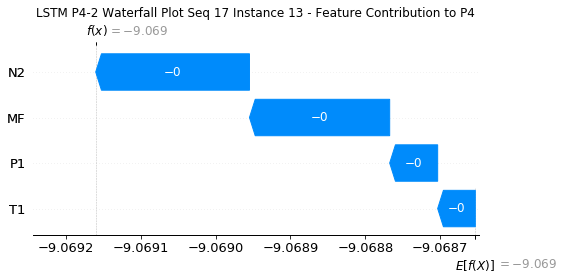

None

Contribution: [-6.55389642e-05 -5.07187331e-05 -2.08689834e-04 -1.92915946e-04]


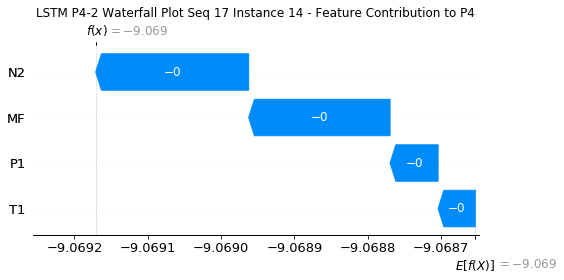

None

Contribution: [-6.60962063e-05 -5.19998271e-05 -2.12466674e-04 -1.93245535e-04]


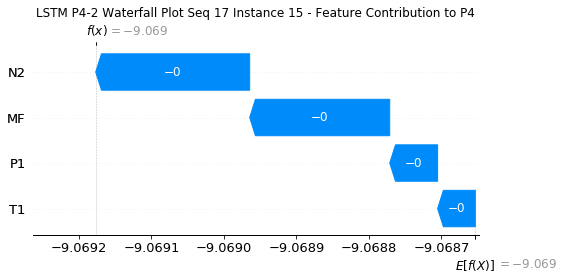

None

Contribution: [-6.80010848e-05 -5.35369949e-05 -2.18831177e-04 -1.99059153e-04]


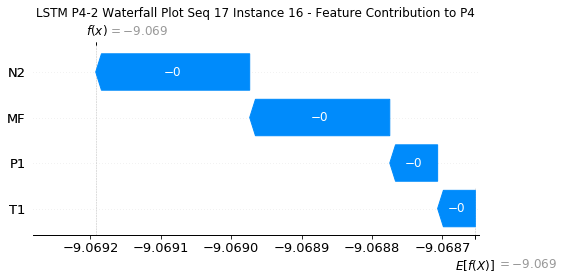

None

Contribution: [-7.15290578e-05 -5.62036481e-05 -2.29218569e-04 -2.10610107e-04]


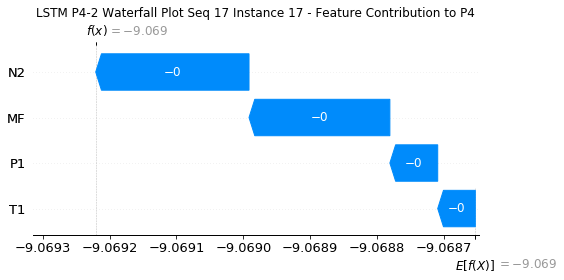

None

Contribution: [-7.68201151e-05 -6.13214771e-05 -2.46239421e-04 -2.23922435e-04]


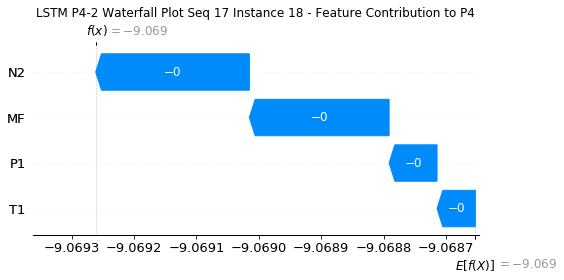

None

Contribution: [-8.58515703e-05 -6.84788776e-05 -2.74828455e-04 -2.49890869e-04]


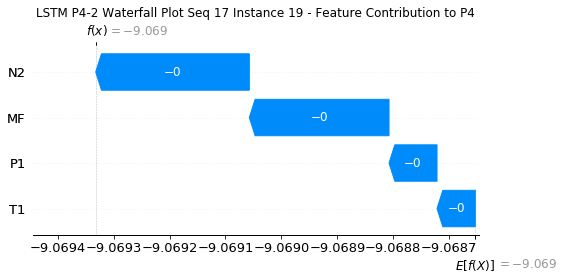

None

Contribution: [-1.04543056e-04 -8.38712972e-05 -3.33675949e-04 -3.03375911e-04]


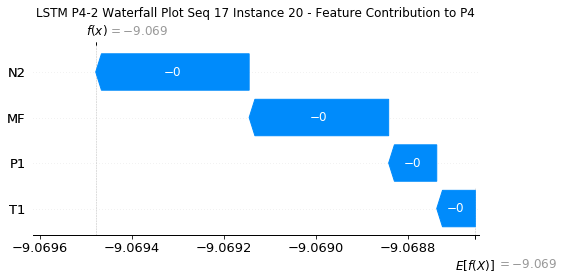

None

Contribution: [-0.00014783 -0.00011935 -0.00047215 -0.00042997]


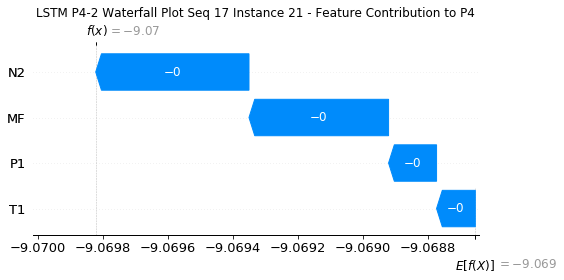

None

Contribution: [-0.00025687 -0.00021095 -0.00081474 -0.00074613]


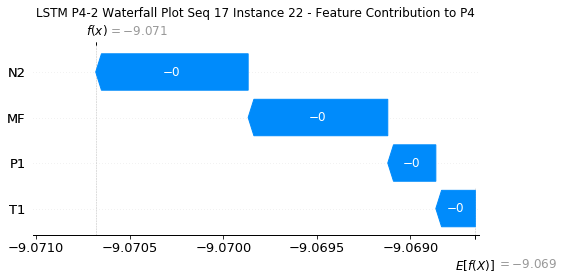

None

Contribution: [-0.00051587 -0.00039523 -0.00161119 -0.00151278]


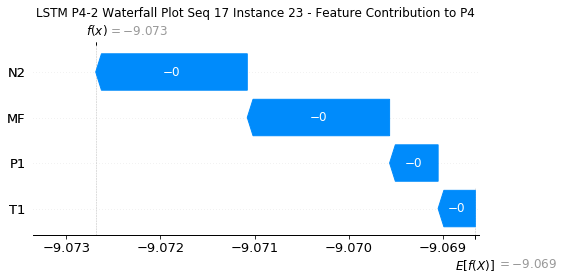

None

Contribution: [-0.00105058 -0.00023014 -0.00342998 -0.00329   ]


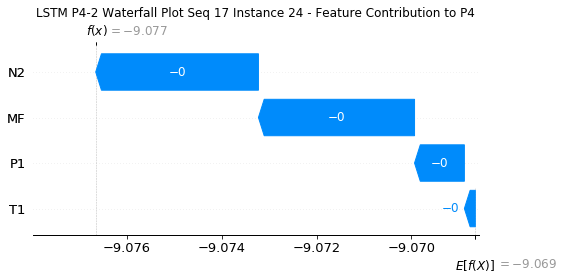

None

Contribution: [-0.0161801  -0.00641232 -0.05457561 -0.05139552]


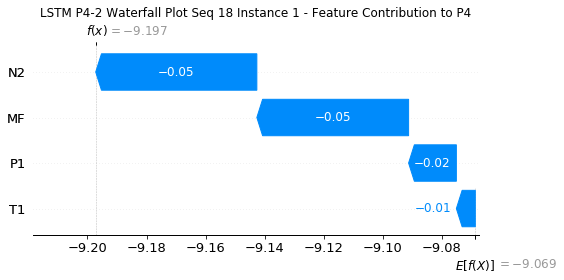

None

Contribution: [ 7.05106578e-05 -1.71163300e-04  1.94193096e-05  2.84022965e-04]


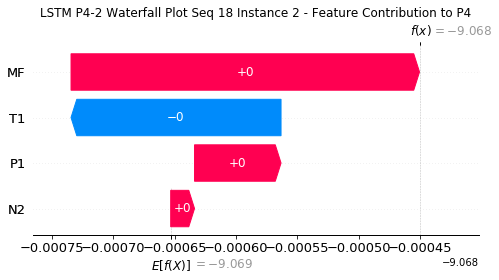

None

Contribution: [-0.00018151 -0.0001251  -0.00057065 -0.00052991]


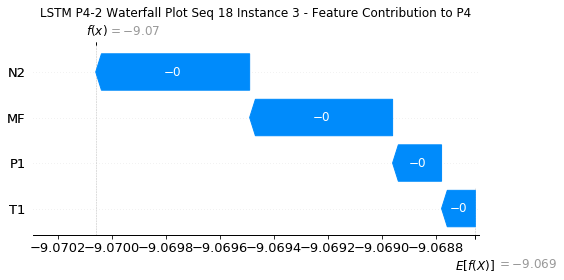

None

Contribution: [-0.00013321 -0.00010047 -0.00042341 -0.00039292]


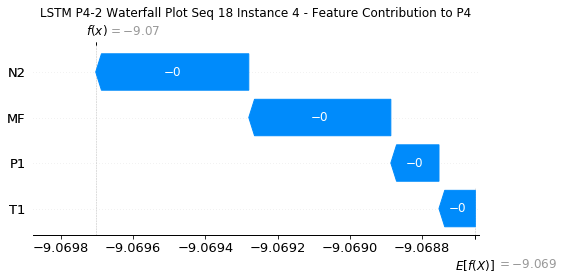

None

Contribution: [-7.80575196e-05 -6.19441568e-05 -2.50114107e-04 -2.31285441e-04]


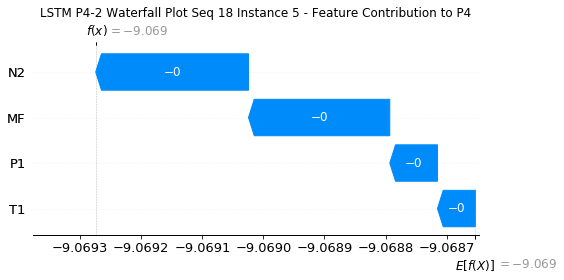

None

Contribution: [-6.38785394e-05 -4.86174354e-05 -2.02833394e-04 -1.86171471e-04]


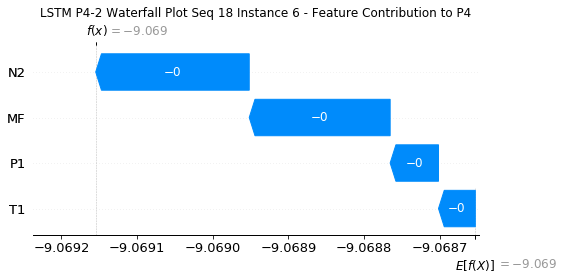

None

Contribution: [-5.96212690e-05 -4.48587704e-05 -1.92377202e-04 -1.74855406e-04]


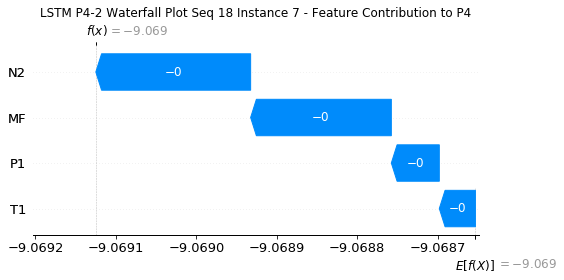

None

Contribution: [-5.95876035e-05 -4.42138307e-05 -1.89586875e-04 -1.73356095e-04]


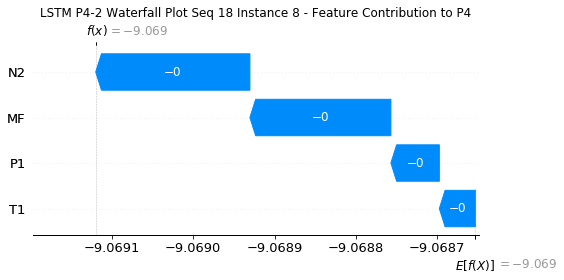

None

Contribution: [-5.88761414e-05 -4.45972342e-05 -1.89838346e-04 -1.72378240e-04]


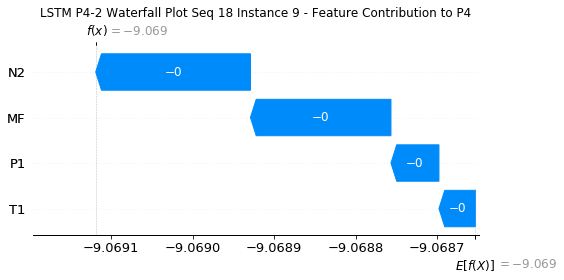

None

Contribution: [-6.06578661e-05 -4.62364059e-05 -1.93442710e-04 -1.76322712e-04]


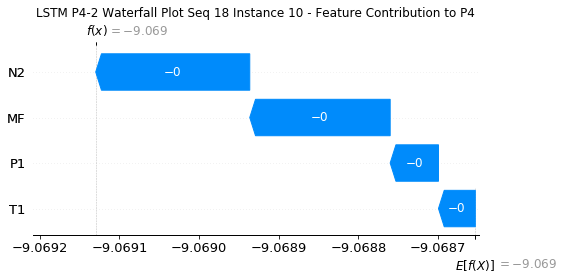

None

Contribution: [-6.21487686e-05 -4.71932156e-05 -1.98248145e-04 -1.80467093e-04]


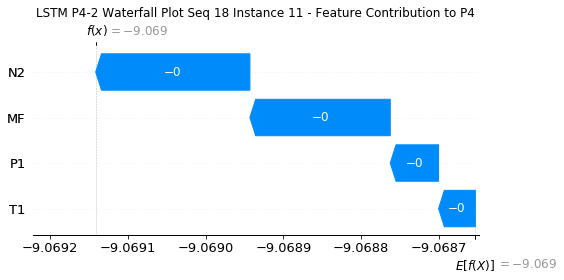

None

Contribution: [-6.31001482e-05 -4.84961094e-05 -2.01770764e-04 -1.82804482e-04]


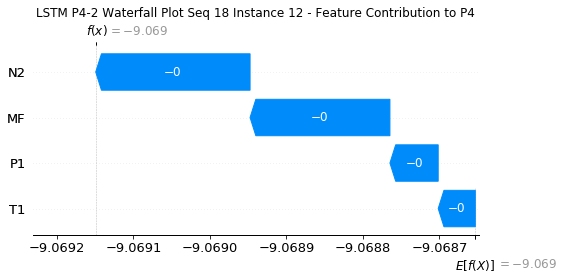

None

Contribution: [-6.46699182e-05 -4.92491002e-05 -2.06257838e-04 -1.87710294e-04]


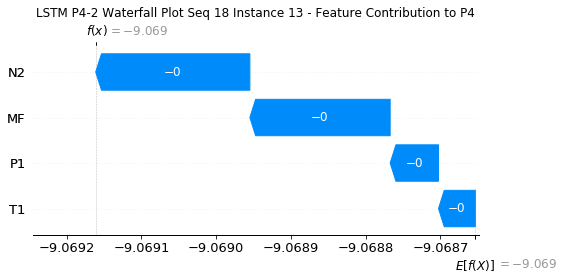

None

Contribution: [-6.56846910e-05 -5.15021945e-05 -2.09459155e-04 -1.89577219e-04]


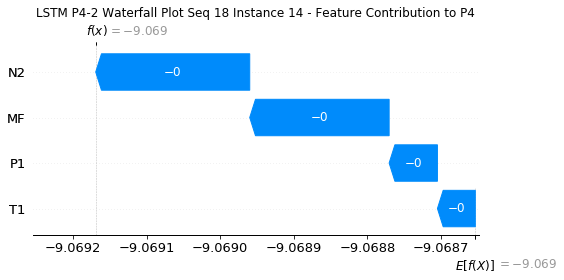

None

Contribution: [-6.68357166e-05 -5.10111530e-05 -2.13546347e-04 -1.93664346e-04]


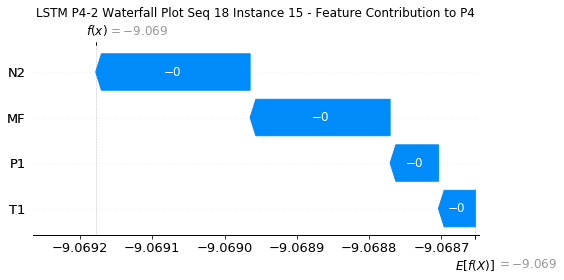

None

Contribution: [-6.87535610e-05 -5.25514323e-05 -2.19732750e-04 -1.98886699e-04]


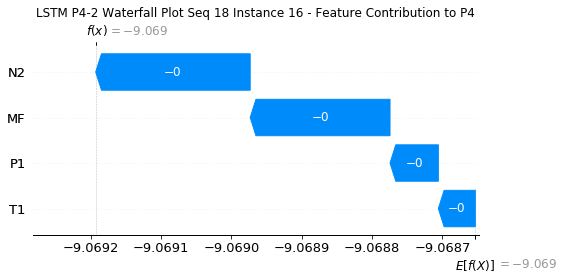

None

Contribution: [-7.14704752e-05 -5.32235997e-05 -2.30167649e-04 -2.07565790e-04]


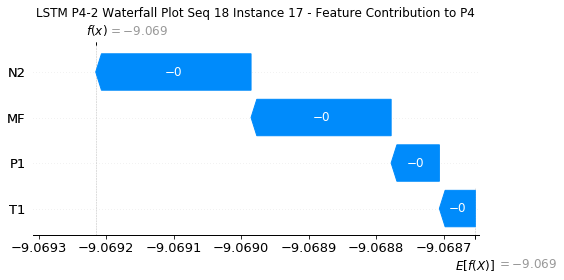

None

Contribution: [-7.76146715e-05 -5.94284664e-05 -2.47441346e-04 -2.24264332e-04]


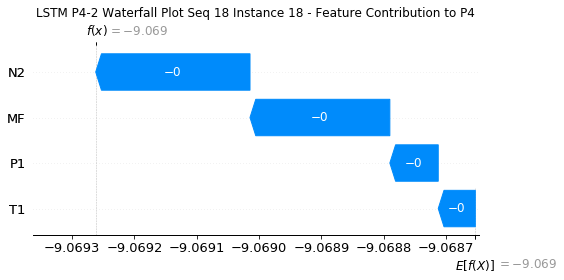

None

Contribution: [-8.67799893e-05 -6.65965365e-05 -2.76166799e-04 -2.50229219e-04]


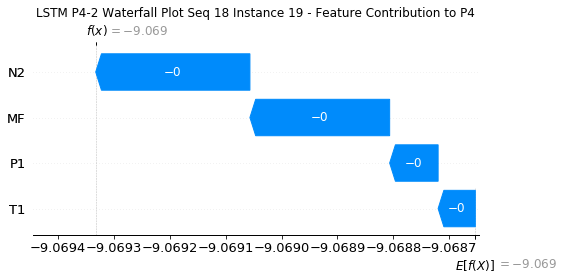

None

Contribution: [-1.05761000e-04 -8.16334830e-05 -3.35627668e-04 -3.05037772e-04]


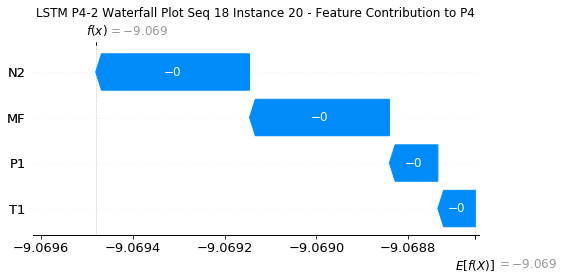

None

Contribution: [-0.00014977 -0.00011732 -0.00047482 -0.00043154]


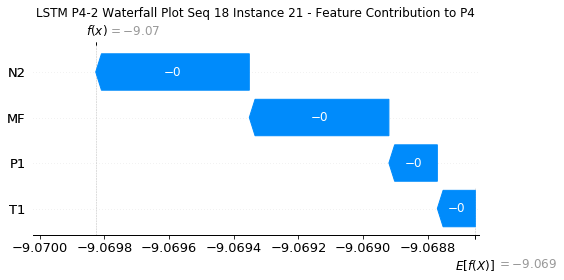

None

Contribution: [-0.00025882 -0.00020437 -0.00081847 -0.00074667]


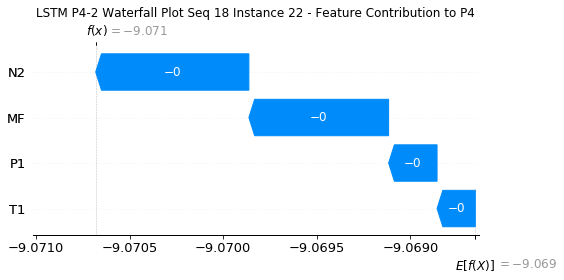

None

Contribution: [-0.0005016  -0.00036945 -0.00161241 -0.00148543]


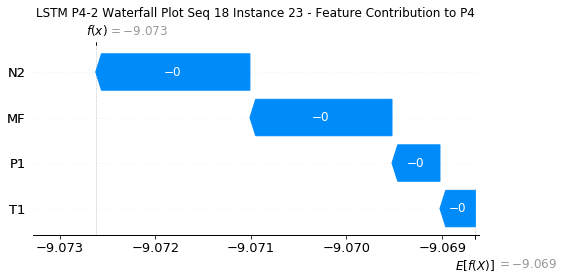

None

Contribution: [-0.00106374 -0.00023421 -0.0034625  -0.00332989]


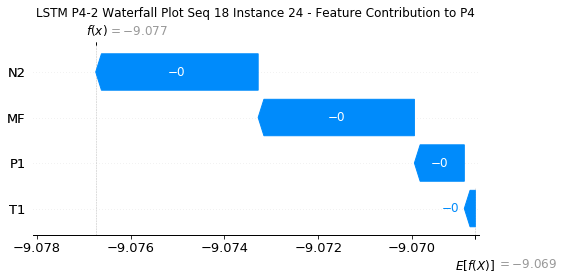

None

Contribution: [-0.01633781 -0.00633416 -0.05499625 -0.05365648]


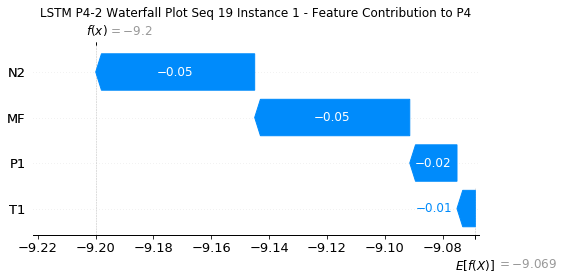

None

Contribution: [ 8.41501741e-05 -1.60804571e-04  5.02808132e-05  3.45488631e-04]


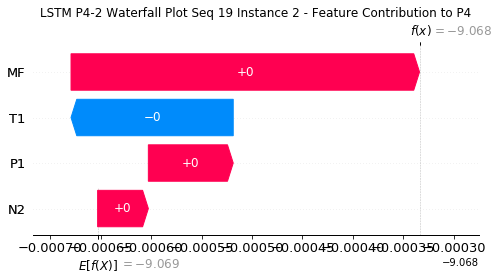

None

Contribution: [-0.00018269 -0.00013903 -0.00056476 -0.00053056]


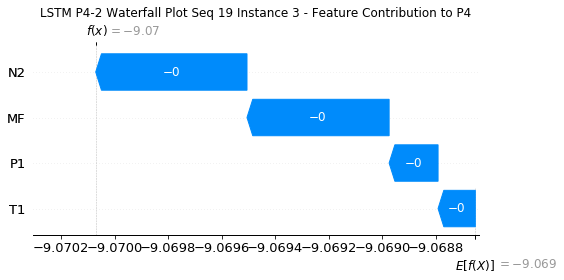

None

Contribution: [-0.00013442 -0.00010862 -0.00042248 -0.00039556]


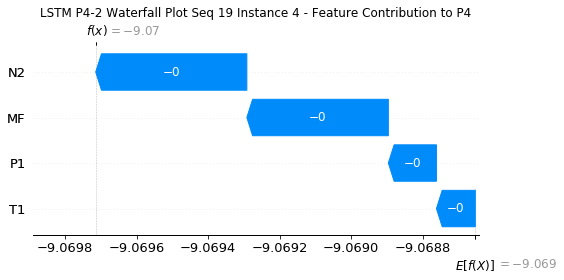

None

Contribution: [-8.00997423e-05 -6.31947743e-05 -2.49505805e-04 -2.32322452e-04]


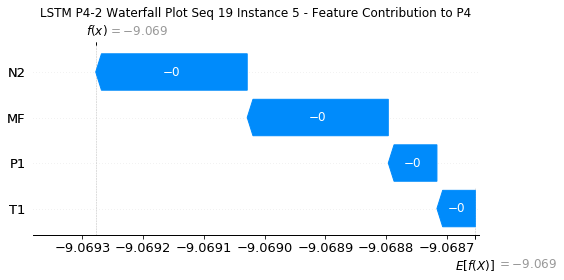

None

Contribution: [-6.48480186e-05 -5.22164230e-05 -2.03245127e-04 -1.88309517e-04]


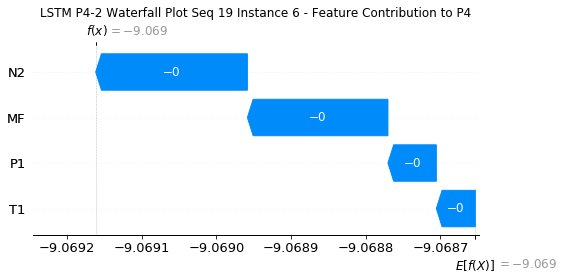

None

Contribution: [-6.20690408e-05 -4.93518812e-05 -1.93737750e-04 -1.79413076e-04]


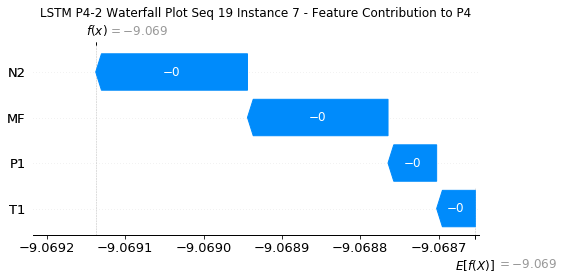

None

Contribution: [-6.15245431e-05 -4.78380048e-05 -1.90717280e-04 -1.77963969e-04]


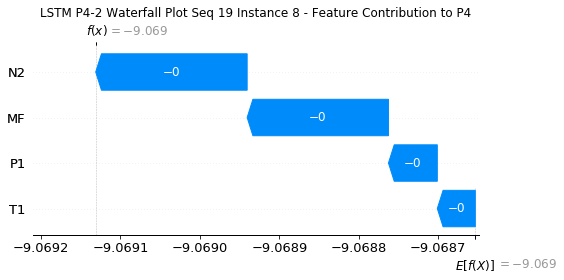

None

Contribution: [-6.06208146e-05 -4.99060015e-05 -1.90680464e-04 -1.75571572e-04]


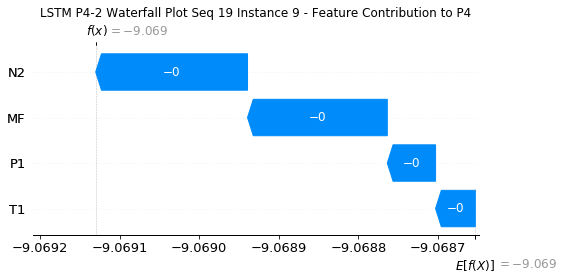

None

Contribution: [-6.14631806e-05 -4.93364286e-05 -1.93297030e-04 -1.77472988e-04]


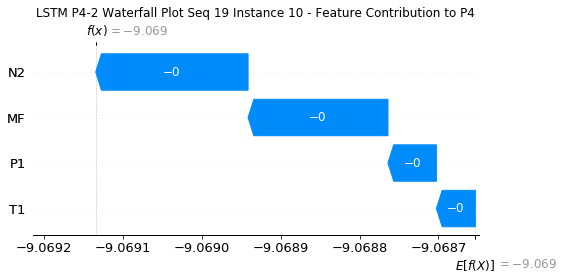

None

Contribution: [-6.29976009e-05 -5.00438851e-05 -1.98168894e-04 -1.81771623e-04]


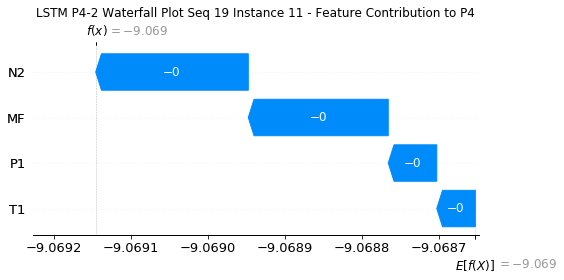

None

Contribution: [-6.49721999e-05 -5.12590473e-05 -2.02818230e-04 -1.87155346e-04]


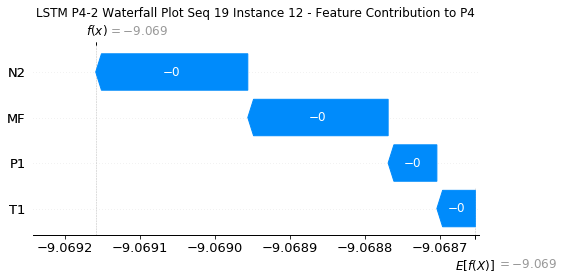

None

Contribution: [-6.52941945e-05 -5.18280755e-05 -2.05776731e-04 -1.88049020e-04]


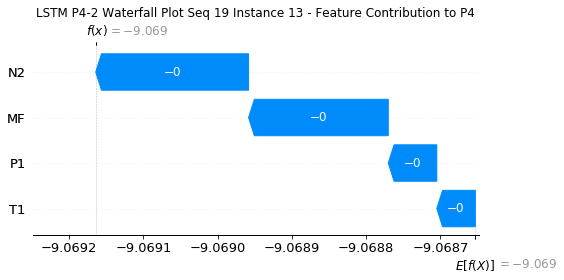

None

Contribution: [-6.63836802e-05 -5.16118065e-05 -2.09172285e-04 -1.91999605e-04]


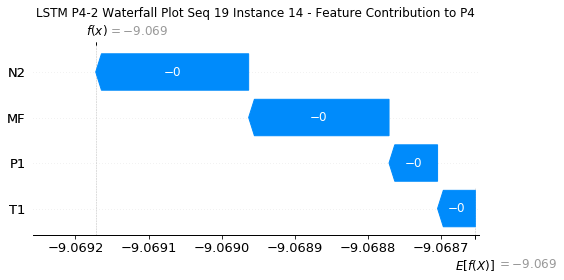

None

Contribution: [-6.71641018e-05 -5.26846889e-05 -2.12762613e-04 -1.93496950e-04]


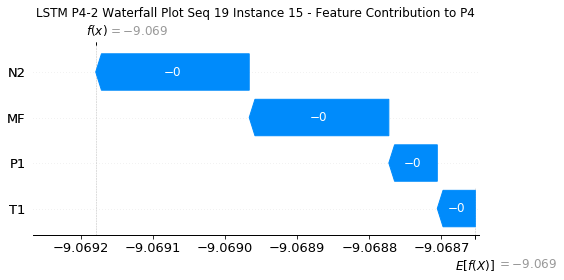

None

Contribution: [-6.89002307e-05 -5.40571785e-05 -2.19040437e-04 -1.99016496e-04]


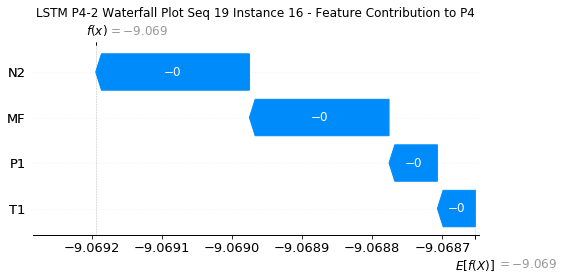

None

Contribution: [-7.24619372e-05 -5.65902452e-05 -2.30511212e-04 -2.10951194e-04]


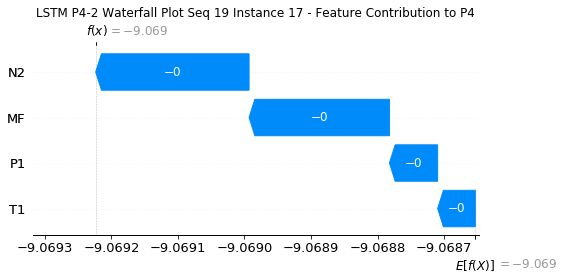

None

Contribution: [-7.74366088e-05 -6.02388281e-05 -2.46317157e-04 -2.23085422e-04]


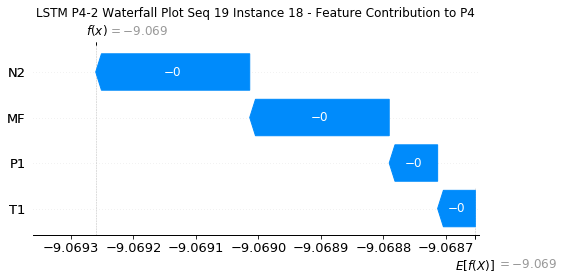

None

Contribution: [-8.65232412e-05 -6.74994890e-05 -2.74910297e-04 -2.48989411e-04]


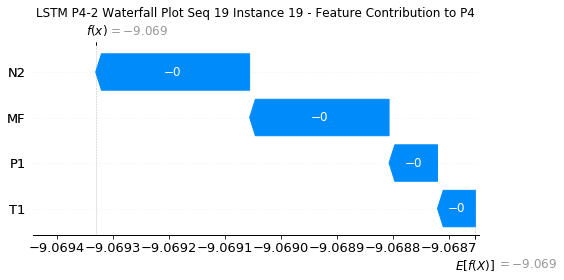

None

Contribution: [-1.05427870e-04 -8.31700244e-05 -3.33927372e-04 -3.02513798e-04]


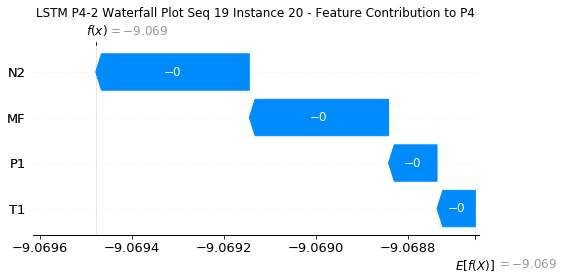

None

Contribution: [-0.00014912 -0.00011955 -0.00047248 -0.0004286 ]


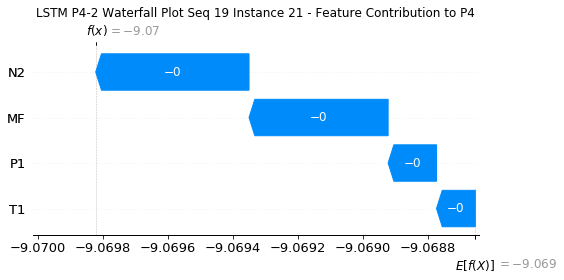

None

Contribution: [-0.0002567  -0.00020861 -0.00081448 -0.00073834]


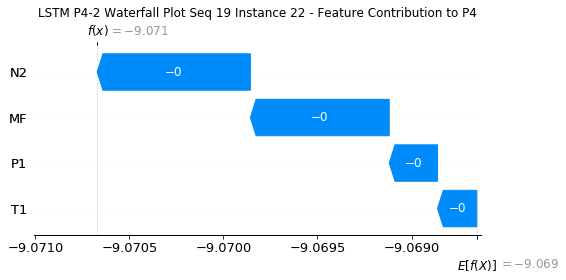

None

Contribution: [-0.00050745 -0.00039036 -0.00161047 -0.00148922]


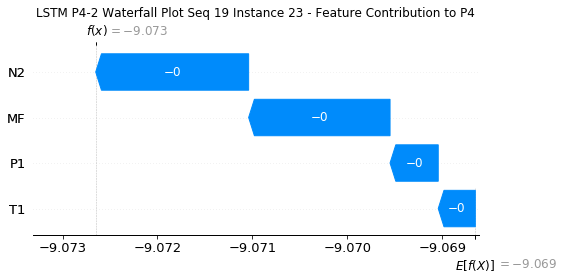

None

Contribution: [-0.00110744 -0.00029398 -0.00346593 -0.00340678]


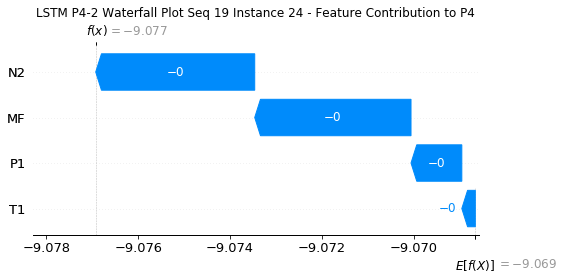

None

Contribution: [-0.01672238 -0.00712192 -0.05476663 -0.05239161]


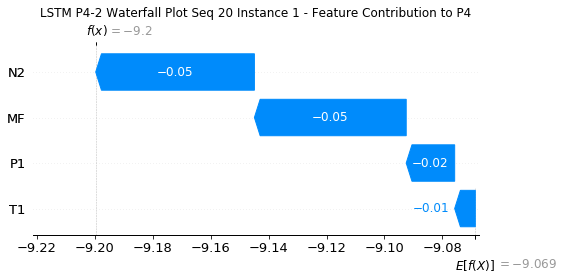

None

Contribution: [ 6.58603072e-05 -1.70719780e-04  1.67285300e-05  2.70946814e-04]


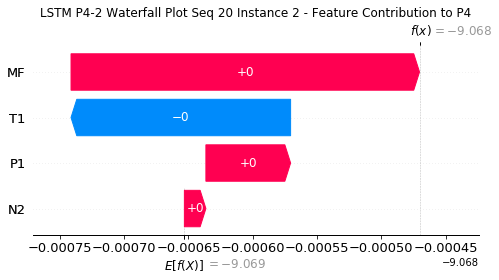

None

Contribution: [-0.00018184 -0.00013192 -0.00056605 -0.0005262 ]


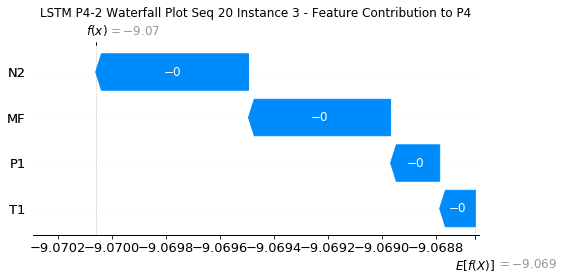

None

Contribution: [-0.00013432 -0.00010476 -0.00042259 -0.00039372]


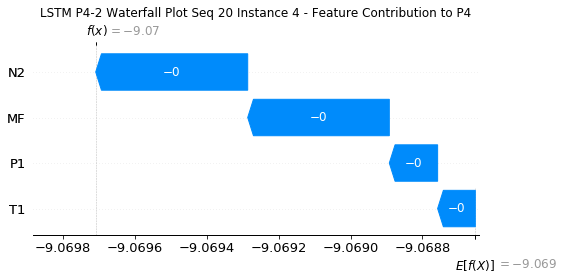

None

Contribution: [-7.95478478e-05 -6.28685039e-05 -2.49674742e-04 -2.31313818e-04]


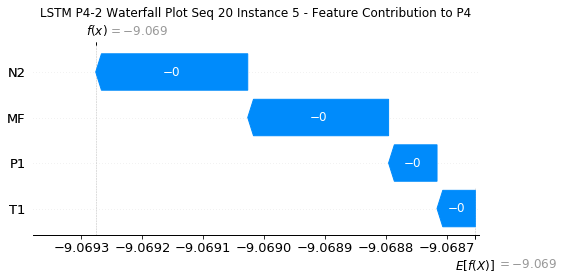

None

Contribution: [-6.47102807e-05 -5.04884000e-05 -2.03125843e-04 -1.87460176e-04]


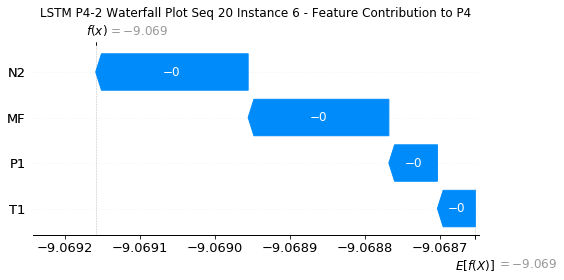

None

Contribution: [-6.14028913e-05 -4.67935767e-05 -1.93324169e-04 -1.78482240e-04]


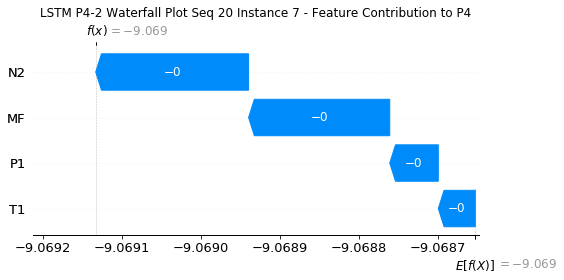

None

Contribution: [-6.04721520e-05 -4.66457149e-05 -1.89807196e-04 -1.73571037e-04]


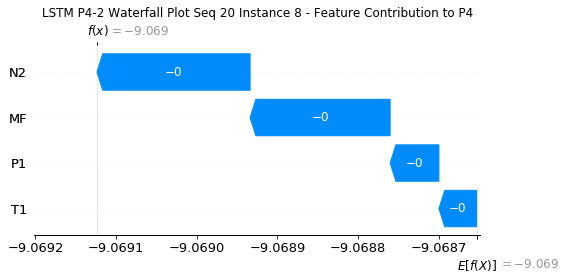

None

Contribution: [-6.07006662e-05 -4.71132217e-05 -1.90868877e-04 -1.75707642e-04]


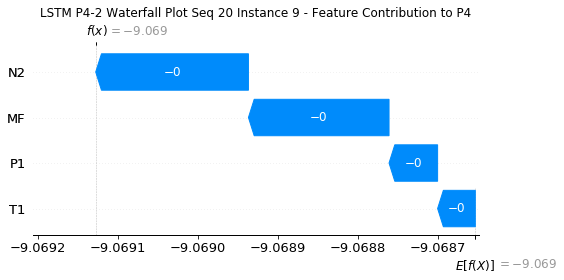

None

Contribution: [-6.12719828e-05 -4.76202706e-05 -1.93052012e-04 -1.76399220e-04]


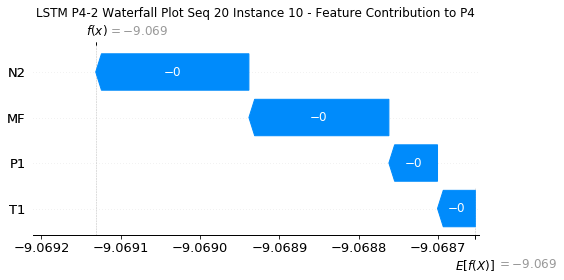

None

Contribution: [-6.27390775e-05 -4.84342094e-05 -1.97834541e-04 -1.80663986e-04]


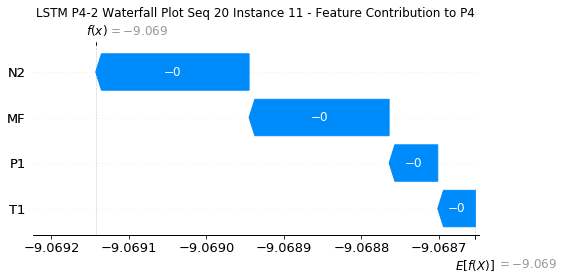

None

Contribution: [-6.45253434e-05 -5.19468018e-05 -2.01594671e-04 -1.83957128e-04]


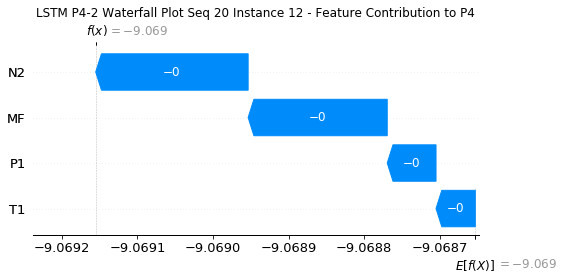

None

Contribution: [-6.50915369e-05 -5.02669270e-05 -2.05399217e-04 -1.87066449e-04]


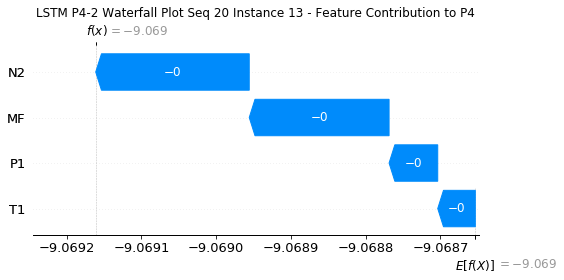

None

Contribution: [-6.53979336e-05 -5.08503841e-05 -2.08237501e-04 -1.88653017e-04]


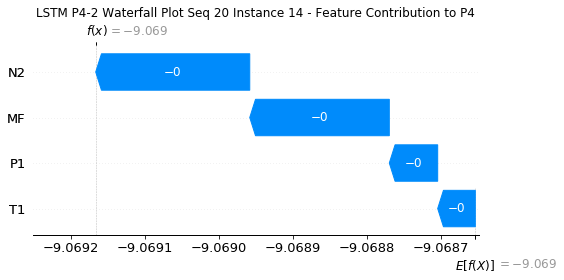

None

Contribution: [-6.73529362e-05 -5.16015268e-05 -2.12639328e-04 -1.93710944e-04]


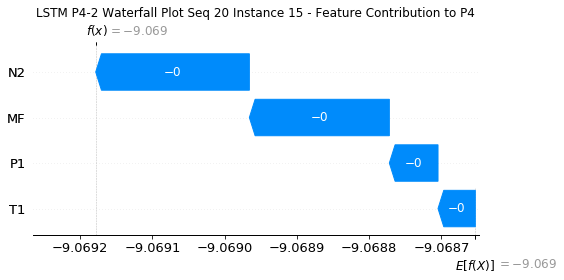

None

Contribution: [-6.93977978e-05 -5.31953821e-05 -2.19026111e-04 -1.99898864e-04]


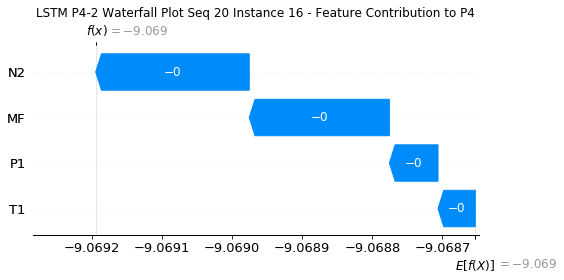

None

Contribution: [-7.31228322e-05 -5.49018454e-05 -2.29362159e-04 -2.09346931e-04]


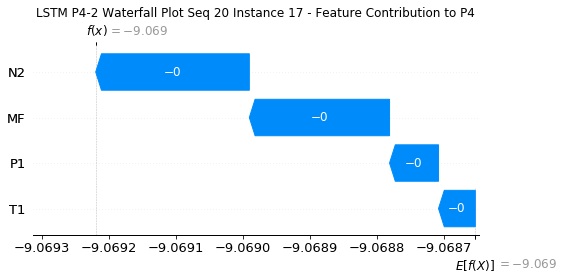

None

Contribution: [-7.78218254e-05 -5.94826783e-05 -2.46143304e-04 -2.24108876e-04]


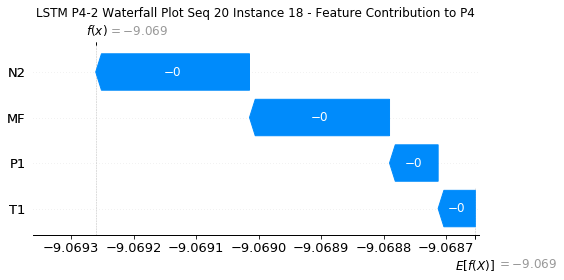

None

Contribution: [-8.69695023e-05 -6.67105413e-05 -2.74710584e-04 -2.50142686e-04]


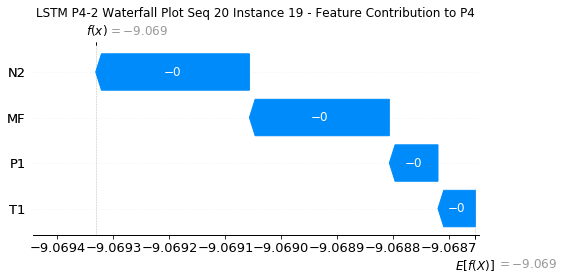

None

Contribution: [-1.05505145e-04 -8.17867536e-05 -3.33384259e-04 -3.02662436e-04]


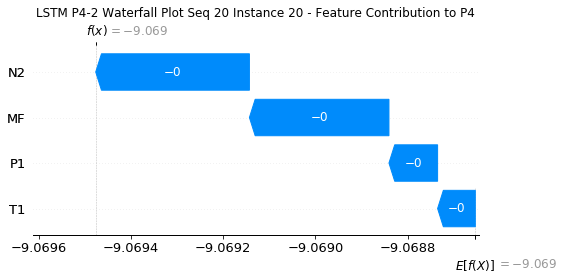

None

Contribution: [-0.00014999 -0.00011782 -0.00047194 -0.00043004]


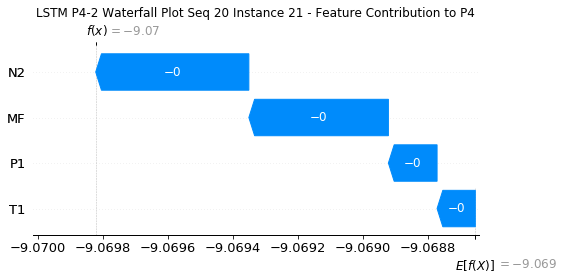

None

Contribution: [-0.00025801 -0.00020588 -0.00081291 -0.00073906]


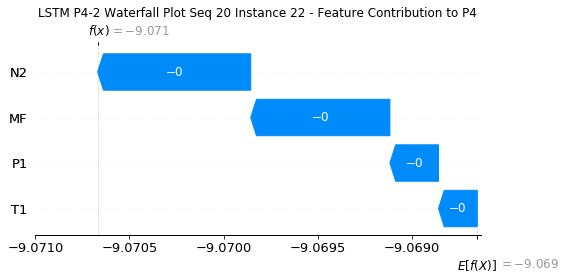

None

Contribution: [-0.00050346 -0.00040571 -0.0016035  -0.0014541 ]


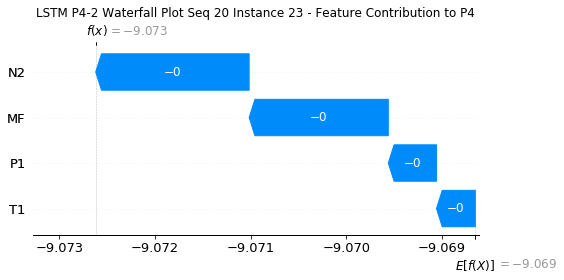

None

Contribution: [-0.0011014  -0.00038384 -0.00344699 -0.00332522]


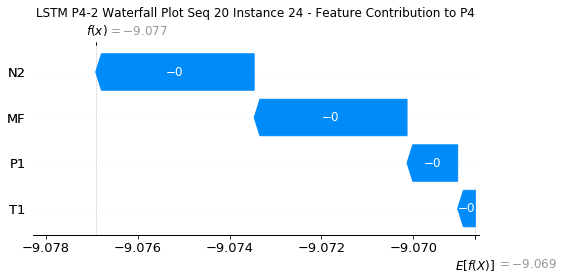

None

Contribution: [-0.01640859 -0.00790412 -0.05454294 -0.05064789]


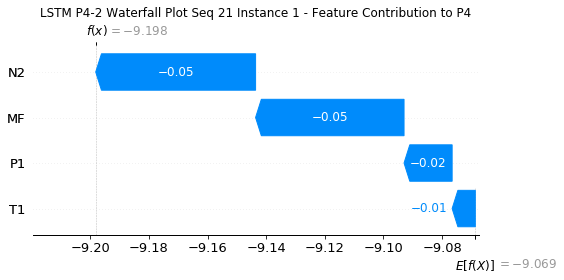

None

Contribution: [ 8.83314910e-05 -1.52261997e-04  4.92691836e-05  3.34954048e-04]


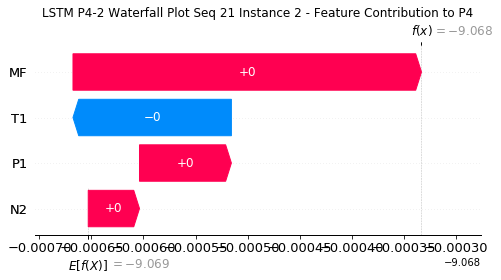

None

Contribution: [-0.00018163 -0.00013401 -0.00056774 -0.00052557]


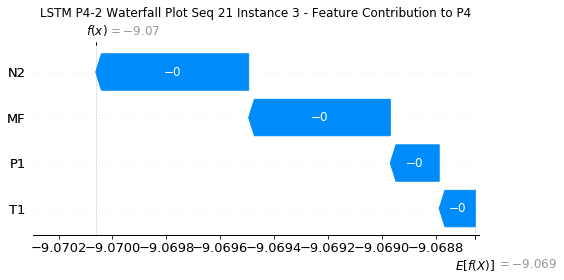

None

Contribution: [-0.00013361 -0.00010589 -0.00042285 -0.00039257]


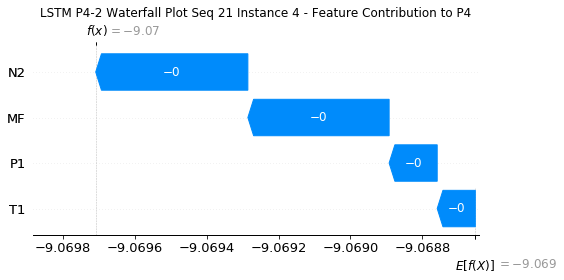

None

Contribution: [-8.00686603e-05 -5.90283321e-05 -2.48785748e-04 -2.31808530e-04]


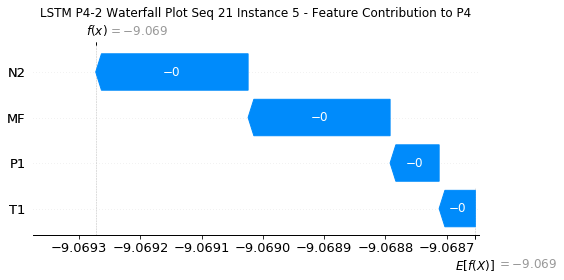

None

Contribution: [-6.45068342e-05 -5.12321433e-05 -2.02971562e-04 -1.86941802e-04]


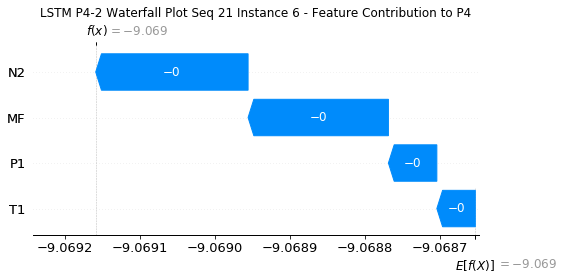

None

Contribution: [-6.21244654e-05 -4.93840358e-05 -1.93161672e-04 -1.78133736e-04]


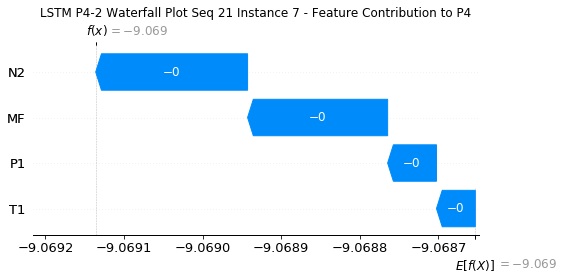

None

Contribution: [-6.08691220e-05 -5.02502476e-05 -1.89980455e-04 -1.74851061e-04]


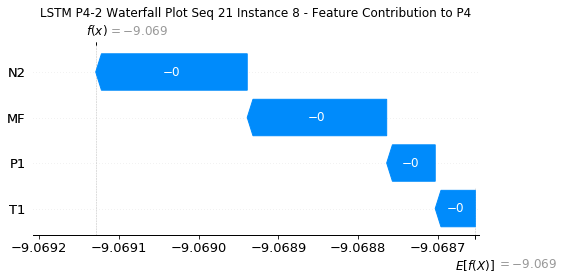

None

Contribution: [-6.06921052e-05 -4.99126179e-05 -1.90609957e-04 -1.75543509e-04]


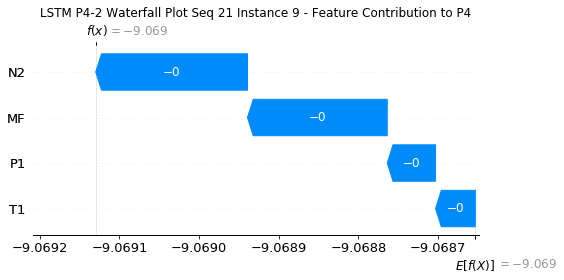

None

Contribution: [-6.05487915e-05 -4.79439554e-05 -1.93062672e-04 -1.76134302e-04]


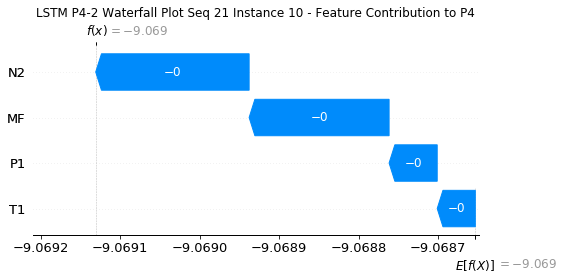

None

Contribution: [-6.22369915e-05 -4.89088384e-05 -1.97966507e-04 -1.80559042e-04]


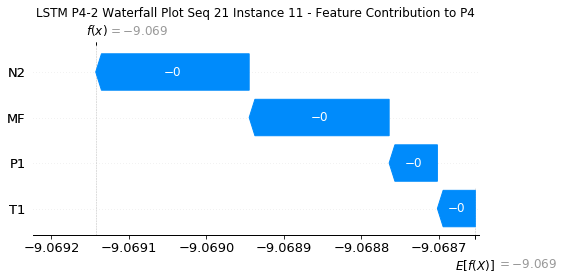

None

Contribution: [-6.51061808e-05 -5.05329241e-05 -2.03053411e-04 -1.87657592e-04]


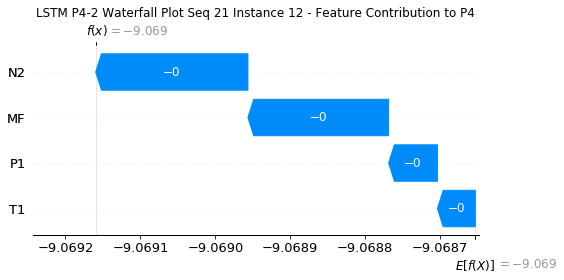

None

Contribution: [-6.47610043e-05 -5.08693621e-05 -2.05747678e-04 -1.87811041e-04]


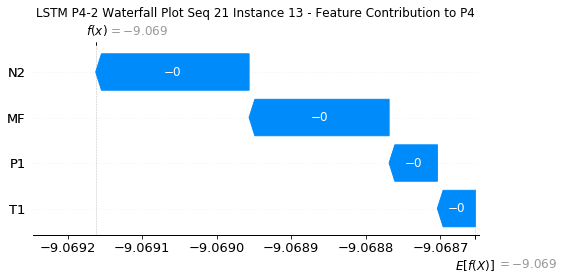

None

Contribution: [-6.65793666e-05 -5.19574384e-05 -2.09243649e-04 -1.91015179e-04]


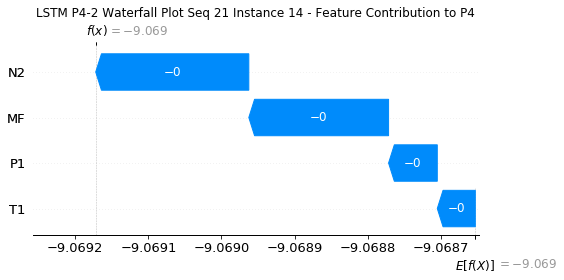

None

Contribution: [-6.81680101e-05 -5.04951531e-05 -2.13612076e-04 -1.96521228e-04]


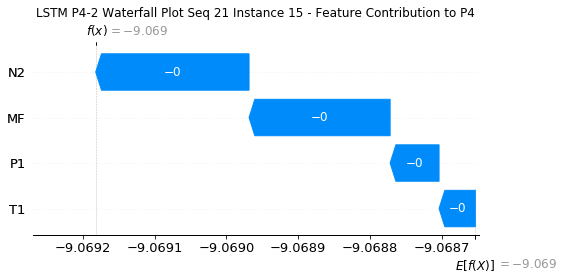

None

Contribution: [-6.96961772e-05 -5.21094738e-05 -2.19816811e-04 -2.00926098e-04]


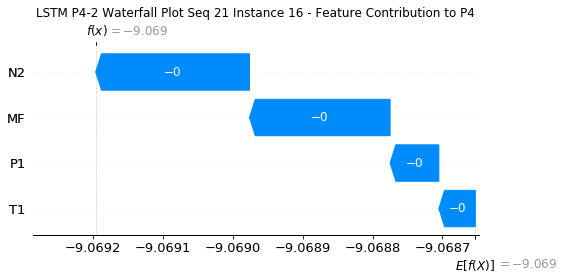

None

Contribution: [-7.28534924e-05 -5.39332118e-05 -2.30482724e-04 -2.10153861e-04]


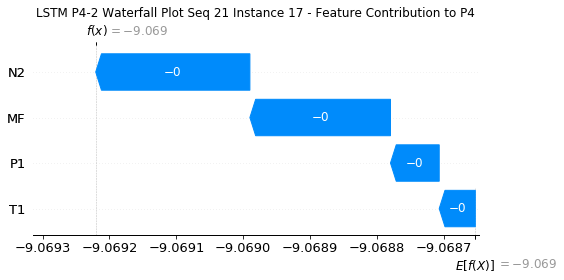

None

Contribution: [-7.87267945e-05 -5.89259063e-05 -2.47434941e-04 -2.26125358e-04]


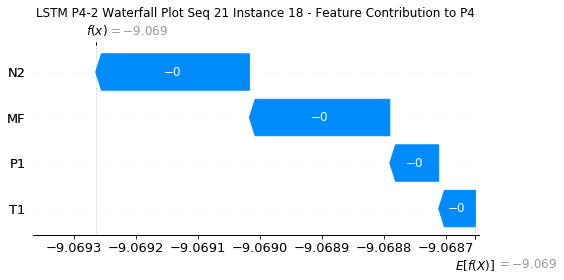

None

Contribution: [-8.70087961e-05 -6.42628548e-05 -2.75618544e-04 -2.50659998e-04]


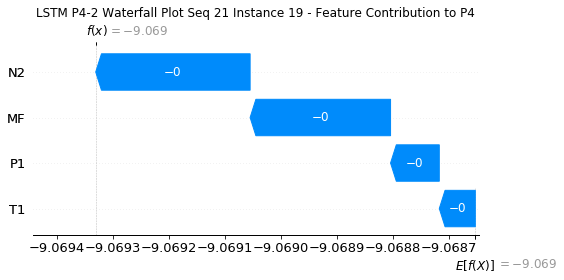

None

Contribution: [-1.05693666e-04 -7.84334781e-05 -3.35045026e-04 -3.04588692e-04]


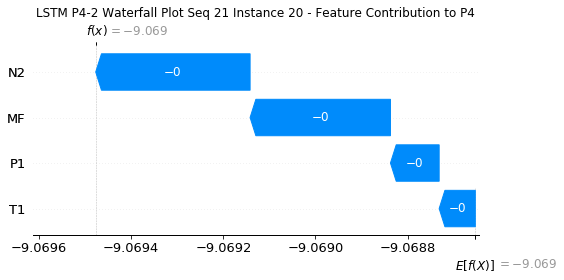

None

Contribution: [-0.00014933 -0.00011205 -0.00047374 -0.00043164]


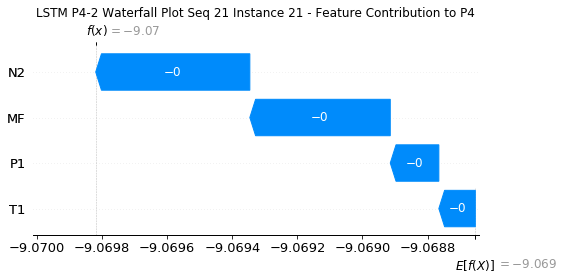

None

Contribution: [-0.00025793 -0.00019282 -0.00081745 -0.0007455 ]


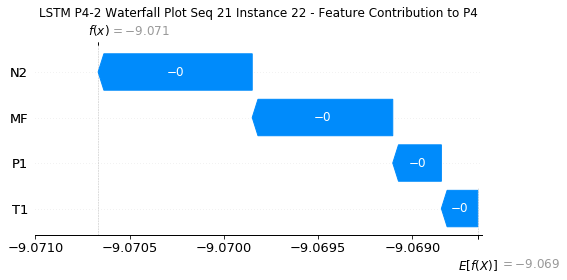

None

Contribution: [-0.00050958 -0.00033042 -0.00161261 -0.00148293]


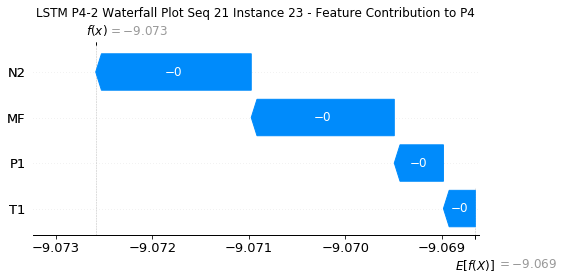

None

Contribution: [-1.15768161e-03 -6.82156712e-05 -3.47730019e-03 -3.43497474e-03]


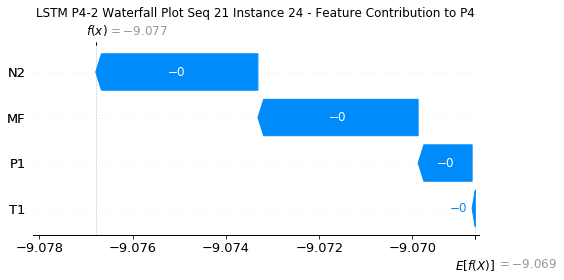

None

Contribution: [-0.0165467  -0.00362769 -0.0548352  -0.05347859]


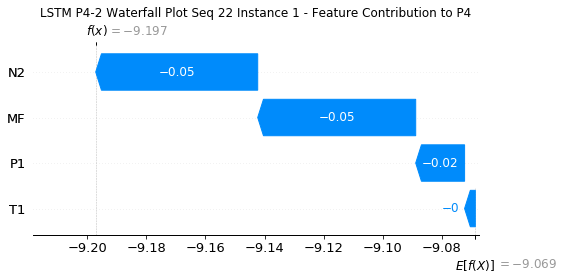

None

Contribution: [ 7.48342823e-05 -2.00369226e-04  1.86692198e-05  3.17971406e-04]


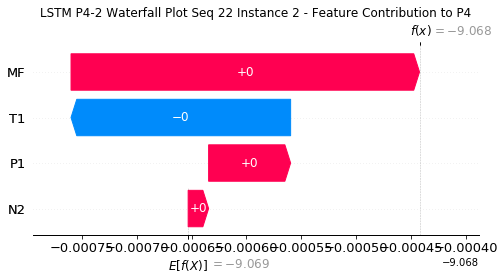

None

Contribution: [-0.00018545 -0.00011067 -0.00056675 -0.0005354 ]


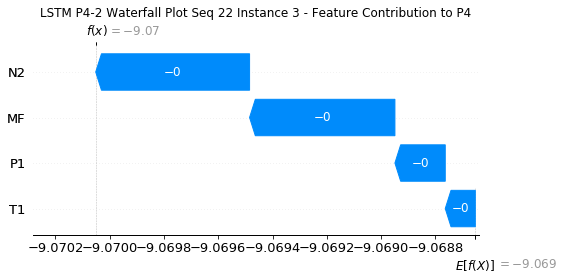

None

Contribution: [-0.00013411 -0.00010074 -0.00042087 -0.00039495]


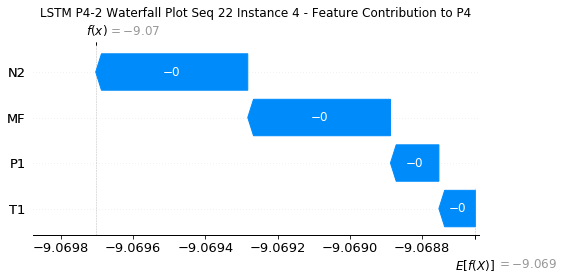

None

Contribution: [-7.87238684e-05 -5.99281511e-05 -2.48068394e-04 -2.31983695e-04]


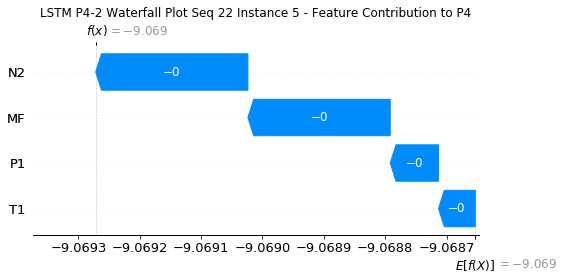

None

Contribution: [-6.50544382e-05 -5.03325060e-05 -2.02212851e-04 -1.86522673e-04]


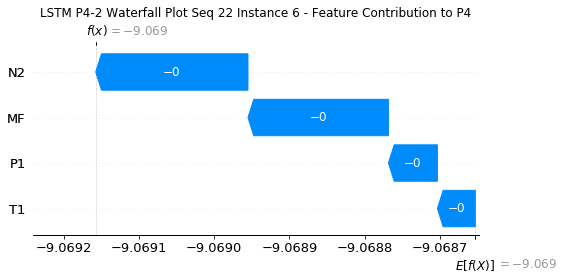

None

Contribution: [-6.14013920e-05 -4.71915864e-05 -1.92570404e-04 -1.78729003e-04]


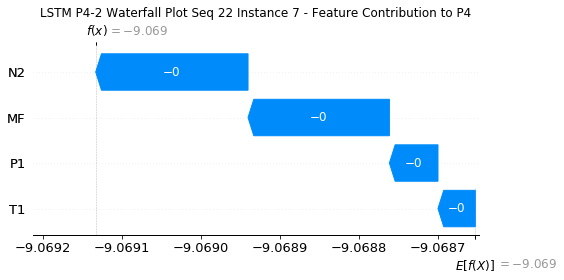

None

Contribution: [-6.09574204e-05 -4.94721006e-05 -1.90068807e-04 -1.77355754e-04]


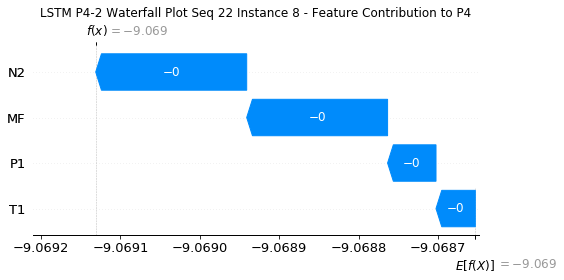

None

Contribution: [-6.13304050e-05 -4.81896034e-05 -1.90575234e-04 -1.77584793e-04]


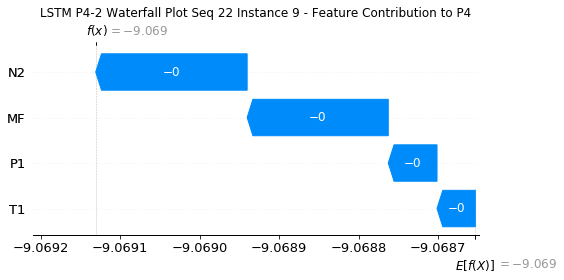

None

Contribution: [-6.11201458e-05 -4.88172015e-05 -1.93369828e-04 -1.79724603e-04]


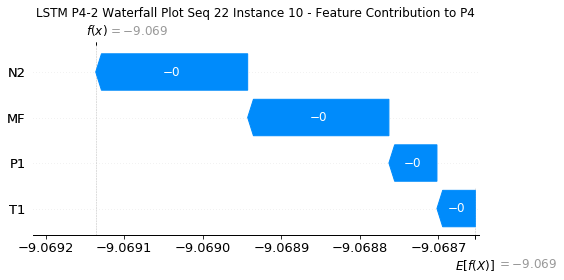

None

Contribution: [-6.23887404e-05 -4.85932987e-05 -1.97710942e-04 -1.82381257e-04]


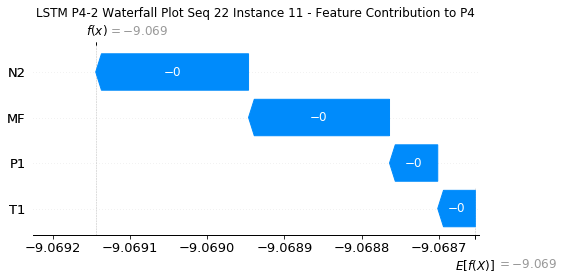

None

Contribution: [-6.39469472e-05 -5.00069047e-05 -2.02250644e-04 -1.86610803e-04]


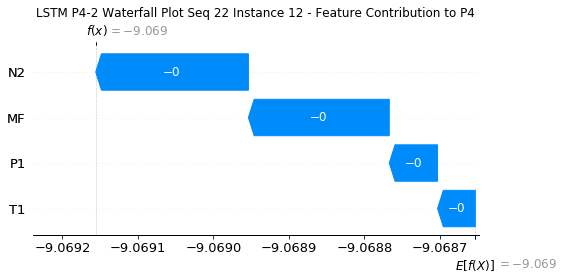

None

Contribution: [-6.64115509e-05 -5.09327740e-05 -2.07042828e-04 -1.94733493e-04]


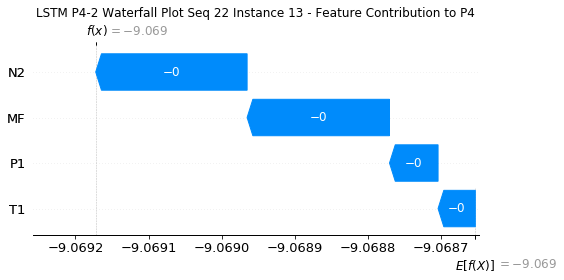

None

Contribution: [-6.58494675e-05 -5.15881569e-05 -2.09063606e-04 -1.92377699e-04]


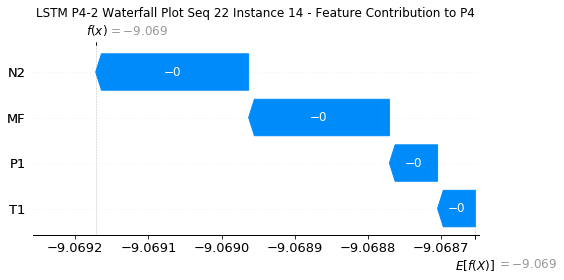

None

Contribution: [-6.69216509e-05 -5.24711534e-05 -2.12997075e-04 -1.94572805e-04]


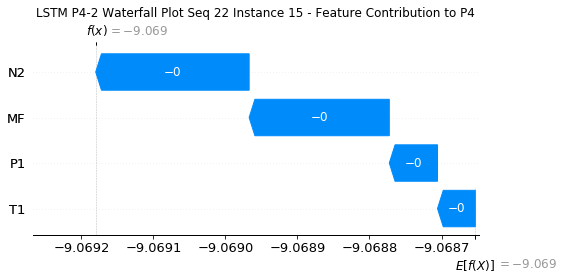

None

Contribution: [-6.94822643e-05 -5.48567788e-05 -2.19896577e-04 -2.02133727e-04]


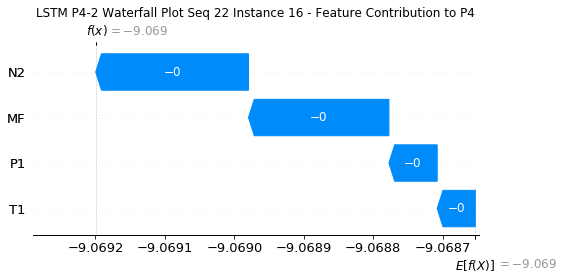

None

Contribution: [-7.28251552e-05 -5.72114417e-05 -2.30604598e-04 -2.12168047e-04]


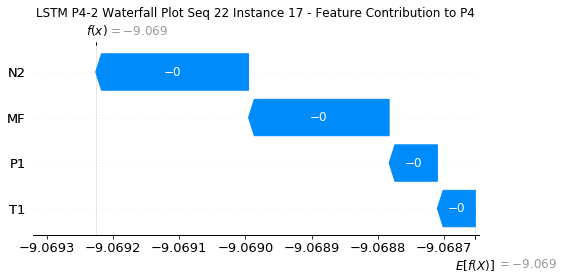

None

Contribution: [-7.95443793e-05 -6.19352798e-05 -2.47274111e-04 -2.26943152e-04]


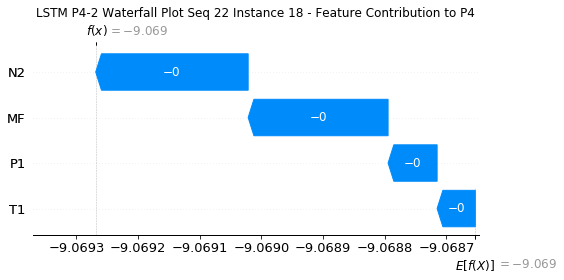

None

Contribution: [-8.76062870e-05 -6.89475745e-05 -2.76060045e-04 -2.53201526e-04]


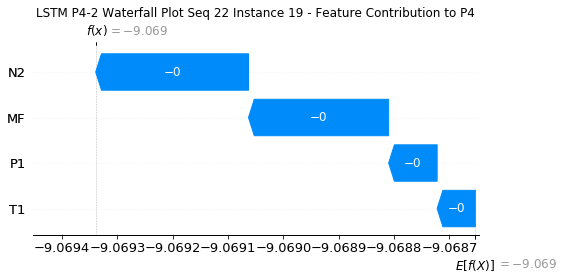

None

Contribution: [-1.06371037e-04 -8.42800471e-05 -3.35451758e-04 -3.07909602e-04]


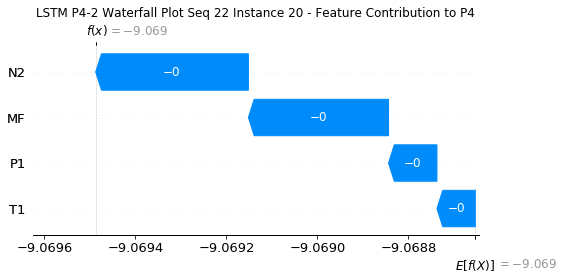

None

Contribution: [-0.00014994 -0.00012014 -0.00047431 -0.0004352 ]


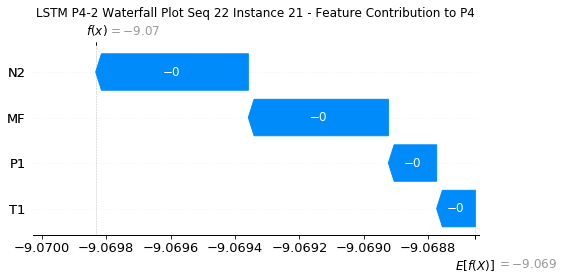

None

Contribution: [-0.0002589  -0.00020973 -0.00081824 -0.00075382]


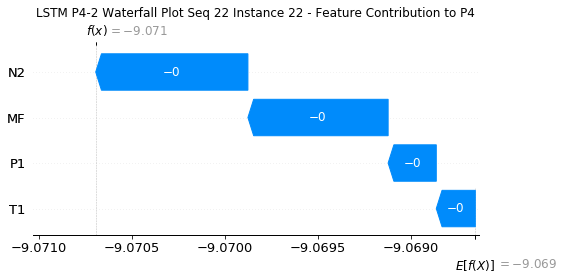

None

Contribution: [-0.00050394 -0.00037066 -0.0016125  -0.00149504]


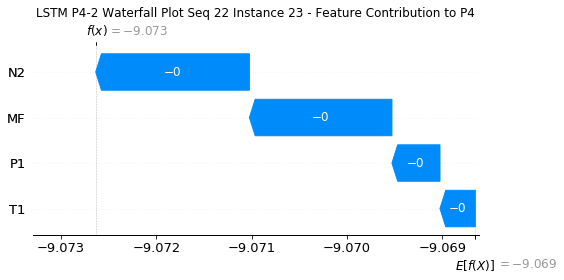

None

Contribution: [-9.76625527e-04 -8.09214908e-05 -3.43632658e-03 -3.28070715e-03]


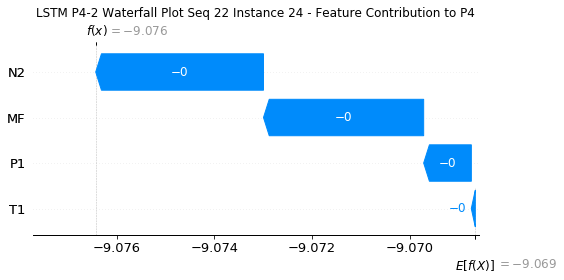

None

Contribution: [-0.01673307 -0.00613858 -0.05473145 -0.05384806]


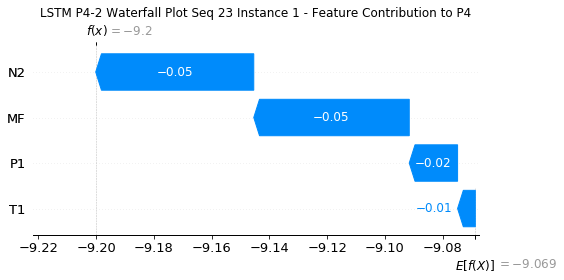

None

Contribution: [ 7.96302168e-05 -1.73274720e-04  3.60254538e-05  3.22078296e-04]


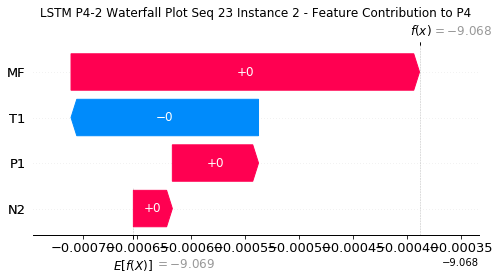

None

Contribution: [-0.00018554 -0.00012831 -0.00056484 -0.00052938]


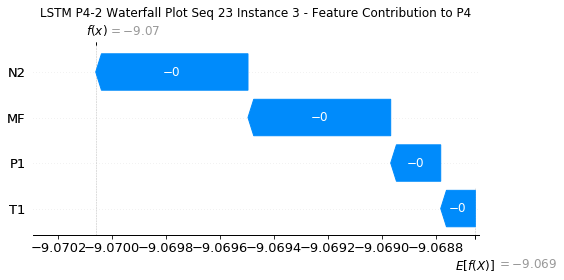

None

Contribution: [-0.00013449 -0.00010471 -0.0004221  -0.00039221]


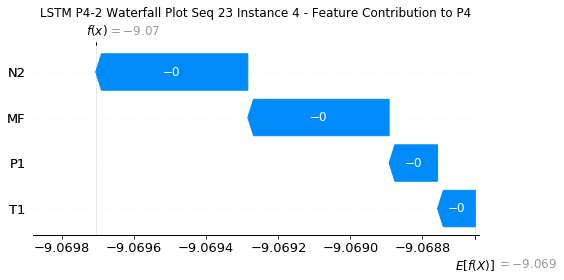

None

Contribution: [-7.91250529e-05 -6.20613689e-05 -2.49317032e-04 -2.31107085e-04]


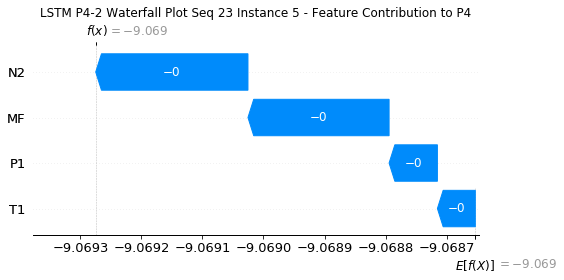

None

Contribution: [-6.59816154e-05 -5.11556408e-05 -2.03481248e-04 -1.88196458e-04]


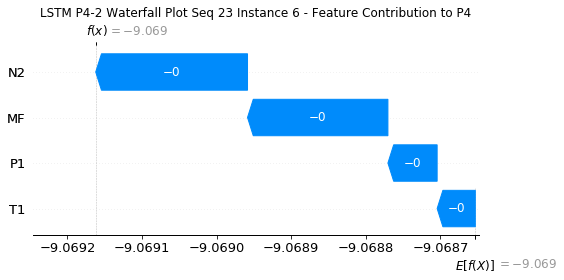

None

Contribution: [-6.17202405e-05 -4.82637790e-05 -1.93306367e-04 -1.77796079e-04]


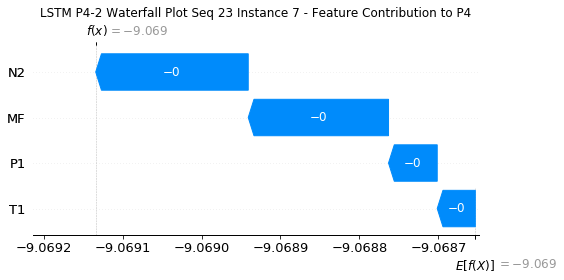

None

Contribution: [-6.13190122e-05 -4.71544601e-05 -1.90055663e-04 -1.75286776e-04]


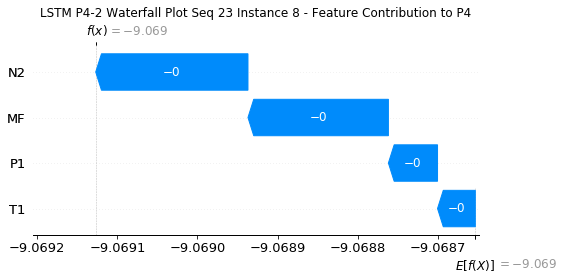

None

Contribution: [-6.10904377e-05 -4.89478235e-05 -1.90607417e-04 -1.74138271e-04]


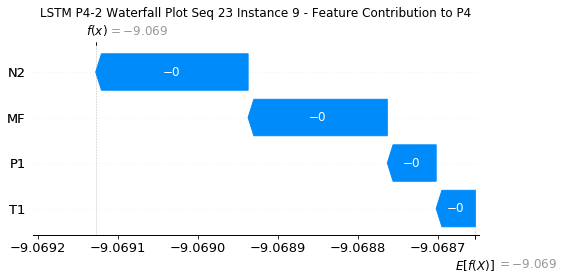

None

Contribution: [-6.18867872e-05 -4.87710071e-05 -1.93931360e-04 -1.79263467e-04]


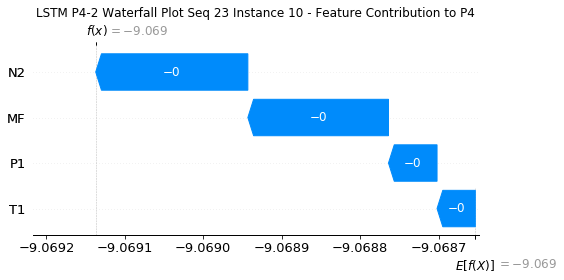

None

Contribution: [-6.29390799e-05 -4.94943970e-05 -1.98223346e-04 -1.81624750e-04]


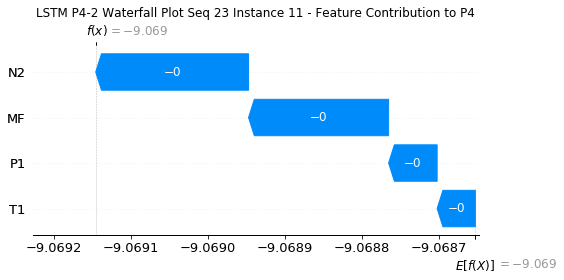

None

Contribution: [-6.43138752e-05 -5.03558680e-05 -2.02456040e-04 -1.85174587e-04]


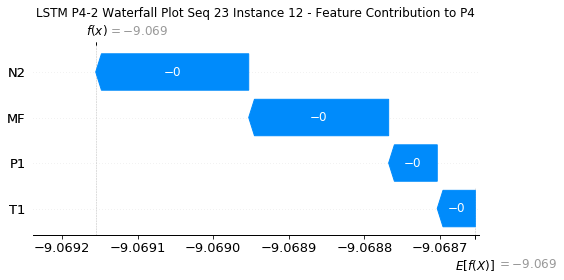

None

Contribution: [-6.58229437e-05 -5.14156475e-05 -2.06006149e-04 -1.88374398e-04]


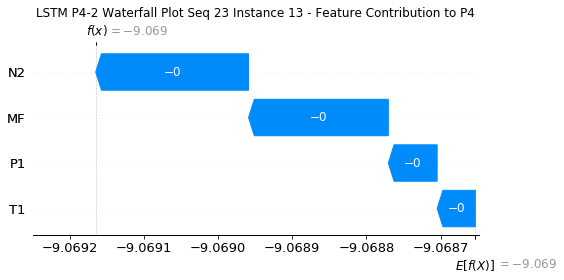

None

Contribution: [-6.63054839e-05 -5.18637791e-05 -2.09131912e-04 -1.90890684e-04]


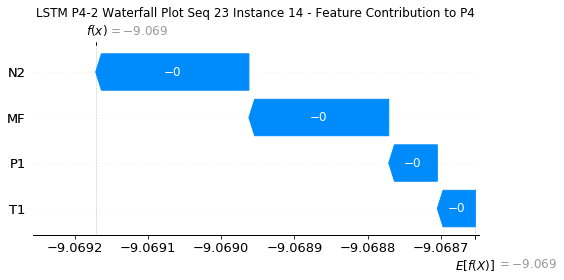

None

Contribution: [-6.75734174e-05 -5.17163742e-05 -2.12342972e-04 -1.91171137e-04]


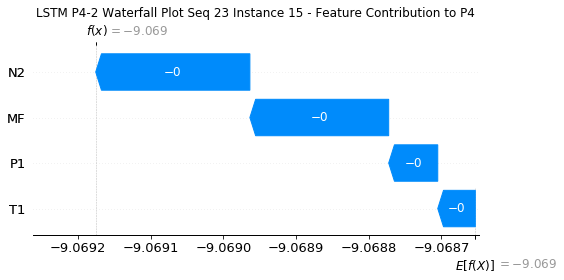

None

Contribution: [-6.96777414e-05 -5.42092378e-05 -2.19605999e-04 -1.99965156e-04]


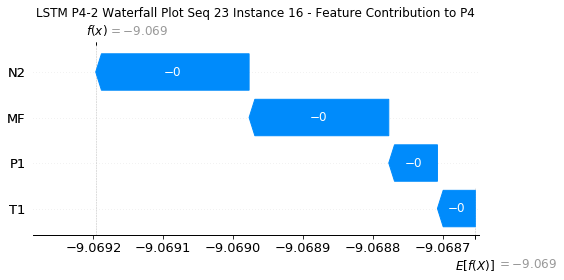

None

Contribution: [-7.28630763e-05 -5.65645592e-05 -2.30124685e-04 -2.09510822e-04]


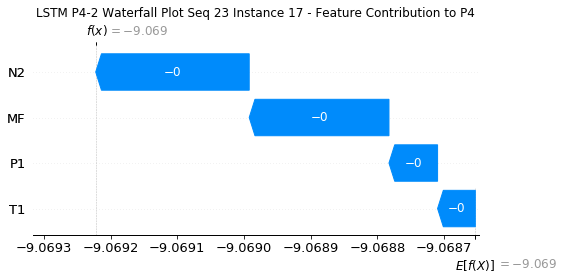

None

Contribution: [-7.77929904e-05 -6.00312941e-05 -2.46302735e-04 -2.22561587e-04]


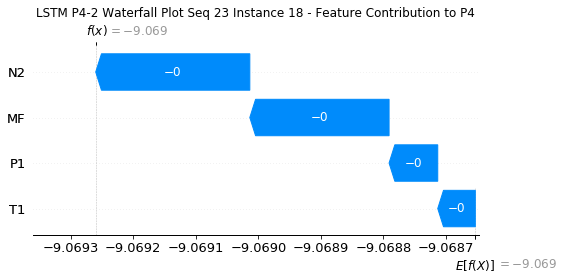

None

Contribution: [-8.76334252e-05 -6.73641839e-05 -2.75273528e-04 -2.49598952e-04]


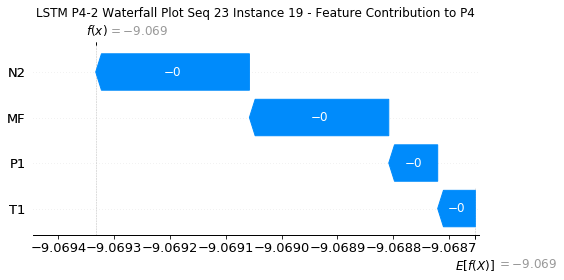

None

Contribution: [-1.06569283e-04 -8.27164417e-05 -3.34478142e-04 -3.03617259e-04]


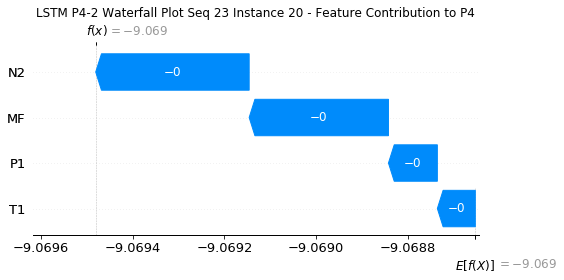

None

Contribution: [-0.00015084 -0.00011876 -0.00047297 -0.00042972]


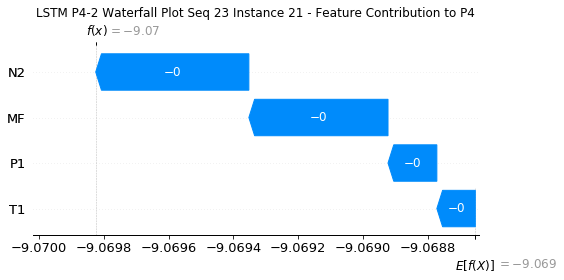

None

Contribution: [-0.00026041 -0.00020816 -0.00081576 -0.00074437]


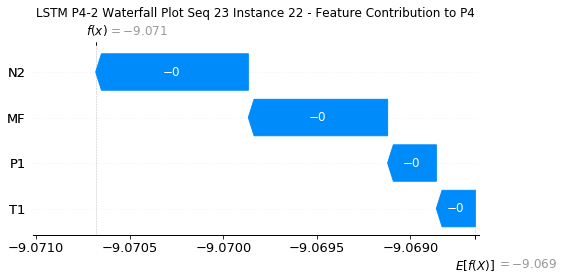

None

Contribution: [-0.0005188  -0.00037647 -0.00161051 -0.00148357]


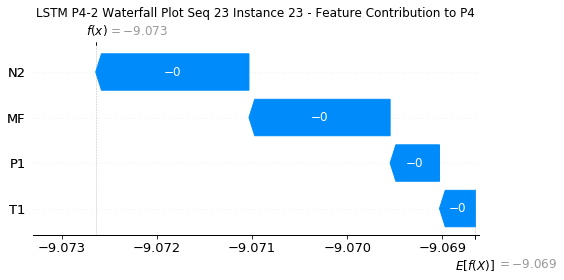

None

Contribution: [-0.00118918 -0.00019024 -0.00346985 -0.00339952]


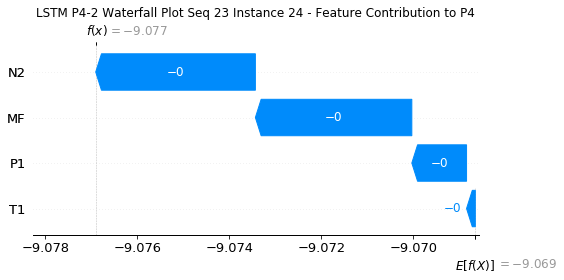

None

Contribution: [-0.01706994 -0.00569827 -0.05488765 -0.05199524]


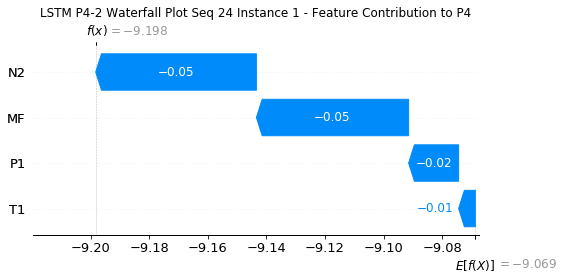

None

Contribution: [ 8.38869447e-05 -1.77773009e-04  3.15264570e-05  3.01391561e-04]


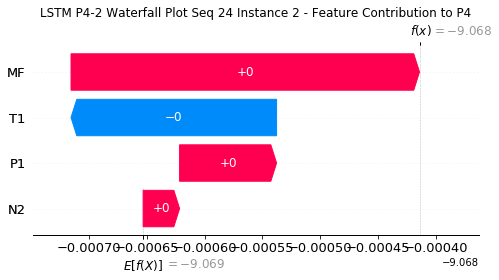

None

Contribution: [-0.00018423 -0.00012474 -0.00056725 -0.00052497]


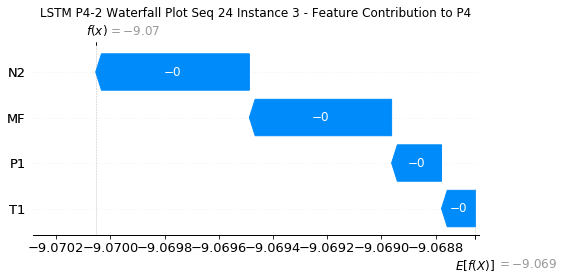

None

Contribution: [-1.35122264e-04 -9.96397337e-05 -4.22779686e-04 -3.93293862e-04]


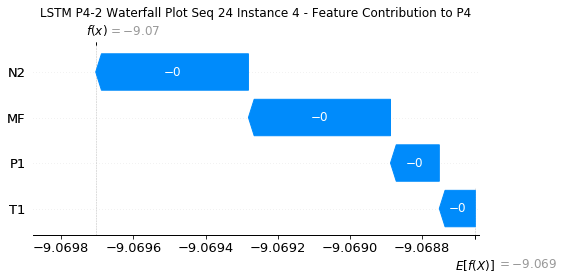

None

Contribution: [-7.92763495e-05 -5.98130744e-05 -2.49193443e-04 -2.30929332e-04]


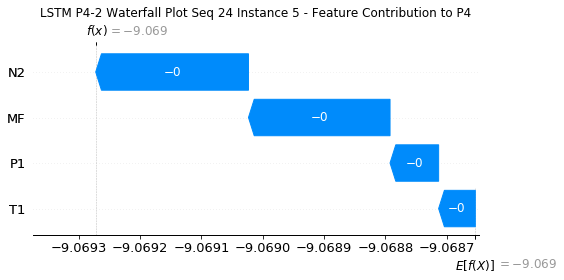

None

Contribution: [-6.54008614e-05 -4.86981293e-05 -2.03149810e-04 -1.88460146e-04]


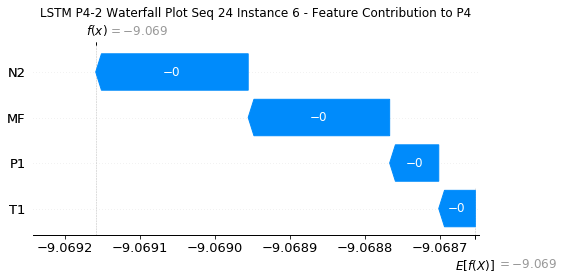

None

Contribution: [-6.17296639e-05 -4.67775046e-05 -1.93157204e-04 -1.77529494e-04]


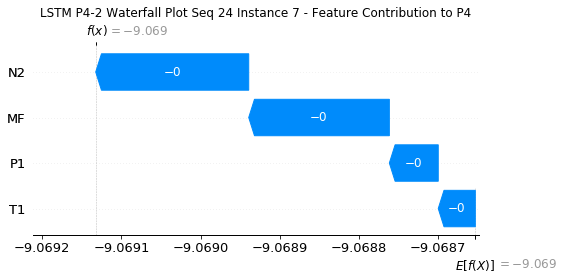

None

Contribution: [-6.07926941e-05 -4.49291884e-05 -1.89752751e-04 -1.74555807e-04]


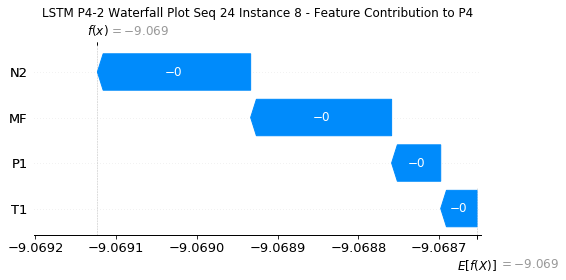

None

Contribution: [-6.04632846e-05 -4.55996284e-05 -1.90221693e-04 -1.74455415e-04]


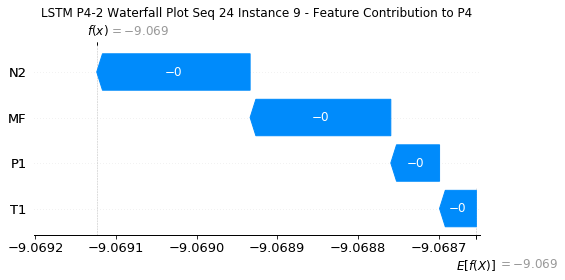

None

Contribution: [-6.17380193e-05 -4.61912257e-05 -1.93272860e-04 -1.76788452e-04]


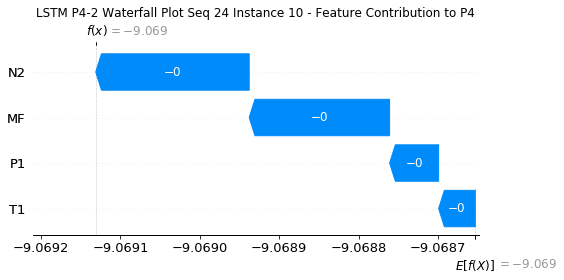

None

Contribution: [-6.32323312e-05 -4.93451997e-05 -1.98338216e-04 -1.81884791e-04]


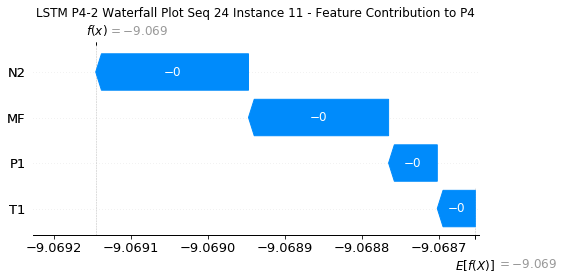

None

Contribution: [-6.45691581e-05 -5.05346709e-05 -2.02674585e-04 -1.85890453e-04]


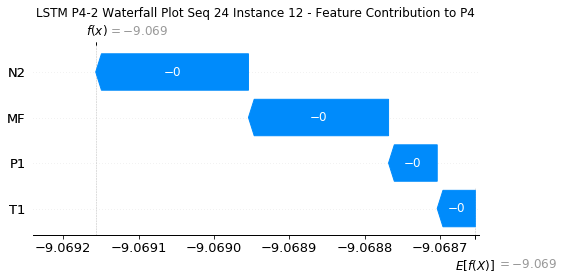

None

Contribution: [-6.57097229e-05 -5.24189286e-05 -2.06080374e-04 -1.89103173e-04]


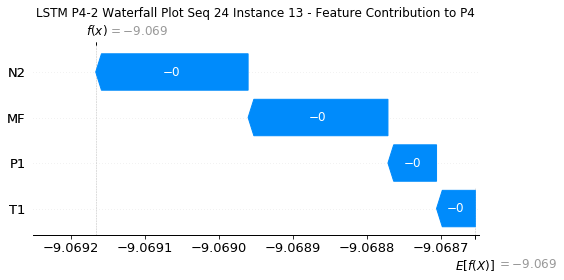

None

Contribution: [-6.68238323e-05 -5.27500885e-05 -2.09577300e-04 -1.92148916e-04]


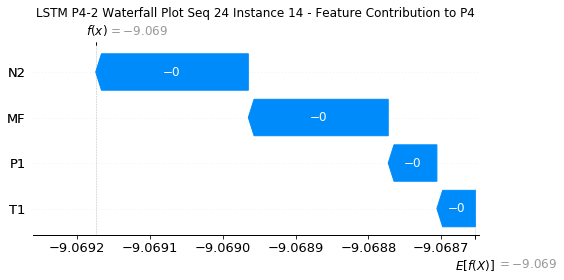

None

Contribution: [-6.77627965e-05 -5.45466317e-05 -2.14086105e-04 -1.95278182e-04]


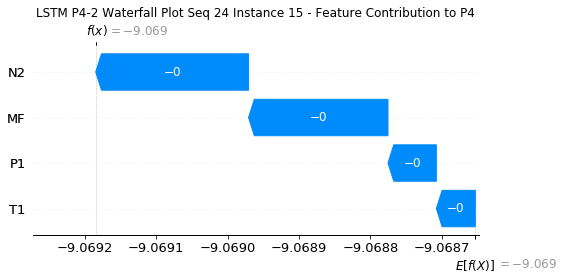

None

Contribution: [-7.00999189e-05 -5.61043497e-05 -2.20096358e-04 -2.01632872e-04]


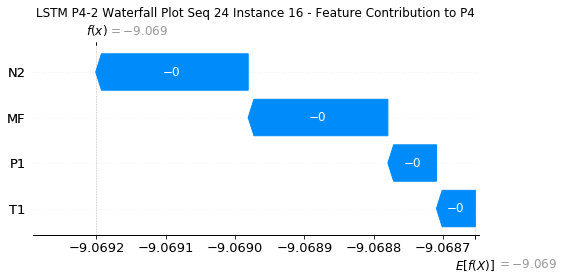

None

Contribution: [-7.31276473e-05 -5.89548133e-05 -2.30474741e-04 -2.10658043e-04]


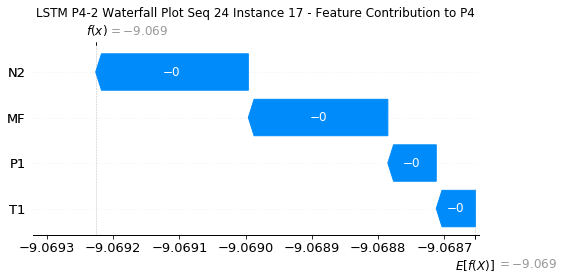

None

Contribution: [-7.90338238e-05 -6.49469738e-05 -2.46942185e-04 -2.26196582e-04]


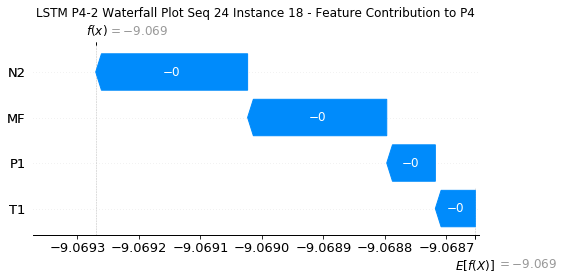

None

Contribution: [-8.80825722e-05 -7.10560126e-05 -2.75818494e-04 -2.52178759e-04]


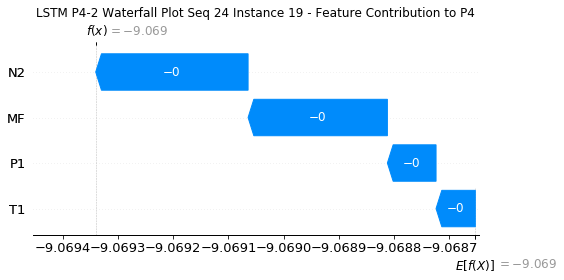

None

Contribution: [-1.06943217e-04 -8.73589889e-05 -3.34867906e-04 -3.05899136e-04]


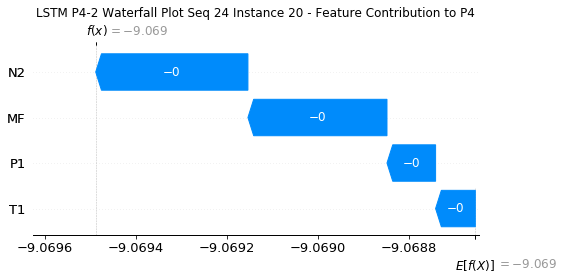

None

Contribution: [-0.00015191 -0.00012558 -0.00047353 -0.00043352]


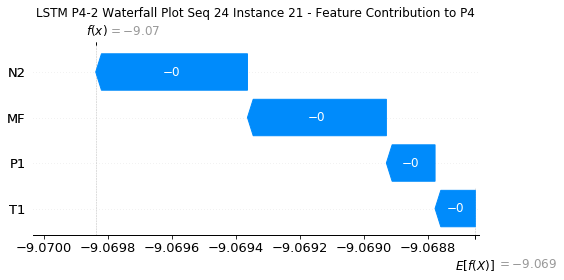

None

Contribution: [-0.00026209 -0.00022168 -0.00081616 -0.00074863]


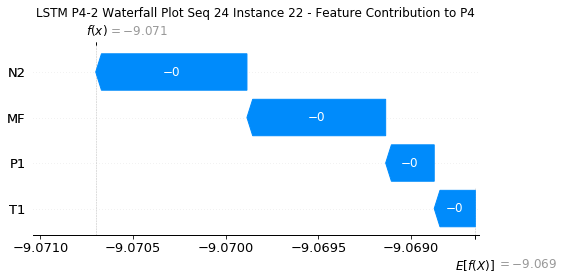

None

Contribution: [-0.00052338 -0.00041042 -0.00161201 -0.00150321]


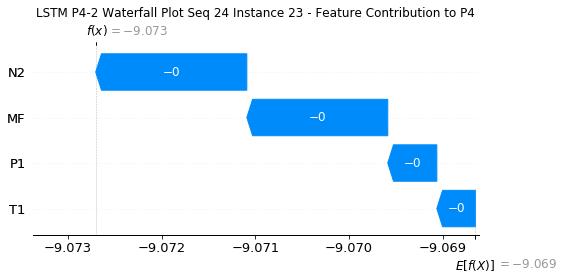

None

Contribution: [-0.00104006 -0.00024051 -0.00344329 -0.00325874]


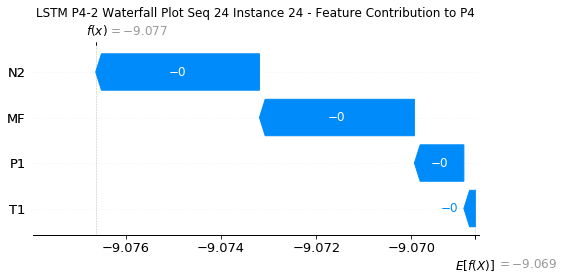

None

Contribution: [-0.01558503 -0.00803496 -0.05447232 -0.0489119 ]


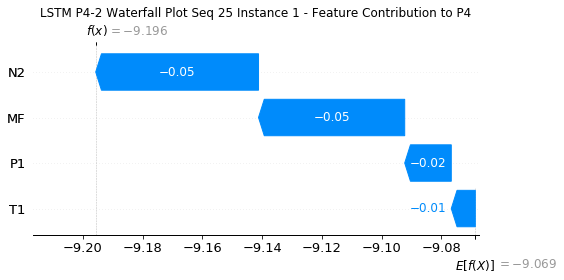

None

Contribution: [ 8.05696100e-05 -1.54167923e-04  3.82094078e-05  2.98509902e-04]


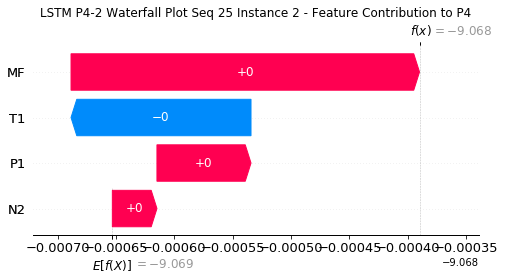

None

Contribution: [-0.00018396 -0.00013931 -0.00057092 -0.00052837]


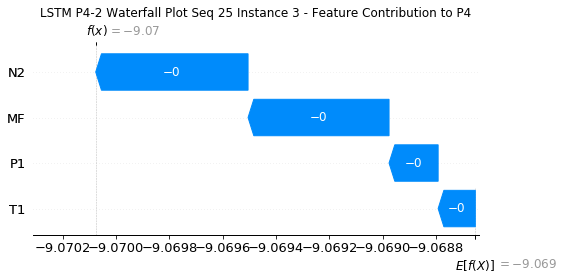

None

Contribution: [-0.00013604 -0.00010733 -0.00042464 -0.00039775]


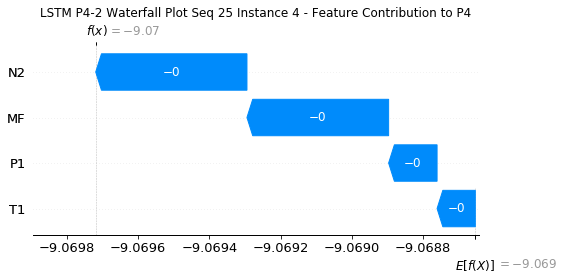

None

Contribution: [-7.94548386e-05 -6.32001811e-05 -2.49516284e-04 -2.32248637e-04]


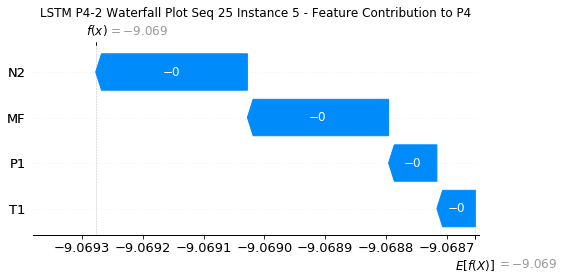

None

Contribution: [-6.28947046e-05 -4.99117491e-05 -2.01910018e-04 -1.83627354e-04]


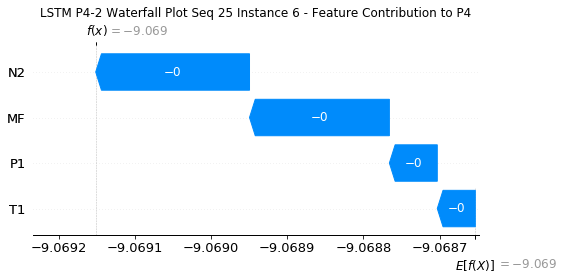

None

Contribution: [-6.17871837e-05 -4.93273745e-05 -1.93380115e-04 -1.78330810e-04]


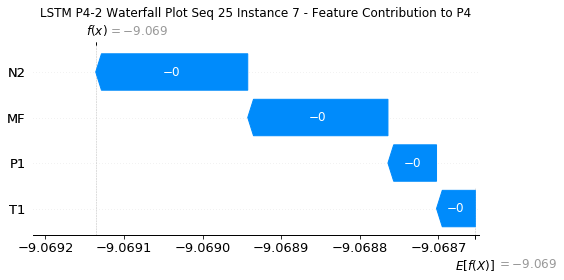

None

Contribution: [-6.04233291e-05 -4.80456316e-05 -1.89704876e-04 -1.73854920e-04]


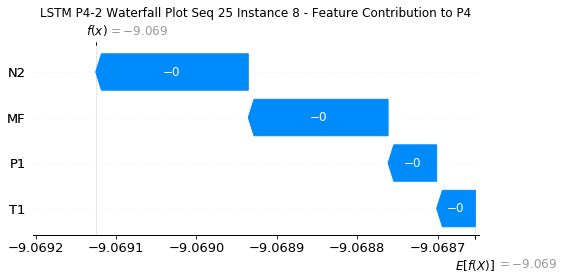

None

Contribution: [-6.04519480e-05 -4.84946084e-05 -1.90387928e-04 -1.74755892e-04]


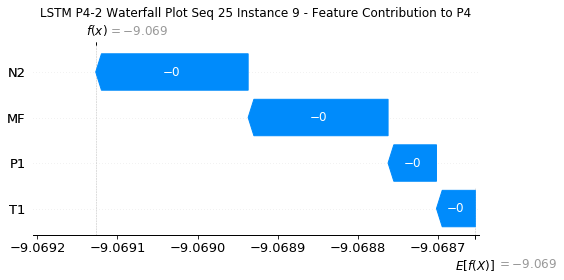

None

Contribution: [-6.18158854e-05 -4.92509999e-05 -1.93375051e-04 -1.76634889e-04]


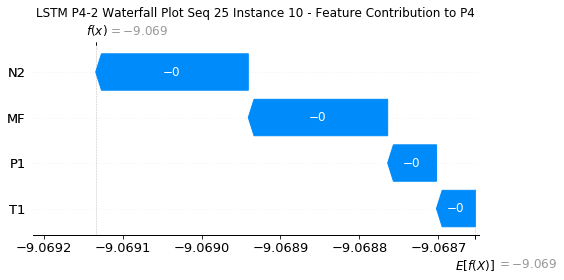

None

Contribution: [-6.23969281e-05 -5.00686086e-05 -1.97877603e-04 -1.80627977e-04]


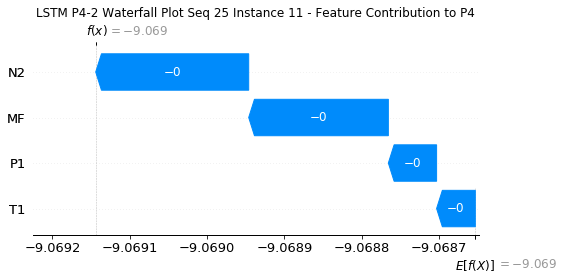

None

Contribution: [-6.37091489e-05 -5.13532426e-05 -2.02237702e-04 -1.84733781e-04]


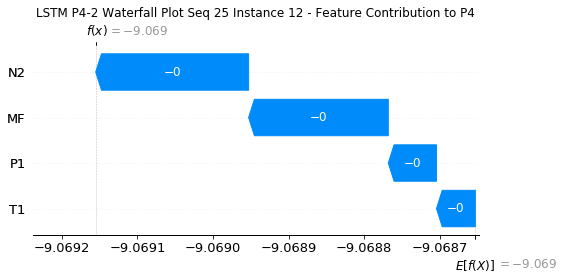

None

Contribution: [-6.39639350e-05 -5.18958055e-05 -2.05494612e-04 -1.86631401e-04]


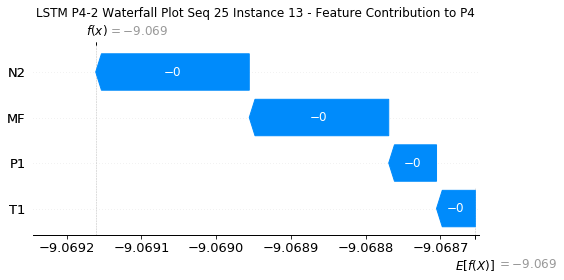

None

Contribution: [-6.57366232e-05 -5.33832304e-05 -2.09102420e-04 -1.90604529e-04]


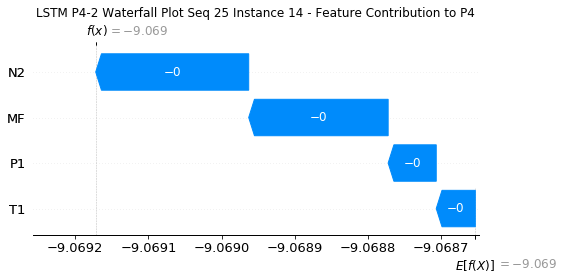

None

Contribution: [-6.83789652e-05 -5.49142002e-05 -2.13686232e-04 -1.95701046e-04]


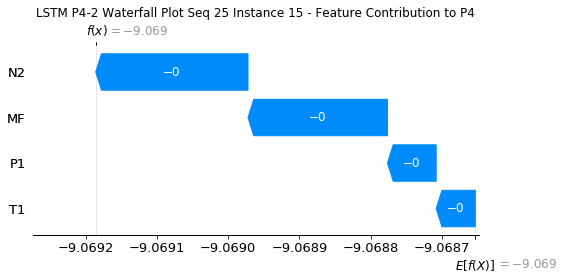

None

Contribution: [-6.88690932e-05 -5.65945133e-05 -2.19606282e-04 -1.99791084e-04]


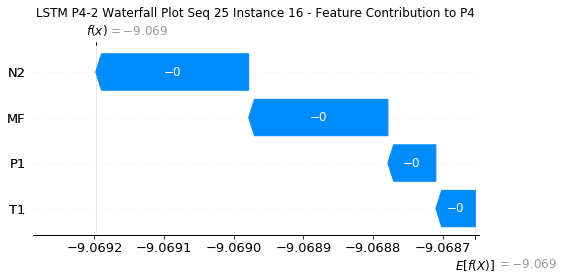

None

Contribution: [-7.24107382e-05 -5.97756306e-05 -2.30414425e-04 -2.09977645e-04]


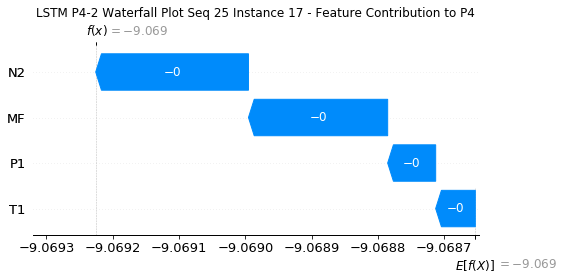

None

Contribution: [-7.90395212e-05 -6.67712180e-05 -2.47815152e-04 -2.27938068e-04]


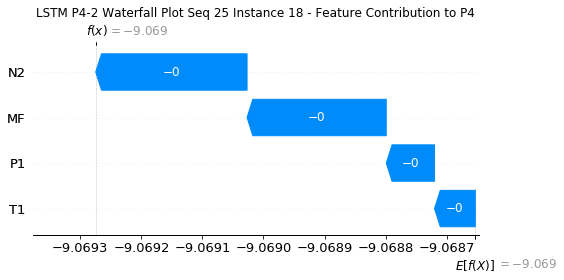

None

Contribution: [-8.75195404e-05 -7.33128589e-05 -2.76230006e-04 -2.52685582e-04]


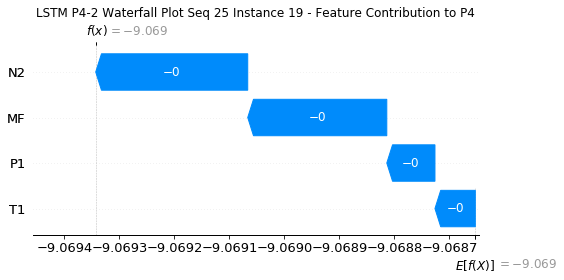

None

Contribution: [-1.06588340e-04 -9.01046093e-05 -3.35537581e-04 -3.07208115e-04]


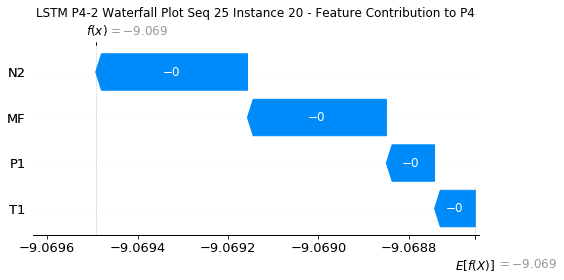

None

Contribution: [-0.0001512  -0.00012972 -0.00047441 -0.00043545]


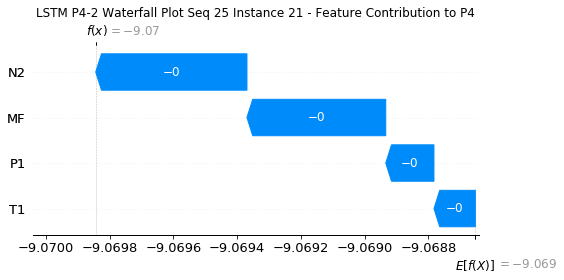

None

Contribution: [-0.00026083 -0.00022688 -0.0008174  -0.0007509 ]


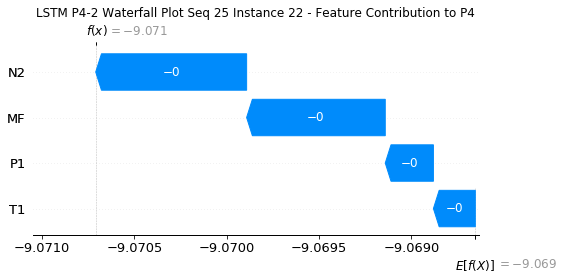

None

Contribution: [-0.00051923 -0.00043667 -0.00161445 -0.00150592]


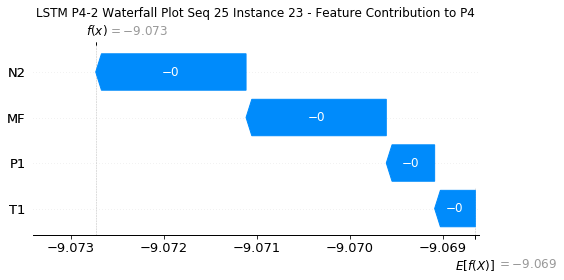

None

Contribution: [-0.0011247  -0.00054076 -0.00348114 -0.00339058]


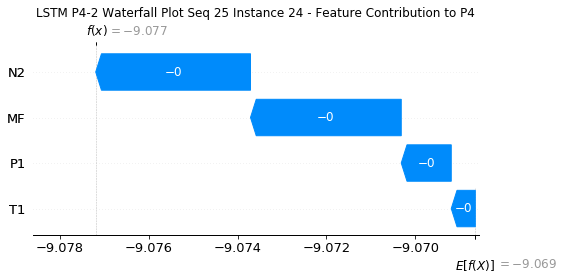

None

Contribution: [-0.0168647  -0.00990953 -0.05440816 -0.05231714]


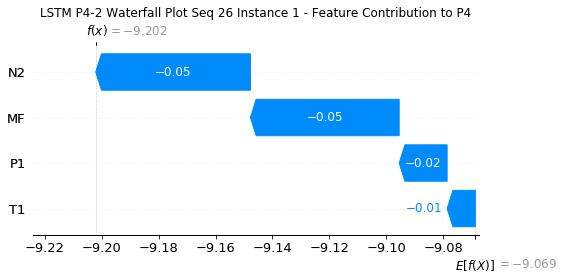

None

Contribution: [ 8.95282005e-05 -1.28259466e-04  5.85635599e-05  3.37533272e-04]


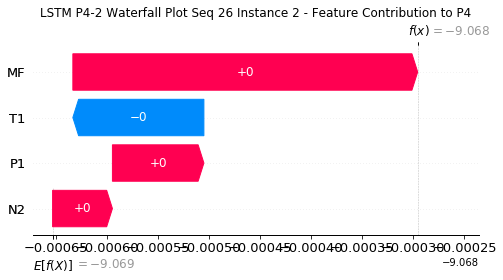

None

Contribution: [-0.00018197 -0.0001482  -0.00055961 -0.00052277]


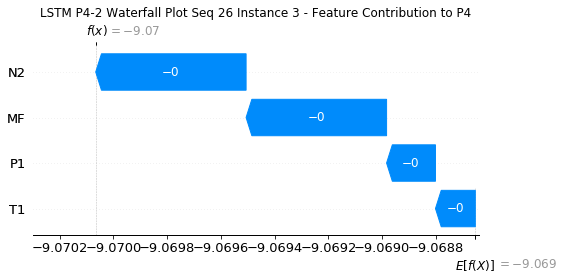

None

Contribution: [-0.00013164 -0.00011045 -0.00041993 -0.0003885 ]


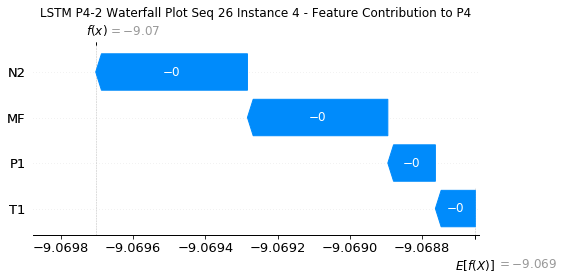

None

Contribution: [-7.80243520e-05 -6.51665396e-05 -2.48657129e-04 -2.29656852e-04]


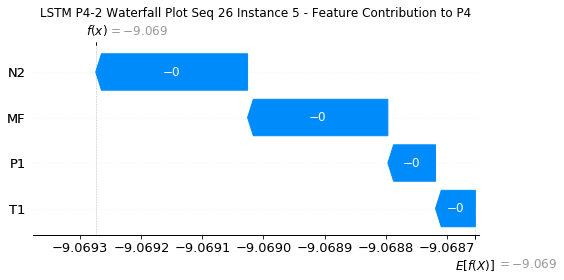

None

Contribution: [-6.46544379e-05 -5.36099539e-05 -2.03027782e-04 -1.87840301e-04]


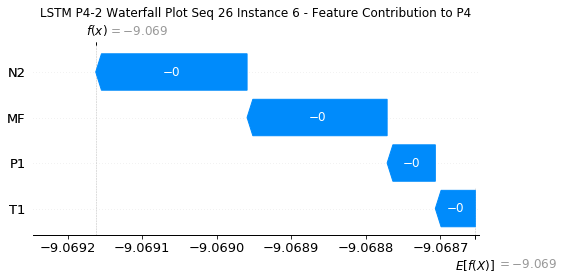

None

Contribution: [-6.09462036e-05 -5.04843115e-05 -1.92778801e-04 -1.76885818e-04]


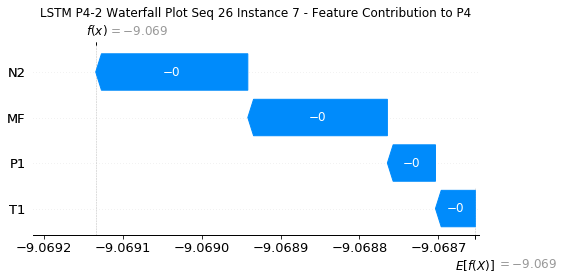

None

Contribution: [-6.04806099e-05 -4.91026919e-05 -1.89715293e-04 -1.74665147e-04]


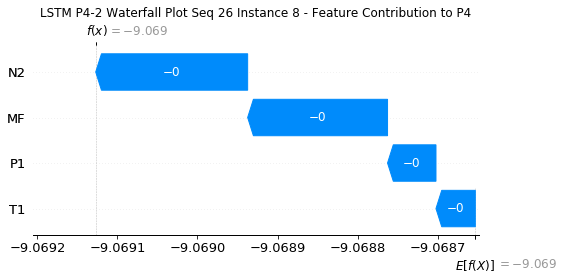

None

Contribution: [-6.22256438e-05 -4.93844417e-05 -1.91132550e-04 -1.78171787e-04]


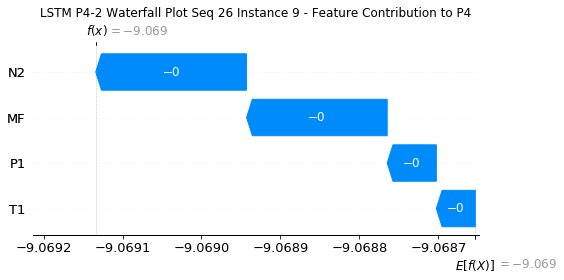

None

Contribution: [-6.20790429e-05 -5.03889786e-05 -1.93456552e-04 -1.78542741e-04]


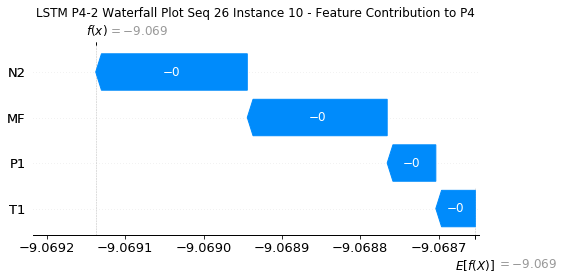

None

Contribution: [-6.22480078e-05 -5.11005966e-05 -1.97552007e-04 -1.81175082e-04]


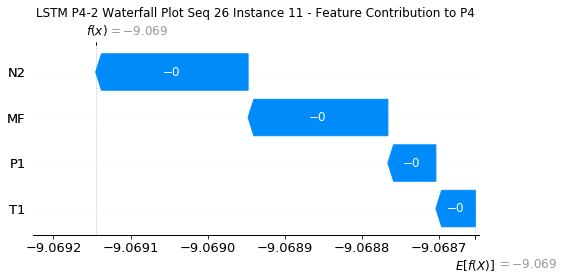

None

Contribution: [-6.34802207e-05 -5.21578321e-05 -2.01836043e-04 -1.84927388e-04]


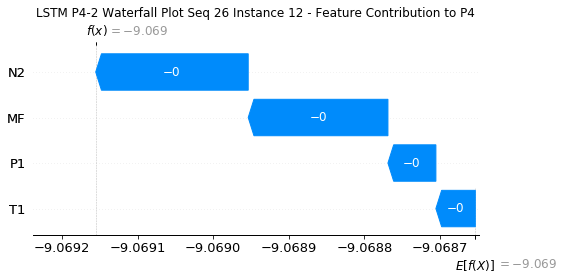

None

Contribution: [-6.56869739e-05 -5.50768326e-05 -2.05936602e-04 -1.90033435e-04]


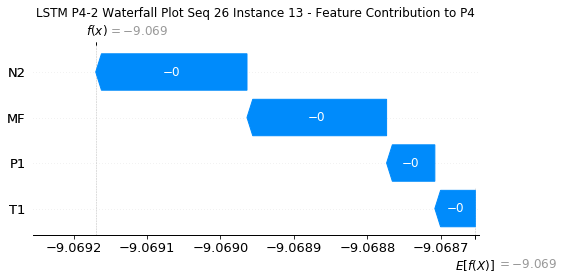

None

Contribution: [-6.57013613e-05 -5.39961345e-05 -2.08628802e-04 -1.91487303e-04]


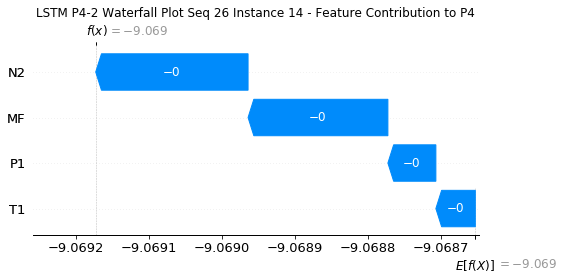

None

Contribution: [-6.73732001e-05 -5.58118909e-05 -2.12592237e-04 -1.94856510e-04]


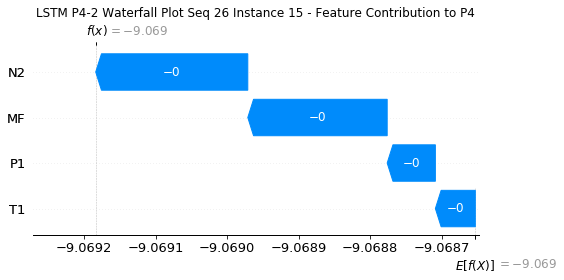

None

Contribution: [-6.90772291e-05 -5.67096198e-05 -2.19053321e-04 -2.00973649e-04]


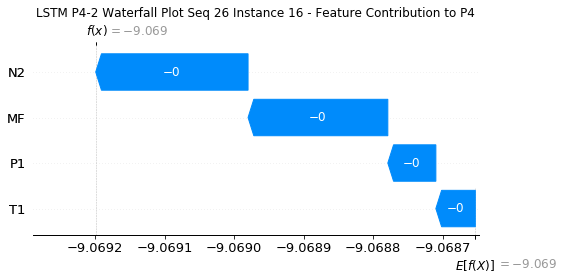

None

Contribution: [-7.24079804e-05 -5.91302075e-05 -2.29429484e-04 -2.10280854e-04]


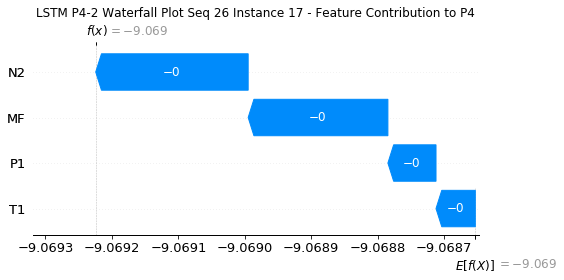

None

Contribution: [-7.78376814e-05 -6.41704280e-05 -2.45748416e-04 -2.23741369e-04]


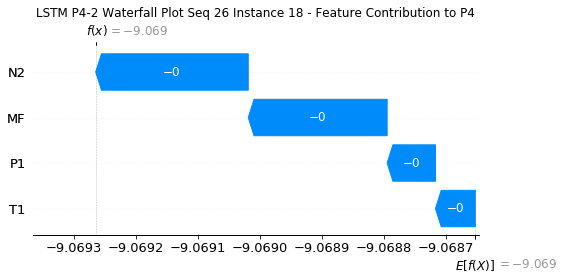

None

Contribution: [-8.69369390e-05 -7.11993183e-05 -2.74483736e-04 -2.51653636e-04]


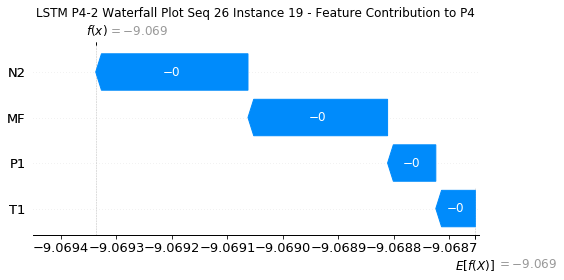

None

Contribution: [-1.05814909e-04 -8.69722748e-05 -3.33257799e-04 -3.05735653e-04]


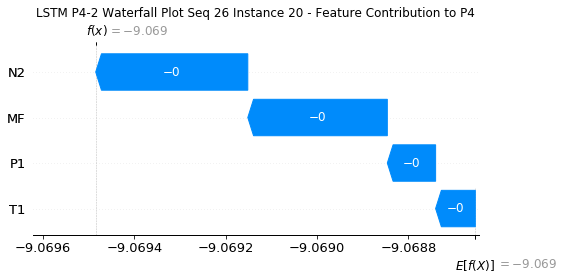

None

Contribution: [-0.00014991 -0.0001247  -0.00047111 -0.00043381]


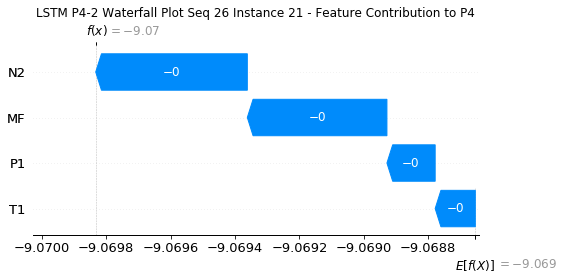

None

Contribution: [-0.00026015 -0.00021804 -0.00081243 -0.00075133]


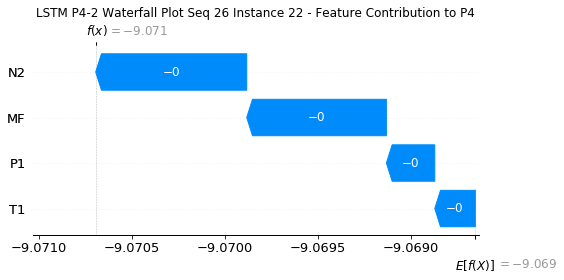

None

Contribution: [-0.0005214  -0.00041844 -0.00160652 -0.00152128]


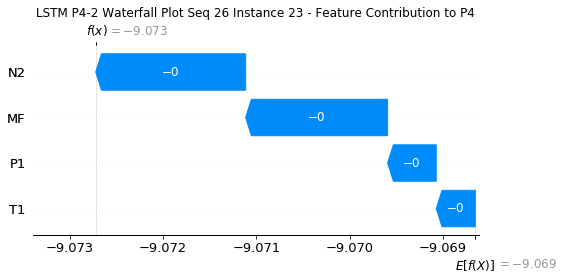

None

Contribution: [-0.00112503 -0.0004456  -0.00346751 -0.00347388]


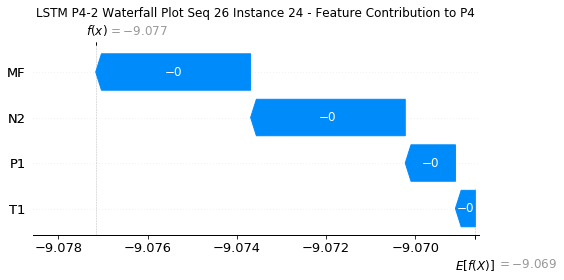

None

Contribution: [-0.01599905 -0.00666553 -0.05463608 -0.05073496]


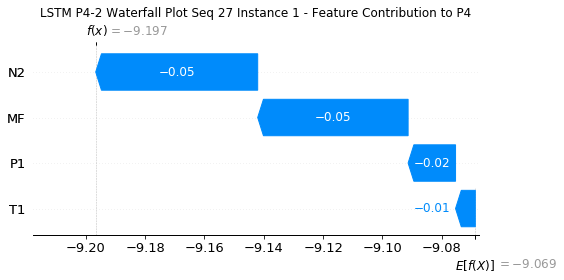

None

Contribution: [ 7.83383188e-05 -1.57259302e-04  4.16709404e-05  3.22486099e-04]


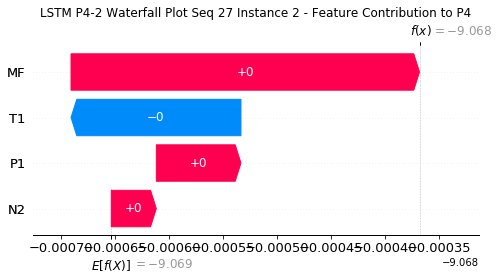

None

Contribution: [-0.00018296 -0.00014495 -0.00057037 -0.0005347 ]


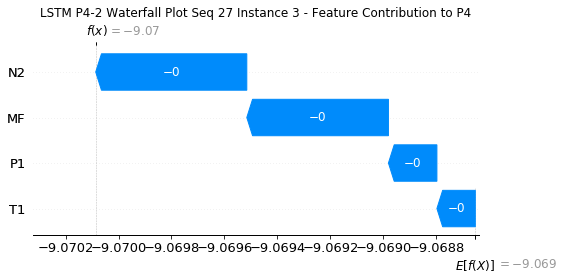

None

Contribution: [-0.00013488 -0.00010931 -0.00042362 -0.00039366]


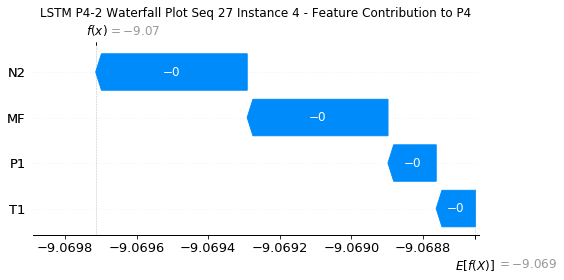

None

Contribution: [-7.90906344e-05 -6.45044121e-05 -2.49397838e-04 -2.31066840e-04]


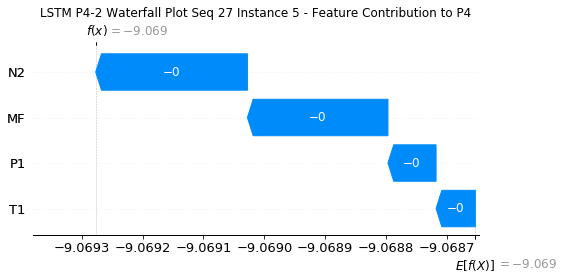

None

Contribution: [-6.44082891e-05 -5.21509938e-05 -2.02895608e-04 -1.86329654e-04]


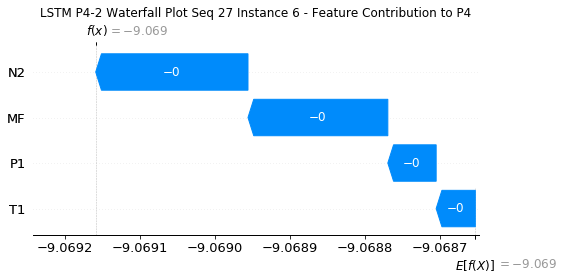

None

Contribution: [-6.13830140e-05 -4.99597943e-05 -1.93201947e-04 -1.77419220e-04]


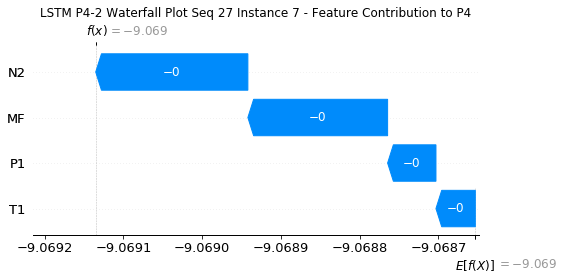

None

Contribution: [-5.99064647e-05 -4.78993137e-05 -1.89346392e-04 -1.73559028e-04]


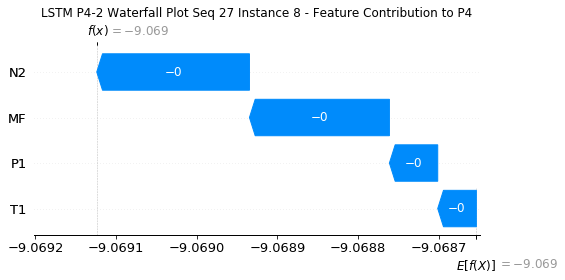

None

Contribution: [-5.89372889e-05 -4.42068804e-05 -1.89070768e-04 -1.71893273e-04]


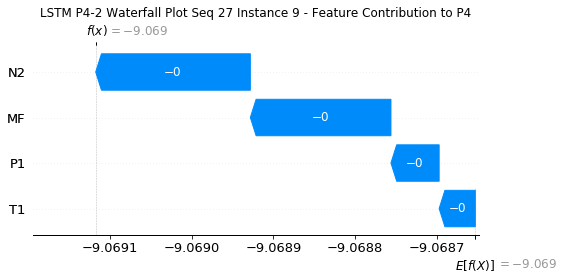

None

Contribution: [-6.03157075e-05 -4.89090460e-05 -1.92873202e-04 -1.75873978e-04]


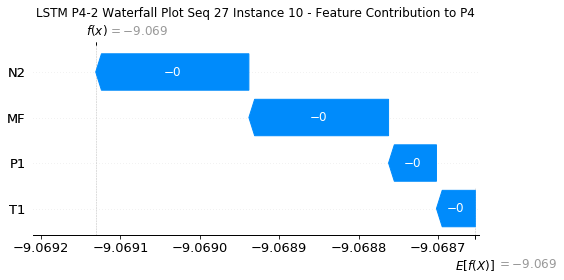

None

Contribution: [-6.28587024e-05 -5.16552211e-05 -1.98191837e-04 -1.81586849e-04]


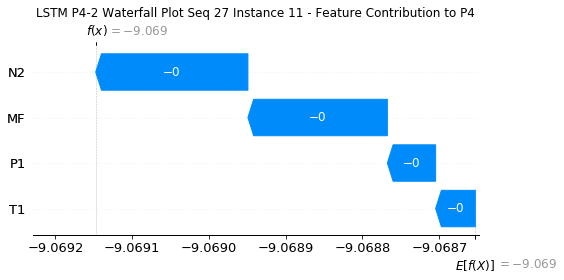

None

Contribution: [-6.42018321e-05 -5.27920629e-05 -2.02481521e-04 -1.85509302e-04]


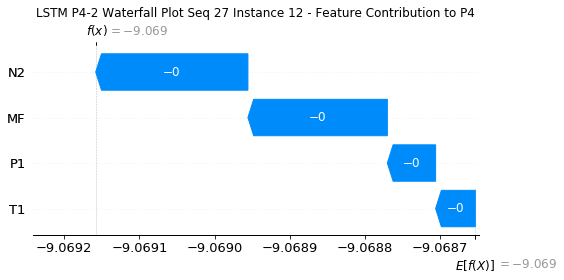

None

Contribution: [-6.46748722e-05 -5.40961535e-05 -2.05475681e-04 -1.86491793e-04]


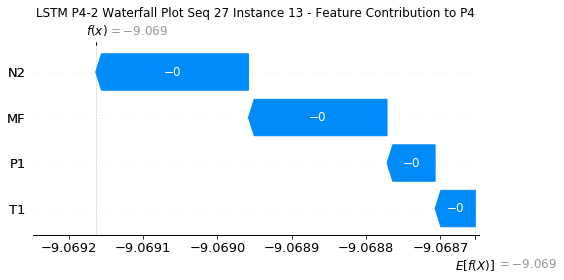

None

Contribution: [-6.59336350e-05 -5.47562458e-05 -2.09157778e-04 -1.91077253e-04]


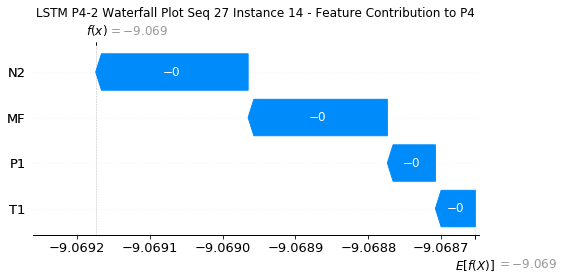

None

Contribution: [-6.73685300e-05 -5.56689903e-05 -2.12862098e-04 -1.93376882e-04]


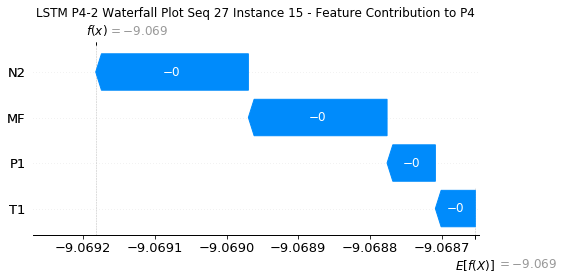

None

Contribution: [-6.91235192e-05 -5.77374755e-05 -2.19650548e-04 -2.00567113e-04]


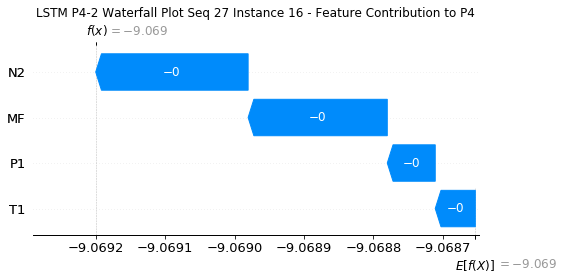

None

Contribution: [-7.22361209e-05 -6.02930621e-05 -2.30242581e-04 -2.10135008e-04]


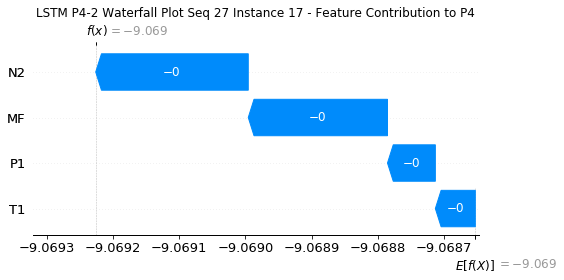

None

Contribution: [-7.87976433e-05 -6.70275306e-05 -2.47903090e-04 -2.29354632e-04]


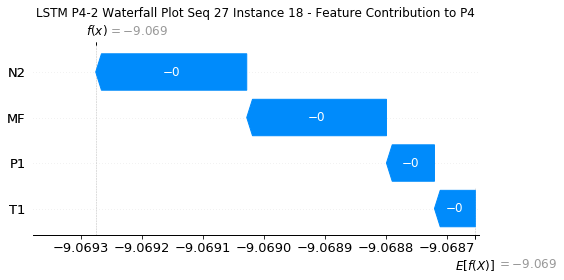

None

Contribution: [-8.62216996e-05 -7.25406173e-05 -2.75409743e-04 -2.50619376e-04]


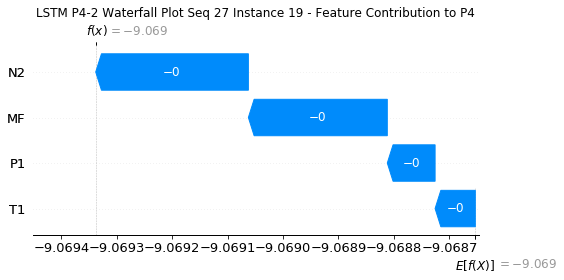

None

Contribution: [-1.04716688e-04 -8.87459793e-05 -3.34503556e-04 -3.04274709e-04]


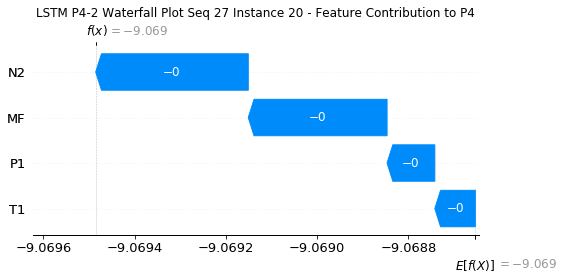

None

Contribution: [-0.00014779 -0.00012743 -0.0004729  -0.00043   ]


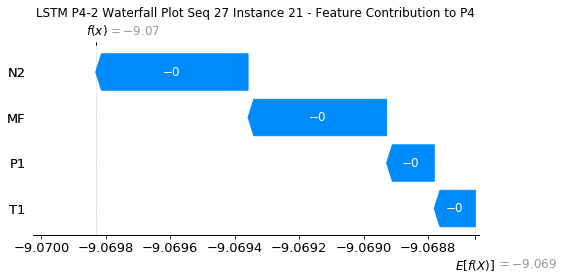

None

Contribution: [-0.00025501 -0.00022332 -0.00081518 -0.00074359]


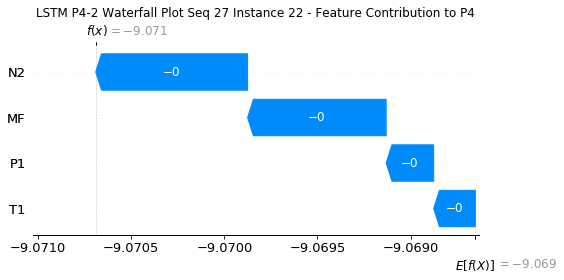

None

Contribution: [-0.00049338 -0.00042174 -0.00160521 -0.00146902]


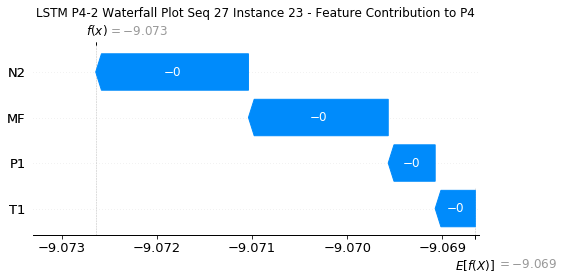

None

Contribution: [-0.00113198 -0.00046227 -0.00345042 -0.00340941]


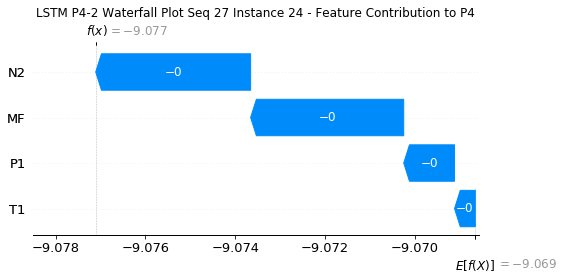

None

Contribution: [-0.01779071 -0.00866886 -0.05418916 -0.05422253]


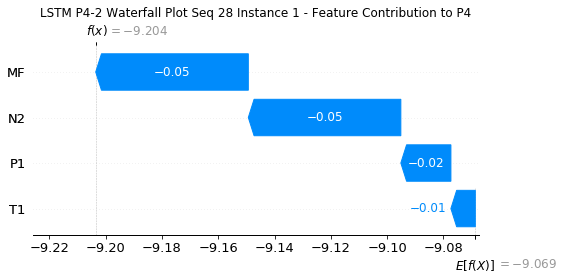

None

Contribution: [ 9.99832746e-05 -1.31420123e-04  6.62688221e-05  3.68226946e-04]


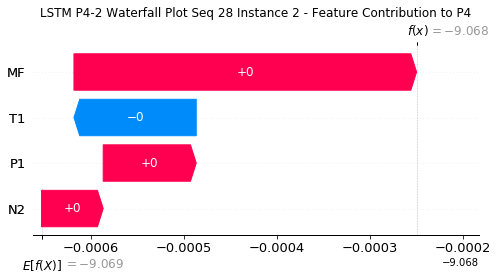

None

Contribution: [-0.00018448 -0.00014743 -0.00055906 -0.0005348 ]


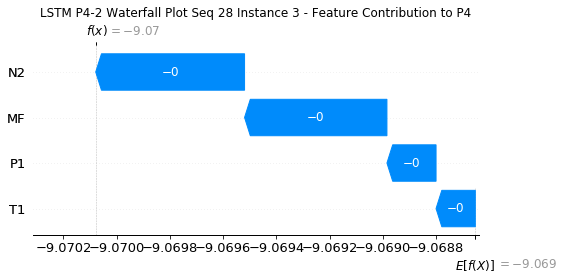

None

Contribution: [-0.00013575 -0.00012014 -0.00042268 -0.00039487]


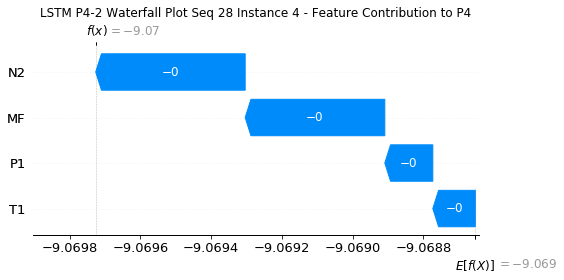

None

Contribution: [-7.96006668e-05 -6.92567219e-05 -2.50249075e-04 -2.32087305e-04]


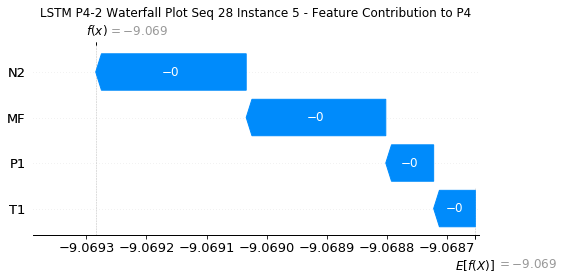

None

Contribution: [-6.69419406e-05 -5.83530548e-05 -2.04931056e-04 -1.91827515e-04]


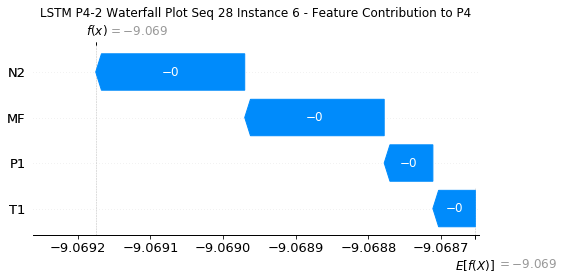

None

Contribution: [-6.22474082e-05 -5.15634245e-05 -1.93678475e-04 -1.78348490e-04]


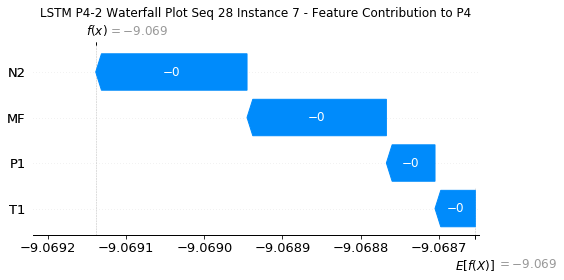

None

Contribution: [-6.12600627e-05 -4.88265535e-05 -1.89881176e-04 -1.75106832e-04]


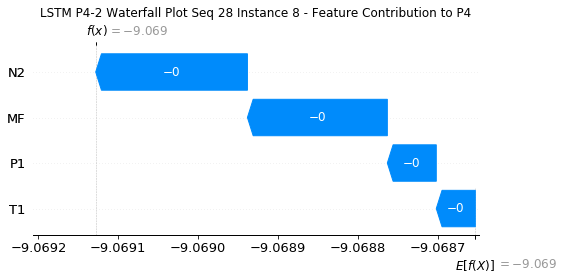

None

Contribution: [-6.11714989e-05 -4.84162908e-05 -1.90654477e-04 -1.77140604e-04]


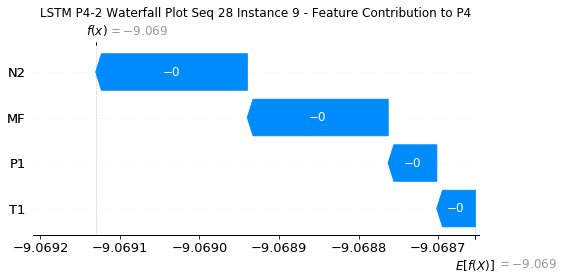

None

Contribution: [-6.10997576e-05 -4.82840420e-05 -1.92938621e-04 -1.76036715e-04]


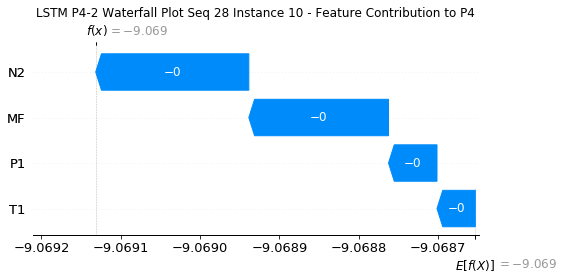

None

Contribution: [-6.37303450e-05 -5.17587049e-05 -1.98427775e-04 -1.82439202e-04]


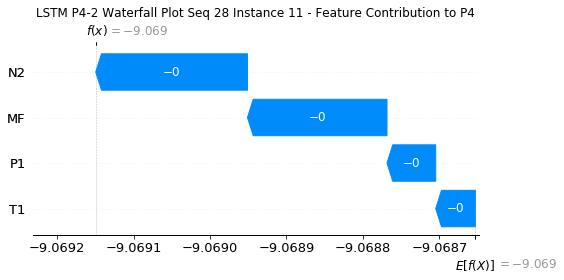

None

Contribution: [-6.54803696e-05 -5.17619173e-05 -2.02622929e-04 -1.86600051e-04]


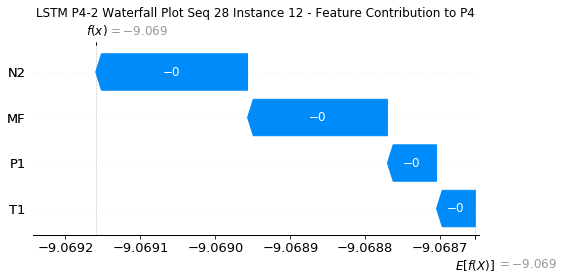

None

Contribution: [-6.37500202e-05 -5.24160941e-05 -2.05106085e-04 -1.86917697e-04]


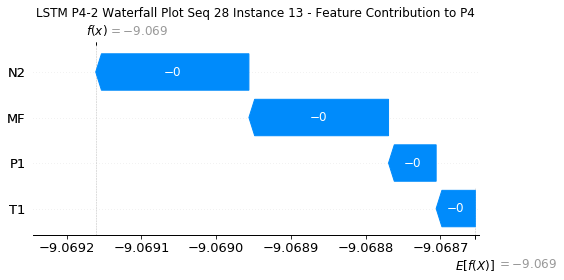

None

Contribution: [-6.84840513e-05 -5.03636428e-05 -2.09430989e-04 -1.93497627e-04]


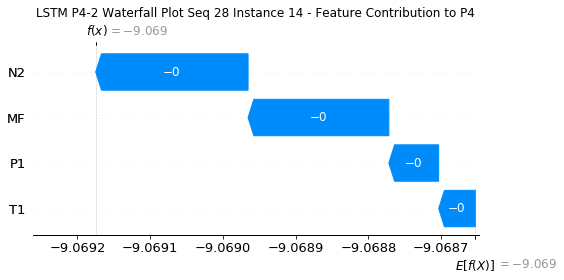

None

Contribution: [-6.73059194e-05 -4.90919164e-05 -2.12501656e-04 -1.94645484e-04]


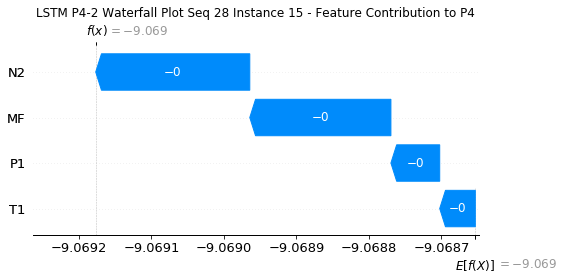

None

Contribution: [-7.25883077e-05 -4.91588484e-05 -2.19713050e-04 -2.02995608e-04]


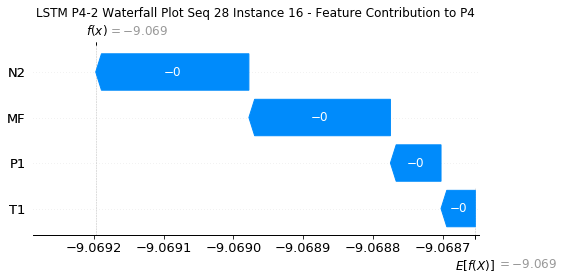

None

Contribution: [-7.57779900e-05 -4.80915685e-05 -2.29688632e-04 -2.11270366e-04]


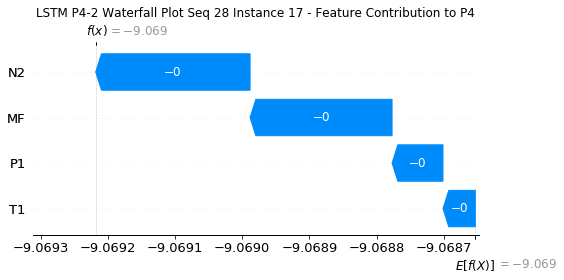

None

Contribution: [-7.54758459e-05 -5.92766375e-05 -2.44793982e-04 -2.17450662e-04]


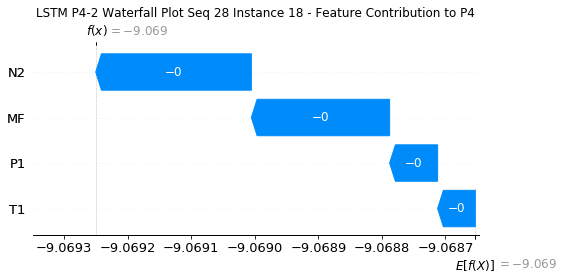

None

Contribution: [-9.45312610e-05 -5.01253056e-05 -2.75554742e-04 -2.56177557e-04]


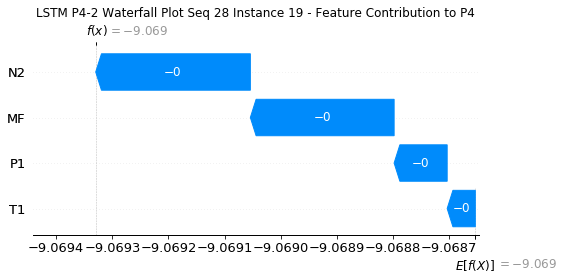

None

Contribution: [-1.15247531e-04 -5.89063000e-05 -3.34757475e-04 -3.11139645e-04]


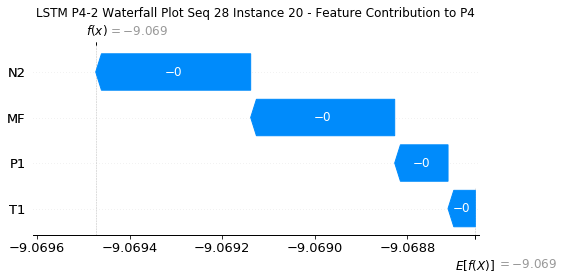

None

Contribution: [-1.65909372e-04 -8.10499577e-05 -4.74275841e-04 -4.44364765e-04]


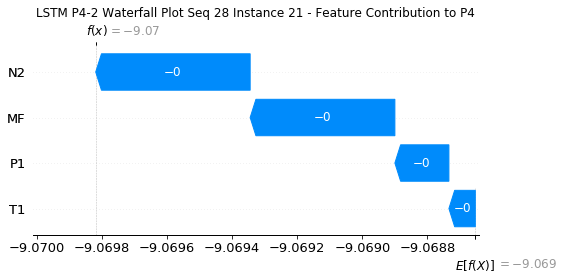

None

Contribution: [-0.00028383 -0.00013873 -0.00081746 -0.00076356]


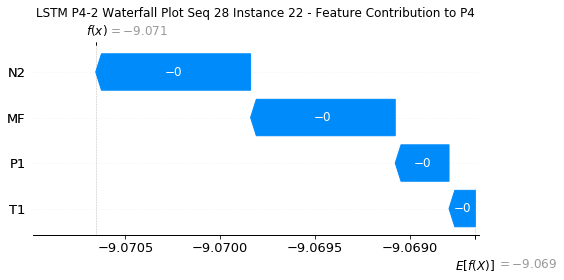

None

Contribution: [-0.00060459 -0.00015342 -0.00162283 -0.00157156]


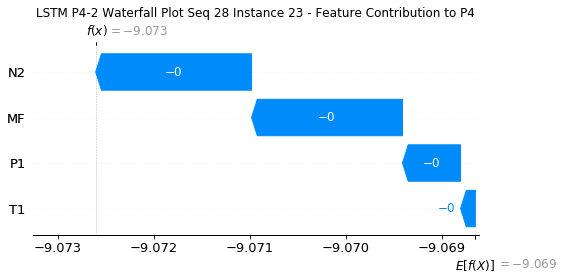

None

Contribution: [-0.00161536  0.00106248 -0.00354531 -0.00375529]


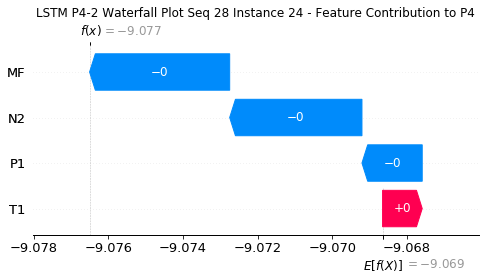

None

Contribution: [-0.02229213  0.01110982 -0.05658113 -0.05434562]


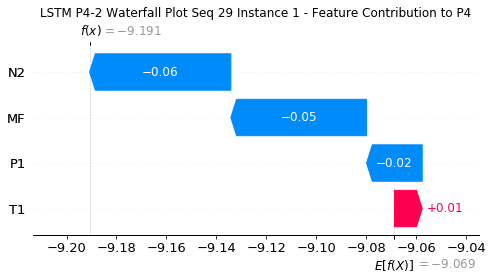

None

Contribution: [ 1.46479198e-04 -3.28790119e-04  3.73693574e-05  3.87532452e-04]


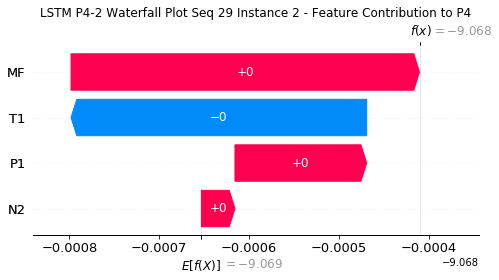

None

Contribution: [-2.24030907e-04 -5.41840170e-05 -5.91693878e-04 -5.68356587e-04]


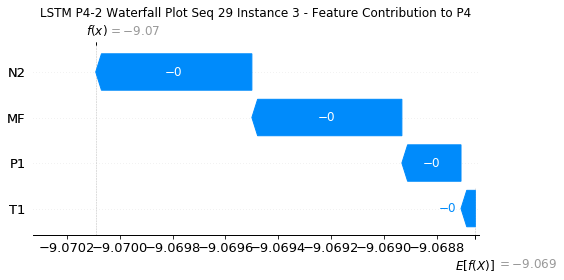

None

Contribution: [-1.55093742e-04 -4.95439099e-05 -4.30435485e-04 -4.09781702e-04]


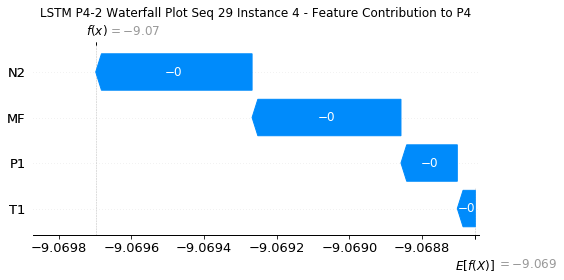

None

Contribution: [-8.91319057e-05 -3.41490348e-05 -2.51147864e-04 -2.37677838e-04]


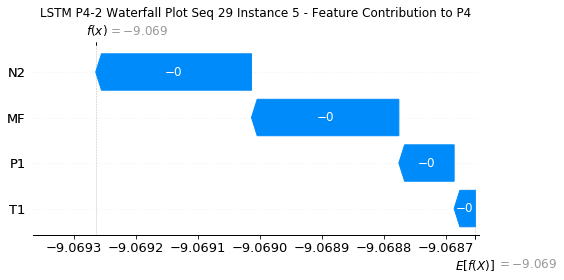

None

Contribution: [-6.73840869e-05 -2.82991318e-05 -2.02223523e-04 -1.85254123e-04]


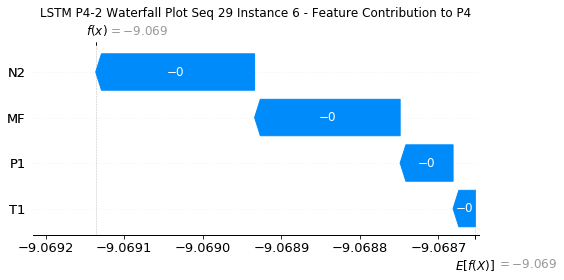

None

Contribution: [-6.85982755e-05 -2.83302087e-05 -1.94553023e-04 -1.82188459e-04]


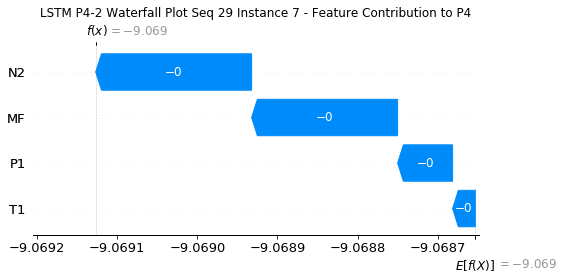

None

Contribution: [-6.73189176e-05 -2.60309978e-05 -1.91019028e-04 -1.78279938e-04]


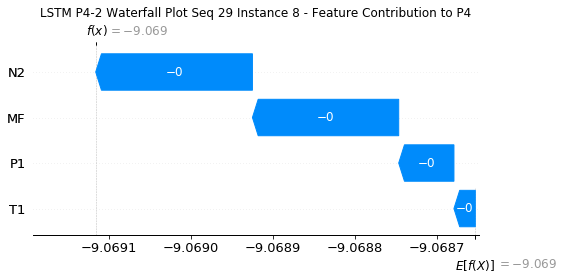

None

Contribution: [-7.06356140e-05 -2.77619829e-05 -1.93579931e-04 -1.85745765e-04]


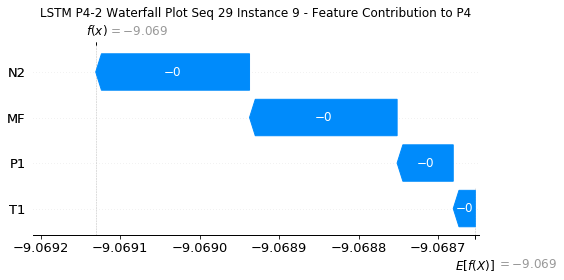

None

Contribution: [-7.14493963e-05 -2.83717163e-05 -1.96077692e-04 -1.85550649e-04]


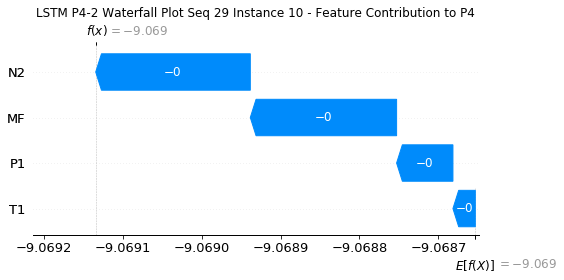

None

Contribution: [-7.04802449e-05 -3.09855662e-05 -2.00253876e-04 -1.87728249e-04]


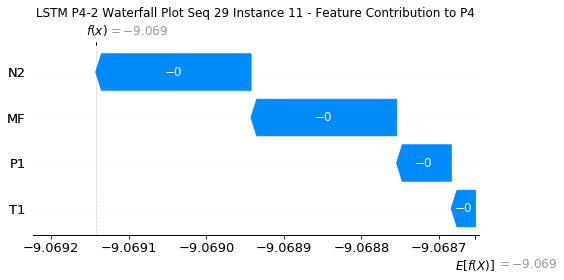

None

Contribution: [-7.09983665e-05 -3.26397370e-05 -2.04510085e-04 -1.90821553e-04]


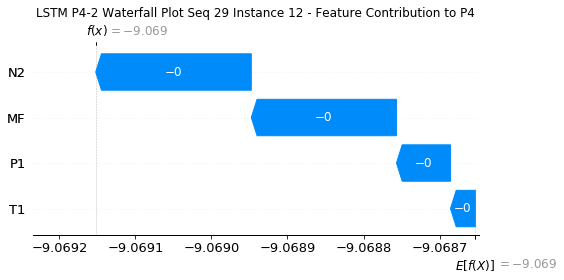

None

Contribution: [-7.36546119e-05 -3.10649199e-05 -2.08703236e-04 -1.96126353e-04]


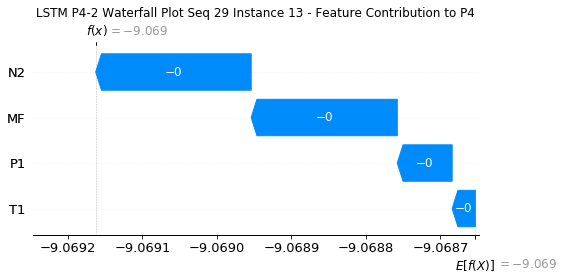

None

Contribution: [-7.25685803e-05 -3.65629890e-05 -2.11591415e-04 -1.97004871e-04]


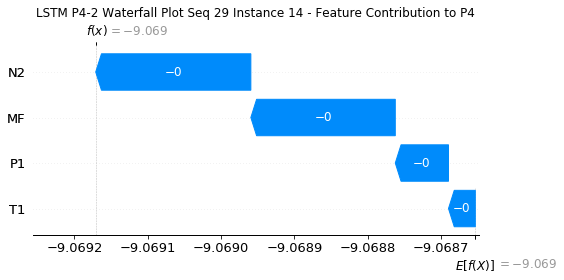

None

Contribution: [-7.02434974e-05 -4.63549104e-05 -2.14720415e-04 -1.95997676e-04]


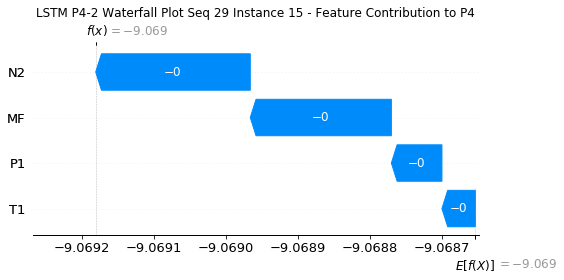

None

Contribution: [-7.41865859e-05 -4.29384814e-05 -2.22152120e-04 -2.04753396e-04]


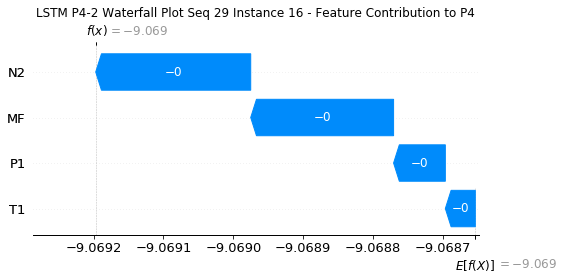

None

Contribution: [-7.65060187e-05 -4.81323249e-05 -2.32784516e-04 -2.13558420e-04]


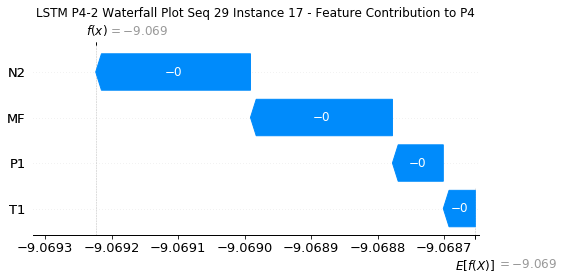

None

Contribution: [-7.55966775e-05 -5.88791218e-05 -2.48162352e-04 -2.22015783e-04]


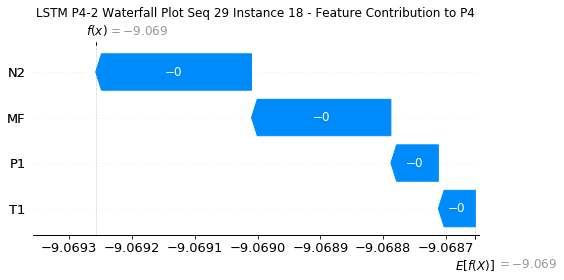

None

Contribution: [-8.78270024e-05 -6.39348459e-05 -2.78393048e-04 -2.52460024e-04]


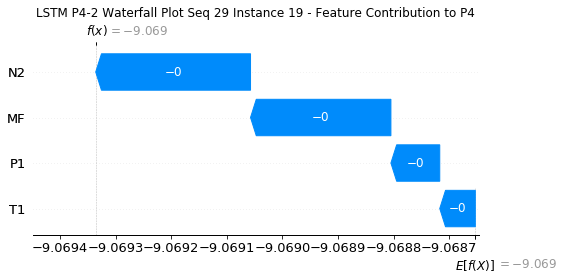

None

Contribution: [-1.06547674e-04 -8.03403501e-05 -3.38454174e-04 -3.07169560e-04]


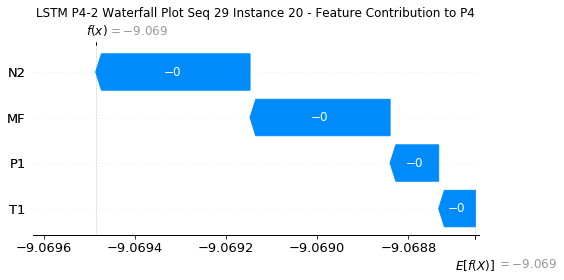

None

Contribution: [-0.00015091 -0.00011614 -0.00047901 -0.00043703]


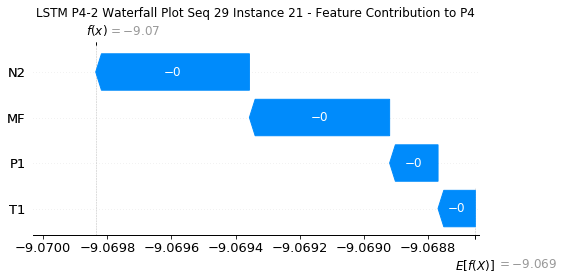

None

Contribution: [-0.00026195 -0.00020778 -0.00082534 -0.00075619]


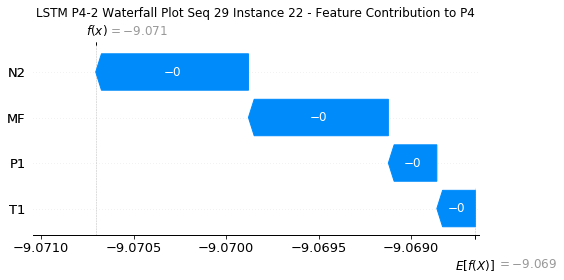

None

Contribution: [-0.00049894 -0.0003673  -0.00162529 -0.00149224]


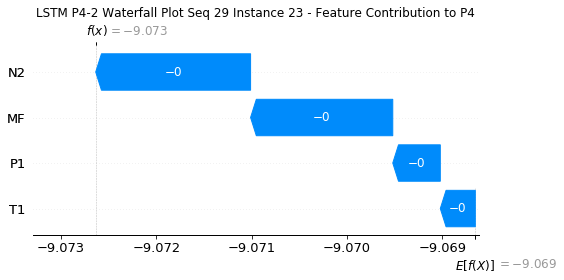

None

Contribution: [-0.00086318  0.00020766 -0.0034475  -0.0031081 ]


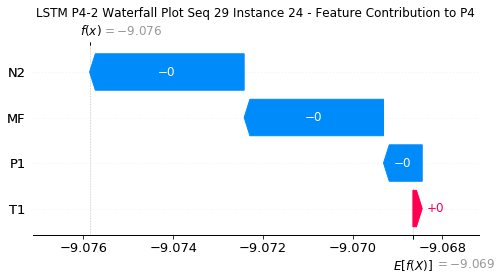

None

Contribution: [-0.01615881 -0.00757104 -0.05483762 -0.05210672]


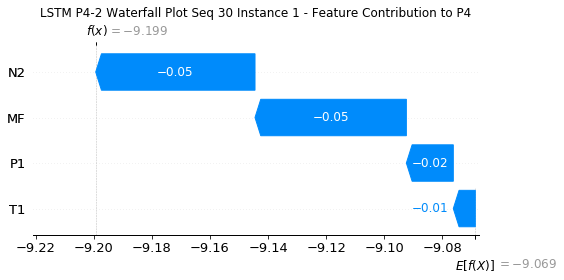

None

Contribution: [ 8.72583179e-05 -1.71435754e-04  4.82089444e-05  3.43732119e-04]


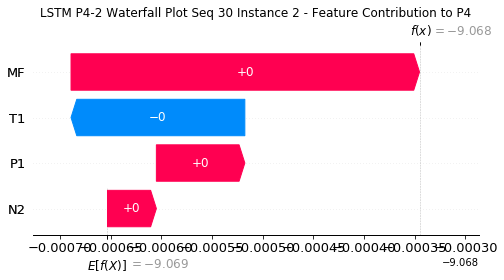

None

Contribution: [-0.00018623 -0.00015054 -0.0005671  -0.00052802]


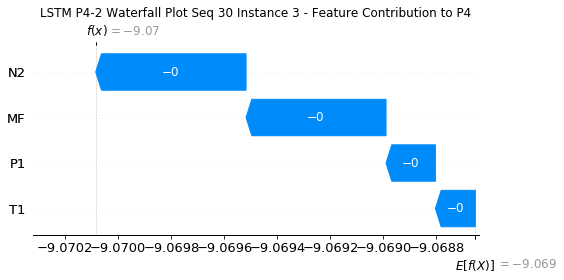

None

Contribution: [-0.00013358 -0.00011425 -0.00042336 -0.00039221]


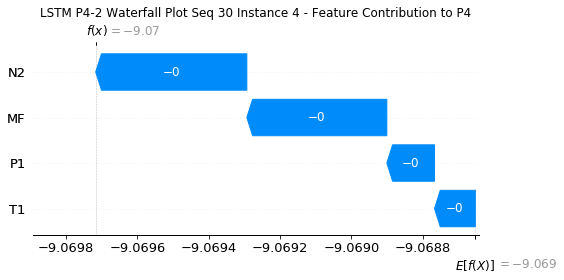

None

Contribution: [-7.84975635e-05 -6.61173825e-05 -2.49567611e-04 -2.30301479e-04]


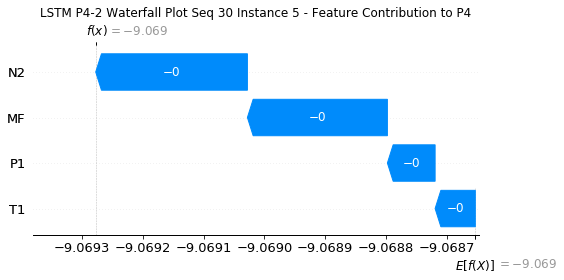

None

Contribution: [-6.50593834e-05 -5.22535101e-05 -2.03335085e-04 -1.86226440e-04]


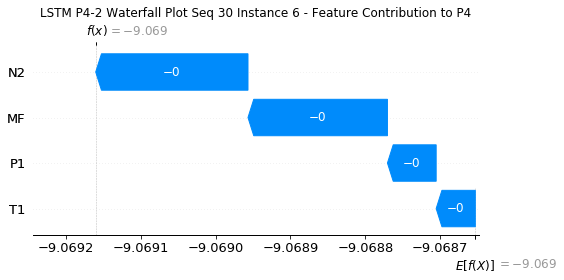

None

Contribution: [-6.11816227e-05 -5.08082433e-05 -1.93415191e-04 -1.76958426e-04]


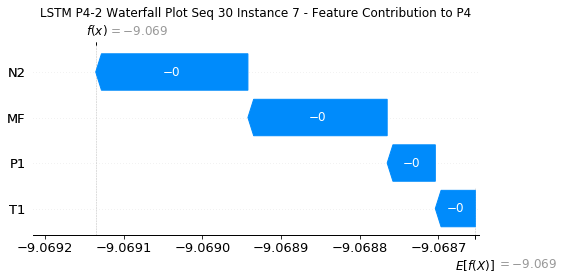

None

Contribution: [-5.98177188e-05 -4.72350686e-05 -1.89322759e-04 -1.71742834e-04]


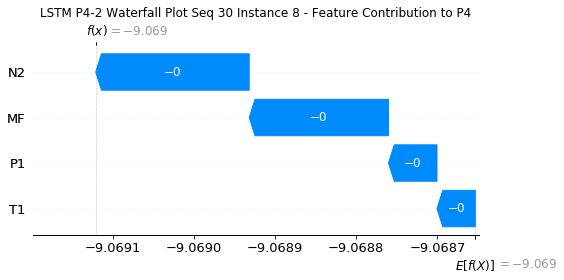

None

Contribution: [-5.92933381e-05 -4.60810912e-05 -1.89878206e-04 -1.72490014e-04]


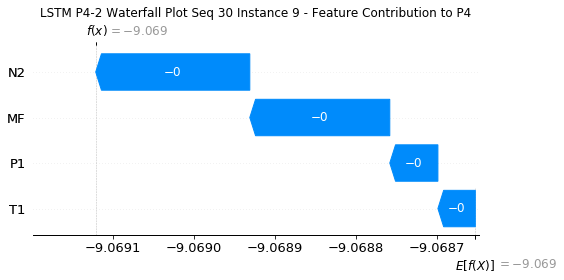

None

Contribution: [-6.06208069e-05 -4.70789953e-05 -1.92694751e-04 -1.73617259e-04]


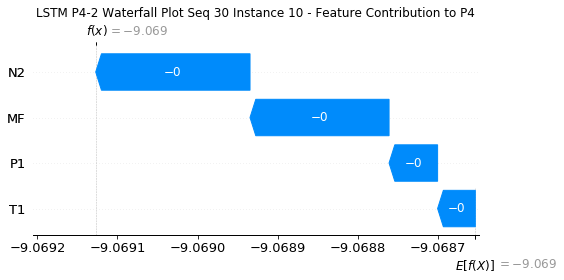

None

Contribution: [-6.20680758e-05 -4.95768219e-05 -1.97836798e-04 -1.80156026e-04]


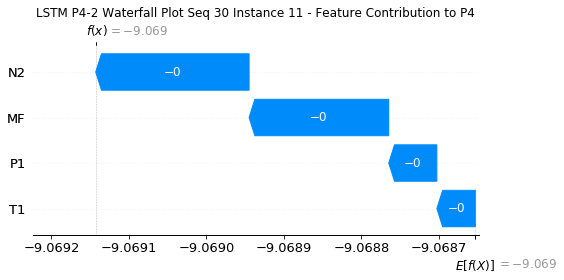

None

Contribution: [-6.33904207e-05 -5.10045160e-05 -2.02141847e-04 -1.84196319e-04]


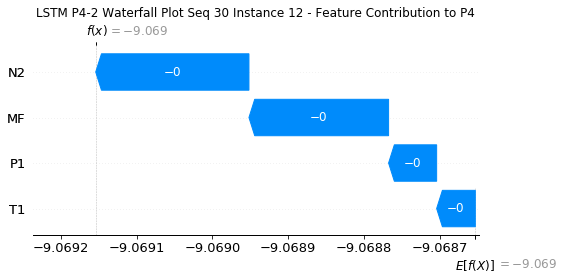

None

Contribution: [-6.40180747e-05 -5.04637379e-05 -2.04972880e-04 -1.84327252e-04]


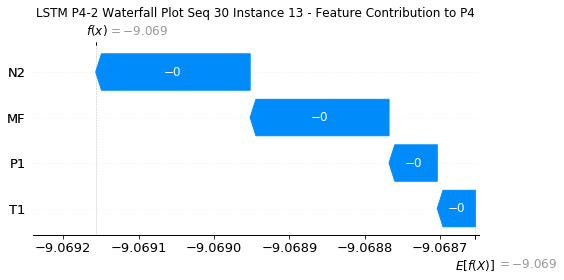

None

Contribution: [-6.53040599e-05 -5.23623361e-05 -2.08884779e-04 -1.89688852e-04]


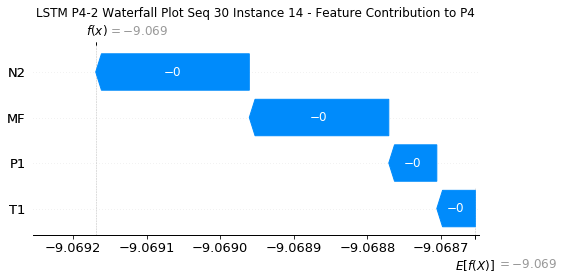

None

Contribution: [-6.73913251e-05 -5.53101563e-05 -2.13113032e-04 -1.93768610e-04]


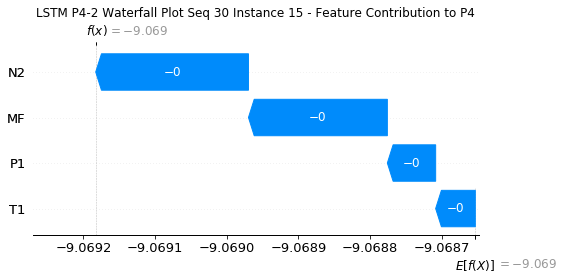

None

Contribution: [-6.85618229e-05 -5.51525366e-05 -2.19359266e-04 -1.99089068e-04]


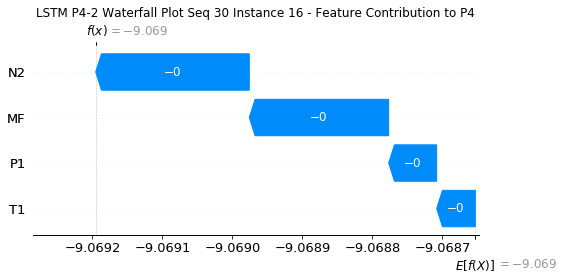

None

Contribution: [-7.20072848e-05 -5.80847519e-05 -2.30005241e-04 -2.09073342e-04]


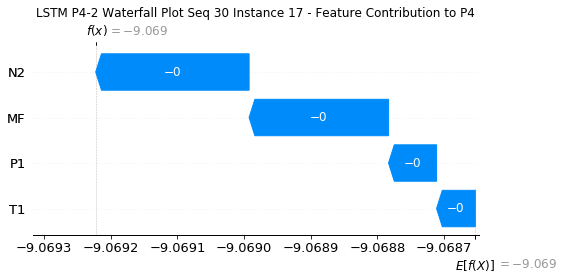

None

Contribution: [-7.77675005e-05 -6.14969562e-05 -2.46217750e-04 -2.21844964e-04]


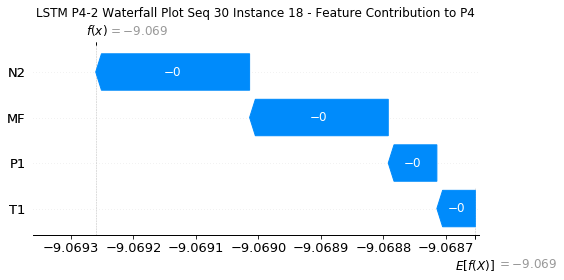

None

Contribution: [-8.67342914e-05 -7.19274071e-05 -2.75750373e-04 -2.50626647e-04]


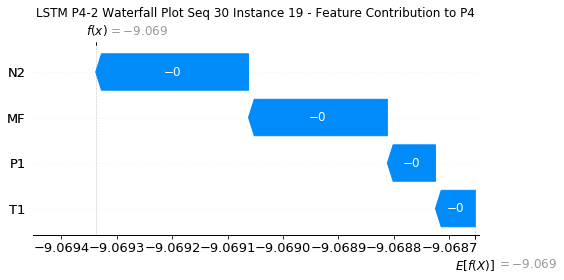

None

Contribution: [-1.05682829e-04 -8.80804715e-05 -3.35076758e-04 -3.04998313e-04]


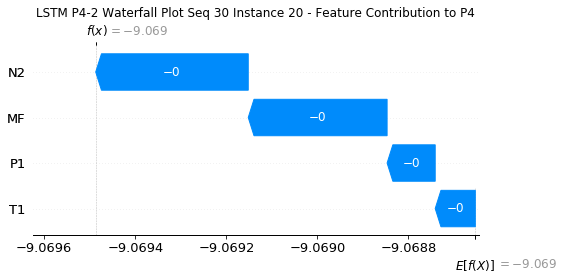

None

Contribution: [-0.00014945 -0.00012612 -0.00047389 -0.00043141]


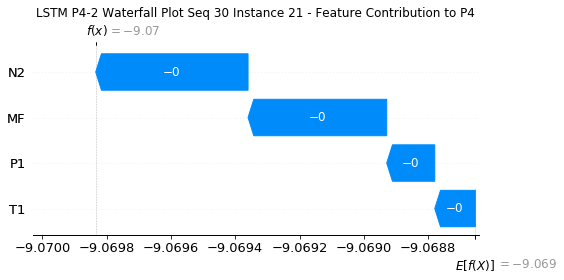

None

Contribution: [-0.00025823 -0.00021696 -0.0008167  -0.00074508]


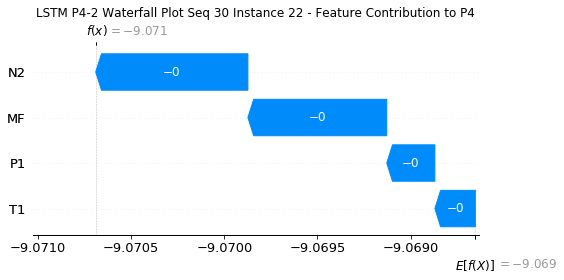

None

Contribution: [-0.00050539 -0.00041843 -0.00161178 -0.0014775 ]


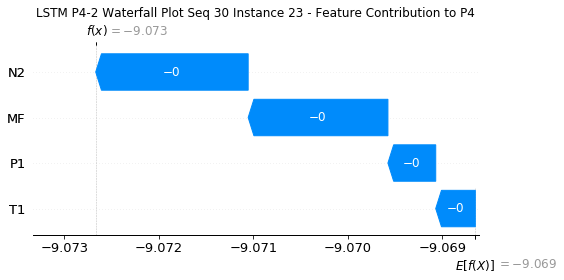

None

Contribution: [-0.0010134  -0.0004786  -0.0034761  -0.00323716]


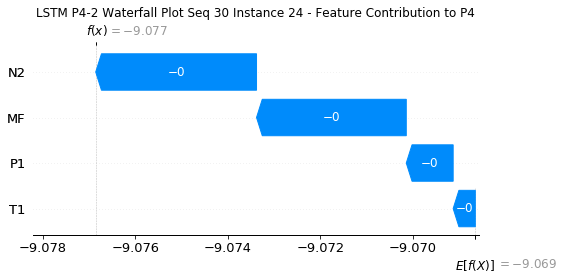

None

Contribution: [-0.01659985 -0.00760593 -0.05531663 -0.05262184]


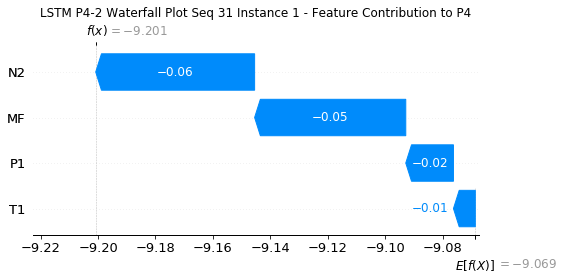

None

Contribution: [ 7.51473938e-05 -1.55338181e-04  4.21363844e-05  3.02086488e-04]


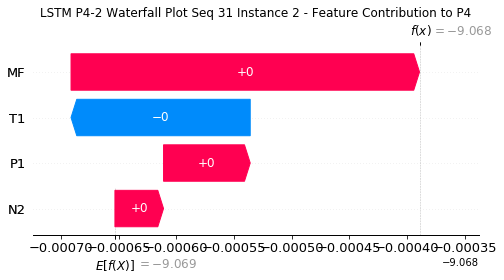

None

Contribution: [-0.0001755  -0.00014296 -0.00056337 -0.0005134 ]


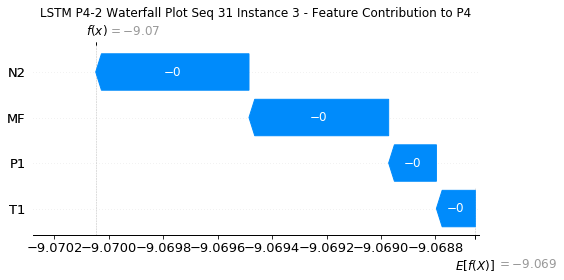

None

Contribution: [-0.000136   -0.00011244 -0.00042487 -0.00039647]


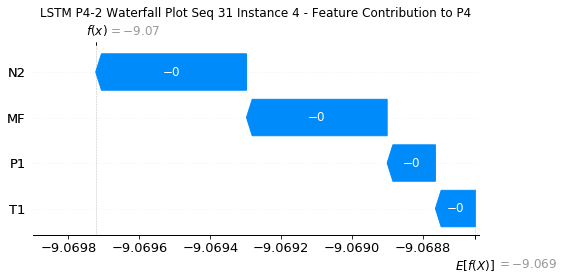

None

Contribution: [-7.98843149e-05 -6.58985612e-05 -2.50855933e-04 -2.32956015e-04]


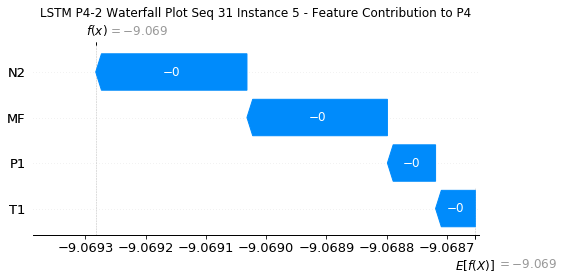

None

Contribution: [-6.53658498e-05 -5.40162823e-05 -2.03777240e-04 -1.87331442e-04]


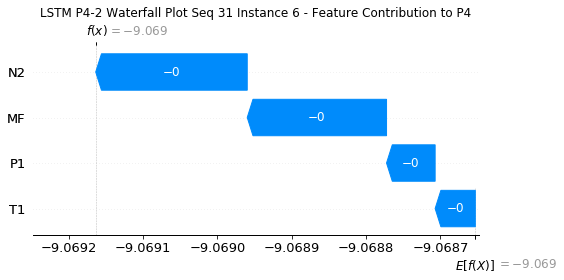

None

Contribution: [-6.18509547e-05 -5.07183823e-05 -1.94066867e-04 -1.78413768e-04]


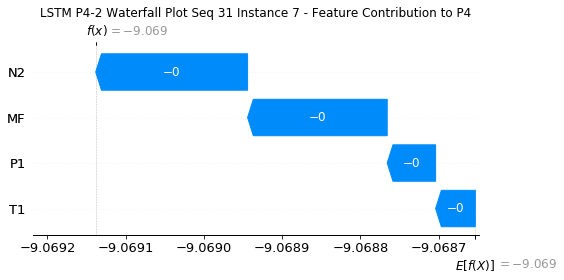

None

Contribution: [-5.93969968e-05 -4.71285931e-05 -1.89168276e-04 -1.72007850e-04]


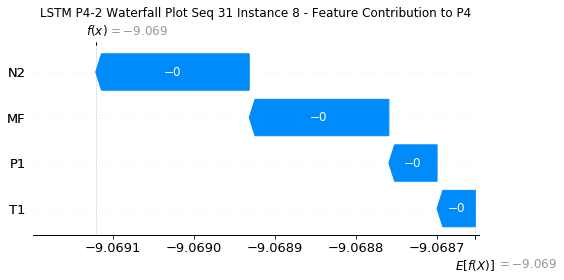

None

Contribution: [-5.85512217e-05 -4.71842517e-05 -1.89146685e-04 -1.69376177e-04]


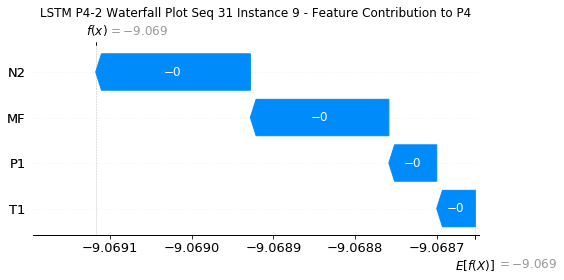

None

Contribution: [-6.02593728e-05 -4.75277348e-05 -1.93000586e-04 -1.75882901e-04]


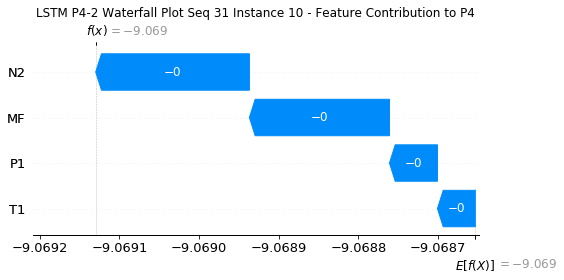

None

Contribution: [-6.30848917e-05 -5.11354612e-05 -1.98508132e-04 -1.81456076e-04]


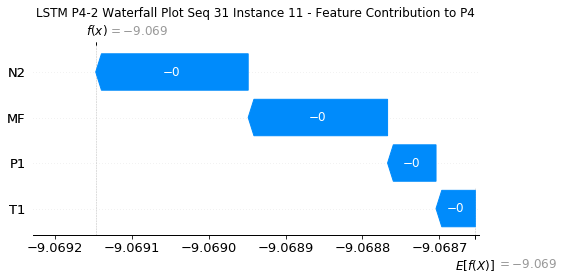

None

Contribution: [-6.43517183e-05 -5.22308580e-05 -2.02724307e-04 -1.85072126e-04]


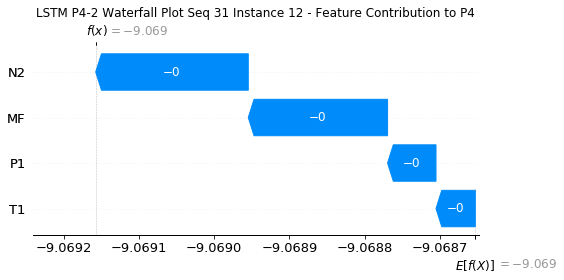

None

Contribution: [-6.53761636e-05 -5.23989104e-05 -2.06209523e-04 -1.89022183e-04]


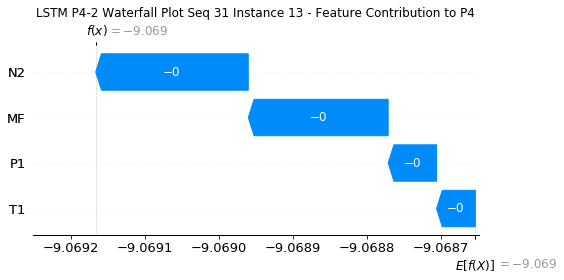

None

Contribution: [-6.61662665e-05 -5.31728998e-05 -2.09288993e-04 -1.90774469e-04]


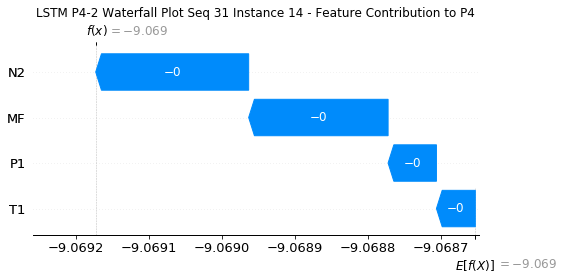

None

Contribution: [-6.64706827e-05 -5.38948890e-05 -2.13018779e-04 -1.90895219e-04]


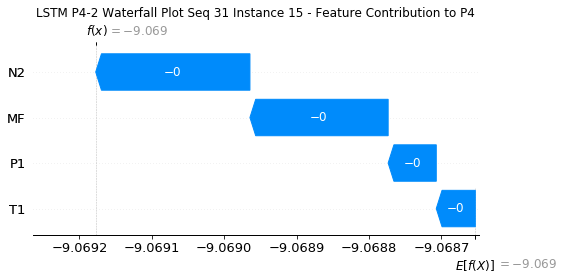

None

Contribution: [-6.91407057e-05 -5.54667467e-05 -2.19359592e-04 -1.99202839e-04]


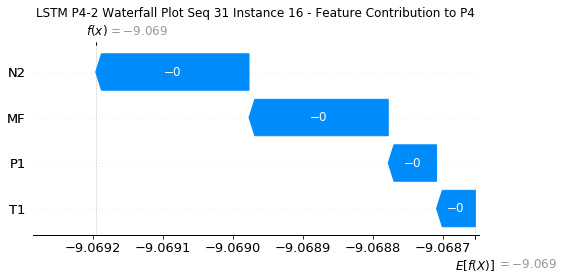

None

Contribution: [-7.22339681e-05 -5.81640752e-05 -2.29862707e-04 -2.08718215e-04]


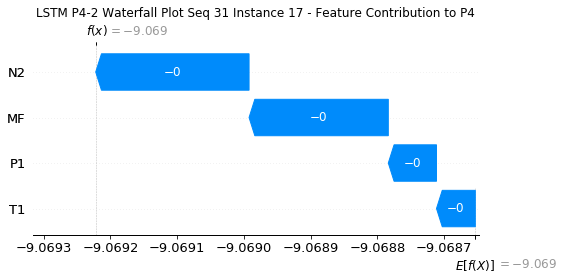

None

Contribution: [-7.91835440e-05 -6.49007983e-05 -2.47396498e-04 -2.27199565e-04]


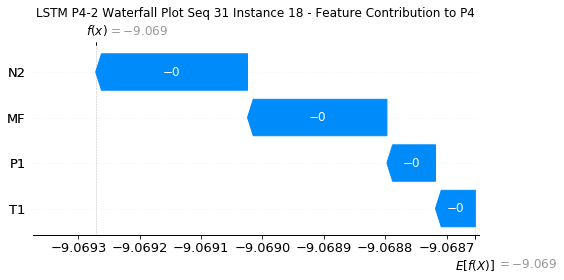

None

Contribution: [-8.64497003e-05 -6.93595151e-05 -2.75070981e-04 -2.49554840e-04]


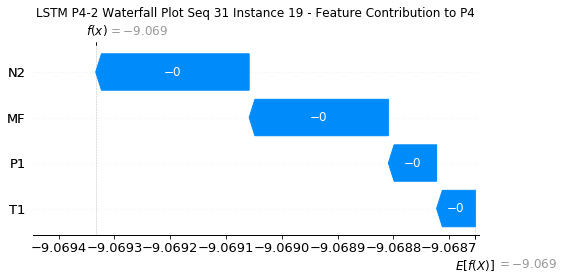

None

Contribution: [-1.05032323e-04 -8.50251701e-05 -3.34138548e-04 -3.03385845e-04]


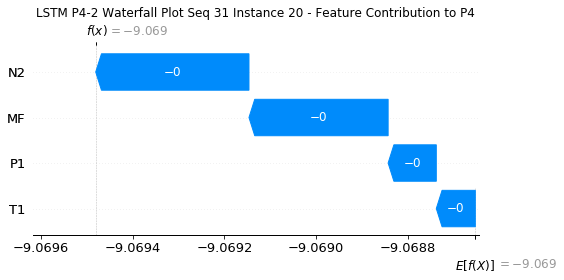

None

Contribution: [-0.00014872 -0.00012108 -0.0004728  -0.00043047]


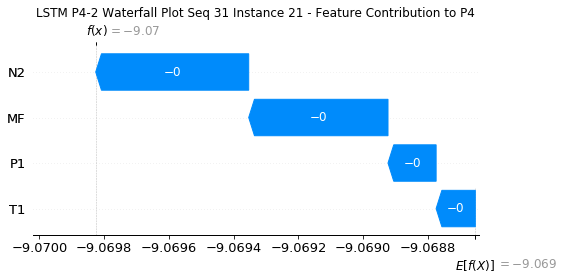

None

Contribution: [-0.00025654 -0.0002113  -0.00081477 -0.00074347]


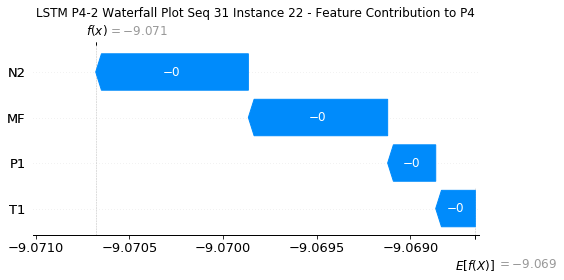

None

Contribution: [-0.00050013 -0.00038666 -0.00160829 -0.00147058]


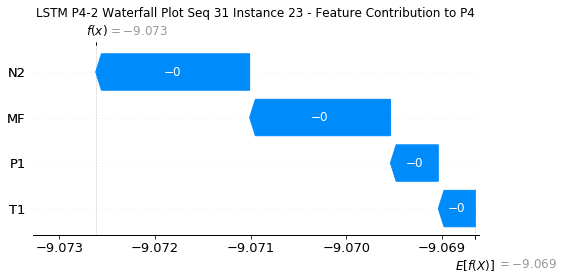

None

Contribution: [-0.00109847 -0.00041803 -0.00355014 -0.00330953]


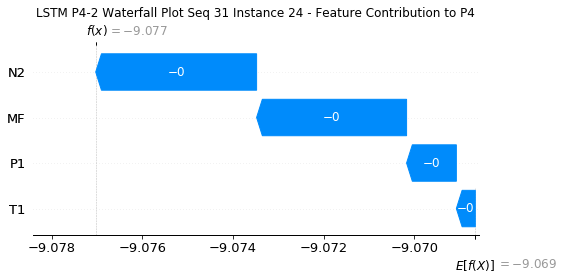

None

Contribution: [-0.01755077 -0.00788197 -0.0556758  -0.05472264]


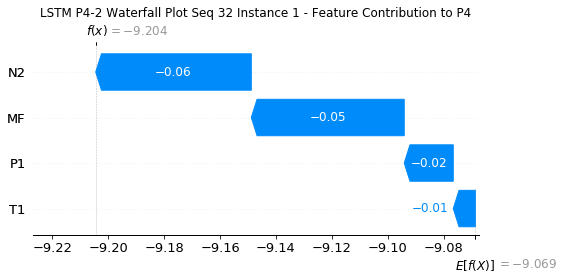

None

Contribution: [ 1.01332283e-04 -1.59434871e-04  7.97922359e-05  3.85227136e-04]


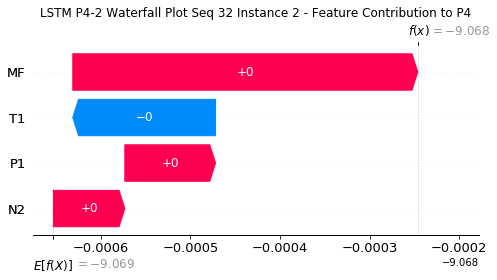

None

Contribution: [-0.00018466 -0.00012516 -0.00056461 -0.00053345]


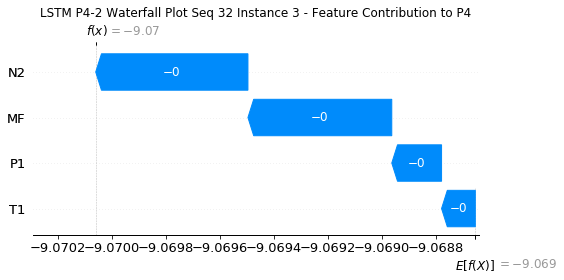

None

Contribution: [-0.00013285 -0.00010774 -0.00042226 -0.00039046]


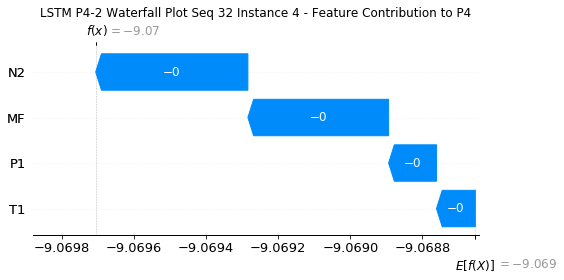

None

Contribution: [-7.84450314e-05 -6.37387201e-05 -2.50094456e-04 -2.30325979e-04]


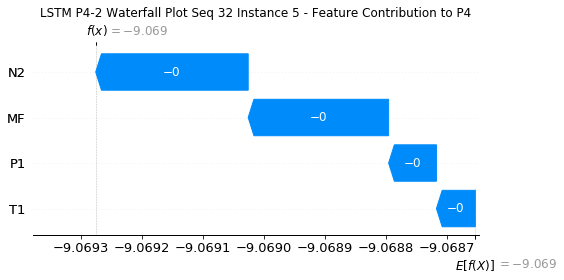

None

Contribution: [-6.25176699e-05 -5.23059099e-05 -2.01887109e-04 -1.83828787e-04]


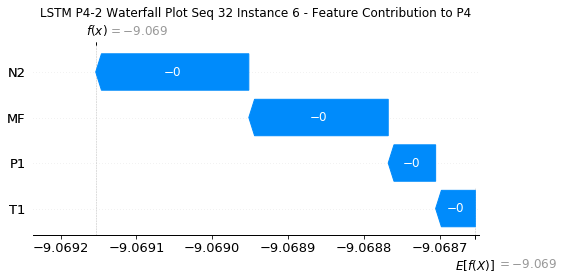

None

Contribution: [-6.10610466e-05 -4.94013887e-05 -1.93927085e-04 -1.77335903e-04]


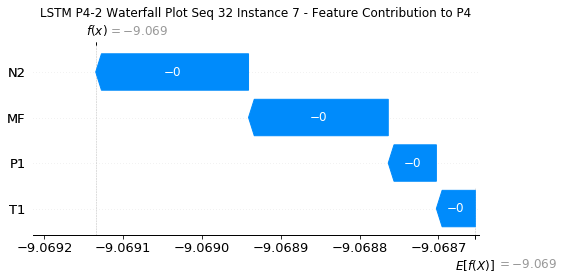

None

Contribution: [-6.05987366e-05 -4.87985388e-05 -1.91164620e-04 -1.76419149e-04]


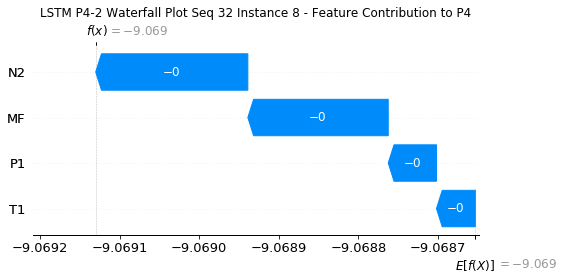

None

Contribution: [-6.12887538e-05 -5.01400969e-05 -1.92319376e-04 -1.79768229e-04]


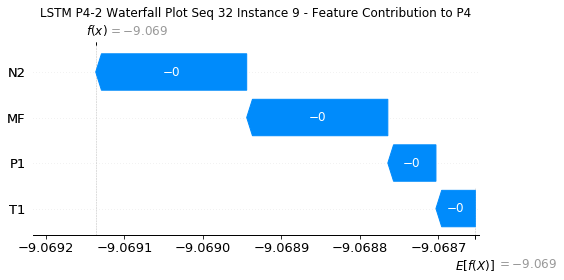

None

Contribution: [-6.11826582e-05 -5.04856683e-05 -1.94666228e-04 -1.78454548e-04]


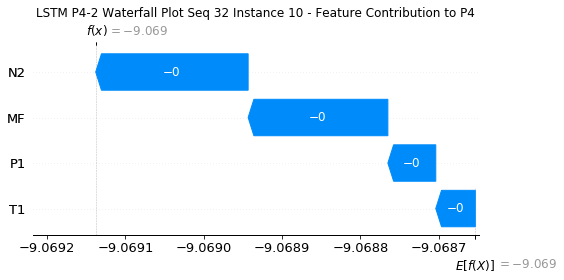

None

Contribution: [-6.23278828e-05 -4.97875676e-05 -1.98733783e-04 -1.81273678e-04]


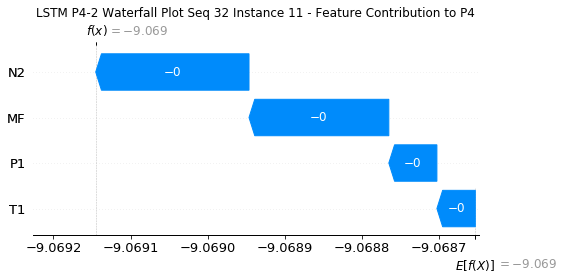

None

Contribution: [-6.36848810e-05 -5.04974648e-05 -2.02961145e-04 -1.85189352e-04]


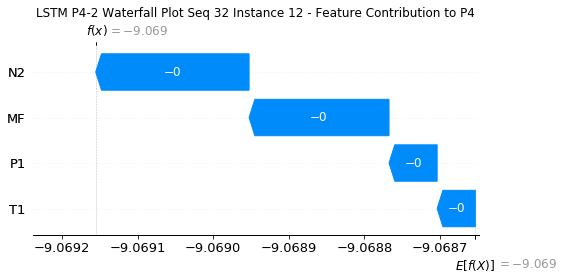

None

Contribution: [-6.39243549e-05 -5.03234735e-05 -2.05845631e-04 -1.85670536e-04]


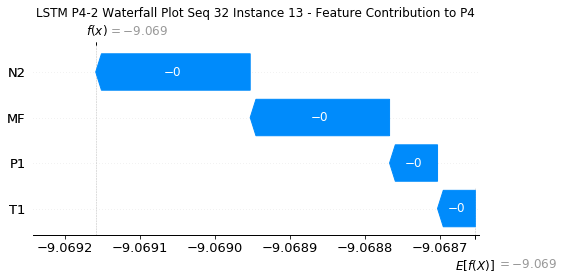

None

Contribution: [-6.55044200e-05 -5.15508309e-05 -2.09541845e-04 -1.90813275e-04]


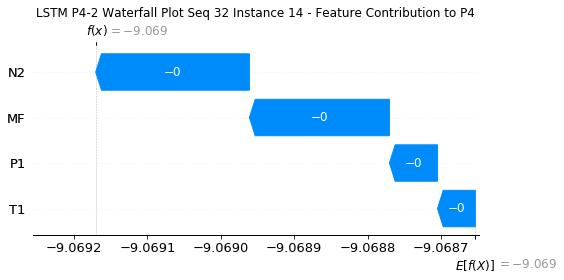

None

Contribution: [-6.42303309e-05 -4.88208546e-05 -2.11925589e-04 -1.91610220e-04]


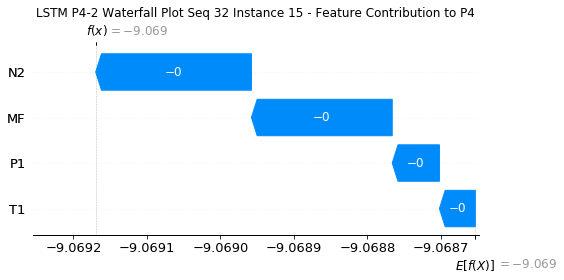

None

Contribution: [-6.86880721e-05 -5.36469768e-05 -2.19880102e-04 -1.99814460e-04]


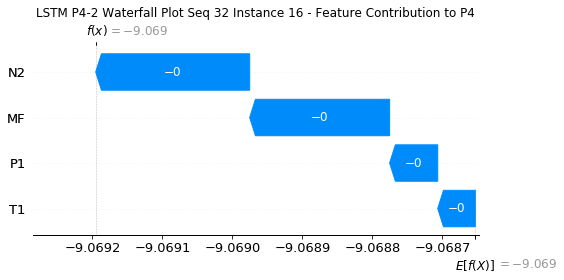

None

Contribution: [-7.18127950e-05 -5.59762084e-05 -2.30351845e-04 -2.08865871e-04]


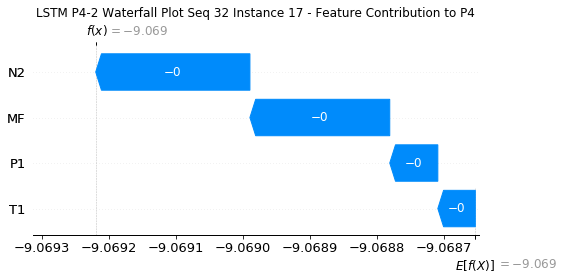

None

Contribution: [-7.72238283e-05 -5.90609711e-05 -2.47448669e-04 -2.24811936e-04]


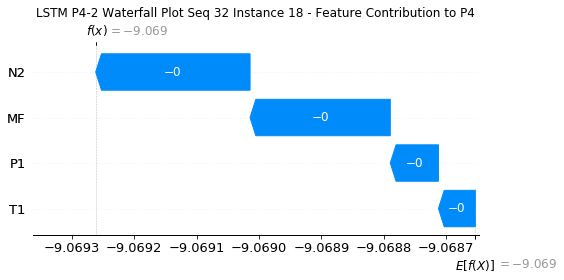

None

Contribution: [-8.63359239e-05 -6.62685527e-05 -2.75791892e-04 -2.50092037e-04]


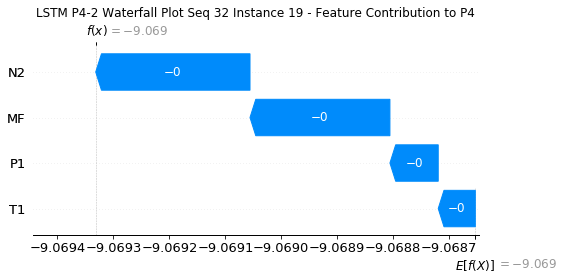

None

Contribution: [-1.04934173e-04 -8.12660253e-05 -3.34981606e-04 -3.03682226e-04]


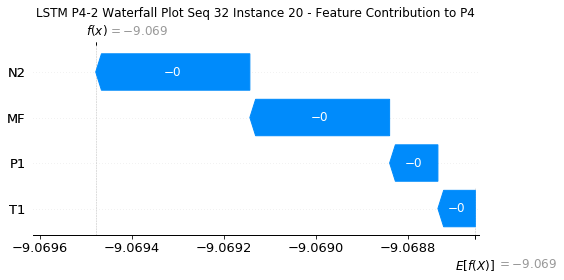

None

Contribution: [-0.00014878 -0.00011604 -0.00047402 -0.00043099]


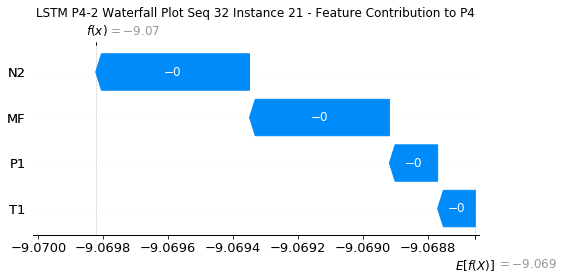

None

Contribution: [-0.00025646 -0.00020308 -0.00081742 -0.00074377]


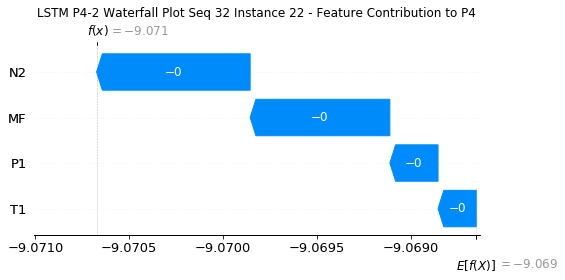

None

Contribution: [-0.00050651 -0.00037025 -0.00162023 -0.00148452]


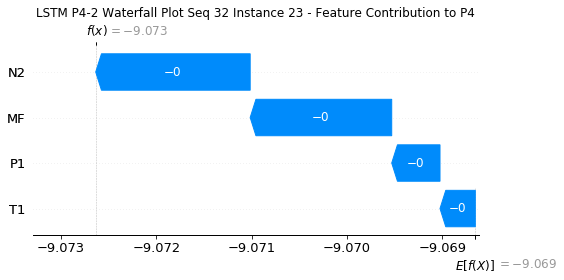

None

Contribution: [-0.00109318 -0.00046282 -0.00354257 -0.00336303]


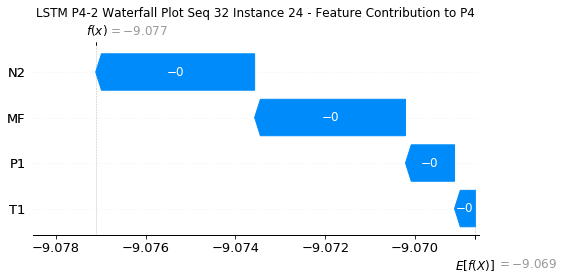

None

Contribution: [-0.01643588 -0.00691839 -0.05596089 -0.05272037]


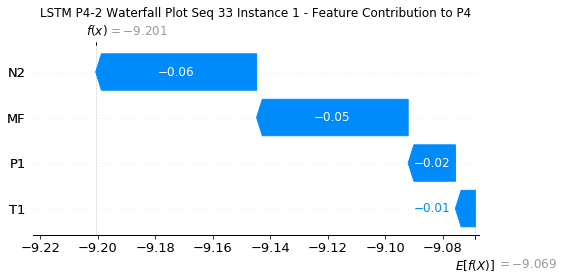

None

Contribution: [ 8.51278813e-05 -1.67438940e-04  5.89256180e-05  3.45597752e-04]


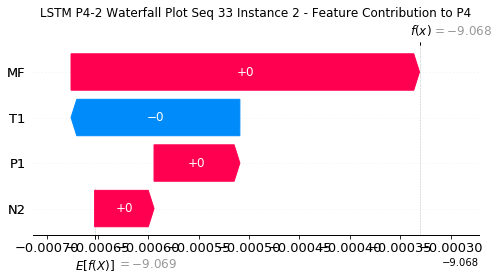

None

Contribution: [-0.00018201 -0.00013175 -0.00057268 -0.00053049]


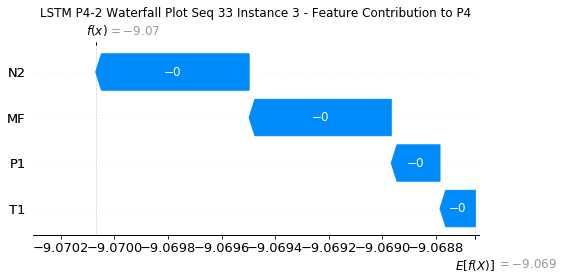

None

Contribution: [-0.00013083 -0.00010208 -0.00042516 -0.0003932 ]


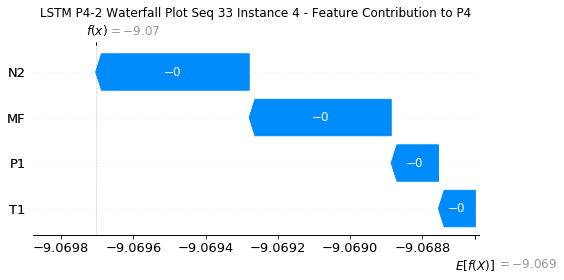

None

Contribution: [-7.69430506e-05 -5.99440298e-05 -2.50354161e-04 -2.30470639e-04]


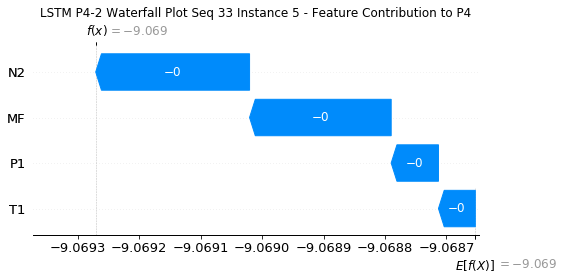

None

Contribution: [-6.31060466e-05 -5.07875807e-05 -2.03135411e-04 -1.85065157e-04]


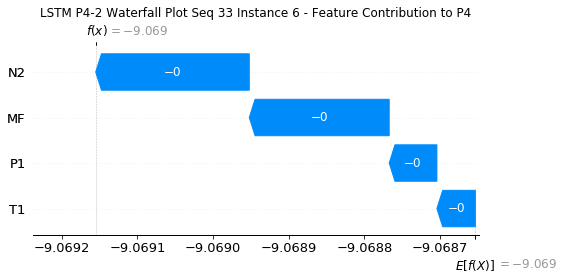

None

Contribution: [-5.99478334e-05 -4.61228382e-05 -1.93808847e-04 -1.76855983e-04]


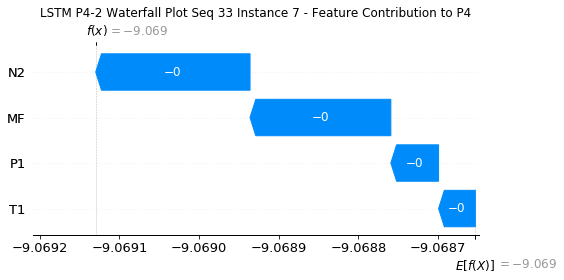

None

Contribution: [-6.00376573e-05 -4.32035163e-05 -1.89984860e-04 -1.72444415e-04]


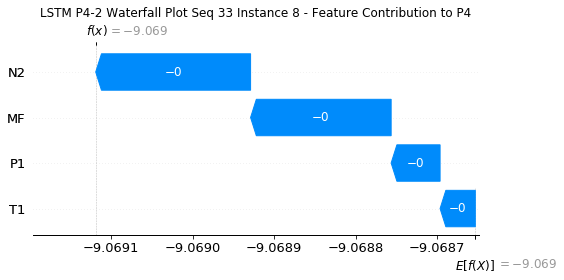

None

Contribution: [-6.02903430e-05 -4.65852799e-05 -1.90936246e-04 -1.75590358e-04]


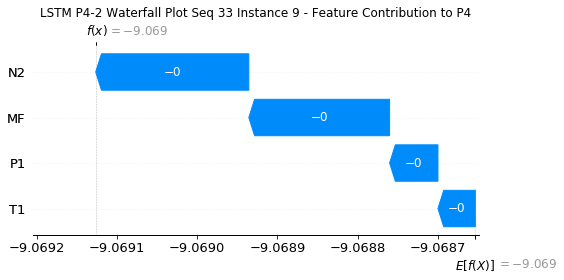

None

Contribution: [-6.05704773e-05 -4.34027804e-05 -1.93346729e-04 -1.75327729e-04]


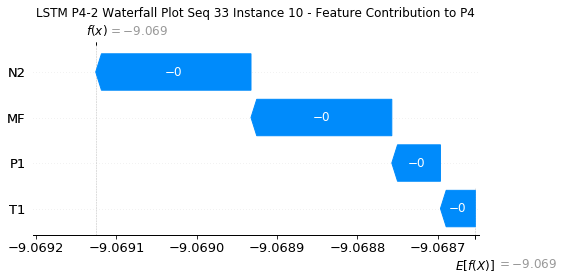

None

Contribution: [-6.13170436e-05 -4.61465393e-05 -1.98235089e-04 -1.80480381e-04]


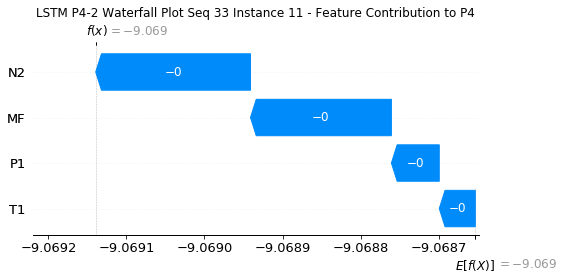

None

Contribution: [-6.26785532e-05 -4.71273256e-05 -2.02617966e-04 -1.84385759e-04]


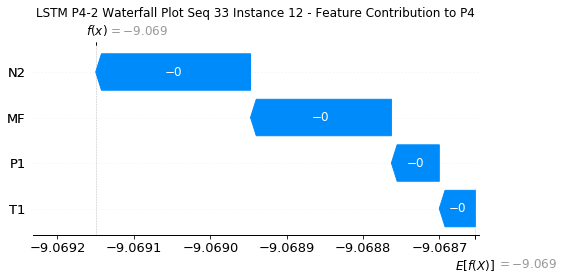

None

Contribution: [-6.52601993e-05 -4.81750606e-05 -2.06332893e-04 -1.88942495e-04]


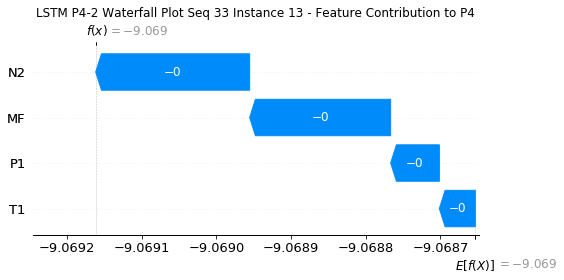

None

Contribution: [-6.47948824e-05 -4.79578176e-05 -2.09181294e-04 -1.90347013e-04]


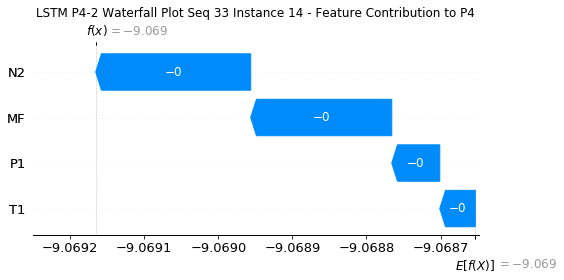

None

Contribution: [-6.50889619e-05 -4.82827042e-05 -2.12240996e-04 -1.90514285e-04]


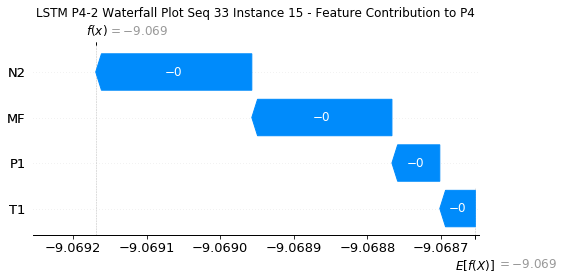

None

Contribution: [-6.77552957e-05 -4.99536094e-05 -2.19261660e-04 -1.98664322e-04]


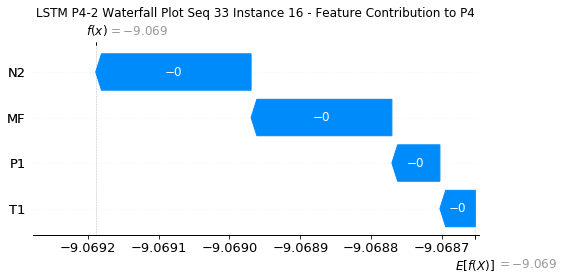

None

Contribution: [-7.05324540e-05 -5.20512735e-05 -2.29727976e-04 -2.07815377e-04]


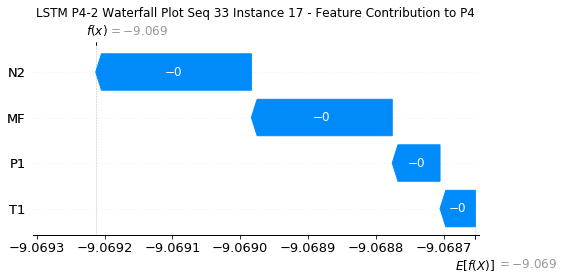

None

Contribution: [-7.79951049e-05 -5.53454999e-05 -2.47254184e-04 -2.26222374e-04]


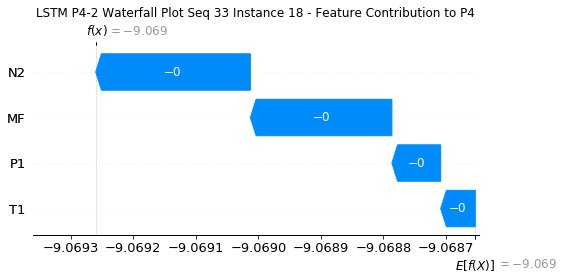

None

Contribution: [-8.50770973e-05 -6.21773650e-05 -2.75358029e-04 -2.49602617e-04]


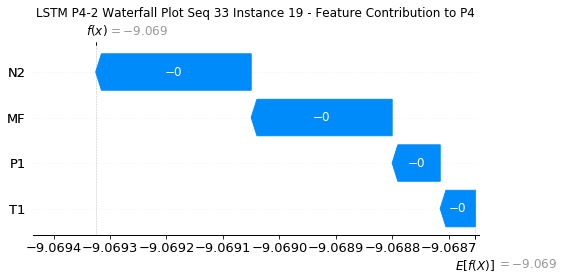

None

Contribution: [-1.03286321e-04 -7.61334389e-05 -3.34611241e-04 -3.03538001e-04]


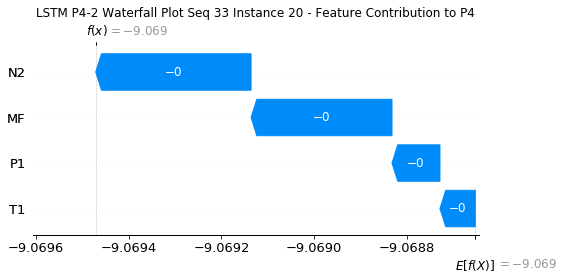

None

Contribution: [-0.00014713 -0.00010845 -0.00047371 -0.00043239]


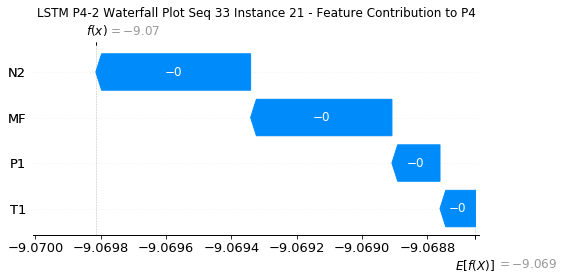

None

Contribution: [-0.00025304 -0.0001876  -0.00081591 -0.00074545]


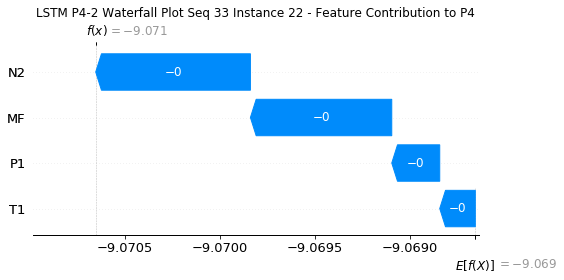

None

Contribution: [-0.00049681 -0.00031427 -0.00161058 -0.00149862]


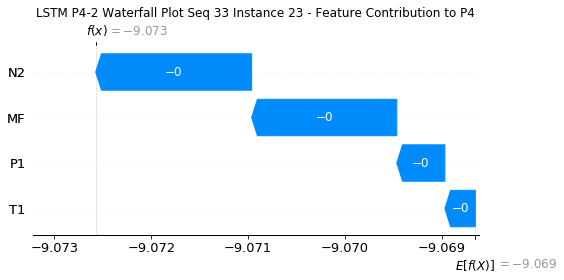

None

Contribution: [-9.87371653e-04  9.92779298e-05 -3.44425064e-03 -3.37147356e-03]


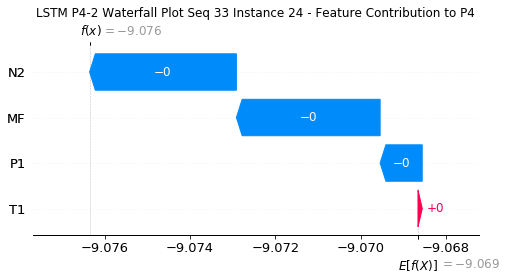

None

Contribution: [-0.01478444 -0.00281252 -0.055332   -0.05063719]


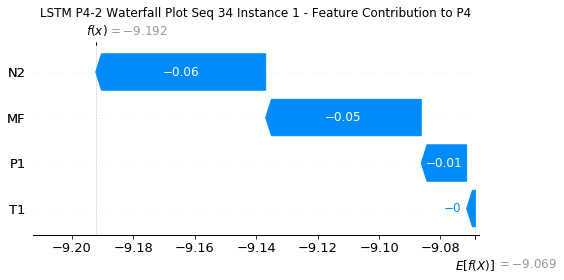

None

Contribution: [ 6.57239959e-05 -2.14130724e-04  6.48913885e-06  2.85296442e-04]


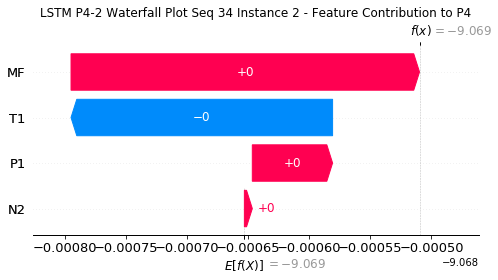

None

Contribution: [-0.00018039 -0.00011375 -0.0005811  -0.00052796]


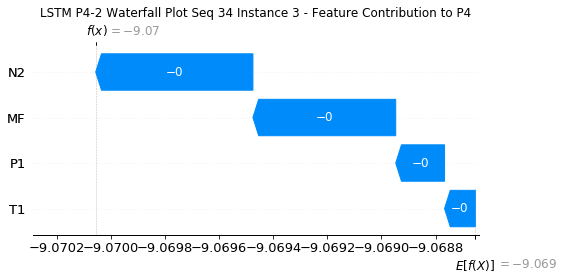

None

Contribution: [-1.31284230e-04 -9.54279871e-05 -4.28904336e-04 -3.99988440e-04]


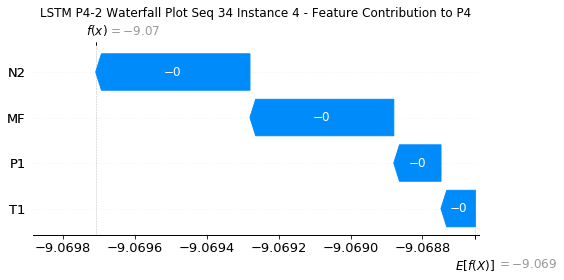

None

Contribution: [-7.64064026e-05 -5.60685336e-05 -2.50543983e-04 -2.31751123e-04]


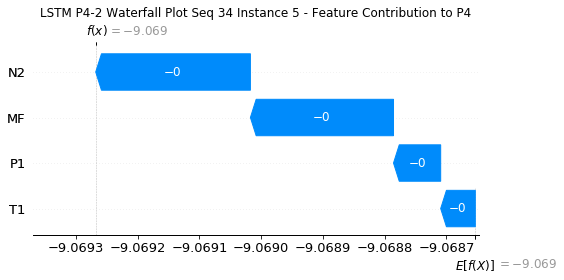

None

Contribution: [-6.09393777e-05 -4.47494665e-05 -2.03463325e-04 -1.86441576e-04]


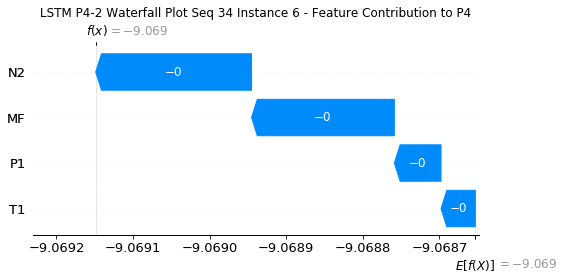

None

Contribution: [-5.91473570e-05 -4.34344880e-05 -1.94105661e-04 -1.77779840e-04]


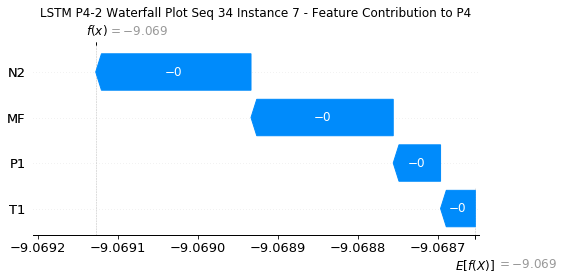

None

Contribution: [-5.70790392e-05 -4.26955850e-05 -1.90681991e-04 -1.74640472e-04]


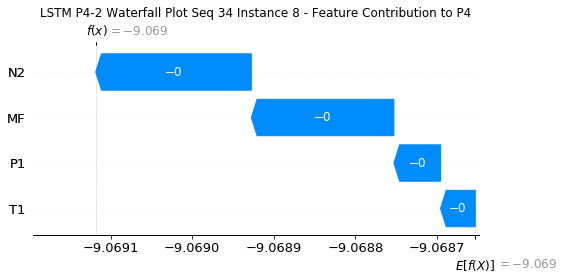

None

Contribution: [-5.50152542e-05 -4.17618300e-05 -1.90422136e-04 -1.72155238e-04]


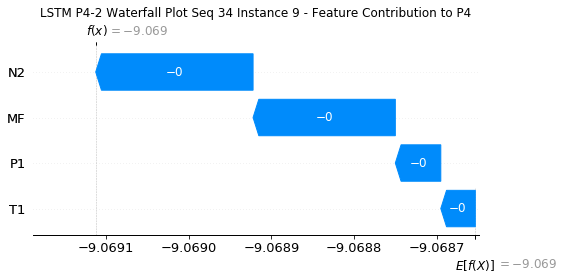

None

Contribution: [-5.66221795e-05 -4.26386653e-05 -1.93571899e-04 -1.73888208e-04]


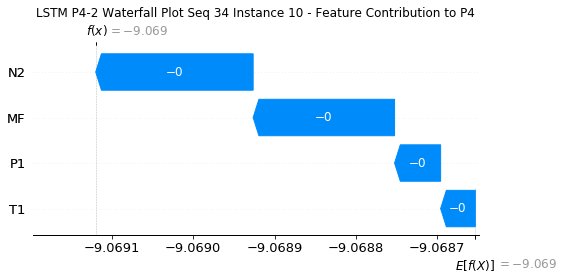

None

Contribution: [-6.03542761e-05 -4.36954195e-05 -1.98930064e-04 -1.80227026e-04]


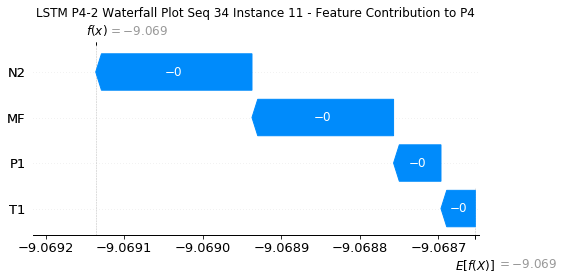

None

Contribution: [-6.19967595e-05 -4.48487728e-05 -2.03532191e-04 -1.84951062e-04]


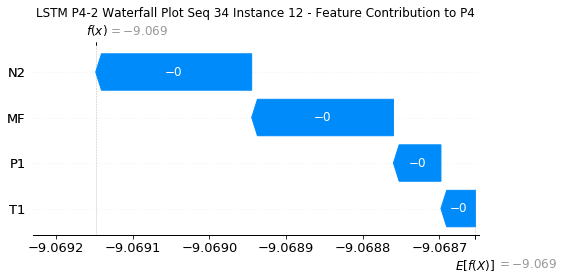

None

Contribution: [-6.23914176e-05 -4.69974135e-05 -2.07071511e-04 -1.86738285e-04]


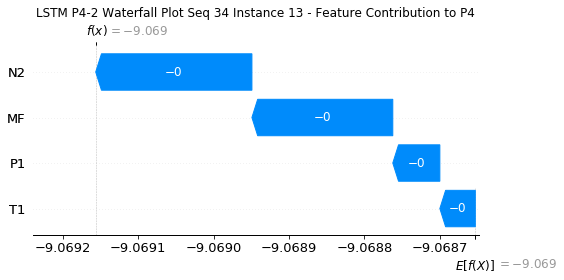

None

Contribution: [-6.38936930e-05 -4.61275253e-05 -2.10293082e-04 -1.90378961e-04]


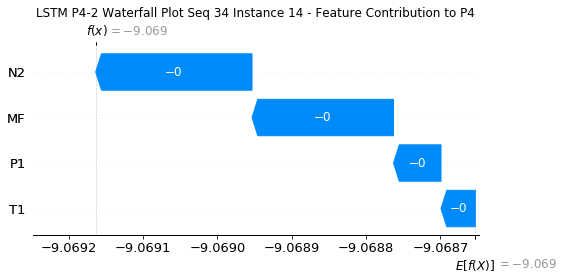

None

Contribution: [-6.37499230e-05 -4.56314114e-05 -2.13713335e-04 -1.91699993e-04]


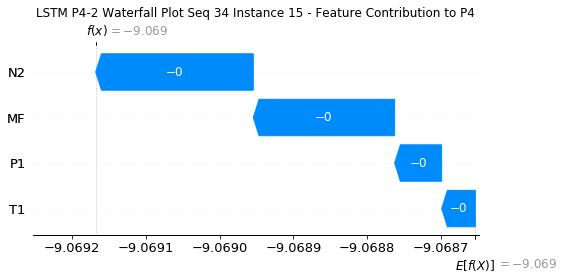

None

Contribution: [-6.72124428e-05 -4.81992196e-05 -2.20935375e-04 -1.99763441e-04]


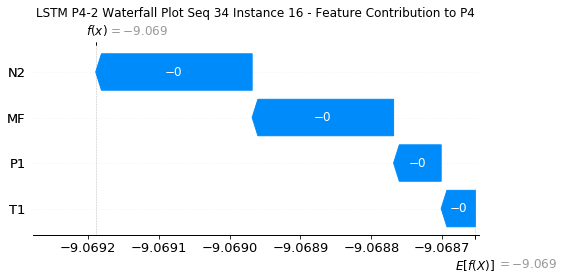

None

Contribution: [-7.03020031e-05 -5.02379241e-05 -2.31607253e-04 -2.09079330e-04]


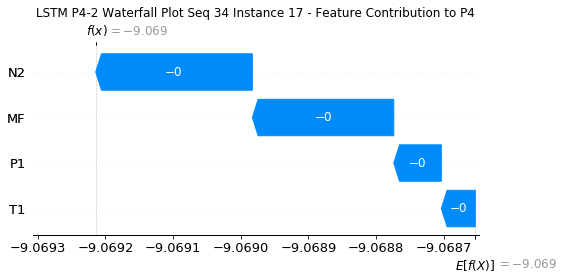

None

Contribution: [-7.67370933e-05 -5.62573198e-05 -2.49184146e-04 -2.27309201e-04]


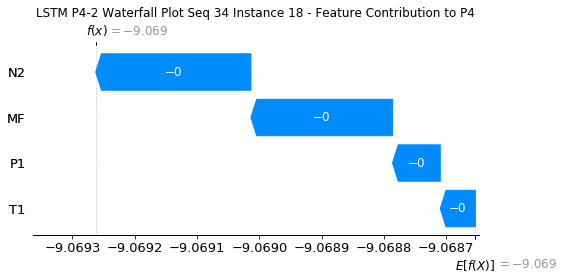

None

Contribution: [-8.54799671e-05 -6.11950430e-05 -2.77849929e-04 -2.52406495e-04]


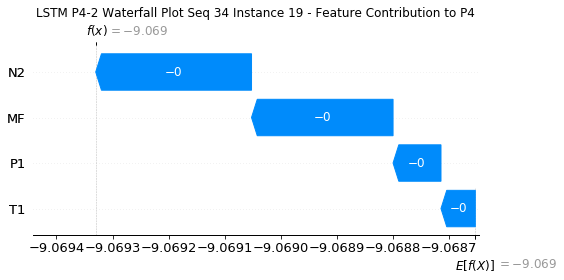

None

Contribution: [-1.03855034e-04 -7.50257571e-05 -3.37685041e-04 -3.06328437e-04]


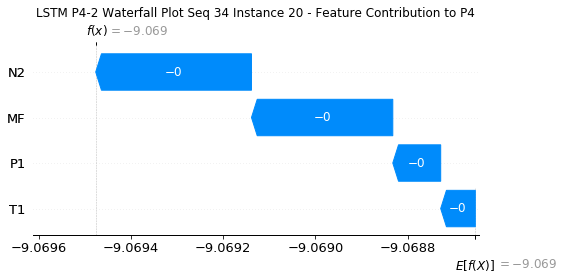

None

Contribution: [-0.00014746 -0.00010821 -0.00047783 -0.00043423]


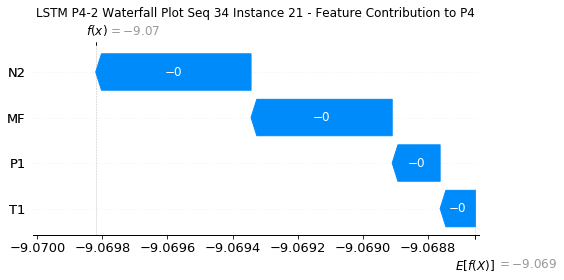

None

Contribution: [-0.00025225 -0.00018605 -0.00082288 -0.00074488]


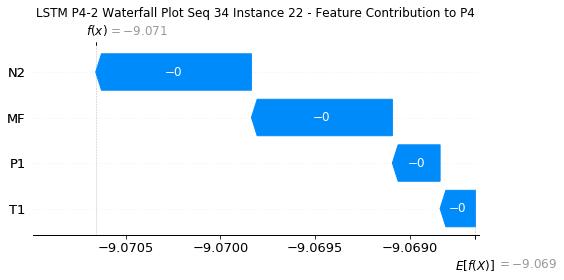

None

Contribution: [-0.0004923  -0.00030861 -0.00162119 -0.00148667]


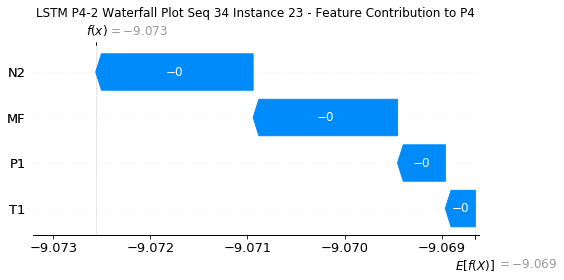

None

Contribution: [-0.00097775  0.00018922 -0.00346825 -0.00330846]


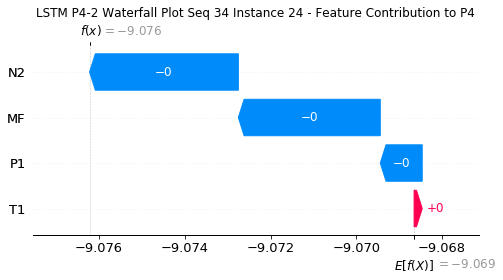

None

In [33]:
#Waterfall Plot for Local Accuracy & Consistency metrics
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM P4-2 Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to P4" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [34]:
#Define New LSTM without probabilistic layers for Consistency metrics

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 594)           1420848   
_________________________________________________________________
dense_5 (Dense)              (None, 24, 485)           288575    
_________________________________________________________________
dense_6 (Dense)              (None, 24, 1)             486       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 1,709,909
Trainable params: 1,709,909
Non-trainable params: 0
_________________________________________________________________


In [35]:
#Extract only weights for 3 variables excluding MF

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [36]:
#Transfer weights from previous LSTM to new LSTM with only Aleatoric Layer Output

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [37]:
#Load xtest and delete MF

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete MF

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [38]:
#Prediction with features excluding MF 

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [39]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [ 0.00701883  0.0421199  -0.11319408]


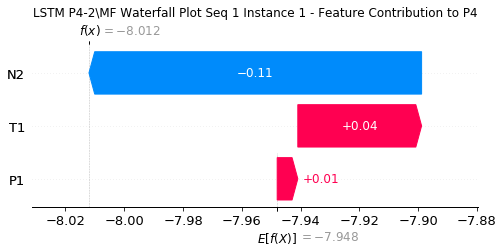

None

Contribution: [0.00273177 0.0050222  0.00492198]


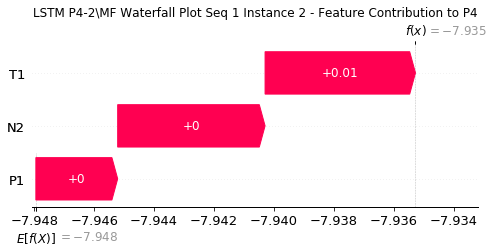

None

Contribution: [ 0.00022356  0.00061375 -0.00063917]


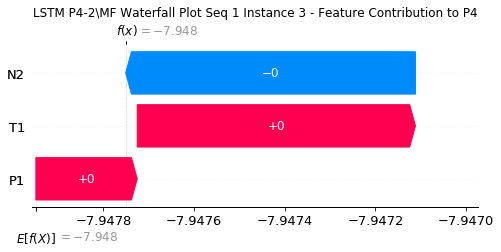

None

Contribution: [-5.34588795e-05 -5.74017012e-05 -3.88314482e-04]


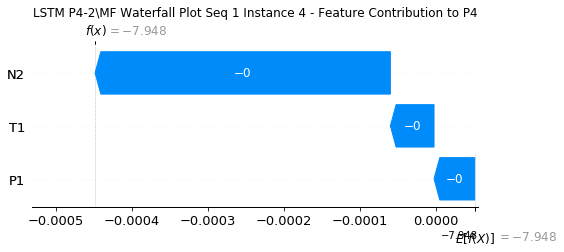

None

Contribution: [-5.19657462e-05 -5.84922434e-05 -2.67324257e-04]


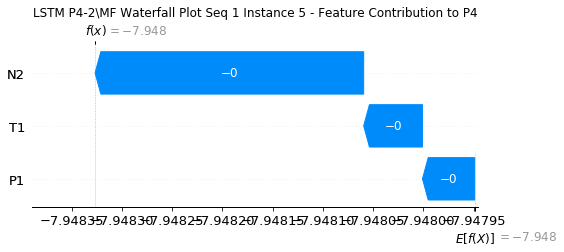

None

Contribution: [-4.26088243e-05 -5.46818435e-05 -2.25065153e-04]


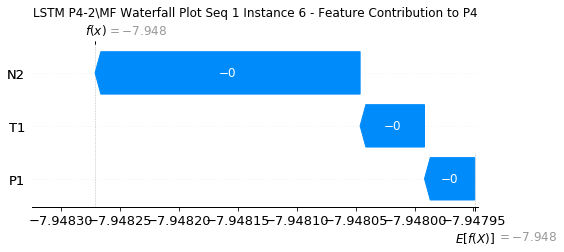

None

Contribution: [-4.37027053e-05 -5.29141012e-05 -2.20302647e-04]


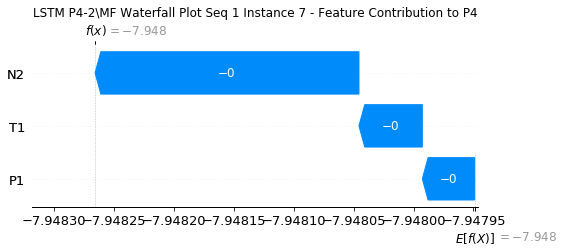

None

Contribution: [-3.64294542e-05 -6.00096713e-05 -2.14734217e-04]


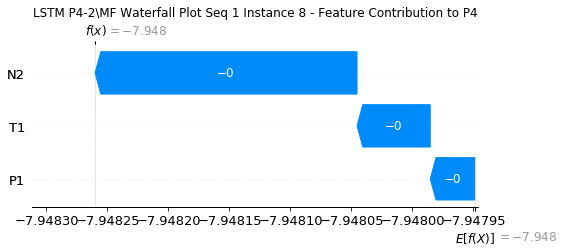

None

Contribution: [-4.20463804e-05 -5.69330093e-05 -2.21743515e-04]


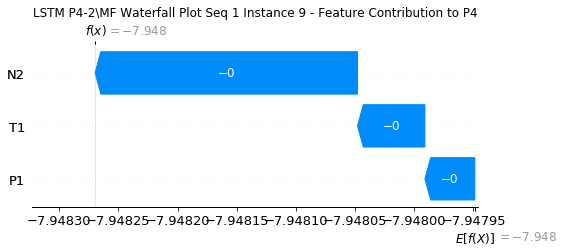

None

Contribution: [-4.33920453e-05 -4.75119406e-05 -2.30306479e-04]


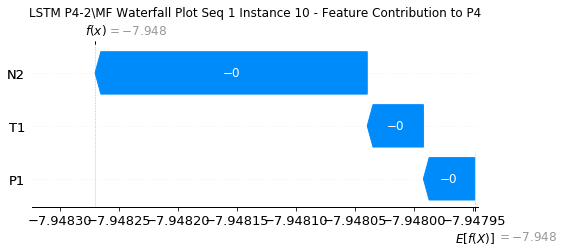

None

Contribution: [-5.25867456e-05 -4.86983078e-05 -2.48444595e-04]


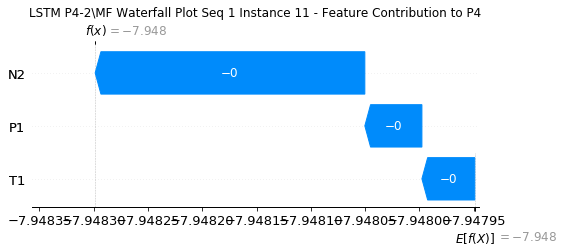

None

Contribution: [-6.53343264e-05 -4.66235864e-05 -2.73818716e-04]


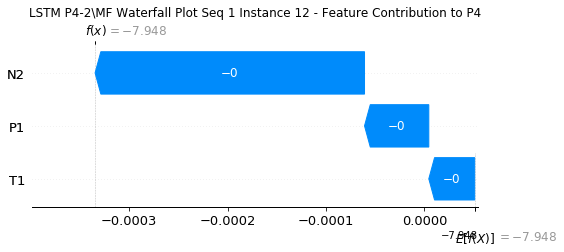

None

Contribution: [-6.91879340e-05 -6.06384423e-05 -3.01244745e-04]


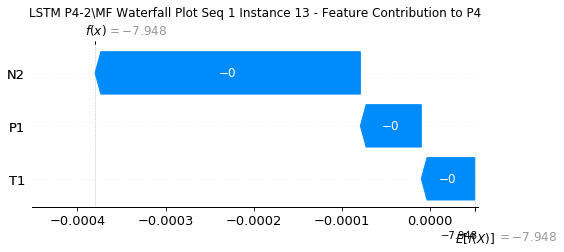

None

Contribution: [-6.47878323e-05 -6.42427483e-05 -3.31077581e-04]


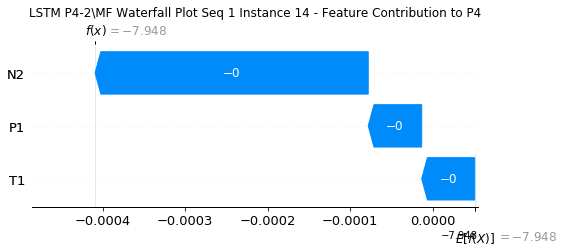

None

Contribution: [-8.94838599e-05 -7.38589647e-05 -3.67540158e-04]


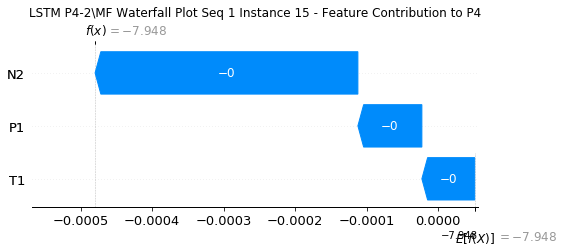

None

Contribution: [-1.00644330e-04 -8.53821487e-05 -4.07188724e-04]


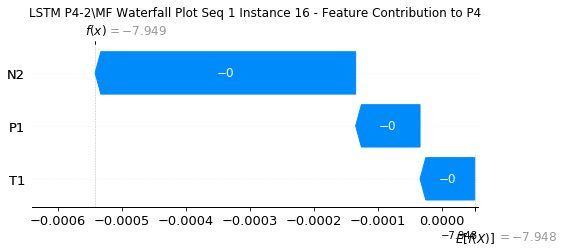

None

Contribution: [-1.00616869e-04 -9.47005594e-05 -4.57368745e-04]


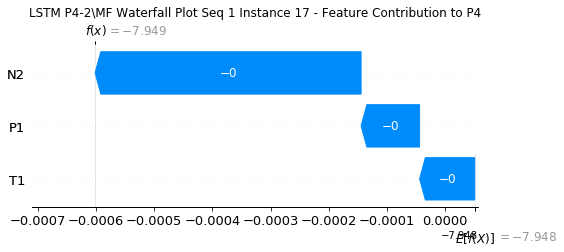

None

Contribution: [-1.26505551e-04 -9.66346135e-05 -5.11794544e-04]


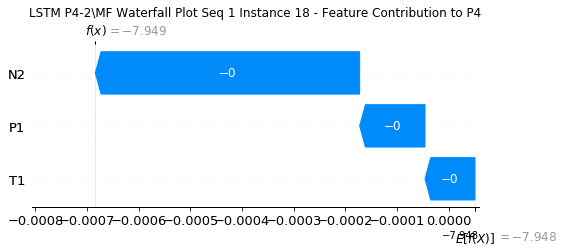

None

Contribution: [-1.40679447e-04 -8.52245716e-05 -5.99368053e-04]


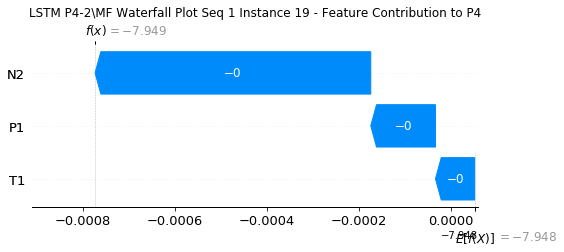

None

Contribution: [-1.57591229e-04 -4.76372403e-05 -7.55360795e-04]


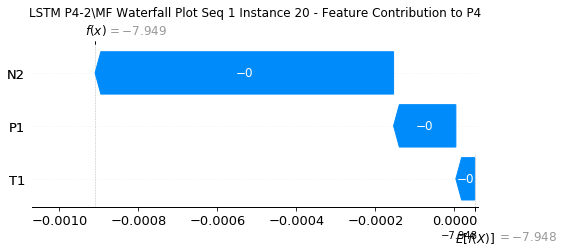

None

Contribution: [-1.54822117e-04  6.77463560e-05 -1.06136978e-03]


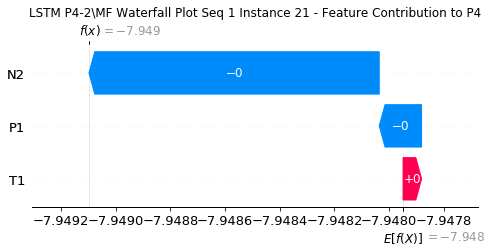

None

Contribution: [-0.00023018  0.00037674 -0.00167938]


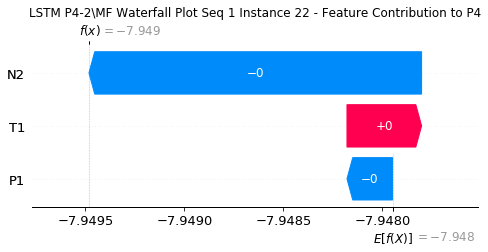

None

Contribution: [-0.00032291  0.00036586 -0.0031159 ]


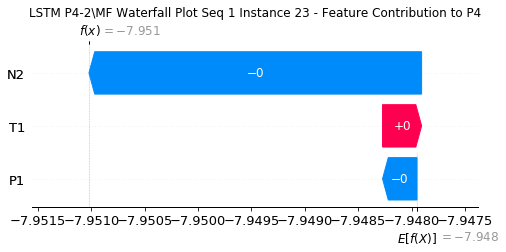

None

Contribution: [-0.00071505  0.00056485 -0.00581816]


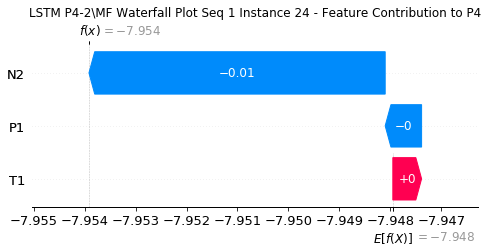

None

Contribution: [-0.0098861   0.01551301 -0.11269201]


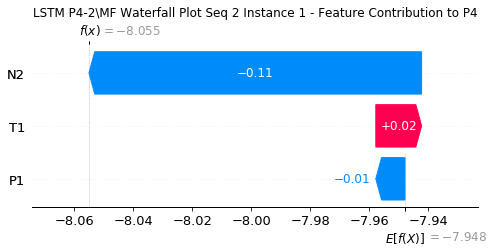

None

Contribution: [0.00238498 0.00385436 0.00482544]


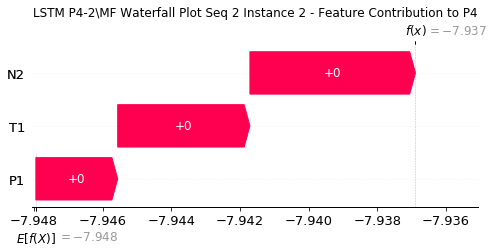

None

Contribution: [ 7.93387873e-05  2.37361513e-04 -6.16269699e-04]


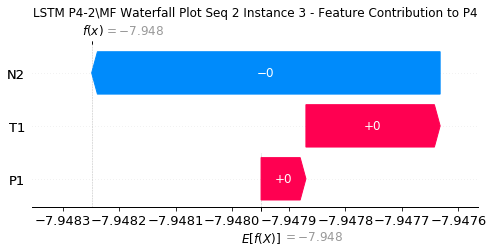

None

Contribution: [-7.59620001e-05 -1.19790358e-04 -3.82005573e-04]


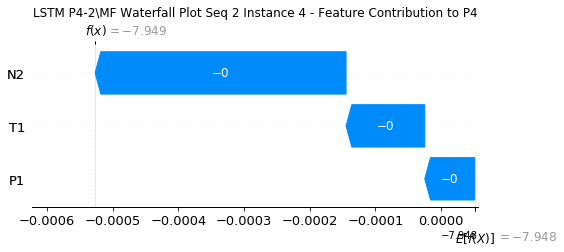

None

Contribution: [-6.11383416e-05 -9.11528744e-05 -2.58301713e-04]


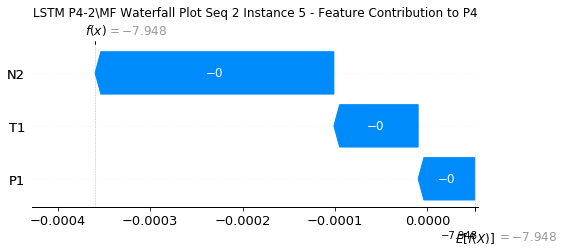

None

Contribution: [-5.21795738e-05 -8.11609794e-05 -2.23033184e-04]


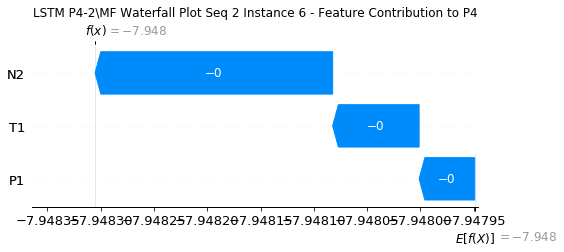

None

Contribution: [-4.73715677e-05 -6.66687587e-05 -2.13211679e-04]


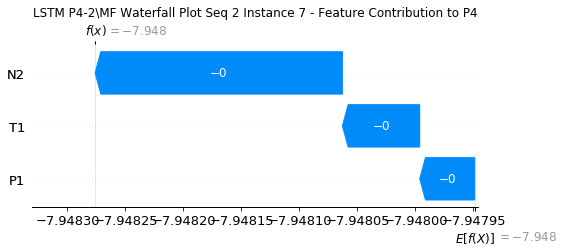

None

Contribution: [-4.42420819e-05 -6.43516655e-05 -2.08256323e-04]


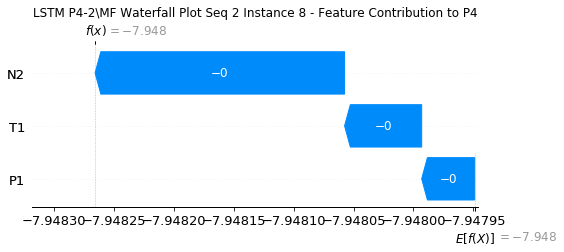

None

Contribution: [-5.14405055e-05 -6.09350780e-05 -2.14039160e-04]


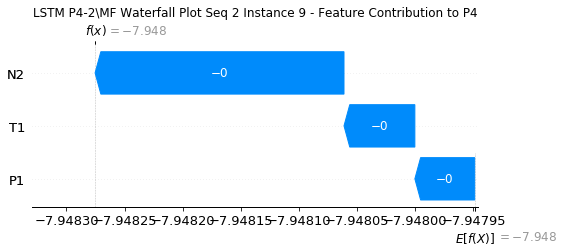

None

Contribution: [-5.00844834e-05 -7.42150766e-05 -2.26231776e-04]


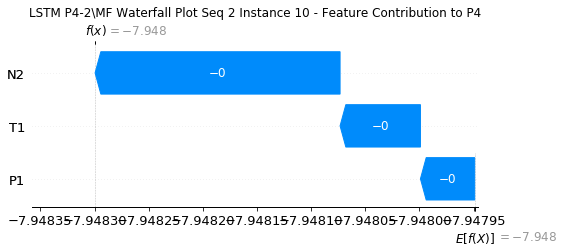

None

Contribution: [-5.75801632e-05 -7.68706799e-05 -2.44196603e-04]


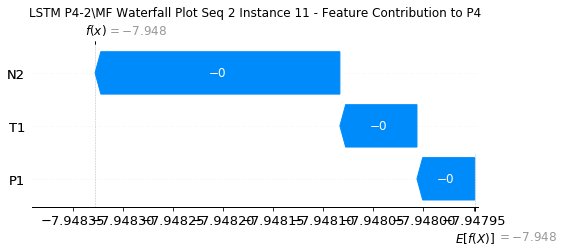

None

Contribution: [-6.67110321e-05 -6.65254902e-05 -2.67992712e-04]


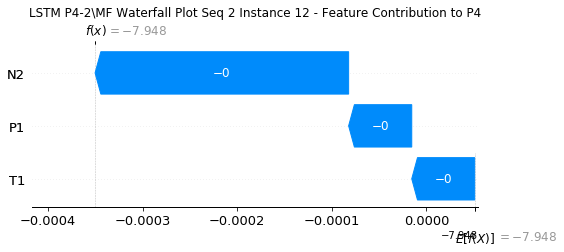

None

Contribution: [-7.33330945e-05 -8.37493732e-05 -2.94630450e-04]


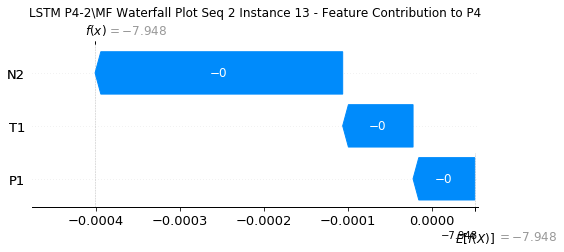

None

Contribution: [-7.03224995e-05 -9.01658718e-05 -3.24842442e-04]


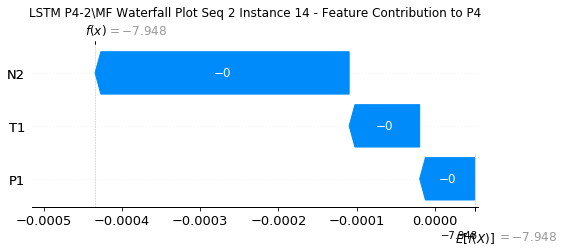

None

Contribution: [-9.10116071e-05 -9.99669290e-05 -3.57948349e-04]


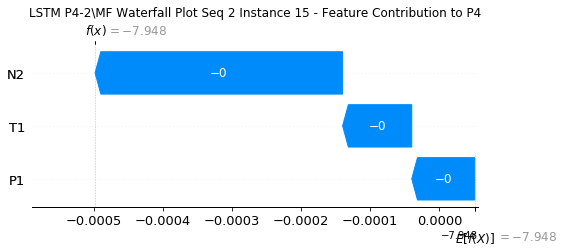

None

Contribution: [-0.00010235 -0.00011571 -0.00039605]


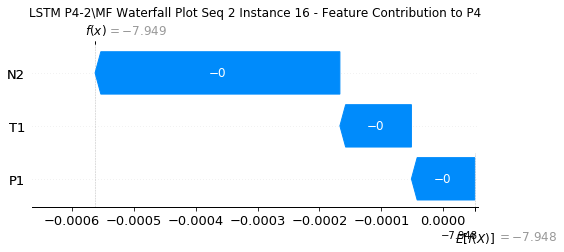

None

Contribution: [-9.95168786e-05 -1.11232875e-04 -4.40730246e-04]


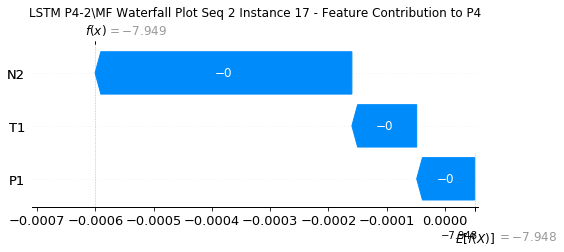

None

Contribution: [-0.0001264  -0.0001282  -0.00049696]


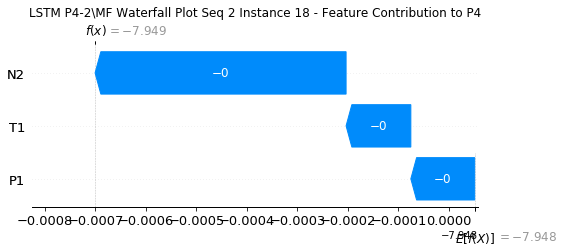

None

Contribution: [-0.00014175 -0.00013199 -0.00057923]


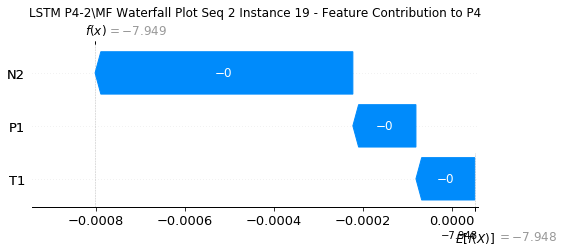

None

Contribution: [-1.61754010e-04 -9.94817504e-05 -7.25855085e-04]


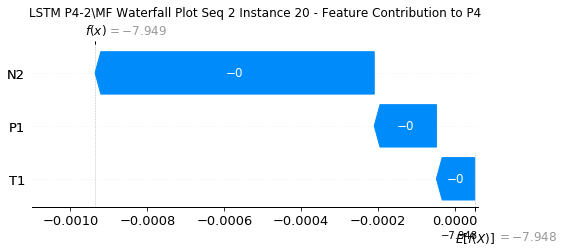

None

Contribution: [-1.67851395e-04 -5.49059855e-05 -1.00120932e-03]


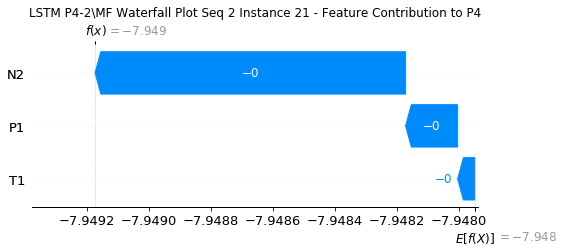

None

Contribution: [-2.62700218e-04  1.42692087e-05 -1.54180033e-03]


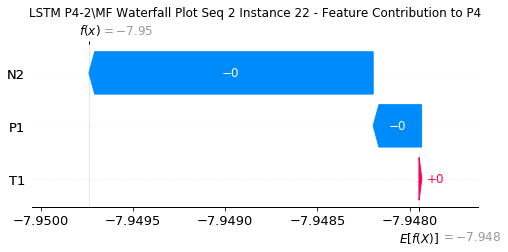

None

Contribution: [-0.0001282   0.00051232 -0.00278531]


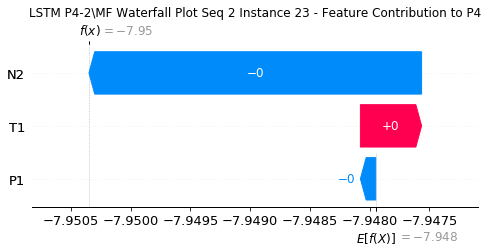

None

Contribution: [-0.00035122  0.00370212 -0.00570992]


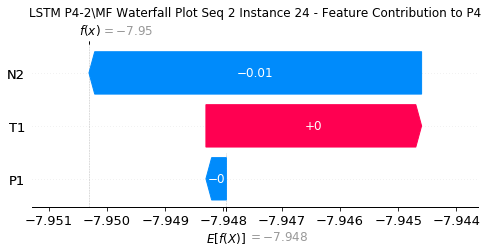

None

Contribution: [ 0.00212069  0.12717401 -0.11512261]


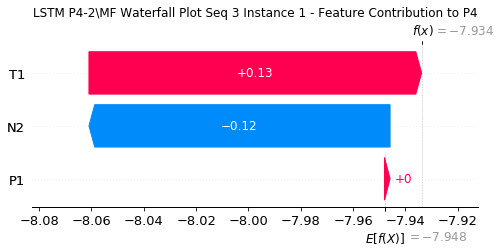

None

Contribution: [0.00271819 0.00673523 0.00535403]


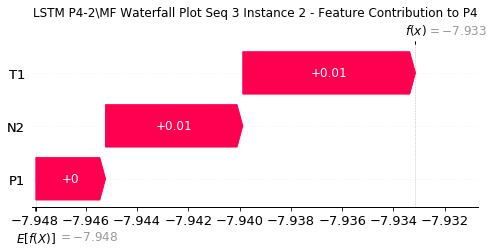

None

Contribution: [ 0.0001938   0.00187625 -0.00056805]


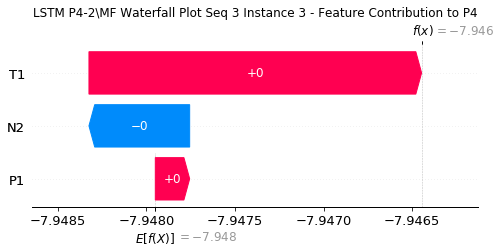

None

Contribution: [-5.28830125e-05  1.69306873e-04 -3.80107439e-04]


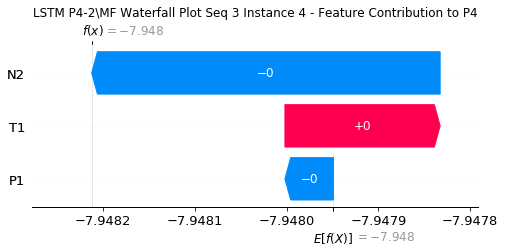

None

Contribution: [-4.62909805e-05  6.61733995e-05 -2.62184746e-04]


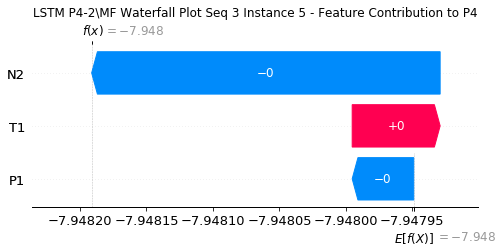

None

Contribution: [-3.82911055e-05  5.55848742e-05 -2.16442156e-04]


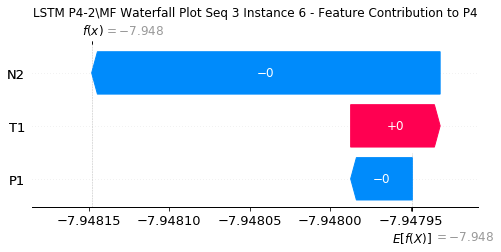

None

Contribution: [-2.66339487e-05  6.05949284e-05 -2.03975027e-04]


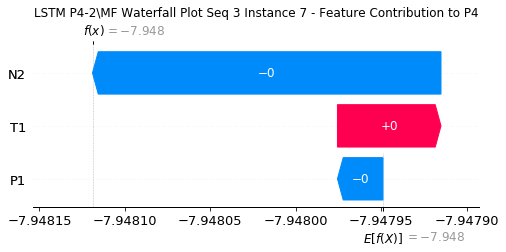

None

Contribution: [-3.72740334e-05  8.48656006e-05 -1.98867061e-04]


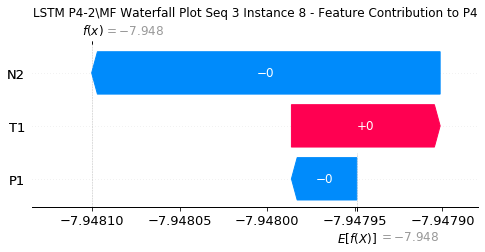

None

Contribution: [-3.14265309e-05  6.87898147e-05 -2.05643252e-04]


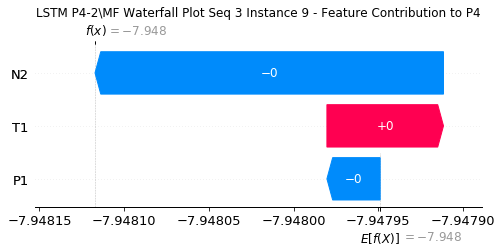

None

Contribution: [-3.67214462e-05  5.85724206e-05 -2.20840421e-04]


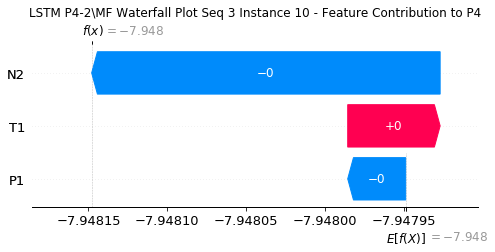

None

Contribution: [-4.53360976e-05  5.57380500e-05 -2.39677201e-04]


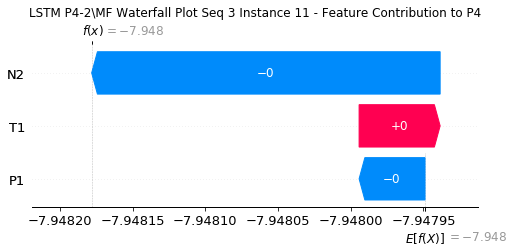

None

Contribution: [-5.44957515e-05  6.13035602e-05 -2.63650490e-04]


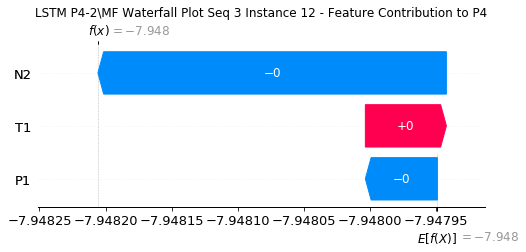

None

Contribution: [-6.13986948e-05  4.76324766e-05 -2.95130659e-04]


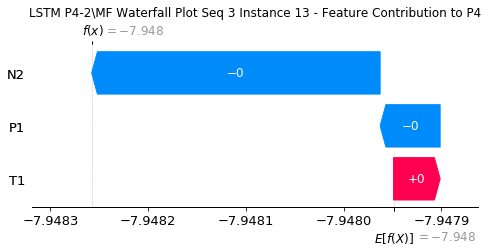

None

Contribution: [-6.72336806e-05  4.04824214e-05 -3.27080448e-04]


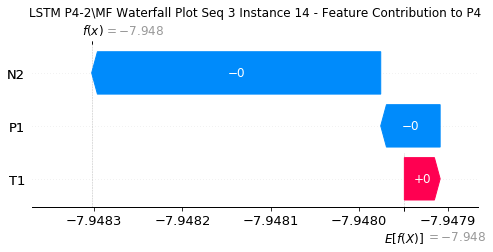

None

Contribution: [-7.97545053e-05  4.38679898e-05 -3.64996911e-04]


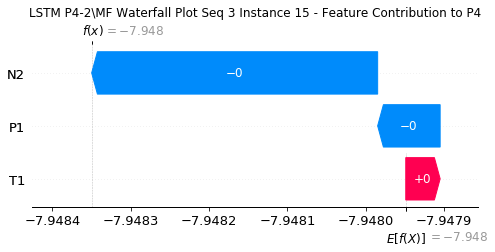

None

Contribution: [-9.15714079e-05  4.57692004e-05 -4.06201070e-04]


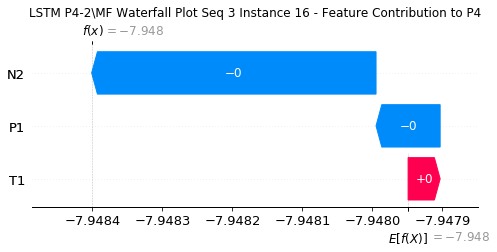

None

Contribution: [-9.92239697e-05  5.57948559e-05 -4.53072264e-04]


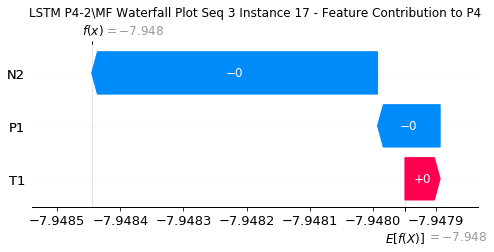

None

Contribution: [-1.09485547e-04  8.38848832e-05 -5.11208204e-04]


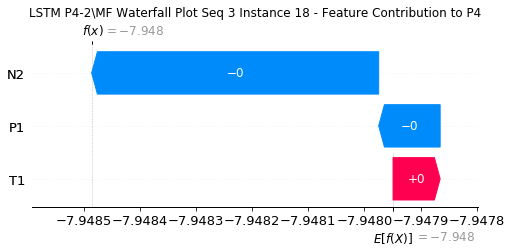

None

Contribution: [-0.00011687  0.00018142 -0.00059548]


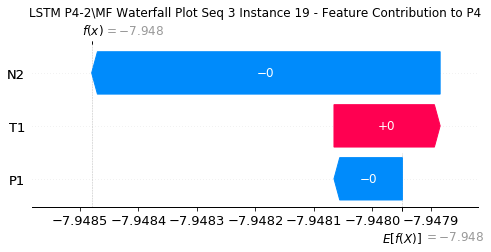

None

Contribution: [-0.0001158   0.00039078 -0.00074041]


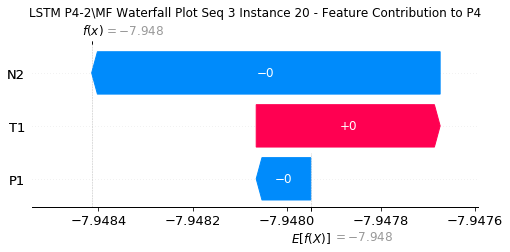

None

Contribution: [-8.31678258e-05  9.29491268e-04 -1.02146307e-03]


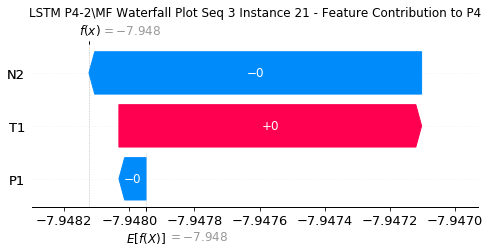

None

Contribution: [-0.00011624  0.00208377 -0.00158008]


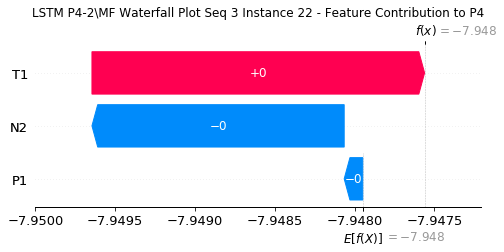

None

Contribution: [-0.00019883  0.00457488 -0.00288914]


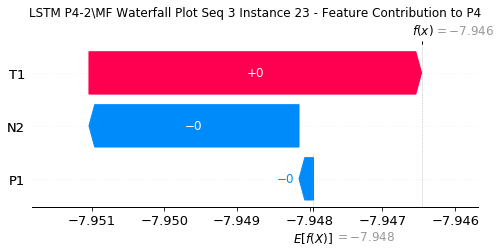

None

Contribution: [-0.00027698  0.00808927 -0.00559224]


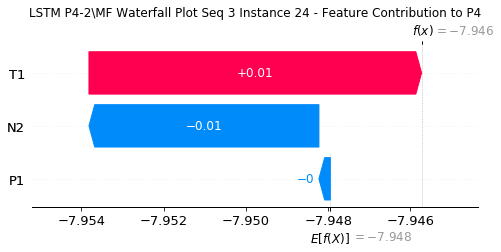

None

Contribution: [ 0.00903031  0.20098625 -0.10563619]


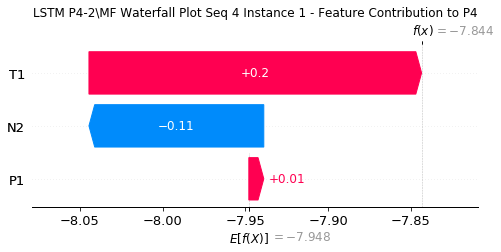

None

Contribution: [0.00290057 0.0078979  0.005911  ]


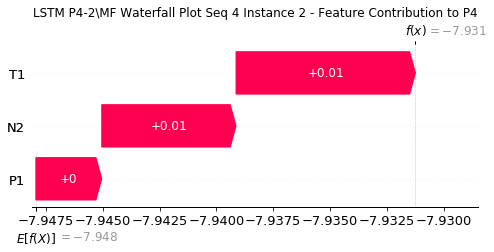

None

Contribution: [ 0.00020863  0.00196816 -0.00049682]


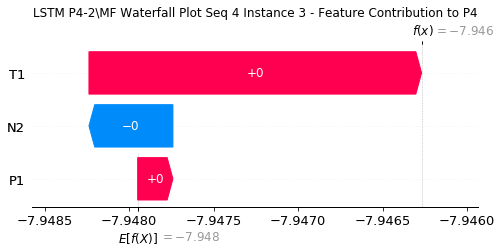

None

Contribution: [-4.34822034e-05  2.06931870e-04 -3.70669309e-04]


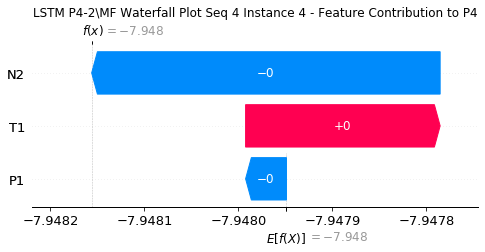

None

Contribution: [-4.35594184e-05  5.97099605e-05 -2.50969911e-04]


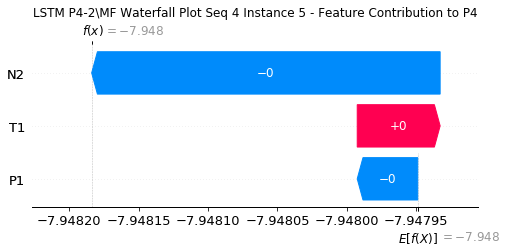

None

Contribution: [-3.36164246e-05  7.93394000e-05 -2.09391114e-04]


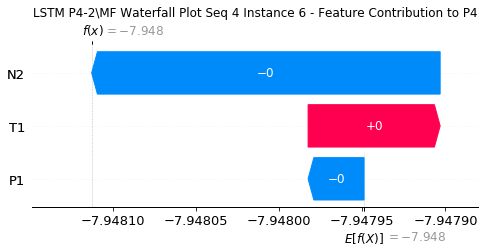

None

Contribution: [-3.39485292e-05  8.82439420e-05 -2.01523878e-04]


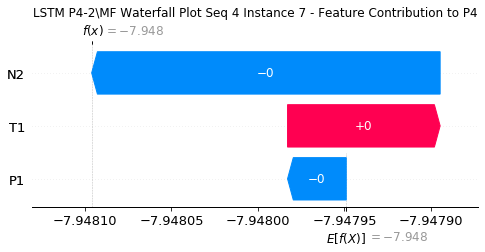

None

Contribution: [-2.97205105e-05  9.49010509e-05 -1.97308757e-04]


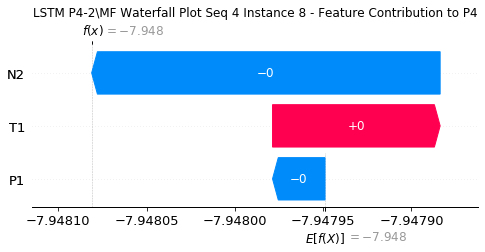

None

Contribution: [-2.62460148e-05  8.02601572e-05 -2.03062817e-04]


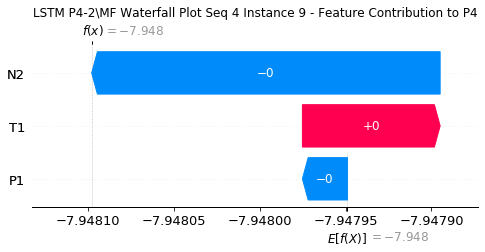

None

Contribution: [-3.31657066e-05  8.11792107e-05 -2.16585580e-04]


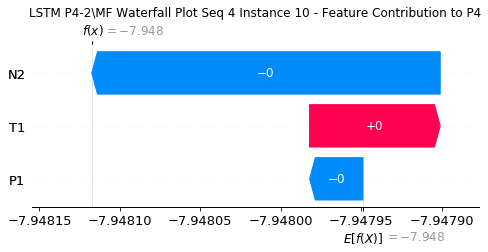

None

Contribution: [-4.47303313e-05  8.30323765e-05 -2.35867301e-04]


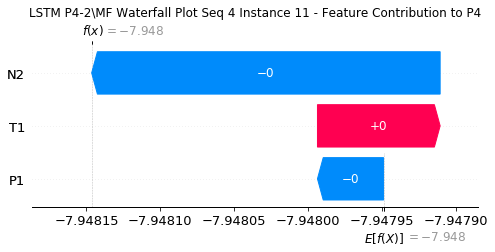

None

Contribution: [-3.47722809e-05  1.01012228e-04 -2.60777511e-04]


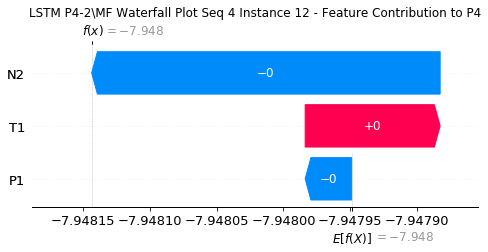

None

Contribution: [-6.04342040e-05  7.72850154e-05 -2.93934940e-04]


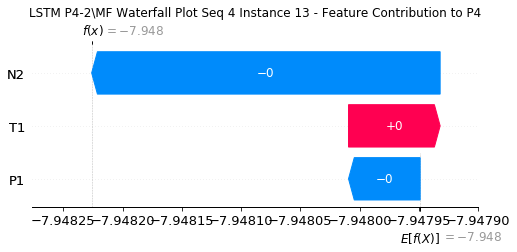

None

Contribution: [-6.86558577e-05  8.60649899e-05 -3.31000667e-04]


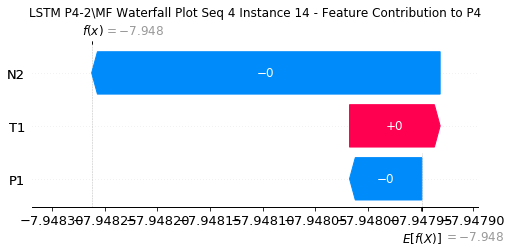

None

Contribution: [-8.22401709e-05  7.95771947e-05 -3.68106773e-04]


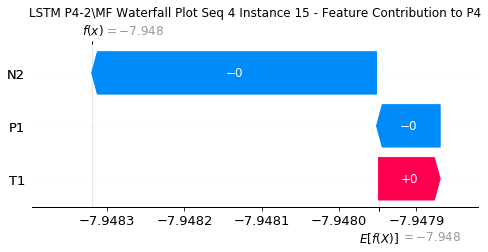

None

Contribution: [-9.28238382e-05  8.05724031e-05 -4.11670814e-04]


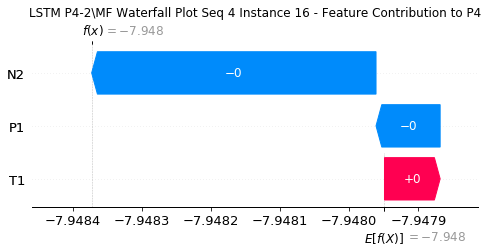

None

Contribution: [-1.06102310e-04  9.69535085e-05 -4.62706440e-04]


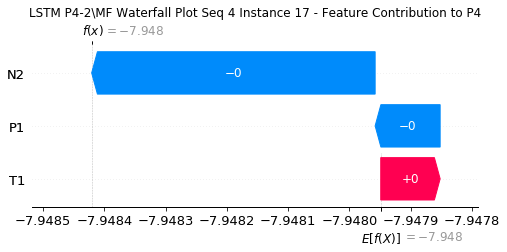

None

Contribution: [-0.00011606  0.00014403 -0.00051969]


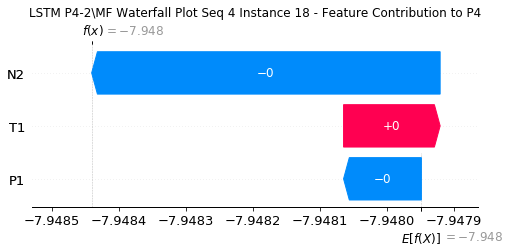

None

Contribution: [-0.00012251  0.00025745 -0.00060673]


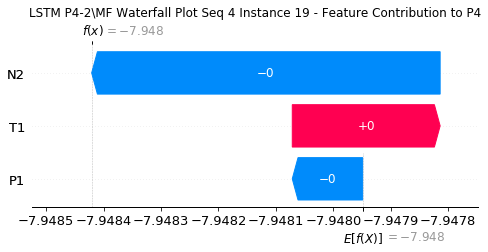

None

Contribution: [-0.00012015  0.00051094 -0.00075438]


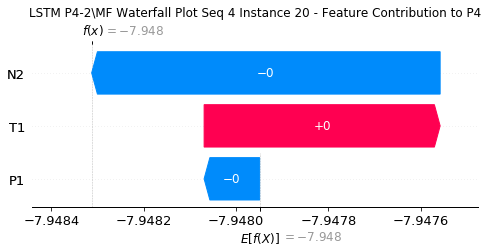

None

Contribution: [-7.25882217e-05  1.09768740e-03 -1.04779128e-03]


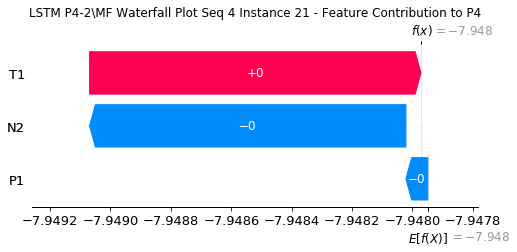

None

Contribution: [-8.31804888e-05  2.35884164e-03 -1.59793835e-03]


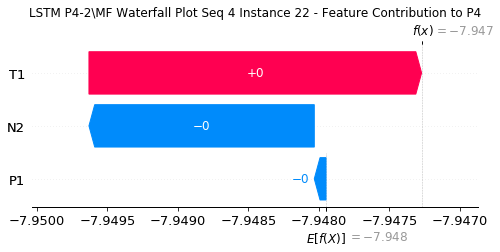

None

Contribution: [-0.00024856  0.0043577  -0.00291024]


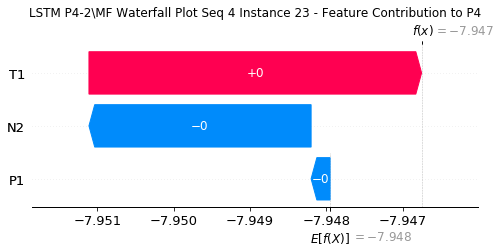

None

Contribution: [-0.00045526  0.00830769 -0.00585312]


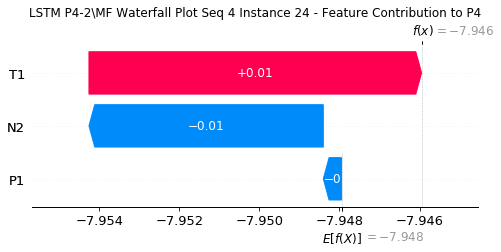

None

Contribution: [ 0.00198902  0.22242308 -0.10862353]


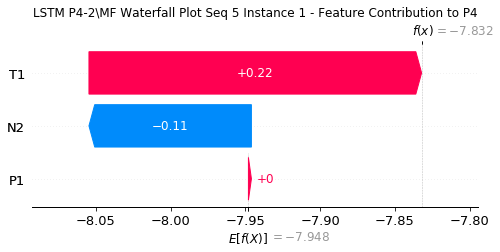

None

Contribution: [0.00278232 0.00870885 0.00596068]


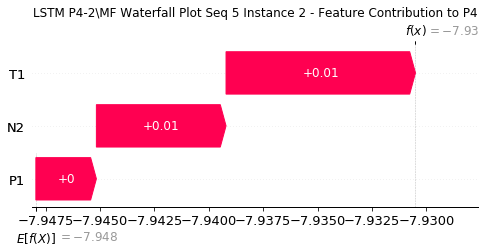

None

Contribution: [ 0.00022208  0.00251235 -0.00053033]


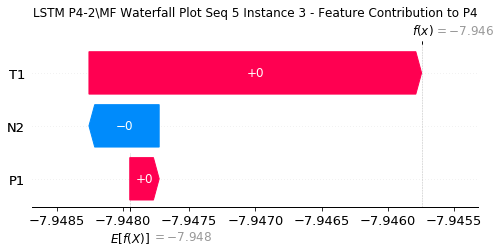

None

Contribution: [-4.35369210e-05  3.01303685e-04 -3.75459930e-04]


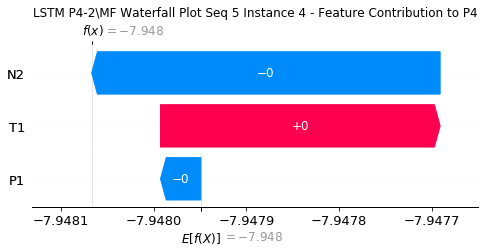

None

Contribution: [-4.72915751e-05  1.52950804e-04 -2.50262522e-04]


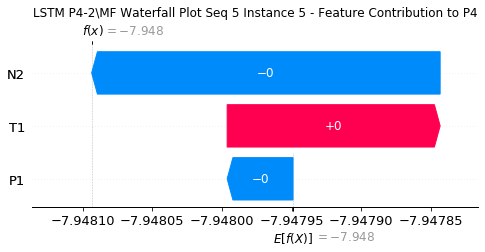

None

Contribution: [-3.24501000e-05  1.22533522e-04 -2.10249281e-04]


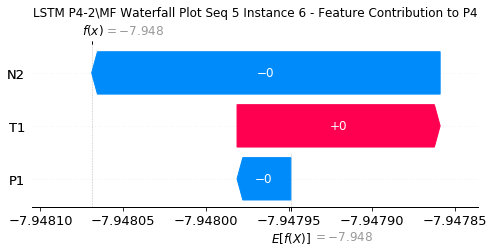

None

Contribution: [-2.92294038e-05  1.23731228e-04 -2.02238310e-04]


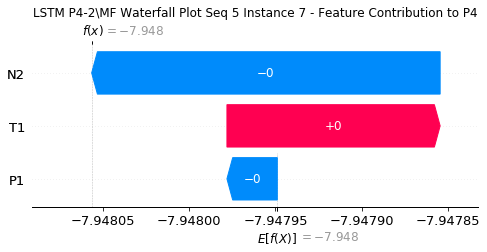

None

Contribution: [-1.84287054e-05  1.22892872e-04 -1.94759838e-04]


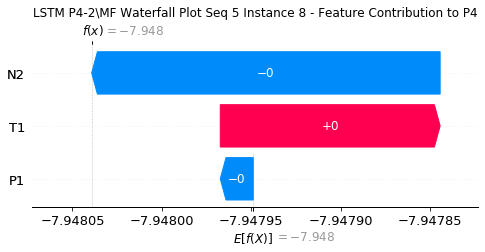

None

Contribution: [-2.86260259e-05  1.05309020e-04 -2.04222702e-04]


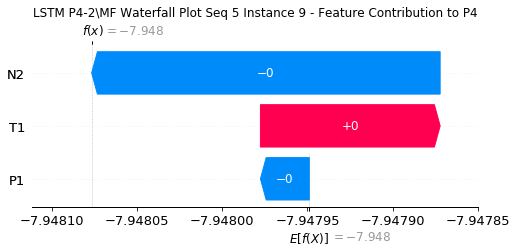

None

Contribution: [-3.55147243e-05  1.05091781e-04 -2.17465462e-04]


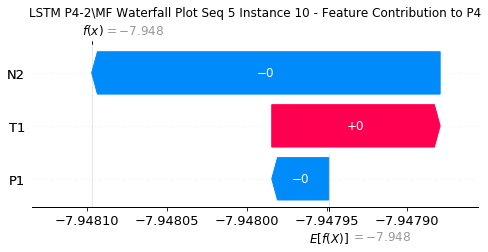

None

Contribution: [-4.54444867e-05  1.07662171e-04 -2.36748776e-04]


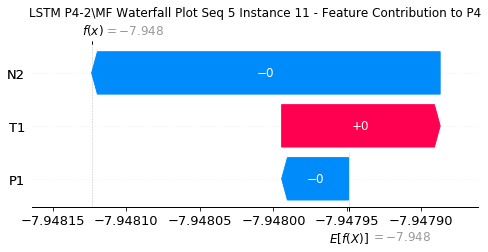

None

Contribution: [-4.29670306e-05  1.00387466e-04 -2.63750856e-04]


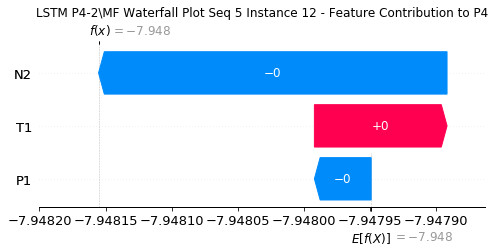

None

Contribution: [-6.26890751e-05  9.55821647e-05 -2.95626082e-04]


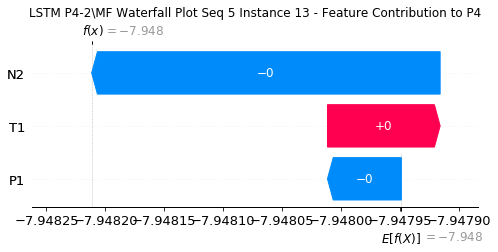

None

Contribution: [-7.02088886e-05  9.10429975e-05 -3.29257229e-04]


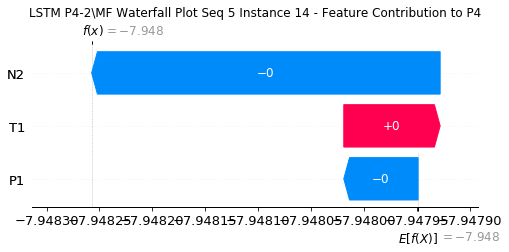

None

Contribution: [-8.37529339e-05  9.77107469e-05 -3.69893113e-04]


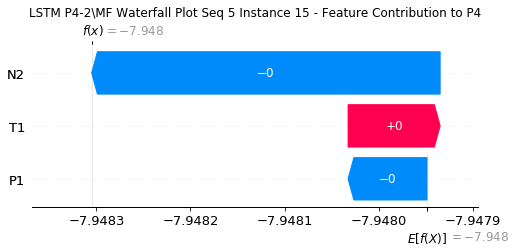

None

Contribution: [-9.30443698e-05  1.01908911e-04 -4.13142820e-04]


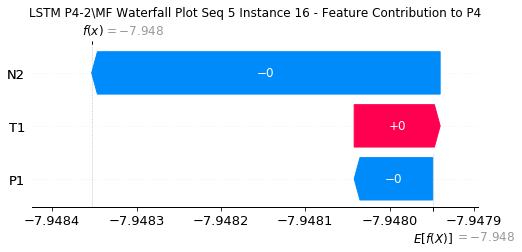

None

Contribution: [-8.72828283e-05  1.33018870e-04 -4.61394069e-04]


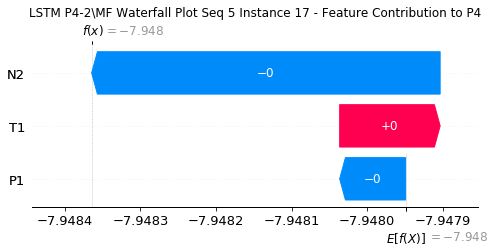

None

Contribution: [-0.00010954  0.00017687 -0.00052182]


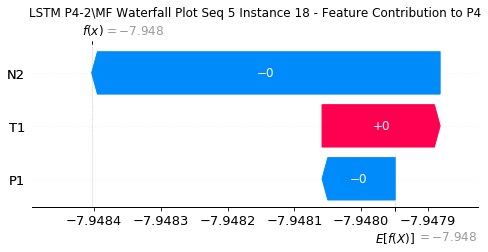

None

Contribution: [-0.00011351  0.00030155 -0.00060908]


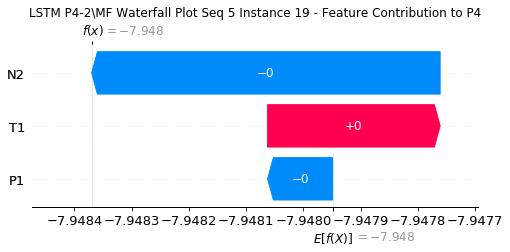

None

Contribution: [-0.00010587  0.00056131 -0.00075887]


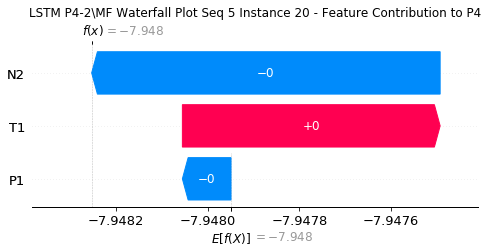

None

Contribution: [-6.04569706e-05  1.16486074e-03 -1.05162595e-03]


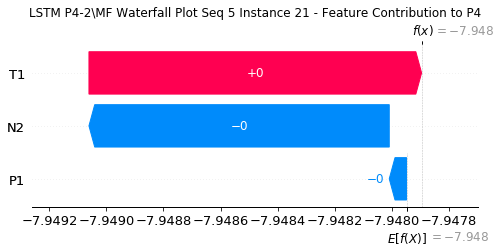

None

Contribution: [-4.70238748e-05  2.47462069e-03 -1.60375833e-03]


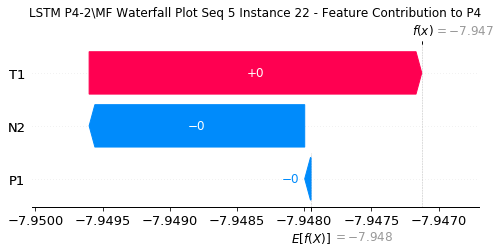

None

Contribution: [ 5.42332601e-05  4.39407631e-03 -2.88047420e-03]


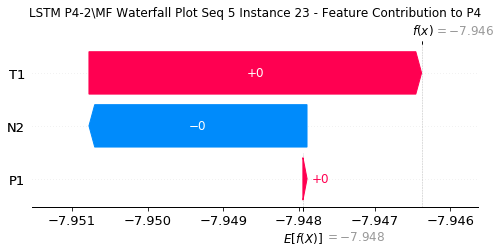

None

Contribution: [ 8.95822593e-07  8.44884721e-03 -5.84000879e-03]


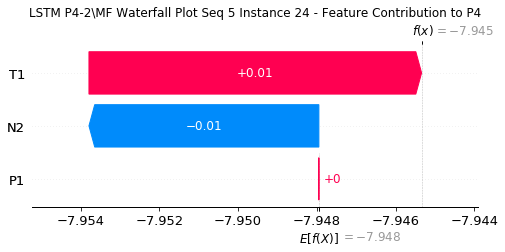

None

Contribution: [ 0.00941364  0.20191776 -0.1101303 ]


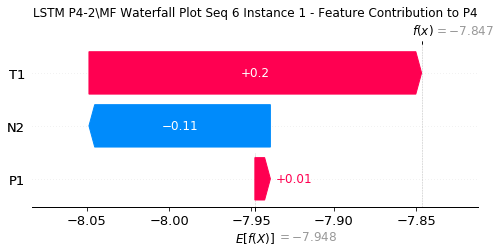

None

Contribution: [0.00278277 0.00830141 0.00584076]


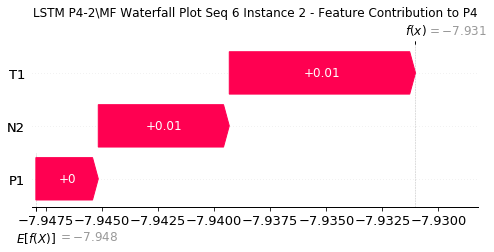

None

Contribution: [ 0.00026503  0.00213418 -0.00047991]


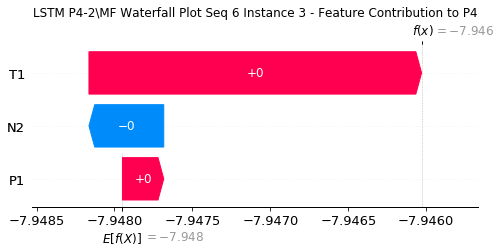

None

Contribution: [-3.98903714e-05  2.33959754e-04 -3.68274560e-04]


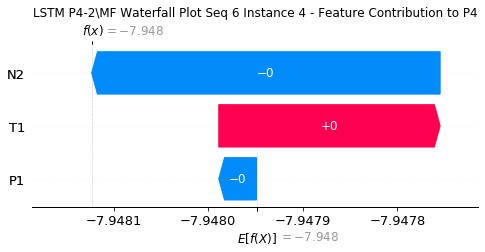

None

Contribution: [-2.57243115e-05  1.06289854e-04 -2.45743395e-04]


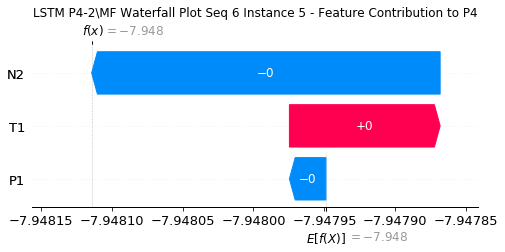

None

Contribution: [-3.14762584e-05  8.92296125e-05 -2.08218899e-04]


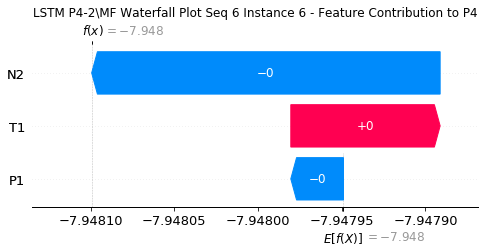

None

Contribution: [-2.31854332e-05  9.48467092e-05 -1.98834944e-04]


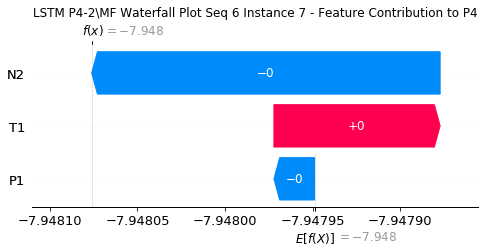

None

Contribution: [-1.48881689e-05  8.46721398e-05 -1.97671253e-04]


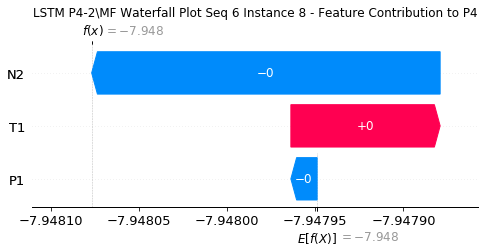

None

Contribution: [-2.83710644e-05  8.70011451e-05 -2.05199019e-04]


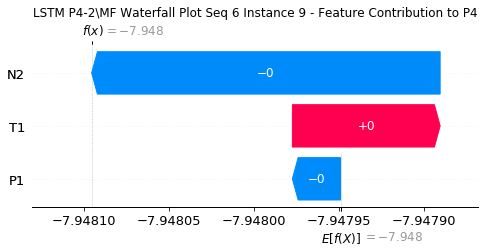

None

Contribution: [-3.26062526e-05  8.39988999e-05 -2.17825221e-04]


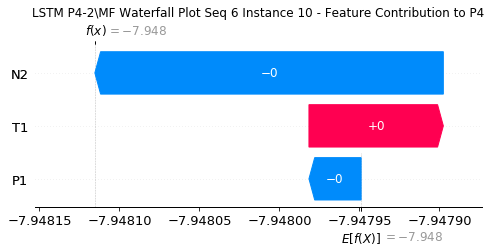

None

Contribution: [-4.25756013e-05  8.35772310e-05 -2.36392245e-04]


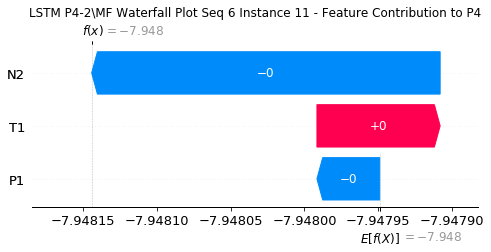

None

Contribution: [-5.97225763e-05  8.06088203e-05 -2.63125354e-04]


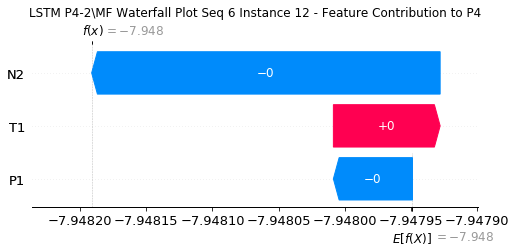

None

Contribution: [-6.04469473e-05  7.26965812e-05 -2.95654239e-04]


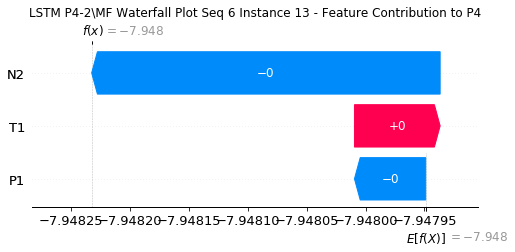

None

Contribution: [-6.62972293e-05  7.82193626e-05 -3.24610011e-04]


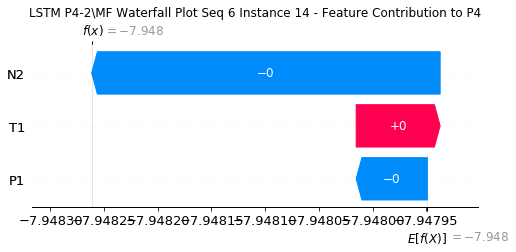

None

Contribution: [-8.18974108e-05  7.14619870e-05 -3.68943975e-04]


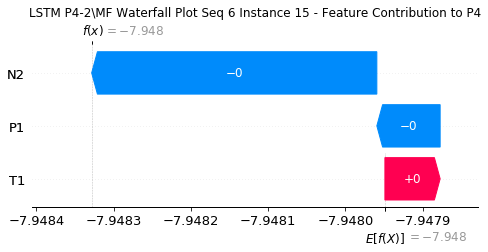

None

Contribution: [-9.63473425e-05  6.97704710e-05 -4.12778608e-04]


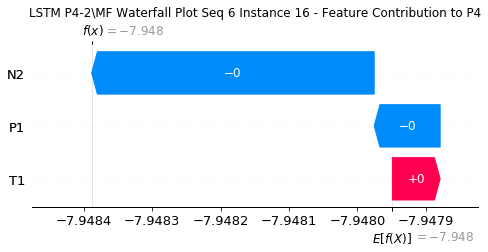

None

Contribution: [-9.26702199e-05  7.72531989e-05 -4.62400391e-04]


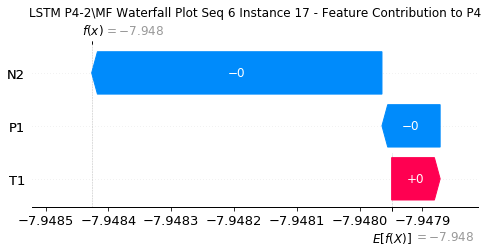

None

Contribution: [-0.00011658  0.00011639 -0.00052015]


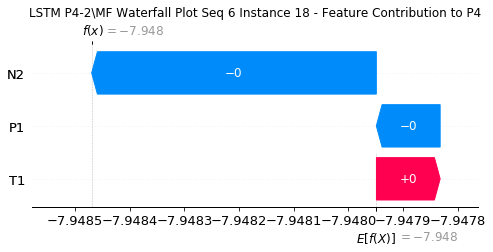

None

Contribution: [-0.00012931  0.00021466 -0.00060893]


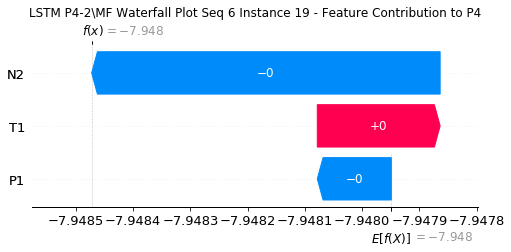

None

Contribution: [-0.00013298  0.00042178 -0.00076297]


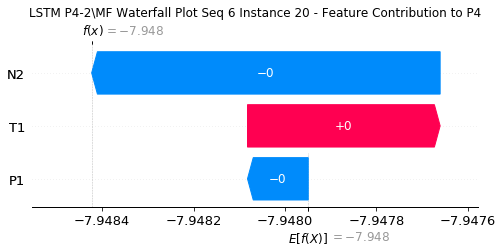

None

Contribution: [-0.00012344  0.00093997 -0.00106939]


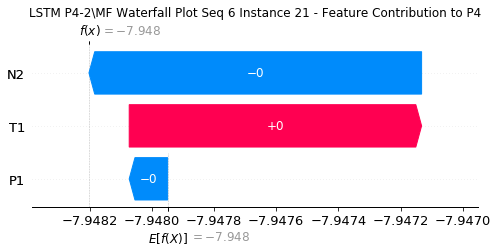

None

Contribution: [-0.00016074  0.00203616 -0.00164041]


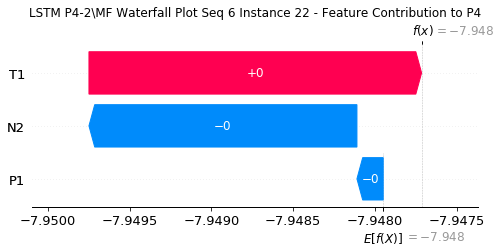

None

Contribution: [-0.00010116  0.00380829 -0.0029705 ]


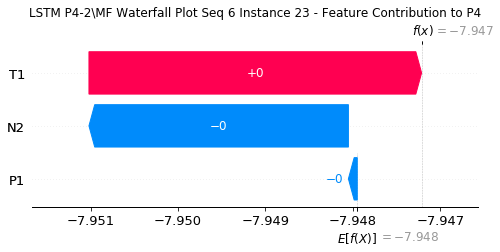

None

Contribution: [-0.00053034  0.00696213 -0.00599561]


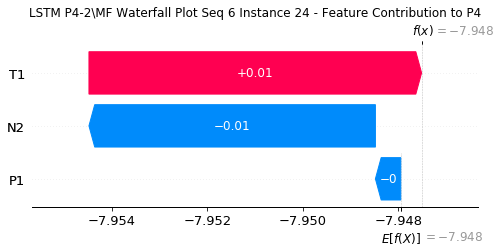

None

Contribution: [ 0.0048547   0.17250682 -0.11374895]


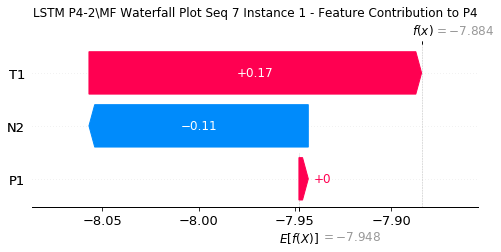

None

Contribution: [0.00280464 0.00809887 0.00571379]


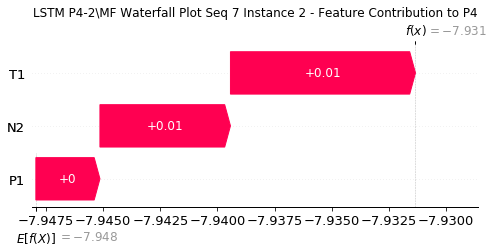

None

Contribution: [ 0.00020367  0.0022811  -0.00051274]


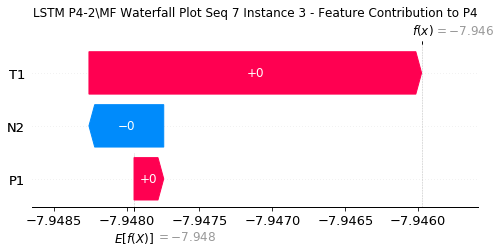

None

Contribution: [-4.99412324e-05  2.55917760e-04 -3.74796482e-04]


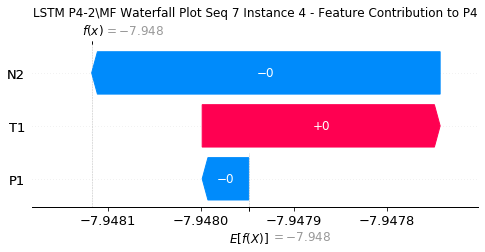

None

Contribution: [-3.80148821e-05  1.05416210e-04 -2.52880810e-04]


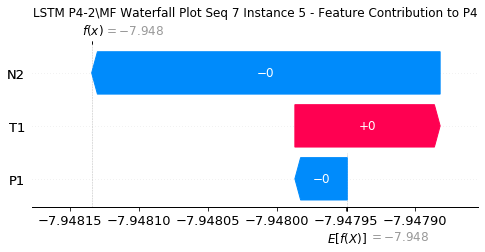

None

Contribution: [-3.59763763e-05  1.01672763e-04 -2.11812718e-04]


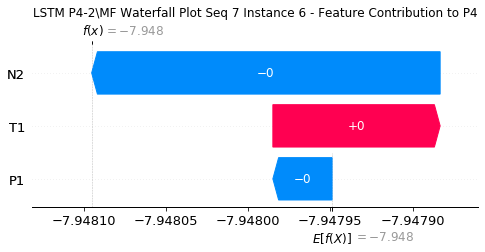

None

Contribution: [-2.67543026e-05  1.21687277e-04 -1.94749767e-04]


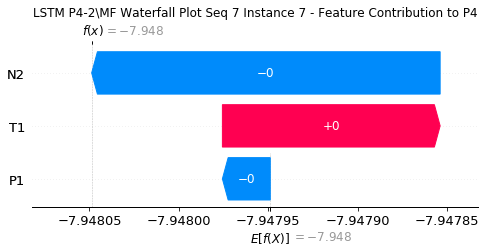

None

Contribution: [-3.20211127e-05  9.34276838e-05 -1.92972671e-04]


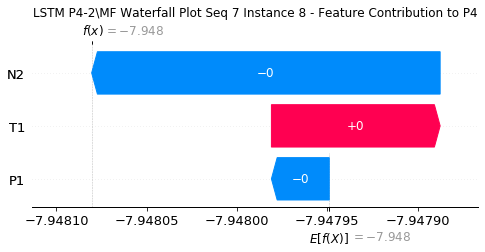

None

Contribution: [-2.99178402e-05  9.53808176e-05 -1.98230779e-04]


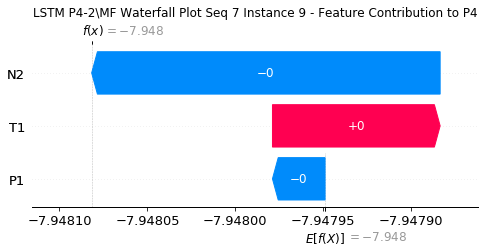

None

Contribution: [-3.62602607e-05  1.08082017e-04 -2.19053167e-04]


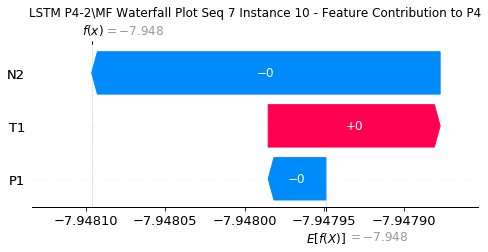

None

Contribution: [-4.55158362e-05  1.13245007e-04 -2.38122129e-04]


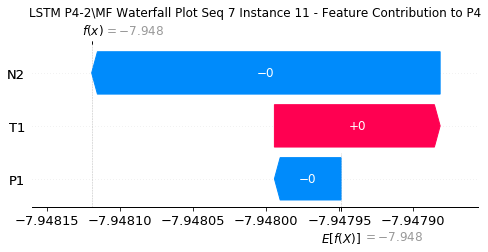

None

Contribution: [-5.56477655e-05  1.35455963e-04 -2.65382216e-04]


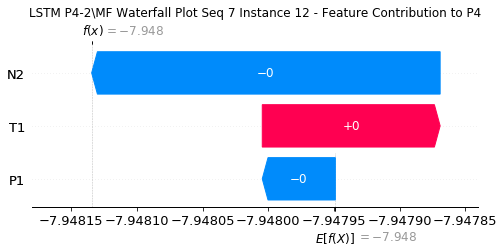

None

Contribution: [-6.12817823e-05  1.08225709e-04 -2.95265517e-04]


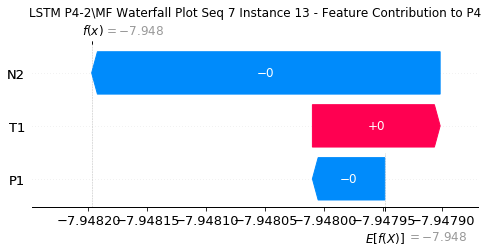

None

Contribution: [-6.75563323e-05  1.21036864e-04 -3.32932595e-04]


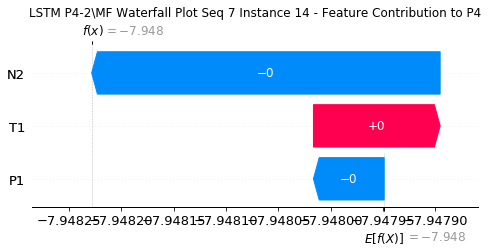

None

Contribution: [-8.00554944e-05  1.17924597e-04 -3.68413156e-04]


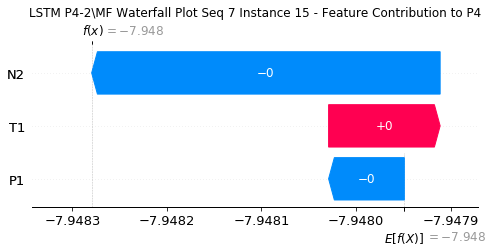

None

Contribution: [-9.19715311e-05  1.22829245e-04 -4.12579794e-04]


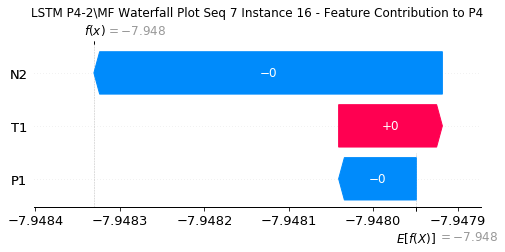

None

Contribution: [-9.85202826e-05  1.56036643e-04 -4.59351438e-04]


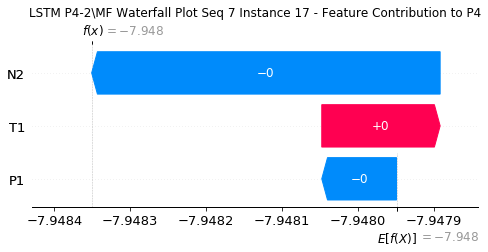

None

Contribution: [-0.00010694  0.00020755 -0.00051957]


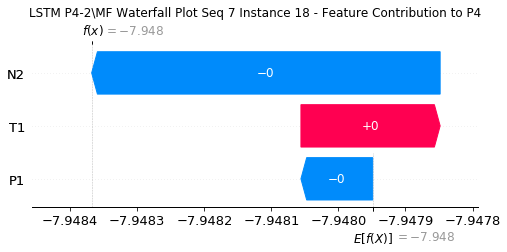

None

Contribution: [-0.00011333  0.00034888 -0.00060821]


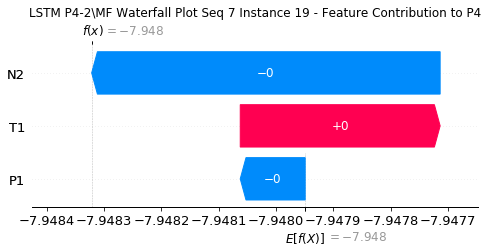

None

Contribution: [-0.00010709  0.00065415 -0.00075619]


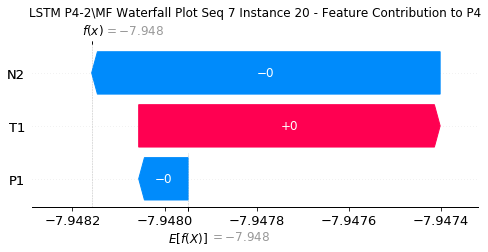

None

Contribution: [-6.99916214e-05  1.36742505e-03 -1.05698478e-03]


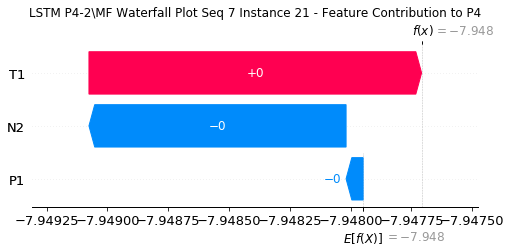

None

Contribution: [-6.34618121e-05  2.85186049e-03 -1.61478421e-03]


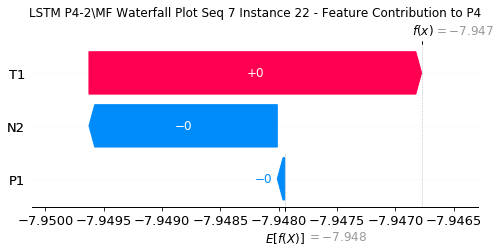

None

Contribution: [-0.00014417  0.00554592 -0.00291289]


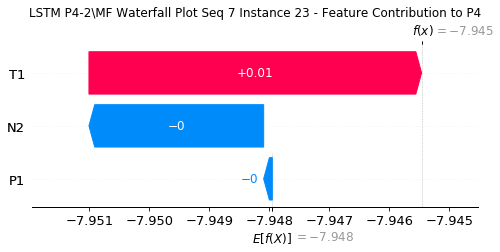

None

Contribution: [-0.00033921  0.01052573 -0.00595885]


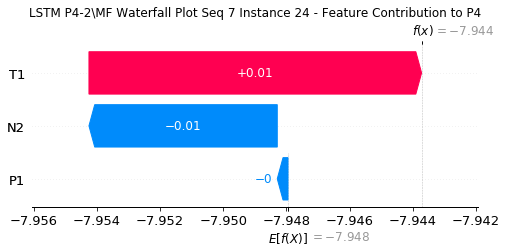

None

Contribution: [ 0.01192107  0.28732787 -0.1094173 ]


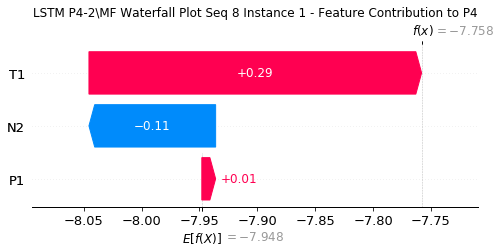

None

Contribution: [0.00305988 0.00922161 0.00617449]


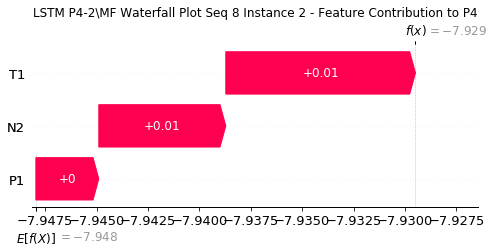

None

Contribution: [ 0.00019983  0.00326559 -0.00041904]


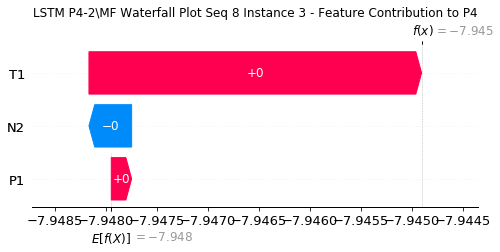

None

Contribution: [-2.68965027e-05  4.84991444e-04 -3.53956354e-04]


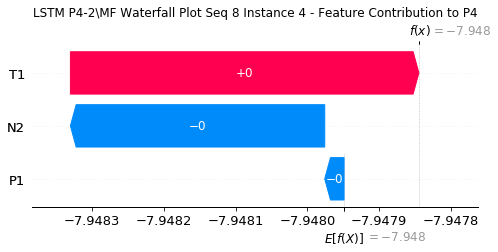

None

Contribution: [-3.48284509e-05  2.01467545e-04 -2.41720879e-04]


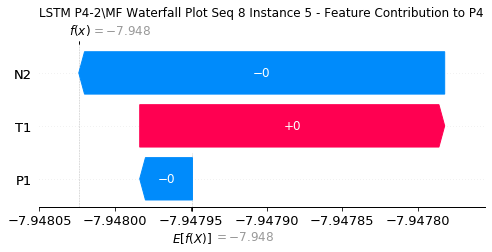

None

Contribution: [-2.11465487e-05  2.06245854e-04 -1.97650374e-04]


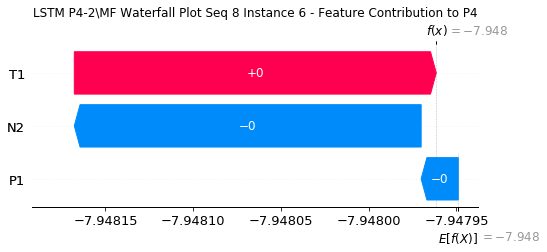

None

Contribution: [-1.69128189e-05  1.76650800e-04 -1.93614171e-04]


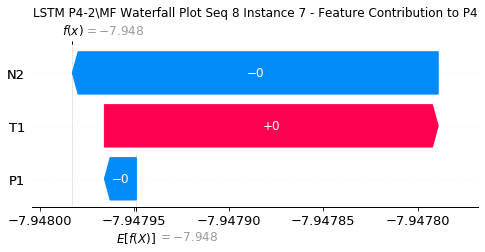

None

Contribution: [-1.26205075e-05  1.92751238e-04 -1.88199026e-04]


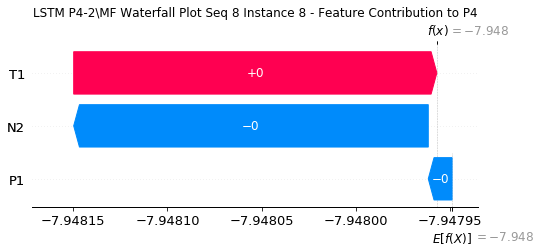

None

Contribution: [-1.26754510e-05  1.58149968e-04 -1.95789259e-04]


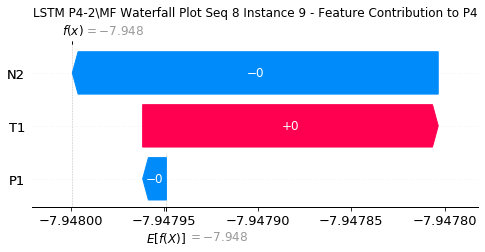

None

Contribution: [-2.49303416e-05  1.77484907e-04 -2.10540994e-04]


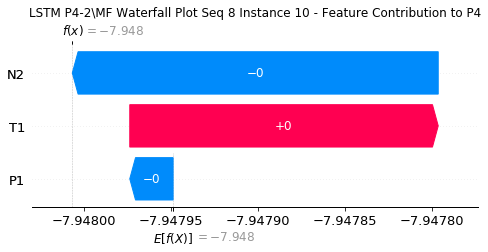

None

Contribution: [-3.59452191e-05  1.80780938e-04 -2.30046163e-04]


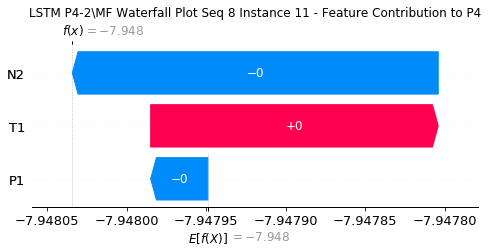

None

Contribution: [-3.60696158e-05  1.85775903e-04 -2.58519700e-04]


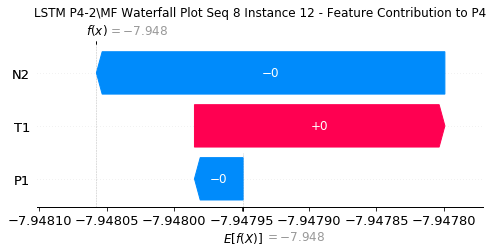

None

Contribution: [-5.86822526e-05  1.64273929e-04 -2.94084226e-04]


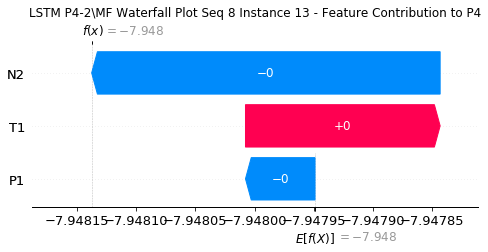

None

Contribution: [-6.56114850e-05  1.81693834e-04 -3.33411286e-04]


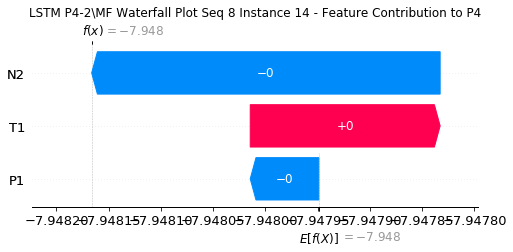

None

Contribution: [-7.26696289e-05  1.73120605e-04 -3.71188967e-04]


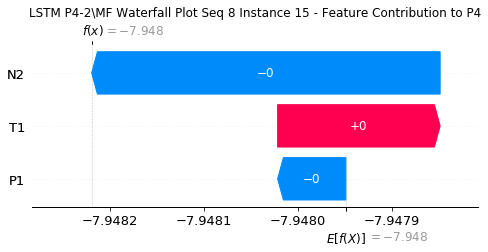

None

Contribution: [-7.15721136e-05  1.86889267e-04 -4.12319161e-04]


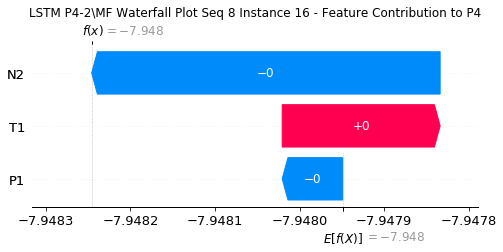

None

Contribution: [-7.42735165e-05  2.07868667e-04 -4.67259995e-04]


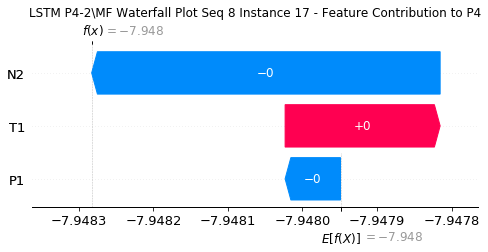

None

Contribution: [-9.88992874e-05  2.76921147e-04 -5.26895152e-04]


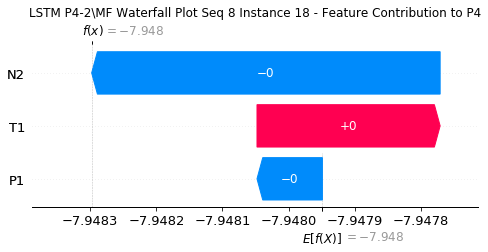

None

Contribution: [-9.29220460e-05  4.37951671e-04 -6.12399565e-04]


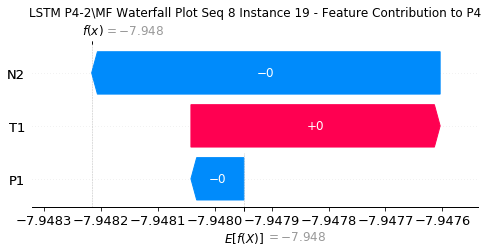

None

Contribution: [-0.00011677  0.00074118 -0.00077291]


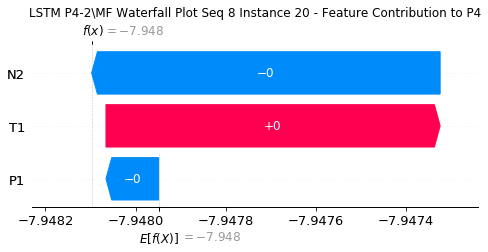

None

Contribution: [-1.48151488e-05  1.50402726e-03 -1.06670631e-03]


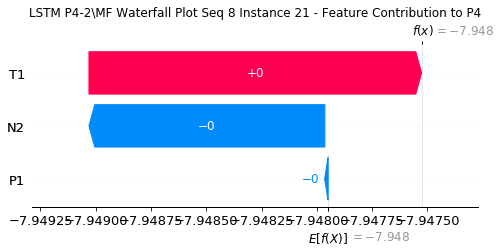

None

Contribution: [-0.00011975  0.00311445 -0.00171079]


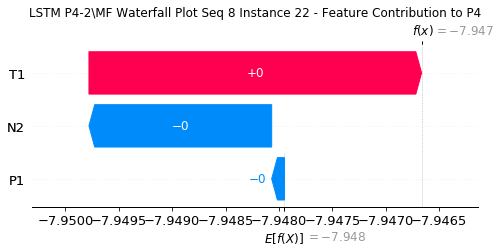

None

Contribution: [ 0.00019921  0.00624065 -0.00297943]


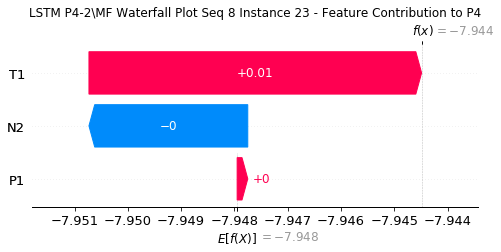

None

Contribution: [ 0.00118685  0.0111026  -0.00516343]


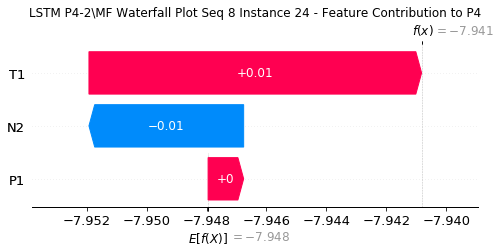

None

Contribution: [-2.50884324e-04  2.52605117e-01 -1.07252391e-01]


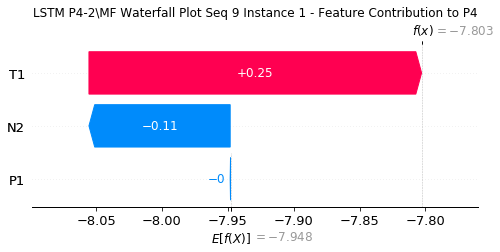

None

Contribution: [0.00295993 0.00979229 0.00596542]


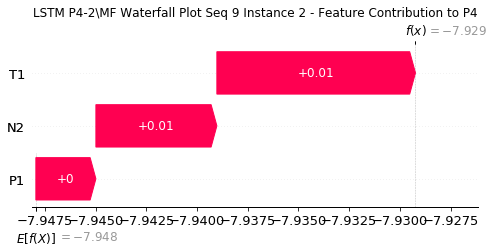

None

Contribution: [ 0.00051662  0.00275286 -0.00057928]


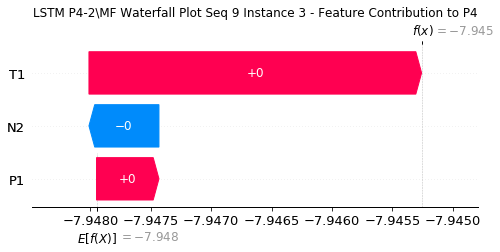

None

Contribution: [-4.70852490e-06  3.33758106e-04 -3.83642248e-04]


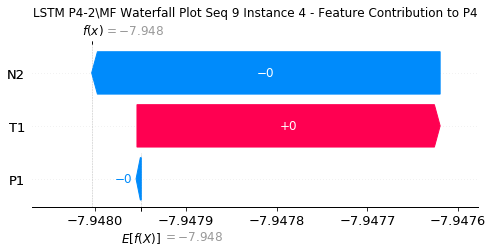

None

Contribution: [ 1.94076586e-05  2.04267040e-04 -2.47761202e-04]


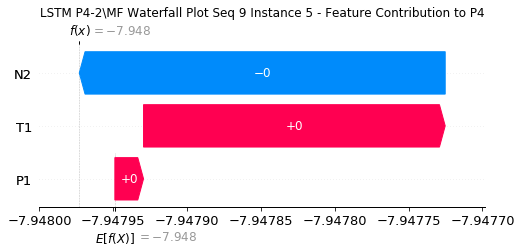

None

Contribution: [-1.81241147e-05  1.25931634e-04 -2.12422912e-04]


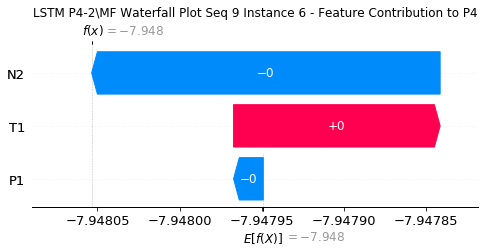

None

Contribution: [-2.29800186e-05  6.60609301e-05 -2.03633036e-04]


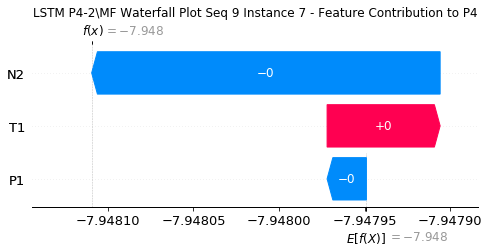

None

Contribution: [-2.82930607e-05  4.18504835e-05 -2.03099196e-04]


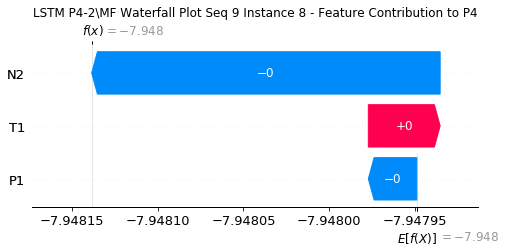

None

Contribution: [-3.46570947e-05  7.56357486e-05 -2.08531363e-04]


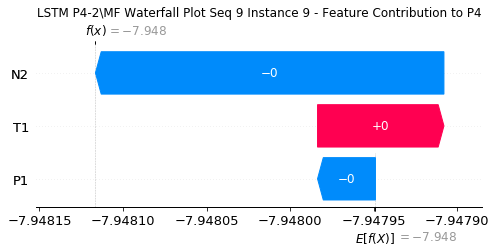

None

Contribution: [-3.76746130e-05  9.27375881e-05 -2.21001644e-04]


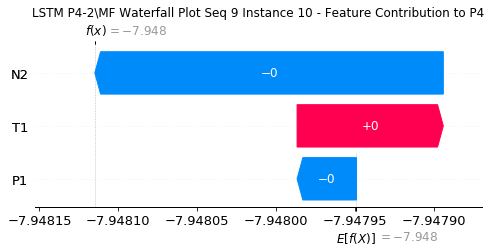

None

Contribution: [-4.72698226e-05  8.65992396e-05 -2.40009705e-04]


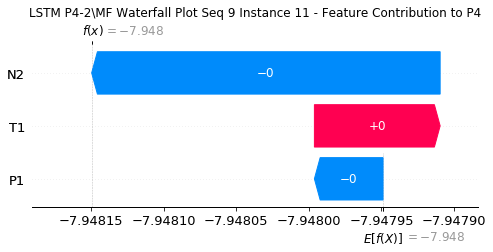

None

Contribution: [-4.91389727e-05  7.95583863e-05 -2.64394698e-04]


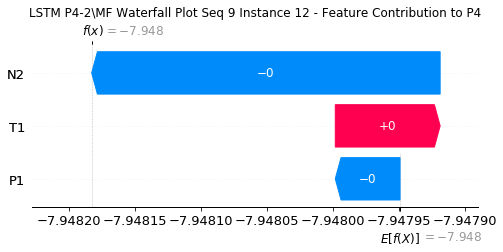

None

Contribution: [-6.68548210e-05  7.32361627e-05 -2.98893834e-04]


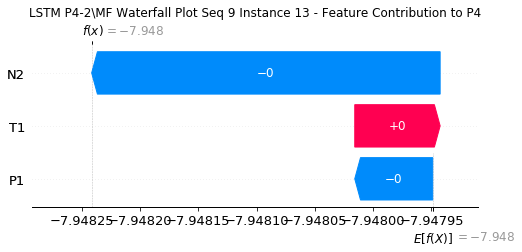

None

Contribution: [-7.37472646e-05  7.99697759e-05 -3.36114339e-04]


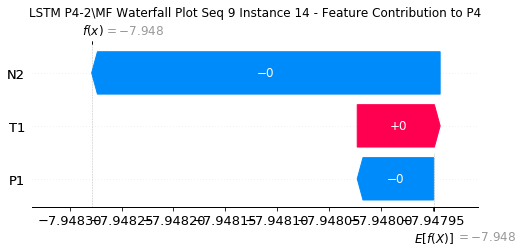

None

Contribution: [-9.28269014e-05  5.25217265e-05 -3.74929253e-04]


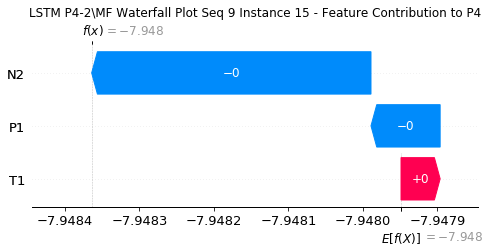

None

Contribution: [-1.09530571e-04  4.35388950e-05 -4.20859808e-04]


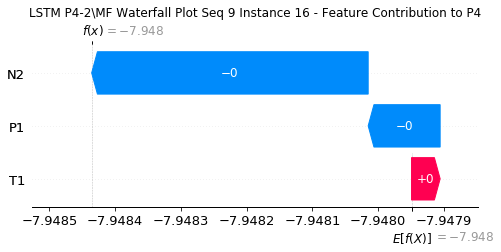

None

Contribution: [-9.12011525e-05  3.87630333e-05 -4.71025715e-04]


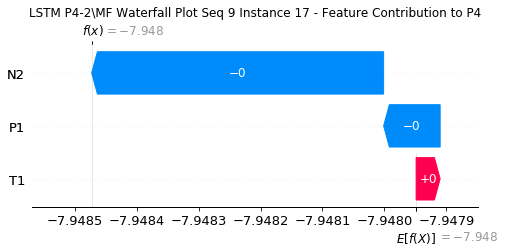

None

Contribution: [-1.21019737e-04  8.75536514e-05 -5.30377005e-04]


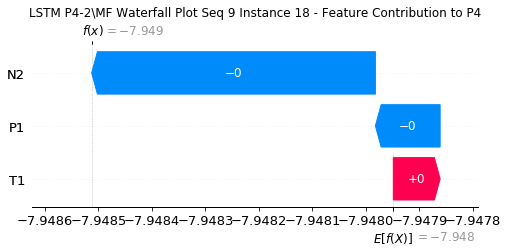

None

Contribution: [-0.00013906  0.00017218 -0.00062191]


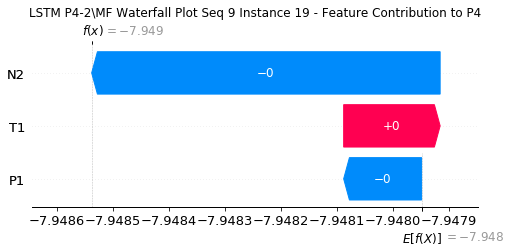

None

Contribution: [-0.00014428  0.00037903 -0.0007742 ]


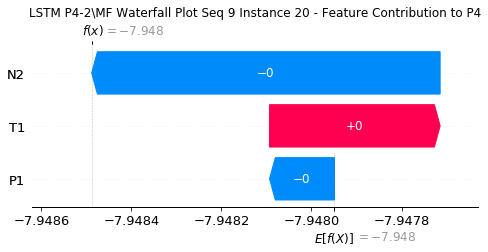

None

Contribution: [-0.00018954  0.00078592 -0.00108864]


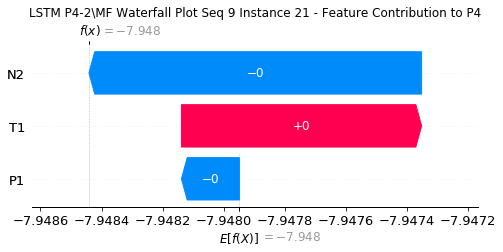

None

Contribution: [-0.00021289  0.00183124 -0.00165194]


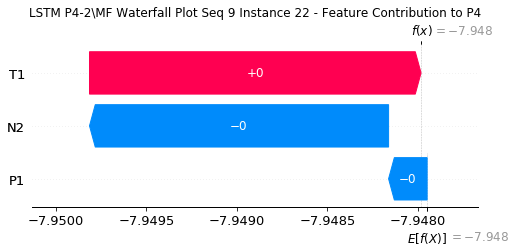

None

Contribution: [ 2.21066335e-05  2.67682438e-03 -2.84383654e-03]


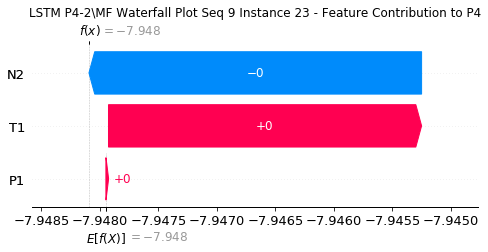

None

Contribution: [-0.00059512  0.00497864 -0.00598673]


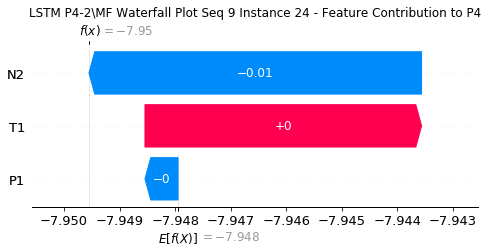

None

Contribution: [ 0.00952177  0.13572374 -0.10693341]


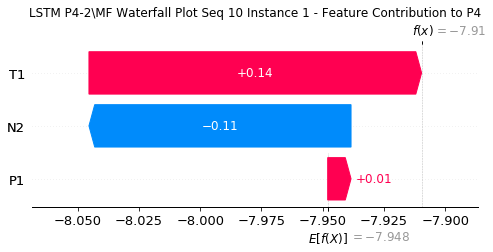

None

Contribution: [0.00295398 0.00708201 0.00561054]


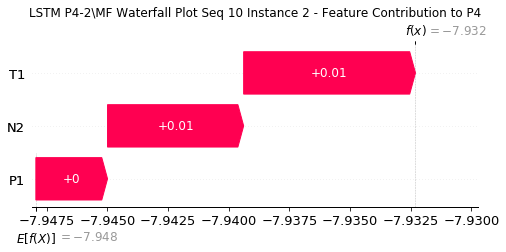

None

Contribution: [ 9.89755819e-05  1.73811862e-03 -5.12345261e-04]


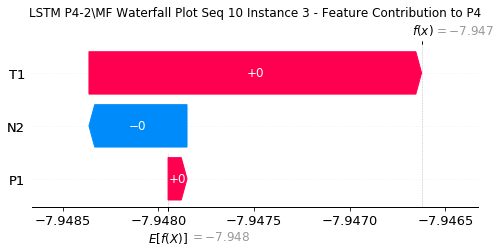

None

Contribution: [-7.13263654e-05  1.44366082e-04 -3.74951829e-04]


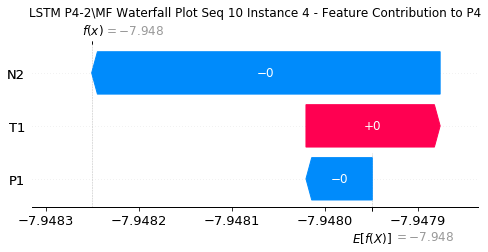

None

Contribution: [-5.10054340e-05  3.55877186e-05 -2.55778201e-04]


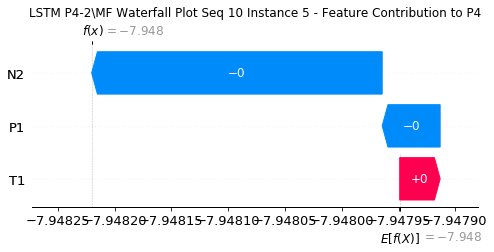

None

Contribution: [-4.61624635e-05  4.60661470e-05 -2.14506013e-04]


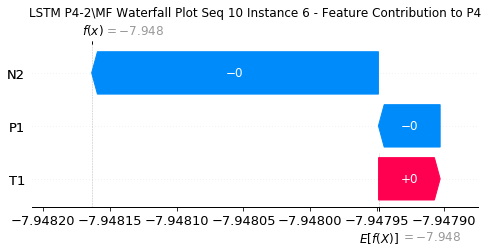

None

Contribution: [-2.81998150e-05  5.56144757e-05 -2.03620400e-04]


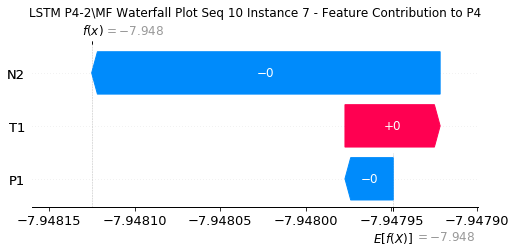

None

Contribution: [-5.24204008e-05  4.69110723e-05 -2.07592637e-04]


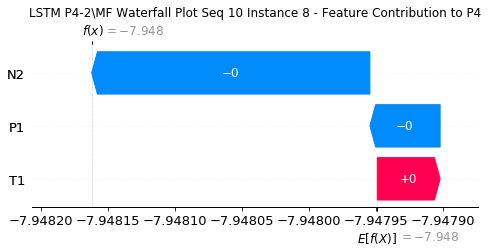

None

Contribution: [-3.90365283e-05  4.85775549e-05 -2.10691142e-04]


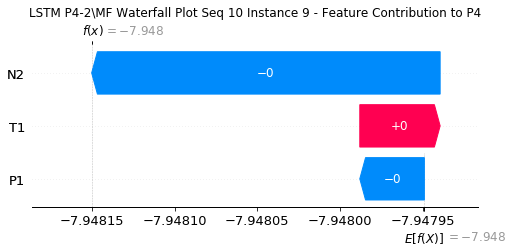

None

Contribution: [-4.98042657e-05  5.03192712e-05 -2.24424697e-04]


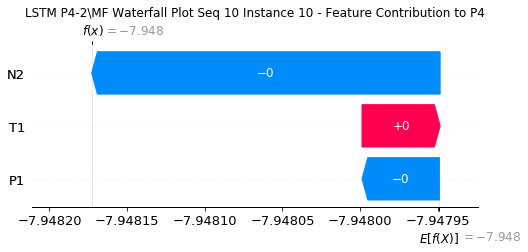

None

Contribution: [-5.79427325e-05  5.12024249e-05 -2.42552523e-04]


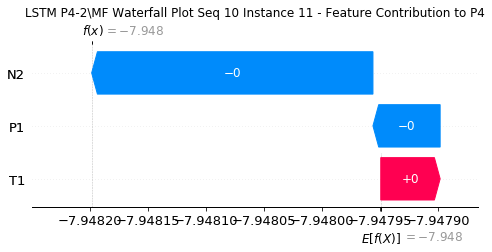

None

Contribution: [-6.17793214e-05  6.80422123e-05 -2.66524768e-04]


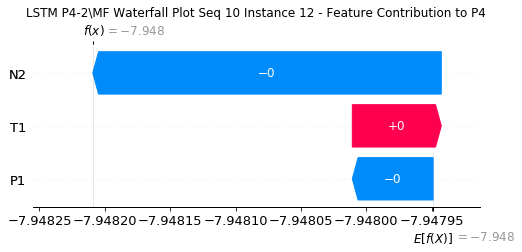

None

Contribution: [-7.67313302e-05  4.41623892e-05 -3.00171220e-04]


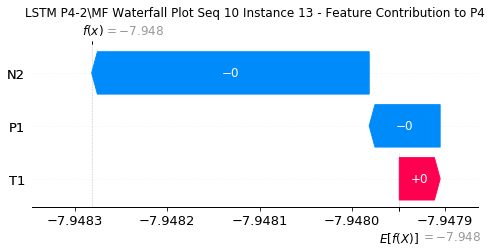

None

Contribution: [-7.75136849e-05  2.91041768e-05 -3.35576623e-04]


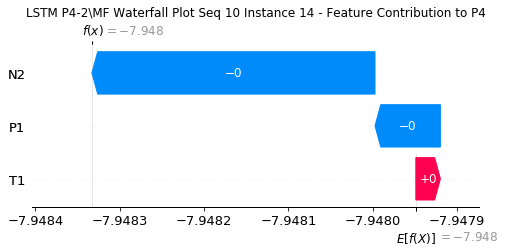

None

Contribution: [-9.77649459e-05  3.95206870e-05 -3.72145827e-04]


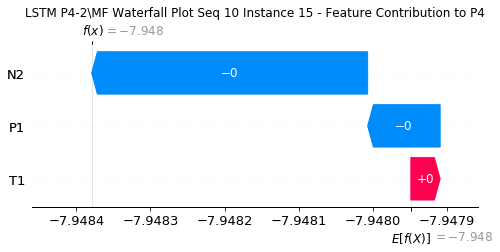

None

Contribution: [-1.10967864e-04  3.84131784e-05 -4.14940963e-04]


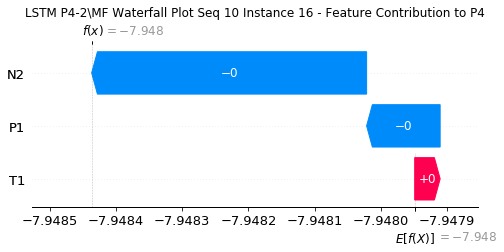

None

Contribution: [-1.12474895e-04  5.74948594e-05 -4.63250592e-04]


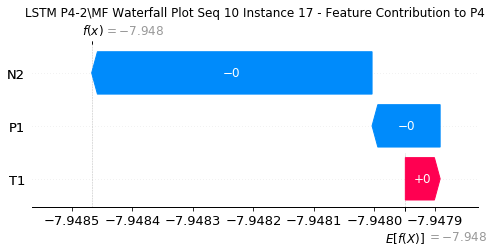

None

Contribution: [-1.35864031e-04  8.73929414e-05 -5.21023629e-04]


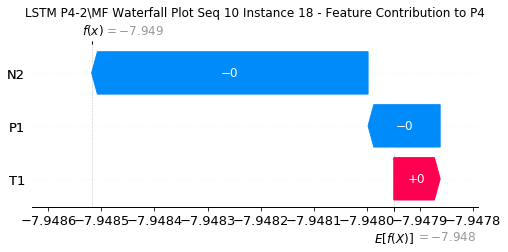

None

Contribution: [-0.00015512  0.00018333 -0.0006111 ]


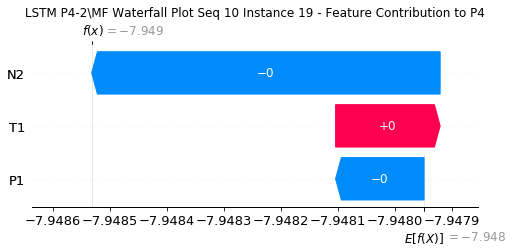

None

Contribution: [-0.00018305  0.00040825 -0.00076821]


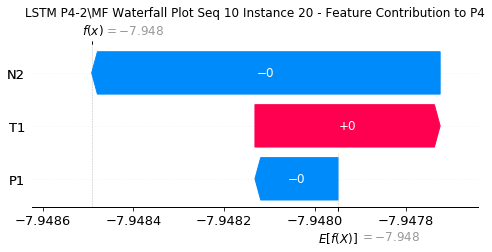

None

Contribution: [-0.00021754  0.00091336 -0.00108868]


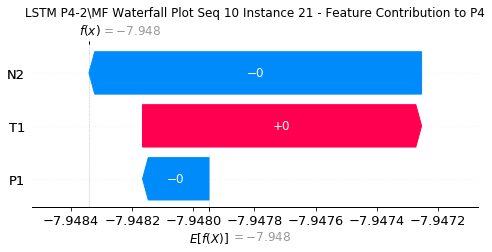

None

Contribution: [-0.00036     0.00205765 -0.00168524]


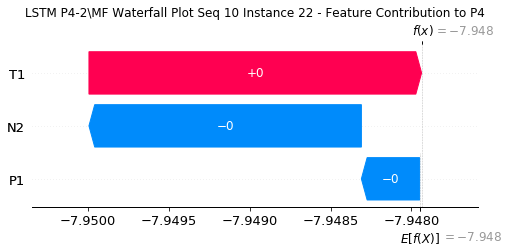

None

Contribution: [-0.00049637  0.00348221 -0.00299347]


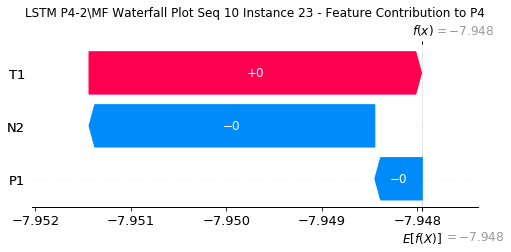

None

Contribution: [-0.00126301  0.00612676 -0.00604274]


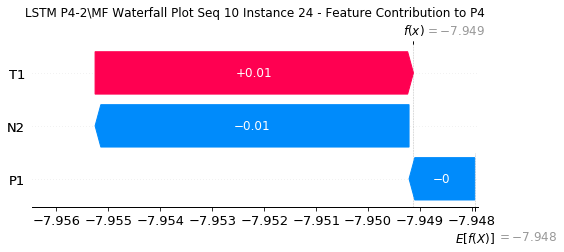

None

Contribution: [-0.02356268  0.1530014  -0.11592087]


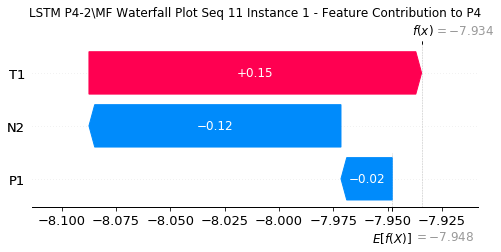

None

Contribution: [0.00203511 0.00660138 0.00532944]


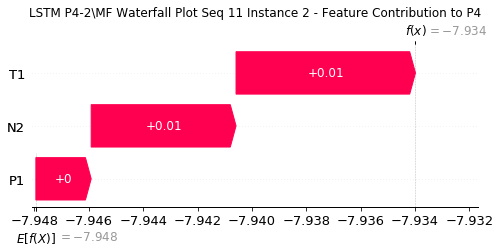

None

Contribution: [-0.00031243  0.00199127 -0.00057658]


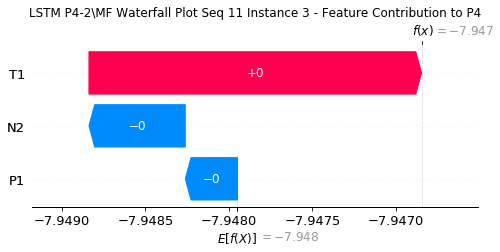

None

Contribution: [-0.00013316  0.00022185 -0.00038399]


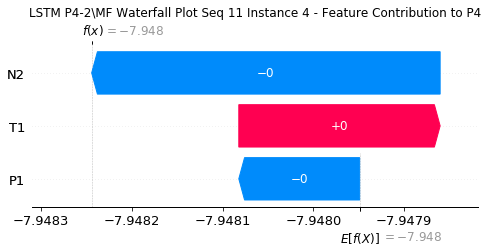

None

Contribution: [-9.68882965e-05  1.95596125e-05 -2.62670250e-04]


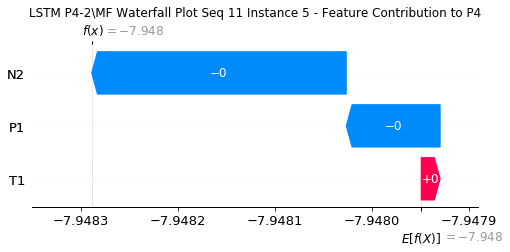

None

Contribution: [-7.55554434e-05  6.61298723e-05 -2.20441228e-04]


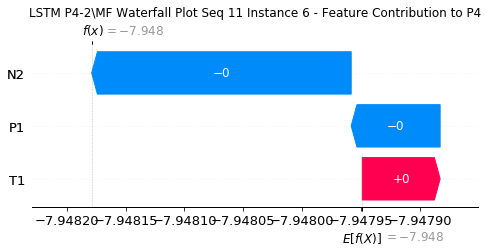

None

Contribution: [-6.90941916e-05  2.47719102e-05 -2.16756583e-04]


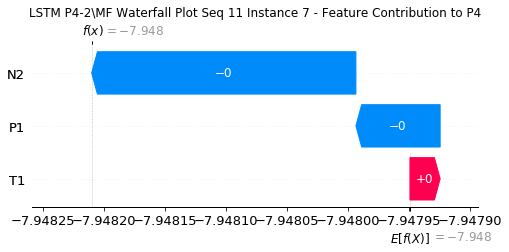

None

Contribution: [-6.87081272e-05  3.21481282e-05 -2.13708910e-04]


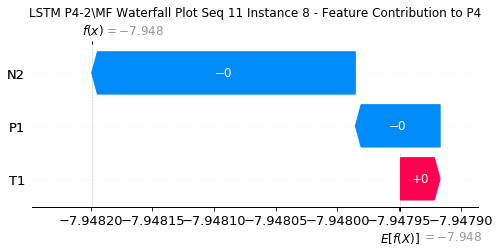

None

Contribution: [-6.83312525e-05  1.75267776e-05 -2.18786131e-04]


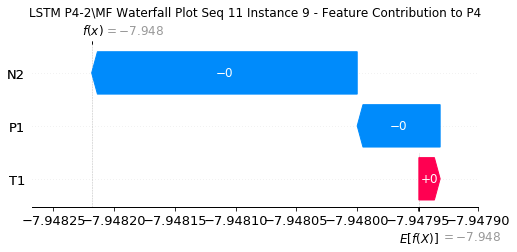

None

Contribution: [-6.61821594e-05  1.37649284e-04 -2.26648472e-04]


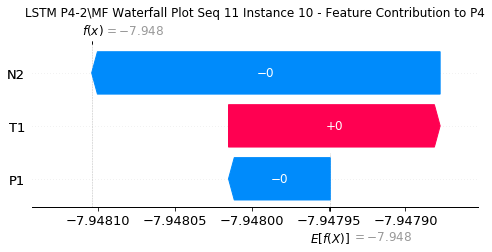

None

Contribution: [-7.53089067e-05  1.35280265e-04 -2.44641415e-04]


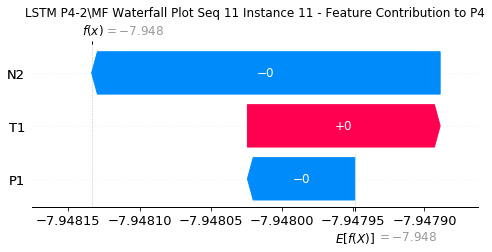

None

Contribution: [-7.18349372e-05  2.01710825e-04 -2.69017467e-04]


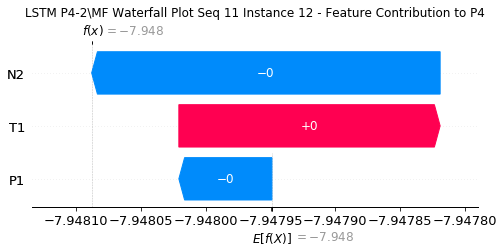

None

Contribution: [-9.02626873e-05  1.31464875e-04 -2.99566906e-04]


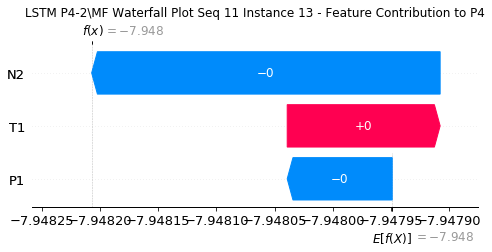

None

Contribution: [-9.03141958e-05  1.91538280e-04 -3.38176829e-04]


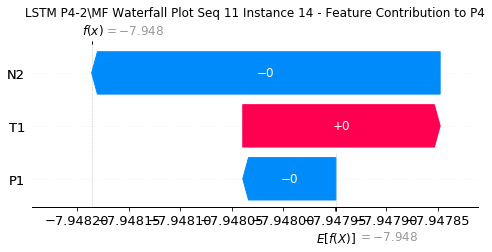

None

Contribution: [-0.00011019  0.00013236 -0.00036988]


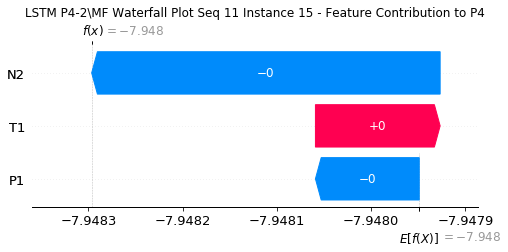

None

Contribution: [-0.00012496  0.00012075 -0.00041182]


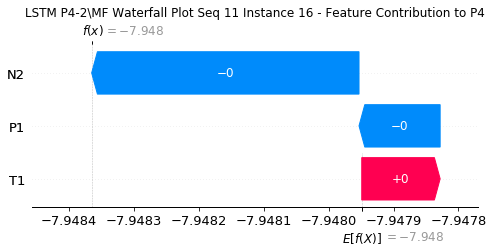

None

Contribution: [-1.40959706e-04  9.59754406e-05 -4.65220851e-04]


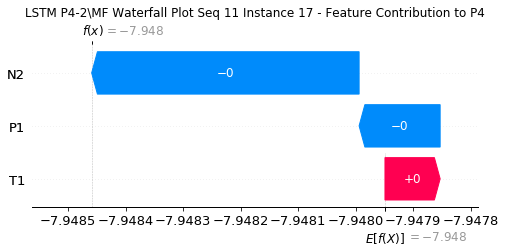

None

Contribution: [-0.00016194  0.00011768 -0.00051831]


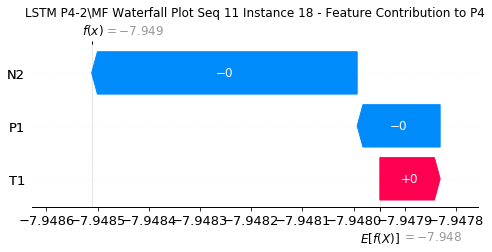

None

Contribution: [-0.00019169  0.00021282 -0.00060636]


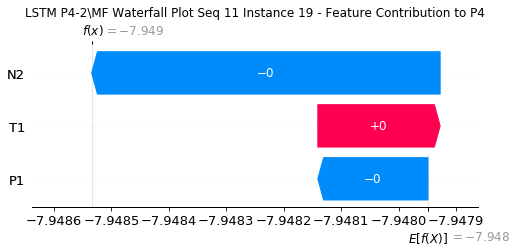

None

Contribution: [-0.00023712  0.0004257  -0.00075888]


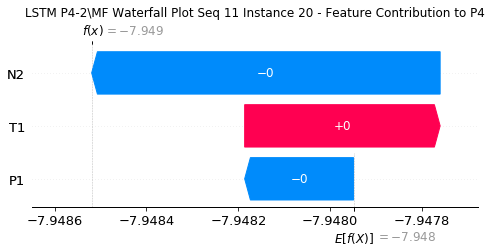

None

Contribution: [-0.00029101  0.00108966 -0.00106467]


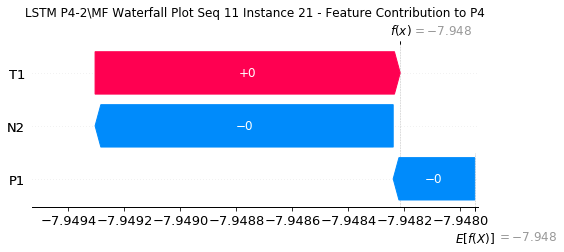

None

Contribution: [-0.00050855  0.00209659 -0.00163525]


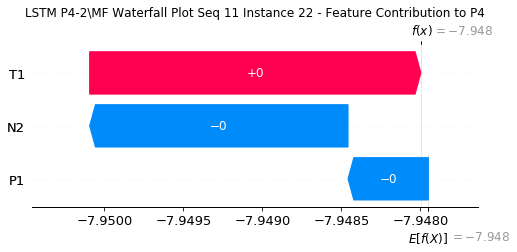

None

Contribution: [-0.00123736  0.00202788 -0.0031127 ]


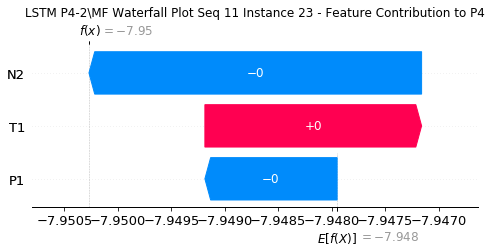

None

Contribution: [-0.00238819  0.00356038 -0.00619843]


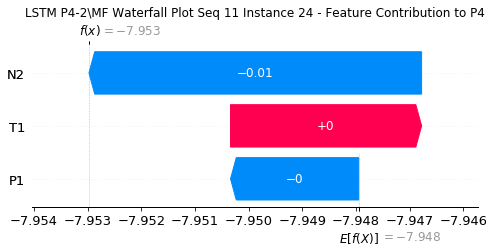

None

Contribution: [-0.04126734  0.10654064 -0.11866978]


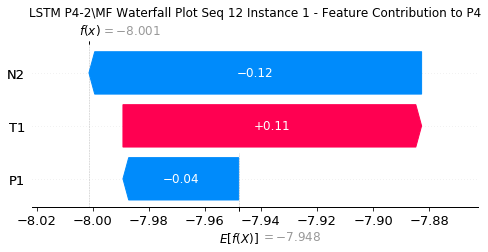

None

Contribution: [0.00187305 0.00562227 0.00496477]


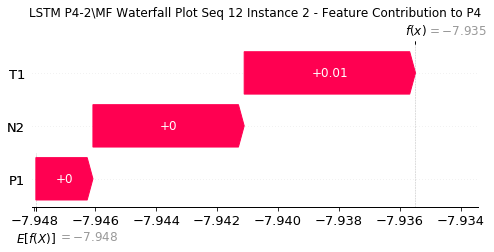

None

Contribution: [-0.00037818  0.0011238  -0.00063706]


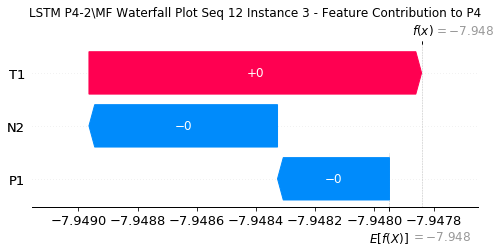

None

Contribution: [-1.44843816e-04  1.91791585e-05 -3.87095226e-04]


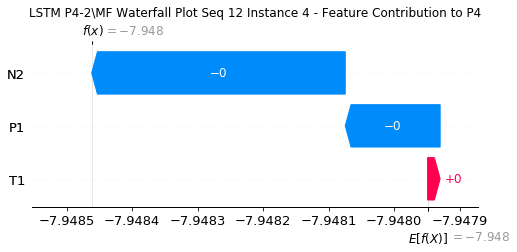

None

Contribution: [-7.77247354e-05 -2.46363066e-05 -2.63411959e-04]


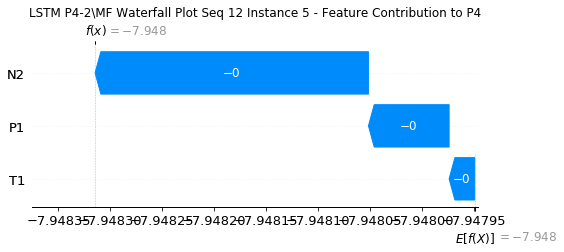

None

Contribution: [-8.13336916e-05 -2.25687109e-05 -2.23870756e-04]


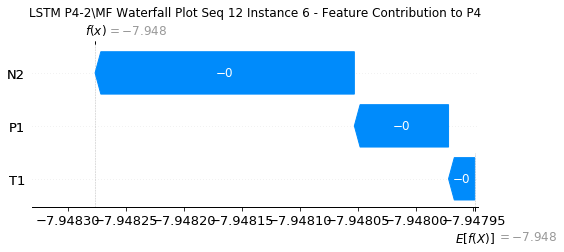

None

Contribution: [-8.44914786e-05 -2.42894436e-05 -2.20657654e-04]


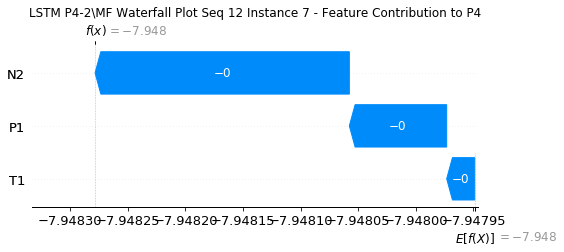

None

Contribution: [-7.60261190e-05 -1.04129688e-05 -2.12948969e-04]


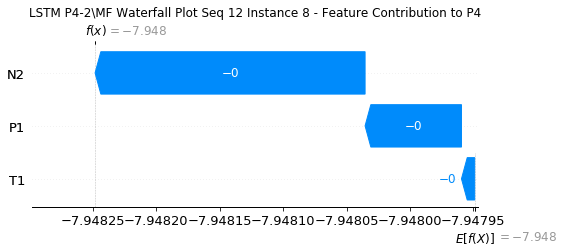

None

Contribution: [-7.58976949e-05 -1.88829700e-05 -2.19597171e-04]


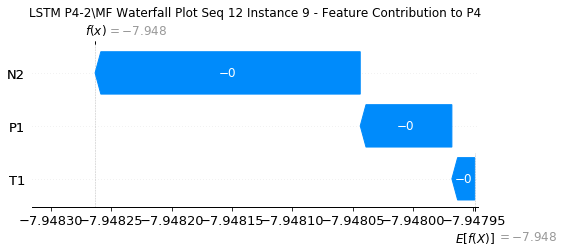

None

Contribution: [-7.98700890e-05 -2.67324256e-05 -2.28882840e-04]


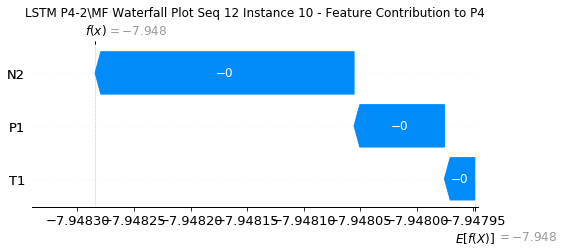

None

Contribution: [-9.02947085e-05 -2.97704600e-05 -2.47501504e-04]


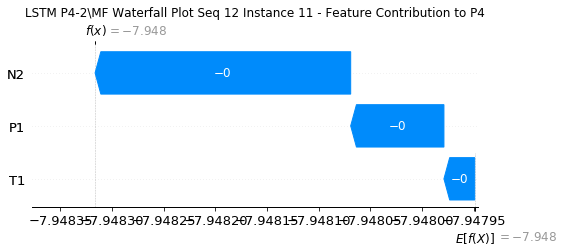

None

Contribution: [-8.23157128e-05 -2.82310390e-05 -2.64884886e-04]


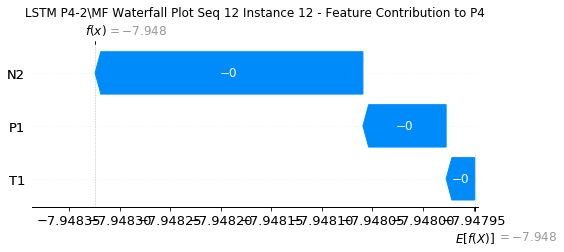

None

Contribution: [-1.05481780e-04 -4.21745085e-05 -2.99691584e-04]


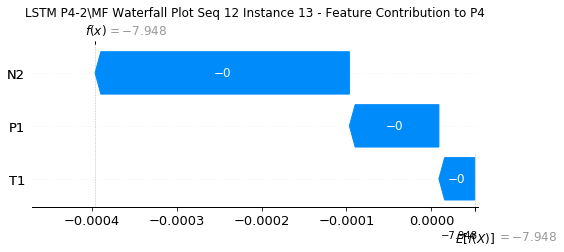

None

Contribution: [-1.18966069e-04 -5.60115957e-05 -3.34158412e-04]


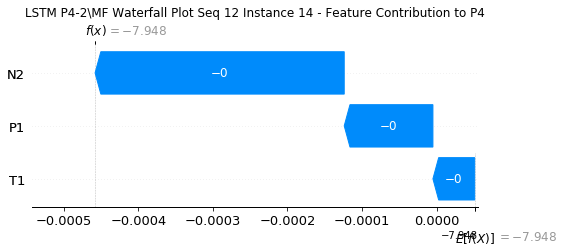

None

Contribution: [-1.28232379e-04 -5.68638286e-05 -3.66826804e-04]


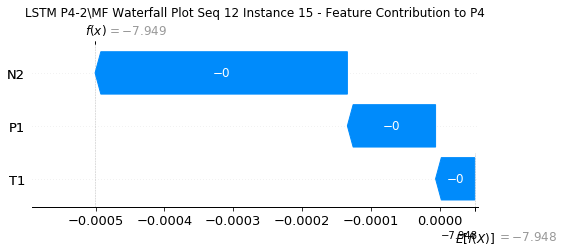

None

Contribution: [-1.41248869e-04 -6.60608623e-05 -4.06089886e-04]


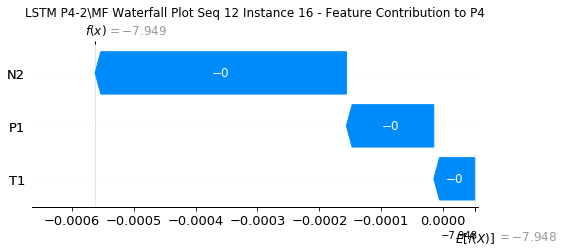

None

Contribution: [-1.42122654e-04 -5.41442402e-05 -4.48883444e-04]


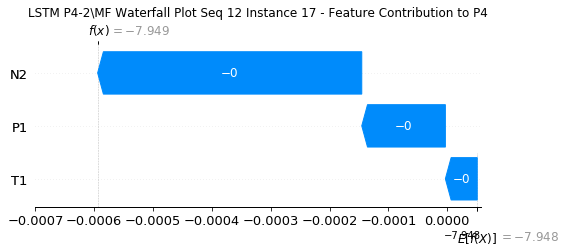

None

Contribution: [-1.80691777e-04 -6.94026532e-05 -5.09563309e-04]


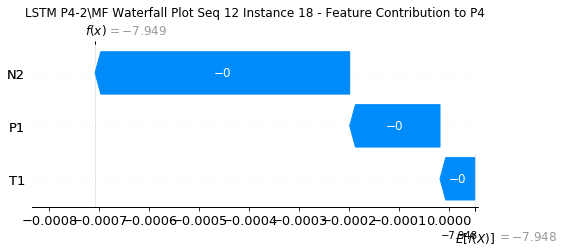

None

Contribution: [-2.15812587e-04 -4.68967104e-05 -5.95344040e-04]


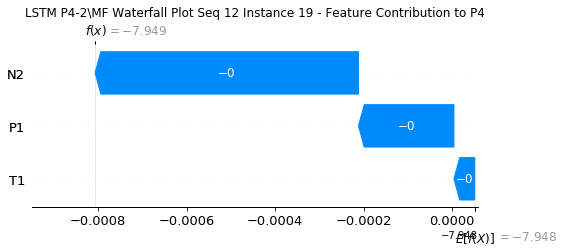

None

Contribution: [-2.75074908e-04  1.63894098e-05 -7.44732671e-04]


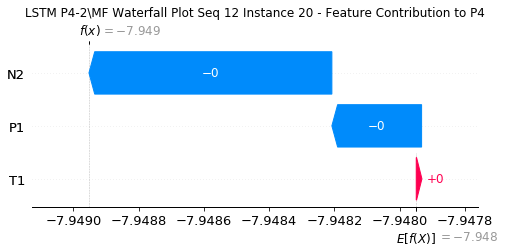

None

Contribution: [-0.00036666  0.00019071 -0.00103575]


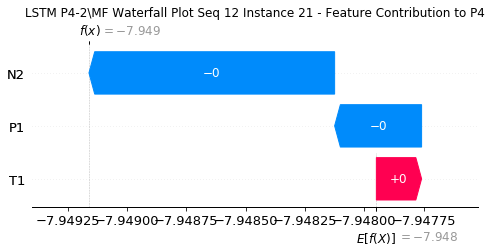

None

Contribution: [-0.00062712  0.00067466 -0.00158331]


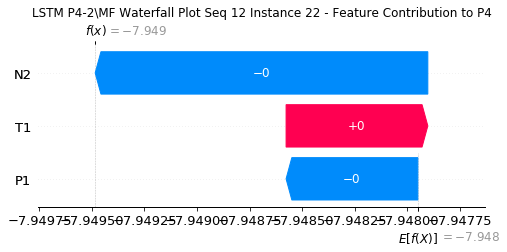

None

Contribution: [-0.00111592  0.0010279  -0.00289344]


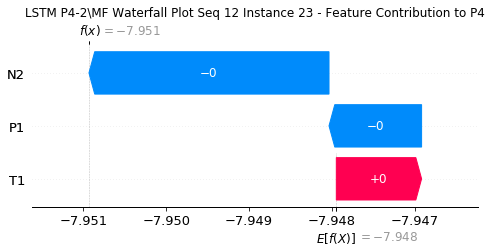

None

Contribution: [-0.00220982  0.00155462 -0.00594392]


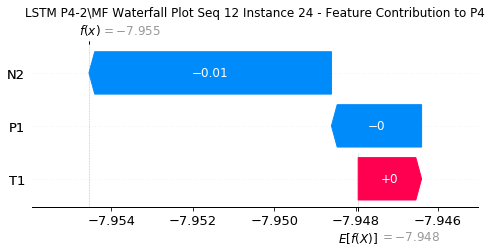

None

Contribution: [-0.04306003  0.0400288  -0.11314462]


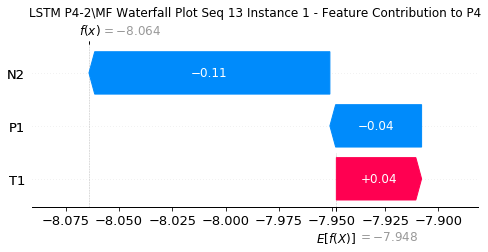

None

Contribution: [0.00157245 0.00500302 0.00470548]


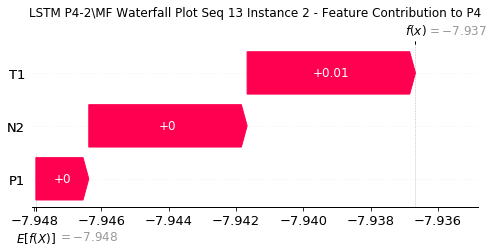

None

Contribution: [-0.00031682  0.00107599 -0.00062436]


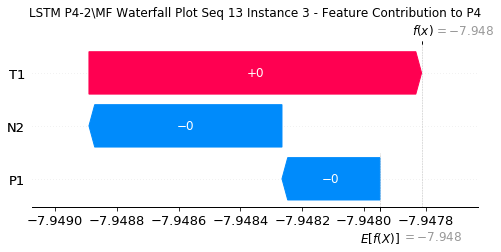

None

Contribution: [-1.37992723e-04  1.99081377e-05 -3.86983448e-04]


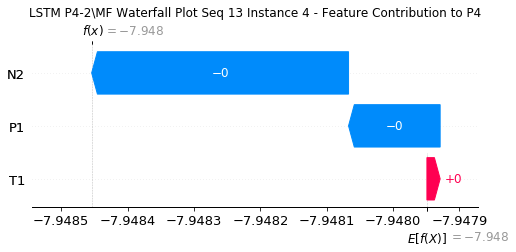

None

Contribution: [-1.01489230e-04 -3.13802178e-05 -2.67775517e-04]


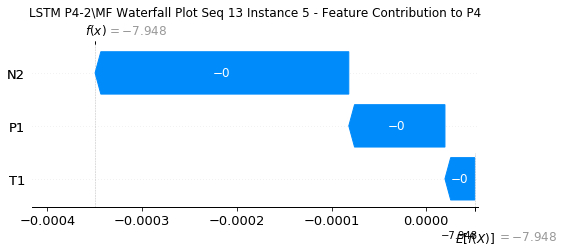

None

Contribution: [-7.71243444e-05 -2.21398846e-05 -2.26013492e-04]


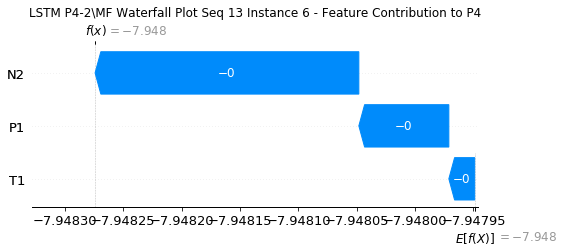

None

Contribution: [-5.84285245e-05 -6.48497666e-06 -2.13297817e-04]


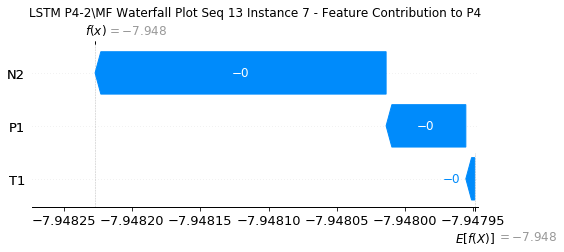

None

Contribution: [-6.24179565e-05  6.21074444e-06 -2.10951717e-04]


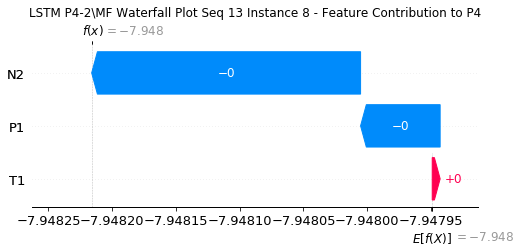

None

Contribution: [-6.66290205e-05 -5.84747077e-06 -2.16600082e-04]


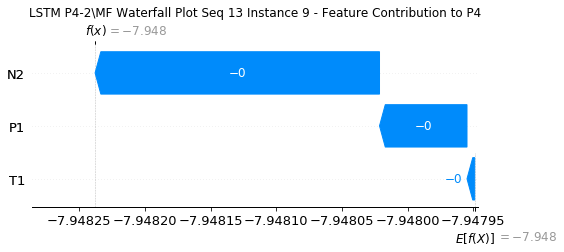

None

Contribution: [-8.06169854e-05 -9.96192040e-06 -2.32600546e-04]


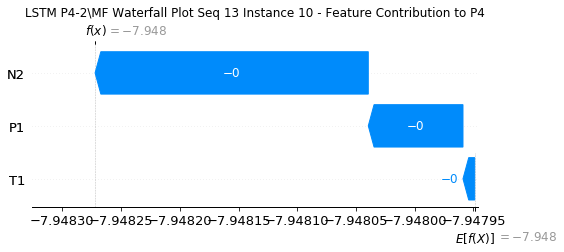

None

Contribution: [-8.66989325e-05 -1.20457250e-05 -2.50081858e-04]


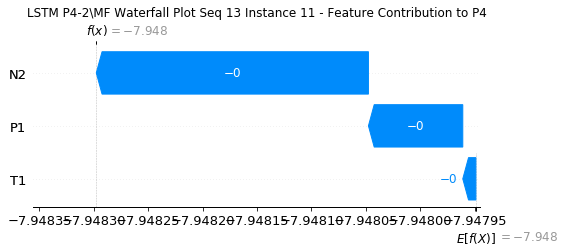

None

Contribution: [-9.46774526e-05 -1.44714338e-05 -2.73511822e-04]


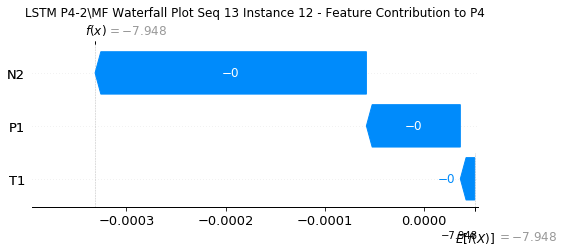

None

Contribution: [-1.03041886e-04 -2.21647634e-05 -3.01188269e-04]


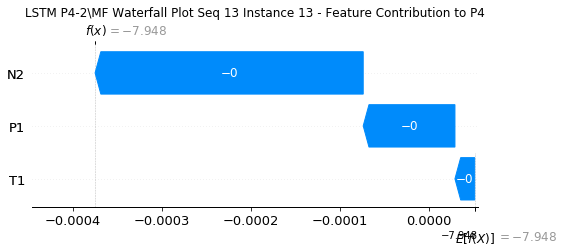

None

Contribution: [-9.98272093e-05 -1.95676266e-05 -3.30025315e-04]


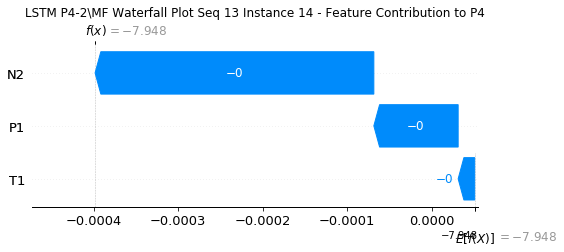

None

Contribution: [-1.21091933e-04 -2.95899339e-05 -3.65295013e-04]


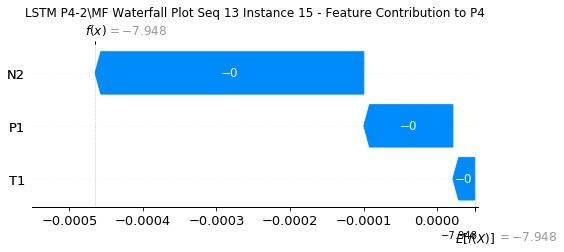

None

Contribution: [-1.33358869e-04 -3.70825842e-05 -4.04468746e-04]


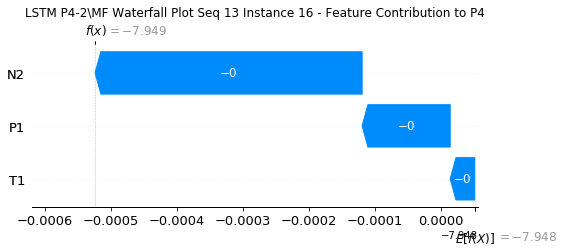

None

Contribution: [-1.41137544e-04 -6.32397370e-05 -4.51727679e-04]


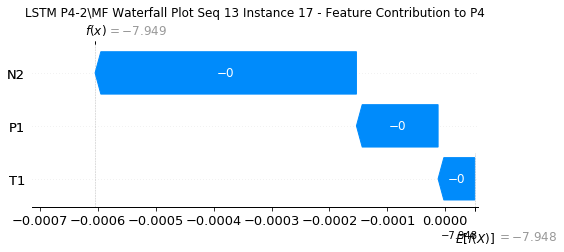

None

Contribution: [-1.59716755e-04 -4.08950638e-05 -5.05738669e-04]


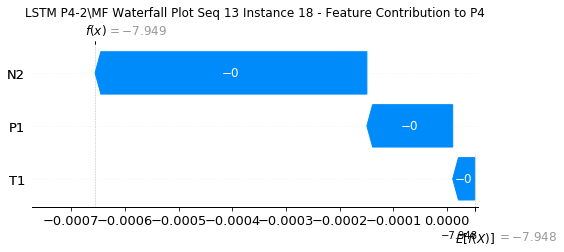

None

Contribution: [-1.89651258e-04 -4.98035425e-06 -5.93227511e-04]


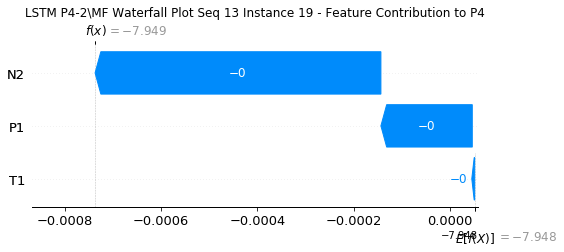

None

Contribution: [-2.40024755e-04  7.45195235e-05 -7.48172616e-04]


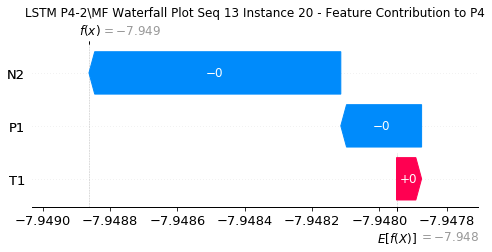

None

Contribution: [-0.00033831  0.00034151 -0.00106071]


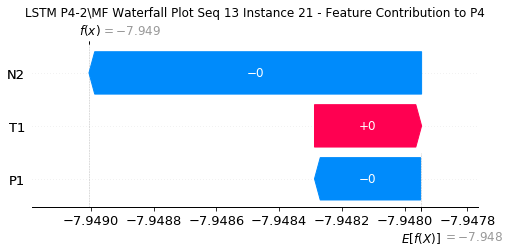

None

Contribution: [-0.00056059  0.00081315 -0.00165588]


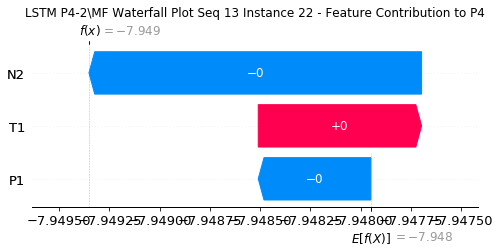

None

Contribution: [-0.0006986   0.00088593 -0.00293645]


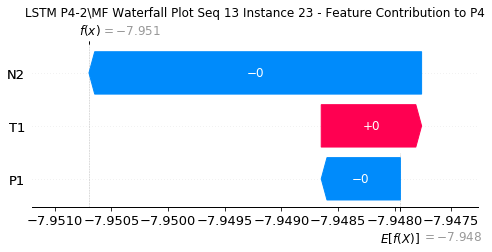

None

Contribution: [-0.00156984  0.00268721 -0.00588597]


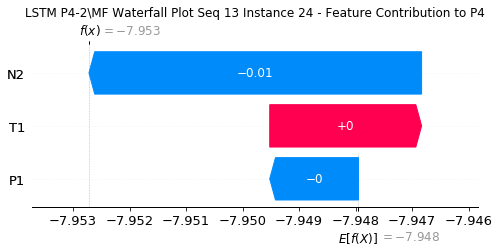

None

Contribution: [-0.02827722  0.06010149 -0.11387367]


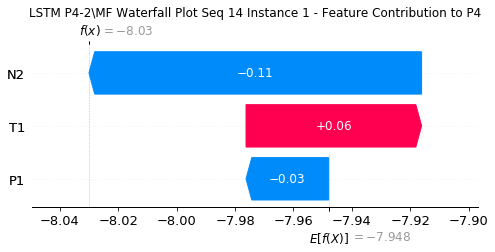

None

Contribution: [0.00208909 0.00535569 0.00491719]


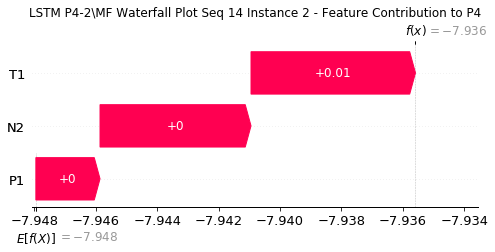

None

Contribution: [-0.0002605   0.00115819 -0.00065   ]


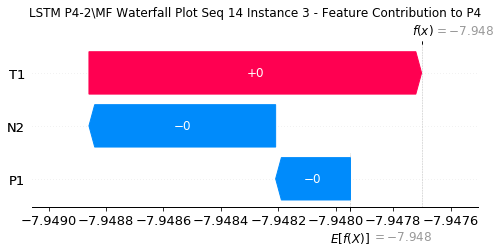

None

Contribution: [-1.24513163e-04  1.59312840e-05 -3.89037501e-04]


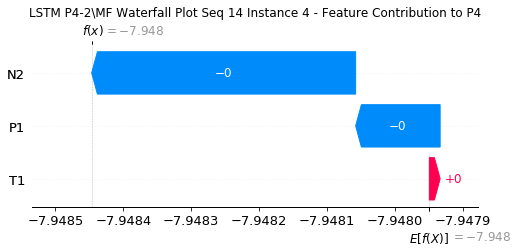

None

Contribution: [-7.84254686e-05  1.32897411e-05 -2.61836128e-04]


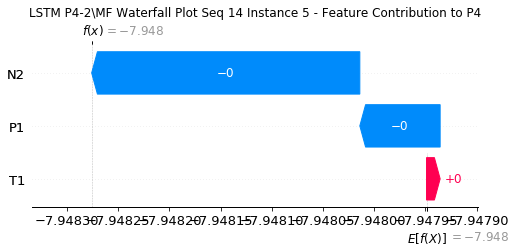

None

Contribution: [-7.09168389e-05 -2.68984256e-05 -2.25304399e-04]


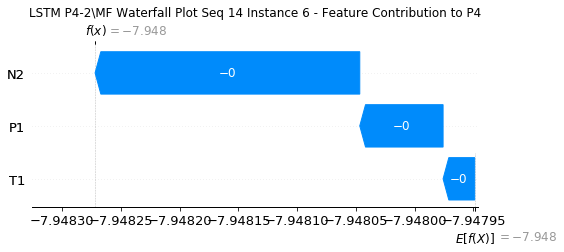

None

Contribution: [-6.00366977e-05 -2.57559041e-05 -2.16441384e-04]


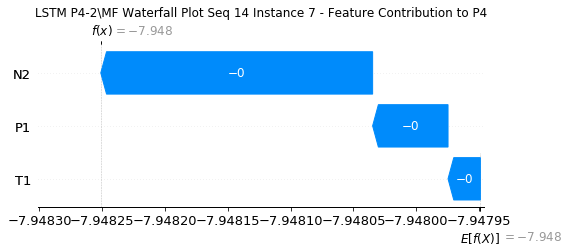

None

Contribution: [-5.90515945e-05 -3.84395788e-05 -2.13903984e-04]


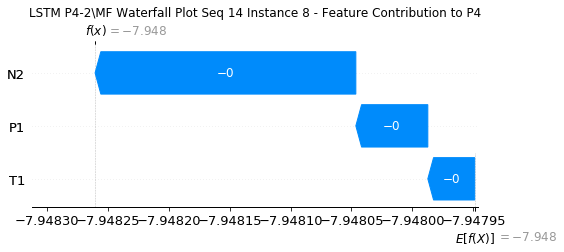

None

Contribution: [-6.33702239e-05 -4.22869535e-05 -2.19793319e-04]


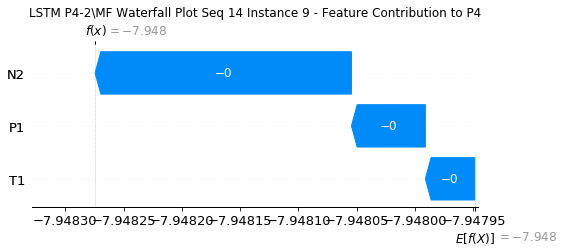

None

Contribution: [-6.70103872e-05 -3.22279561e-05 -2.30583458e-04]


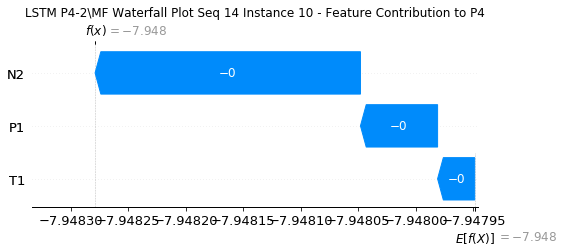

None

Contribution: [-7.47360521e-05 -3.28284795e-05 -2.48544939e-04]


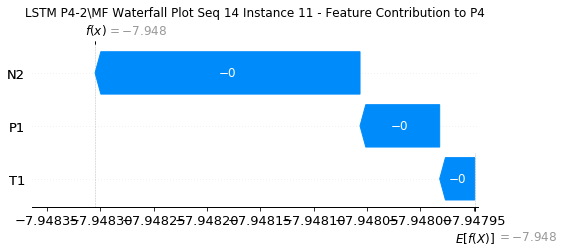

None

Contribution: [-7.73953531e-05 -3.99939291e-05 -2.74855068e-04]


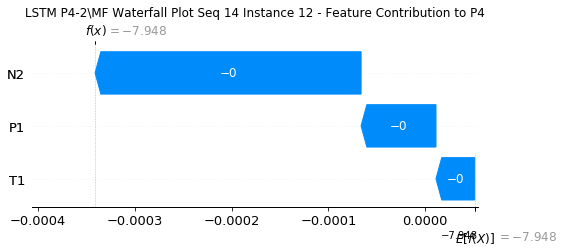

None

Contribution: [-8.9915522e-05 -4.9371623e-05 -3.0090406e-04]


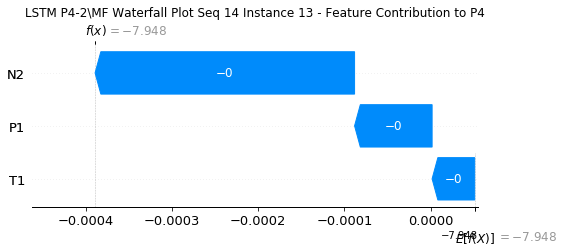

None

Contribution: [-8.69308717e-05 -4.43934638e-05 -3.32528452e-04]


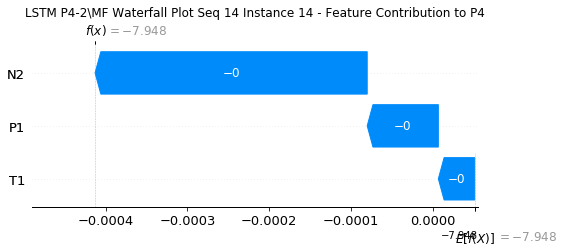

None

Contribution: [-1.07945165e-04 -6.27089004e-05 -3.66370287e-04]


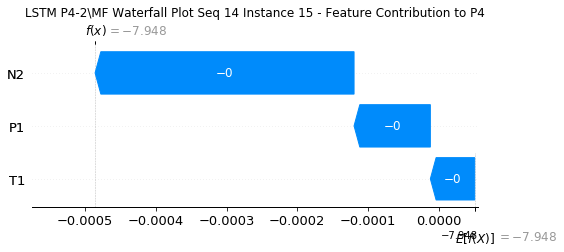

None

Contribution: [-1.20594665e-04 -7.72498622e-05 -4.06532819e-04]


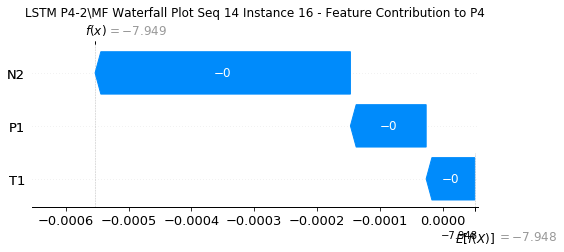

None

Contribution: [-1.26713219e-04 -5.08326816e-05 -4.53628400e-04]


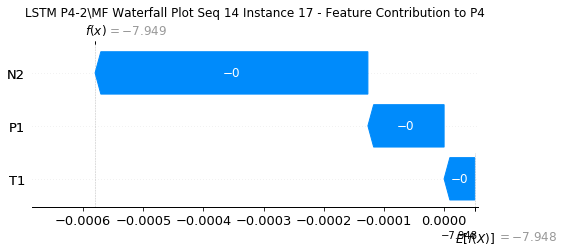

None

Contribution: [-1.50759209e-04 -8.96868555e-05 -5.11189150e-04]


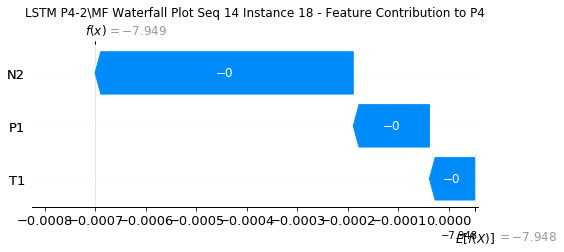

None

Contribution: [-1.76050903e-04 -8.70129135e-05 -6.00319138e-04]


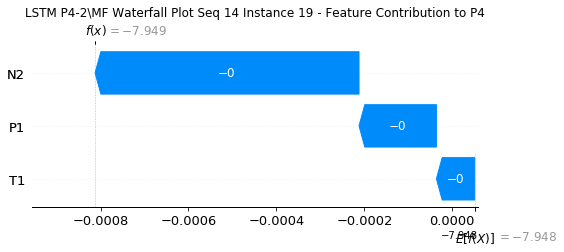

None

Contribution: [-2.16999313e-04 -7.63189424e-05 -7.59139931e-04]


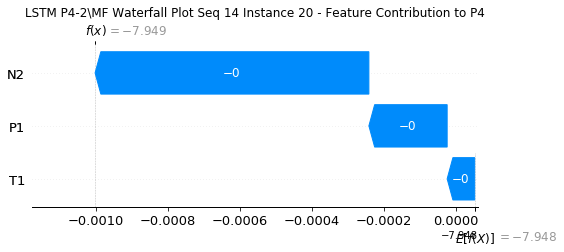

None

Contribution: [-2.66930819e-04 -7.90794625e-06 -1.07204019e-03]


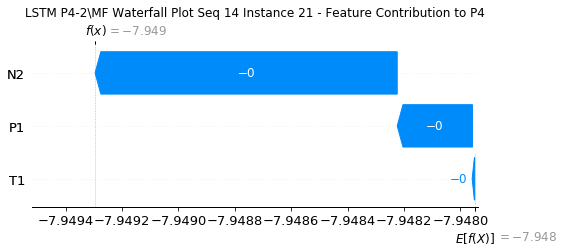

None

Contribution: [-0.00046659  0.00016849 -0.00169996]


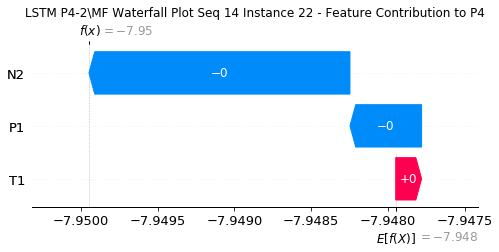

None

Contribution: [-0.0009655  -0.00031485 -0.00307008]


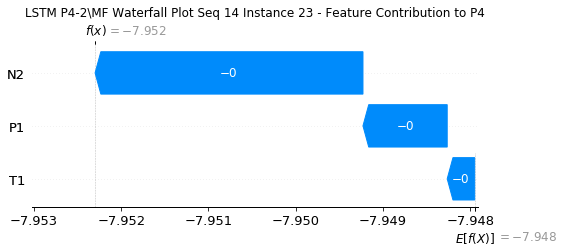

None

Contribution: [-0.00176336 -0.00027882 -0.00591126]


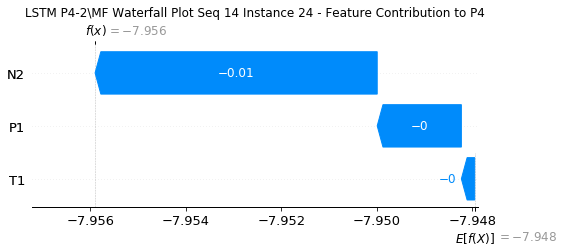

None

Contribution: [-0.03264912 -0.0060064  -0.11325539]


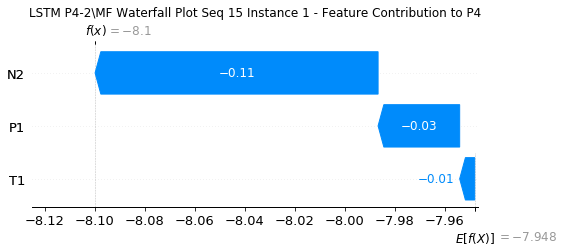

None

Contribution: [0.0017566  0.00389271 0.00451944]


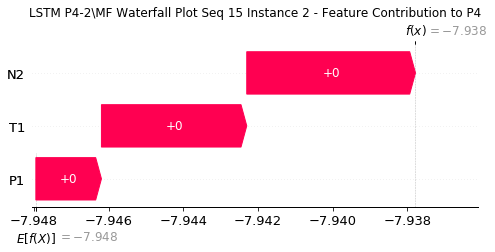

None

Contribution: [-0.0001693   0.00039597 -0.00061927]


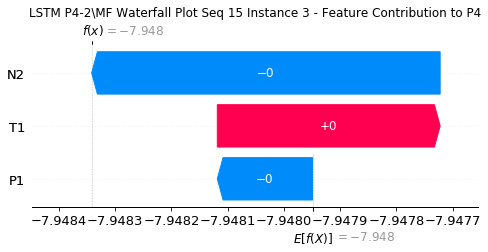

None

Contribution: [-1.14332550e-04 -8.04953411e-05 -3.85371665e-04]


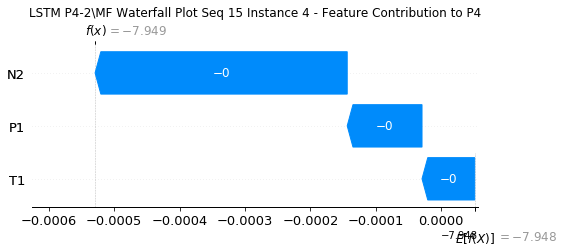

None

Contribution: [-8.40014575e-05 -8.71927187e-05 -2.67238913e-04]


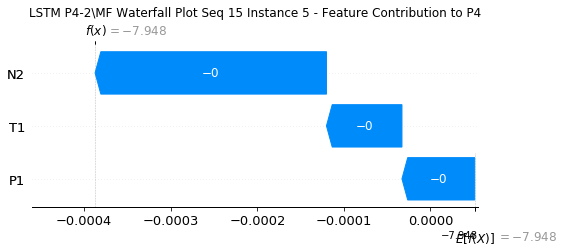

None

Contribution: [-6.82295796e-05 -6.59607759e-05 -2.27062844e-04]


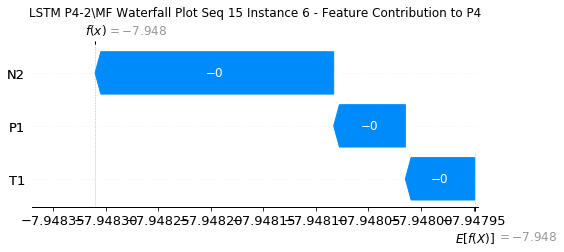

None

Contribution: [-5.48666734e-05 -4.78225352e-05 -2.16967499e-04]


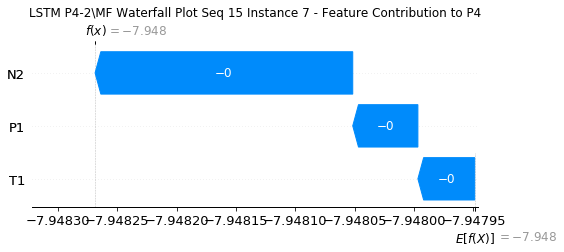

None

Contribution: [-6.55259022e-05 -4.71503367e-05 -2.16281153e-04]


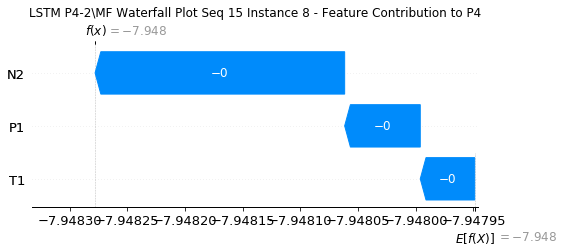

None

Contribution: [-6.16356369e-05 -5.34085387e-05 -2.19662655e-04]


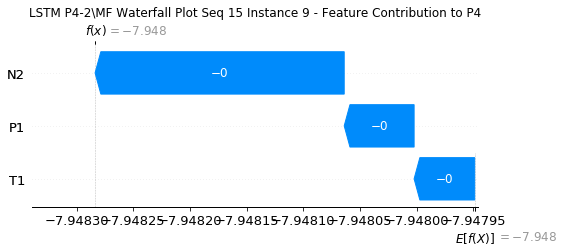

None

Contribution: [-6.83963469e-05 -4.68417911e-05 -2.32806215e-04]


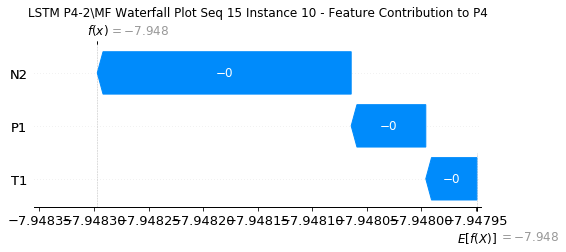

None

Contribution: [-7.48785716e-05 -4.70607867e-05 -2.49877770e-04]


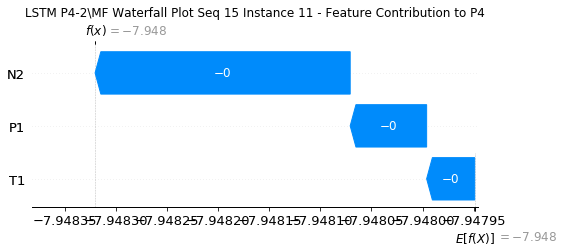

None

Contribution: [-8.11104257e-05 -5.19674249e-05 -2.74336463e-04]


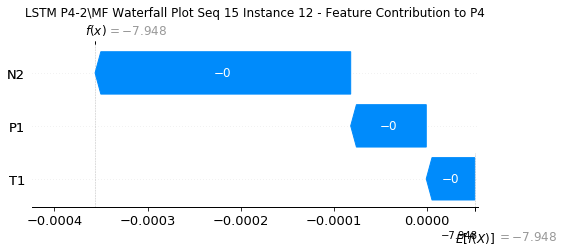

None

Contribution: [-9.06908022e-05 -5.48817189e-05 -2.99454599e-04]


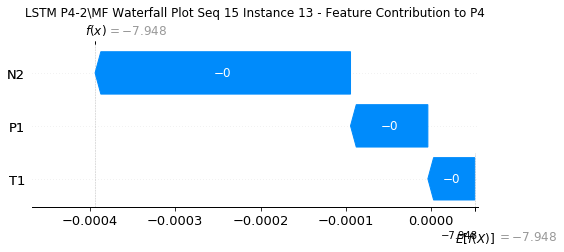

None

Contribution: [-9.65892932e-05 -4.75070040e-05 -3.31483783e-04]


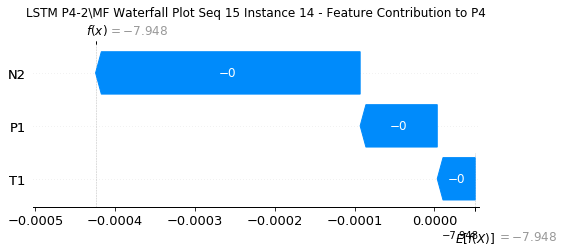

None

Contribution: [-1.09027156e-04 -6.24337054e-05 -3.62182697e-04]


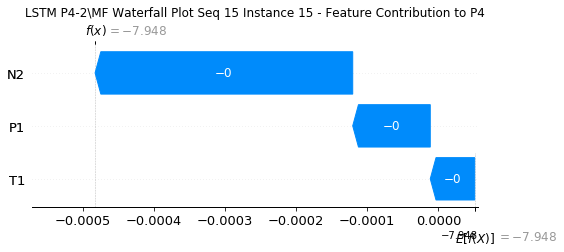

None

Contribution: [-1.21271370e-04 -7.37541493e-05 -4.00401134e-04]


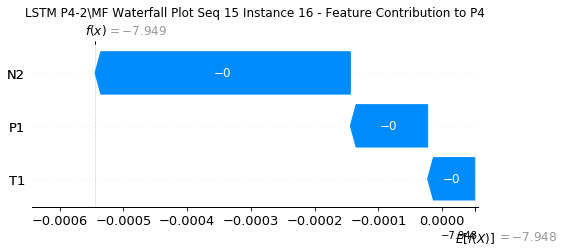

None

Contribution: [-1.29951488e-04 -7.11557253e-05 -4.45364185e-04]


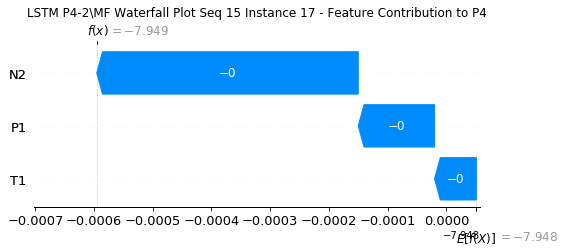

None

Contribution: [-1.48632883e-04 -8.14887455e-05 -5.00212322e-04]


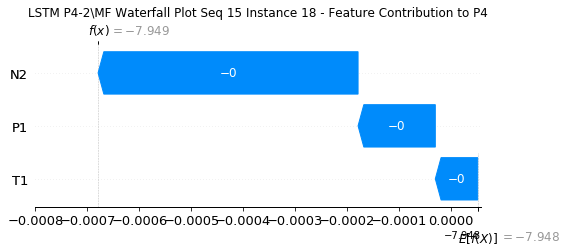

None

Contribution: [-1.73793637e-04 -6.73471450e-05 -5.86518722e-04]


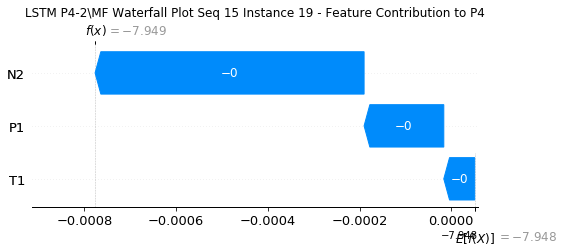

None

Contribution: [-2.14201038e-04 -1.56490294e-05 -7.39520938e-04]


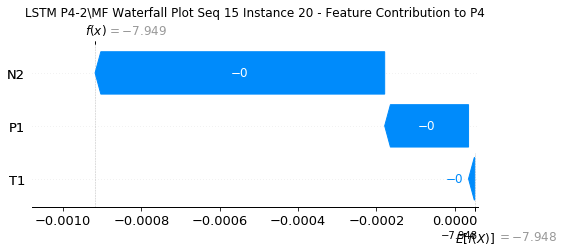

None

Contribution: [-0.0002825   0.00014829 -0.00104804]


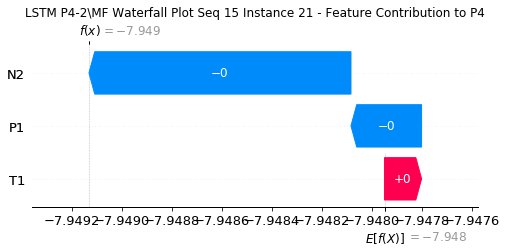

None

Contribution: [-0.0004602   0.00056585 -0.00163707]


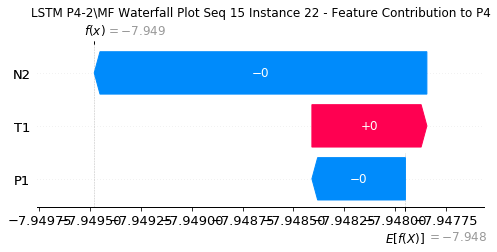

None

Contribution: [-0.00066551  0.00099262 -0.00295916]


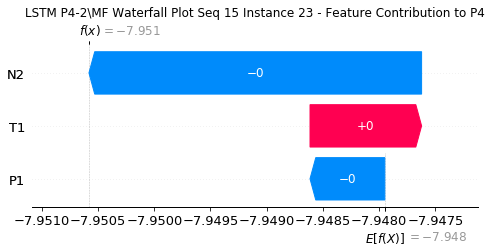

None

Contribution: [-0.00169679  0.00124712 -0.00594287]


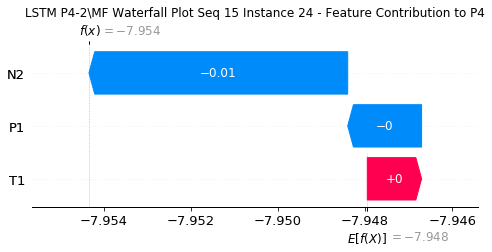

None

Contribution: [-0.03268377  0.04540346 -0.1172036 ]


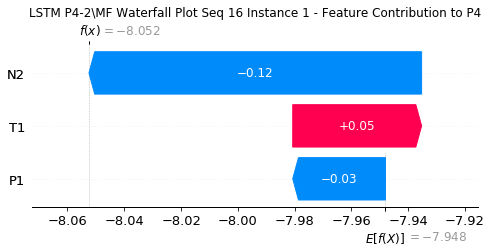

None

Contribution: [0.00169144 0.00482261 0.00464925]


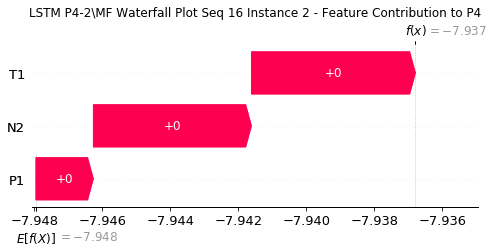

None

Contribution: [-0.00010758  0.00084613 -0.0006274 ]


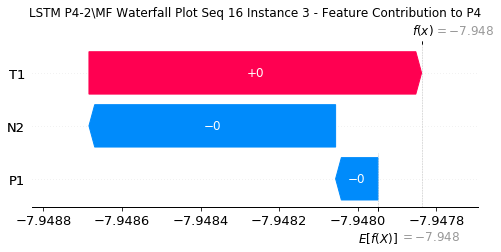

None

Contribution: [-1.07117133e-04 -2.58379822e-05 -3.86942167e-04]


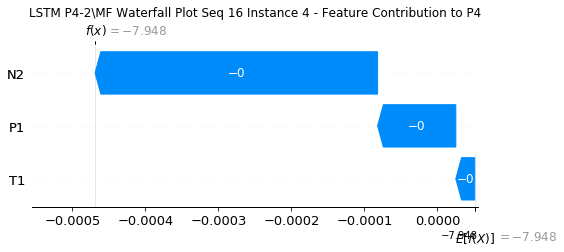

None

Contribution: [-8.29106770e-05 -5.39313278e-05 -2.66514199e-04]


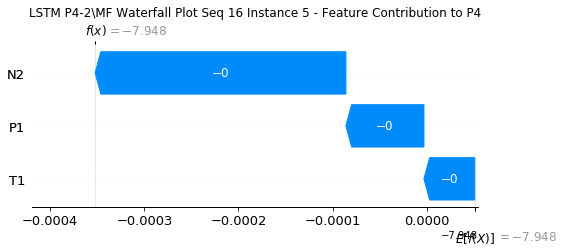

None

Contribution: [-6.53148468e-05 -4.34231014e-05 -2.25795653e-04]


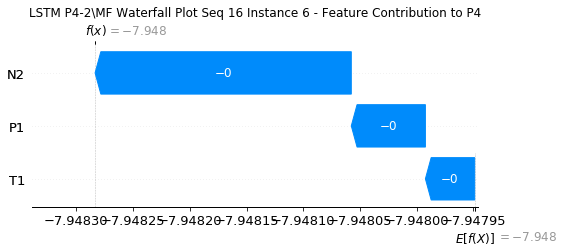

None

Contribution: [-5.81497620e-05 -3.44532262e-05 -2.17805485e-04]


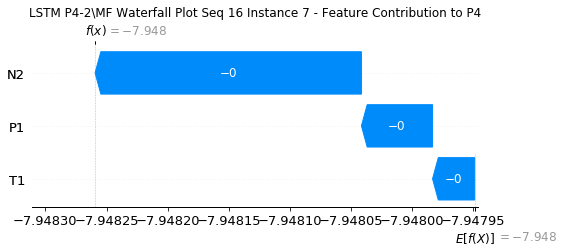

None

Contribution: [-5.70785731e-05 -4.38272799e-05 -2.13449834e-04]


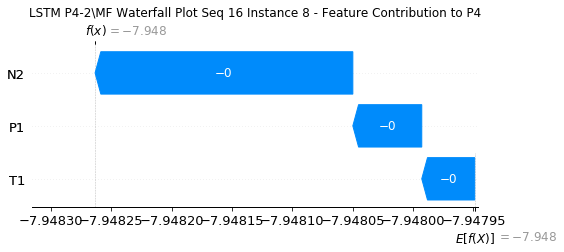

None

Contribution: [-6.44286506e-05 -3.71625574e-05 -2.20894319e-04]


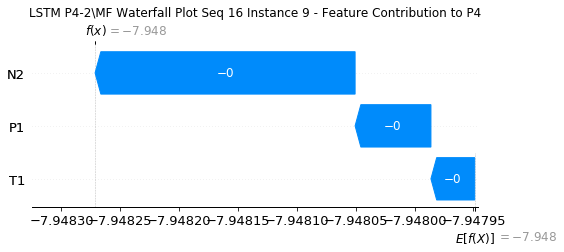

None

Contribution: [-6.82753109e-05 -4.23394282e-05 -2.32447552e-04]


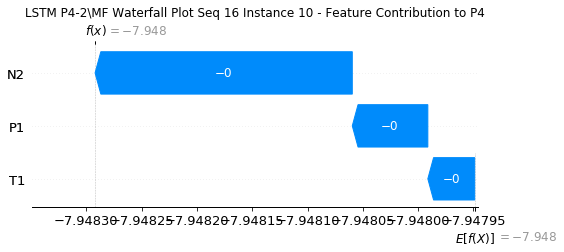

None

Contribution: [-7.49105646e-05 -4.36638707e-05 -2.50023924e-04]


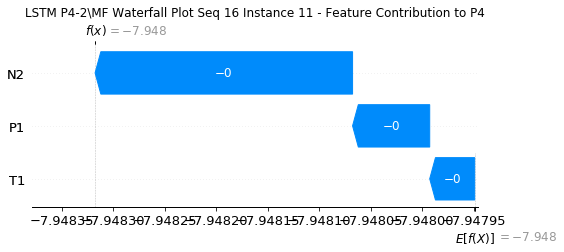

None

Contribution: [-8.07063596e-05 -5.93133150e-05 -2.73280291e-04]


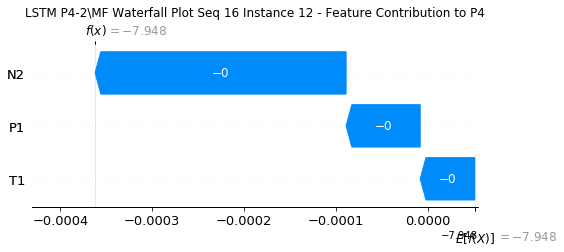

None

Contribution: [-9.15817847e-05 -5.59721606e-05 -3.01744739e-04]


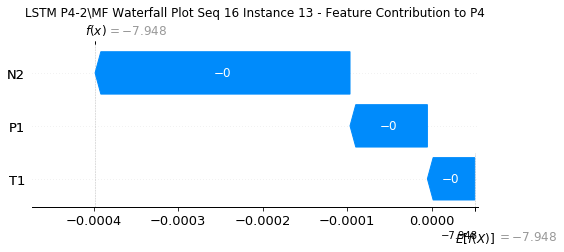

None

Contribution: [-9.75360501e-05 -6.32429990e-05 -3.32437591e-04]


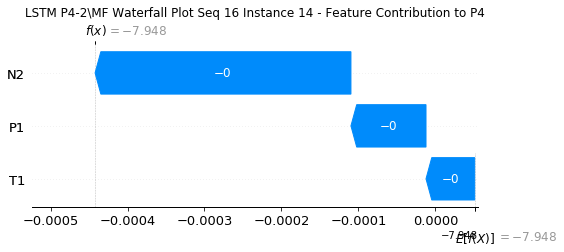

None

Contribution: [-1.10464927e-04 -6.77308405e-05 -3.66843718e-04]


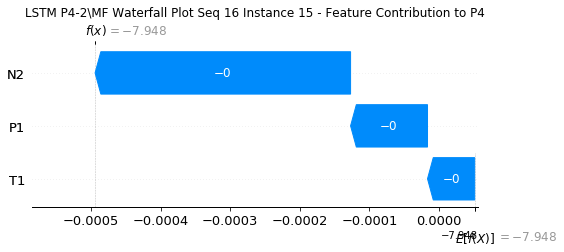

None

Contribution: [-1.21860549e-04 -7.79811798e-05 -4.05751231e-04]


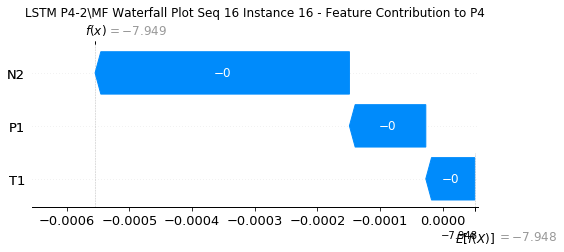

None

Contribution: [-1.31543520e-04 -6.73081713e-05 -4.51535610e-04]


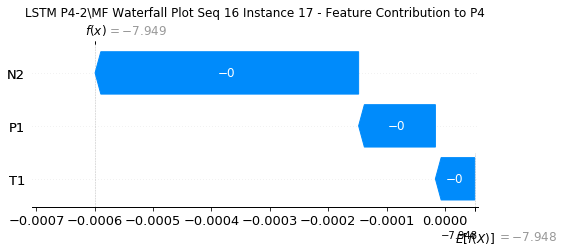

None

Contribution: [-1.46595621e-04 -8.42431106e-05 -5.07797026e-04]


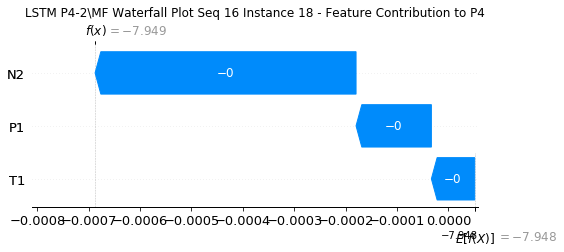

None

Contribution: [-1.69790120e-04 -7.10362947e-05 -5.95205202e-04]


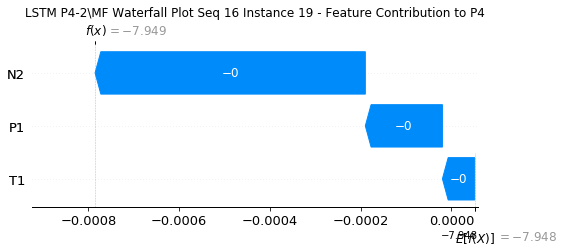

None

Contribution: [-2.06050245e-04 -3.05156132e-05 -7.50330398e-04]


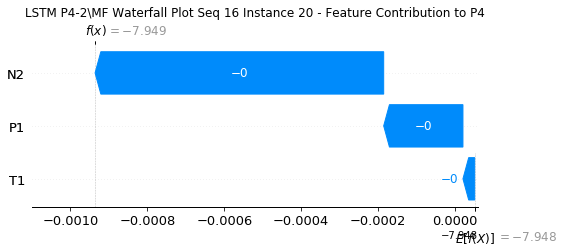

None

Contribution: [-2.68842346e-04  9.57957632e-05 -1.06267576e-03]


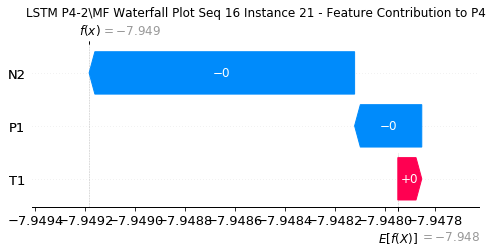

None

Contribution: [-0.0004296   0.00034555 -0.00166469]


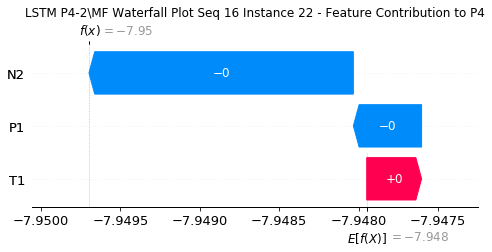

None

Contribution: [-0.00084152  0.00020534 -0.00298164]


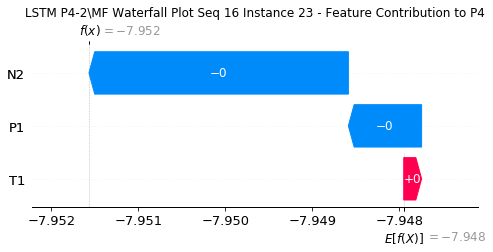

None

Contribution: [-0.00175655  0.00180475 -0.00589929]


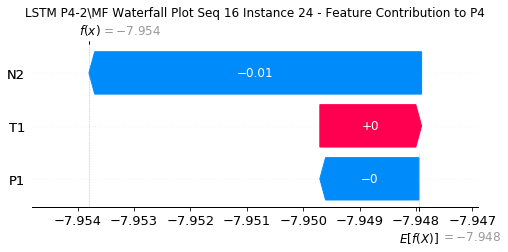

None

Contribution: [-0.03538917  0.04512398 -0.11620528]


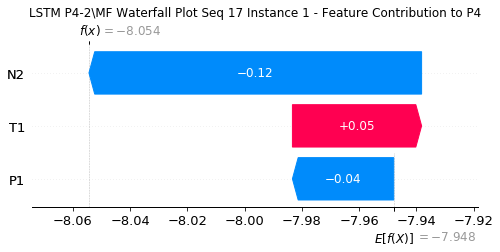

None

Contribution: [0.00170779 0.00525515 0.00457914]


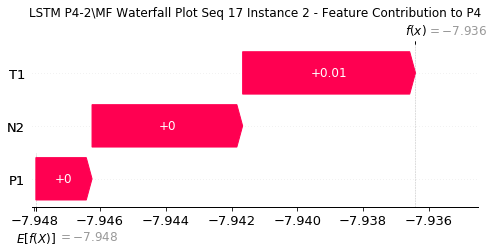

None

Contribution: [-0.00017798  0.00112962 -0.00062845]


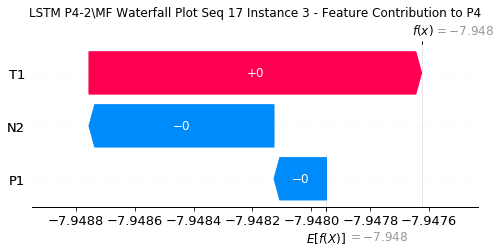

None

Contribution: [-1.12706543e-04  2.03153326e-05 -3.86846744e-04]


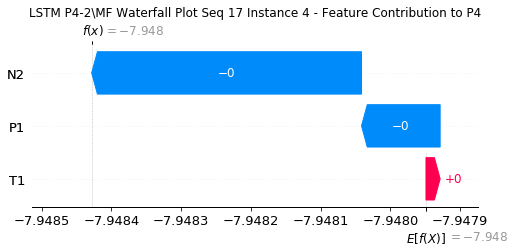

None

Contribution: [-8.04749639e-05 -4.43586440e-05 -2.66165504e-04]


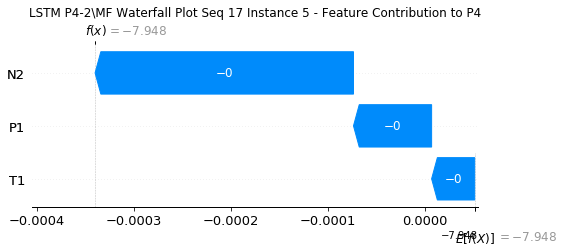

None

Contribution: [-6.71613945e-05 -2.59676925e-05 -2.25899421e-04]


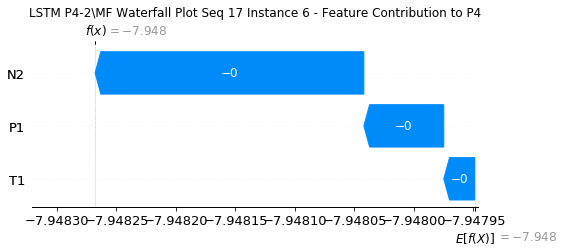

None

Contribution: [-5.92714496e-05 -3.19831654e-05 -2.17614975e-04]


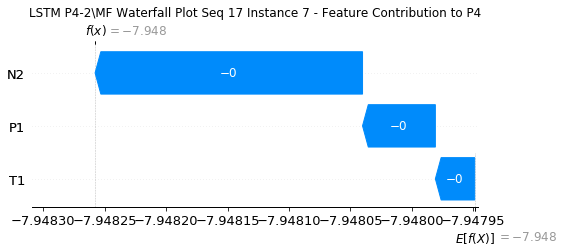

None

Contribution: [-5.96861898e-05 -2.56242416e-05 -2.16824185e-04]


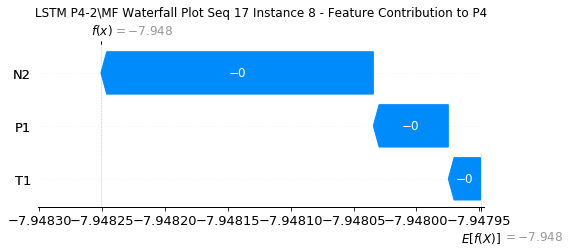

None

Contribution: [-5.96514470e-05 -2.77881583e-05 -2.19860590e-04]


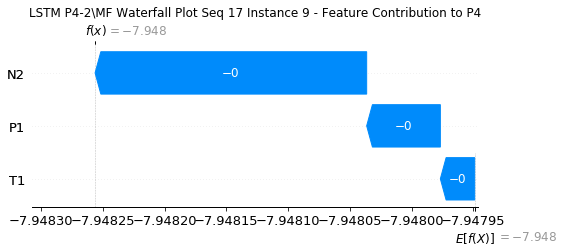

None

Contribution: [-6.43124737e-05 -2.02765753e-05 -2.30803045e-04]


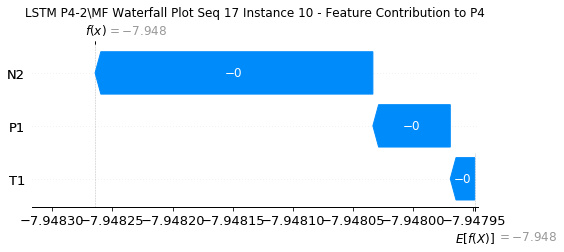

None

Contribution: [-7.25236850e-05 -2.28718968e-05 -2.48554716e-04]


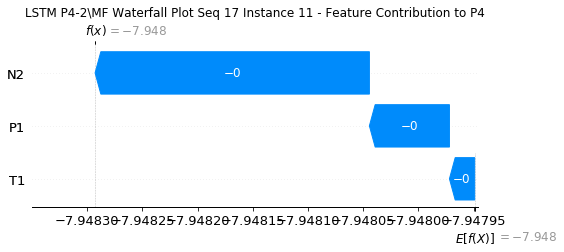

None

Contribution: [-7.84086355e-05 -3.69014423e-05 -2.73462761e-04]


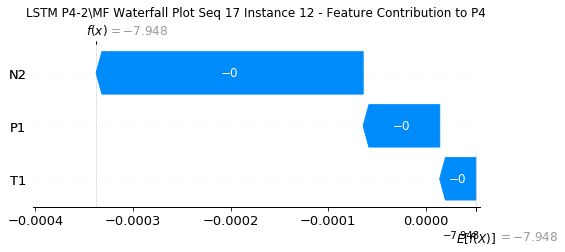

None

Contribution: [-8.82855952e-05 -3.46136704e-05 -2.99671484e-04]


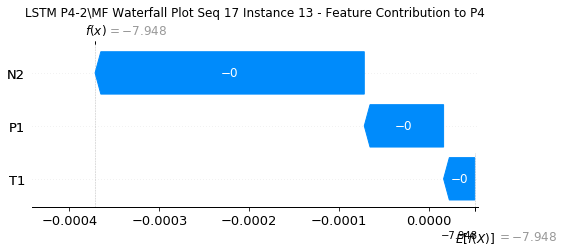

None

Contribution: [-9.70000766e-05 -3.79705971e-05 -3.31177269e-04]


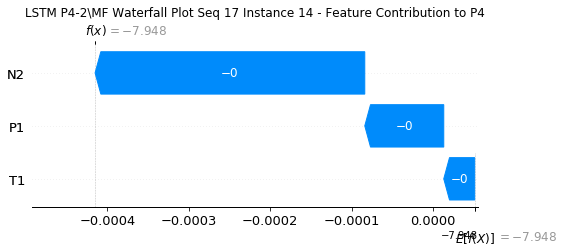

None

Contribution: [-1.07511582e-04 -4.63319920e-05 -3.64642689e-04]


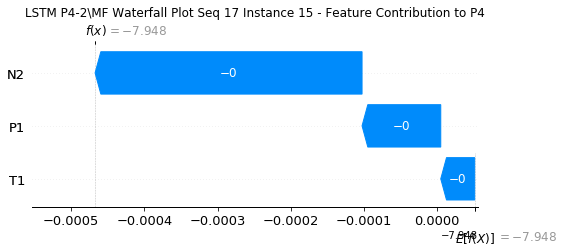

None

Contribution: [-1.19741173e-04 -5.42492053e-05 -4.04209232e-04]


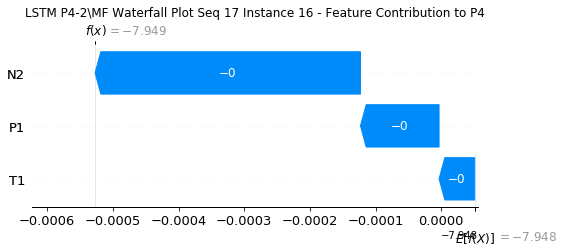

None

Contribution: [-1.29967921e-04 -5.28249491e-05 -4.47211348e-04]


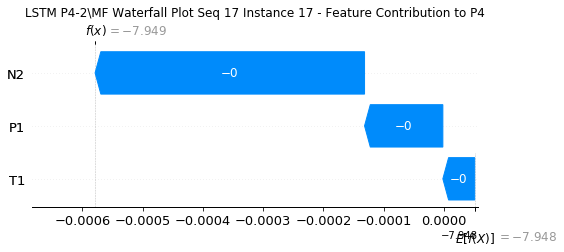

None

Contribution: [-1.51968974e-04 -5.88625204e-05 -5.06474787e-04]


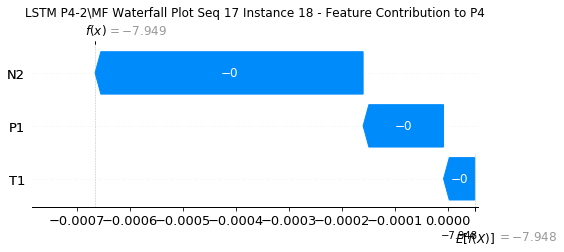

None

Contribution: [-1.77132449e-04 -3.11637831e-05 -5.93960630e-04]


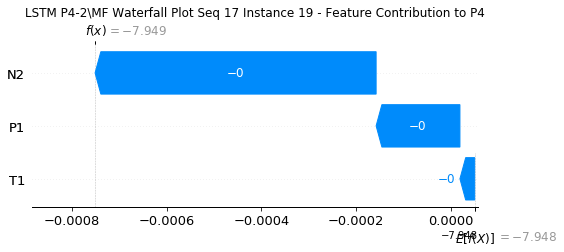

None

Contribution: [-2.18973236e-04  3.85352669e-05 -7.46803936e-04]


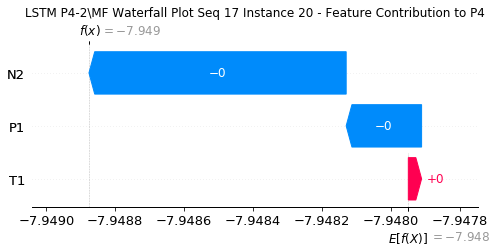

None

Contribution: [-0.00027112  0.00024934 -0.00105433]


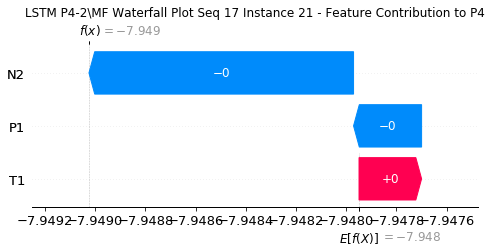

None

Contribution: [-0.00050345  0.0006943  -0.00167048]


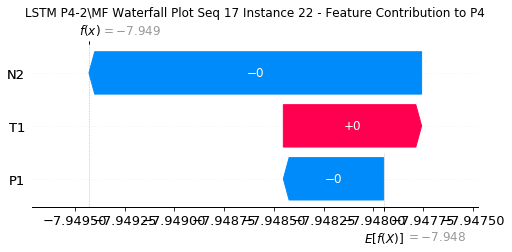

None

Contribution: [-0.00109503  0.00123571 -0.00310969]


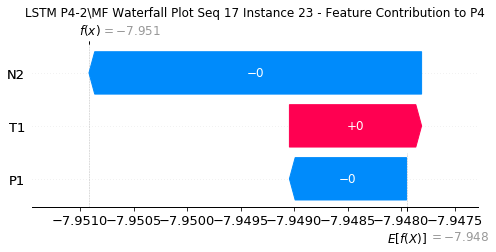

None

Contribution: [-0.00163764  0.00299099 -0.00583848]


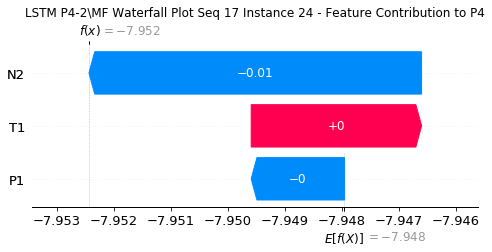

None

Contribution: [-0.03268267  0.07202735 -0.11175639]


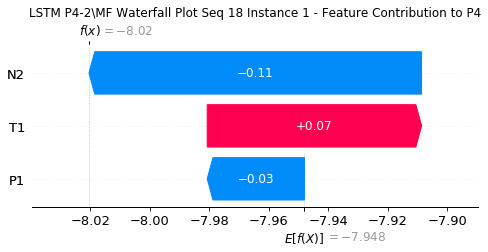

None

Contribution: [0.00186781 0.00572648 0.00497306]


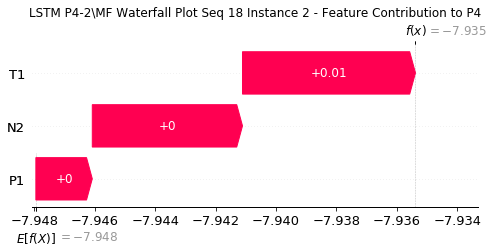

None

Contribution: [-0.00016896  0.00138483 -0.00060258]


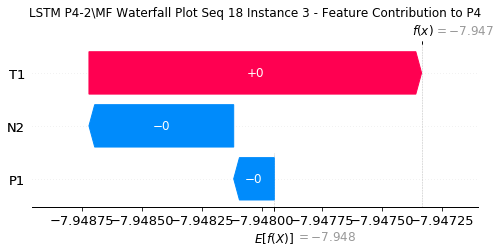

None

Contribution: [-1.1282544e-04  5.7837849e-05 -3.8364219e-04]


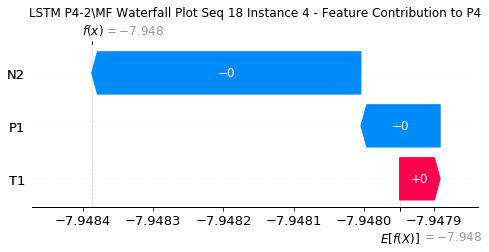

None

Contribution: [-7.66536333e-05 -2.03661391e-05 -2.66229769e-04]


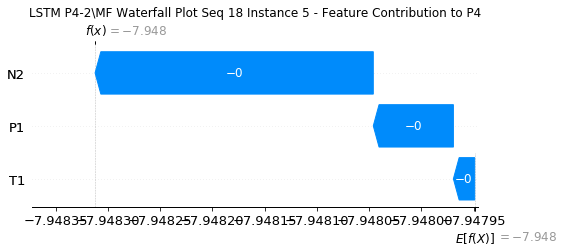

None

Contribution: [-6.63177789e-05 -5.80026384e-06 -2.23124542e-04]


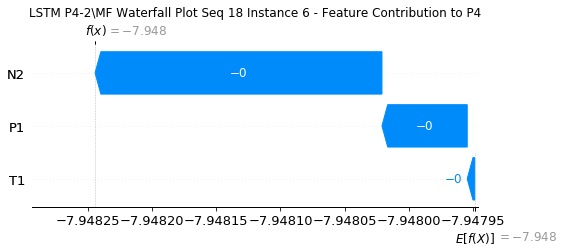

None

Contribution: [-5.29912248e-05  3.89065673e-06 -2.13473876e-04]


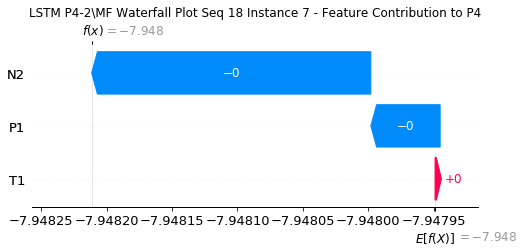

None

Contribution: [-5.99307074e-05  3.74306357e-06 -2.13182998e-04]


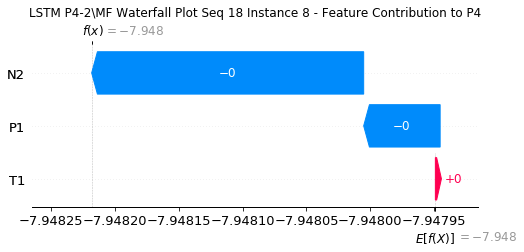

None

Contribution: [-5.59038480e-05 -1.79923021e-06 -2.16193779e-04]


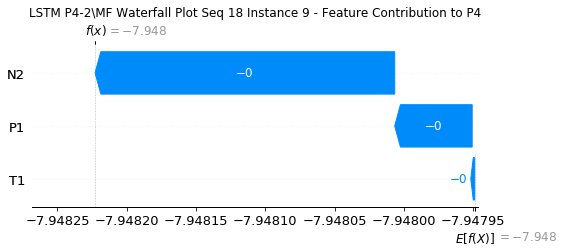

None

Contribution: [-6.56214297e-05 -9.45439485e-06 -2.30636179e-04]


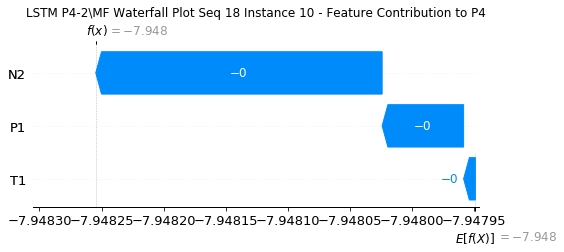

None

Contribution: [-7.40165085e-05 -1.02322707e-05 -2.48781536e-04]


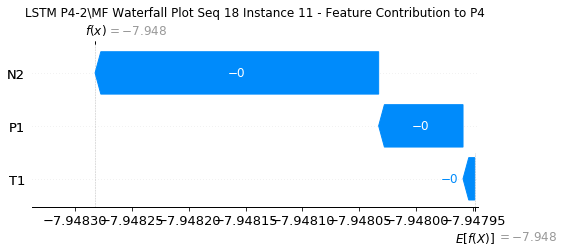

None

Contribution: [-7.90277217e-05 -1.60298539e-05 -2.70042913e-04]


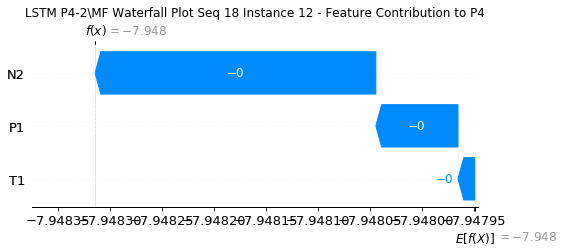

None

Contribution: [-9.10902129e-05 -2.34618069e-05 -3.02305480e-04]


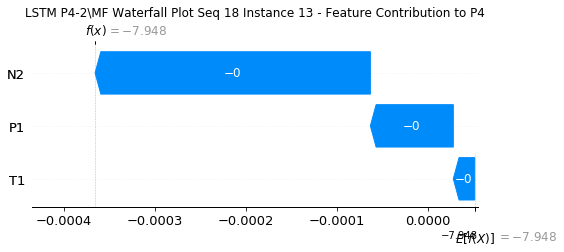

None

Contribution: [-9.71006340e-05 -3.92437430e-05 -3.34758171e-04]


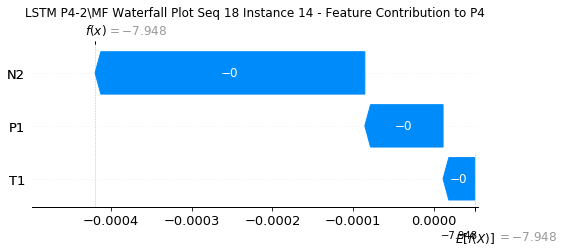

None

Contribution: [-1.11660267e-04 -3.48704919e-05 -3.69345220e-04]


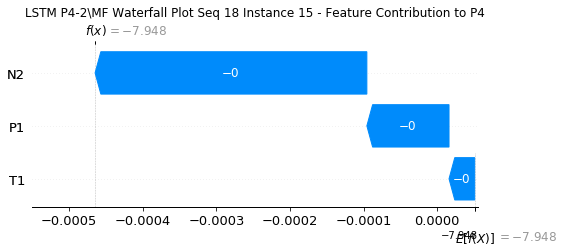

None

Contribution: [-1.24546397e-04 -4.24315925e-05 -4.08853592e-04]


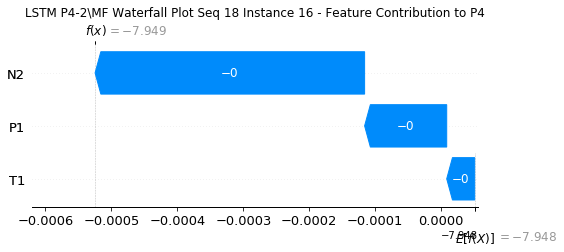

None

Contribution: [-1.28778735e-04 -2.35836580e-05 -4.54567157e-04]


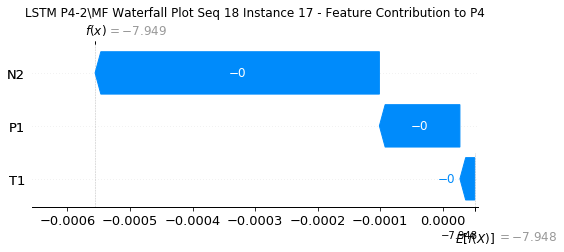

None

Contribution: [-1.58242605e-04 -3.40714202e-05 -5.14118274e-04]


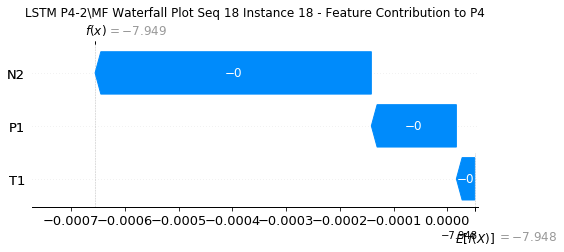

None

Contribution: [-1.86162052e-04  2.66581128e-06 -6.03151010e-04]


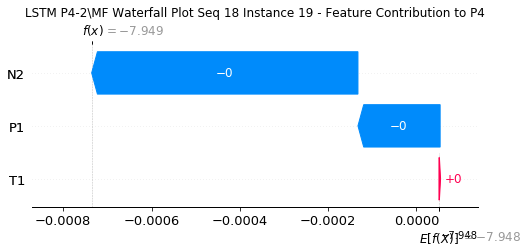

None

Contribution: [-2.34165137e-04  9.47896637e-05 -7.63344427e-04]


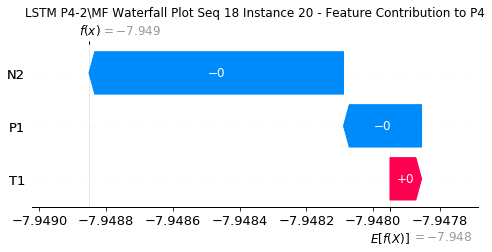

None

Contribution: [-0.0003022   0.00032832 -0.00107903]


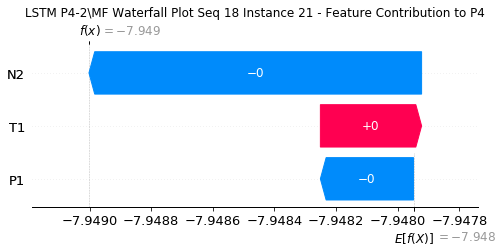

None

Contribution: [-0.00053148  0.00092075 -0.00169694]


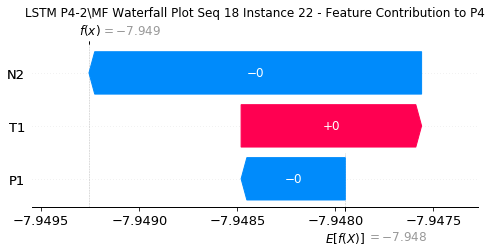

None

Contribution: [-0.00080928  0.00176625 -0.00305273]


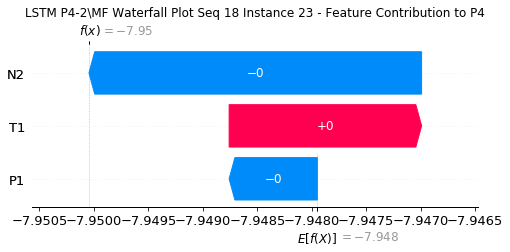

None

Contribution: [-0.00171901  0.00300727 -0.00605742]


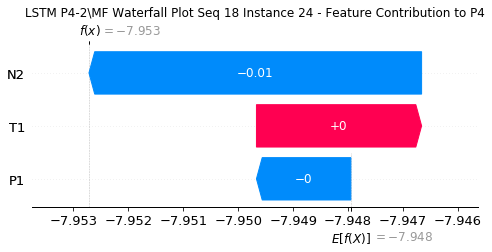

None

Contribution: [-0.03581419  0.0718195  -0.12108866]


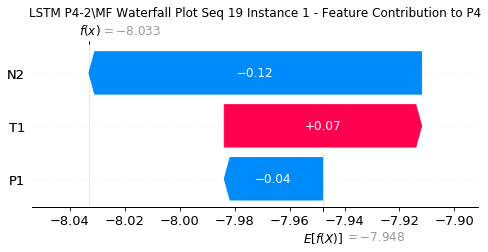

None

Contribution: [0.00165114 0.00554796 0.00464395]


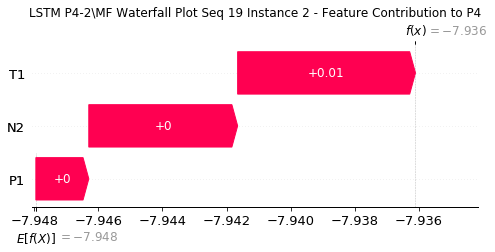

None

Contribution: [-0.00026442  0.00097742 -0.00065144]


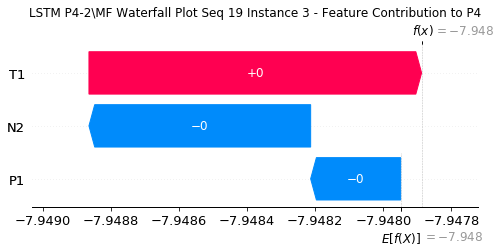

None

Contribution: [-1.25790076e-04 -3.94901874e-06 -3.90162690e-04]


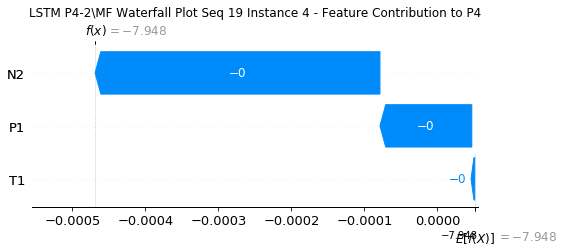

None

Contribution: [-9.17194554e-05 -3.10884467e-05 -2.65949784e-04]


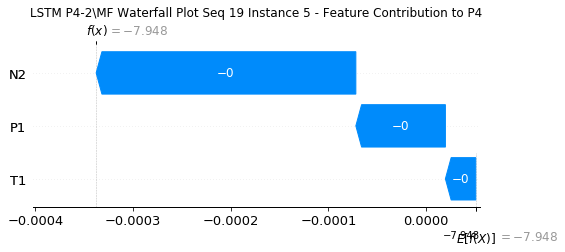

None

Contribution: [-7.33739403e-05 -3.24439545e-05 -2.26601588e-04]


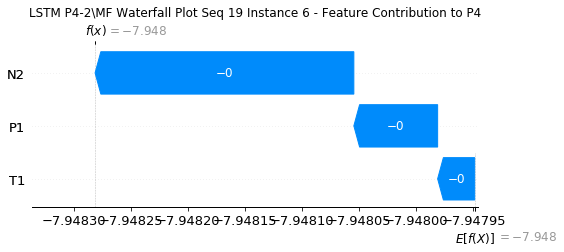

None

Contribution: [-6.97212960e-05 -2.82109006e-05 -2.20483968e-04]


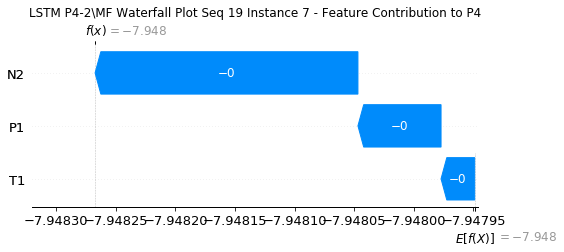

None

Contribution: [-7.30636795e-05 -2.23720191e-05 -2.19319787e-04]


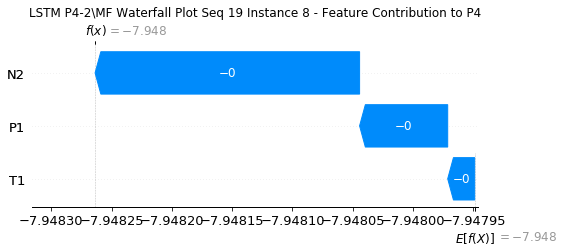

None

Contribution: [-6.80209132e-05 -3.91165919e-05 -2.21254767e-04]


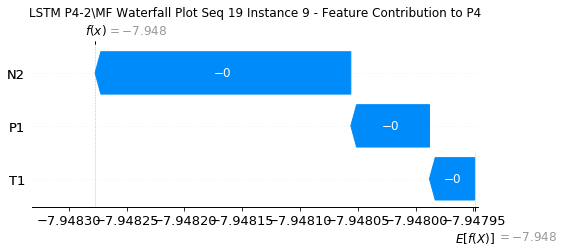

None

Contribution: [-7.21119849e-05 -3.22992480e-05 -2.32180462e-04]


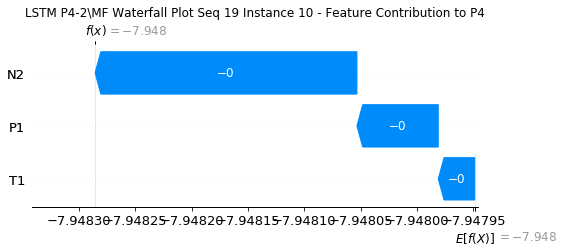

None

Contribution: [-8.05370259e-05 -3.12070099e-05 -2.50354345e-04]


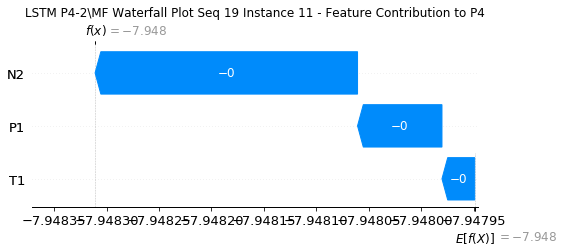

None

Contribution: [-9.18846075e-05 -3.58484237e-05 -2.77018020e-04]


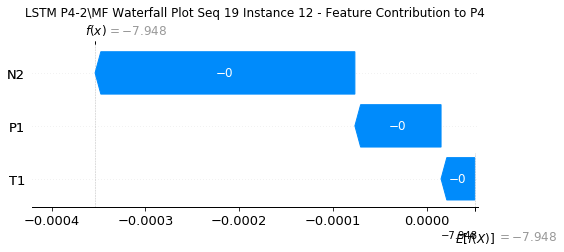

None

Contribution: [-9.63885513e-05 -4.29093823e-05 -3.02077913e-04]


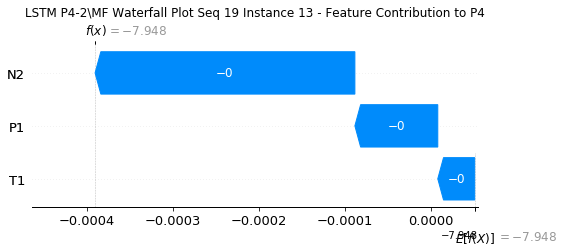

None

Contribution: [-1.03026894e-04 -4.21758930e-05 -3.35433812e-04]


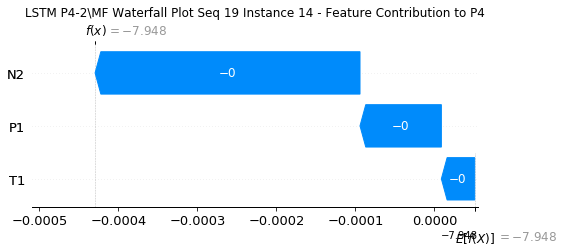

None

Contribution: [-1.15312144e-04 -4.92346281e-05 -3.67584618e-04]


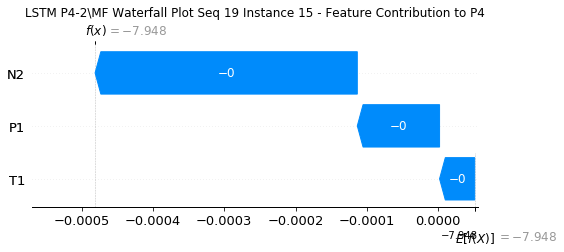

None

Contribution: [-1.26814007e-04 -5.61582005e-05 -4.07080436e-04]


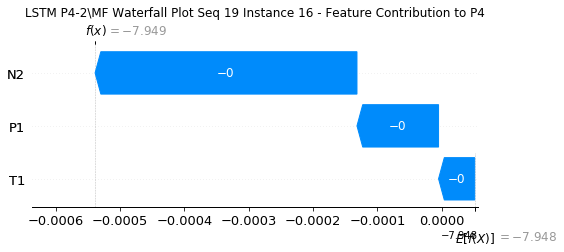

None

Contribution: [-1.37783740e-04 -5.35386278e-05 -4.58783189e-04]


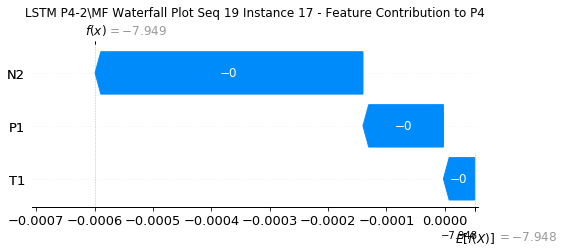

None

Contribution: [-1.58849928e-04 -4.62973197e-05 -5.10383367e-04]


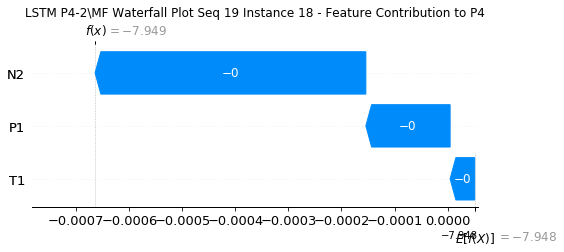

None

Contribution: [-1.86432049e-04 -1.52358467e-05 -5.98234025e-04]


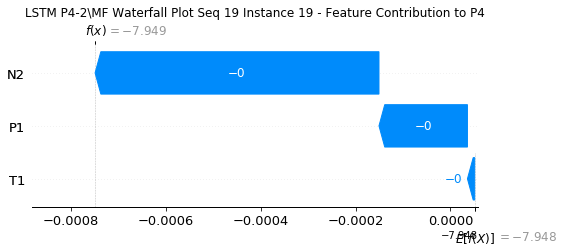

None

Contribution: [-2.34616913e-04  5.74036275e-05 -7.53301989e-04]


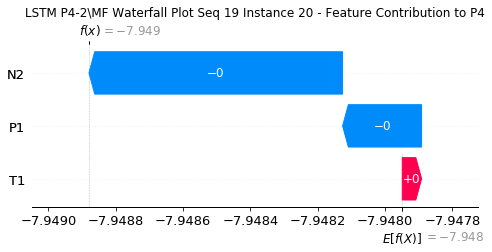

None

Contribution: [-0.00029939  0.00025785 -0.00106181]


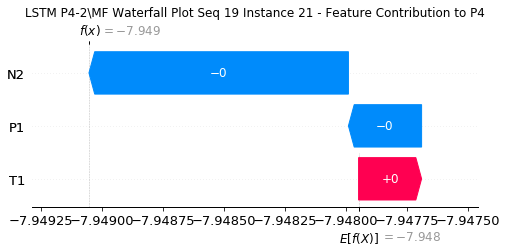

None

Contribution: [-0.00049667  0.00077769 -0.00165693]


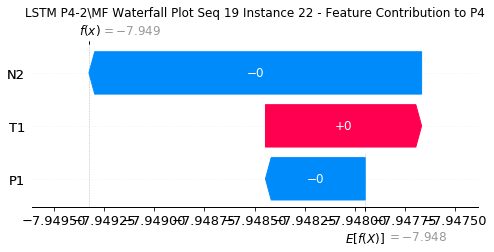

None

Contribution: [-0.00094079  0.00135054 -0.00309314]


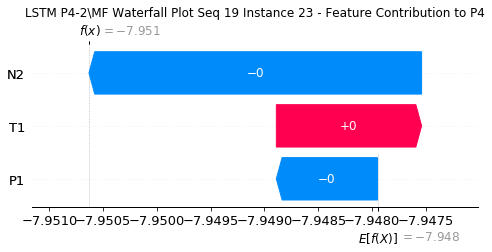

None

Contribution: [-0.00198028  0.00265332 -0.00608459]


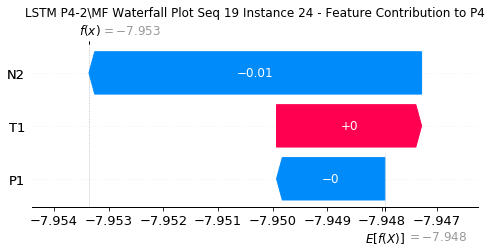

None

Contribution: [-0.03997309  0.06228713 -0.11767632]


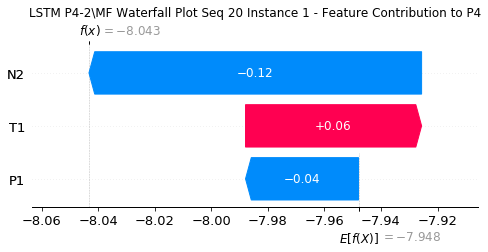

None

Contribution: [0.0019154  0.00572734 0.00478304]


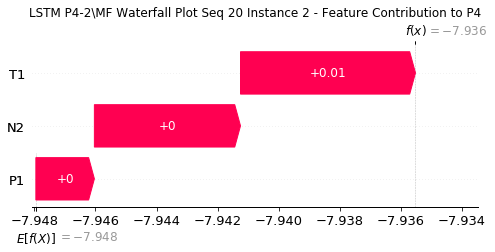

None

Contribution: [-0.00022389  0.00117447 -0.0006289 ]


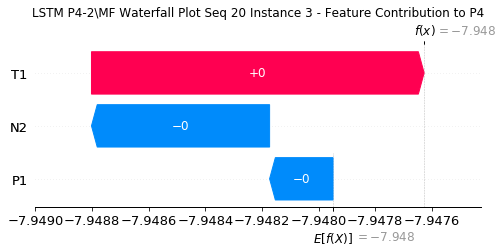

None

Contribution: [-1.23918004e-04  2.29815218e-05 -3.87575901e-04]


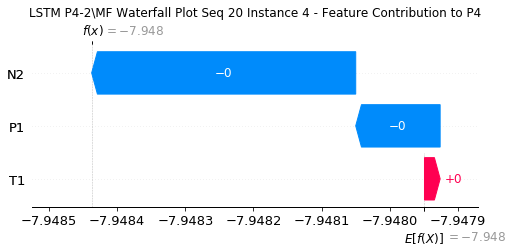

None

Contribution: [-8.75318145e-05 -2.95598726e-05 -2.65968178e-04]


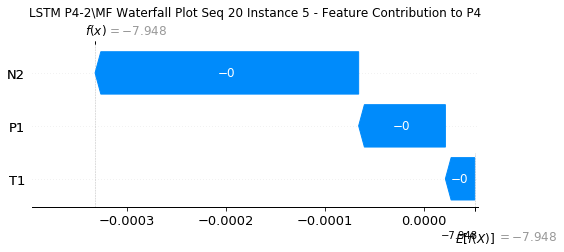

None

Contribution: [-7.23462866e-05 -2.15030062e-05 -2.25766538e-04]


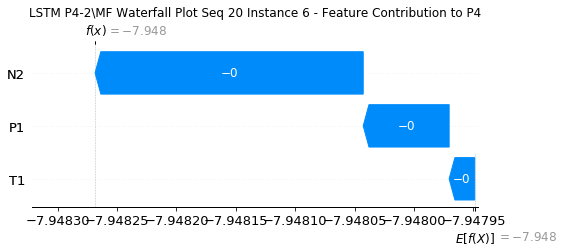

None

Contribution: [-6.54394134e-05 -1.20193258e-05 -2.18814066e-04]


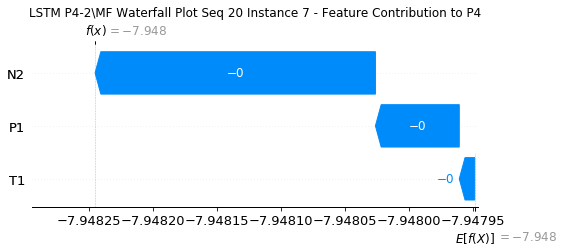

None

Contribution: [-6.65628838e-05 -1.58089600e-05 -2.15784935e-04]


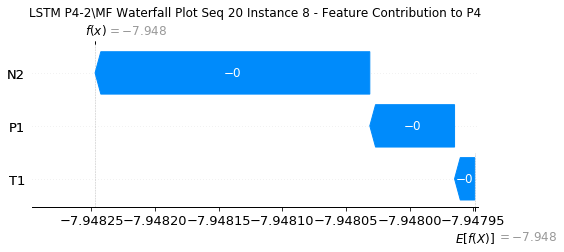

None

Contribution: [-6.84646767e-05 -2.10626573e-05 -2.22143511e-04]


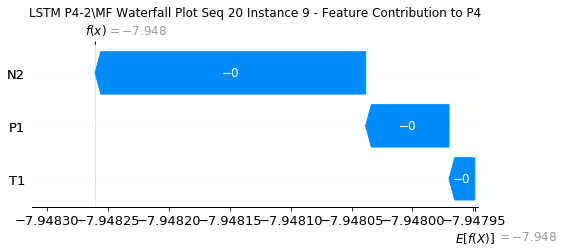

None

Contribution: [-7.07944875e-05 -2.16965455e-05 -2.30548119e-04]


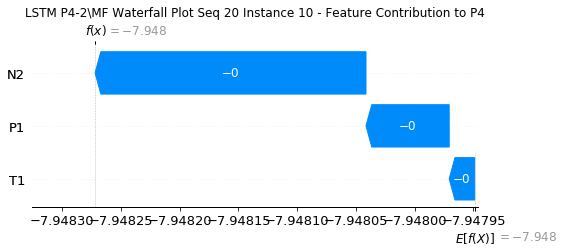

None

Contribution: [-7.87129184e-05 -2.14651453e-05 -2.48106021e-04]


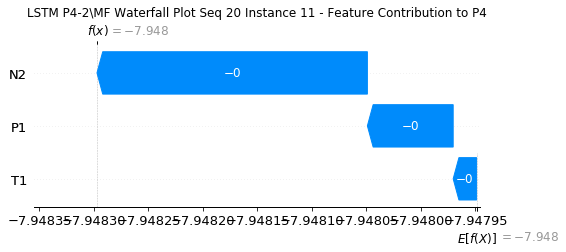

None

Contribution: [-8.88578465e-05 -4.11375061e-05 -2.69319947e-04]


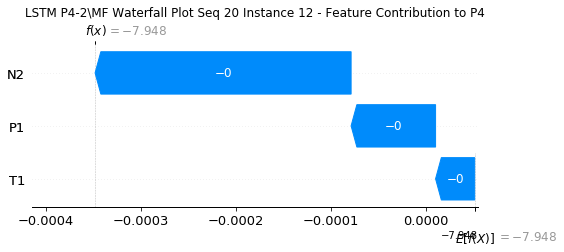

None

Contribution: [-9.48602344e-05 -3.33826872e-05 -2.99272362e-04]


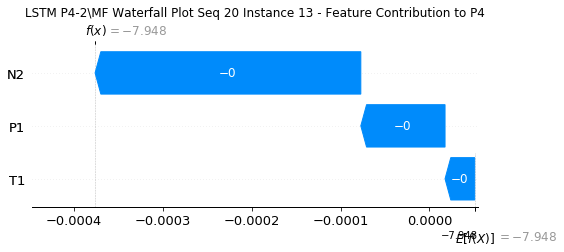

None

Contribution: [-9.64109830e-05 -3.81414067e-05 -3.29689528e-04]


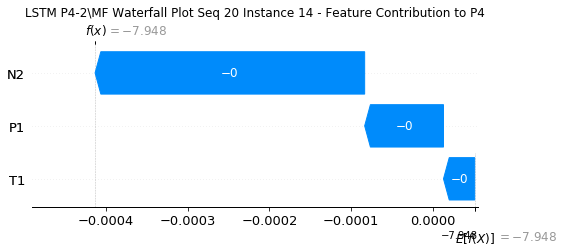

None

Contribution: [-1.15931800e-04 -4.21852790e-05 -3.64639439e-04]


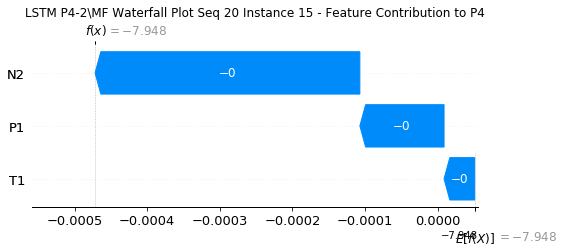

None

Contribution: [-1.29639651e-04 -5.02248507e-05 -4.04331179e-04]


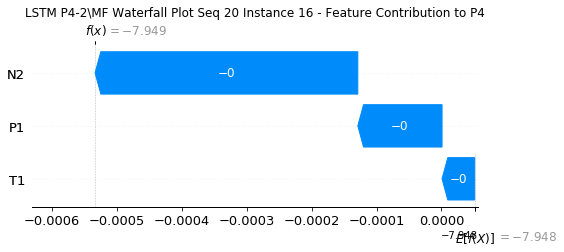

None

Contribution: [-1.42748077e-04 -4.09484577e-05 -4.48141967e-04]


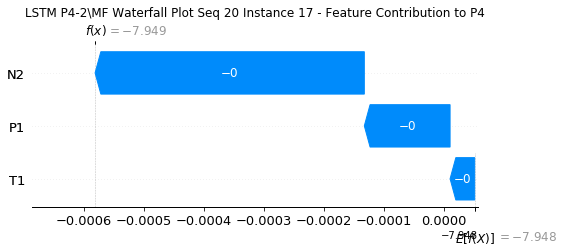

None

Contribution: [-1.61229257e-04 -3.97001166e-05 -5.04769507e-04]


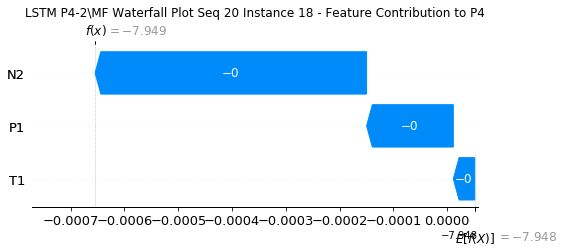

None

Contribution: [-1.90268817e-04 -6.41203537e-06 -5.90595954e-04]


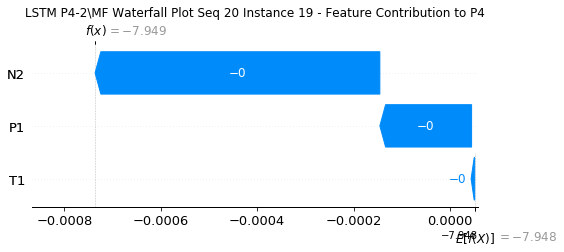

None

Contribution: [-2.33767862e-04  7.92455042e-05 -7.37379196e-04]


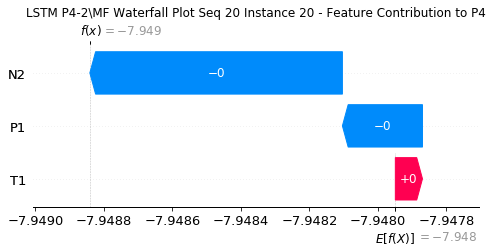

None

Contribution: [-0.00031553  0.00029451 -0.00103781]


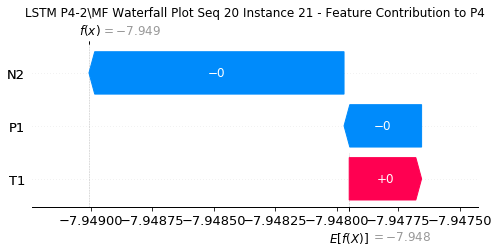

None

Contribution: [-0.00052482  0.00084257 -0.0015992 ]


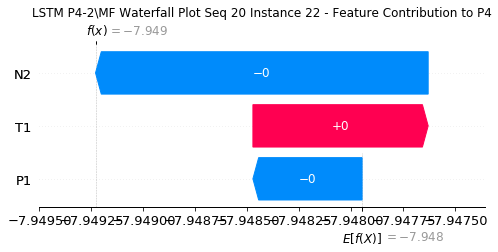

None

Contribution: [-0.00086071  0.00106075 -0.00294194]


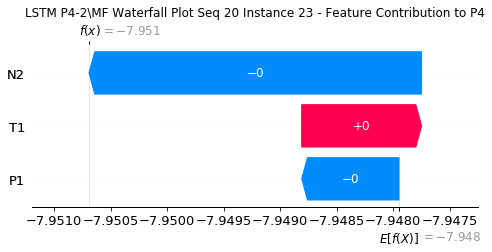

None

Contribution: [-0.00194037  0.00212096 -0.00595315]


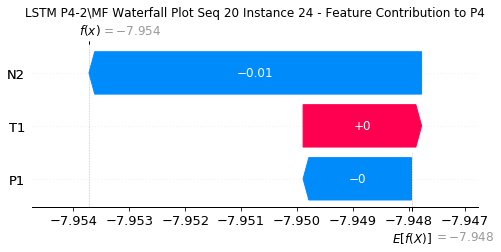

None

Contribution: [-0.03557266  0.05374065 -0.11245096]


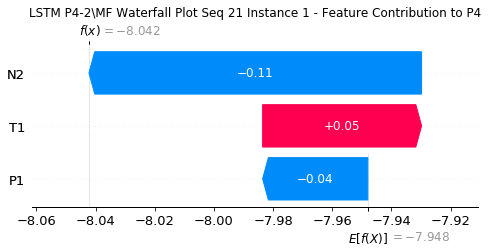

None

Contribution: [0.00153837 0.00527077 0.00468751]


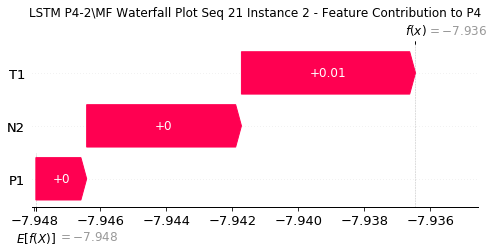

None

Contribution: [-0.00020179  0.00113977 -0.00062001]


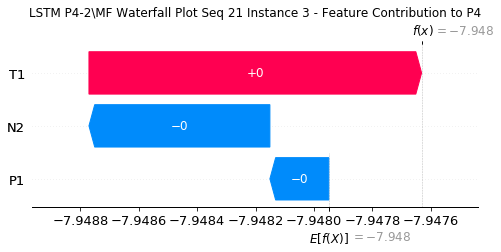

None

Contribution: [-1.17960203e-04  1.61638995e-05 -3.86737175e-04]


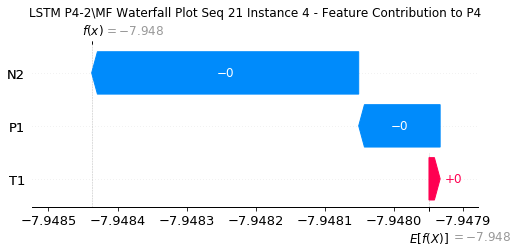

None

Contribution: [-9.16658455e-05 -5.08097489e-06 -2.62129059e-04]


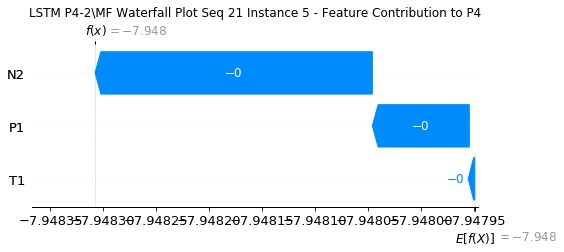

None

Contribution: [-7.09878187e-05 -2.64186223e-05 -2.24879097e-04]


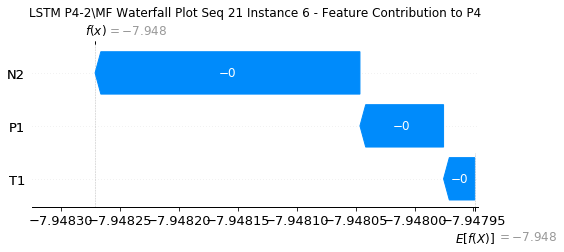

None

Contribution: [-6.99616002e-05 -2.89473154e-05 -2.16279544e-04]


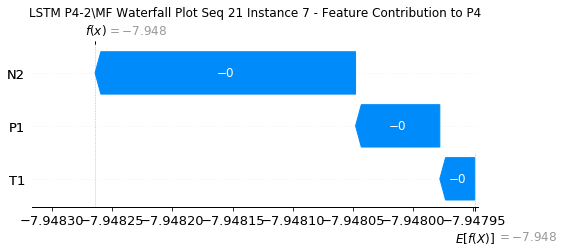

None

Contribution: [-6.83954301e-05 -3.91537589e-05 -2.14282130e-04]


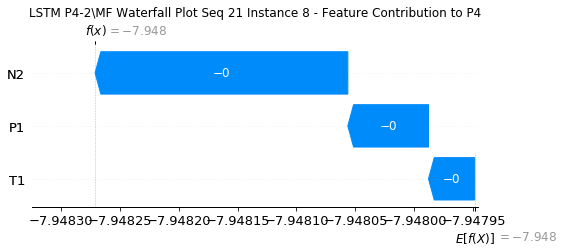

None

Contribution: [-6.80822242e-05 -3.93007383e-05 -2.19573313e-04]


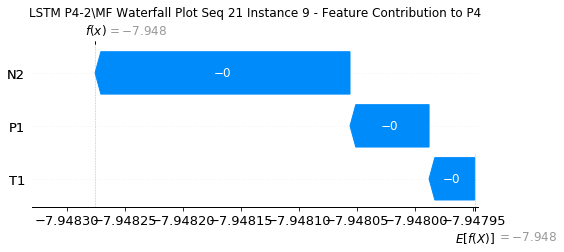

None

Contribution: [-6.59911606e-05 -2.38015320e-05 -2.31028628e-04]


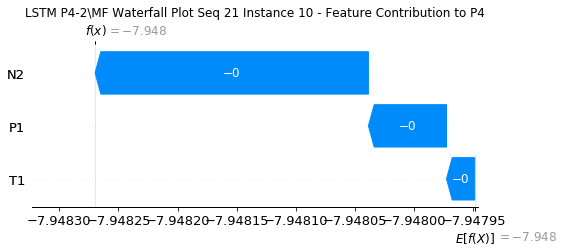

None

Contribution: [-7.52231025e-05 -2.43349206e-05 -2.48670312e-04]


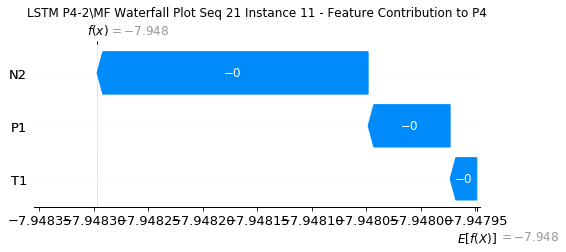

None

Contribution: [-9.20037755e-05 -3.12110592e-05 -2.76462648e-04]


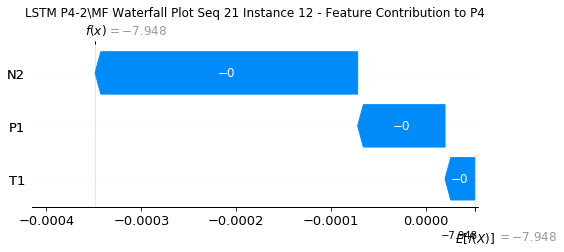

None

Contribution: [-9.22235046e-05 -3.68532370e-05 -3.00358493e-04]


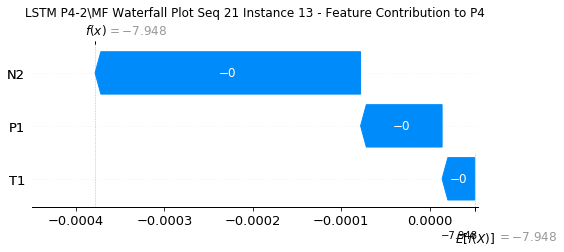

None

Contribution: [-1.03574273e-04 -4.45671494e-05 -3.33485224e-04]


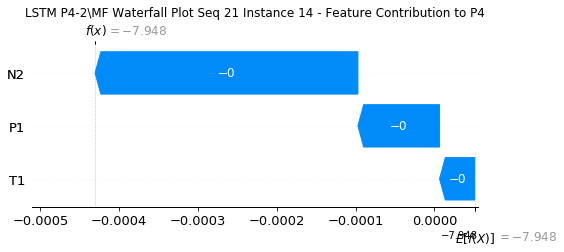

None

Contribution: [-1.20967032e-04 -3.38696139e-05 -3.69043593e-04]


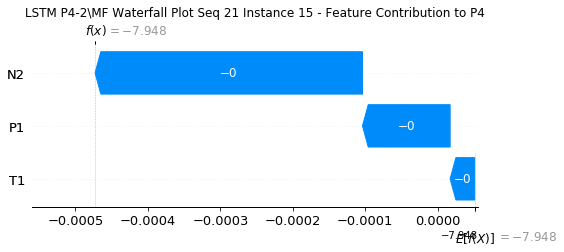

None

Contribution: [-1.31414091e-04 -4.18922622e-05 -4.08640758e-04]


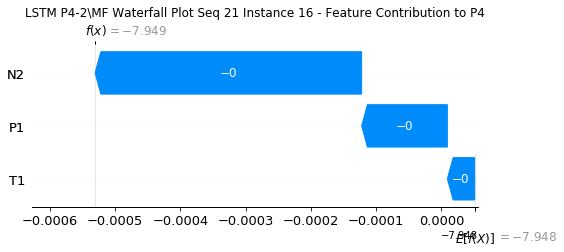

None

Contribution: [-1.39934448e-04 -3.26321890e-05 -4.55147700e-04]


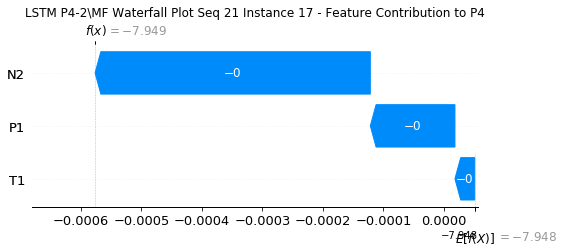

None

Contribution: [-1.68749690e-04 -3.33089575e-05 -5.13252955e-04]


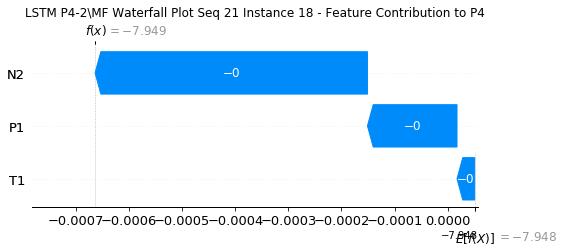

None

Contribution: [-1.89650131e-04  2.48314781e-05 -5.98178356e-04]


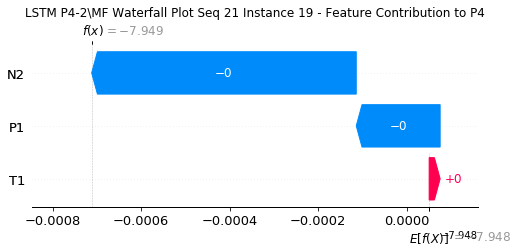

None

Contribution: [-0.00023436  0.00013904 -0.00075715]


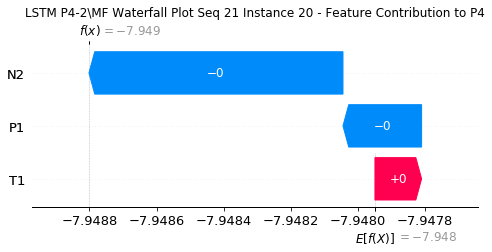

None

Contribution: [-0.00029473  0.00043097 -0.00105994]


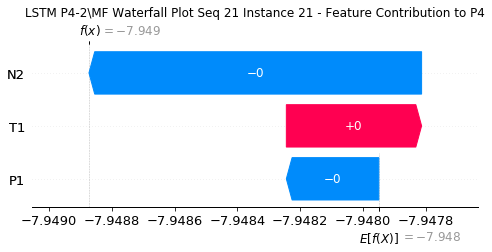

None

Contribution: [-0.00051062  0.00118936 -0.00167662]


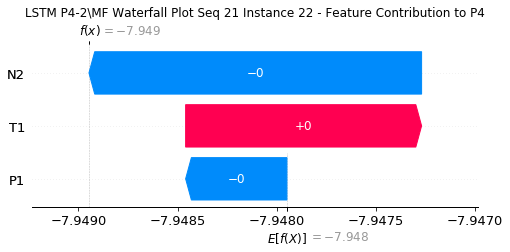

None

Contribution: [-0.00095611  0.00244139 -0.00305752]


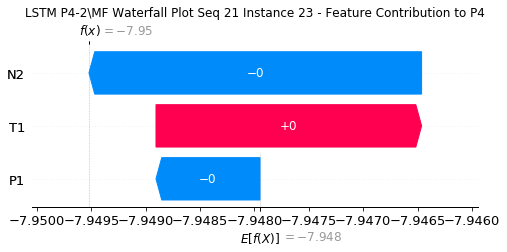

None

Contribution: [-0.00226878  0.00393534 -0.00612883]


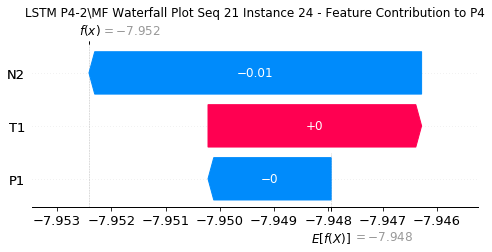

None

Contribution: [-0.03706828  0.10625521 -0.11509445]


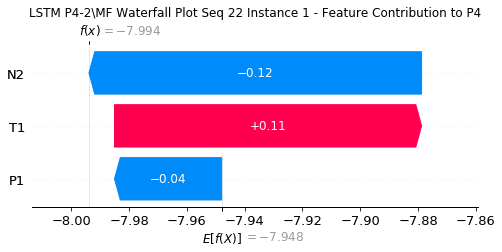

None

Contribution: [0.00177671 0.006632   0.00513388]


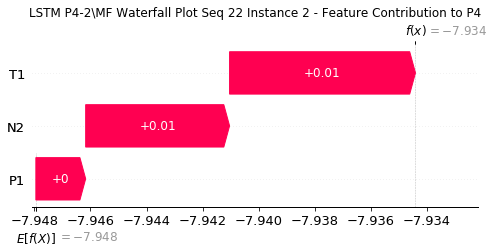

None

Contribution: [-0.00028104  0.00174614 -0.00052704]


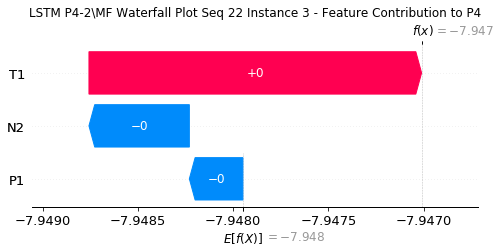

None

Contribution: [-1.21522739e-04  5.82908946e-05 -3.71016660e-04]


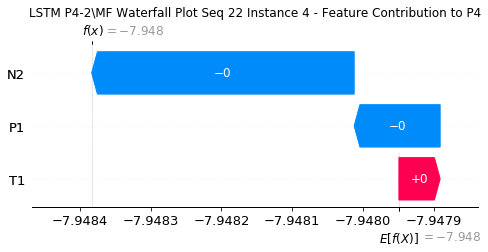

None

Contribution: [-8.25241123e-05 -3.95516099e-06 -2.55652036e-04]


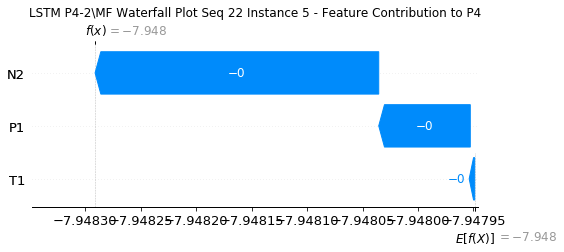

None

Contribution: [-7.50575056e-05 -1.47743534e-05 -2.18407306e-04]


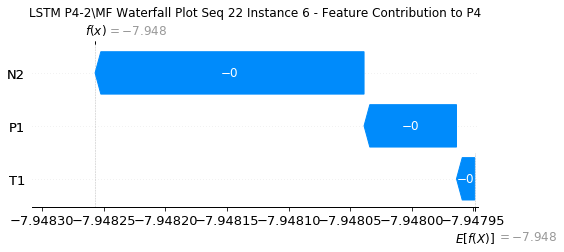

None

Contribution: [-6.46048928e-05 -8.38304920e-06 -2.11118236e-04]


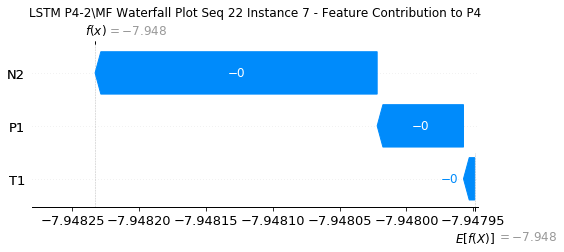

None

Contribution: [-6.82006735e-05 -2.92655900e-05 -2.11444003e-04]


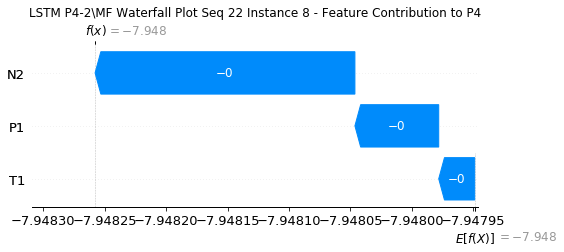

None

Contribution: [-7.19088996e-05 -2.27787744e-05 -2.16157721e-04]


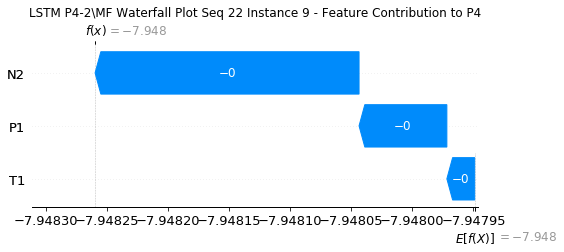

None

Contribution: [-6.81992754e-05 -2.41063933e-05 -2.28423967e-04]


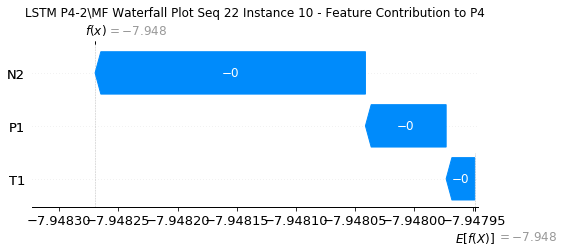

None

Contribution: [-7.57122143e-05 -1.68341596e-05 -2.45122483e-04]


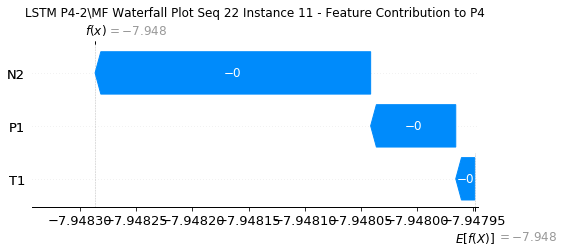

None

Contribution: [-8.43995842e-05 -2.29293787e-05 -2.71601740e-04]


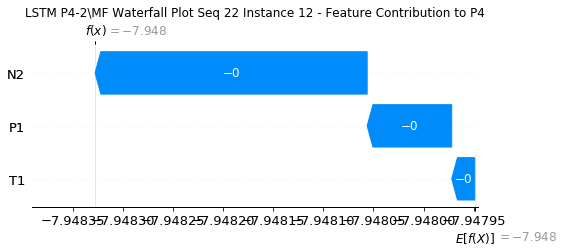

None

Contribution: [-1.02715815e-04 -3.13497107e-05 -3.04999005e-04]


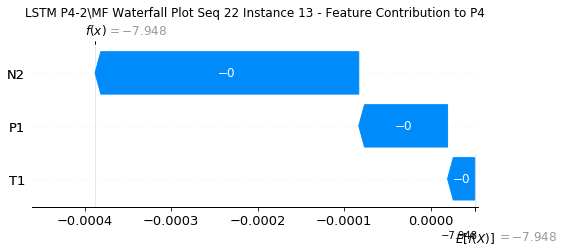

None

Contribution: [-9.86267333e-05 -3.74572875e-05 -3.33824715e-04]


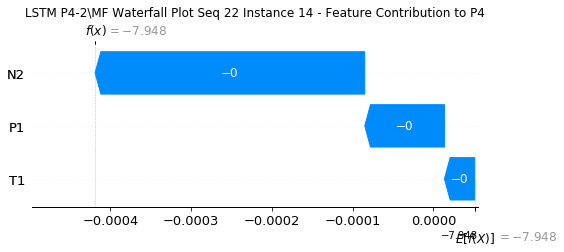

None

Contribution: [-1.13149344e-04 -4.28513753e-05 -3.68232460e-04]


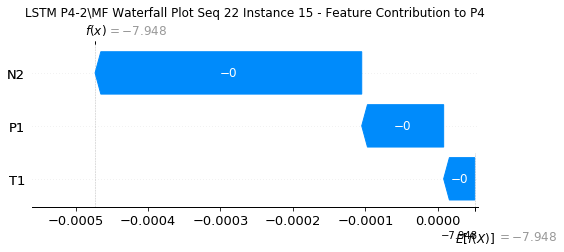

None

Contribution: [-1.30711821e-04 -5.69943105e-05 -4.11500706e-04]


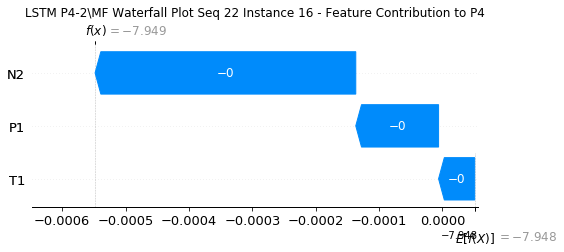

None

Contribution: [-1.40215830e-04 -5.26418885e-05 -4.58856754e-04]


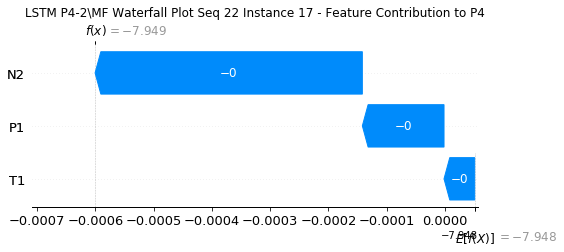

None

Contribution: [-1.78870323e-04 -5.46901545e-05 -5.15322242e-04]


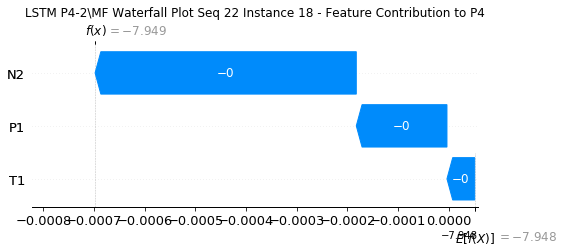

None

Contribution: [-1.98329702e-04 -2.16158829e-05 -6.06008063e-04]


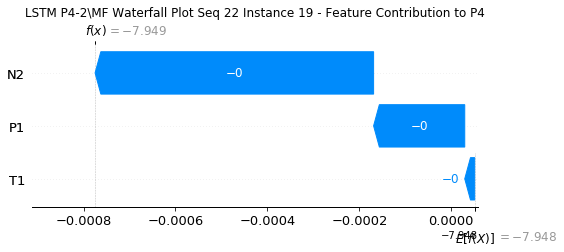

None

Contribution: [-2.46929360e-04  5.72154453e-05 -7.66378550e-04]


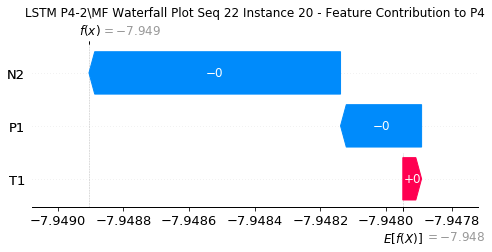

None

Contribution: [-0.00030753  0.00027865 -0.00107486]


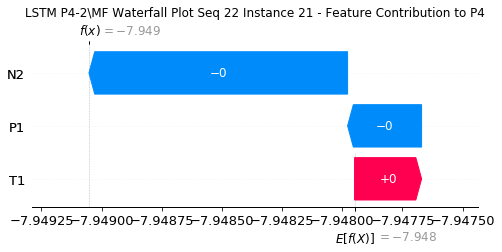

None

Contribution: [-0.00053503  0.00080977 -0.00169597]


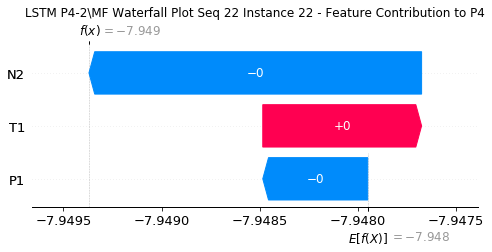

None

Contribution: [-0.00084906  0.00178971 -0.0030496 ]


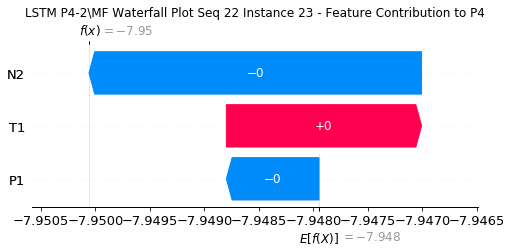

None

Contribution: [-0.00120361  0.00393927 -0.00591927]


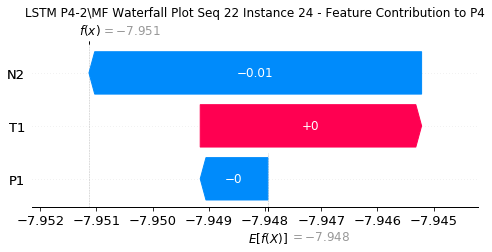

None

Contribution: [-0.04042372  0.07407717 -0.11827629]


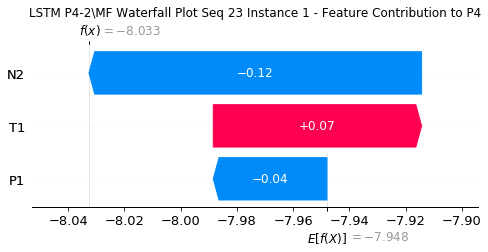

None

Contribution: [0.00166751 0.0058745  0.00472989]


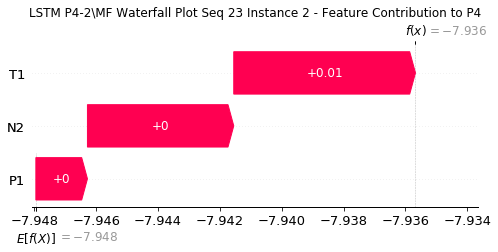

None

Contribution: [-0.00033566  0.00125457 -0.00064211]


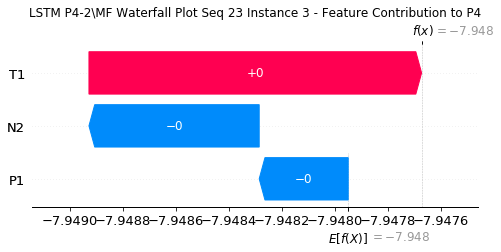

None

Contribution: [-1.27005048e-04  2.30022109e-05 -3.89520042e-04]


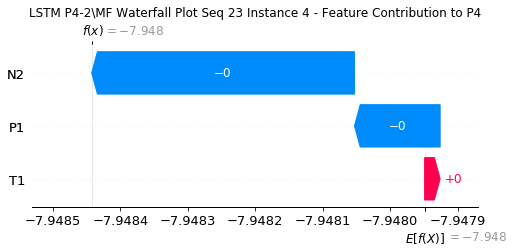

None

Contribution: [-8.54592690e-05 -2.38122607e-05 -2.65625373e-04]


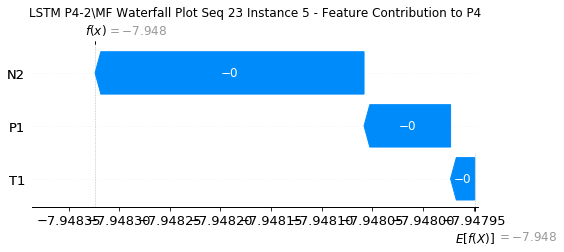

None

Contribution: [-8.11419964e-05 -2.48639451e-05 -2.27426525e-04]


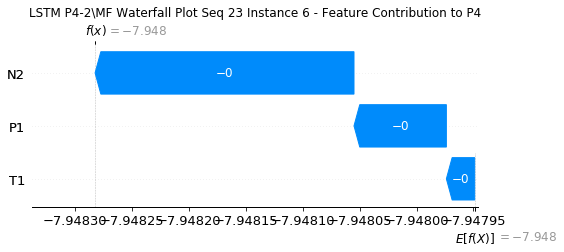

None

Contribution: [-6.77429054e-05 -2.10353224e-05 -2.18932453e-04]


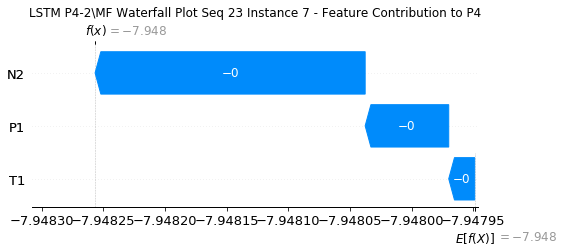

None

Contribution: [-7.22725298e-05 -1.80751183e-05 -2.16678626e-04]


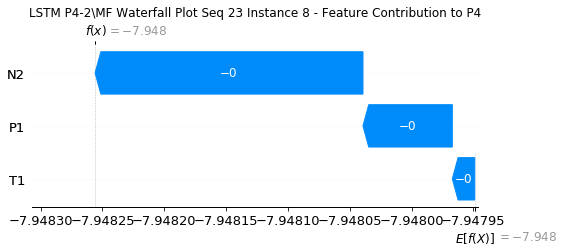

None

Contribution: [-7.14201193e-05 -3.26925235e-05 -2.21082769e-04]


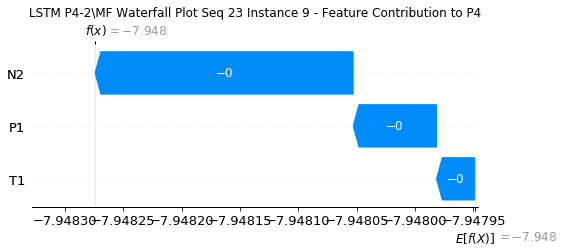

None

Contribution: [-7.44300118e-05 -2.79930933e-05 -2.34577986e-04]


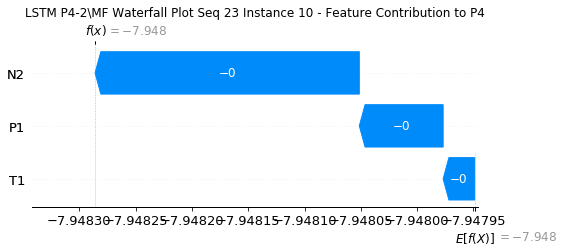

None

Contribution: [-8.01238128e-05 -2.74858349e-05 -2.50647909e-04]


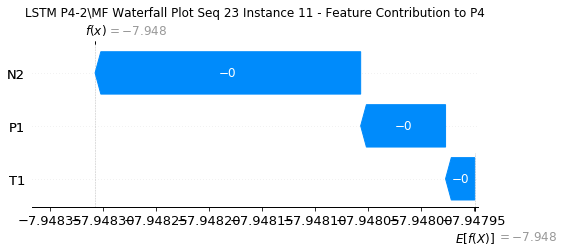

None

Contribution: [-8.77919351e-05 -3.01029207e-05 -2.75776542e-04]


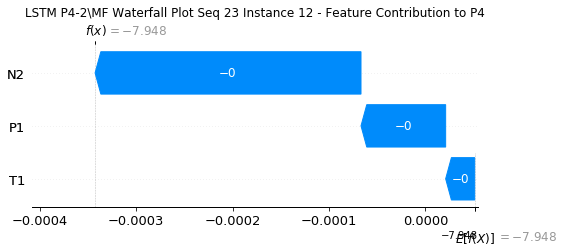

None

Contribution: [-9.97722743e-05 -3.98806747e-05 -3.02832755e-04]


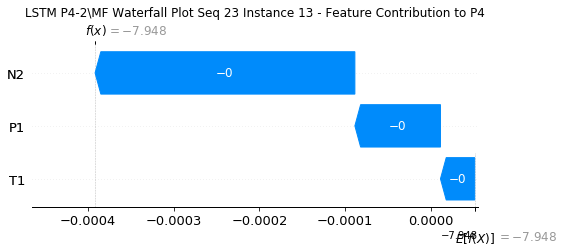

None

Contribution: [-1.02576052e-04 -4.38525006e-05 -3.35471834e-04]


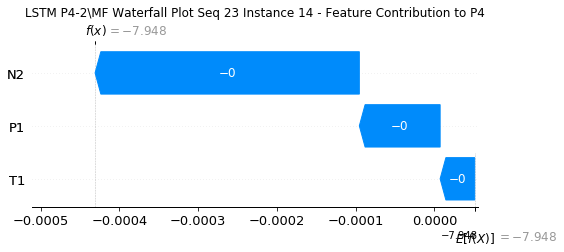

None

Contribution: [-1.18597432e-04 -4.26253942e-05 -3.65643390e-04]


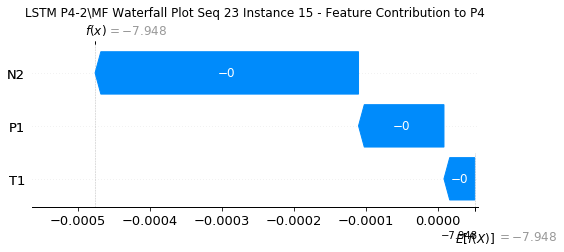

None

Contribution: [-1.32317803e-04 -5.68711303e-05 -4.10086503e-04]


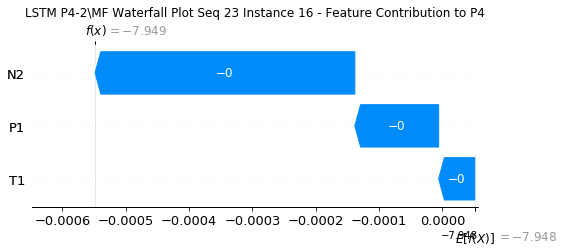

None

Contribution: [-1.41268607e-04 -5.33286866e-05 -4.56247774e-04]


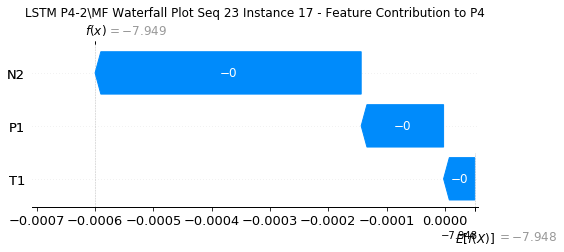

None

Contribution: [-1.62335060e-04 -4.41614804e-05 -5.10311110e-04]


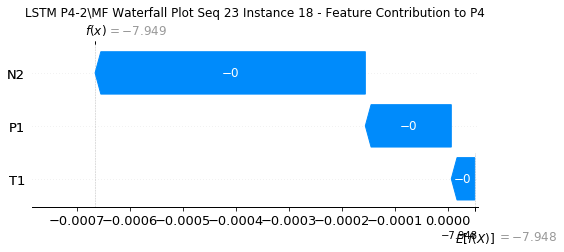

None

Contribution: [-2.00123896e-04 -1.30761841e-05 -6.01861318e-04]


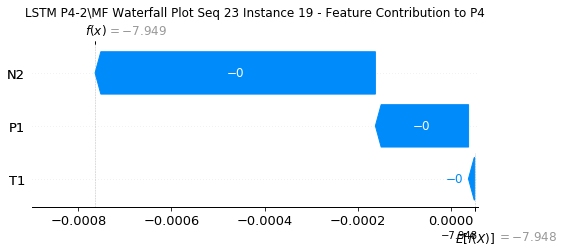

None

Contribution: [-2.54205961e-04  6.56391544e-05 -7.62234515e-04]


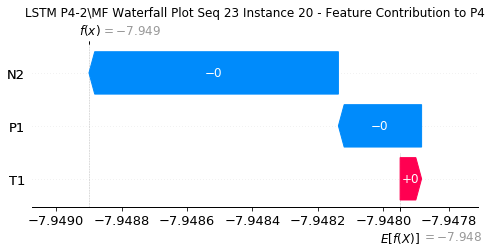

None

Contribution: [-0.00033891  0.00027635 -0.00107376]


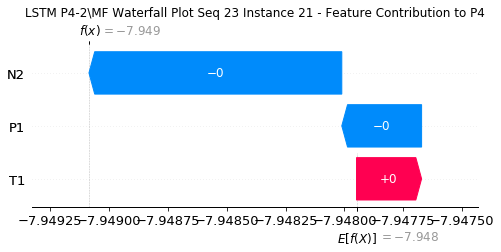

None

Contribution: [-0.00059399  0.00078932 -0.00169492]


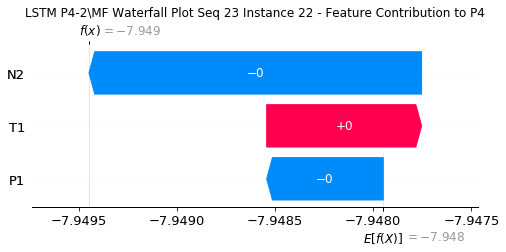

None

Contribution: [-0.00114855  0.00160786 -0.00309293]


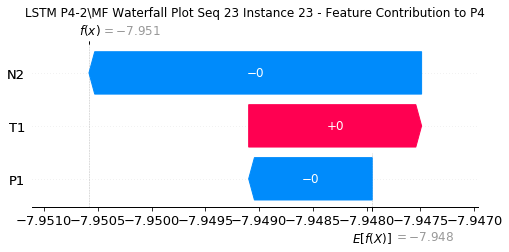

None

Contribution: [-0.00246683  0.00325747 -0.00611129]


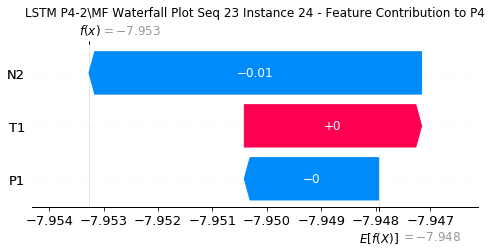

None

Contribution: [-0.04348396  0.07941558 -0.11742117]


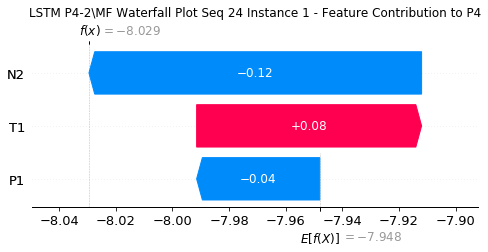

None

Contribution: [0.00151298 0.00596976 0.00475433]


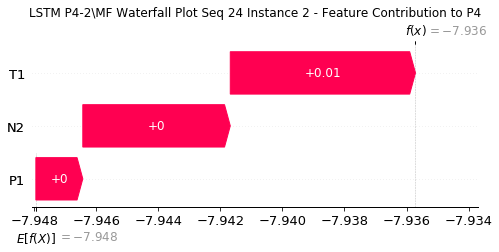

None

Contribution: [-0.00027624  0.00136368 -0.00062788]


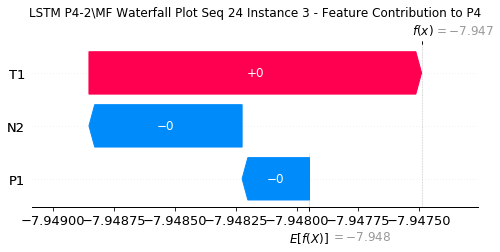

None

Contribution: [-1.30490144e-04  5.93184581e-05 -3.91053365e-04]


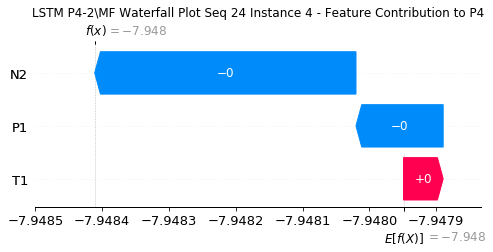

None

Contribution: [-8.67990952e-05 -9.07240675e-06 -2.65642677e-04]


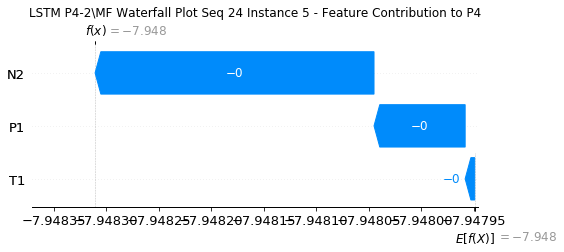

None

Contribution: [-7.74407288e-05 -8.04488060e-06 -2.26224188e-04]


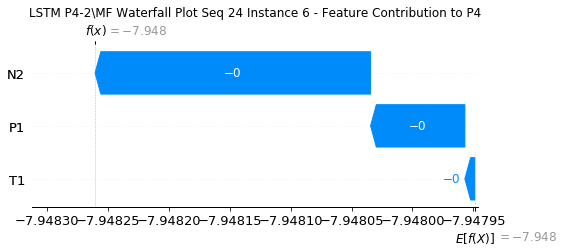

None

Contribution: [-6.80101453e-05 -1.07777451e-05 -2.18425310e-04]


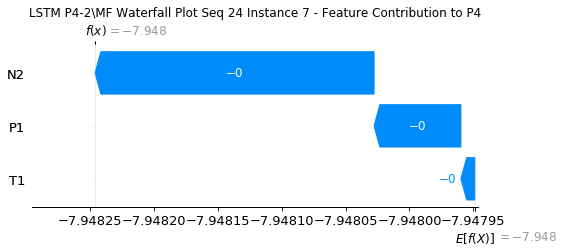

None

Contribution: [-6.90758086e-05 -3.10033396e-06 -2.16021375e-04]


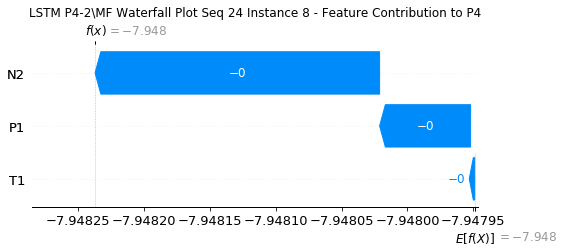

None

Contribution: [-6.75911314e-05 -1.03181408e-05 -2.20032875e-04]


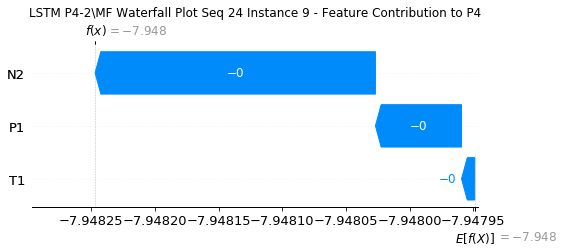

None

Contribution: [-7.41849558e-05 -1.12035836e-05 -2.32465922e-04]


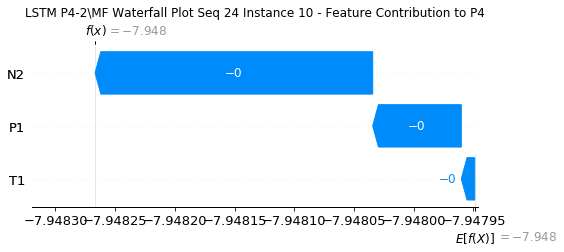

None

Contribution: [-8.19277386e-05 -2.61457226e-05 -2.50741091e-04]


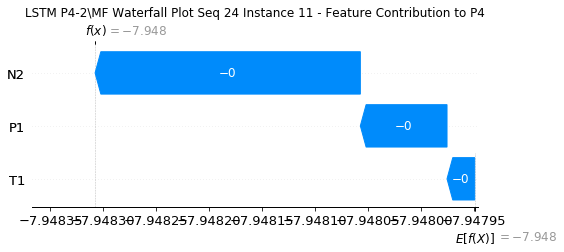

None

Contribution: [-8.92350233e-05 -3.08800344e-05 -2.76290140e-04]


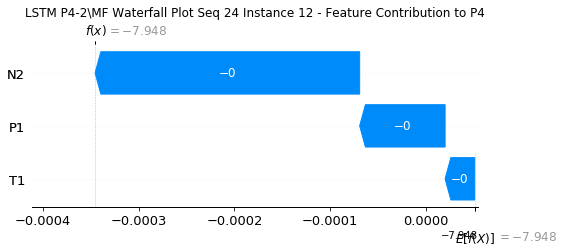

None

Contribution: [-9.86980426e-05 -4.61428129e-05 -3.02424996e-04]


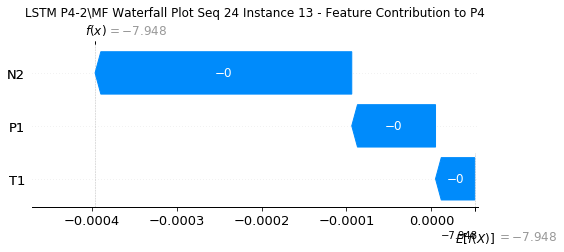

None

Contribution: [-1.05586776e-04 -4.91887864e-05 -3.36701592e-04]


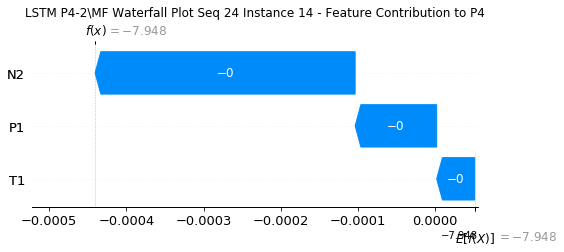

None

Contribution: [-1.18638804e-04 -6.10955166e-05 -3.73852912e-04]


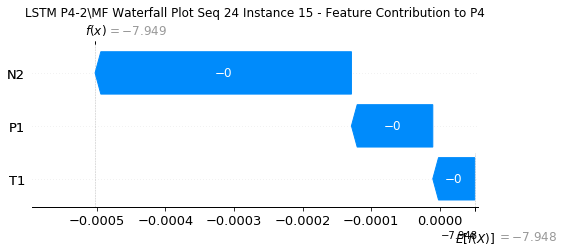

None

Contribution: [-1.34836893e-04 -6.99942683e-05 -4.11630194e-04]


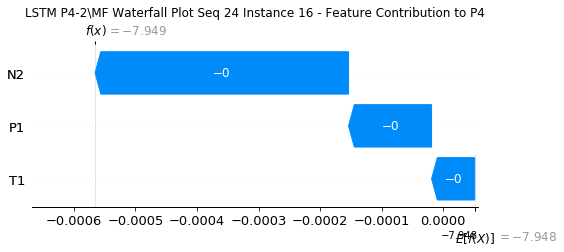

None

Contribution: [-1.42599615e-04 -7.16840097e-05 -4.56579841e-04]


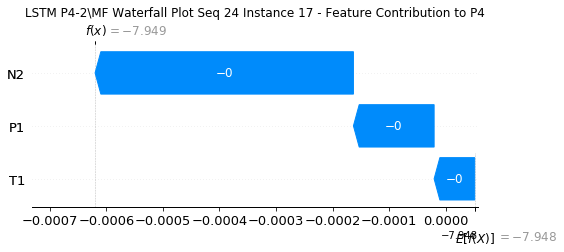

None

Contribution: [-1.72578554e-04 -8.92482686e-05 -5.10873889e-04]


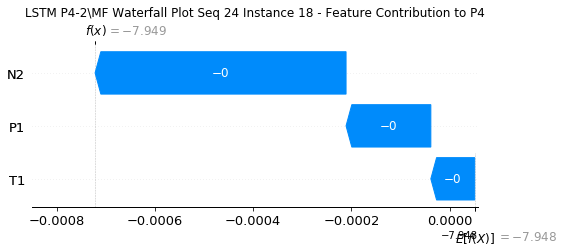

None

Contribution: [-2.04031394e-04 -5.71287995e-05 -6.03273026e-04]


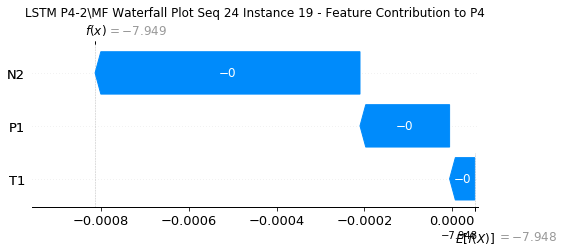

None

Contribution: [-2.58224773e-04 -1.15828240e-05 -7.61464883e-04]


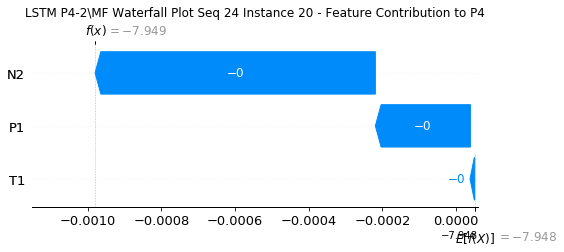

None

Contribution: [-0.00035934  0.00012476 -0.00107447]


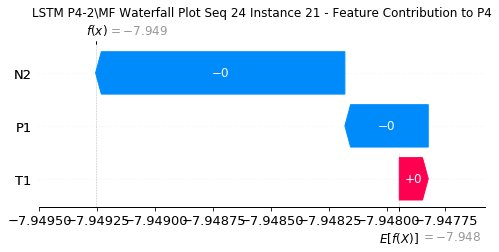

None

Contribution: [-0.00063076  0.00044692 -0.00168456]


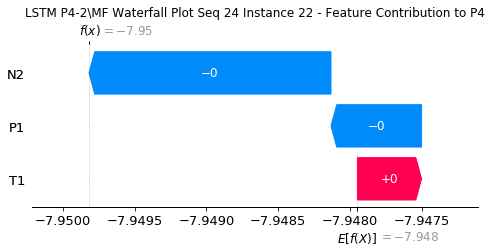

None

Contribution: [-0.0012245   0.00099068 -0.00309539]


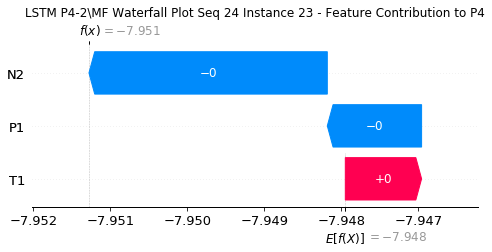

None

Contribution: [-0.0015775   0.00295535 -0.00593185]


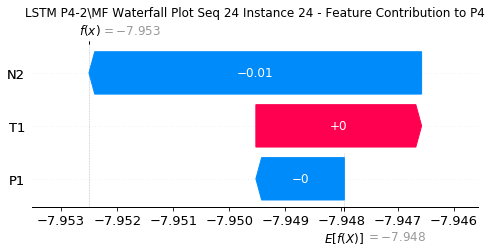

None

Contribution: [-0.02564704  0.05242378 -0.10961591]


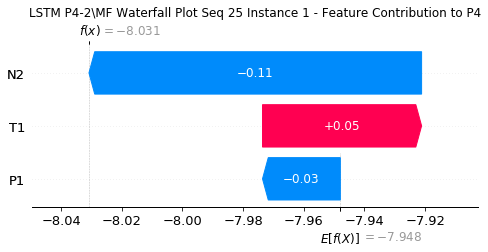

None

Contribution: [0.00170323 0.0052584  0.00479481]


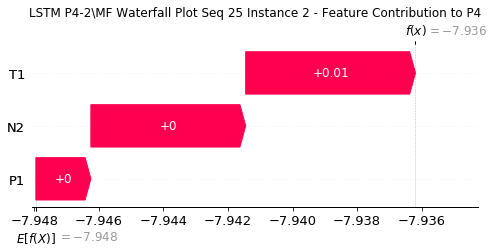

None

Contribution: [-0.00024342  0.00101266 -0.00064383]


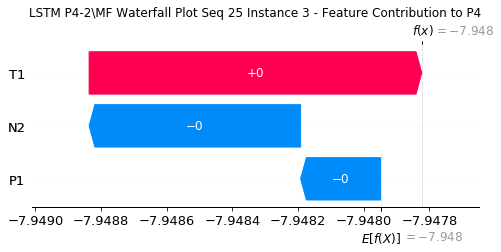

None

Contribution: [-1.33573975e-04  7.20812664e-06 -3.93923691e-04]


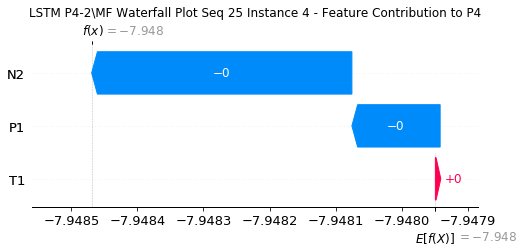

None

Contribution: [-8.75999655e-05 -3.15440294e-05 -2.66713560e-04]


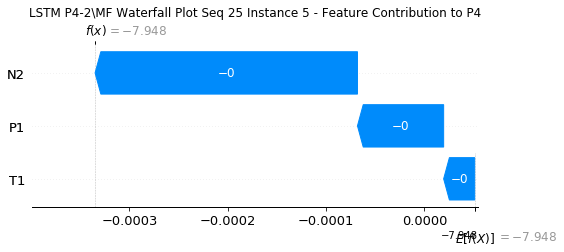

None

Contribution: [-6.15327979e-05 -1.83232833e-05 -2.23245731e-04]


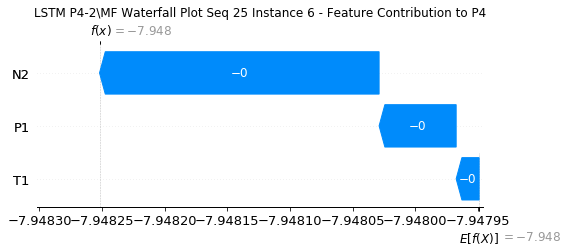

None

Contribution: [-6.81605839e-05 -2.84756118e-05 -2.19241715e-04]


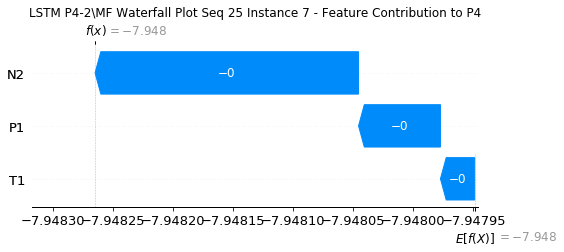

None

Contribution: [-6.64823427e-05 -2.47686882e-05 -2.15803479e-04]


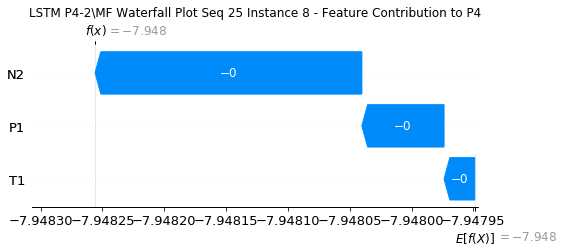

None

Contribution: [-6.72261724e-05 -3.00273445e-05 -2.20353190e-04]


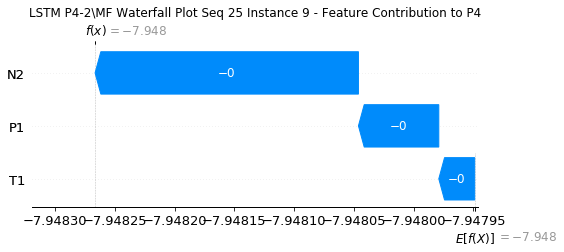

None

Contribution: [-7.45276534e-05 -3.18260166e-05 -2.32627883e-04]


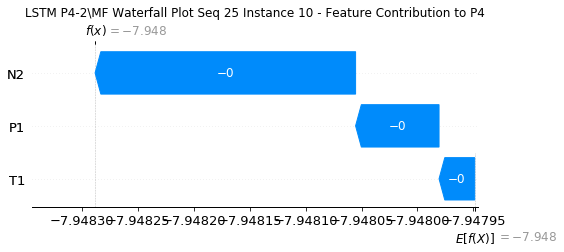

None

Contribution: [-7.66231647e-05 -3.16642239e-05 -2.48995497e-04]


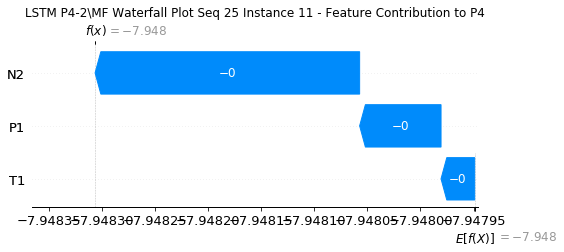

None

Contribution: [-8.37351861e-05 -3.69940280e-05 -2.74557776e-04]


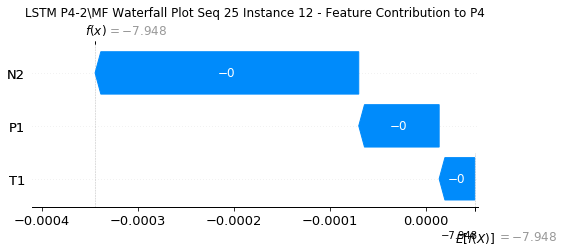

None

Contribution: [-8.74903888e-05 -4.36789235e-05 -3.00846614e-04]


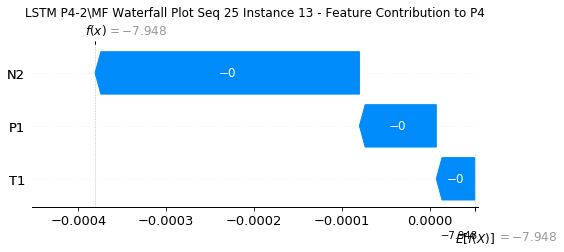

None

Contribution: [-9.82279765e-05 -5.40313637e-05 -3.34143981e-04]


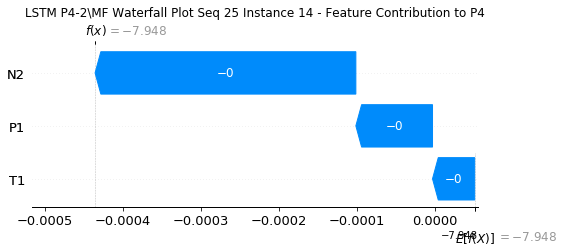

None

Contribution: [-1.22775371e-04 -6.38376567e-05 -3.70326694e-04]


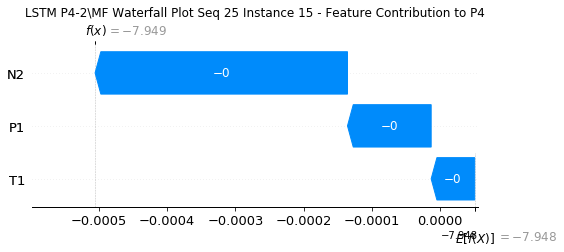

None

Contribution: [-1.25744969e-04 -7.41885046e-05 -4.08746596e-04]


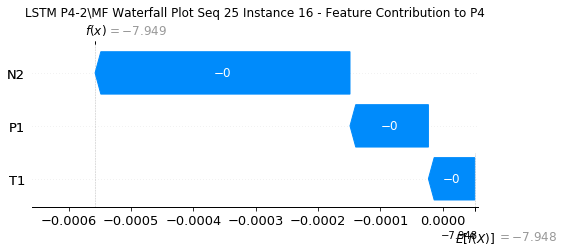

None

Contribution: [-1.36426599e-04 -7.85380800e-05 -4.55271228e-04]


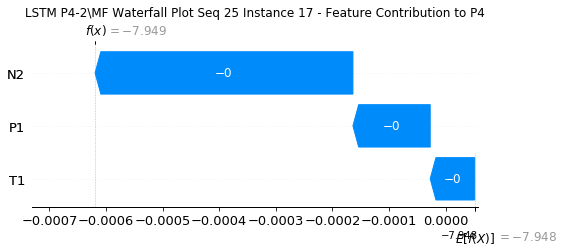

None

Contribution: [-0.00017145 -0.00010611 -0.00051581]


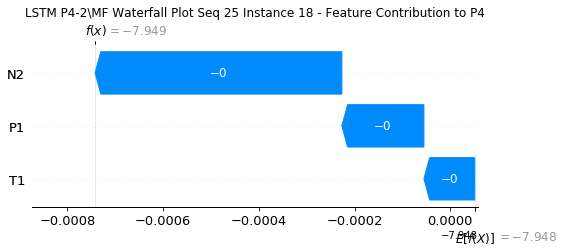

None

Contribution: [-1.95758510e-04 -8.49943744e-05 -6.04942159e-04]


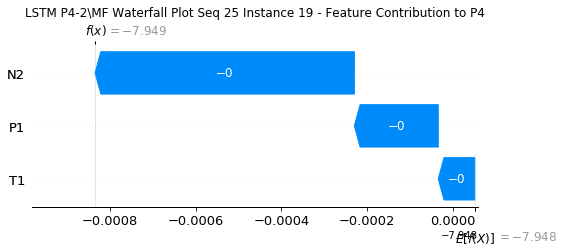

None

Contribution: [-2.50172933e-04 -5.84131400e-05 -7.67150750e-04]


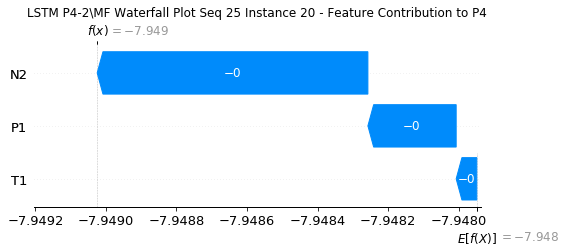

None

Contribution: [-3.40436129e-04  3.05515203e-05 -1.08580860e-03]


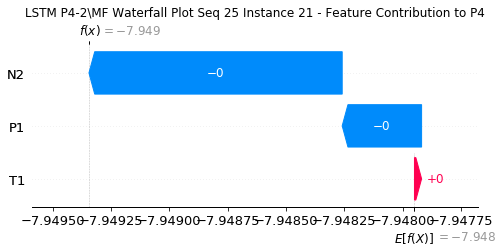

None

Contribution: [-0.00059474  0.00031171 -0.00170598]


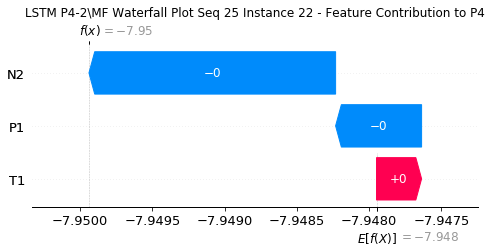

None

Contribution: [-0.0011477   0.00050096 -0.00313995]


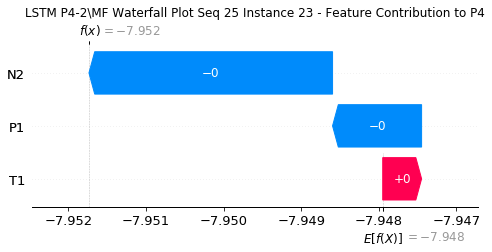

None

Contribution: [-0.00207418  0.00121521 -0.00615297]


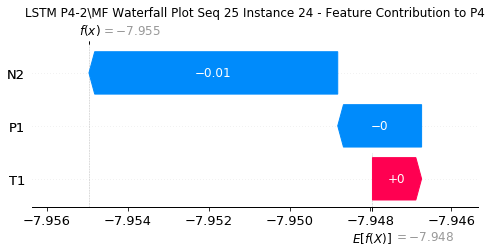

None

Contribution: [-0.04263737  0.02831979 -0.11768706]


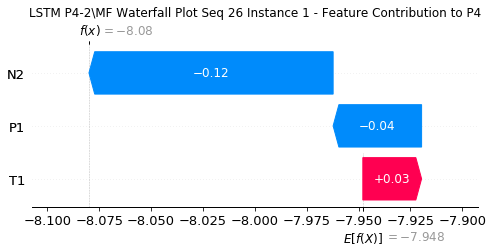

None

Contribution: [0.00147277 0.00462246 0.00442167]


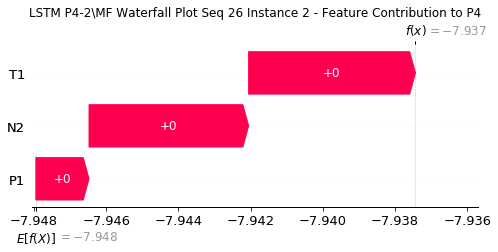

None

Contribution: [-0.00029584  0.00070895 -0.00067544]


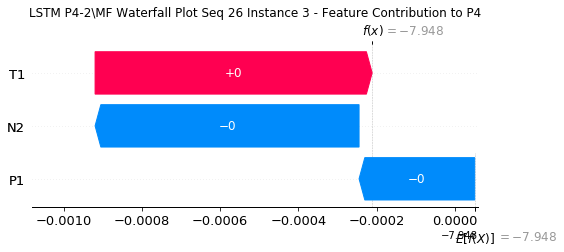

None

Contribution: [-1.11863197e-04 -2.25707289e-05 -3.90183794e-04]


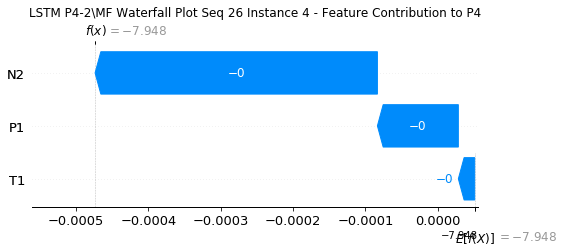

None

Contribution: [-7.99804407e-05 -4.89226776e-05 -2.67239044e-04]


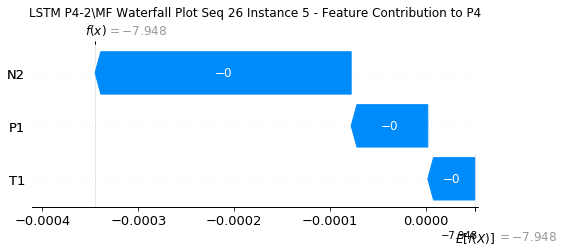

None

Contribution: [-7.31010619e-05 -4.59662920e-05 -2.29332492e-04]


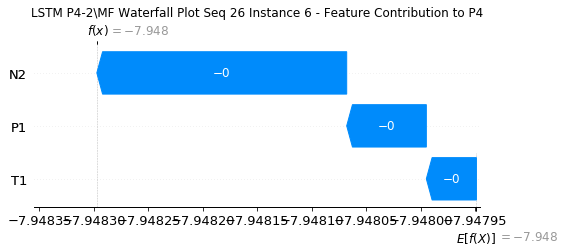

None

Contribution: [-6.42344482e-05 -4.08532084e-05 -2.20750617e-04]


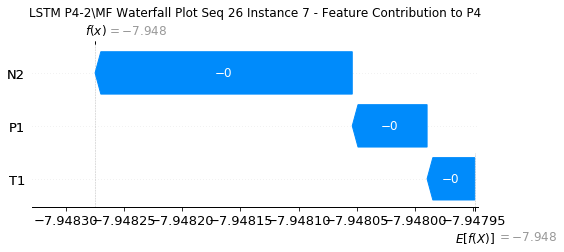

None

Contribution: [-6.77894763e-05 -3.59485618e-05 -2.19113249e-04]


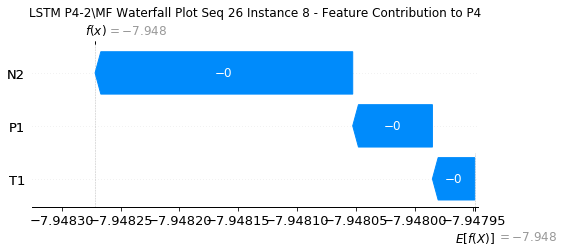

None

Contribution: [-7.89918787e-05 -3.91383252e-05 -2.26129174e-04]


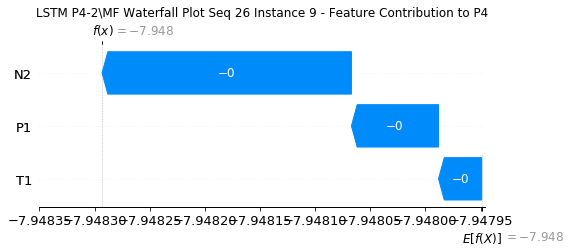

None

Contribution: [-7.69155641e-05 -4.27799586e-05 -2.35843732e-04]


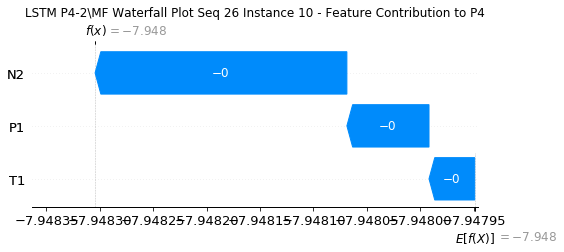

None

Contribution: [-7.69062736e-05 -4.24909818e-05 -2.50927414e-04]


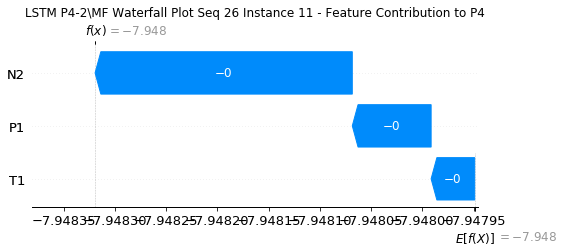

None

Contribution: [-8.33168322e-05 -4.62944736e-05 -2.75162288e-04]


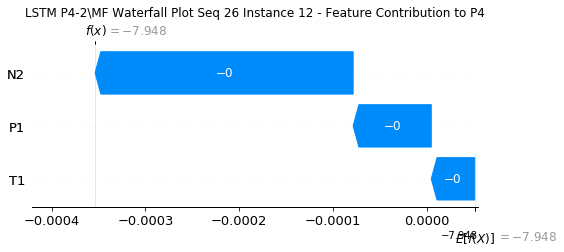

None

Contribution: [-9.87016142e-05 -6.66780287e-05 -3.03219619e-04]


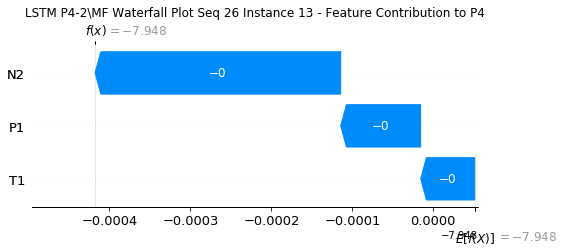

None

Contribution: [-9.90686583e-05 -6.17691605e-05 -3.32969163e-04]


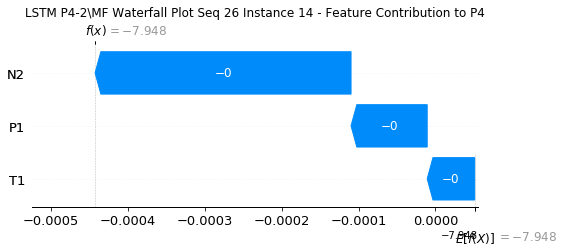

None

Contribution: [-1.16269643e-04 -7.38244297e-05 -3.65389334e-04]


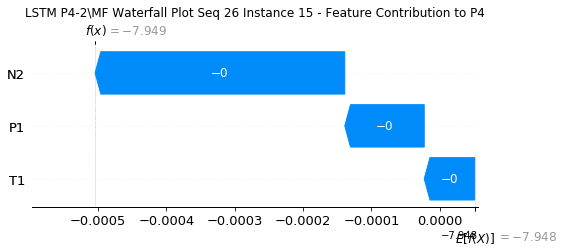

None

Contribution: [-1.27550173e-04 -7.88269465e-05 -4.05645058e-04]


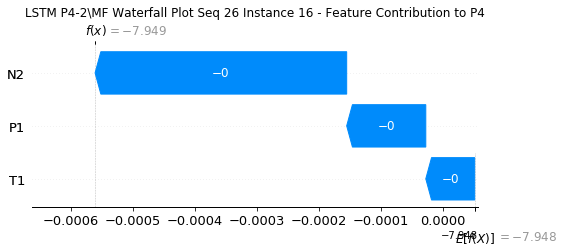

None

Contribution: [-1.37685077e-04 -7.87611754e-05 -4.50142128e-04]


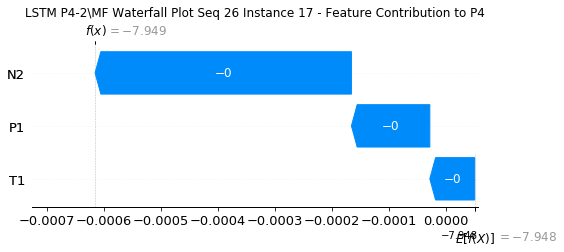

None

Contribution: [-1.62284843e-04 -8.92130360e-05 -5.04591122e-04]


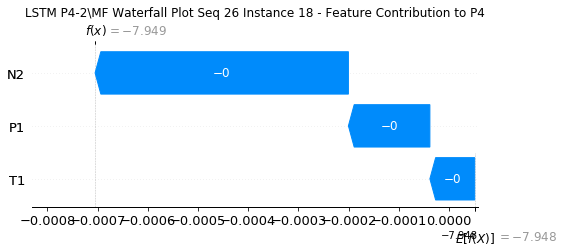

None

Contribution: [-1.91744134e-04 -7.06716629e-05 -5.94520670e-04]


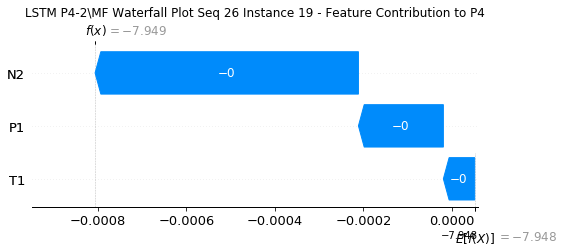

None

Contribution: [-2.44154979e-04 -2.56190080e-05 -7.52077623e-04]


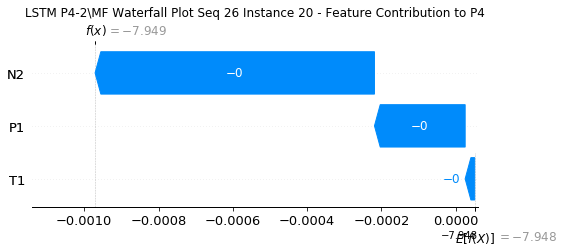

None

Contribution: [-0.00032803  0.00010564 -0.0010619 ]


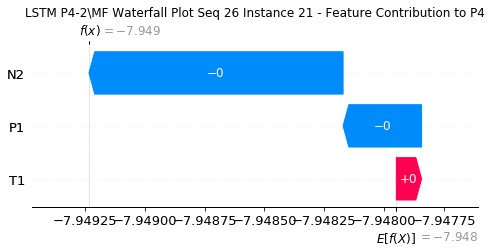

None

Contribution: [-0.00060584  0.0004697  -0.00167643]


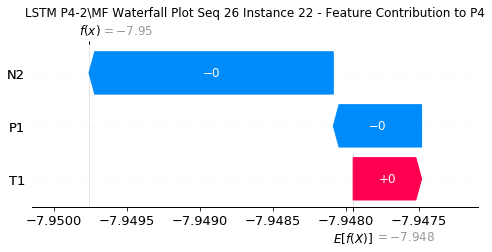

None

Contribution: [-0.00121514  0.00076654 -0.00309572]


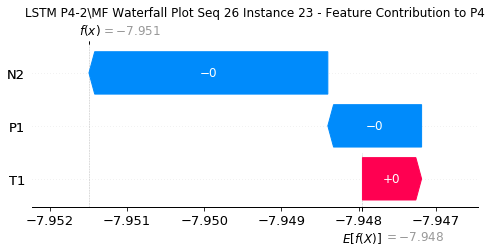

None

Contribution: [-0.00207052  0.00173112 -0.00605351]


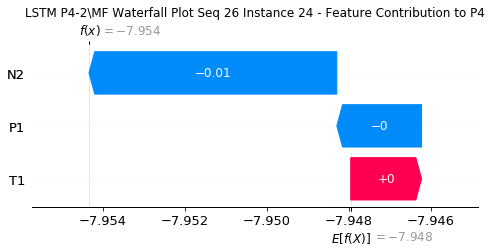

None

Contribution: [-0.0306261   0.06869768 -0.11250404]


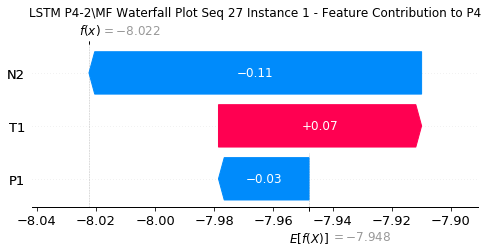

None

Contribution: [0.00180917 0.00538363 0.00482761]


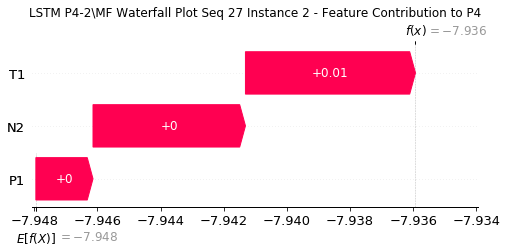

None

Contribution: [-0.00022403  0.00086292 -0.00065012]


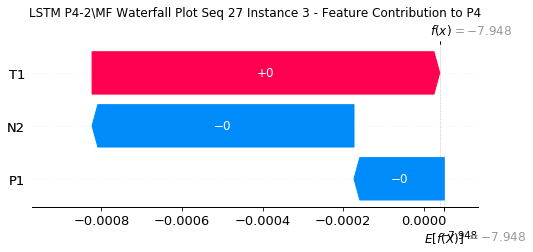

None

Contribution: [-1.26041002e-04 -6.28768539e-06 -3.88698832e-04]


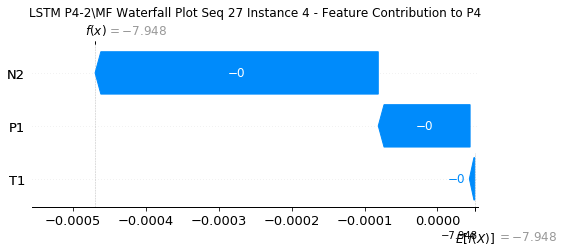

None

Contribution: [-8.47252112e-05 -3.88478933e-05 -2.64459110e-04]


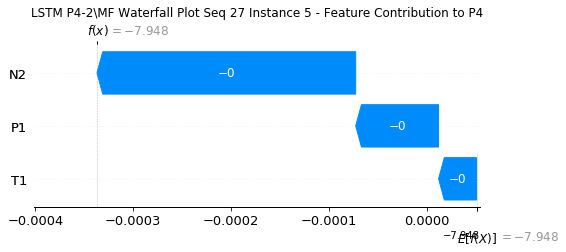

None

Contribution: [-7.04149234e-05 -3.13721482e-05 -2.24484477e-04]


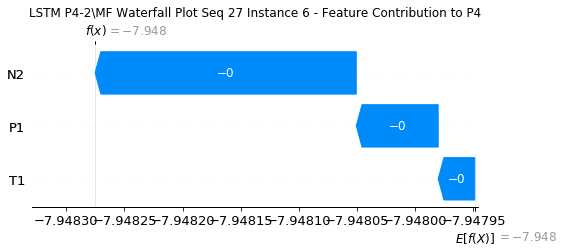

None

Contribution: [-6.49718909e-05 -3.17719187e-05 -2.17052647e-04]


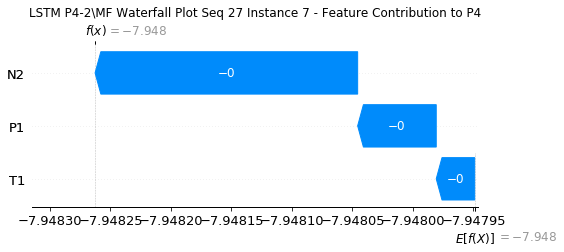

None

Contribution: [-6.27770556e-05 -2.28874973e-05 -2.13192010e-04]


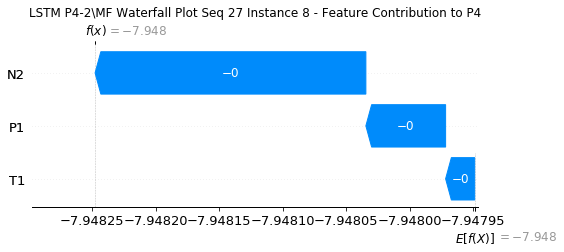

None

Contribution: [-5.78480785e-05 -9.94146348e-07 -2.15171157e-04]


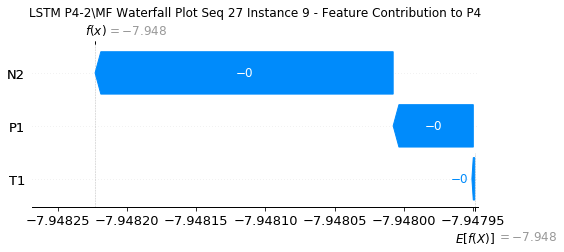

None

Contribution: [-6.41589115e-05 -2.88232608e-05 -2.29414414e-04]


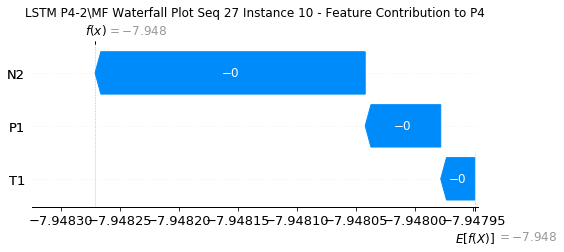

None

Contribution: [-7.89849378e-05 -4.07256785e-05 -2.48577517e-04]


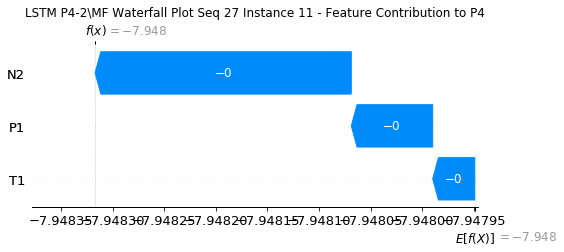

None

Contribution: [-8.64562461e-05 -4.51170130e-05 -2.74182877e-04]


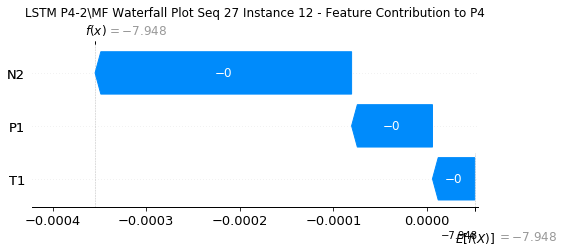

None

Contribution: [-9.18109243e-05 -5.71310635e-05 -2.99134779e-04]


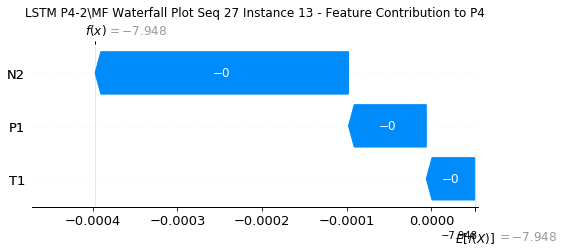

None

Contribution: [-9.92881429e-05 -6.23061350e-05 -3.33793755e-04]


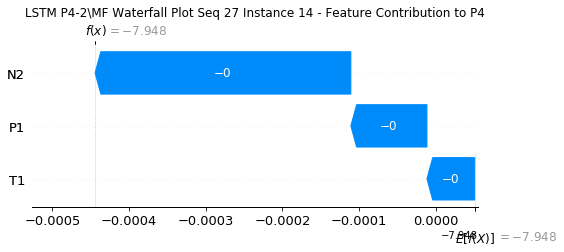

None

Contribution: [-1.16026699e-04 -6.86593985e-05 -3.66006140e-04]


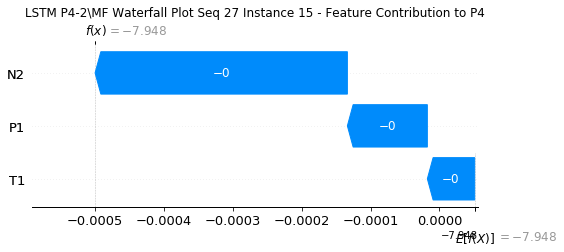

None

Contribution: [-1.27443049e-04 -8.15622007e-05 -4.08438858e-04]


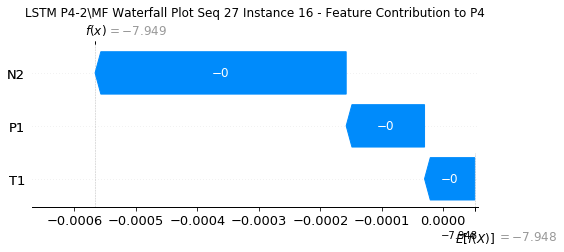

None

Contribution: [-1.34838766e-04 -8.16707378e-05 -4.53843095e-04]


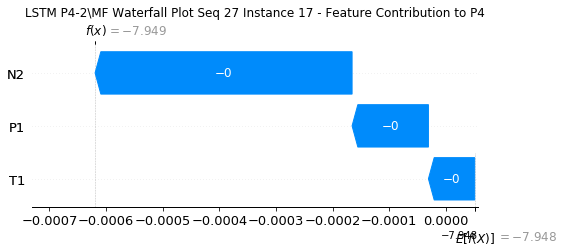

None

Contribution: [-0.00016904 -0.00010743 -0.00051615]


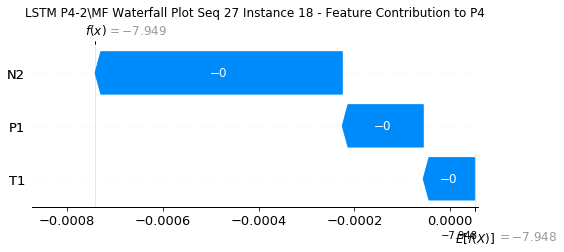

None

Contribution: [-1.80045494e-04 -7.41571876e-05 -5.96723970e-04]


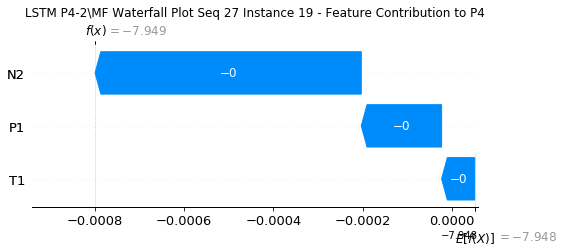

None

Contribution: [-2.18184484e-04 -3.26193043e-05 -7.50778362e-04]


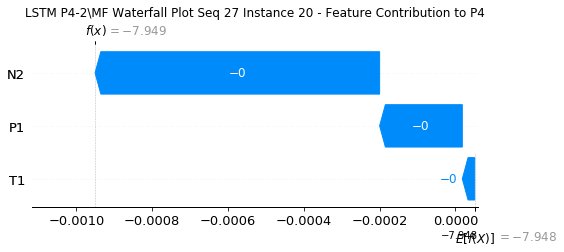

None

Contribution: [-2.61203255e-04  8.86480208e-05 -1.04862412e-03]


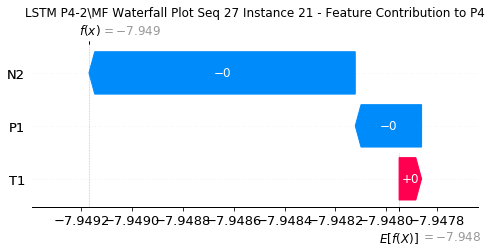

None

Contribution: [-0.00044067  0.00041561 -0.00163617]


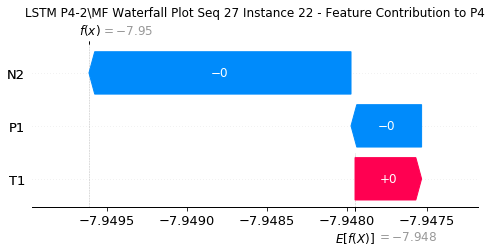

None

Contribution: [-0.00066766  0.00078961 -0.00294779]


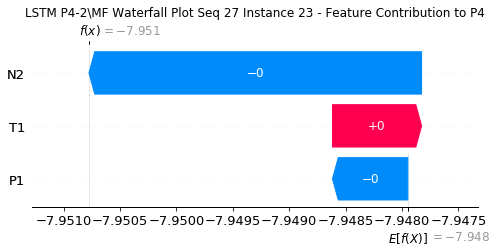

None

Contribution: [-0.00212298  0.00168096 -0.00597776]


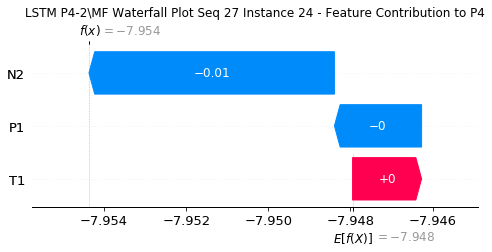

None

Contribution: [-0.05354307  0.04302231 -0.11622152]


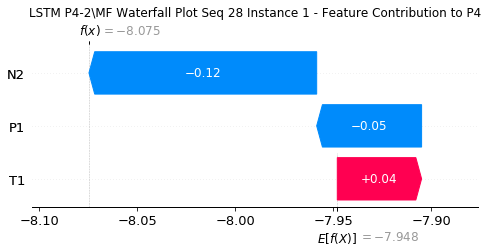

None

Contribution: [0.00126084 0.00480437 0.00451338]


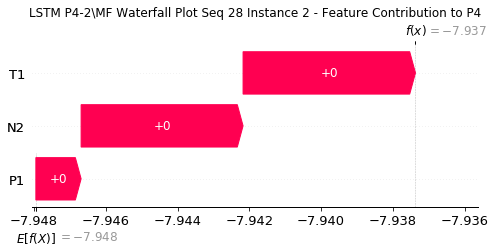

None

Contribution: [-0.00036925  0.00072689 -0.00068009]


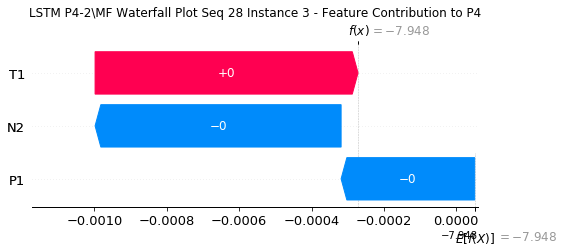

None

Contribution: [-1.36929648e-04 -8.46655476e-05 -3.98190169e-04]


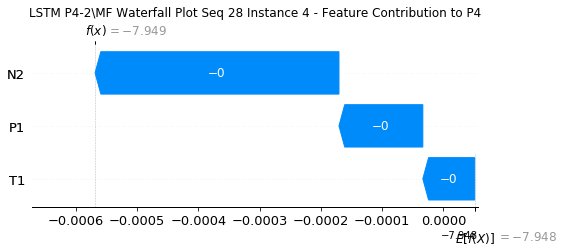

None

Contribution: [-8.77717291e-05 -7.16787633e-05 -2.70422491e-04]


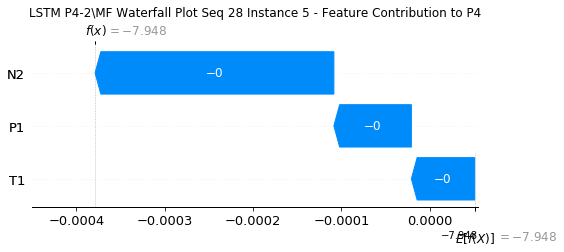

None

Contribution: [-8.57018953e-05 -7.37545595e-05 -2.33711847e-04]


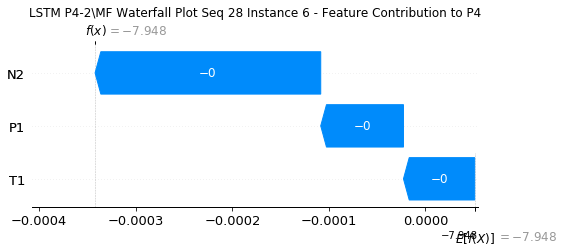

None

Contribution: [-7.16373520e-05 -4.61478670e-05 -2.22956973e-04]


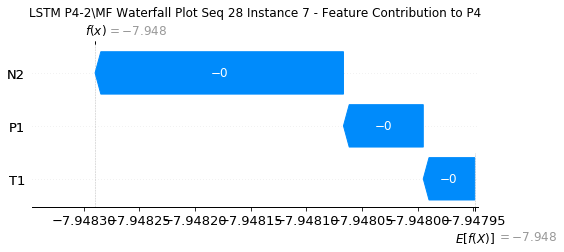

None

Contribution: [-7.24241831e-05 -3.29822142e-05 -2.18510784e-04]


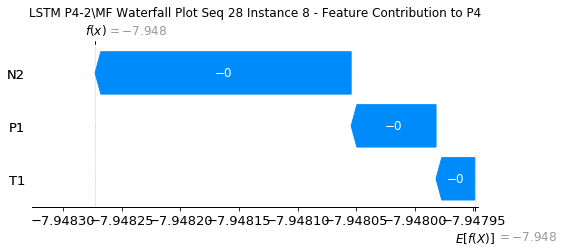

None

Contribution: [-7.24905768e-05 -3.24716553e-05 -2.23882180e-04]


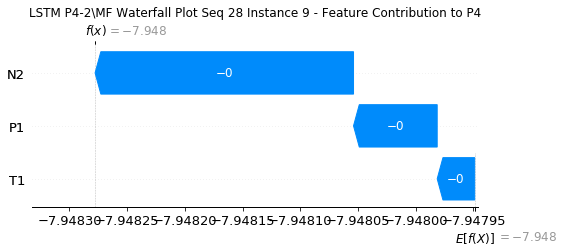

None

Contribution: [-7.10328022e-05 -2.91879455e-05 -2.33914853e-04]


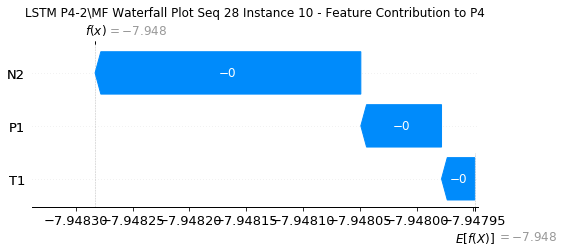

None

Contribution: [-8.54120023e-05 -4.49574921e-05 -2.53134796e-04]


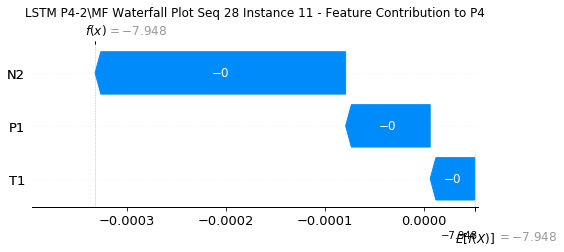

None

Contribution: [-9.54910178e-05 -4.24069218e-05 -2.77905594e-04]


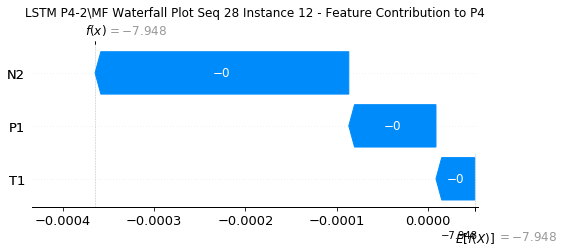

None

Contribution: [-8.69474167e-05 -5.00013610e-05 -3.00218257e-04]


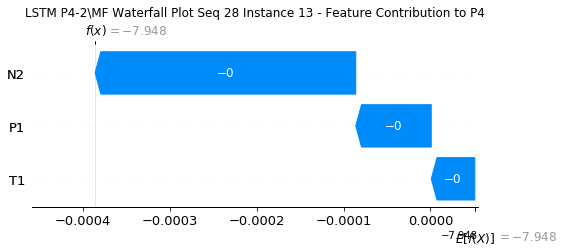

None

Contribution: [-1.16916400e-04 -3.74971373e-05 -3.36733746e-04]


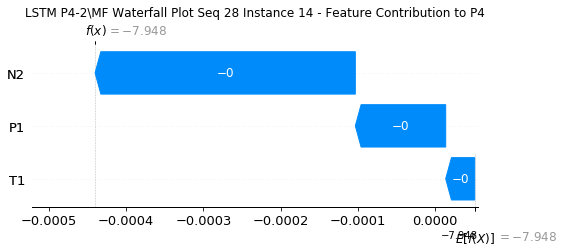

None

Contribution: [-1.16366285e-04 -2.93078229e-05 -3.66243363e-04]


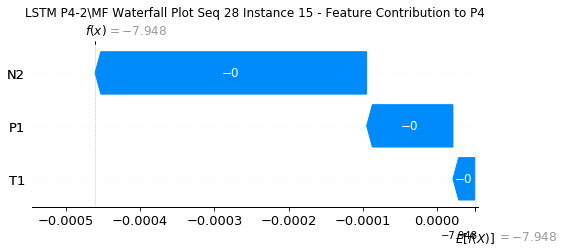

None

Contribution: [-1.52569152e-04 -2.55345660e-05 -4.09699787e-04]


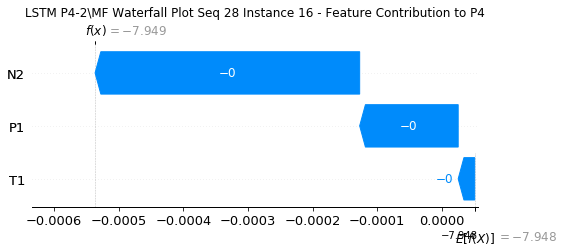

None

Contribution: [-1.64694298e-04  6.00304911e-06 -4.53835653e-04]


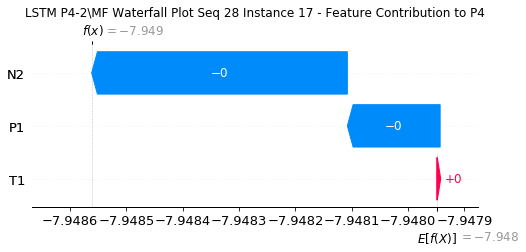

None

Contribution: [-1.42140779e-04 -4.47829586e-05 -5.00920289e-04]


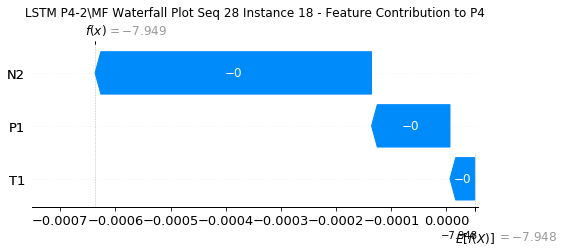

None

Contribution: [-0.00028328  0.00018103 -0.00060768]


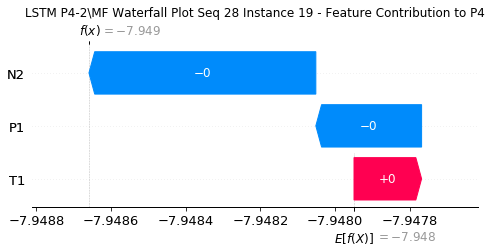

None

Contribution: [-0.00040009  0.00044248 -0.00077385]


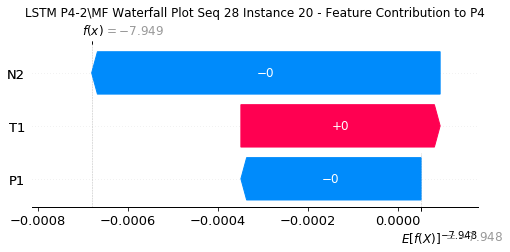

None

Contribution: [-0.00067681  0.00108204 -0.00111589]


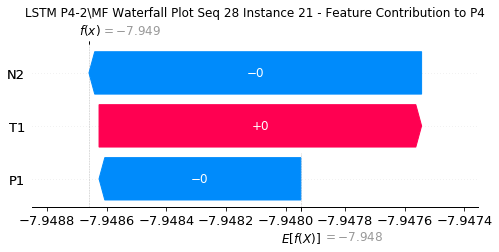

None

Contribution: [-0.00118821  0.00249451 -0.00175783]


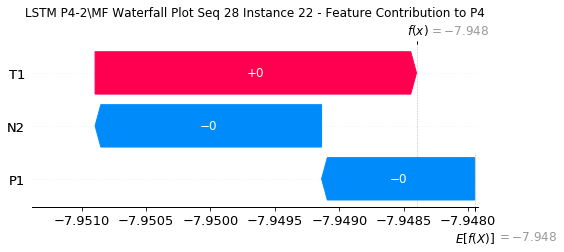

None

Contribution: [-0.00269555  0.0055866  -0.00332737]


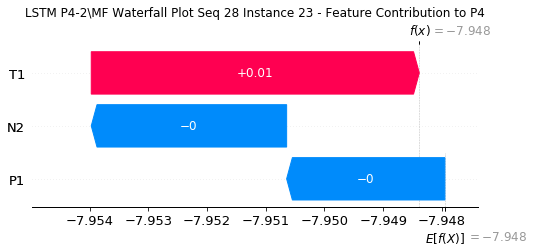

None

Contribution: [-0.00495922  0.01039384 -0.00654549]


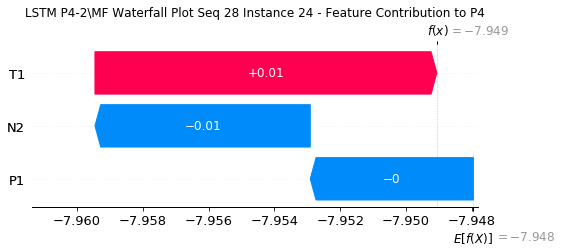

None

Contribution: [-0.10469539  0.29940392 -0.12567633]


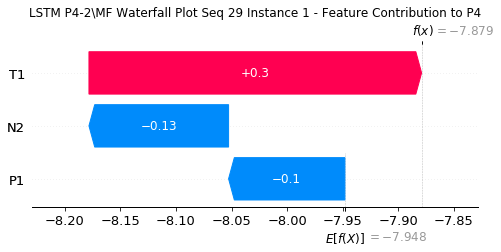

None

Contribution: [3.88530296e-05 1.02120706e-02 5.06292175e-03]


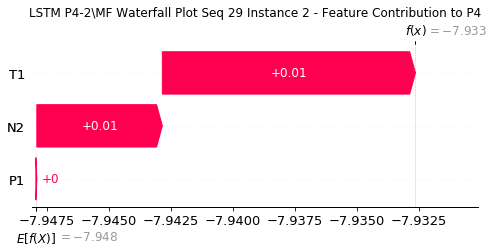

None

Contribution: [-0.00118265  0.00337833 -0.00076557]


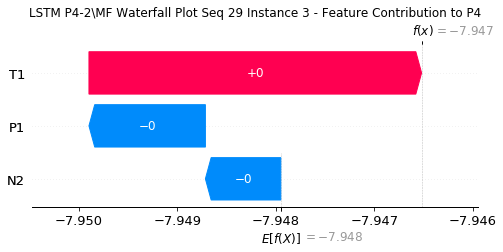

None

Contribution: [-0.00029162  0.0005255  -0.00041389]


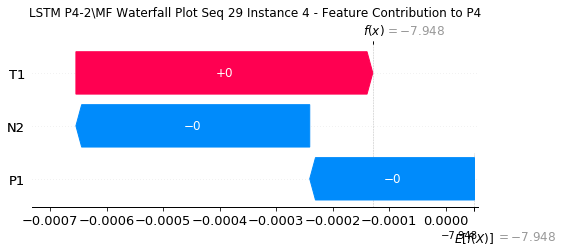

None

Contribution: [-0.00017065  0.00023657 -0.00027125]


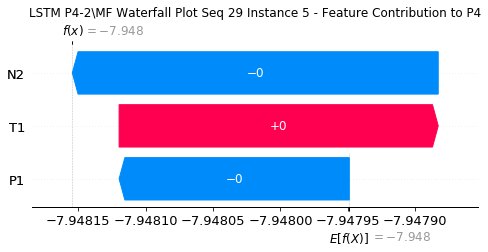

None

Contribution: [-9.85429852e-05  1.96934883e-04 -2.19128238e-04]


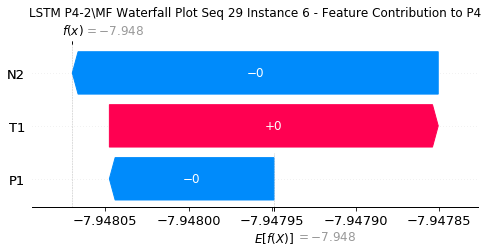

None

Contribution: [-0.00012659  0.00017632 -0.00021925]


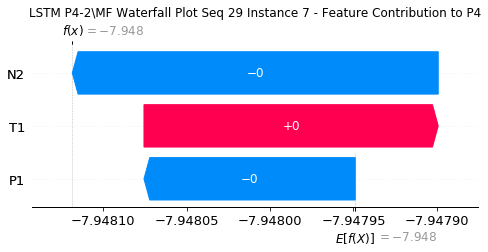

None

Contribution: [-0.00012461  0.00018769 -0.00021533]


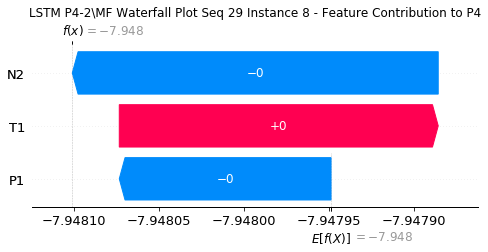

None

Contribution: [-0.0001502   0.00016889 -0.00022689]


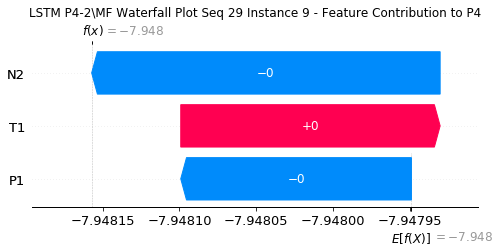

None

Contribution: [-0.00015325  0.00016478 -0.00023766]


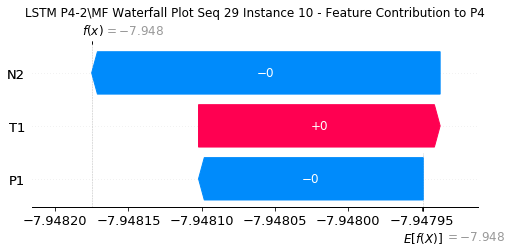

None

Contribution: [-0.00014129  0.00014862 -0.00025276]


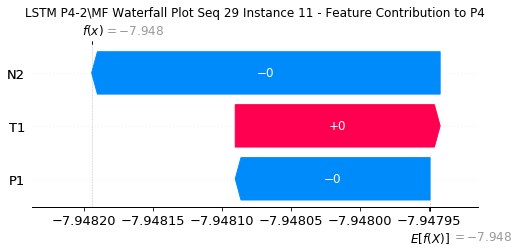

None

Contribution: [-0.0001417   0.00013871 -0.00028008]


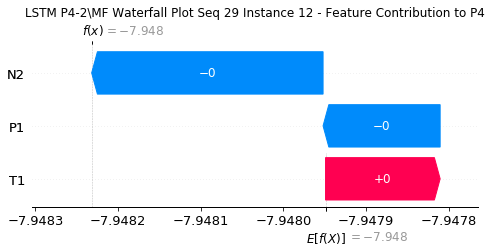

None

Contribution: [-0.00016484  0.0001497  -0.00031344]


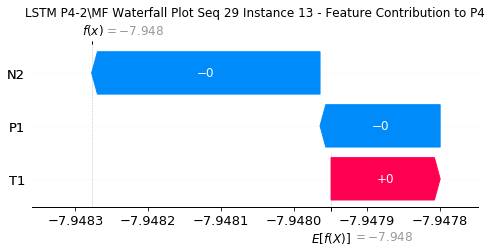

None

Contribution: [-0.00015332  0.00010637 -0.00034666]


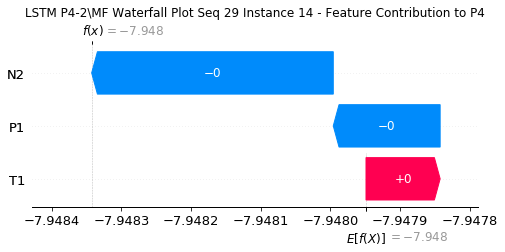

None

Contribution: [-1.40394715e-04  2.80669875e-05 -3.76073647e-04]


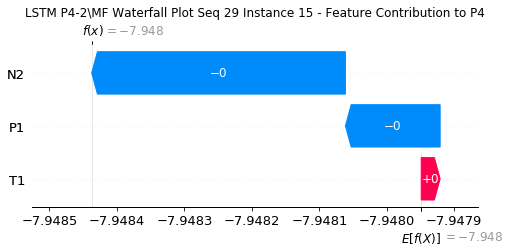

None

Contribution: [-1.73774482e-04  6.81465273e-05 -4.27120201e-04]


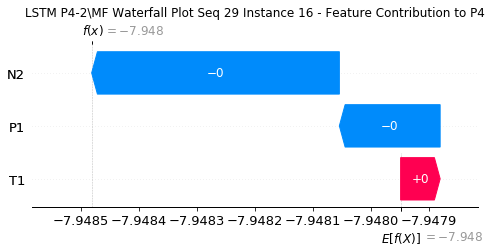

None

Contribution: [-1.75629062e-04  5.74398742e-05 -4.76368441e-04]


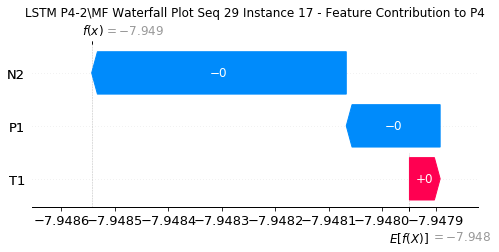

None

Contribution: [-1.34009121e-04  2.78801155e-06 -5.23532158e-04]


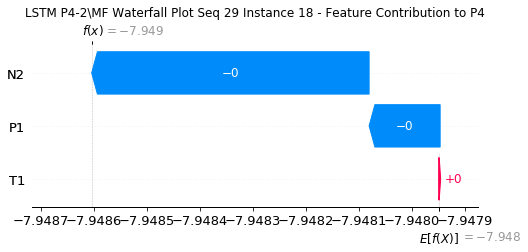

None

Contribution: [-1.98417443e-04  8.68348181e-05 -6.26804078e-04]


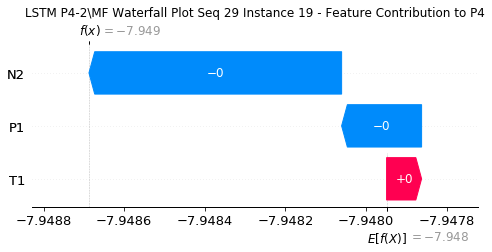

None

Contribution: [-0.00024011  0.00019081 -0.00079197]


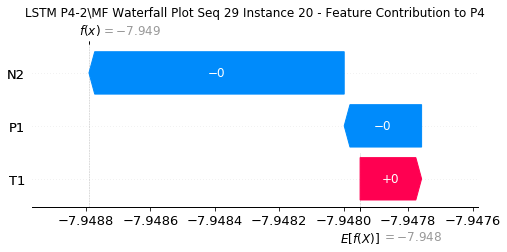

None

Contribution: [-0.00030308  0.00047939 -0.00111535]


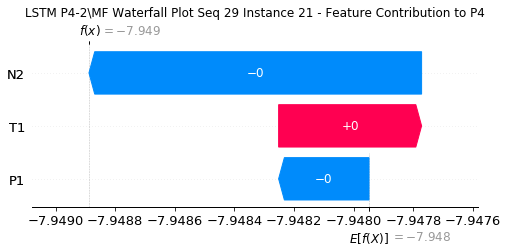

None

Contribution: [-0.00057299  0.00103208 -0.00174257]


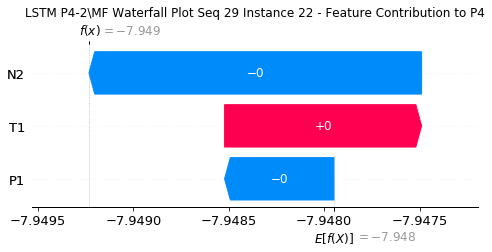

None

Contribution: [-0.00069731  0.00206082 -0.00314377]


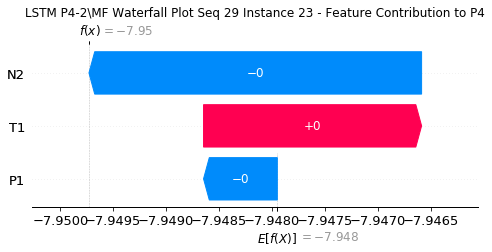

None

Contribution: [-0.00050547  0.00583389 -0.0060515 ]


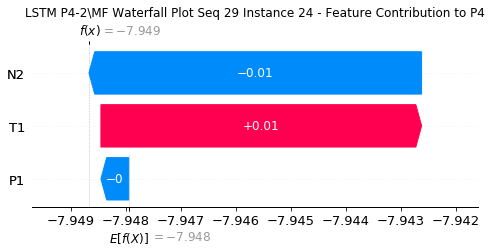

None

Contribution: [-0.03340904  0.05703099 -0.11805878]


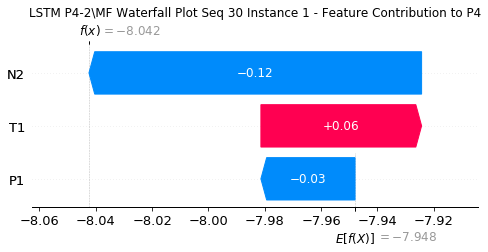

None

Contribution: [0.00152471 0.00583679 0.00458291]


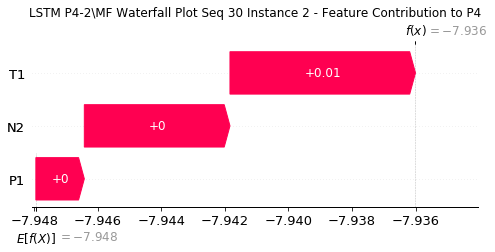

None

Contribution: [-0.00034391  0.00069419 -0.00067302]


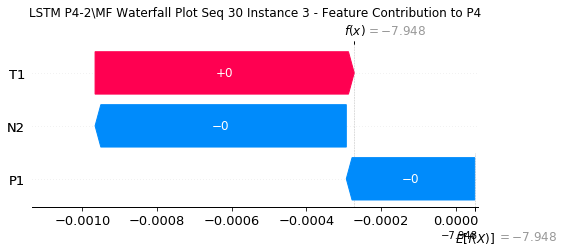

None

Contribution: [-1.18058842e-04 -4.25835440e-05 -3.91268656e-04]


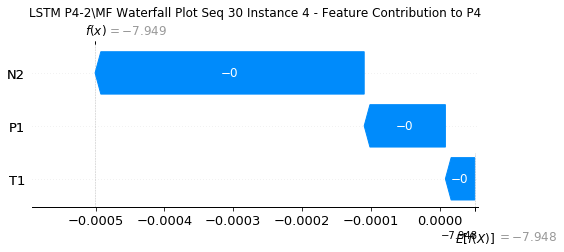

None

Contribution: [-8.07038498e-05 -5.08309300e-05 -2.65812426e-04]


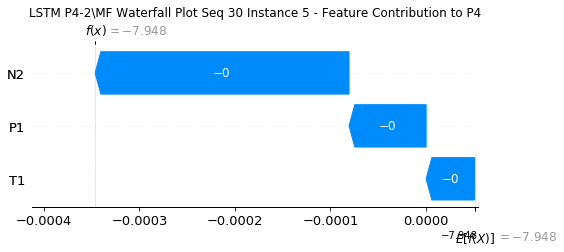

None

Contribution: [-7.48090258e-05 -3.36246448e-05 -2.27317521e-04]


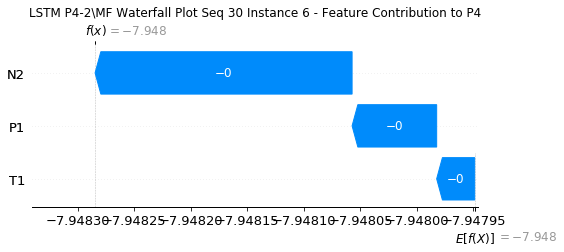

None

Contribution: [-6.38005857e-05 -3.91488662e-05 -2.19137529e-04]


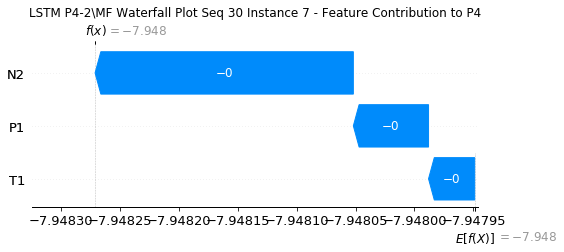

None

Contribution: [-6.27749728e-05 -2.05339308e-05 -2.14733749e-04]


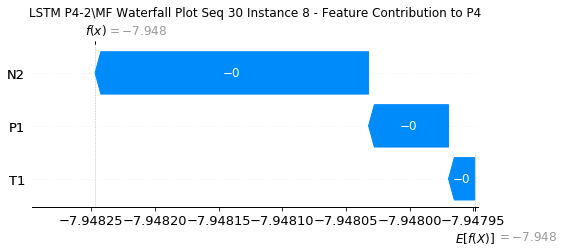

None

Contribution: [-6.01710076e-05 -1.54560550e-05 -2.19634920e-04]


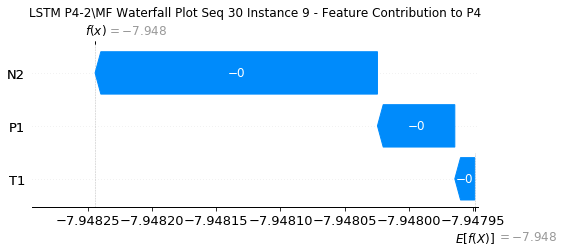

None

Contribution: [-6.72665808e-05 -1.90206975e-05 -2.30804261e-04]


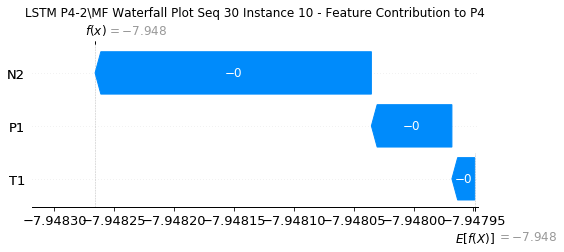

None

Contribution: [-7.44048224e-05 -2.92428989e-05 -2.48734339e-04]


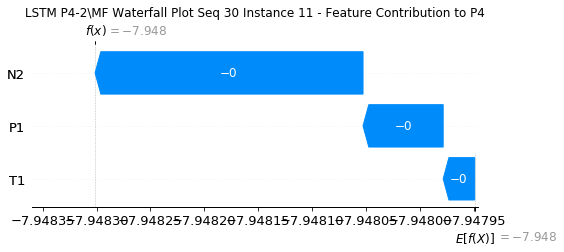

None

Contribution: [-8.16753472e-05 -3.55445531e-05 -2.74126453e-04]


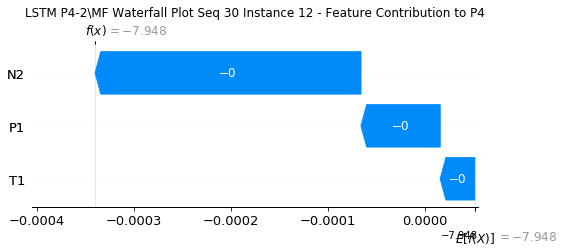

None

Contribution: [-8.83806901e-05 -3.54551748e-05 -2.98787922e-04]


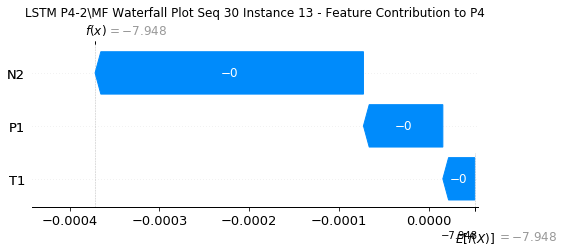

None

Contribution: [-9.55511607e-05 -4.81315646e-05 -3.33214247e-04]


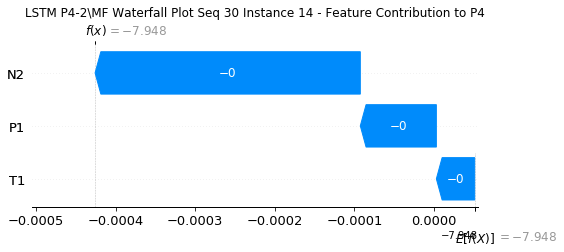

None

Contribution: [-1.15941379e-04 -6.74740926e-05 -3.67127100e-04]


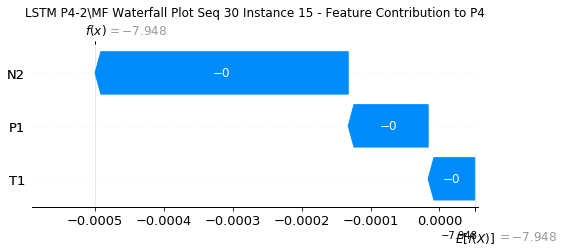

None

Contribution: [-1.23588023e-04 -6.46718387e-05 -4.07259446e-04]


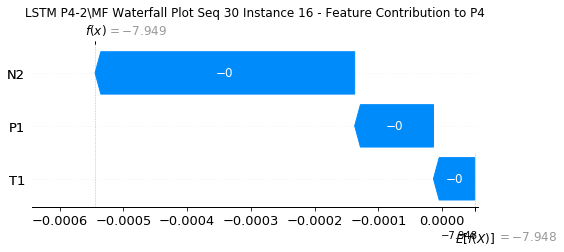

None

Contribution: [-1.33755348e-04 -6.65168833e-05 -4.53513663e-04]


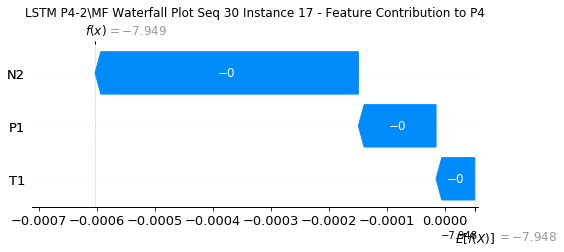

None

Contribution: [-1.61258468e-04 -5.93769382e-05 -5.07138040e-04]


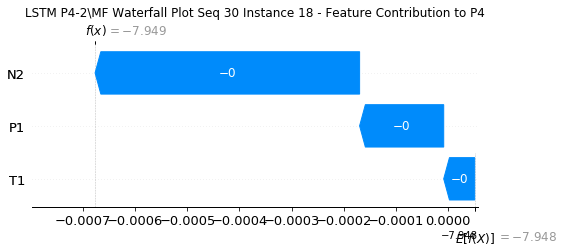

None

Contribution: [-1.87181616e-04 -7.05408135e-05 -6.02741874e-04]


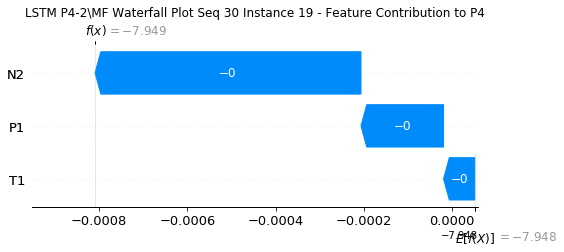

None

Contribution: [-2.36843530e-04 -2.83523748e-05 -7.66041381e-04]


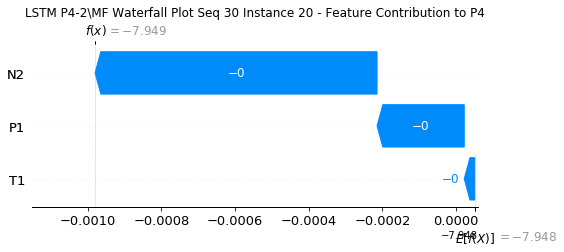

None

Contribution: [-0.00030516  0.00010395 -0.00108716]


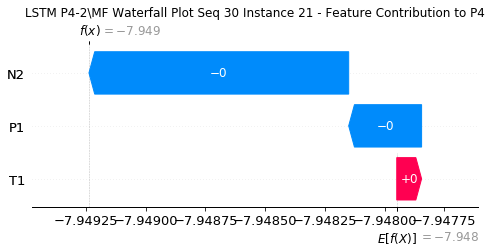

None

Contribution: [-0.0005344   0.00055285 -0.00170871]


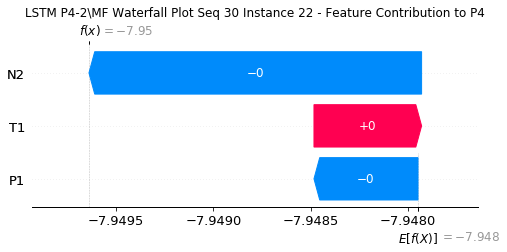

None

Contribution: [-0.00089884  0.0008246  -0.00310252]


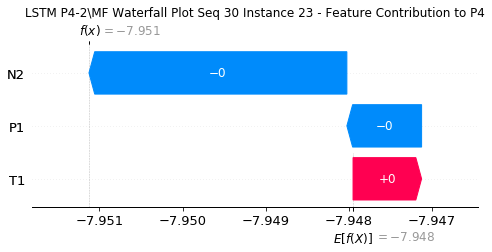

None

Contribution: [-0.00141891  0.00157061 -0.00612891]


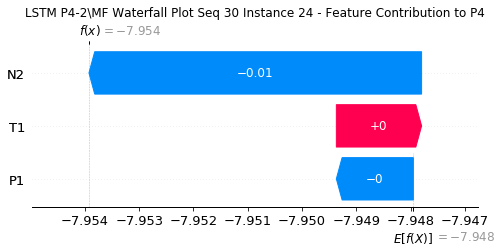

None

Contribution: [-0.03904845  0.05584207 -0.12560468]


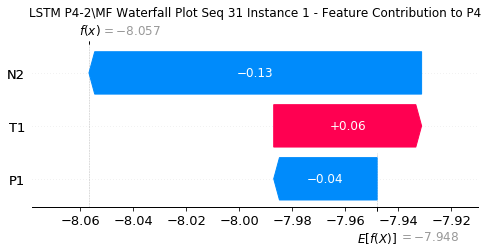

None

Contribution: [0.00177371 0.00533571 0.00440428]


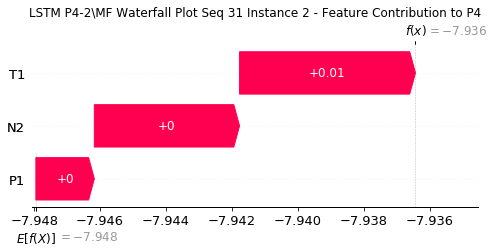

None

Contribution: [-8.98537536e-05  8.69529813e-04 -6.59047463e-04]


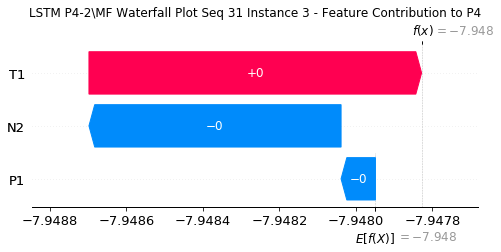

None

Contribution: [-1.36170383e-04 -3.09503470e-05 -4.05152926e-04]


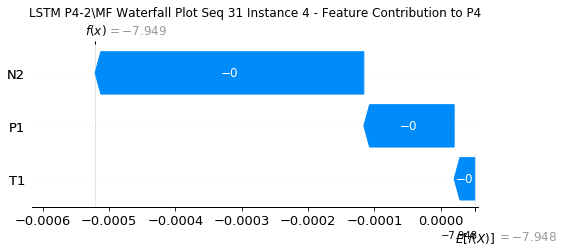

None

Contribution: [-8.93460432e-05 -4.99017272e-05 -2.72870620e-04]


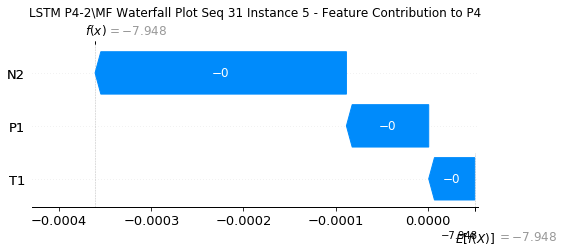

None

Contribution: [-7.66242080e-05 -4.61570818e-05 -2.29852500e-04]


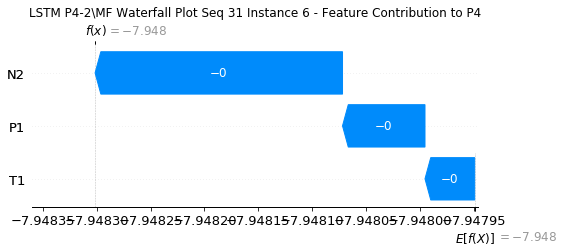

None

Contribution: [-6.84696230e-05 -3.94750382e-05 -2.23665225e-04]


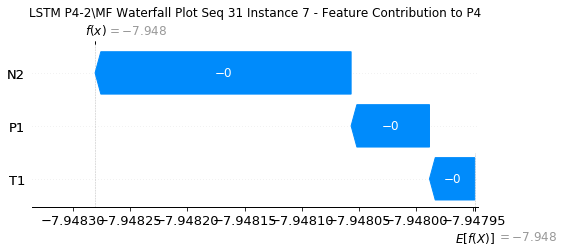

None

Contribution: [-6.06797686e-05 -2.15822619e-05 -2.15925398e-04]


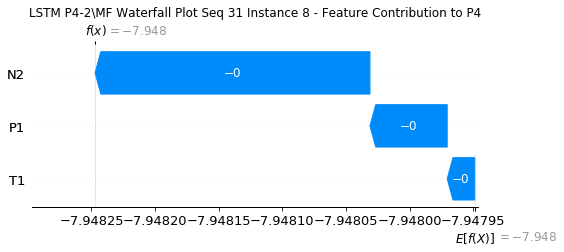

None

Contribution: [-5.64918300e-05 -2.48476910e-05 -2.18569089e-04]


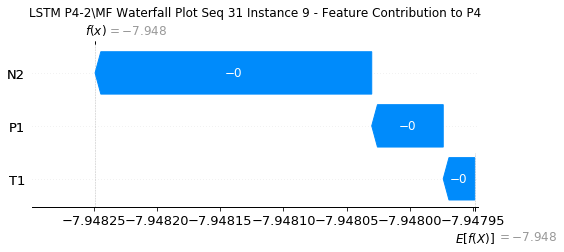

None

Contribution: [-6.50516274e-05 -2.31724068e-05 -2.33147919e-04]


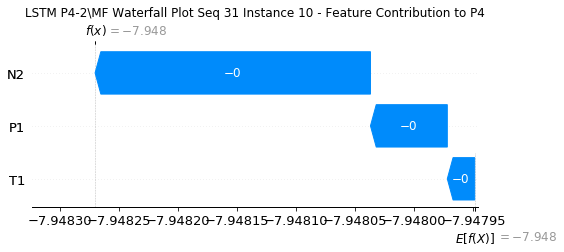

None

Contribution: [-8.11011954e-05 -4.01532170e-05 -2.52927413e-04]


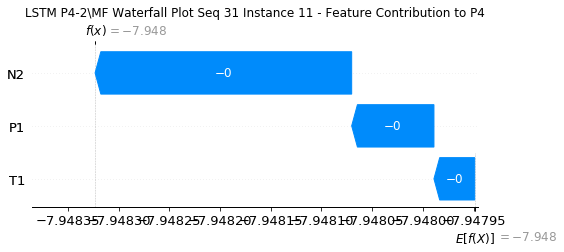

None

Contribution: [-8.79556786e-05 -4.43147492e-05 -2.77584380e-04]


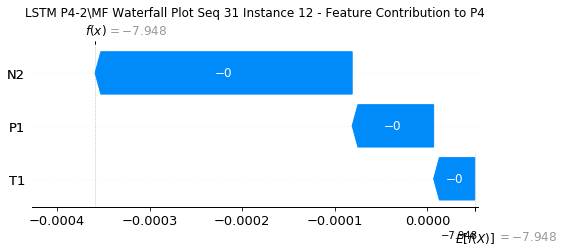

None

Contribution: [-9.65367971e-05 -4.82727406e-05 -3.04008012e-04]


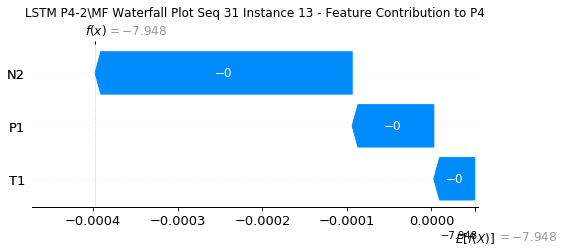

None

Contribution: [-1.0155821e-04 -5.4500294e-05 -3.3591889e-04]


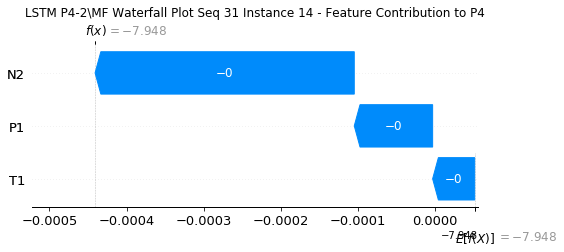

None

Contribution: [-1.10504570e-04 -5.97695454e-05 -3.69412569e-04]


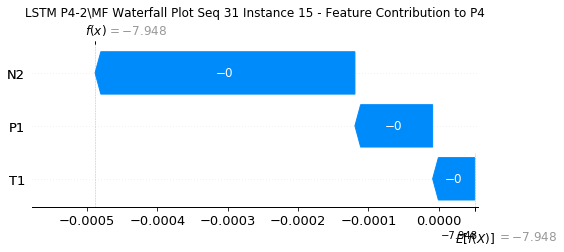

None

Contribution: [-1.28111757e-04 -6.83091241e-05 -4.07943708e-04]


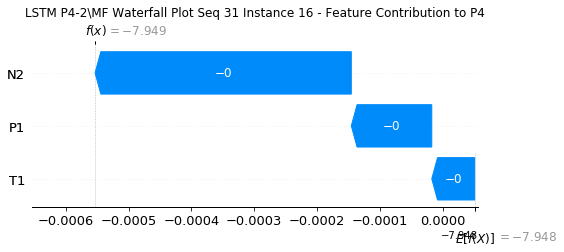

None

Contribution: [-1.35857607e-04 -6.86888818e-05 -4.52702417e-04]


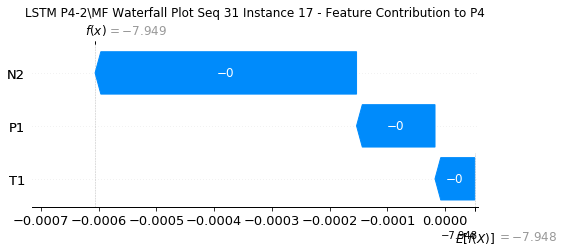

None

Contribution: [-1.73359010e-04 -9.16628162e-05 -5.14429741e-04]


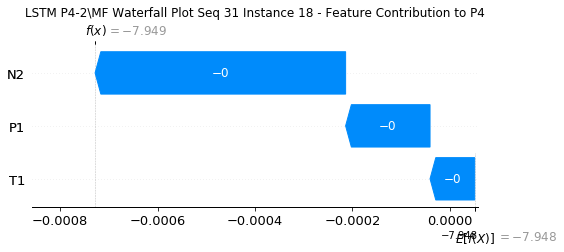

None

Contribution: [-1.84972967e-04 -4.31373063e-05 -5.98386136e-04]


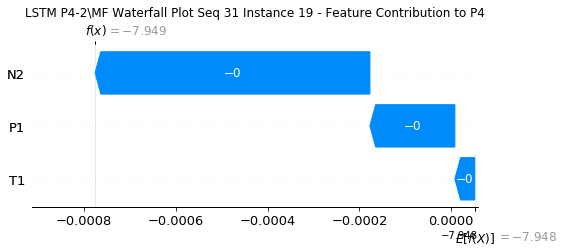

None

Contribution: [-2.28078568e-04  1.70599466e-05 -7.56938692e-04]


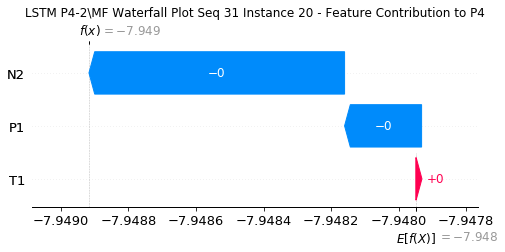

None

Contribution: [-0.00029295  0.00020697 -0.00107343]


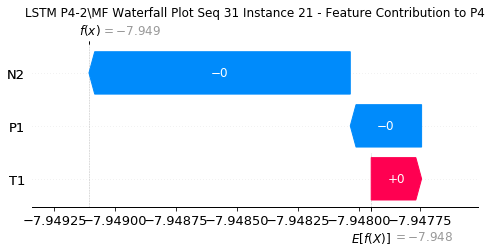

None

Contribution: [-0.00049774  0.00067897 -0.00167923]


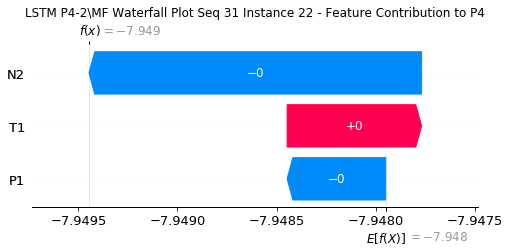

None

Contribution: [-0.00080915  0.00138277 -0.00305513]


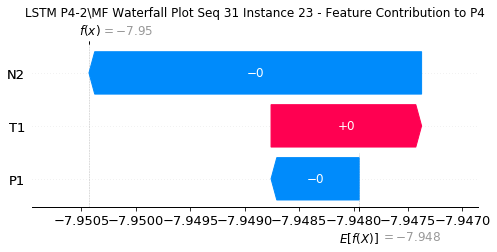

None

Contribution: [-0.00192056  0.00191048 -0.00658298]


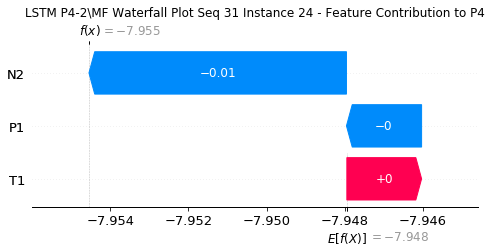

None

Contribution: [-0.051208    0.05120981 -0.13452434]


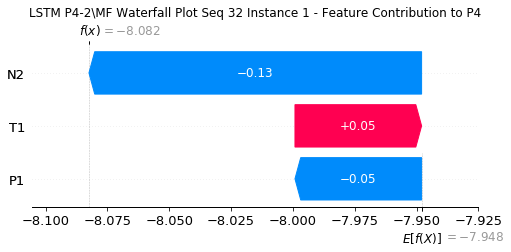

None

Contribution: [0.001189   0.00561317 0.00384828]


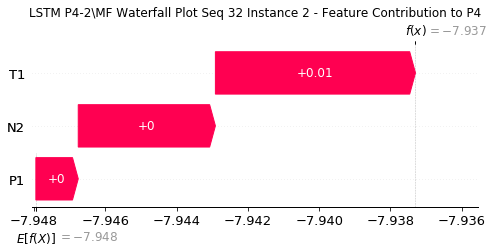

None

Contribution: [-0.00038791  0.00128709 -0.00087368]


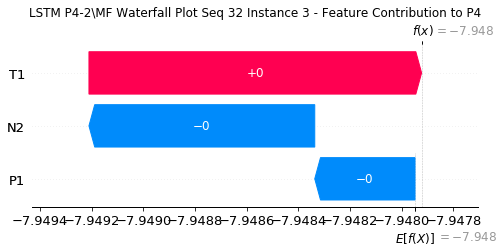

None

Contribution: [-1.20052339e-04 -3.88278931e-06 -4.05667818e-04]


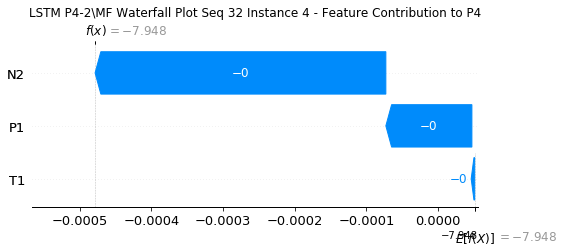

None

Contribution: [-8.21664329e-05 -3.97743587e-05 -2.74603997e-04]


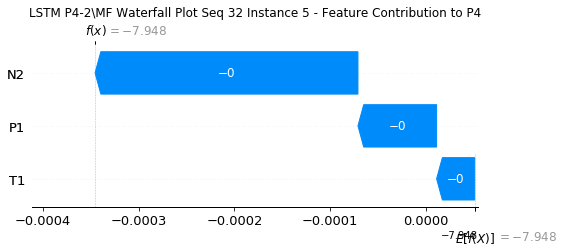

None

Contribution: [-6.02328513e-05 -3.86266947e-05 -2.25567734e-04]


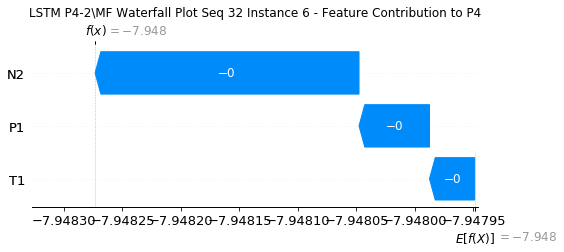

None

Contribution: [-6.45382943e-05 -3.35851109e-05 -2.26668431e-04]


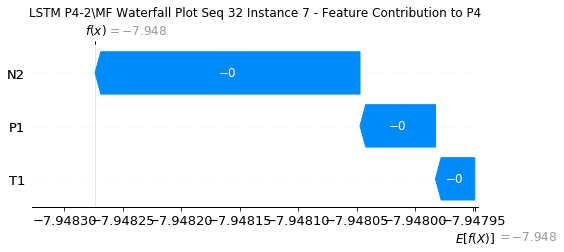

None

Contribution: [-6.77183762e-05 -3.33025689e-05 -2.25740257e-04]


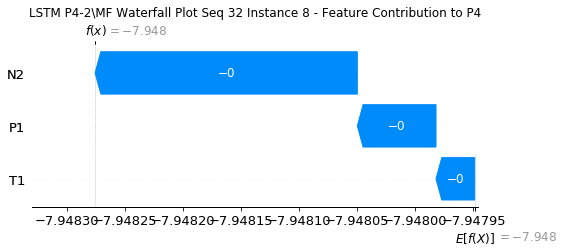

None

Contribution: [-7.21952065e-05 -4.33088868e-05 -2.31414806e-04]


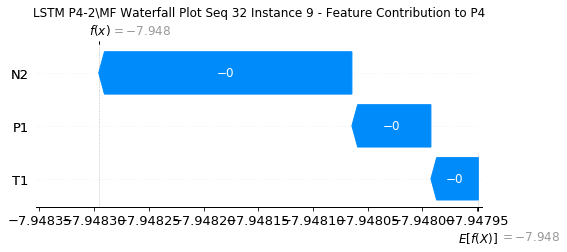

None

Contribution: [-7.08223848e-05 -4.31108754e-05 -2.42350943e-04]


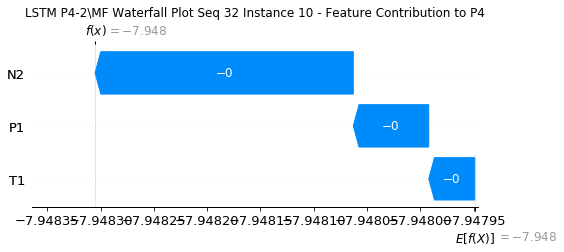

None

Contribution: [-7.70553622e-05 -3.41077334e-05 -2.57103019e-04]


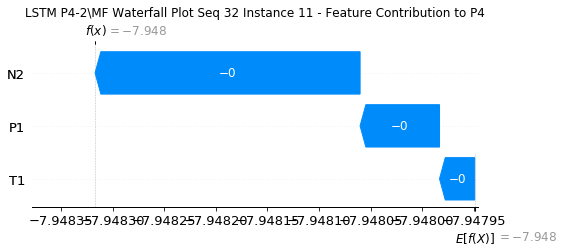

None

Contribution: [-8.44986969e-05 -3.60257236e-05 -2.81683369e-04]


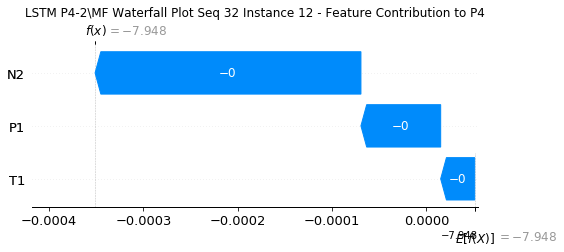

None

Contribution: [-8.85169772e-05 -3.82559770e-05 -3.05864499e-04]


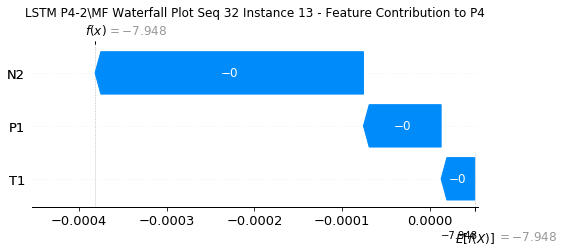

None

Contribution: [-9.80421977e-05 -4.66275529e-05 -3.39395886e-04]


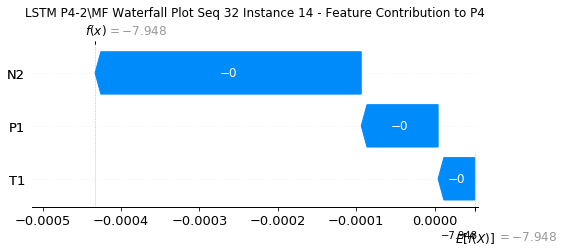

None

Contribution: [-9.66090369e-05 -2.97313704e-05 -3.65305052e-04]


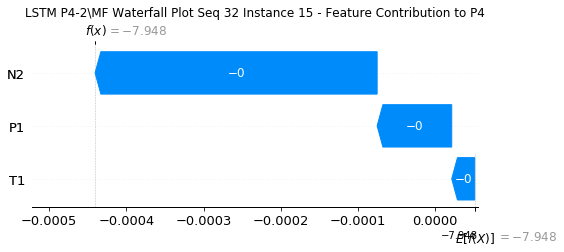

None

Contribution: [-1.25159212e-04 -5.81488215e-05 -4.12294820e-04]


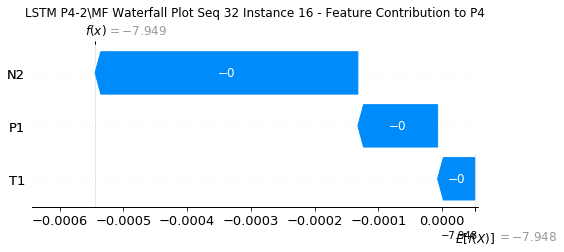

None

Contribution: [-1.33541239e-04 -5.54036790e-05 -4.58376469e-04]


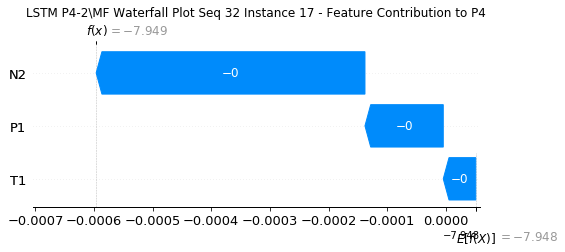

None

Contribution: [-1.57036096e-04 -4.39095398e-05 -5.20619203e-04]


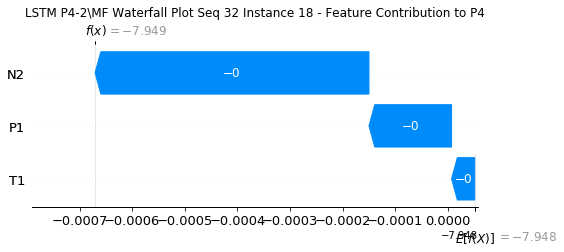

None

Contribution: [-1.85521350e-04 -1.37534898e-05 -6.12256113e-04]


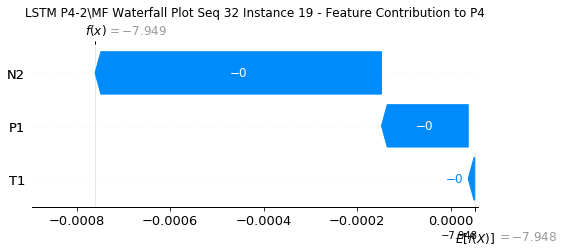

None

Contribution: [-2.30859314e-04  6.65020605e-05 -7.83179742e-04]


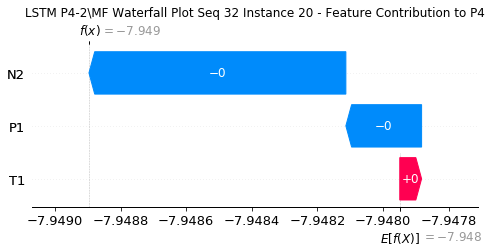

None

Contribution: [-0.00030456  0.00029386 -0.00112874]


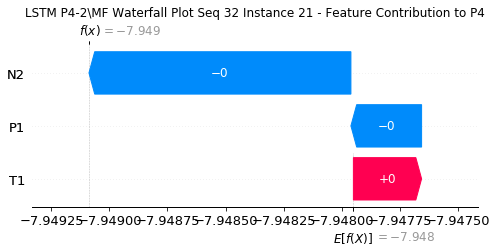

None

Contribution: [-0.00051514  0.00084271 -0.00180386]


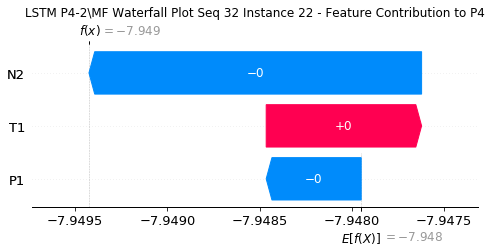

None

Contribution: [-0.00094645  0.00163494 -0.00333819]


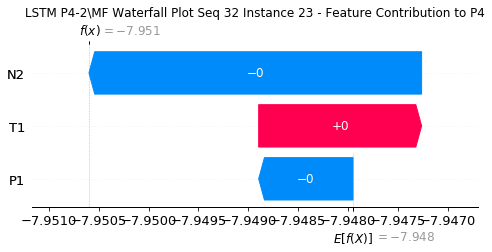

None

Contribution: [-0.00188805  0.00163756 -0.00652784]


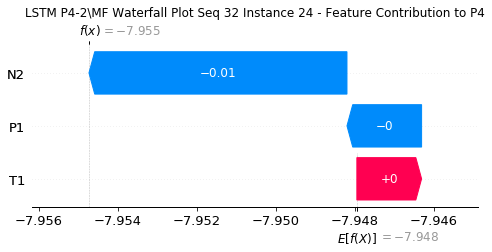

None

Contribution: [-0.03667503  0.06473125 -0.13117093]


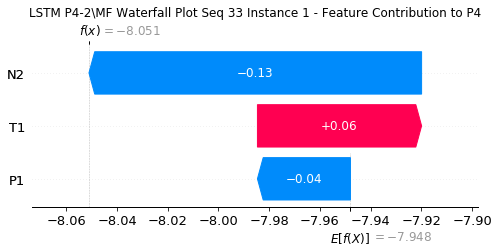

None

Contribution: [0.00159542 0.00574144 0.00417172]


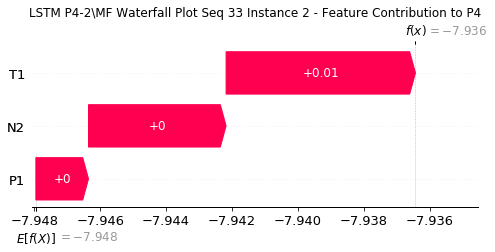

None

Contribution: [-0.00022731  0.0011889  -0.0008004 ]


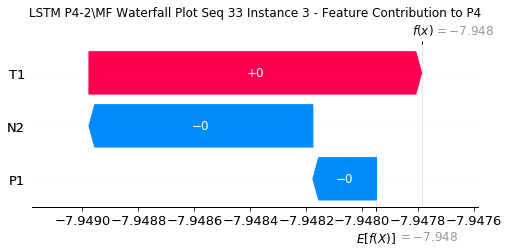

None

Contribution: [-9.80898939e-05  4.28121949e-05 -4.02375491e-04]


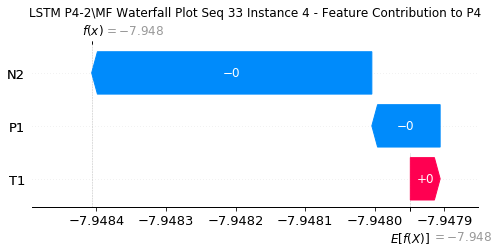

None

Contribution: [-7.03697319e-05 -1.12121333e-05 -2.70659498e-04]


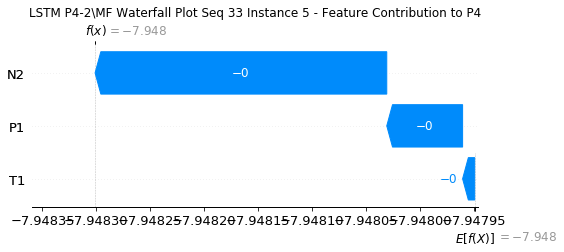

None

Contribution: [-6.11999253e-05 -2.39001600e-05 -2.25769024e-04]


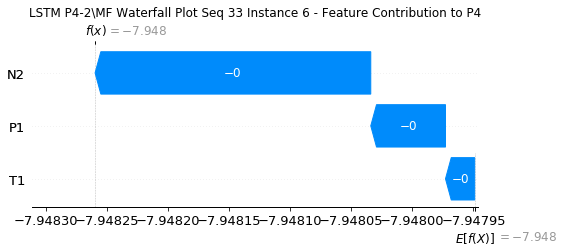

None

Contribution: [-5.53471031e-05 -7.93782675e-06 -2.21933477e-04]


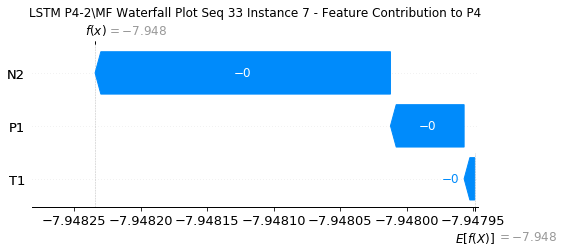

None

Contribution: [-6.36285020e-05  6.69449772e-06 -2.17138056e-04]


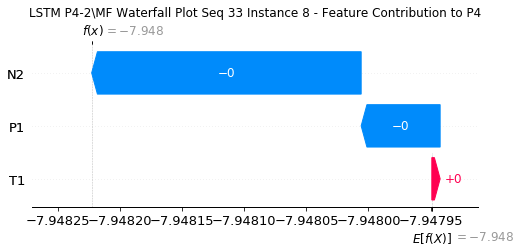

None

Contribution: [-6.51790305e-05 -1.75338768e-05 -2.21206449e-04]


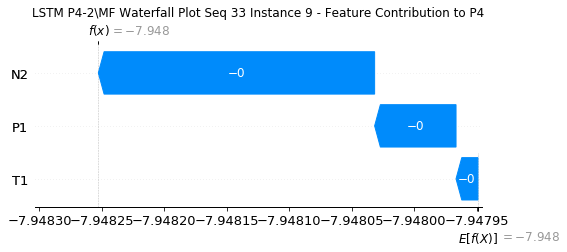

None

Contribution: [-6.62300911e-05  5.34281460e-06 -2.32947993e-04]


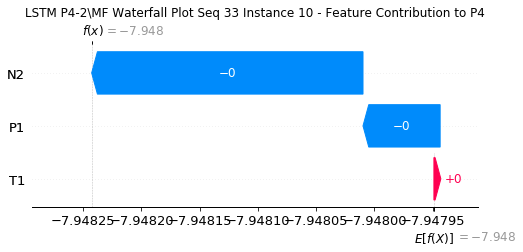

None

Contribution: [-6.90369177e-05 -6.95365665e-06 -2.50291050e-04]


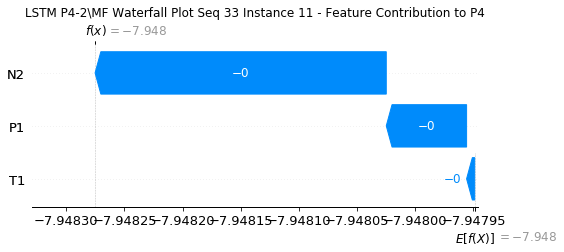

None

Contribution: [-7.63601945e-05 -1.03065447e-05 -2.75482367e-04]


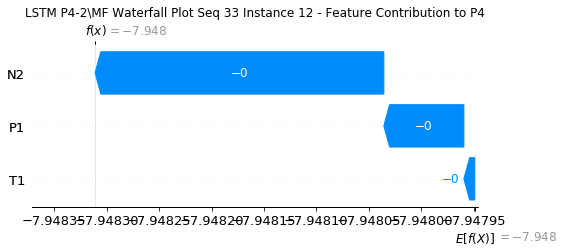

None

Contribution: [-9.49565538e-05 -1.94486664e-05 -3.02272298e-04]


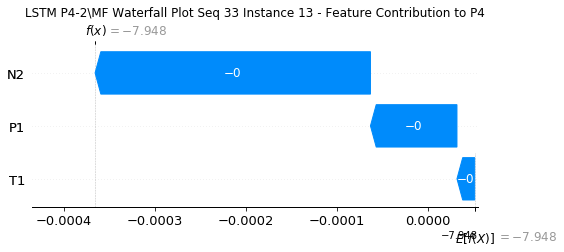

None

Contribution: [-9.16759934e-05 -1.89333005e-05 -3.33825684e-04]


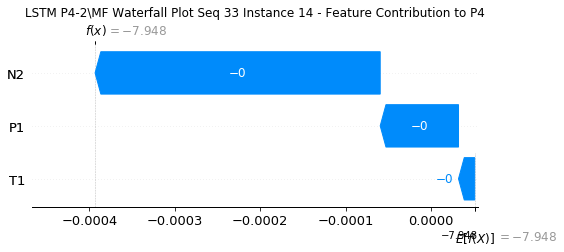

None

Contribution: [-1.00318452e-04 -2.03705907e-05 -3.62959526e-04]


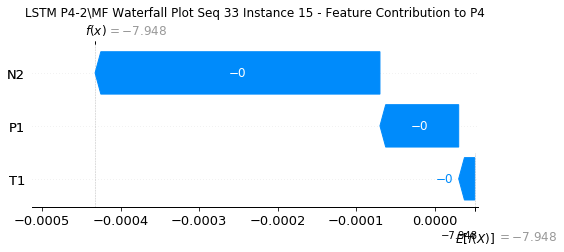

None

Contribution: [-1.17356596e-04 -2.74133230e-05 -4.05705146e-04]


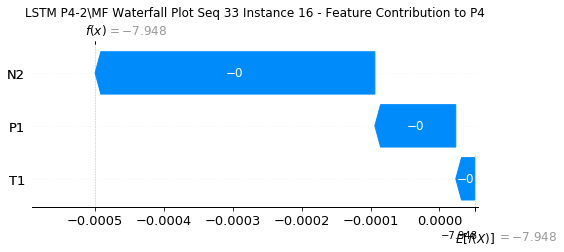

None

Contribution: [-1.21526397e-04 -1.89817601e-05 -4.50353429e-04]


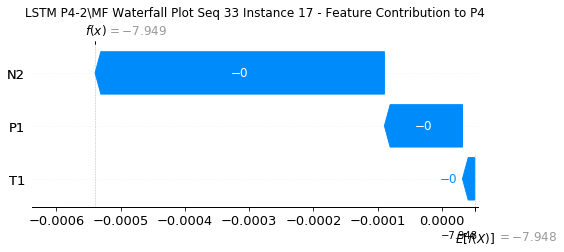

None

Contribution: [-1.61731588e-04 -9.86851434e-07 -5.11590696e-04]


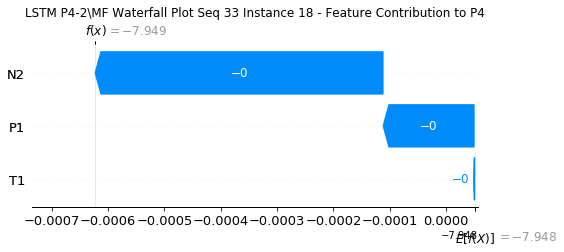

None

Contribution: [-1.66059611e-04  4.84797943e-05 -5.95829910e-04]


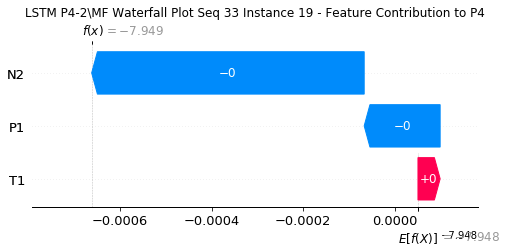

None

Contribution: [-0.00019394  0.000175   -0.00075137]


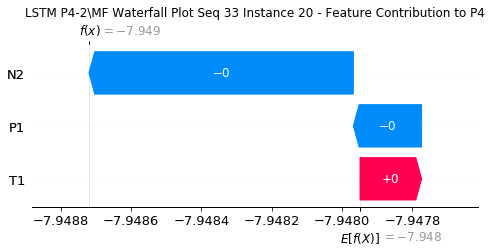

None

Contribution: [-0.00024633  0.00050703 -0.00106222]


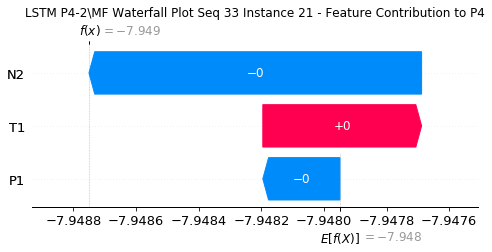

None

Contribution: [-0.00038791  0.00131436 -0.00164354]


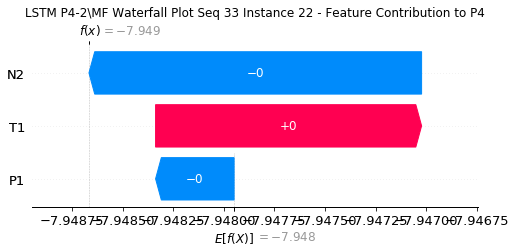

None

Contribution: [-0.0007258   0.00272954 -0.00302402]


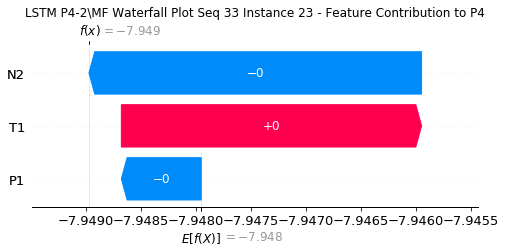

None

Contribution: [-0.0012642   0.00489375 -0.00592607]


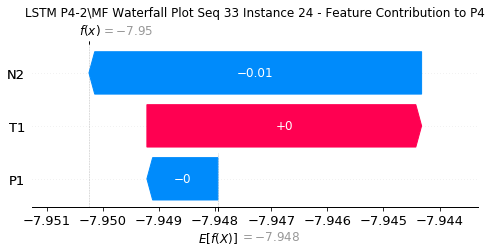

None

Contribution: [-0.01379133  0.11973588 -0.11223994]


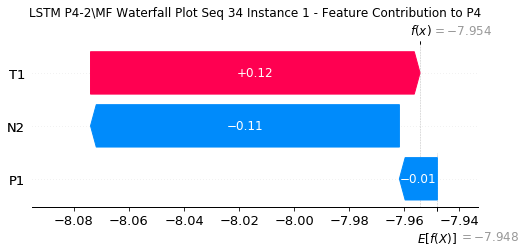

None

Contribution: [0.00202078 0.0069893  0.00520773]


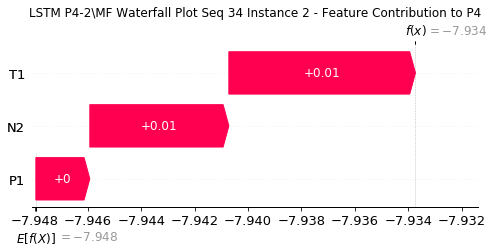

None

Contribution: [-3.16369660e-05  1.77185373e-03 -5.35352434e-04]


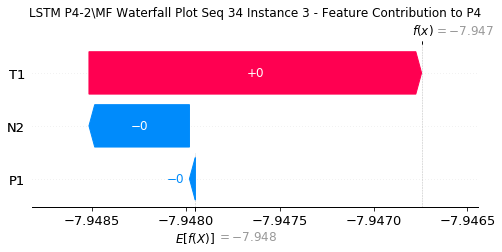

None

Contribution: [-8.75402696e-05  1.15344240e-04 -3.94828567e-04]


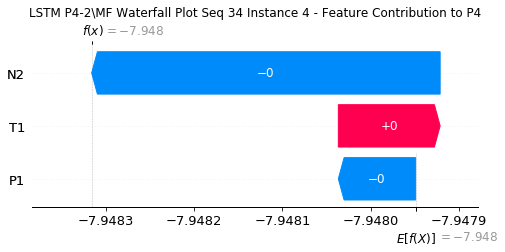

None

Contribution: [-6.18572088e-05  3.39759957e-05 -2.64267430e-04]


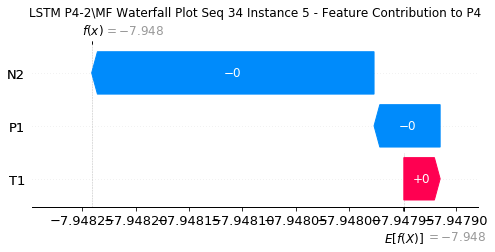

None

Contribution: [-4.05898326e-05  3.58704480e-05 -2.22305577e-04]


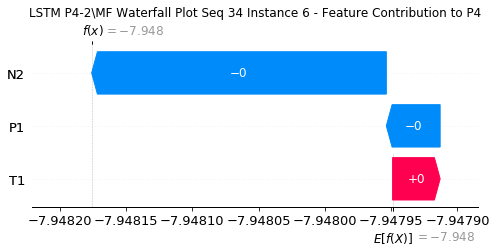

None

Contribution: [-4.40965840e-05  2.84206199e-05 -2.15627470e-04]


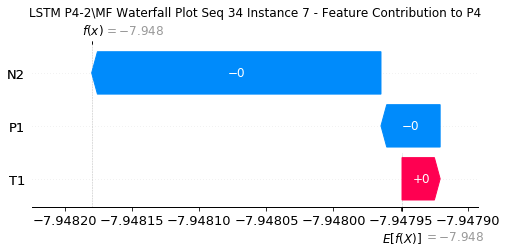

None

Contribution: [-3.66459910e-05  2.78085613e-05 -2.13371170e-04]


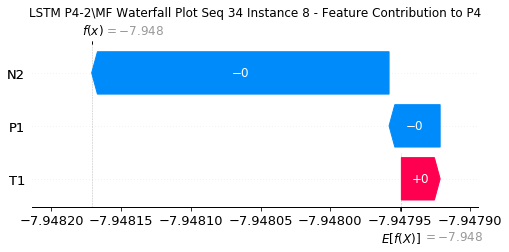

None

Contribution: [-2.24045682e-05  3.07785775e-05 -2.15057537e-04]


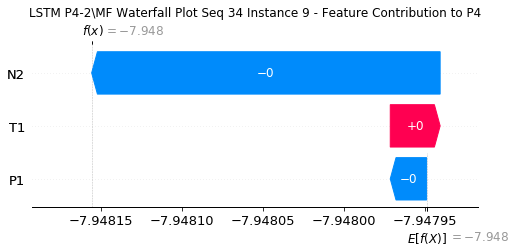

None

Contribution: [-3.23026410e-05  2.73373279e-05 -2.28018700e-04]


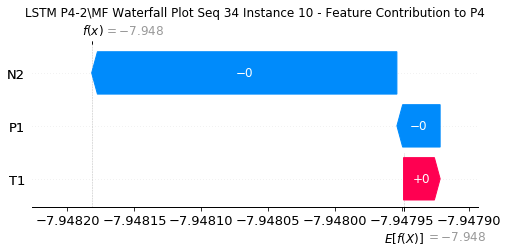

None

Contribution: [-5.77705196e-05  2.66313404e-05 -2.47122754e-04]


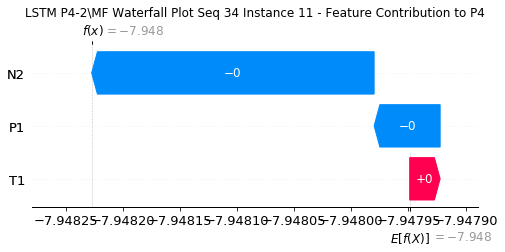

None

Contribution: [-6.74010520e-05  2.21365068e-05 -2.74702753e-04]


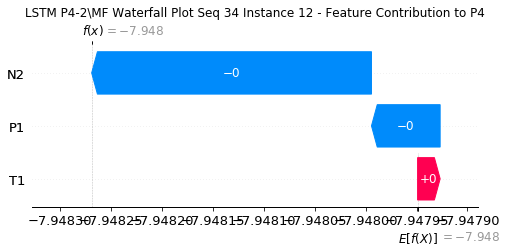

None

Contribution: [-7.16300097e-05  3.47647085e-06 -3.03356207e-04]


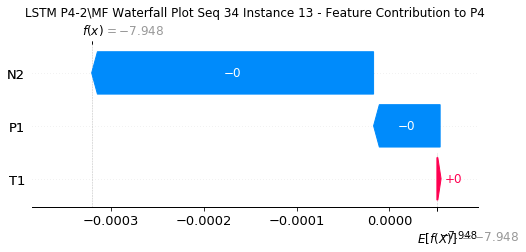

None

Contribution: [-8.11455626e-05  1.03147110e-05 -3.37788454e-04]


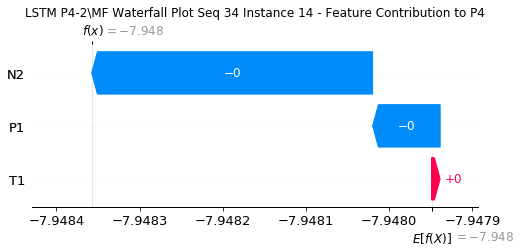

None

Contribution: [-8.62178179e-05  1.68292737e-05 -3.70057782e-04]


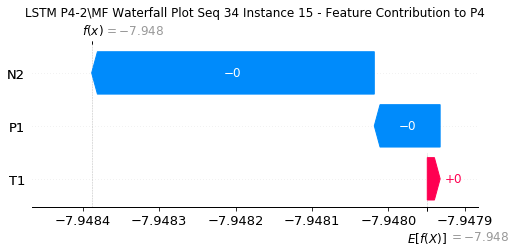

None

Contribution: [-1.10132583e-04  4.01485215e-06 -4.15502645e-04]


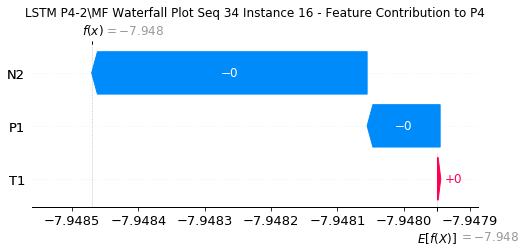

None

Contribution: [-1.14780821e-04  1.78927073e-05 -4.62487852e-04]


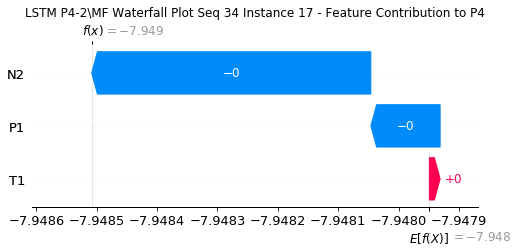

None

Contribution: [-1.45745214e-04  1.57603403e-05 -5.24070664e-04]


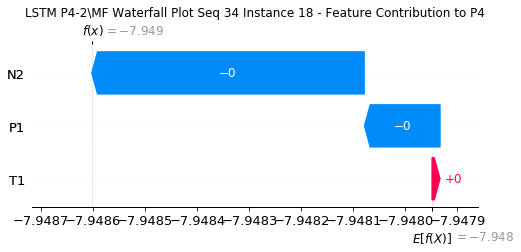

None

Contribution: [-1.63461970e-04  9.98810404e-05 -6.12221823e-04]


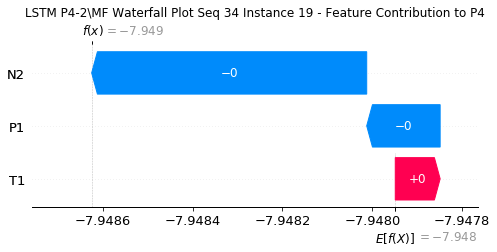

None

Contribution: [-0.0001881   0.00025623 -0.00077073]


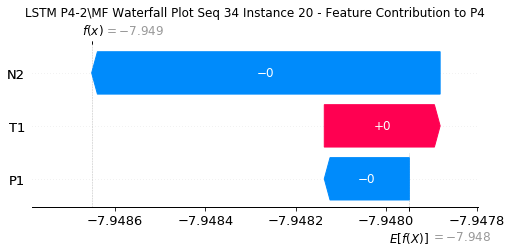

None

Contribution: [-0.00022021  0.00061885 -0.00108062]


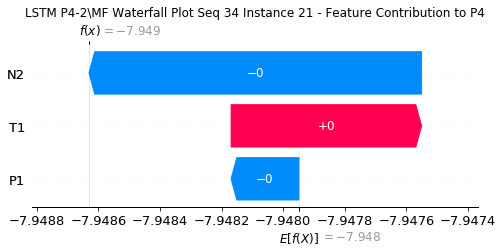

None

Contribution: [-0.00030768  0.00153779 -0.00167077]


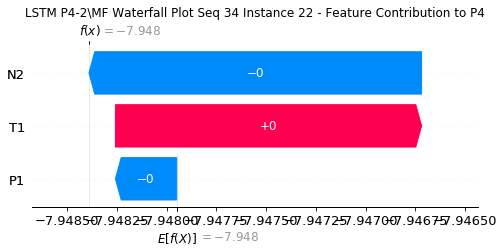

None

Contribution: [-0.00058323  0.00304493 -0.00306822]


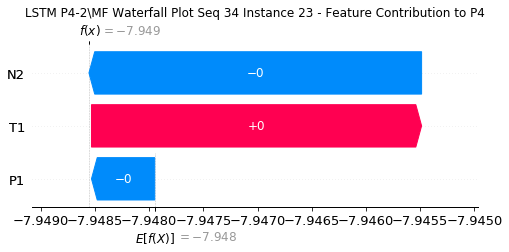

None

Contribution: [-0.00120652  0.00557757 -0.00612558]


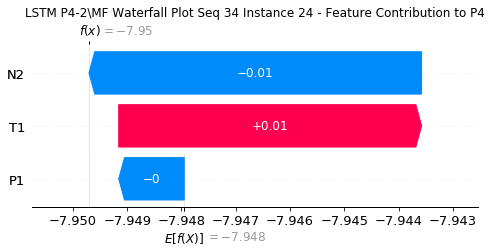

None

In [40]:
#Waterfall Plot for Consistency metric

instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM P4-2\MF Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to P4" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [1]:
#Consistency

P4_tot1 = -9.194 + 8.012
P4_tot1

-1.1820000000000004

In [ ]:
#MF contribution instance 1

MF_P4_1 = -0.04815559